## SBMOO  approach for Dealing with Deep Uncertainty in Environmental Problems:


- Solve scenario-based MOOP (i.e. simultaneously consider the selected scenarios and generate the solutions for an SBMOOP)
    [For the time being, we use the previous scenario selected methods in the literature (Particularly use one proposed in Eker & Kwakkel (2018).]
- Use ASF as a posteriori decision-making approach [a more smart way of generating reference point should be considered; e.g. surrogate ASF]  

- Finally, we need to analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)
- The classical lake problem has been used to test the idea.

##### Objectives in Lake problem(4 objectives):
- Max expected economic benefits(Utility)
- Min worst-case average P concentration(Pollution)
- Max average Inertia of control policy(Inertia)
- Max reliability of policy in staying below the lake's critical P threshold(Reliability)

##### Constraints:
- P emissions range between 0.0001 and 0.1(decision variables bounds)

##### Observations:
- Utility and reliability are the most conflicting objectives
- There is no feasible solution with the reliability of higher than 85% (or even 10%) for all scenarios. 

In [1]:
import numpy as np
from scipy.optimize import brentq
import math
from scipy.optimize import minimize
import random

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D # <--- This is important for 3d plotting 

import csv
import plotly.express as px
import plotly.graph_objects as go

In [2]:
def lake_problem(decisions,
                 b, #= 0.42,          # decay rate for P in lake (0.42 = irreversible)
                 q, #= 2.0,           # recycling exponent
                 mean, #= 0.02,       # mean of natural inflows
                 stdev, #= 0.001,     # future utility discount rate
                 delta, #= 0.98,      # standard deviation of natural inflows
                 alpha, #= 0.4,       # utility from pollution
                 nsamples = 100    # Monte Carlo sampling of natural inflows
                 ): #**kwargs):   
    #decisions = [kwargs[str(i)] for i in range(100)]
    
    Pcrit = brentq(lambda x: x**q/(1+x**q) - b*x, 0.01, 1.5)
    nvars = len(decisions)
    X = np.zeros((nvars,))
    average_daily_P = np.zeros((nvars,))
    decisions = np.array(decisions)
    reliability = 0.0

    for _ in range(nsamples):
        X[0] = 0.0
        
        natural_inflows = np.random.lognormal(
                math.log(mean**2 / math.sqrt(stdev**2 + mean**2)),
                math.sqrt(math.log(1.0 + stdev**2 / mean**2)),
                size = nvars)
        
        for t in range(1,nvars):
            X[t] = (1-b)*X[t-1] + X[t-1]**q/(1+X[t-1]**q) + decisions[t-1] +\
                    natural_inflows[t-1]
            average_daily_P[t] += X[t]/float(nsamples)
    
        reliability += np.sum(X < Pcrit)/float(nsamples*nvars)
      
    max_P = np.max(average_daily_P)
    utility = np.sum(alpha*decisions*np.power(delta,np.arange(nvars)))#/100
    inertia = np.sum(np.absolute(np.diff(decisions)) < 0.02)/float(nvars-1)
    
    
    return -utility, max_P, -inertia, -reliability  # Negative signs describe the Maximization objectives

In [3]:
"""
Multi_scenario model initialization
"""
# Number of scenarios
s = 50
#Number of objectives 
k = 4
# Number of meta-criteria
mc = s*k

In [4]:
"""
 Utilizing 4 diverse scenarios from 
 
 Eker, S. and Kwakkel, J.H., 2018. Including robustness considerations in the search phase of Many-Objective 
 Robust Decision Making. Environmental Modelling & Software, 105, pp.201-216.
 
 4 selected scenarios + 1 reference scenario:
              b           delta          mean           q             std
 A(#77)  0.19330981   0.953092397    0.017430754    3.049281843    0.002061759
 B(#96)  0.141181536  0.950441986    0.012044268    2.584491318    0.00243013
 C(#130) 0.111640212  0.956457199    0.010126115    2.968733539    0.003692125
 D(#181) 0.272280522  0.931232823    0.03300274     2.971857894    0.004599415
 Ref     0.42         0.98           0.02           2              0.0017

 
"""

#b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42] # b = [0.42, 0.1, 0.2, 0.3]
#q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2] # q = [2.0, 3, 4, 4.5]
#mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02]   # mean = [0.02, 0.01, 0.03, 0.05]
#stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017]   # stdev = [0.001, 0.0006, 0.001, 0.005]
#delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98]  

"""
Bartholomew, E. & Kwakkel, J. H. (2020), ‘On considering robustness in thesearch phase of robust decision making:  
A comparison of many-objective ro-bust decision making, multi-scenario many-objective robust decision making,
and many objective robust optimization’,Environmental Modelling & Soft-warep. 104699.

Used the same algorithm as Eker 2018, but ended up with the following scenarios:

+ 4 selected scenarios 

    b        q      mean      std     delta
1 0.2760   3.0490   0.0039   0.0039   0.9310
2 0.1350   2.0255   0.0407   0.0030   0.9613
3 0.2704   2.4783   0.0169   0.0039   0.9631
4 0.1009   3.6789   0.0187   0.0037   0.9317

Ref the same as the above
"""

b = [0.19330981,  0.141181536, 0.111640212, 0.272280522, 0.42, 0.2760, 0.1350, 0.2704, 0.1009] # b = [0.42, 0.1, 0.2, 0.3]
q = [3.049281843, 2.584491318, 2.968733539, 2.971857894, 2, 3.0490, 2.0255, 2.4783, 3.6789] # q = [2.0, 3, 4, 4.5]
mean = [0.017430754, 0.012044268, 0.010126115, 0.03300274, 0.02, 0.0039, 0.0407, 0.0169, 0.0187]   # mean = [0.02, 0.01, 0.03, 0.05]
stdev = [0.002061759, 0.00243013, 0.003692125, 0.004599415, 0.0017, 0.0039, 0.0030, 0.0039, 0.0037]   # stdev = [0.001, 0.0006, 0.001, 0.005]
delta = [0.953092397, 0.950441986, 0.956457199, 0.931232823, 0.98, 0.9310, 0.9613, 0.9631, 0.9317]    

## 9 + 991 random scenarios

In [5]:
gen_scenarios = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\scenarios_991_9(EkerBart)10.10.2020.csv')
b = gen_scenarios.b
q = gen_scenarios.q
mean = gen_scenarios['meann'] #  reliable_scenarios.mean can not be used as 'mean' is a reserved term 
stdev = gen_scenarios['stdev']
delta = gen_scenarios.delta

## Finding the ideal points (the optimal values for objectives in each scenario) by solving a single-scenario single-objective problem for all objectives and 25 considered scenarios.

In [6]:
# 4 objectives and 9 scenarios
# So the indices must change between 0-8, each demonstrates a scenario

def single_objective_single_scenario(decisions):
    """
    single-objective (obj) single-scenario (scen) model
    """        
    f = []                     
    f = lake_problem(decisions, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
                     
    return f[obj]

In [9]:
# Solving the single-scenario single objective problems to get the ideal points for each objective in each scenario

ideal_Utility = [] 
ideal_Pollution = [] 
ideal_Inertia = [] 
ideal_Reliability = [] 

ind_temp = 0
extreme_dec = []
extreme_refp = np.zeros((mc,k))

for obj in range(k):
    print('k=',obj)
    for scen in range(s):
        """
        Run the model n times with different goals to generate different Pareto optimal solutions
        """
        print('s=', scen)
        ind_temp += 1
        
        sol = minimize(single_objective_single_scenario,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
               )  
        
        # Decision variables (solutions)
        extreme_dec.append(sol.x)
    
        F = lake_problem(sol.x, b = b[scen], q = q[scen], mean = mean[scen], stdev = stdev[scen], delta = delta[scen], alpha = 0.4, nsamples = 100)
        #print(' Scenario ',scen+1,': b = ', b[scen], ', q = ', q[scen], ', mean = ', mean[scen], ', stdev = ', stdev[scen], ',delta = ', delta[scen])
        #print('f_{obj+1}',scen+1,' =', F[obj])

        # Store Objective values for scenario S_i
        extreme_refp[ind_temp-1] = np.array([-F[0],F[1],-F[2],-F[3]])
        
        if obj == 0:
            ideal_Utility.append(-F[obj])
        elif obj == 1:
            ideal_Pollution.append(F[obj])
        elif obj == 2:
            ideal_Inertia.append(-F[obj])
        else:
            ideal_Reliability.append(-F[obj])
        

#print('Ideal points for Utility in different scenarios =',ideal_Utility)
#print('Ideal points for Plution in different scenarios =',ideal_Pollution)
#print('Ideal points for Inertia in different scenarios =',ideal_Inertia)
#print('Ideal points for Reliability in different scenarios =',ideal_Reliability)

k= 0
s= 0
s= 1
s= 2
s= 3
s= 4
s= 5
s= 6
s= 7
s= 8
s= 9
s= 10
s= 11
s= 12
s= 13
s= 14
s= 15
s= 16
s= 17
s= 18
s= 19
s= 20
s= 21
s= 22
s= 23
s= 24
s= 25
s= 26
s= 27
s= 28
s= 29
s= 30
s= 31
s= 32
s= 33
s= 34
s= 35
s= 36
s= 37
s= 38
s= 39
s= 40
s= 41
s= 42
s= 43
s= 44
s= 45
s= 46
s= 47
s= 48
s= 49
k= 1
s= 0
s= 1
s= 2
s= 3
s= 4
s= 5
s= 6
s= 7
s= 8
s= 9
s= 10
s= 11
s= 12
s= 13
s= 14
s= 15
s= 16
s= 17
s= 18
s= 19
s= 20
s= 21
s= 22
s= 23
s= 24
s= 25
s= 26
s= 27
s= 28
s= 29
s= 30
s= 31
s= 32
s= 33
s= 34
s= 35
s= 36
s= 37
s= 38
s= 39
s= 40
s= 41
s= 42
s= 43
s= 44
s= 45
s= 46
s= 47
s= 48
s= 49
k= 2
s= 0
s= 1
s= 2
s= 3
s= 4
s= 5
s= 6
s= 7
s= 8
s= 9
s= 10
s= 11
s= 12
s= 13
s= 14
s= 15
s= 16
s= 17
s= 18
s= 19
s= 20
s= 21
s= 22
s= 23
s= 24
s= 25
s= 26
s= 27
s= 28
s= 29
s= 30
s= 31
s= 32
s= 33
s= 34
s= 35
s= 36
s= 37
s= 38
s= 39
s= 40
s= 41
s= 42
s= 43
s= 44
s= 45
s= 46
s= 47
s= 48
s= 49
k= 3
s= 0
s= 1
s= 2
s= 3
s= 4
s= 5
s= 6
s= 7
s= 8
s= 9
s= 10
s= 11
s= 12
s= 13
s= 14
s= 15
s= 16
s= 17
s= 18
s= 19


In [10]:
# Write ideal points

with open('obective_values_4obj_50scen_ideal points.csv', 'w', newline='') as f:
    objectives = ['ideal_Utility', 'ideal_Pollution', 'ideal_Inertia', 'ideal_Reliability', 'Scenario'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(s):
        thewriter.writerow({'ideal_Utility' : ideal_Utility[i], 'ideal_Pollution' : ideal_Pollution[i], 'ideal_Inertia' : ideal_Inertia[i], 'ideal_Reliability' : ideal_Reliability[i], 'Scenario' : i
                               })
        
with open('extreme_rf_points(EkerBarth)50scen.csv', 'w', newline='') as f:
    objectives = ['extreme_rf_points', 'extreme_rf_points_dec'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()
    for i in range(mc):
        thewriter.writerow({'extreme_rf_points' : extreme_refp[i], 'extreme_rf_points_dec' : extreme_dec[i]
                               })    

In [11]:
Lake45_ideals = pd.read_csv('obective_values_4obj_50scen_ideal points.csv')
Lake45_ideals

,ideal_Utility,ideal_Pollution,ideal_Inertia,ideal_Reliability,Scenario
0,0.845753,0.095925,1.0,1.0000,0
1,0.802129,0.110507,1.0,1.0000,1
2,0.907929,0.103131,1.0,1.0000,2
3,0.581198,0.132576,1.0,1.0000,3
4,1.734761,0.055486,1.0,1.0000,4
5,0.579248,0.015894,1.0,1.0000,5
6,1.013628,7.591327,1.0,0.0414,6
7,1.058766,0.070151,1.0,1.0000,7
8,0.585153,0.229373,1.0,1.0000,8
9,0.726168,0.057872,1.0,1.0000,9


## Ideal points for all 1000 random scenarios

In [12]:
Lake_ideals = pd.read_csv(r'C:\Users\babshava\pyDMDU\robust_optimization_comparison\src\exp2(Eker2018_scenarios)\obective_values_4obj_5scen(EkerBart)_1000_ideal_points(12.10.2020).csv')
#Lake_ideals.describe()

In [13]:
"""
Achievement Scalarizing Function (ASF) approach: transfer the multi-objective problem into a single objective one.
Then the following problem will be solved:

  min_x  max_{i=1,..,k} [w_i(f_i - g_i)] + \epsilon sum_{i=1}^n  w_i(f_i - g_i)
  
   s.t. x \in S(feasible region)
  
  where w_i are the weights and can be set bu the decision maker(DM) (e.g. w_i = 1/(z_i^{ideal} - z_i^{nadir} which is also normalize the objective functions)
  k : number of objective functions
  g_i: aspiration levels to be set by the DM (one for each objective function is needed)

When we have multiple scenarios the above formulation have an additional dimension:

   min_x  max_{i=1,..,k; p=1,...,s} [w_{ip}(f_{ip} - g_{ip})] + \epsilon sum_{i=1}^n [sum_{p=1}^s  w_{ip}(f_{ip} - g_{ip}) ]
  
     s.t. x \in S(feasible region in all scenarios)

"""


def objective(decisions):
    """
    ASF
    """     
    phi = np.zeros((s,k))
    w = np.ones((s,k)) # weight vectors
    eps = 0.0001
    f = [[None] for i in range(s)] 
    
    # Setting weights, the same weight for each objective in all scenarios
    for p in range(s):
        for i in range(k): 
            if i==0:
                w[p,i] = 1/(Lake45_ideals.loc[p,'ideal_Utility'])  #2
            elif i==1:
                w[p,i] = 1/(15-(Lake45_ideals.loc[p,'ideal_Pollution']))
            elif i==2:
                w[p,i] = 1/Lake45_ideals.loc[p,'ideal_Inertia']                
            else:
                w[p,i] = 1/Lake45_ideals.loc[p,'ideal_Reliability']
                       
    for p in range(s):
        f[p] = lake_problem(decisions, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        phi[p] = w[p]*(f[p] - g[p])
        aug = eps * (phi[p]).sum()  
    
    return phi.max() + aug


In [17]:
# Extreme points (decision space)
import re
extreme_rf_points = pd.read_csv('extreme_rf_points(EkerBarth)50scen.csv')
extreme_rfp_dec = np.zeros((mc,100))
for i in range(mc):
    rfpt = re.findall(r"[-+]?\d*\.\d+|\d+", extreme_rf_points['extreme_rf_points_dec'][i])
    for j in range(100):
        extreme_rfp_dec[i][j] = float(rfpt[j])

#extreme_rfp_dec

In [18]:
# Calculate the extreme points in objective space

extreme_rfp = [s * [None] for i in range(mc)]  #np.zeros((mc,mc))

for j in range(mc):
    for p in range(s):
        f_temp = np.zeros((k,))
        F = lake_problem(extreme_rfp_dec[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        for i in range(k):
            if i==1:
                f_temp[i] = F[i]
            else:
                f_temp[i] = -F[i]
                
        extreme_rfp[j][p] = f_temp
                
#extreme_rfp[0]

In [20]:
"""
  Setting the goals/ reference points - extreme points
"""
# number of solution to be generated 
n = 50

ig=[s * [None] for i in range(max(mc,n))] 

for i in range(mc):
    for p in range(s):
        ig[i][p] = np.array([extreme_rfp[i][0][0]*-1, extreme_rfp[i][0][1], extreme_rfp[i][0][2]*-1, extreme_rfp[i][0][3]*-1])

def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][i] # n vs (n-1)
    return g

In [21]:
# Uniformly choose reference points amoungst the set if n < mc 
n = 50
index = []
aa = 0
while((aa)/np.shape(ig)[0]< 1):
    index.append(int(aa))
    aa += np.shape(ig)[0]/(n-1)

index.append(int(99))
#index

In [13]:
"""
  Setting the goals/ reference points - random
"""
# number of solution to be generated 
n = 50

ig=[s * [None] for i in range(n)] 
                   
# Using Latin Hypercube Sampling (LHS)
from pyDOE import *
from smt.sampling_methods import LHS

xl = {} # a dictionary
sam = {}
x = {}
for i in range(s):
    xl['xlimits{0}'.format(i)] = np.array([[-Lake45_ideals.loc[i,'ideal_Utility']*5,-0.05], # Utility 
                    [0,11], # Pollution 
                    [-1, -0.4], #Inertia
                    [-1*5, -0.04]  # Reliability 
                   ]) 

    sam['sampling{0}'.format(i)] = LHS(xlimits=xl['xlimits{0}'.format(i)])
    num = n
    x['x{0}'.format(i)] = sam['sampling{0}'.format(i)](num)
                    
for i in range(num):
    for p in range(s):
        ig[i][p] = x['x{0}'.format(p)][i]
    
    
def selected_goals(ig, n, s, k):
    g = np.zeros((s,k))
    for i in range(s):
        g[i] = ig[n][i] 
    return g

# Use ASF as a posteriori decision-making approach

In [22]:
# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}
bnds = []
   
for i in range(100):
    bnds.append(var_bnds)     

In [23]:
"""
Solving the problem
 
""" 
#n = 50 # number of solutions to be generated

import time
start_time = time.time()

ait = [[None] for i in range(n)] 
goals = [[None] for i in range(n) ] 
nfe = []

Utility = [[None] for i in range (n)] 
Pollution = [[None] for i in range (n)] 
Inertia = [[None] for i in range (n)] 
Reliability = [[None] for i in range (n)] 

# Initial solution
x0 = np.zeros((100,))

# setting bounds and constraints
var_bnds = (0.0001, 0.1)  # bounds for a_{it}  0.0001
bnds = []
   
for i in range(100):
    bnds.append(var_bnds) 

for j in range(n):
    """
    Run the model n times with different goals to generate different Pareto optimal solutions
    
    """
    #tait = [[None] for i in range (5)] 
    
    print(j)
    g = selected_goals(ig, index[j], s, k)
    
    #print('1.ASF')
    sol = minimize(objective,
               x0,
               method = "SLSQP",
               bounds = bnds,
               #constraints = cons
               )

    print(sol.message)
    print('iterations', sol.nit)
    print('NFE', sol.nfev)

    # Decision variables (solutions)
    ait[j] = sol.x                            
    goals[j] = g
    nfe.append(sol.nfev)                    
    
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(s):
        F = lake_problem(sol.x, b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    Utility[j] = temp_Utility
    Pollution[j] = temp_Pollution
    Inertia[j] = temp_Inertia
    Reliability[j] = temp_Reliability
         
                    
print("--- %s seconds ---" % (time.time() - start_time))
print('nfe =', np.sum(nfe))

0
Optimization terminated successfully.
iterations 12
NFE 876
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.551608236455296
f_2 1  (max_P) = 5.566835381288717
f_3 1  (inertia) = 0.5353535353535354
f_4 1  (reliability) = 0.05110000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5331524455594348
f_2 2  (max_P) = 7.4986840572502205
f_3 2  (inertia) = 0.5353535353535354
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.577249195490502
f_2 3  (max_P) = 9.385136146225005
f_3 3  (inertia) = 0.5353535353535354
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.6771710284225407
f_2 31  (max_P) = 10.69634187154988
f_3 31  (inertia) = 0.5353535353535354
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.8396160735280894
f_2 32  (max_P) = 2.494949735351238
f_3 32  (inertia) = 0.5353535353535354
f_4 32  (reliability) = 0.09449999999999997
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.47405357816266597
f_2 33  (max_P) = 9.596683077463222
f_3 33  (inertia) = 0.5353535353535354
f_4 33  (reliability) = 0.02980000000000007
 Scenario  34 : b =  0.33009586276488395 , q =  2.98511

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.5783002323141962
f_2 16  (max_P) = 6.7311657893512
f_3 16  (inertia) = 0.42424242424242425
f_4 16  (reliability) = 0.0694
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.5608011518195797
f_2 17  (max_P) = 0.2931784979280388
f_3 17  (inertia) = 0.42424242424242425
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.8986472031499251
f_2 18  (max_P) = 0.343647218417293
f_3 18  (inertia) = 0.42424242424242425
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 ,

f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.6341227911233452
f_2 47  (max_P) = 7.601262874627072
f_3 47  (inertia) = 0.42424242424242425
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.6035702972059623
f_2 48  (max_P) = 0.3389897376635221
f_3 48  (inertia) = 0.42424242424242425
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.4921561735828852
f_2 49  (max_P) = 3.678558468401147
f_3 49  (inertia) = 0.42424242424242425
f_4 49  (reliability) = 0.049700000000000036
 Scen

 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.3191532778019443
f_2 28  (max_P) = 1.9995245989139614
f_3 28  (inertia) = 0.7272727272727273
f_4 28  (reliability) = 0.23860000000000026
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.4036801694100522
f_2 29  (max_P) = 7.002676467746095
f_3 29  (inertia) = 0.7272727272727273
f_4 29  (reliability) = 0.030000000000000075
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.35077901225057
f_2 30  (max_P) = 0.3339643789573659
f_3 30  (inertia) = 0.7272727272727273
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.27371

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.5094361886585368
f_2 8  (max_P) = 3.7812023746931565
f_3 8  (inertia) = 0.7575757575757576
f_4 8  (reliability) = 0.051300000000000054
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.38766550386269005
f_2 9  (max_P) = 10.27885149831651
f_3 9  (inertia) = 0.7575757575757576
f_4 9  (reliability) = 0.047800000000000016
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.43102646141067474
f_2 10  (max_P) = 0.5830930055814187
f_3 10  (inertia) = 0.7575757575757576
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.466

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.5345032315824617
f_2 40  (max_P) = 0.42678923266509217
f_3 40  (inertia) = 0.7575757575757576
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.41124769613029666
f_2 41  (max_P) = 7.86433320121865
f_3 41  (inertia) = 0.7575757575757576
f_4 41  (reliability) = 0.03999999999999998
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.4789925062919927
f_2 42  (max_P) = 3.117562513127057
f_3 42  (inertia) = 0.7575757575757576
f_4 42  (reliability) = 0.13039999999999985
 Scenario  43 : b =  0.44558526740665994 , q =  3.56

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.3658884212024195
f_2 23  (max_P) = 8.770702838702759
f_3 23  (inertia) = 0.7676767676767676
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.38144427901194206
f_2 24  (max_P) = 0.46287949474262335
f_3 24  (inertia) = 0.7676767676767676
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.4805469216363162
f_2 25  (max_P) = 2.393967732926534
f_3 25  (inertia) = 0.7676767676767676
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846

Optimization terminated successfully.
iterations 14
NFE 1100
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.49194718541385135
f_2 1  (max_P) = 5.333932166568196
f_3 1  (inertia) = 0.8282828282828283
f_4 1  (reliability) = 0.05170000000000006
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.48085207137773395
f_2 2  (max_P) = 7.196370161811599
f_3 2  (inertia) = 0.8282828282828283
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.5067102427368962
f_2 3  (max_P) = 9.109156983240094
f_3 3  (inertia) = 0.8282828282828283
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.44242066404334207
f_2 33  (max_P) = 9.324220696039509
f_3 33  (inertia) = 0.8282828282828283
f_4 33  (reliability) = 0.029900000000000076
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.49363550242187265
f_2 34  (max_P) = 3.0809753454675617
f_3 34  (inertia) = 0.8282828282828283
f_4 34  (reliability) = 0.09970000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.4675922687182207
f_2 35  (max_P) = 5.861943466494958
f_3 35  (inertia) = 0.8282828282828283
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4

f_2 21  (max_P) = 4.364639891636895
f_3 21  (inertia) = 0.5050505050505051
f_4 21  (reliability) = 0.08919999999999989
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.6082564905524748
f_2 22  (max_P) = 9.941478714531
f_3 22  (inertia) = 0.5050505050505051
f_4 22  (reliability) = 0.04389999999999999
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.5693934975985386
f_2 23  (max_P) = 9.073352941042112
f_3 23  (inertia) = 0.5050505050505051
f_4 23  (reliability) = 0.05000000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.6115851745641404
f_2 24  (max_P) = 2.629747500828844
f_3 24  (inertia) = 0.

Optimization terminated successfully.
iterations 13
NFE 988
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.686555333753418
f_2 1  (max_P) = 5.659600310810302
f_3 1  (inertia) = 0.42424242424242425
f_4 1  (reliability) = 0.05110000000000004
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.6573937182243619
f_2 2  (max_P) = 7.666050040964759
f_3 2  (inertia) = 0.42424242424242425
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.727449284168988
f_2 3  (max_P) = 9.614656079886695
f_3 3  (inertia) = 0.42424242424242425
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6911090920757795
f_2 34  (max_P) = 3.2832875220382127
f_3 34  (inertia) = 0.42424242424242425
f_4 34  (reliability) = 0.09990000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6242230621321326
f_2 35  (max_P) = 6.227082956750346
f_3 35  (inertia) = 0.42424242424242425
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.7036548452486525
f_2 36  (max_P) = 4.94479424614119
f_3 36  (inertia) = 0.42424242424242425
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.498982721290534
f_2 16  (max_P) = 6.504830116629527
f_3 16  (inertia) = 0.5555555555555556
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.48718063287489416
f_2 17  (max_P) = 0.30098345030673884
f_3 17  (inertia) = 0.5555555555555556
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.6988299726012235
f_2 18  (max_P) = 0.35092806522027375
f_3 18  (inertia) = 0.5555555555555556
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.08

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.4369370103199643
f_2 46  (max_P) = 8.28978880200727
f_3 46  (inertia) = 0.5555555555555556
f_4 46  (reliability) = 0.03999999999999998
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.5358800622713155
f_2 47  (max_P) = 7.354503527637231
f_3 47  (inertia) = 0.5555555555555556
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.5158221346400786
f_2 48  (max_P) = 0.34575808414588216
f_3 48  (inertia) = 0.5555555555555556
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.266

f_3 24  (inertia) = 0.5555555555555556
f_4 24  (reliability) = 0.14760000000000012
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.0469896522920752
f_2 25  (max_P) = 2.6085096301653787
f_3 25  (inertia) = 0.5555555555555556
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6365960788378262
f_2 26  (max_P) = 4.536084734994965
f_3 26  (inertia) = 0.5555555555555556
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.8933754832276326
f_2 27  (max_P) = 2.7659945231669183
f_3 27  (inertia) = 0.5555555555555556
f_4 27  (rel

Optimization terminated successfully.
iterations 29
NFE 2780
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.7481832695420957
f_2 1  (max_P) = 5.713795766404585
f_3 1  (inertia) = 0.494949494949495
f_4 1  (reliability) = 0.05240000000000005
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.7158036739101828
f_2 2  (max_P) = 7.739066267909303
f_3 2  (inertia) = 0.494949494949495
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.793526159634581
f_2 3  (max_P) = 9.69685009691134
f_3 3  (inertia) = 0.494949494949495
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Util

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6139034535982609
f_2 33  (max_P) = 9.931010677723952
f_3 33  (inertia) = 0.494949494949495
f_4 33  (reliability) = 0.029900000000000072
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.7532357752921455
f_2 34  (max_P) = 3.305318511299798
f_3 34  (inertia) = 0.494949494949495
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.678913320135767
f_2 35  (max_P) = 6.29050951398648
f_3 35  (inertia) = 0.494949494949495
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.1531281

 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 1.1919116069506475
f_2 18  (max_P) = 0.3725146244733241
f_3 18  (inertia) = 0.6565656565656566
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.787502650335492
f_2 19  (max_P) = 0.27360619990244095
f_3 19  (inertia) = 0.6565656565656566
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.8346590613143844
f_2 20  (max_P) = 4.196609225175054
f_3 20  (inertia) = 0.6565656565656566
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433

 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 1.0347948833921343
f_2 50  (max_P) = 4.124181189993032
f_3 50  (inertia) = 0.6565656565656566
f_4 50  (reliability) = 0.0904999999999999
12
Optimization terminated successfully.
iterations 24
NFE 2220
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.5231708857384301
f_2 1  (max_P) = 5.446092183885938
f_3 1  (inertia) = 0.6464646464646465
f_4 1  (reliability) = 0.05380000000000009
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5083329631772573
f_2 2  (max_P) = 7.386249097557595
f_3 2  (inertia) = 0.6464646464646465
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =

f_3 32  (inertia) = 0.6464646464646465
f_4 32  (reliability) = 0.09850000000000005
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.459497498655384
f_2 33  (max_P) = 9.545770150111455
f_3 33  (inertia) = 0.6464646464646465
f_4 33  (reliability) = 0.029900000000000076
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.5254613613063865
f_2 34  (max_P) = 3.149350197011412
f_3 34  (inertia) = 0.6464646464646465
f_4 34  (reliability) = 0.10000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.4910603211803243
f_2 35  (max_P) = 5.982151977831909
f_3 35  (inertia) = 0.6464646464646465
f_4 35  (relia

 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.12660513568646897
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13084641490083462
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.044043534225399895
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.0264076690

 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0010101516032978307
f_2 44  (max_P) = 0.13281529303826492
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0010150093694725906
f_2 45  (max_P) = 0.09940783774517724
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0005924639184010775
f_2 46  (max_P) = 8.020278950568422
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.23880000000000015
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.043239152

f_2 22  (max_P) = 9.435790112889466
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.20030000000000017
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.001297999342642043
f_2 23  (max_P) = 8.383540928740024
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6046999999999998
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0014106316362829897
f_2 24  (max_P) = 0.1178718539561512
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.002350957149316521
f_2 25  (max_P) = 0.10674665785471985
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.00000

Inequality constraints incompatible
iterations 6
NFE 550
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0027067558205579882
f_2 1  (max_P) = 0.09686586080667535
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0025723264508893877
f_2 2  (max_P) = 0.11279763592537431
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.00289794528256903
f_2 3  (max_P) = 0.10558489455981471
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0018880678562257485
f_2 4 

f_1 31  (Utility) = 0.0036845648940660018
f_2 31  (max_P) = 10.320701759600565
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05010000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0050610460348298695
f_2 32  (max_P) = 0.0436777207622023
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.002161754178464203
f_2 33  (max_P) = 9.250630934809212
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08159999999999992
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.002727893417101417
f_2 34  (max_P) = 0.0685692662373399
f_3 34  (in

f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.001306417987499989
f_2 18  (max_P) = 0.06785640443518622
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318811701962657
f_2 19  (max_P) = 0.03688129335381054
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008857061424745753
f_2 20  (max_P) = 0.10092668847260786
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q

f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982798022615542
f_2 49  (max_P) = 0.0796407247671162
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.0011188430252784937
f_2 50  (max_P) = 0.1451516182906809
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
17
Inequality constraints incompatible
iterations 3
NFE 326
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.001859862568720134
f_2 1  (max_P) = 0.09599530960507924
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q 

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0014697215902465624
f_2 33  (max_P) = 9.24960989923198
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08199999999999992
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0018751088077843322
f_2 34  (max_P) = 0.06890961680563798
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0016548522596317107
f_2 35  (max_P) = 5.750207293597781
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08499999999999988
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219

 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.12674298892153188
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.1313862565393755
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.0442928645853779
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.0264076690211

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.0839488295680605
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07867493912342542
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14552778945685077
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
19
Optimization terminated successfully.
iterations 6
NFE 214
 Scenario  1 : b =  0.19330981

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0015233488292916515
f_2 34  (max_P) = 0.0689296864214882
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.001342022265550654
f_2 35  (max_P) = 5.750892568397028
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08419999999999994
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.001558033110717288
f_2 36  (max_P) = 0.216986227940023
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426

f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.1269872182389014
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.1309659794926202
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.0441668117693312
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06773469578710488
f_3 18  (i

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008259572737407524
f_2 47  (max_P) = 7.103514841590125
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.42960000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08390333054458295
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07922187230750052
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.0390413723

f_2 25  (max_P) = 0.10621358413350357
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.000688881526566993
f_2 26  (max_P) = 0.16585783070948118
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.0010323469511787338
f_2 27  (max_P) = 0.09285922622380625
f_3 27  (inertia) = 1.0
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.0008242907850745584
f_2 28  (max_P) = 0.06875152025994634
f_3 28  (inertia) = 1.0
f_4 28  (reliability) = 1.0

 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.015898930674117462
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.5904513038274315
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.041499999999999974
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001058766041456494
f_2 8  (max_P) = 0.06912832539790137
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.0005851558031863775
f_2 9  (max_P) = 0.22891233365368252
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.02043390514

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06886755770002212
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.7492013825839
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08519999999999991
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0008716110067833849
f_2 36  (max_P) = 0.216416220729657
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.0486478304742

f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.043838224117036965
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06762174582946902
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.03690035039449087
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008856646926553916
f_2 20  (max_P) = 0.1011150211725016
f_3 20

f_2 48  (max_P) = 0.08416689145998939
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.0795221115930931
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.1454773116205697
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
24
Optimization terminated successfully.
iterations 7
NFE 326
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0019323624961303846
f_2 1  (max_P) = 0.09659564058923834
f_3 1  (inertia) = 1.0
f_4 1  (reliab

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0019478698892176315
f_2 34  (max_P) = 0.0684724750724992
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0017238657495405004
f_2 35  (max_P) = 5.750828126357143
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08429999999999989
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0019907848574846226
f_2 36  (max_P) = 0.21729735315268311
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.0486478304

 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.043584321035563936
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06759694939082114
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.03632637101679446
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248

 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07955608671026672
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.144688421547072
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
26
Optimization terminated successfully.
iterations 3
NFE 337
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0031940348930632606
f_2 1  (max_P) = 0.09752438433878885
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , st

 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.006092510630075513
f_2 32  (max_P) = 0.04369389234697476
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0025316980355371806
f_2 33  (max_P) = 9.251228438315493
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08109999999999995
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0032197781550072787
f_2 34  (max_P) = 0.06920605827251074
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736

f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.0007058826697707005
f_2 17  (max_P) = 0.044161037867218624
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013132488089384429
f_2 18  (max_P) = 0.06774266275361851
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008332806805910442
f_2 19  (max_P) = 0.036287203280894166
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b

f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005985342224107382
f_2 49  (max_P) = 0.07965898912978622
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.0011230699900946872
f_2 50  (max_P) = 0.14554141314932698
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
28
Optimization terminated successfully.
iterations 5
NFE 102
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09542805648037117
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.0009946494808245605
f_2 30  (max_P) = 0.06996300175555913
f_3 30  (inertia) = 1.0
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0011653972498328385
f_2 31  (max_P) = 10.319330808919638
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.043046920087591034
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.046145307

 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.001177975026997455
f_2 14  (max_P) = 0.11703249625693392
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.12686617647451975
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13050263832400602
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.0173259334006054

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.0009170907425469252
f_2 42  (max_P) = 0.09464904484930546
f_3 42  (inertia) = 1.0
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.0015848039661129816
f_2 43  (max_P) = 0.049450689998323916
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0010101516032978307
f_2 44  (max_P) = 0.13280984259144302
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.042431

f_2 23  (max_P) = 8.314816635152509
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6250000000000004
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.1179534849343684
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.1061636622769621
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.000688881526566993
f_2 26  (max_P) = 0.16578947883275205
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.00

Optimization terminated successfully.
iterations 5
NFE 102
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09547069760564351
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.10953213074280187
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.1028340226639534
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2

f_2 32  (max_P) = 0.04278087505957682
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0006693508832872909
f_2 33  (max_P) = 9.248181022066536
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08219999999999997
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06851024503191248
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.749720492045179
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0

f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.12671613547496494
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13125774466051737
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.04386796305381105
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06791807247046587
f_3 18 

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008259572737407524
f_2 47  (max_P) = 7.1034084817865
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4346000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.0847792484635102
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07891795321455677
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116

 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.0008852709027331919
f_2 26  (max_P) = 0.1656170898855872
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.001318696572524925
f_2 27  (max_P) = 0.09278333828613906
f_3 27  (inertia) = 1.0
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.0010559141353177028
f_2 28  (max_P) = 0.06925471060363841
f_3 28  (inertia) = 1.0
f_4 28  (reliability) = 1.0000000000000007
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.032865792129

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.0014907130012809917
f_2 8  (max_P) = 0.06888883558726754
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.0008434219094037281
f_2 9  (max_P) = 0.23273920568033
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.0010373019969693678
f_2 10  (max_P) = 0.057787957146773046
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0012236077733987407
f_2 11  (max_P) = 0.031

f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.00094424697518236
f_2 41  (max_P) = 7.675030748551193
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.001298053240766059
f_2 42  (max_P) = 0.09440174214099309
f_3 42  (inertia) = 1.0
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.0022022313326014987
f_2 43  (max_P) = 0.049659581253129595
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.11765893455094055
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.10614975090667471
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.000688881526566993
f_2 26  (max_P) = 0.16536677189269186
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.03395560

Optimization terminated successfully.
iterations 5
NFE 102
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09530784299587536
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.10982700551062385
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.10318244850226095
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_

f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.042813431437260574
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0006693508832872909
f_2 33  (max_P) = 9.248917857571723
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08179999999999993
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06820534273863467
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.7499794361454395
f_3 35 

f_1 14  (Utility) = 0.001177975026997455
f_2 14  (max_P) = 0.11708230159254719
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0014422939700462706
f_2 15  (max_P) = 0.1270679953034815
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13079718561774273
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.04428400308893428
f_3 17  (in

 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0010150093694725906
f_2 45  (max_P) = 0.09940639939207939
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0005924639184010775
f_2 46  (max_P) = 8.021178196661719
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.2392000000000001
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008259572737407524
f_2 47  (max_P) = 7.1029358670969485
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4338999999999999
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.0335519677

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.10619381183874269
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.000688881526566993
f_2 26  (max_P) = 0.1656440931424059
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.0010323469511787338
f_2 27  (max_P) = 0.09276271893387764
f_3 27  (inertia) = 1.0
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114

 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.0011975233104024791
f_2 8  (max_P) = 0.06909905285489437
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.000671123335536628
f_2 9  (max_P) = 0.2310417452335888
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.0008284667798386141
f_2 10  (max_P) = 0.057677899022744054
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0009800736267585495
f_2 11  (max_P) = 0.03

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0006639097240920712
f_2 39  (max_P) = 0.03655047268694686
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0013396657405427218
f_2 40  (max_P) = 0.05510439900636807
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.0007528576029498452
f_2 41  (max_P) = 7.674307185991093
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stde

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0010646947615418735
f_2 23  (max_P) = 8.399385756252371
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6099000000000002
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0011617937156758091
f_2 24  (max_P) = 0.11772424503486036
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.001977525449448732
f_2 25  (max_P) = 0.10667220832040207
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.0344399596367

Optimization terminated successfully.
iterations 5
NFE 102
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09533967698597925
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.11047340832870745
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.1029981373903957
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.0009946494808245605
f_2 30  (max_P) = 0.06970734305839832
f_3 30  (inertia) = 1.0
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0011653972498328385
f_2 31  (max_P) = 10.319584737558063
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.042922551323615485
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.046145307

 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.0031382993196556286
f_2 12  (max_P) = 0.1716110691832093
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1.0000000000000007
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.0026645354995790053
f_2 13  (max_P) = 0.029832265999640062
f_3 13  (inertia) = 1.0
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.004404003860049414
f_2 14  (max_P) = 0.11783728253259447
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 

 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0037956964162033226
f_2 45  (max_P) = 0.09994793287001469
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.00222182898663093
f_2 46  (max_P) = 8.0223727895156
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.2330000000000001
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0030909803814079804
f_2 47  (max_P) = 7.10590129481963
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4186
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.003058023315519024
f_2 30  (max_P) = 0.07039657201840378
f_3 30  (inertia) = 1.0
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0035909297740178607
f_2 31  (max_P) = 10.321512009328092
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.005021169778987954
f_2 32  (max_P) = 0.04380705348231915
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.046145307769

f_3 13  (inertia) = 1.0
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.004619055179514057
f_2 14  (max_P) = 0.11821387905854813
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.005653744946755246
f_2 15  (max_P) = 0.1277912928891649
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0028728723647328696
f_2 16  (max_P) = 0.13299538396044897
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.408854

 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0023162971621891013
f_2 46  (max_P) = 8.023002149118652
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.23280000000000012
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0032372538234368125
f_2 47  (max_P) = 7.105490457656609
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4207000000000001
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0030361179894813958
f_2 48  (max_P) = 0.08484960424707923
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.0191019172

 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.0026737910940265864
f_2 27  (max_P) = 0.0932023682759798
f_3 27  (inertia) = 1.0
f_4 27  (reliability) = 1.0000000000000007
 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.002138558927647428
f_2 28  (max_P) = 0.06928297939399562
f_3 28  (inertia) = 1.0
f_4 28  (reliability) = 1.0000000000000007
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.0034366690138274564
f_2 29  (max_P) = 6.826802981520626
f_3 29  (inertia) = 1.0
f_4 29  (reliability) = 0.07260000000000001
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.0204742684157

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.05559433991797026
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.016499230069298605
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.589472829631782
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.041399999999999985
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001058766041456494
f_2 8  (max_P) = 0.06915164105539486
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.749342663894034
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0856999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0008716110067833849
f_2 36  (max_P) = 0.216428199070128
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0006378968007797318
f_2 37  (max_P) = 0.1316972117234482
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13159413373710319
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.04383947700568633
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06795273736224461
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.0154692230

 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0010150093694725906
f_2 45  (max_P) = 0.09945217320495091
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0005924639184010775
f_2 46  (max_P) = 8.020563277372155
f_3 46  (inertia) = 1.0
f_4 46  (reliability) = 0.23600000000000007
 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008259572737407524
f_2 47  (max_P) = 7.1022210296761585
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.43600000000000033
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.03355196

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.000831863682649774
f_2 24  (max_P) = 0.11833339318702486
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0014947409034048581
f_2 25  (max_P) = 0.10647347937483792
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.0007916203894110286
f_2 26  (max_P) = 0.16609104835768773
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.03395560

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.05556077632615123
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.016030247650221895
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.58992998371163
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.04199999999999996
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001058766041456494
f_2 8  (max_P) = 0.06845407633993167
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0

 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0006378968007797318
f_2 37  (max_P) = 0.1317330751706686
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.0013007107346320794
f_2 38  (max_P) = 0.06392042156281338
f_3 38  (inertia) = 1.0
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0005786996480251847
f_2 39  (max_P) = 0.03658841432526648
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.02039354

In [28]:
"""
Writing the results into a csv file
"""


# Write meta-objectives (objective-scenario combinations)

with open('meta_obective_values_4obj_50scen_50sol_random_rfps(15.11.2020).csv', 'w', newline='') as f:
    meta_objectives = ['U in s1', 'U in s2', 'U in s3','U in s4', 'U in s5','U in s6', 'U in s7', 'U in s8','U in s9',
                    'U in s10', 'U in s11', 'U in s12','U in s13', 'U in s14','U in s15', 'U in s16', 'U in s17',
                       'U in s18', 'U in s19', 'U in s20','U in s21', 'U in s22','U in s23', 'U in s24', 'U in s25',
                       'U in s26', 'U in s27', 'U in s28','U in s29', 'U in s30','U in s31', 'U in s32', 'U in s33','U in s34',
                    'U in s35', 'U in s36', 'U in s37','U in s38', 'U in s39','U in s40', 'U in s41', 'U in s42',
                       'U in s43', 'U in s44', 'U in s45','U in s46', 'U in s47','U in s48', 'U in s49', 'U in s50',
                  'Po  in s1', 'Po  in s2', 'Po  in s3','Po  in s4', 'Po  in s5','Po  in s6', 'Po  in s7', 'Po  in s8','Po  in s9',
                       'Po  in s10', 'Po  in s11', 'Po  in s12','Po  in s13', 'Po  in s14','Po  in s15', 'Po  in s16', 'Po  in s17',
                       'Po  in s18', 'Po  in s19', 'Po  in s20','Po  in s21', 'Po  in s22','Po  in s23', 'Po  in s24', 'Po  in s25',
                       'Po  in s26', 'Po  in s27', 'Po  in s28','Po  in s29', 'Po  in s30','Po  in s31', 'Po  in s32', 'Po  in s33',
                       'Po  in s34', 'Po  in s35', 'Po  in s36', 'Po  in s37','Po  in s38', 'Po  in s39','Po  in s40', 'Po  in s41', 
                       'Po  in s42', 'Po  in s43', 'Po  in s44', 'Po  in s45','Po  in s46', 'Po  in s47','Po  in s48', 'Po  in s49', 'Po  in s50',
                  'In  in s1', 'In  in s2', 'In  in s3', 'In  in s4', 'In  in s5','In  in s6', 'In  in s7', 'In  in s8', 'In  in s9',
                       'In  in s10', 'In  in s11', 'In  in s12', 'In  in s13', 'In  in s14','In  in s15', 'In  in s16', 'In  in s17',
                       'In  in s18', 'In  in s19', 'In  in s20', 'In  in s21', 'In  in s22','In  in s23', 'In  in s24', 'In  in s25',
                       'In  in s26', 'In  in s27', 'In  in s28','In  in s29', 'In  in s30','In  in s31', 'In  in s32', 'In  in s33',
                       'In  in s34', 'In  in s35', 'In  in s36', 'In  in s37','In  in s38', 'In  in s39','In  in s40', 'In  in s41', 
                       'In  in s42', 'In  in s43', 'In  in s44', 'In  in s45','In  in s46', 'In  in s47','In  in s48', 'In  in s49', 'In  in s50',
                  'Re  in s1', 'Re  in s2', 'Re  in s3', 'Re  in s4', 'Re  in s5','Re  in s6', 'Re  in s7', 'Re  in s8', 'Re  in s9',
                       'Re  in s10', 'Re  in s11', 'Re  in s12', 'Re  in s13', 'Re  in s14','Re  in s15', 'Re  in s16', 'Re  in s17',
                       'Re  in s18', 'Re  in s19', 'Re  in s20', 'Re  in s21', 'Re  in s22','Re  in s23', 'Re  in s24', 'Re  in s25',
                       'Re  in s26', 'Re  in s27', 'Re  in s28','Re  in s29', 'Re  in s30','Re  in s31', 'Re  in s32', 'Re  in s33',
                       'Re  in s34', 'Re  in s35', 'Re  in s36', 'Re  in s37','Re  in s38', 'Re  in s39','Re  in s40', 'Re  in s41', 
                       'Re  in s42', 'Re  in s43', 'Re  in s44', 'Re  in s45','Re  in s46', 'Re  in s47','Re  in s48', 'Re  in s49', 'Re  in s50'
                       , 'group', 'decisions', 'goals'
                  ]
    thewriter = csv.DictWriter(f, fieldnames=meta_objectives)
    
    thewriter.writeheader()
    
    for j in range(n):
        thewriter.writerow({'U in s1' : Utility[j][0], 'U in s2' : Utility[j][1], 'U in s3' : Utility[j][2],'U in s4' : Utility[j][3], 'U in s5' : Utility[j][4], 'U in s6' : Utility[j][5], 'U in s7' : Utility[j][6], 'U in s8' : Utility[j][7],'U in s9' : Utility[j][8],
                            'U in s10' : Utility[j][9], 'U in s11' : Utility[j][10], 'U in s12' : Utility[j][11],'U in s13' : Utility[j][12], 'U in s14' : Utility[j][13], 'U in s15' : Utility[j][14], 'U in s16' : Utility[j][15], 'U in s17' : Utility[j][16],
                            'U in s18' : Utility[j][17], 'U in s19' : Utility[j][18], 'U in s20' : Utility[j][19],'U in s21' : Utility[j][20], 'U in s22' : Utility[j][21], 'U in s23' : Utility[j][22], 'U in s24' : Utility[j][23], 'U in s25' : Utility[j][24],
                            'U in s26' : Utility[j][25], 'U in s27' : Utility[j][26], 'U in s28' : Utility[j][27],'U in s29' : Utility[j][28], 'U in s30' : Utility[j][29], 'U in s31' : Utility[j][30], 'U in s32' : Utility[j][31], 'U in s33' : Utility[j][32],'U in s34' : Utility[j][33],
                            'U in s35' : Utility[j][34], 'U in s36' : Utility[j][35], 'U in s37' : Utility[j][36],'U in s38' : Utility[j][37], 'U in s39' : Utility[j][38], 'U in s40' : Utility[j][39], 'U in s41' : Utility[j][40], 'U in s42' : Utility[j][41],
                            'U in s43' : Utility[j][42], 'U in s44' : Utility[j][43], 'U in s45' : Utility[j][44],'U in s46' : Utility[j][45], 'U in s47' : Utility[j][46], 'U in s48' : Utility[j][47], 'U in s49' : Utility[j][48], 'U in s50' : Utility[j][49],
                  'Po  in s1' : Pollution[j][0], 'Po  in s2' : Pollution[j][1], 'Po  in s3' : Pollution[j][2],'Po  in s4' : Pollution[j][3],'Po  in s5' : Pollution[j][4], 'Po  in s6' : Pollution[j][5], 'Po  in s7' : Pollution[j][6], 'Po  in s8' : Pollution[j][7],'Po  in s9' : Pollution[j][8],
                            'Po  in s10' : Pollution[j][9], 'Po  in s11' : Pollution[j][10], 'Po  in s12' : Pollution[j][11],'Po  in s13' : Pollution[j][12], 'Po  in s14' : Pollution[j][13], 'Po  in s15' : Pollution[j][14], 'Po  in s16' : Pollution[j][15], 'Po  in s17' : Pollution[j][16],
                            'Po  in s18' : Pollution[j][17], 'Po  in s19' : Pollution[j][18], 'Po  in s20' : Pollution[j][19],'Po  in s21' : Pollution[j][20], 'Po  in s22' : Pollution[j][21], 'Po  in s23' : Pollution[j][22], 'Po  in s24' : Pollution[j][23], 'Po  in s25' : Pollution[j][24],
                            'Po  in s26' : Pollution[j][25], 'Po  in s27' : Pollution[j][26], 'Po  in s28' : Pollution[j][27],'Po  in s29' : Pollution[j][28], 'Po  in s30' : Pollution[j][29], 'Po  in s31' : Pollution[j][30], 'Po  in s32' : Pollution[j][31], 'Po  in s33' : Pollution[j][32],'Po  in s34' : Pollution[j][33],
                            'Po  in s35' : Pollution[j][34], 'Po  in s36' : Pollution[j][35], 'Po  in s37' : Pollution[j][36],'Po  in s38' : Pollution[j][37], 'Po  in s39' : Pollution[j][38], 'Po  in s40' : Pollution[j][39], 'Po  in s41' : Pollution[j][40], 'Po  in s42' : Pollution[j][41],
                            'Po  in s43' : Pollution[j][42], 'Po  in s44' : Pollution[j][43], 'Po  in s45' : Pollution[j][44],'Po  in s46' : Pollution[j][45], 'Po  in s47' : Pollution[j][46], 'Po  in s48' : Pollution[j][47], 'Po  in s49' : Pollution[j][48], 'Po  in s50' : Pollution[j][49],
                  'In  in s1' : Inertia[j][0], 'In  in s2' : Inertia[j][1], 'In  in s3' : Inertia[j][2], 'In  in s4' : Inertia[j][3], 'In  in s5' : Inertia[j][4], 'In  in s6' : Inertia[j][5], 'In  in s7' : Inertia[j][6], 'In  in s8' : Inertia[j][7], 'In  in s9' : Inertia[j][8],
                            'In  in s10' : Inertia[j][9], 'In  in s11' : Inertia[j][10], 'In  in s12' : Inertia[j][11],'In  in s13' : Inertia[j][12], 'In  in s14' : Inertia[j][13], 'In  in s15' : Inertia[j][14], 'In  in s16' : Inertia[j][15], 'In  in s17' : Inertia[j][16],
                            'In  in s18' : Inertia[j][17], 'In  in s19' : Inertia[j][18], 'In  in s20' : Inertia[j][19],'In  in s21' : Inertia[j][20], 'In  in s22' : Inertia[j][21], 'In  in s23' : Inertia[j][22], 'In  in s24' : Inertia[j][23], 'In  in s25' : Inertia[j][24],
                            'In  in s26' : Inertia[j][25], 'In  in s27' : Inertia[j][26], 'In  in s28' : Inertia[j][27],'In  in s29' : Inertia[j][28], 'In  in s30' : Inertia[j][29], 'In  in s31' : Inertia[j][30], 'In  in s32' : Inertia[j][31], 'In  in s33' : Inertia[j][32],'In  in s34' : Inertia[j][33],
                            'In  in s35' : Inertia[j][34], 'In  in s36' : Inertia[j][35], 'In  in s37' : Inertia[j][36],'In  in s38' : Inertia[j][37], 'In  in s39' : Inertia[j][38], 'In  in s40' : Inertia[j][39], 'In  in s41' : Inertia[j][40], 'In  in s42' : Inertia[j][41],
                            'In  in s43' : Inertia[j][42], 'In  in s44' : Inertia[j][43], 'In  in s45' : Inertia[j][44],'In  in s46' : Inertia[j][45], 'In  in s47' : Inertia[j][46], 'In  in s48' : Inertia[j][47], 'In  in s49' : Inertia[j][48], 'In  in s50' : Inertia[j][49],
                  'Re  in s1' : Reliability[j][0], 'Re  in s2' : Reliability[j][1], 'Re  in s3' : Reliability[j][2], 'Re  in s4' : Reliability[j][3], 'Re  in s5' : Reliability[j][4], 'Re  in s6' : Reliability[j][5], 'Re  in s7' : Reliability[j][6], 'Re  in s8' : Reliability[j][7], 'Re  in s9' : Reliability[j][8],
                            'Re  in s10' : Reliability[j][9], 'Re  in s11' : Reliability[j][10], 'Re  in s12' : Reliability[j][11],'Re  in s13' : Reliability[j][12], 'Re  in s14' : Reliability[j][13], 'Re  in s15' : Reliability[j][14], 'Re  in s16' : Reliability[j][15], 'Re  in s17' : Reliability[j][16], 
                            'Re  in s18' : Reliability[j][17], 'Re  in s19' : Reliability[j][18], 'Re  in s20' : Reliability[j][19],'Re  in s21' : Reliability[j][20], 'Re  in s22' : Reliability[j][21], 'Re  in s23' : Reliability[j][22], 'Re  in s24' : Reliability[j][23], 'Re  in s25' : Reliability[j][24], 
                            'Re  in s26' : Reliability[j][25], 'Re  in s27' : Reliability[j][26], 'Re  in s28' : Reliability[j][27],'Re  in s29' : Reliability[j][28], 'Re  in s30' : Reliability[j][29], 'Re  in s31' : Reliability[j][30], 'Re  in s32' : Reliability[j][31], 'Re  in s33' : Reliability[j][32],'Re  in s34' : Reliability[j][33],
                            'Re  in s35' : Reliability[j][34], 'Re  in s36' : Reliability[j][35], 'Re  in s37' : Reliability[j][36],'Re  in s38' : Reliability[j][37], 'Re  in s39' : Reliability[j][38], 'Re  in s40' : Reliability[j][39], 'Re  in s41' : Reliability[j][40], 'Re  in s42' : Reliability[j][41],
                            'Re  in s43' : Reliability[j][42], 'Re  in s44' : Reliability[j][43], 'Re  in s45' : Reliability[j][44],'Re  in s46' : Reliability[j][45], 'Re  in s47' : Reliability[j][46], 'Re  in s48' : Reliability[j][47], 'Re  in s49' : Reliability[j][48], 'Re  in s50' : Reliability[j][49],
                            'group' : j, 'decisions' : ait[j], 'goals' : goals[j]
                           })

In [29]:
Lake4550_meta_data = pd.read_csv('meta_obective_values_4obj_50scen_50sol_random_rfps(15.11.2020).csv')
Lake4550_meta_data.describe()

,U in s1,U in s2,U in s3,U in s4,U in s5,U in s6,U in s7,U in s8,U in s9,U in s10,...,Re in s42,Re in s43,Re in s44,Re in s45,Re in s46,Re in s47,Re in s48,Re in s49,Re in s50,group
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,...,50.000000,5.000000e+01,50.00000,5.000000e+01,50.000000,50.000000,5.000000e+01,50.000000,50.000000,50.00000
mean,0.153581,0.148027,0.161302,0.117632,0.251436,0.117343,0.173978,0.179243,0.118217,0.138047,...,0.810020,1.000000e+00,0.78736,1.000000e+00,0.185718,0.332024,1.000000e+00,0.753318,0.782136,24.50000
std,0.269427,0.259110,0.283852,0.203573,0.458105,0.203053,0.307735,0.317725,0.204627,0.240699,...,0.361394,6.728968e-16,0.38227,6.728968e-16,0.086498,0.168021,6.728968e-16,0.420400,0.391632,14.57738
min,0.000846,0.000802,0.000908,0.000581,0.001735,0.000579,0.001014,0.001059,0.000585,0.000726,...,0.129400,1.000000e+00,0.10860,1.000000e+00,0.040000,0.050000,1.000000e+00,0.049200,0.090400,0.00000
25%,0.000846,0.000802,0.000908,0.000581,0.001735,0.000579,0.001014,0.001059,0.000585,0.000726,...,1.000000,1.000000e+00,1.00000,1.000000e+00,0.101250,0.156725,1.000000e+00,0.301825,1.000000,12.25000
50%,0.001142,0.001085,0.001224,0.000794,0.002308,0.000791,0.001362,0.001421,0.000799,0.000985,...,1.000000,1.000000e+00,1.00000,1.000000e+00,0.235350,0.429700,1.000000e+00,1.000000,1.000000,24.50000
75%,0.243363,0.236814,0.252292,0.198842,0.345263,0.198462,0.266541,0.272320,0.199611,0.224761,...,1.000000,1.000000e+00,1.00000,1.000000e+00,0.237425,0.433200,1.000000e+00,1.000000,1.000000,36.75000
max,0.799730,0.761296,0.854050,0.561996,1.541683,0.560200,0.945269,0.983833,0.565635,0.693686,...,1.000000,1.000000e+00,1.00000,1.000000e+00,0.240600,0.436000,1.000000e+00,1.000000,1.000000,49.00000


In [130]:
Lake4550_meta_data[['Po  in s5', 'Po  in s6', 'Po  in s7', 'Po  in s8', 'Po  in s9']].min()

Po  in s5    0.055444
Po  in s6    0.015311
Po  in s7    7.589323
Po  in s8    0.068436
Po  in s9    0.225987
dtype: float64

In [48]:
Lake4550_meta_data[['In  in s5', 'In  in s6', 'In  in s7', 'In  in s8', 'In  in s9']].max()

In  in s5    1.0
In  in s6    1.0
In  in s7    1.0
In  in s8    1.0
In  in s9    1.0
dtype: float64

In [50]:
Lake4550_meta_data[['Re  in s5', 'Re  in s6', 'Re  in s7', 'Re  in s8', 'Re  in s9']].max()

Re  in s5    1.0000
Re  in s6    1.0000
Re  in s7    0.0408
Re  in s8    1.0000
Re  in s9    1.0000
dtype: float64

In [31]:
# needs new assignment for different # of scenarios
Signed_sol = np.array([Lake4550_meta_data['U in s1']*(-1),Lake4550_meta_data['U in s2']*(-1),Lake4550_meta_data['U in s3']*(-1),Lake4550_meta_data['U in s4']*(-1),Lake4550_meta_data['U in s5']*(-1),Lake4550_meta_data['U in s6']*(-1),Lake4550_meta_data['U in s7']*(-1),Lake4550_meta_data['U in s8']*(-1),Lake4550_meta_data['U in s9']*(-1),
                       Lake4550_meta_data['U in s10']*(-1),Lake4550_meta_data['U in s11']*(-1),Lake4550_meta_data['U in s12']*(-1),Lake4550_meta_data['U in s13']*(-1),Lake4550_meta_data['U in s14']*(-1),Lake4550_meta_data['U in s15']*(-1),Lake4550_meta_data['U in s16']*(-1),Lake4550_meta_data['U in s17']*(-1),Lake4550_meta_data['U in s18']*(-1),
                       Lake4550_meta_data['U in s19']*(-1),Lake4550_meta_data['U in s20']*(-1),Lake4550_meta_data['U in s21']*(-1),Lake4550_meta_data['U in s22']*(-1),Lake4550_meta_data['U in s23']*(-1),Lake4550_meta_data['U in s24']*(-1),Lake4550_meta_data['U in s25']*(-1),
                       Lake4550_meta_data['U in s26']*(-1),Lake4550_meta_data['U in s27']*(-1),Lake4550_meta_data['U in s28']*(-1),Lake4550_meta_data['U in s29']*(-1),Lake4550_meta_data['U in s30']*(-1),Lake4550_meta_data['U in s31']*(-1),Lake4550_meta_data['U in s32']*(-1),Lake4550_meta_data['U in s33']*(-1),Lake4550_meta_data['U in s34']*(-1),
                       Lake4550_meta_data['U in s35']*(-1),Lake4550_meta_data['U in s36']*(-1),Lake4550_meta_data['U in s37']*(-1),Lake4550_meta_data['U in s38']*(-1),Lake4550_meta_data['U in s39']*(-1),Lake4550_meta_data['U in s40']*(-1),Lake4550_meta_data['U in s41']*(-1),Lake4550_meta_data['U in s42']*(-1),Lake4550_meta_data['U in s43']*(-1),
                       Lake4550_meta_data['U in s44']*(-1),Lake4550_meta_data['U in s45']*(-1),Lake4550_meta_data['U in s46']*(-1),Lake4550_meta_data['U in s47']*(-1),Lake4550_meta_data['U in s48']*(-1),Lake4550_meta_data['U in s49']*(-1),Lake4550_meta_data['U in s50']*(-1),
                       Lake4550_meta_data['Po  in s1'],  Lake4550_meta_data['Po  in s2'],  Lake4550_meta_data['Po  in s3'],  Lake4550_meta_data['Po  in s4'],  Lake4550_meta_data['Po  in s5'],  Lake4550_meta_data['Po  in s6'],  Lake4550_meta_data['Po  in s7'],  Lake4550_meta_data['Po  in s8'], Lake4550_meta_data['Po  in s9'], 
                       Lake4550_meta_data['Po  in s10'], Lake4550_meta_data['Po  in s11'], Lake4550_meta_data['Po  in s12'], Lake4550_meta_data['Po  in s13'], Lake4550_meta_data['Po  in s14'], Lake4550_meta_data['Po  in s15'], Lake4550_meta_data['Po  in s16'], Lake4550_meta_data['Po  in s17'], Lake4550_meta_data['Po  in s18'], 
                       Lake4550_meta_data['Po  in s19'], Lake4550_meta_data['Po  in s20'], Lake4550_meta_data['Po  in s21'], Lake4550_meta_data['Po  in s22'], Lake4550_meta_data['Po  in s23'], Lake4550_meta_data['Po  in s24'], Lake4550_meta_data['Po  in s25'], 
                       Lake4550_meta_data['Po  in s26'], Lake4550_meta_data['Po  in s27'], Lake4550_meta_data['Po  in s28'], Lake4550_meta_data['Po  in s29'], Lake4550_meta_data['Po  in s30'], Lake4550_meta_data['Po  in s31'], Lake4550_meta_data['Po  in s32'], Lake4550_meta_data['Po  in s33'],Lake4550_meta_data['Po  in s34'],
                       Lake4550_meta_data['Po  in s35'], Lake4550_meta_data['Po  in s36'], Lake4550_meta_data['Po  in s37'], Lake4550_meta_data['Po  in s38'], Lake4550_meta_data['Po  in s39'], Lake4550_meta_data['Po  in s40'], Lake4550_meta_data['Po  in s41'], Lake4550_meta_data['Po  in s42'],Lake4550_meta_data['Po  in s43'],
                       Lake4550_meta_data['Po  in s44'], Lake4550_meta_data['Po  in s45'], Lake4550_meta_data['Po  in s46'], Lake4550_meta_data['Po  in s47'], Lake4550_meta_data['Po  in s48'], Lake4550_meta_data['Po  in s49'], Lake4550_meta_data['Po  in s50'],
                     Lake4550_meta_data['In  in s1']*(-1),Lake4550_meta_data['In  in s2']*(-1),Lake4550_meta_data['In  in s3']*(-1),Lake4550_meta_data['In  in s4']*(-1),Lake4550_meta_data['In  in s5']*(-1),Lake4550_meta_data['In  in s6']*(-1),Lake4550_meta_data['In  in s7']*(-1),Lake4550_meta_data['In  in s8']*(-1),Lake4550_meta_data['In  in s9']*(-1), 
                       Lake4550_meta_data['In  in s10']*(-1), Lake4550_meta_data['In  in s11']*(-1), Lake4550_meta_data['In  in s12']*(-1), Lake4550_meta_data['In  in s13']*(-1), Lake4550_meta_data['In  in s14']*(-1), Lake4550_meta_data['In  in s15']*(-1), Lake4550_meta_data['In  in s16']*(-1), Lake4550_meta_data['In  in s17']*(-1), Lake4550_meta_data['In  in s18']*(-1), 
                       Lake4550_meta_data['In  in s19']*(-1), Lake4550_meta_data['In  in s20']*(-1), Lake4550_meta_data['In  in s21']*(-1), Lake4550_meta_data['In  in s22']*(-1), Lake4550_meta_data['In  in s23']*(-1), Lake4550_meta_data['In  in s24']*(-1), Lake4550_meta_data['In  in s25']*(-1), 
                       Lake4550_meta_data['In  in s26']*(-1),Lake4550_meta_data['In  in s27']*(-1),Lake4550_meta_data['In  in s28']*(-1),Lake4550_meta_data['In  in s29']*(-1),Lake4550_meta_data['In  in s30']*(-1),Lake4550_meta_data['In  in s31']*(-1),Lake4550_meta_data['In  in s32']*(-1),Lake4550_meta_data['In  in s33']*(-1),Lake4550_meta_data['In  in s34']*(-1),
                       Lake4550_meta_data['In  in s35']*(-1),Lake4550_meta_data['In  in s36']*(-1),Lake4550_meta_data['In  in s37']*(-1),Lake4550_meta_data['In  in s38']*(-1),Lake4550_meta_data['In  in s39']*(-1),Lake4550_meta_data['In  in s40']*(-1),Lake4550_meta_data['In  in s41']*(-1),Lake4550_meta_data['In  in s42']*(-1),Lake4550_meta_data['In  in s43']*(-1),
                       Lake4550_meta_data['In  in s44']*(-1),Lake4550_meta_data['In  in s45']*(-1),Lake4550_meta_data['In  in s46']*(-1),Lake4550_meta_data['In  in s47']*(-1),Lake4550_meta_data['In  in s48']*(-1),Lake4550_meta_data['In  in s49']*(-1),Lake4550_meta_data['In  in s50']*(-1),
                     Lake4550_meta_data['Re  in s1']*(-1),Lake4550_meta_data['Re  in s2']*(-1),Lake4550_meta_data['Re  in s3']*(-1),Lake4550_meta_data['Re  in s4']*(-1),Lake4550_meta_data['Re  in s5']*(-1),Lake4550_meta_data['Re  in s6']*(-1),Lake4550_meta_data['Re  in s7']*(-1),Lake4550_meta_data['Re  in s8']*(-1),Lake4550_meta_data['Re  in s9']*(-1),
                       Lake4550_meta_data['Re  in s10']*(-1), Lake4550_meta_data['Re  in s11']*(-1), Lake4550_meta_data['Re  in s12']*(-1), Lake4550_meta_data['Re  in s13']*(-1), Lake4550_meta_data['Re  in s14']*(-1), Lake4550_meta_data['Re  in s15']*(-1), Lake4550_meta_data['Re  in s16']*(-1), Lake4550_meta_data['Re  in s17']*(-1), Lake4550_meta_data['Re  in s18']*(-1), 
                       Lake4550_meta_data['Re  in s19']*(-1), Lake4550_meta_data['Re  in s20']*(-1), Lake4550_meta_data['Re  in s21']*(-1), Lake4550_meta_data['Re  in s22']*(-1), Lake4550_meta_data['Re  in s23']*(-1), Lake4550_meta_data['Re  in s24']*(-1), Lake4550_meta_data['Re  in s25']*(-1),
                       Lake4550_meta_data['Re  in s26']*(-1),Lake4550_meta_data['Re  in s27']*(-1),Lake4550_meta_data['Re  in s28']*(-1),Lake4550_meta_data['Re  in s29']*(-1),Lake4550_meta_data['Re  in s30']*(-1),Lake4550_meta_data['Re  in s31']*(-1),Lake4550_meta_data['Re  in s32']*(-1),Lake4550_meta_data['Re  in s33']*(-1),Lake4550_meta_data['Re  in s34']*(-1),
                       Lake4550_meta_data['Re  in s35']*(-1),Lake4550_meta_data['Re  in s36']*(-1),Lake4550_meta_data['Re  in s37']*(-1),Lake4550_meta_data['Re  in s38']*(-1),Lake4550_meta_data['Re  in s39']*(-1),Lake4550_meta_data['Re  in s40']*(-1),Lake4550_meta_data['Re  in s41']*(-1),Lake4550_meta_data['Re  in s42']*(-1),Lake4550_meta_data['Re  in s43']*(-1),
                       Lake4550_meta_data['Re  in s44']*(-1),Lake4550_meta_data['Re  in s45']*(-1),Lake4550_meta_data['Re  in s46']*(-1),Lake4550_meta_data['Re  in s47']*(-1),Lake4550_meta_data['Re  in s48']*(-1),Lake4550_meta_data['Re  in s49']*(-1),Lake4550_meta_data['Re  in s50']*(-1)
                     
                     ])
#Signed_sol.T

In [32]:
n=50
solutions = np.zeros((n,s*k))
for j in range(n):
    solutions[j] = Signed_sol.T[0] #Lake4550_meta_data.values[j][0:s*k]

#solutions   

In [33]:
# Faster than is_pareto_efficient_simple, but less readable.
def is_pareto_efficient(costs, return_mask = True):
    """
    Find the pareto-efficient points
    :param costs: An (n_points, n_costs) array
    :param return_mask: True to return a mask
    :return: An array of indices of pareto-efficient points.
        If return_mask is True, this will be an (n_points, ) boolean array
        Otherwise it will be a (n_efficient_points, ) integer array of indices.
    """
    is_efficient = np.arange(costs.shape[0])
    n_points = costs.shape[0]
    next_point_index = 0  # Next index in the is_efficient array to search for
    while next_point_index<len(costs):
        nondominated_point_mask = np.any(costs<costs[next_point_index], axis=1)
        nondominated_point_mask[next_point_index] = True
        is_efficient = is_efficient[nondominated_point_mask]  # Remove dominated points
        costs = costs[nondominated_point_mask]
        next_point_index = np.sum(nondominated_point_mask[:next_point_index])+1
    if return_mask:
        is_efficient_mask = np.zeros(n_points, dtype = bool)
        is_efficient_mask[is_efficient] = True
        return is_efficient_mask
    else:
        return is_efficient

In [34]:
is_pareto_efficient(Signed_sol.T)

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True])

In [135]:
#Lake4550_meta_data.loc[['U in s9','Po  in s5', 'Po  in s6', 'Po  in s7', 'Po  in s8', 'Po  in s9']]

In [44]:
# Comparing the Utility and Reliability in 4 +1(Ref) scenarios

"""
Each line describes a solution
"""
df = Lake4550_meta_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color =  df['U in s5'],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s1', values = df['U in s1']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s2', values = df['U in s2']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s3', values = df['U in s3']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s4', values = df['U in s4']),
            dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'U_s5', values = df['U in s5']),
             dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s6', values = df['U in s6']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s7', values = df['U in s7']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s8', values = df['U in s8']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s9', values = df['U in s9']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s10', values = df['U in s10']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s11', values = df['U in s11']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s12', values = df['U in s12']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s13', values = df['U in s13']),
            dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'U_s14', values = df['U in s14']),
             dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s15', values = df['U in s15']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s16', values = df['U in s16']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s17', values = df['U in s17']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s18', values = df['U in s18']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s19', values = df['U in s19']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s20', values = df['U in s20']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s21', values = df['U in s21']),
            dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'U_s22', values = df['U in s22']),
             dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s23', values = df['U in s23']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s24', values = df['U in s24']),
            dict(range = [0,1.75],
                #constraintrange = [4],
                label = 'U_s25', values = df['U in s25']),
                                  
            dict(range = [0,1],
                label = 'Re_s1', values = df['Re  in s1']),
            dict(range = [0,1],
                label = 'Re_s2', values = df['Re  in s2']),
            dict(range = [0,1],
                label = 'Re_s3', values = df['Re  in s3']),
            dict(range = [0,1],
                label = 'Re_s4', values = df['Re  in s4']),
            dict(range = [0,1],
                label = 'Re_s5', values = df['Re  in s5']),
            dict(range = [0,1],
                label = 'Re_s6', values = df['Re  in s6']),
            dict(range = [0,1],
                label = 'Re_s7', values = df['Re  in s7']),
            dict(range = [0,1],
                label = 'Re_s8', values = df['Re  in s8']),
            dict(range = [0,1],
                label = 'Re_s9', values = df['Re  in s9']),
            dict(range = [0,1],
                label = 'Re_s10', values = df['Re  in s10']),
            dict(range = [0,1],
                label = 'Re_s11', values = df['Re  in s11']),
            dict(range = [0,1],
                label = 'Re_s12', values = df['Re  in s12']),
            dict(range = [0,1],
                label = 'Re_s13', values = df['Re  in s13']),
            dict(range = [0,1],
                label = 'Re_s14', values = df['Re  in s14']),
            dict(range = [0,1],
                label = 'Re_s15', values = df['Re  in s15']),
            dict(range = [0,1],
                label = 'Re_s16', values = df['Re  in s16']),
            dict(range = [0,1],
                label = 'Re_s17', values = df['Re  in s17']),
            dict(range = [0,1],
                label = 'Re_s18', values = df['Re  in s18']),
            dict(range = [0,1],
                label = 'Re_s19', values = df['Re  in s19']),
            dict(range = [0,1],
                label = 'Re_s20', values = df['Re  in s20']),
            dict(range = [0,1],
                label = 'Re_s21', values = df['Re  in s21']),
            dict(range = [0,1],
                label = 'Re_s22', values = df['Re  in s22']),
            dict(range = [0,1],
                label = 'Re_s23', values = df['Re  in s23']),
            dict(range = [0,1],
                label = 'Re_s24', values = df['Re  in s24']),
            dict(range = [0,1],
                label = 'Re_s25', values = df['Re  in s25']),
            #dict(range = [0,40],
                #constraintrange = [0.8,1],
            #    label = 'Solution', values = df['group'])
        ])
    )
)

fig.show()

# Analyze the performances and the robustness(regarding their definition(s)) of the final solution(s) in a wide range of scenarios (say 1000 random scenarios)

## Use randomly generated scenarios in the previous examples to re-evaluate the solutions 

In [35]:
"""
Re-evaluate the solutions in a wide range of randomly generated scenarios
"""
start_time = time.time()

nn = 50
ss = 1000 # number of scenarios for re-evaluation

nUtility = [[None] for i in range (nn)] 
nPollution = [[None] for i in range (nn)] 
nInertia = [[None] for i in range (nn)] 
nReliability = [[None] for i in range (nn)] 

for j in range(nn):
    
    print(j)
        
    # Store Objective values for scenario S_i
    temp_Utility = []
    temp_Pollution = []
    temp_Inertia = []
    temp_Reliability = []
    
    for  p in range(ss):
        F = lake_problem(ait[j], b = b[p], q = q[p], mean = mean[p], stdev = stdev[p], delta = delta[p], alpha = 0.4, nsamples = 100)
        print(' Scenario ',p+1,': b = ', b[p], ', q = ', q[p], ', mean = ', mean[p], ', stdev = ', stdev[p], ',delta = ', delta[p])
        print('f_1',p+1,' (Utility) =', -F[0])
        print('f_2',p+1,' (max_P) =', F[1])
        print('f_3',p+1,' (inertia) =', -F[2])
        print('f_4',p+1,' (reliability) =', -F[3])
       
        # Store Objective values for scenario S_i
        temp_Utility.append(-F[0])
        temp_Pollution.append(F[1])
        temp_Inertia.append(-F[2])
        temp_Reliability.append(-F[3])

    # Store Objective values for scenario S_i
    nUtility[j] = temp_Utility
    nPollution[j] = temp_Pollution
    nInertia[j] = temp_Inertia
    nReliability[j] = temp_Reliability
    
print("--- %s seconds ---" % (time.time() - start_time)) 

0
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.551608236455296
f_2 1  (max_P) = 5.566373218696467
f_3 1  (inertia) = 0.5353535353535354
f_4 1  (reliability) = 0.05090000000000004
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.5331524455594348
f_2 2  (max_P) = 7.499015167390094
f_3 2  (inertia) = 0.5353535353535354
f_4 2  (reliability) = 0.030000000000000075
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.577249195490502
f_2 3  (max_P) = 9.385725875404912
f_3 3  (inertia) = 0.5353535353535354
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.4316977737801845
f_2 4  (max_P) = 4.00105794160

 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.7371443847182183
f_2 29  (max_P) = 7.207093591651183
f_3 29  (inertia) = 0.5353535353535354
f_4 29  (reliability) = 0.01999999999999999
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.611901651979953
f_2 30  (max_P) = 1.0895031108565736
f_3 30  (inertia) = 0.5353535353535354
f_4 30  (reliability) = 0.8163000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.6771710284225407
f_2 31  (max_P) = 10.695916575731639
f_3 31  (inertia) = 0.5353535353535354
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621

 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.4758780628399002
f_2 60  (max_P) = 2.100523585559212
f_3 60  (inertia) = 0.5353535353535354
f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.6473600723678248
f_2 61  (max_P) = 4.377701884405015
f_3 61  (inertia) = 0.5353535353535354
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.48117838675021624
f_2 62  (max_P) = 4.047162805746658
f_3 62  (inertia) = 0.5353535353535354
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451

 Scenario  87 : b =  0.2107214934409687 , q =  3.088546922300706 , mean =  0.013531786074672049 , stdev =  0.003581231079717457 ,delta =  0.9529313824419778
f_1 87  (Utility) = 0.5504456635444335
f_2 87  (max_P) = 5.093602152374835
f_3 87  (inertia) = 0.5353535353535354
f_4 87  (reliability) = 0.06000000000000015
 Scenario  88 : b =  0.3534056508577195 , q =  2.2787588294651866 , mean =  0.02539858728557013 , stdev =  0.002939455095862765 ,delta =  0.974223007063572
f_1 88  (Utility) = 0.7756717519967538
f_2 88  (max_P) = 2.8813889516685336
f_3 88  (inertia) = 0.5353535353535354
f_4 88  (reliability) = 0.06000000000000015
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.7648730238775601
f_2 89  (max_P) = 3.5690167249353553
f_3 89  (inertia) = 0.5353535353535354
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.1591

f_1 114  (Utility) = 0.5028850224320939
f_2 114  (max_P) = 2.8724757989789067
f_3 114  (inertia) = 0.5353535353535354
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.4743132633227909
f_2 115  (max_P) = 6.4844942321014365
f_3 115  (inertia) = 0.5353535353535354
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.5319183821778779
f_2 116  (max_P) = 3.912376663511722
f_3 116  (inertia) = 0.5353535353535354
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.5230108596

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.6657764478172364
f_2 142  (max_P) = 2.568853316873342
f_3 142  (inertia) = 0.5353535353535354
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.5067696469139206
f_2 143  (max_P) = 4.368127664180794
f_3 143  (inertia) = 0.5353535353535354
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.7147879588746842
f_2 144  (max_P) = 3.226210508886654
f_3 144  (inertia) = 0.5353535353535354
f_4 144  (reliability) = 0.13970000000000002
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.5233347538513928
f_2 168  (max_P) = 3.3589099994176776
f_3 168  (inertia) = 0.5353535353535354
f_4 168  (reliability) = 0.06960000000000002
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.5519037232406587
f_2 169  (max_P) = 4.502315169402373
f_3 169  (inertia) = 0.5353535353535354
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.44166665964163315
f_2 170  (max_P) = 3.935112472885624
f_3 170  (inertia) = 0.5353535353535354
f_4 170  (reliability) = 0.10010000000000008
 Scenario  171 : b =  0.412033299697

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.7336584271870753
f_2 194  (max_P) = 0.41339522362198367
f_3 194  (inertia) = 0.5353535353535354
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.4512078496991535
f_2 195  (max_P) = 2.292056780310766
f_3 195  (inertia) = 0.5353535353535354
f_4 195  (reliability) = 0.1406
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.5475556007634325
f_2 196  (max_P) = 3.157897980110864
f_3 196  (inertia) = 0.5353535353535354
f_4 196  (reliability) = 0.08029999999999994
 Scenario  197 : b =  0.2266145307769929 , q =  4

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.6526568992429101
f_2 224  (max_P) = 0.5326349799158994
f_3 224  (inertia) = 0.5353535353535354
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.45097539511895934
f_2 225  (max_P) = 3.5156673541362533
f_3 225  (inertia) = 0.5353535353535354
f_4 225  (reliability) = 0.20579999999999998
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.7884247975690751
f_2 226  (max_P) = 3.285521008442038
f_3 226  (inertia) = 0.5353535353535354
f_4 226  (reliability) = 0.10090000000000009
 Scenario  227 : b =  0.138673057517

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.6731335286818917
f_2 251  (max_P) = 3.9577200066318845
f_3 251  (inertia) = 0.5353535353535354
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.7991245338755696
f_2 252  (max_P) = 0.29617344765915204
f_3 252  (inertia) = 0.5353535353535354
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.5128800005844795
f_2 253  (max_P) = 7.442070355259607
f_3 253  (inertia) = 0.5353535353535354
f_4 253  (reliability) = 0.04339999999999999
 Scenario  254 : b =  0.241801210

 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.5701112696089013
f_2 282  (max_P) = 6.669620016850443
f_3 282  (inertia) = 0.5353535353535354
f_4 282  (reliability) = 0.05620000000000011
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.5708996576506356
f_2 283  (max_P) = 3.927228323369688
f_3 283  (inertia) = 0.5353535353535354
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.6019227895766508
f_2 284  (max_P) = 4.7588105961234755
f_3 284  (inertia) = 0.5353535353535354
f_4 284  (reliability) = 0.10150000000000009
 Scenario  285 : b =  0.1927093844601413

 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.6463122918617401
f_2 310  (max_P) = 5.11369734185926
f_3 310  (inertia) = 0.5353535353535354
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.6280846316409328
f_2 311  (max_P) = 2.948798872947424
f_3 311  (inertia) = 0.5353535353535354
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.8704480846386591
f_2 312  (max_P) = 5.7527511720738
f_3 312  (inertia) = 0.5353535353535354
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean 

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.7128293563675827
f_2 336  (max_P) = 0.5857131167211991
f_3 336  (inertia) = 0.5353535353535354
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.6521228284188126
f_2 337  (max_P) = 0.28952883252111367
f_3 337  (inertia) = 0.5353535353535354
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.5359886938756472
f_2 338  (max_P) = 3.1209638861366678
f_3 338  (inertia) = 0.5353535353535354
f_4 338  (reliability) = 0.12310000000000015
 Scenario  339 : b =  0.28171039354

 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.6531919550508469
f_2 362  (max_P) = 4.646568012469674
f_3 362  (inertia) = 0.5353535353535354
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.4701959672430021
f_2 363  (max_P) = 4.76487369605294
f_3 363  (inertia) = 0.5353535353535354
f_4 363  (reliability) = 0.02970000000000007
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.6100594800196594
f_2 364  (max_P) = 10.62468390808109
f_3 364  (inertia) = 0.5353535353535354
f_4 364  (reliability) = 0.04019999999999998
 Scenario  365 : b =  0.443466195761856

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.44344968539139207
f_2 393  (max_P) = 2.6706528340494216
f_3 393  (inertia) = 0.5353535353535354
f_4 393  (reliability) = 0.10030000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.429611955512525
f_2 394  (max_P) = 0.5954581413799668
f_3 394  (inertia) = 0.5353535353535354
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.6275948221803496
f_2 395  (max_P) = 5.24585666770525
f_3 395  (inertia) = 0.5353535353535354
f_4 395  (reliability) = 0.041599999999999984
 Scenario  396 : b =  0.42510090817

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.6360408040225238
f_2 425  (max_P) = 0.32668669099996134
f_3 425  (inertia) = 0.5353535353535354
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.720735831419759
f_2 426  (max_P) = 6.094663260110148
f_3 426  (inertia) = 0.5353535353535354
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.4361946938907639
f_2 427  (max_P) = 4.186103194411831
f_3 427  (inertia) = 0.5353535353535354
f_4 427  (reliability) = 0.07010000000000001
 Scenario  428 : b =  0.3551715438950556

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.7733299860975643
f_2 452  (max_P) = 3.0724058255168196
f_3 452  (inertia) = 0.5353535353535354
f_4 452  (reliability) = 0.08789999999999988
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.4699412761839243
f_2 453  (max_P) = 0.4546733140409523
f_3 453  (inertia) = 0.5353535353535354
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.605508543524895
f_2 454  (max_P) = 10.13428397266678
f_3 454  (inertia) = 0.5353535353535354
f_4 454  (reliability) = 0.031400000000000074
 Scenario  455 : b =  0.232971745711

f_4 482  (reliability) = 0.12060000000000029
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.4514405689303891
f_2 483  (max_P) = 2.826158667448702
f_3 483  (inertia) = 0.5353535353535354
f_4 483  (reliability) = 0.12020000000000028
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.8033233525912237
f_2 484  (max_P) = 4.52547169722334
f_3 484  (inertia) = 0.5353535353535354
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.5025889788140026
f_2 485  (max_P) = 0.4406045481396802
f_3 485  (inertia) = 0.5353535353535354
f_4 485  (reliability) = 1.0000000000000007
 Scenari

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.5049683745833183
f_2 512  (max_P) = 6.4018562886720405
f_3 512  (inertia) = 0.5353535353535354
f_4 512  (reliability) = 0.044299999999999985
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.7633569071345552
f_2 513  (max_P) = 5.348448810603064
f_3 513  (inertia) = 0.5353535353535354
f_4 513  (reliability) = 0.025400000000000023
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.47877700291465675
f_2 514  (max_P) = 3.2318076657529384
f_3 514  (inertia) = 0.5353535353535354
f_4 514  (reliability) = 0.10470000000000007
 Scenario  515 : b =  0.26546417759

f_2 539  (max_P) = 2.6493251932993225
f_3 539  (inertia) = 0.5353535353535354
f_4 539  (reliability) = 0.050300000000000046
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.6395937310781512
f_2 540  (max_P) = 4.3013511125987645
f_3 540  (inertia) = 0.5353535353535354
f_4 540  (reliability) = 0.05000000000000004
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.8304463375133766
f_2 541  (max_P) = 4.135743406586683
f_3 541  (inertia) = 0.5353535353535354
f_4 541  (reliability) = 0.0473
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.5593276523316075
f_2 542  (max_P) = 5.61059278625536
f_3 542  (in

 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.6290668476803721
f_2 567  (max_P) = 7.683398399110759
f_3 567  (inertia) = 0.5353535353535354
f_4 567  (reliability) = 0.01999999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.4987757807894949
f_2 568  (max_P) = 5.832487586484473
f_3 568  (inertia) = 0.5353535353535354
f_4 568  (reliability) = 0.04990000000000004
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.46615740294793023
f_2 569  (max_P) = 6.261213266490874
f_3 569  (inertia) = 0.5353535353535354
f_4 569  (reliability) = 0.0561000000000001
 Scenario  570 : b =  0.1291372351160

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.5285795016022228
f_2 595  (max_P) = 7.512911307111379
f_3 595  (inertia) = 0.5353535353535354
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.5914484823435192
f_2 596  (max_P) = 0.40960894509983187
f_3 596  (inertia) = 0.5353535353535354
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.831353770053
f_2 597  (max_P) = 4.511306822488883
f_3 597  (inertia) = 0.5353535353535354
f_4 597  (reliability) = 0.07230000000000003
 Scenario  598 : b =  0.1270181634712411

 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.4803749391557287
f_2 626  (max_P) = 0.26396132107179543
f_3 626  (inertia) = 0.5353535353535354
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.49021914470916167
f_2 627  (max_P) = 9.374706105345313
f_3 627  (inertia) = 0.5353535353535354
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.8635023739668886
f_2 628  (max_P) = 3.822125210822739
f_3 628  (inertia) = 0.5353535353535354
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.5931654230872159
f_2 653  (max_P) = 10.454754697566592
f_3 653  (inertia) = 0.5353535353535354
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.4874395490028922
f_2 654  (max_P) = 4.81023225954674
f_3 654  (inertia) = 0.5353535353535354
f_4 654  (reliability) = 0.05920000000000014
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.47509422599496476
f_2 655  (max_P) = 3.250854239826529
f_3 655  (inertia) = 0.5353535353535354
f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.1948284561

 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.551538386970306
f_2 682  (max_P) = 0.3188651396801882
f_3 682  (inertia) = 0.5353535353535354
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.42898640343554534
f_2 683  (max_P) = 0.430174504876793
f_3 683  (inertia) = 0.5353535353535354
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.4410020779182544
f_2 684  (max_P) = 3.209224845321317
f_3 684  (inertia) = 0.5353535353535354
f_4 684  (reliability) = 0.09960000000000008
 Scenario  685 : b =  0.15456609485368314 , 

f_1 708  (Utility) = 0.46293235643519576
f_2 708  (max_P) = 4.666960828673167
f_3 708  (inertia) = 0.5353535353535354
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.58636464797311
f_2 709  (max_P) = 0.5220982137920123
f_3 709  (inertia) = 0.5353535353535354
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.5259423363823971
f_2 710  (max_P) = 6.039685513555963
f_3 710  (inertia) = 0.5353535353535354
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.4730179993029463
f

f_3 734  (inertia) = 0.5353535353535354
f_4 734  (reliability) = 0.6087000000000006
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.44056024192707594
f_2 735  (max_P) = 0.4227291738884294
f_3 735  (inertia) = 0.5353535353535354
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 0.8518612177153081
f_2 736  (max_P) = 9.957690337346852
f_3 736  (inertia) = 0.5353535353535354
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.5138109330359282
f_2 737  (max_P) = 2.297466382531814
f_3 737  (inertia) = 0.5353535353535354

 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.5153709945269453
f_2 761  (max_P) = 0.5834165548032729
f_3 761  (inertia) = 0.5353535353535354
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.6800882969925803
f_2 762  (max_P) = 3.8732898701317087
f_3 762  (inertia) = 0.5353535353535354
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.6783345735508065
f_2 763  (max_P) = 0.4260707085705575
f_3 763  (inertia) = 0.5353535353535354
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.166750

 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.602368374405308
f_2 789  (max_P) = 7.763644446585698
f_3 789  (inertia) = 0.5353535353535354
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.5055671943408361
f_2 790  (max_P) = 8.051507268543753
f_3 790  (inertia) = 0.5353535353535354
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.6184497616803056
f_2 791  (max_P) = 3.9695210961529193
f_3 791  (inertia) = 0.5353535353535354
f_4 791  (reliability) = 0.06870000000000001
 Scenario  792 : b =  0.24356710393541875 , q =  2

 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.5325919010412888
f_2 820  (max_P) = 4.673344052440822
f_3 820  (inertia) = 0.5353535353535354
f_4 820  (reliability) = 0.06000000000000015
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.5064684299721168
f_2 821  (max_P) = 2.4306301644288
f_3 821  (inertia) = 0.5353535353535354
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.5552166450203483
f_2 822  (max_P) = 4.012933971825837
f_3 822  (inertia) = 0.5353535353535354
f_4 822  (reliability) = 0.09970000000000007
 Scenario  823 : b =  0.10794651866801212 ,

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.46391939057332665
f_2 853  (max_P) = 8.646871952132445
f_3 853  (inertia) = 0.5353535353535354
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.5732797547292721
f_2 854  (max_P) = 0.40632602914165705
f_3 854  (inertia) = 0.5353535353535354
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.47147404740543997
f_2 855  (max_P) = 6.393180808357758
f_3 855  (inertia) = 0.5353535353535354
f_4 855  (reliability) = 0.03520000000000005
 Scenario  856 : b =  0.2167255297

 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.504371149981506
f_2 879  (max_P) = 4.048305015026214
f_3 879  (inertia) = 0.5353535353535354
f_4 879  (reliability) = 0.11820000000000026
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.4970376853848456
f_2 880  (max_P) = 3.267745725844076
f_3 880  (inertia) = 0.5353535353535354
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.5422284151220657
f_2 881  (max_P) = 3.1136719645391286
f_3 881  (inertia) = 0.5353535353535354
f_4 881  (reliability) = 0.03999999999999998
 Scenario  882 : b =  0.364001009081

 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.4273279327939288
f_2 909  (max_P) = 5.158730397461531
f_3 909  (inertia) = 0.5353535353535354
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.4852411554149688
f_2 910  (max_P) = 3.618744961520546
f_3 910  (inertia) = 0.5353535353535354
f_4 910  (reliability) = 0.05560000000000009
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.4696868920299116
f_2 911  (max_P) = 2.499683595841533
f_3 911  (inertia) = 0.5353535353535354
f_4 911  (reliability) = 0.19860000000000005
 Scenario  912 : b =  0.131962663975

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.7851942670658575
f_2 939  (max_P) = 0.4165546265476057
f_3 939  (inertia) = 0.5353535353535354
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.4953131431024903
f_2 940  (max_P) = 3.8295034425701195
f_3 940  (inertia) = 0.5353535353535354
f_4 940  (reliability) = 0.03999999999999998
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.4822543366211079
f_2 941  (max_P) = 0.3933284331856224
f_3 941  (inertia) = 0.5353535353535354
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.5563310136538774
f_2 969  (max_P) = 6.438397399839127
f_3 969  (inertia) = 0.5353535353535354
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.6795025975160639
f_2 970  (max_P) = 0.3425464885265348
f_3 970  (inertia) = 0.5353535353535354
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.4863375699859433
f_2 971  (max_P) = 0.32516636744227345
f_3 971  (inertia) = 0.5353535353535354
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427

 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.578922014126247
f_2 995  (max_P) = 8.56580988355484
f_3 995  (inertia) = 0.5353535353535354
f_4 995  (reliability) = 0.03999999999999998
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.5150581271165646
f_2 996  (max_P) = 4.154955089458814
f_3 996  (inertia) = 0.5353535353535354
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.8377650382952312
f_2 997  (max_P) = 4.263562790447586
f_3 997  (inertia) = 0.5353535353535354
f_4 997  (reliability) = 0.1576
 Scenario  998 : b =  0.2333249243188698 , q =  3.429

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.5710101250646615
f_2 24  (max_P) = 2.6482835855372397
f_3 24  (inertia) = 0.42424242424242425
f_4 24  (reliability) = 0.19890000000000016
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.8699969483593004
f_2 25  (max_P) = 2.5867192828203485
f_3 25  (inertia) = 0.42424242424242425
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.5505816009992082
f_2 26  (max_P) = 4.482956858256827
f_3 26  (inertia) = 0.42424242424242425
f_4 26  (reliability) = 0.05000000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  

 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.6117296187964931
f_2 51  (max_P) = 0.368200707768542
f_3 51  (inertia) = 0.42424242424242425
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.5103056458107045
f_2 52  (max_P) = 6.972567205456237
f_3 52  (inertia) = 0.42424242424242425
f_4 52  (reliability) = 0.059600000000000146
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.653999398999214
f_2 53  (max_P) = 2.5524740129275485
f_3 53  (inertia) = 0.42424242424242425
f_4 53  (reliability) = 0.11100000000000011
 Scenario  54 : b =  0.4017911200807265 , q =  4.412

 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.6482671498720542
f_2 78  (max_P) = 2.2589768106159425
f_3 78  (inertia) = 0.42424242424242425
f_4 78  (reliability) = 0.13749999999999996
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 1.069435489649056
f_2 79  (max_P) = 3.6450929353461152
f_3 79  (inertia) = 0.42424242424242425
f_4 79  (reliability) = 0.12999999999999984
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.5027636185485151
f_2 80  (max_P) = 2.333523217431111
f_3 80  (inertia) = 0.42424242424242425
f_4 80  (reliability) = 0.1582999999999999
 Scenario  81 : b =  0.14750252270433906 , q =  2.9

 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.49185967295213257
f_2 105  (max_P) = 2.712174455478088
f_3 105  (inertia) = 0.42424242424242425
f_4 105  (reliability) = 0.2498000000000003
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.67798656756439
f_2 106  (max_P) = 0.3627909761019629
f_3 106  (inertia) = 0.42424242424242425
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.6619826520659708
f_2 107  (max_P) = 2.9216431825939915
f_3 107  (inertia) = 0.42424242424242425
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193

f_1 136  (Utility) = 0.7389959372928085
f_2 136  (max_P) = 0.3176425526799635
f_3 136  (inertia) = 0.42424242424242425
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.7632720892781764
f_2 137  (max_P) = 6.047446284117534
f_3 137  (inertia) = 0.42424242424242425
f_4 137  (reliability) = 0.06010000000000015
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.4865830076839726
f_2 138  (max_P) = 3.8247540036734047
f_3 138  (inertia) = 0.42424242424242425
f_4 138  (reliability) = 0.22020000000000012
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.71874323

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.6292208429136995
f_2 165  (max_P) = 3.3385867930012982
f_3 165  (inertia) = 0.42424242424242425
f_4 165  (reliability) = 0.17979999999999982
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.9312698438421066
f_2 166  (max_P) = 5.414213547767169
f_3 166  (inertia) = 0.42424242424242425
f_4 166  (reliability) = 0.02660000000000003
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.5240645613865557
f_2 167  (max_P) = 4.814283263811919
f_3 167  (inertia) = 0.42424242424242425
f_4 167  (reliability) = 0.08029999999999995
 Scenario  168 : b =  0.325857719475

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 1.0247843223082704
f_2 192  (max_P) = 4.338021120619595
f_3 192  (inertia) = 0.42424242424242425
f_4 192  (reliability) = 0.05000000000000004
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.537170923226694
f_2 193  (max_P) = 2.9478805221620084
f_3 193  (inertia) = 0.42424242424242425
f_4 193  (reliability) = 0.10000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.9055950596150865
f_2 194  (max_P) = 0.41577860302258474
f_3 194  (inertia) = 0.42424242424242425
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.437815338042

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.8000382414295296
f_2 223  (max_P) = 4.630045911881563
f_3 223  (inertia) = 0.42424242424242425
f_4 223  (reliability) = 0.0559000000000001
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.7891818081553634
f_2 224  (max_P) = 3.5345790362922016
f_3 224  (inertia) = 0.42424242424242425
f_4 224  (reliability) = 0.23850000000000018
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.5068209529409082
f_2 225  (max_P) = 3.628088091814736
f_3 225  (inertia) = 0.42424242424242425
f_4 225  (reliability) = 0.1938000000000003
 Scenario  226 : b =  0.336099899091

f_2 253  (max_P) = 7.572715025802217
f_3 253  (inertia) = 0.42424242424242425
f_4 253  (reliability) = 0.04499999999999999
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.5254138540126502
f_2 254  (max_P) = 4.606620428811419
f_3 254  (inertia) = 0.42424242424242425
f_4 254  (reliability) = 0.10000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.5090329457805077
f_2 255  (max_P) = 3.3864268644363897
f_3 255  (inertia) = 0.42424242424242425
f_4 255  (reliability) = 0.17049999999999987
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.9387090541404062
f_2 256  (max_P) = 5.45527868316793

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.9355070367565048
f_2 280  (max_P) = 2.6076619276567086
f_3 280  (inertia) = 0.42424242424242425
f_4 280  (reliability) = 0.15889999999999996
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.8746489493319254
f_2 281  (max_P) = 5.948742027737142
f_3 281  (inertia) = 0.42424242424242425
f_4 281  (reliability) = 0.0699
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.6718253493806339
f_2 282  (max_P) = 6.774353035646622
f_3 282  (inertia) = 0.42424242424242425
f_4 282  (reliability) = 0.05690000000000013
 Scenario  283 : b =  0.2693491422805247 , q =

 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.7801048882332311
f_2 310  (max_P) = 5.179060502445019
f_3 310  (inertia) = 0.42424242424242425
f_4 310  (reliability) = 0.0707
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.7540725082814718
f_2 311  (max_P) = 2.9978384998443115
f_3 311  (inertia) = 0.42424242424242425
f_4 311  (reliability) = 0.0767
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.1031576291158112
f_2 312  (max_P) = 5.832790315328218
f_3 312  (inertia) = 0.42424242424242425
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407

 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.5443372335334965
f_2 339  (max_P) = 3.9138137183605037
f_3 339  (inertia) = 0.42424242424242425
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.5973744159623294
f_2 340  (max_P) = 5.130043055041117
f_3 340  (inertia) = 0.42424242424242425
f_4 340  (reliability) = 0.07999999999999996
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.0888742096473867
f_2 341  (max_P) = 3.952974183363504
f_3 341  (inertia) = 0.42424242424242425
f_4 341  (reliability) = 0.10800000000000011
 Scenario  342 : b =  0.4130928355

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.587046282650889
f_2 367  (max_P) = 3.820372208295511
f_3 367  (inertia) = 0.42424242424242425
f_4 367  (reliability) = 0.06150000000000012
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.0123020052628284
f_2 368  (max_P) = 8.16281263132765
f_3 368  (inertia) = 0.42424242424242425
f_4 368  (reliability) = 0.03999999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.6094408942686094
f_2 369  (max_P) = 8.885176608161247
f_3 369  (inertia) = 0.42424242424242425
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.442053481331

 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.0974035848272015
f_2 396  (max_P) = 0.2971157220289881
f_3 396  (inertia) = 0.42424242424242425
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.49877076829023426
f_2 397  (max_P) = 7.486141536100588
f_3 397  (inertia) = 0.42424242424242425
f_4 397  (reliability) = 0.01999999999999999
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.5730164997771484
f_2 398  (max_P) = 3.922738246322519
f_3 398  (inertia) = 0.42424242424242425
f_4 398  (reliability) = 0.1200000000000003
 Scenario  399 : b =  0.3555247225

f_1 422  (Utility) = 0.8327368995825328
f_2 422  (max_P) = 5.548359386827292
f_3 422  (inertia) = 0.42424242424242425
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 1.1075092283524874
f_2 423  (max_P) = 6.13476820547078
f_3 423  (inertia) = 0.42424242424242425
f_4 423  (reliability) = 0.03999999999999998
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.8947227475758731
f_2 424  (max_P) = 7.617674814656736
f_3 424  (inertia) = 0.42424242424242425
f_4 424  (reliability) = 0.06960000000000002
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.7654267686211433
f

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.9177479933055108
f_2 448  (max_P) = 3.7314523947986036
f_3 448  (inertia) = 0.42424242424242425
f_4 448  (reliability) = 0.06200000000000011
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.6796866599825716
f_2 449  (max_P) = 2.993036898177079
f_3 449  (inertia) = 0.42424242424242425
f_4 449  (reliability) = 0.12540000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.8581229267608569
f_2 450  (max_P) = 2.405349270905407
f_3 450  (inertia) = 0.42424242424242425
f_4 450  (reliability) = 0.09039999999999991
 Scenario  451 : b =  0.2025983854692

f_1 476  (Utility) = 0.5354088919571335
f_2 476  (max_P) = 4.101902223180365
f_3 476  (inertia) = 0.42424242424242425
f_4 476  (reliability) = 0.10000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.8439336543064467
f_2 477  (max_P) = 4.664949165615261
f_3 477  (inertia) = 0.42424242424242425
f_4 477  (reliability) = 0.030000000000000075
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.6103543072500107
f_2 478  (max_P) = 2.521731999544135
f_3 478  (inertia) = 0.42424242424242425
f_4 478  (reliability) = 0.20949999999999994
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.81770430132

f_4 504  (reliability) = 0.03919999999999999
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.774167323547461
f_2 505  (max_P) = 4.635178189813261
f_3 505  (inertia) = 0.42424242424242425
f_4 505  (reliability) = 0.13059999999999983
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.49245303148530417
f_2 506  (max_P) = 7.886836481478935
f_3 506  (inertia) = 0.42424242424242425
f_4 506  (reliability) = 0.06880000000000003
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.4930478217635036
f_2 507  (max_P) = 6.619645988079421
f_3 507  (inertia) = 0.42424242424242425
f_4 507  (reliability) = 0.0800999999

 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.49544140739413534
f_2 533  (max_P) = 3.742054967978686
f_3 533  (inertia) = 0.42424242424242425
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.7464585248224314
f_2 534  (max_P) = 3.7414696985103477
f_3 534  (inertia) = 0.42424242424242425
f_4 534  (reliability) = 0.10020000000000008
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.5237283244327486
f_2 535  (max_P) = 9.376063513444846
f_3 535  (inertia) = 0.42424242424242425
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263

f_2 562  (max_P) = 3.9694974192421246
f_3 562  (inertia) = 0.42424242424242425
f_4 562  (reliability) = 0.1501000000000001
 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.7038095240956608
f_2 563  (max_P) = 0.3190414142882943
f_3 563  (inertia) = 0.42424242424242425
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.8234867935261755
f_2 564  (max_P) = 3.1498364938520242
f_3 564  (inertia) = 0.42424242424242425
f_4 564  (reliability) = 0.07180000000000002
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.7290559804469079
f_2 565  (max_P) = 2.45008012180798

 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.6229614286688182
f_2 590  (max_P) = 3.7787546279296604
f_3 590  (inertia) = 0.42424242424242425
f_4 590  (reliability) = 0.2422000000000005
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.5770722060893673
f_2 591  (max_P) = 3.5974676077341012
f_3 591  (inertia) = 0.42424242424242425
f_4 591  (reliability) = 0.23620000000000027
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.5361123082447673
f_2 592  (max_P) = 7.75063176543571
f_3 592  (inertia) = 0.42424242424242425
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523

 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.5260911193015347
f_2 620  (max_P) = 7.004847173603467
f_3 620  (inertia) = 0.42424242424242425
f_4 620  (reliability) = 0.02710000000000003
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.5791218491080625
f_2 621  (max_P) = 0.36236068235938007
f_3 621  (inertia) = 0.42424242424242425
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.9116327885641986
f_2 622  (max_P) = 5.183384757047547
f_3 622  (inertia) = 0.42424242424242425
f_4 622  (reliability) = 0.06870000000000001
 Scenario  623 : b =  0.3474016145

f_2 647  (max_P) = 2.697432149446328
f_3 647  (inertia) = 0.42424242424242425
f_4 647  (reliability) = 0.17519999999999983
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.5986912755140441
f_2 648  (max_P) = 3.685442271907697
f_3 648  (inertia) = 0.42424242424242425
f_4 648  (reliability) = 0.14820000000000008
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.9617180987267739
f_2 649  (max_P) = 3.985136433892979
f_3 649  (inertia) = 0.42424242424242425
f_4 649  (reliability) = 0.07999999999999996
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.5106248175544975
f_2 650  (max_P) = 3.0226073166992173
f_3

f_1 677  (Utility) = 0.6396046660628609
f_2 677  (max_P) = 3.704997122683699
f_3 677  (inertia) = 0.42424242424242425
f_4 677  (reliability) = 0.14410000000000006
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.96735428291404
f_2 678  (max_P) = 0.273693992394306
f_3 678  (inertia) = 0.42424242424242425
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.8344405811169501
f_2 679  (max_P) = 3.5214638770178226
f_3 679  (inertia) = 0.42424242424242425
f_4 679  (reliability) = 0.17639999999999986
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.48571453055

f_1 706  (Utility) = 1.0860578730928616
f_2 706  (max_P) = 4.282096209591339
f_3 706  (inertia) = 0.42424242424242425
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.6391023682728708
f_2 707  (max_P) = 4.023250479870396
f_3 707  (inertia) = 0.42424242424242425
f_4 707  (reliability) = 0.09119999999999992
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.5230571479592079
f_2 708  (max_P) = 4.729557613037365
f_3 708  (inertia) = 0.42424242424242425
f_4 708  (reliability) = 0.0898999999999999
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.6947874114665318

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.48170219092929073
f_2 738  (max_P) = 7.097135880169055
f_3 738  (inertia) = 0.42424242424242425
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.7876545442753399
f_2 739  (max_P) = 3.5242251470065886
f_3 739  (inertia) = 0.42424242424242425
f_4 739  (reliability) = 0.24740000000000034
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.7756433220252479
f_2 740  (max_P) = 2.2217979931556253
f_3 740  (inertia) = 0.42424242424242425
f_4 740  (reliability) = 0.14
 Scenario  741 : b =  0.22131685166498488 , q =

f_1 768  (Utility) = 0.5284754163935534
f_2 768  (max_P) = 5.969973888824793
f_3 768  (inertia) = 0.42424242424242425
f_4 768  (reliability) = 0.07060000000000001
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.515786527601945
f_2 769  (max_P) = 3.506901853702685
f_3 769  (inertia) = 0.42424242424242425
f_4 769  (reliability) = 0.13879999999999998
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.5340076104840522
f_2 770  (max_P) = 6.000764203086098
f_3 770  (inertia) = 0.42424242424242425
f_4 770  (reliability) = 0.051300000000000054
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.64518292979190

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.8474380312642992
f_2 798  (max_P) = 0.2920809927912671
f_3 798  (inertia) = 0.42424242424242425
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.541088738302568
f_2 799  (max_P) = 5.479385324463422
f_3 799  (inertia) = 0.42424242424242425
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.0708028769892888
f_2 800  (max_P) = 2.5659601128241785
f_3 800  (inertia) = 0.42424242424242425
f_4 800  (reliability) = 0.07999999999999996
 Scenario  801 : b =  0.302194752774

 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.9696262229720652
f_2 828  (max_P) = 2.9326714424646902
f_3 828  (inertia) = 0.42424242424242425
f_4 828  (reliability) = 0.07999999999999996
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.48370006220411277
f_2 829  (max_P) = 4.95460779831419
f_3 829  (inertia) = 0.42424242424242425
f_4 829  (reliability) = 0.03130000000000007
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.7149506958630795
f_2 830  (max_P) = 2.7694956514795583
f_3 830  (inertia) = 0.42424242424242425
f_4 830  (reliability) = 0.06980000000000001
 Scenario  831 : b =  0.3710645812

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.48427392173837014
f_2 856  (max_P) = 5.053690671557888
f_3 856  (inertia) = 0.42424242424242425
f_4 856  (reliability) = 0.05480000000000009
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.7162104228000906
f_2 857  (max_P) = 0.34936709498546625
f_3 857  (inertia) = 0.42424242424242425
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.5006057103979296
f_2 858  (max_P) = 5.209241164464859
f_3 858  (inertia) = 0.42424242424242425
f_4 858  (reliability) = 0.05980000000000015
 Scenario  859 : b =  0.1898839556

f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.5849397708917089
f_2 887  (max_P) = 0.4782086660103264
f_3 887  (inertia) = 0.42424242424242425
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.5138386760355613
f_2 888  (max_P) = 3.068705237596955
f_3 888  (inertia) = 0.42424242424242425
f_4 888  (reliability) = 0.07
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.620114640635368
f_2 889  (max_P) = 2.7225730610569743
f_3 889  (inertia) = 0.42424242424242425
f_4 889  (reliability) = 0.23890000000000042
 Scenar

f_2 916  (max_P) = 3.8571202153960553
f_3 916  (inertia) = 0.42424242424242425
f_4 916  (reliability) = 0.1200000000000003
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.5991315315555799
f_2 917  (max_P) = 3.257326393407255
f_3 917  (inertia) = 0.42424242424242425
f_4 917  (reliability) = 0.07999999999999996
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.6158933358906051
f_2 918  (max_P) = 4.225478144634247
f_3 918  (inertia) = 0.42424242424242425
f_4 918  (reliability) = 0.051500000000000046
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.6848387145282838
f_2 919  (max_P) = 3.2688802189730635


f_2 948  (max_P) = 2.8395770049860225
f_3 948  (inertia) = 0.42424242424242425
f_4 948  (reliability) = 0.06810000000000004
 Scenario  949 : b =  0.12313319878910192 , q =  2.7782542885973767 , mean =  0.03 , stdev =  0.0014783047426841574 ,delta =  0.9744248234106964
f_1 949  (Utility) = 0.9707659651635265
f_2 949  (max_P) = 8.905563466902745
f_3 949  (inertia) = 0.42424242424242425
f_4 949  (reliability) = 0.030000000000000075
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.5046281248920883
f_2 950  (max_P) = 2.953097512387234
f_3 950  (inertia) = 0.42424242424242425
f_4 950  (reliability) = 0.11700000000000023
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.7846174420045301
f_2 951  (max_P) = 3.795564949850996
f_3 951  (i

f_4 979  (reliability) = 0.11580000000000021
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.8456823106804946
f_2 980  (max_P) = 5.137195356815566
f_3 980  (inertia) = 0.42424242424242425
f_4 980  (reliability) = 0.030000000000000075
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.5018365259614932
f_2 981  (max_P) = 6.554019988258195
f_3 981  (inertia) = 0.42424242424242425
f_4 981  (reliability) = 0.03999999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.5298476418813988
f_2 982  (max_P) = 8.819842797171011
f_3 982  (inertia) = 0.42424242424242425
f_4 982  (reliability) = 0.0500000

 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.26538510691294126
f_2 9  (max_P) = 10.221392541614774
f_3 9  (inertia) = 0.7272727272727273
f_4 9  (reliability) = 0.06000000000000015
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.2987327557834113
f_2 10  (max_P) = 0.30602468857436826
f_3 10  (inertia) = 0.7272727272727273
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.3266176128979049
f_2 11  (max_P) = 0.8579777867726112
f_3 11  (inertia) = 0.7272727272727273
f_4 11  (reliability) = 0.7165000000000002
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.00176892

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.3994887936808165
f_2 38  (max_P) = 0.338138134016341
f_3 38  (inertia) = 0.7272727272727273
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.2637169215527957
f_2 39  (max_P) = 0.3259541452667266
f_3 39  (inertia) = 0.7272727272727273
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.3824237400231175
f_2 40  (max_P) = 0.29347514594256013
f_3 40  (inertia) = 0.7272727272727273
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.20

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.2802363511025076
f_2 71  (max_P) = 0.26889774257692517
f_3 71  (inertia) = 0.7272727272727273
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.330857720672302
f_2 72  (max_P) = 0.31984902639205914
f_3 72  (inertia) = 0.7272727272727273
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.4017116584642576
f_2 73  (max_P) = 5.510918155259282
f_3 73  (inertia) = 0.7272727272727273
f_4 73  (reliability) = 0.1397
 Scenario  74 : b =  0.4095610494450049 , q =  3.704086781029263

f_3 102  (inertia) = 0.7272727272727273
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.4085546292610278
f_2 103  (max_P) = 0.34059719367637525
f_3 103  (inertia) = 0.7272727272727273
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.33559419572195565
f_2 104  (max_P) = 0.36405930271599857
f_3 104  (inertia) = 0.7272727272727273
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.2686099251874623
f_2 105  (max_P) = 0.29617770628524814
f_3 105  (inertia) = 0.7272727272

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.28261694569054946
f_2 134  (max_P) = 3.0398404095087623
f_3 134  (inertia) = 0.7272727272727273
f_4 134  (reliability) = 0.12380000000000022
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.38749363982383
f_2 135  (max_P) = 7.055296464576143
f_3 135  (inertia) = 0.7272727272727273
f_4 135  (reliability) = 0.06000000000000015
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.3532560114659211
f_2 136  (max_P) = 0.26121937662417954
f_3 136  (inertia) = 0.7272727272727273
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.182820383

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.41237462468564984
f_2 161  (max_P) = 0.3406863709171674
f_3 161  (inertia) = 0.7272727272727273
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.37557663341885417
f_2 162  (max_P) = 3.858948255841093
f_3 162  (inertia) = 0.7272727272727273
f_4 162  (reliability) = 0.12799999999999995
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.30591088487866525
f_2 163  (max_P) = 2.1520383572818425
f_3 163  (inertia) = 0.7272727272727273
f_4 163  (reliability) = 0.0899999999999999
 Scenario  164 : b =  0.17610998990

 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.4334432176061087
f_2 187  (max_P) = 8.48962117978015
f_3 187  (inertia) = 0.7272727272727273
f_4 187  (reliability) = 0.06000000000000015
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.42339535349185325
f_2 188  (max_P) = 3.4085687124812787
f_3 188  (inertia) = 0.7272727272727273
f_4 188  (reliability) = 0.13980000000000004
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.35284040215277407
f_2 189  (max_P) = 0.26788404514816805
f_3 189  (inertia) = 0.7272727272727273
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.289833501

 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.36694863269121014
f_2 215  (max_P) = 4.467464916312763
f_3 215  (inertia) = 0.7272727272727273
f_4 215  (reliability) = 0.05000000000000004
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.4534200776924817
f_2 216  (max_P) = 3.8279413906917235
f_3 216  (inertia) = 0.7272727272727273
f_4 216  (reliability) = 0.0899999999999999
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.3631349002312947
f_2 217  (max_P) = 0.31648117002333453
f_3 217  (inertia) = 0.7272727272727273
f_4 217  (reliability) = 1.0000000000000007
 Scenario  218 : b =  0.2400353178607467 ,

f_3 244  (inertia) = 0.7272727272727273
f_4 244  (reliability) = 0.06150000000000012
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.32300664808778595
f_2 245  (max_P) = 6.348373798160077
f_3 245  (inertia) = 0.7272727272727273
f_4 245  (reliability) = 0.07
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.42561742654984497
f_2 246  (max_P) = 6.08777210621324
f_3 246  (inertia) = 0.7272727272727273
f_4 246  (reliability) = 0.07
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.2871188671512704
f_2 247  (max_P) = 6.265556585763207
f_3 247  (inertia) = 0.7272727272727273
f_4 247  (reliability) = 0

 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.40255259534572946
f_2 274  (max_P) = 0.2995489207704245
f_3 274  (inertia) = 0.7272727272727273
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.3188230679905457
f_2 275  (max_P) = 2.9627701413481873
f_3 275  (inertia) = 0.7272727272727273
f_4 275  (reliability) = 0.1199000000000003
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.2817348200204624
f_2 276  (max_P) = 0.2720334299877034
f_3 276  (inertia) = 0.7272727272727273
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.29583753784

f_3 305  (inertia) = 0.7272727272727273
f_4 305  (reliability) = 0.0899999999999999
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.2713610087048956
f_2 306  (max_P) = 0.27455060710618395
f_3 306  (inertia) = 0.7272727272727273
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.4385039837693662
f_2 307  (max_P) = 3.7350889152393685
f_3 307  (inertia) = 0.7272727272727273
f_4 307  (reliability) = 0.06000000000000015
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.26176906416755485
f_2 308  (max_P) = 0.3772901933127735
f_3 308  (inertia) = 0.72727272727272

f_1 333  (Utility) = 0.3435800938113703
f_2 333  (max_P) = 6.515185635133999
f_3 333  (inertia) = 0.7272727272727273
f_4 333  (reliability) = 0.1059000000000001
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.3699277731141427
f_2 334  (max_P) = 8.464422204003496
f_3 334  (inertia) = 0.7272727272727273
f_4 334  (reliability) = 0.07
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.4490416002279943
f_2 335  (max_P) = 0.34820088528009385
f_3 335  (inertia) = 0.7272727272727273
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.3937861327867232
f_2 336  (max_P

f_2 363  (max_P) = 4.603258709397826
f_3 363  (inertia) = 0.7272727272727273
f_4 363  (reliability) = 0.030000000000000075
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.34996213976645796
f_2 364  (max_P) = 10.399658209759709
f_3 364  (inertia) = 0.7272727272727273
f_4 364  (reliability) = 0.06000000000000015
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.26339015843830954
f_2 365  (max_P) = 2.0177956376893955
f_3 365  (inertia) = 0.7272727272727273
f_4 365  (reliability) = 0.11590000000000023
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.33708269740901464
f_2 366  (max_P) = 5.9655358611042

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.3041179031030771
f_2 392  (max_P) = 0.310297650876948
f_3 392  (inertia) = 0.7272727272727273
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.27043733865206737
f_2 393  (max_P) = 0.3355767756355787
f_3 393  (inertia) = 0.7272727272727273
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.26328142715908787
f_2 394  (max_P) = 0.3541463966655366
f_3 394  (inertia) = 0.7272727272727273
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711

 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.2923228084705976
f_2 421  (max_P) = 9.49211022480853
f_3 421  (inertia) = 0.7272727272727273
f_4 421  (reliability) = 0.02740000000000003
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.38142800976810937
f_2 422  (max_P) = 5.294607494385561
f_3 422  (inertia) = 0.7272727272727273
f_4 422  (reliability) = 0.05000000000000004
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.45639332015902384
f_2 423  (max_P) = 5.869016323361671
f_3 423  (inertia) = 0.7272727272727273
f_4 423  (reliability) = 0.05600000000000009
 Scenario  424 : b =  0.1439707366296669

f_1 454  (Utility) = 0.3479388372196198
f_2 454  (max_P) = 9.920390813000902
f_3 454  (inertia) = 0.7272727272727273
f_4 454  (reliability) = 0.05000000000000004
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.26714435081672544
f_2 455  (max_P) = 4.61017061255713
f_3 455  (inertia) = 0.7272727272727273
f_4 455  (reliability) = 0.1276999999999999
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.43411027421638504
f_2 456  (max_P) = 7.155854829325192
f_3 456  (inertia) = 0.7272727272727273
f_4 456  (reliability) = 0.1200000000000003
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.428838595665961

f_2 484  (max_P) = 4.390250849075158
f_3 484  (inertia) = 0.7272727272727273
f_4 484  (reliability) = 0.09790000000000003
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.3000232241588087
f_2 485  (max_P) = 0.33829844781461355
f_3 485  (inertia) = 0.7272727272727273
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.2702074664051007
f_2 486  (max_P) = 7.845007963216992
f_3 486  (inertia) = 0.7272727272727273
f_4 486  (reliability) = 0.07150000000000002
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.31718343517150427
f_2 487  (max_P) = 0.287843631862210

f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.2694061776390796
f_2 515  (max_P) = 4.000875523263698
f_3 515  (inertia) = 0.7272727272727273
f_4 515  (reliability) = 0.06000000000000015
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.2684965828428694
f_2 516  (max_P) = 0.28659720676169304
f_3 516  (inertia) = 0.7272727272727273
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.3620304521874819
f_2 517  (max_P) = 3.8315971084689044
f_3 517  (inertia) = 0.7272727272727273
f_4 517  (reliability) = 0.06980000000

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.32696626900281306
f_2 542  (max_P) = 5.443965575288741
f_3 542  (inertia) = 0.7272727272727273
f_4 542  (reliability) = 0.09519999999999998
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.3762967476444547
f_2 543  (max_P) = 5.29572643374746
f_3 543  (inertia) = 0.7272727272727273
f_4 543  (reliability) = 0.07
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.2934158643996284
f_2 544  (max_P) = 4.39646481932667
f_3 544  (inertia) = 0.7272727272727273
f_4 544  (reliability) = 0.05000000000000004
 Scenario  545 : b =  0.1132441977800202 , q =  4.35

 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.3103423964378999
f_2 570  (max_P) = 8.165366983811179
f_3 570  (inertia) = 0.7272727272727273
f_4 570  (reliability) = 0.07
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.33577944255750886
f_2 571  (max_P) = 5.787211872627942
f_3 571  (inertia) = 0.7272727272727273
f_4 571  (reliability) = 0.07
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.4088455869631643
f_2 572  (max_P) = 0.25147278928577466
f_3 572  (inertia) = 0.7272727272727273
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.80852674066599

 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.34280091676797736
f_2 601  (max_P) = 3.0799678481193338
f_3 601  (inertia) = 0.7272727272727273
f_4 601  (reliability) = 0.13239999999999993
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.3324800593655599
f_2 602  (max_P) = 0.36250713283924274
f_3 602  (inertia) = 0.7272727272727273
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.34955533101903047
f_2 603  (max_P) = 0.3012779716499715
f_3 603  (inertia) = 0.7272727272727273
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.4526836105646486
f_2 628  (max_P) = 3.6905651009115497
f_3 628  (inertia) = 0.7272727272727273
f_4 628  (reliability) = 0.05000000000000004
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.2957685985517503
f_2 629  (max_P) = 0.23628383365632927
f_3 629  (inertia) = 0.7272727272727273
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.26187648296319477
f_2 630  (max_P) = 7.442409270596513
f_3 630  (inertia) = 0.7272727272727273
f_4 630  (reliability) = 0.05000000000000004
 Scenario  631 : b =  0.38907669

f_1 657  (Utility) = 0.33820895245821087
f_2 657  (max_P) = 6.566199983140489
f_3 657  (inertia) = 0.7272727272727273
f_4 657  (reliability) = 0.030000000000000075
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.43377645292849826
f_2 658  (max_P) = 8.552301858538003
f_3 658  (inertia) = 0.7272727272727273
f_4 658  (reliability) = 0.030000000000000075
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.42308008178096884
f_2 659  (max_P) = 4.77893897831661
f_3 659  (inertia) = 0.7272727272727273
f_4 659  (reliability) = 0.05000000000000004
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.416581463333

 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.3743834616851162
f_2 686  (max_P) = 4.871107056219922
f_3 686  (inertia) = 0.7272727272727273
f_4 686  (reliability) = 0.030000000000000075
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.3363365778535835
f_2 687  (max_P) = 7.218561097822659
f_3 687  (inertia) = 0.7272727272727273
f_4 687  (reliability) = 0.05000000000000004
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.3518062546811044
f_2 688  (max_P) = 6.401979512054877
f_3 688  (inertia) = 0.7272727272727273
f_4 688  (reliability) = 0.03290000000000007
 Scenario  689 : b =  0.198713420787

 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.2640445415290173
f_2 717  (max_P) = 4.1417157302300485
f_3 717  (inertia) = 0.7272727272727273
f_4 717  (reliability) = 0.05000000000000004
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.40087475409284135
f_2 718  (max_P) = 6.372948043938473
f_3 718  (inertia) = 0.7272727272727273
f_4 718  (reliability) = 0.07
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.2974544416615471
f_2 719  (max_P) = 5.900056329706386
f_3 719  (inertia) = 0.7272727272727273
f_4 719  (reliability) = 0.06000000000000015
 Scenario  720 : b =  0.1895307769929364 , q =  3.22477295

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.2780205617598236
f_2 745  (max_P) = 6.354386452852135
f_3 745  (inertia) = 0.7272727272727273
f_4 745  (reliability) = 0.049900000000000035
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.3653671782983908
f_2 746  (max_P) = 6.278346598785808
f_3 746  (inertia) = 0.7272727272727273
f_4 746  (reliability) = 0.07
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.3341205211524497
f_2 747  (max_P) = 3.129426145303457
f_3 747  (inertia) = 0.7272727272727273
f_4 747  (reliability) = 0.06000000000000015
 Scenario  748 : b =  0.37706861755802223 , q =  2.3

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.3089518973124199
f_2 777  (max_P) = 3.401356726056006
f_3 777  (inertia) = 0.7272727272727273
f_4 777  (reliability) = 0.06660000000000003
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.3804382290453805
f_2 778  (max_P) = 4.8141768724699965
f_3 778  (inertia) = 0.7272727272727273
f_4 778  (reliability) = 0.07
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.3175098493323361
f_2 779  (max_P) = 0.30679270271962417
f_3 779  (inertia) = 0.7272727272727273
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000

f_1 804  (Utility) = 0.3782326867012978
f_2 804  (max_P) = 0.48873552629341743
f_3 804  (inertia) = 0.7272727272727273
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.27287641021043196
f_2 805  (max_P) = 5.531340405759456
f_3 805  (inertia) = 0.7272727272727273
f_4 805  (reliability) = 0.05000000000000004
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.306816194182471
f_2 806  (max_P) = 8.738496882948555
f_3 806  (inertia) = 0.7272727272727273
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.277169005004370

 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.41326786136917487
f_2 835  (max_P) = 5.188666801970098
f_3 835  (inertia) = 0.7272727272727273
f_4 835  (reliability) = 0.05000000000000004
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.31348289240371363
f_2 836  (max_P) = 0.29079770932397875
f_3 836  (inertia) = 0.7272727272727273
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.2961880899991989
f_2 837  (max_P) = 0.2691900728304226
f_3 837  (inertia) = 0.7272727272727273
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.3056104295069027
f_2 866  (max_P) = 6.4107568714940895
f_3 866  (inertia) = 0.7272727272727273
f_4 866  (reliability) = 0.07
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.39729404393370715
f_2 867  (max_P) = 0.43376075093239097
f_3 867  (inertia) = 0.7272727272727273
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.2945179056315593
f_2 868  (max_P) = 9.789717197922847
f_3 868  (inertia) = 0.7272727272727273
f_4 868  (reliability) = 0.05000000000000004
 Scenario  869 : b =  0.3357467204843592 , q =  2.2

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.42916378701079144
f_2 896  (max_P) = 0.36158571549707547
f_3 896  (inertia) = 0.7272727272727273
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.4144657841341768
f_2 897  (max_P) = 6.713830219319604
f_3 897  (inertia) = 0.7272727272727273
f_4 897  (reliability) = 0.03630000000000003
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.31767333871450326
f_2 898  (max_P) = 10.084971489913798
f_3 898  (inertia) = 0.7272727272727273
f_4 898  (reliability) = 0.05820000000000012
 Scenario  899 : b =  0.261579212

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.4097213263425792
f_2 925  (max_P) = 7.555115532646626
f_3 925  (inertia) = 0.7272727272727273
f_4 925  (reliability) = 0.09219999999999993
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.3869796856978365
f_2 926  (max_P) = 4.86895922875773
f_3 926  (inertia) = 0.7272727272727273
f_4 926  (reliability) = 0.12000000000000029
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.4120778639402283
f_2 927  (max_P) = 3.2816534406402162
f_3 927  (inertia) = 0.7272727272727273
f_4 927  (reliability) = 0.10980000000000015
 Scenario  928 : b =  0.35976286579212

f_4 959  (reliability) = 0.1200000000000003
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.30486214360059977
f_2 960  (max_P) = 0.3779823578530147
f_3 960  (inertia) = 0.7272727272727273
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.40509990362804343
f_2 961  (max_P) = 5.281702154423816
f_3 961  (inertia) = 0.7272727272727273
f_4 961  (reliability) = 0.0626000000000001
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.33991446647219536
f_2 962  (max_P) = 7.274351046798926
f_3 962  (inertia) = 0.7272727272727273
f_4 962  (reliability) = 0.0957
 Scena

 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.42687413213284986
f_2 13  (max_P) = 0.3060099870052617
f_3 13  (inertia) = 0.7575757575757576
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.5327074859636797
f_2 14  (max_P) = 2.101726139619848
f_3 14  (inertia) = 0.7575757575757576
f_4 14  (reliability) = 0.08279999999999994
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.5789553879422731
f_2 15  (max_P) = 3.2160225182305022
f_3 15  (inertia) = 0.7575757575757576
f_4 15  (reliability) = 0.07999999999999996
 Scenario  16 : b =  0.16268920282542887 , q =  3.81508577

 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.4789925062919927
f_2 42  (max_P) = 3.1164731516514013
f_3 42  (inertia) = 0.7575757575757576
f_4 42  (reliability) = 0.12999999999999984
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.6016601883052516
f_2 43  (max_P) = 0.2976217146648921
f_3 43  (inertia) = 0.7575757575757576
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.499374907490771
f_2 44  (max_P) = 2.793457126278435
f_3 44  (inertia) = 0.7575757575757576
f_4 44  (reliability) = 0.10990000000000008
 Scenario  45 : b =  0.4325176589303733 , q =  3.562

f_2 70  (max_P) = 3.363569593335681
f_3 70  (inertia) = 0.7575757575757576
f_4 70  (reliability) = 0.10050000000000008
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.40716288283305047
f_2 71  (max_P) = 0.4741885070558642
f_3 71  (inertia) = 0.7575757575757576
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.4715039495146576
f_2 72  (max_P) = 0.5321664239023695
f_3 72  (inertia) = 0.7575757575757576
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.5576184790713277
f_2 73  (max_P) = 5.522978392713383
f_3 73  (inerti

f_1 97  (Utility) = 0.56646856428458
f_2 97  (max_P) = 0.3386854821939557
f_3 97  (inertia) = 0.7575757575757576
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.3840149150960355
f_2 98  (max_P) = 10.210076303197077
f_3 98  (inertia) = 0.7575757575757576
f_4 98  (reliability) = 0.06000000000000015
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.3908819725013708
f_2 99  (max_P) = 0.423821208373836
f_3 99  (inertia) = 0.7575757575757576
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.45035449713355047
f_2 100  (ma

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.4769229966901188
f_2 127  (max_P) = 3.7985031164893
f_3 127  (inertia) = 0.7575757575757576
f_4 127  (reliability) = 0.12400000000000001
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.4921102713368032
f_2 128  (max_P) = 2.178186609686658
f_3 128  (inertia) = 0.7575757575757576
f_4 128  (reliability) = 0.5073000000000003
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.4392189154968084
f_2 129  (max_P) = 4.693727782793919
f_3 129  (inertia) = 0.7575757575757576
f_4 129  (reliability) = 0.05810000000000012
 Scenario  130 : b =  0.3113773965691221 , 

f_2 156  (max_P) = 3.880245302748335
f_3 156  (inertia) = 0.7575757575757576
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.40976736131767083
f_2 157  (max_P) = 5.489178353398941
f_3 157  (inertia) = 0.7575757575757576
f_4 157  (reliability) = 0.06530000000000005
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.41711269367094544
f_2 158  (max_P) = 3.833902621235761
f_3 158  (inertia) = 0.7575757575757576
f_4 158  (reliability) = 0.09930000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.560981262047028
f_2 159  (max_P) = 9.861079789030338
f_3 159  (in

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.60862806071122
f_2 185  (max_P) = 8.752524052219744
f_3 185  (inertia) = 0.7575757575757576
f_4 185  (reliability) = 0.03999999999999998
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.45918083697876194
f_2 186  (max_P) = 3.32551292129489
f_3 186  (inertia) = 0.7575757575757576
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.5952829710285592
f_2 187  (max_P) = 8.503495101649873
f_3 187  (inertia) = 0.7575757575757576
f_4 187  (reliability) = 0.03999999999999998
 Scenario  188 : b =  0.30643289606458124 

f_3 211  (inertia) = 0.7575757575757576
f_4 211  (reliability) = 0.0897999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.5589575430190421
f_2 212  (max_P) = 2.94027931559258
f_3 212  (inertia) = 0.7575757575757576
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.4245649133802779
f_2 213  (max_P) = 0.5603716612481588
f_3 213  (inertia) = 0.7575757575757576
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.4154191109986165
f_2 214  (max_P) = 4.404883450752326
f_3 214  (inertia) = 0.7575757575757576
f_4 21

 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.5837720073056607
f_2 242  (max_P) = 3.2077184338572406
f_3 242  (inertia) = 0.7575757575757576
f_4 242  (reliability) = 0.09179999999999994
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.4699499658826084
f_2 243  (max_P) = 7.91067660381425
f_3 243  (inertia) = 0.7575757575757576
f_4 243  (reliability) = 0.05000000000000004
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.40252869899952265
f_2 244  (max_P) = 3.809946683791976
f_3 244  (inertia) = 0.7575757575757576
f_4 244  (reliability) = 0.04880000000000003
 Scenario  245 : b =  0.1686932391523

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.5654294793410838
f_2 272  (max_P) = 3.2494214083813016
f_3 272  (inertia) = 0.7575757575757576
f_4 272  (reliability) = 0.06810000000000004
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.5402895115303598
f_2 273  (max_P) = 0.41957225799797176
f_3 273  (inertia) = 0.7575757575757576
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.5586220253725046
f_2 274  (max_P) = 0.45987249217685067
f_3 274  (inertia) = 0.7575757575757576
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883

 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.3898435958605312
f_2 300  (max_P) = 6.857548409777175
f_3 300  (inertia) = 0.7575757575757576
f_4 300  (reliability) = 0.03160000000000007
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.3895479387986985
f_2 301  (max_P) = 2.215980590450913
f_3 301  (inertia) = 0.7575757575757576
f_4 301  (reliability) = 0.0899999999999999
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.39073329105458227
f_2 302  (max_P) = 3.896551566008924
f_3 302  (inertia) = 0.7575757575757576
f_4 302  (reliability) = 0.030000000000000075
 Scenario  303 : b =  0.285242179616548

f_2 331  (max_P) = 5.5945321246569275
f_3 331  (inertia) = 0.7575757575757576
f_4 331  (reliability) = 0.0465
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.4810829902975573
f_2 332  (max_P) = 0.3554481013547451
f_3 332  (inertia) = 0.7575757575757576
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.48724364587379926
f_2 333  (max_P) = 6.530071003631648
f_3 333  (inertia) = 0.7575757575757576
f_4 333  (reliability) = 0.060200000000000156
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.5194147902140421
f_2 334  (max_P) = 8.484343516573219
f_3 334  (in

f_3 360  (inertia) = 0.7575757575757576
f_4 360  (reliability) = 0.030000000000000075
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.5886907222630812
f_2 361  (max_P) = 4.020344586677022
f_3 361  (inertia) = 0.7575757575757576
f_4 361  (reliability) = 0.05000000000000004
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.5180183056384968
f_2 362  (max_P) = 4.512270288007595
f_3 362  (inertia) = 0.7575757575757576
f_4 362  (reliability) = 0.03999999999999998
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.4120749431800125
f_2 363  (max_P) = 4.616196027504797
f_3 363  (inertia) = 0.75757575757575

f_1 389  (Utility) = 0.4801512718156722
f_2 389  (max_P) = 9.420949192715835
f_3 389  (inertia) = 0.7575757575757576
f_4 389  (reliability) = 0.039299999999999995
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.427052879750414
f_2 390  (max_P) = 9.432601104536326
f_3 390  (inertia) = 0.7575757575757576
f_4 390  (reliability) = 0.05000000000000004
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.5259585642746736
f_2 391  (max_P) = 0.4091219541261076
f_3 391  (inertia) = 0.7575757575757576
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.43789294164392

 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.4288492377888494
f_2 420  (max_P) = 6.811576462990231
f_3 420  (inertia) = 0.7575757575757576
f_4 420  (reliability) = 0.030000000000000075
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.42280667431609137
f_2 421  (max_P) = 9.515980345781577
f_3 421  (inertia) = 0.7575757575757576
f_4 421  (reliability) = 0.01999999999999999
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.5333044188719162
f_2 422  (max_P) = 5.302775713628794
f_3 422  (inertia) = 0.7575757575757576
f_4 422  (reliability) = 0.030000000000000075
 Scenario  423 : b =  0.1814076690211

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.4519677607453395
f_2 451  (max_P) = 5.330475730255931
f_3 451  (inertia) = 0.7575757575757576
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.5771292893386606
f_2 452  (max_P) = 2.98253212602803
f_3 452  (inertia) = 0.7575757575757576
f_4 452  (reliability) = 0.08979999999999991
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.411909215403446
f_2 453  (max_P) = 0.4778780665860462
f_3 453  (inertia) = 0.7575757575757576
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.104767911200807

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.5050589766614869
f_2 482  (max_P) = 2.4350061046447804
f_3 482  (inertia) = 0.7575757575757576
f_4 482  (reliability) = 0.11740000000000025
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.3997066026041004
f_2 483  (max_P) = 2.7352075312158926
f_3 483  (inertia) = 0.7575757575757576
f_4 483  (reliability) = 0.11270000000000015
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.5909963275284406
f_2 484  (max_P) = 4.402903633849786
f_3 484  (inertia) = 0.7575757575757576
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7

f_2 508  (max_P) = 0.45309542528903574
f_3 508  (inertia) = 0.7575757575757576
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.549426754001104
f_2 509  (max_P) = 4.173632038914129
f_3 509  (inertia) = 0.7575757575757576
f_4 509  (reliability) = 0.06000000000000015
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.40683973994050143
f_2 510  (max_P) = 0.292158121609396
f_3 510  (inertia) = 0.7575757575757576
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.38344164141449305
f_2 511  (max_P) = 0.4196040259418157

f_1 535  (Utility) = 0.4076485975693022
f_2 535  (max_P) = 8.981531702571303
f_3 535  (inertia) = 0.7575757575757576
f_4 535  (reliability) = 0.009999999999999995
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.4394090577853492
f_2 536  (max_P) = 4.1678942133999675
f_3 536  (inertia) = 0.7575757575757576
f_4 536  (reliability) = 0.10000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.3876371273547944
f_2 537  (max_P) = 6.420860743753528
f_3 537  (inertia) = 0.7575757575757576
f_4 537  (reliability) = 0.030000000000000075
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.486763192331

 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.4324912547897494
f_2 591  (max_P) = 0.532623923259829
f_3 591  (inertia) = 0.7575757575757576
f_4 591  (reliability) = 1.0000000000000007
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.41357280217047204
f_2 592  (max_P) = 7.425309861502772
f_3 592  (inertia) = 0.7575757575757576
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.5964657080328583
f_2 593  (max_P) = 7.420687954515535
f_3 593  (inertia) = 0.7575757575757576
f_4 593  (reliability) = 0.05000000000000004
 Scenario  594 : b =  0.121720484359

 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.4087866290280124
f_2 620  (max_P) = 6.7059207640964384
f_3 620  (inertia) = 0.7575757575757576
f_4 620  (reliability) = 0.025700000000000018
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.4334122356593414
f_2 621  (max_P) = 0.3689539168600897
f_3 621  (inertia) = 0.7575757575757576
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.560304658867262
f_2 622  (max_P) = 4.968650706967185
f_3 622  (inertia) = 0.7575757575757576
f_4 622  (reliability) = 0.06000000000000015
 Scenario  623 : b =  0.3474016145307

f_2 645  (max_P) = 3.6260506149701963
f_3 645  (inertia) = 0.7575757575757576
f_4 645  (reliability) = 0.03999999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.5188551005662757
f_2 646  (max_P) = 8.151850185359299
f_3 646  (inertia) = 0.7575757575757576
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.41273925263598055
f_2 647  (max_P) = 2.589092324485145
f_3 647  (inertia) = 0.7575757575757576
f_4 647  (reliability) = 0.14469999999999994
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.4420901294397286
f_2 648  (max_P) = 3.547971076942219

f_3 673  (inertia) = 0.7575757575757576
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.6170915712802748
f_2 674  (max_P) = 10.389803274538346
f_3 674  (inertia) = 0.7575757575757576
f_4 674  (reliability) = 0.030000000000000075
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.5856515443978862
f_2 675  (max_P) = 3.3298333715788186
f_3 675  (inertia) = 0.7575757575757576
f_4 675  (reliability) = 0.07999999999999996
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.3856002942830421
f_2 676  (max_P) = 4.620046665872138
f_3 676  (inertia) = 0.757575757575

 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.4193362710219947
f_2 702  (max_P) = 0.30566208425092395
f_3 702  (inertia) = 0.7575757575757576
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.400799240218178
f_2 703  (max_P) = 4.118935753413093
f_3 703  (inertia) = 0.7575757575757576
f_4 703  (reliability) = 0.08029999999999995
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.4640641673174937
f_2 704  (max_P) = 4.594441900109422
f_3 704  (inertia) = 0.7575757575757576
f_4 704  (reliability) = 0.07999999999999996
 Scenario  705 : b =  0.40850151362260345 ,

f_2 729  (max_P) = 9.019243986953295
f_3 729  (inertia) = 0.7575757575757576
f_4 729  (reliability) = 0.04980000000000004
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.574956959260096
f_2 730  (max_P) = 5.42850156567449
f_3 730  (inertia) = 0.7575757575757576
f_4 730  (reliability) = 0.037800000000000014
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.4124068178018089
f_2 731  (max_P) = 3.6765792639686845
f_3 731  (inertia) = 0.7575757575757576
f_4 731  (reliability) = 0.10030000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.434894687331791
f_2 732  (max_P) = 5.697889007666613
f_3

 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.3976935298827982
f_2 757  (max_P) = 6.200019446714384
f_3 757  (inertia) = 0.7575757575757576
f_4 757  (reliability) = 0.06000000000000015
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.47128122946218104
f_2 758  (max_P) = 5.233281781533245
f_3 758  (inertia) = 0.7575757575757576
f_4 758  (reliability) = 0.06990000000000002
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.39387984046910135
f_2 759  (max_P) = 0.4563828088008309
f_3 759  (inertia) = 0.7575757575757576
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708

 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.46342053556249346
f_2 788  (max_P) = 1.4432044179627819
f_3 788  (inertia) = 0.7575757575757576
f_4 788  (reliability) = 0.7161000000000005
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.49088290265926043
f_2 789  (max_P) = 7.57825754540452
f_3 789  (inertia) = 0.7575757575757576
f_4 789  (reliability) = 0.03999999999999998
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.43452304303402056
f_2 790  (max_P) = 7.862235495375208
f_3 790  (inertia) = 0.7575757575757576
f_4 790  (reliability) = 0.030000000000000075
 Scenario  791 : b =  0.275 , q =  3

 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.6140957155691584
f_2 816  (max_P) = 6.380072863046394
f_3 816  (inertia) = 0.7575757575757576
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.6049139914218075
f_2 817  (max_P) = 2.8742291155807016
f_3 817  (inertia) = 0.7575757575757576
f_4 817  (reliability) = 0.13209999999999988
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.3889579791296288
f_2 818  (max_P) = 6.331496211615714
f_3 818  (inertia) = 0.7575757575757576
f_4 818  (reliability) = 0.030000000000000075
 Scenario  819 : b =  0.117835519

 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.5443386531433686
f_2 844  (max_P) = 0.39389791036274063
f_3 844  (inertia) = 0.7575757575757576
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.4254499034603626
f_2 845  (max_P) = 3.6066648111011617
f_3 845  (inertia) = 0.7575757575757576
f_4 845  (reliability) = 0.09770000000000002
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.40331990700786857
f_2 846  (max_P) = 0.37791206582178316
f_3 846  (inertia) = 0.7575757575757576
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.37636226034

f_2 875  (max_P) = 3.632184916418344
f_3 875  (inertia) = 0.7575757575757576
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.4664416669997059
f_2 876  (max_P) = 7.7557563047679405
f_3 876  (inertia) = 0.7575757575757576
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.40033021717381684
f_2 877  (max_P) = 6.072351422727716
f_3 877  (inertia) = 0.7575757575757576
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.4247415964006844
f_2 878  (max_P) = 6.6795880451805

f_4 904  (reliability) = 0.11250000000000014
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.48178454724582886
f_2 905  (max_P) = 0.34635128899037054
f_3 905  (inertia) = 0.7575757575757576
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.5236597674712041
f_2 906  (max_P) = 5.108579838376072
f_3 906  (inertia) = 0.7575757575757576
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.47419561354192635
f_2 907  (max_P) = 3.795463155141436
f_3 907  (inertia) = 0.7575757575757576
f_4 907  (reliability) = 0.07
 Scenario  908 : 

 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.5626817357461097
f_2 932  (max_P) = 6.596341079328238
f_3 932  (inertia) = 0.7575757575757576
f_4 932  (reliability) = 0.059900000000000155
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.610297309393757
f_2 933  (max_P) = 0.3365195373103503
f_3 933  (inertia) = 0.7575757575757576
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.41847808830538885
f_2 934  (max_P) = 0.3950745985325887
f_3 934  (inertia) = 0.7575757575757576
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.208602421796

 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.4020555073415147
f_2 963  (max_P) = 4.967295529100595
f_3 963  (inertia) = 0.7575757575757576
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.5191347621862964
f_2 964  (max_P) = 0.38488762716854585
f_3 964  (inertia) = 0.7575757575757576
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.5738784672621673
f_2 965  (max_P) = 5.993233557484047
f_3 965  (inertia) = 0.7575757575757576
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155

 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.4556453014060912
f_2 991  (max_P) = 0.3921924075982975
f_3 991  (inertia) = 0.7575757575757576
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.6201245601673185
f_2 992  (max_P) = 2.1453002499551497
f_3 992  (inertia) = 0.7575757575757576
f_4 992  (reliability) = 0.09980000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.4207171483495548
f_2 993  (max_P) = 6.228611290474366
f_3 993  (inertia) = 0.7575757575757576
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.

f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.40573818738742556
f_2 19  (max_P) = 0.2629448297866813
f_3 19  (inertia) = 0.7676767676767676
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.4166625017966437
f_2 20  (max_P) = 3.9291207915693374
f_3 20  (inertia) = 0.7676767676767676
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.4105627507772725
f_2 21  (max_P) = 4.1873001531797165
f_3 21  (inertia) = 0.7676767676767676
f_4 21  (reliability) = 0.0900999999999999
 Scenario 

f_4 49  (reliability) = 0.04970000000000003
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.4590060831393669
f_2 50  (max_P) = 3.8919410772143976
f_3 50  (inertia) = 0.7676767676767676
f_4 50  (reliability) = 0.10080000000000006
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.39650277759267244
f_2 51  (max_P) = 0.33848133859331786
f_3 51  (inertia) = 0.7676767676767676
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.35759877916862187
f_2 52  (max_P) = 6.671978045266938
f_3 52  (inertia) = 0.7676767676767676
f_4 52  (reliability) = 0.05910000000000014
 Scenario 

 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.5377062833319842
f_2 79  (max_P) = 3.481765111485025
f_3 79  (inertia) = 0.7676767676767676
f_4 79  (reliability) = 0.16079999999999997
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.354502215410362
f_2 80  (max_P) = 0.4908008238364319
f_3 80  (inertia) = 0.7676767676767676
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.5080237419421029
f_2 81  (max_P) = 7.076078469291959
f_3 81  (inertia) = 0.7676767676767676
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.3729023609048268
f_2 109  (max_P) = 5.522119738628014
f_3 109  (inertia) = 0.7676767676767676
f_4 109  (reliability) = 0.08739999999999991
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.3978379152097423
f_2 110  (max_P) = 6.580158867286528
f_3 110  (inertia) = 0.7676767676767676
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.5384636431338296
f_2 111  (max_P) = 7.038618425138555
f_3 111  (inertia) = 0.7676767676767676
f_4 111  (reliability) = 0.03889999999999999
 Scenario  112 : b =  0.11606962663975785 , q =  3.4

 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.38777028067620173
f_2 141  (max_P) = 2.170387040639324
f_3 141  (inertia) = 0.7676767676767676
f_4 141  (reliability) = 0.17699999999999988
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.461708698417137
f_2 142  (max_P) = 2.447803374096175
f_3 142  (inertia) = 0.7676767676767676
f_4 142  (reliability) = 0.07
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.38604835894720235
f_2 143  (max_P) = 4.226827483516576
f_3 143  (inertia) = 0.7676767676767676
f_4 143  (reliability) = 0.08009999999999995
 Scenario  144 : b =  0.3339808274470232 , q =  3.26009

f_2 169  (max_P) = 4.342849092458275
f_3 169  (inertia) = 0.7676767676767676
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.35096408893364195
f_2 170  (max_P) = 3.8028161988535953
f_3 170  (inertia) = 0.7676767676767676
f_4 170  (reliability) = 0.13739999999999994
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.3755047622716723
f_2 171  (max_P) = 0.3600470813113152
f_3 171  (inertia) = 0.7676767676767676
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.5221056026150785
f_2 172  (max_P) = 4.653244862963044
f_3 1

f_1 199  (Utility) = 0.5270460723209481
f_2 199  (max_P) = 4.271560277665313
f_3 199  (inertia) = 0.7676767676767676
f_4 199  (reliability) = 0.0699
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.3537373945427211
f_2 200  (max_P) = 6.8047620664783
f_3 200  (inertia) = 0.7676767676767676
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.4335208461172693
f_2 201  (max_P) = 2.75573526216123
f_3 201  (inertia) = 0.7676767676767676
f_4 201  (reliability) = 0.07969999999999995
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.5299281132600652
f_2 202  (ma

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.42066755959728097
f_2 228  (max_P) = 5.423803749540019
f_3 228  (inertia) = 0.7676767676767676
f_4 228  (reliability) = 0.06990000000000002
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.3453171227248918
f_2 229  (max_P) = 3.2458318691109853
f_3 229  (inertia) = 0.7676767676767676
f_4 229  (reliability) = 0.03999999999999998
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.4302111813304443
f_2 230  (max_P) = 4.084047448514276
f_3 230  (inertia) = 0.7676767676767676
f_4 230  (reliability) = 0.14270000000000002
 Scenario  231 : b =  0.354465186680

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.4019112933667779
f_2 257  (max_P) = 0.47956163025277104
f_3 257  (inertia) = 0.7676767676767676
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.5106244203903759
f_2 258  (max_P) = 4.482486029500886
f_3 258  (inertia) = 0.7676767676767676
f_4 258  (reliability) = 0.06110000000000013
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.3555277266716854
f_2 259  (max_P) = 0.4362598050486909
f_3 259  (inertia) = 0.7676767676767676
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 

 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.3539919266929808
f_2 288  (max_P) = 7.971242329892673
f_3 288  (inertia) = 0.7676767676767676
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.4243785076342739
f_2 289  (max_P) = 5.1826022983581534
f_3 289  (inertia) = 0.7676767676767676
f_4 289  (reliability) = 0.0699
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.3963366640787642
f_2 290  (max_P) = 7.125784695437298
f_3 290  (inertia) = 0.7676767676767676
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.11781029263370

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.4098388171575047
f_2 318  (max_P) = 0.5072468897988197
f_3 318  (inertia) = 0.7676767676767676
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.3614225963580465
f_2 319  (max_P) = 7.517652164864093
f_3 319  (inertia) = 0.7676767676767676
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.42477411517014857
f_2 320  (max_P) = 0.458111794574007
f_3 320  (inertia) = 0.7676767676767676
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.20189202825428

f_3 346  (inertia) = 0.7676767676767676
f_4 346  (reliability) = 0.10510000000000007
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.4634513860728116
f_2 347  (max_P) = 0.26041289572621223
f_3 347  (inertia) = 0.7676767676767676
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.3589069969677695
f_2 348  (max_P) = 0.35854229434285345
f_3 348  (inertia) = 0.7676767676767676
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.4174177664679002
f_2 349  (max_P) = 8.484007167333068
f_3 349  (inertia) = 0.76767676767676

f_1 375  (Utility) = 0.39733593550648905
f_2 375  (max_P) = 3.1377313222123955
f_3 375  (inertia) = 0.7676767676767676
f_4 375  (reliability) = 0.12430000000000004
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.4204745792433453
f_2 376  (max_P) = 4.5822706518684715
f_3 376  (inertia) = 0.7676767676767676
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.35720839973757573
f_2 377  (max_P) = 2.769312459885565
f_3 377  (inertia) = 0.7676767676767676
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.366300675172

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.4379689457552197
f_2 407  (max_P) = 7.9475652161420465
f_3 407  (inertia) = 0.7676767676767676
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.47834865381406566
f_2 408  (max_P) = 6.2026468608954595
f_3 408  (inertia) = 0.7676767676767676
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.5142616325298374
f_2 409  (max_P) = 4.363299807268745
f_3 409  (inertia) = 0.7676767676767676
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.346342078

f_1 438  (Utility) = 0.3794896203721385
f_2 438  (max_P) = 6.5480023704475485
f_3 438  (inertia) = 0.7676767676767676
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.4438708472355832
f_2 439  (max_P) = 6.091592736422918
f_3 439  (inertia) = 0.7676767676767676
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.3849621599867879
f_2 440  (max_P) = 9.274541509852341
f_3 440  (inertia) = 0.7676767676767676
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.54384897498722

 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.44209997968812736
f_2 465  (max_P) = 3.4618867293115794
f_3 465  (inertia) = 0.7676767676767676
f_4 465  (reliability) = 0.11130000000000013
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.3796391330951371
f_2 466  (max_P) = 0.4382134734685336
f_3 466  (inertia) = 0.7676767676767676
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.44792608228873215
f_2 467  (max_P) = 0.4427124592662553
f_3 467  (inertia) = 0.7676767676767676
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827

 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.4012251803425266
f_2 494  (max_P) = 3.971504848161412
f_3 494  (inertia) = 0.7676767676767676
f_4 494  (reliability) = 0.06850000000000003
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.3815956319212008
f_2 495  (max_P) = 0.3797459332569693
f_3 495  (inertia) = 0.7676767676767676
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.3990153446554797
f_2 496  (max_P) = 4.730822302881134
f_3 496  (inertia) = 0.7676767676767676
f_4 496  (reliability) = 0.030100000000000078
 Scenario  497 : b =  0.435343087790

f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.4836157490578302
f_2 522  (max_P) = 7.304131633766483
f_3 522  (inertia) = 0.7676767676767676
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.3862041339220483
f_2 523  (max_P) = 2.416231242340194
f_3 523  (inertia) = 0.7676767676767676
f_4 523  (reliability) = 0.06810000000000002
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.5010579039379027
f_2 524  (max_P) = 7.136195511192684
f_3 524  (inertia) = 0.7676767676767676
f_4 524  (reliability) = 0.01999999999

f_2 550  (max_P) = 3.4169664840496816
f_3 550  (inertia) = 0.7676767676767676
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.5145958754515527
f_2 551  (max_P) = 3.924069879033831
f_3 551  (inertia) = 0.7676767676767676
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.42086077004632383
f_2 552  (max_P) = 0.37119527071996583
f_3 552  (inertia) = 0.7676767676767676
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.45231699172179923
f_2 553  (max_P) = 8.202871064885112


f_1 579  (Utility) = 0.44861171459180066
f_2 579  (max_P) = 6.776713826252547
f_3 579  (inertia) = 0.7676767676767676
f_4 579  (reliability) = 0.05000000000000004
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.43144445848397145
f_2 580  (max_P) = 4.814943979638548
f_3 580  (inertia) = 0.7676767676767676
f_4 580  (reliability) = 0.06000000000000015
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.34689276446715894
f_2 581  (max_P) = 3.9352589897525996
f_3 581  (inertia) = 0.7676767676767676
f_4 581  (reliability) = 0.07
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.47456777215465634
f_2 582

f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.368099522238388
f_2 609  (max_P) = 3.466205092003327
f_3 609  (inertia) = 0.7676767676767676
f_4 609  (reliability) = 0.1200000000000003
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.437540079212932
f_2 610  (max_P) = 5.11774804616275
f_3 610  (inertia) = 0.7676767676767676
f_4 610  (reliability) = 0.07939999999999996
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.37652836929253203
f_2 611  (max_P) = 7.9294051854785135
f_3 611  (inertia) = 0.7676767676767676
f_4 611  (reliability) = 0.03000000000

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.36049117040717993
f_2 637  (max_P) = 7.513085095942395
f_3 637  (inertia) = 0.7676767676767676
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.3785954692396658
f_2 638  (max_P) = 0.3042249566149494
f_3 638  (inertia) = 0.7676767676767676
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.3608896866463027
f_2 639  (max_P) = 5.5366864247388605
f_3 639  (inertia) = 0.7676767676767676
f_4 639  (reliability) = 0.08119999999999991
 Scenario  640 : b =  0.3124369323915

 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.42008930673969025
f_2 663  (max_P) = 7.044217392031501
f_3 663  (inertia) = 0.7676767676767676
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.44930019152315337
f_2 664  (max_P) = 0.3366940532003621
f_3 664  (inertia) = 0.7676767676767676
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.36222531638117206
f_2 665  (max_P) = 0.2682656255627901
f_3 665  (inertia) = 0.7676767676767676
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904

 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.40697518442777786
f_2 694  (max_P) = 2.5054429057050784
f_3 694  (inertia) = 0.7676767676767676
f_4 694  (reliability) = 0.11740000000000021
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.40768633236983276
f_2 695  (max_P) = 2.0741898573240896
f_3 695  (inertia) = 0.7676767676767676
f_4 695  (reliability) = 0.1800999999999998
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.43227184986748046
f_2 696  (max_P) = 4.767423378792124
f_3 696  (inertia) = 0.7676767676767676
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505

 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.35386460973393496
f_2 721  (max_P) = 4.259971488626039
f_3 721  (inertia) = 0.7676767676767676
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.47753145461947005
f_2 722  (max_P) = 0.3685074466425231
f_3 722  (inertia) = 0.7676767676767676
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.41855731717003586
f_2 723  (max_P) = 0.32895828106291064
f_3 723  (inertia) = 0.7676767676767676
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083

 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.40037164039433354
f_2 750  (max_P) = 0.48742816512185067
f_3 750  (inertia) = 0.7676767676767676
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.46853169266293376
f_2 751  (max_P) = 3.580191668378077
f_3 751  (inertia) = 0.7676767676767676
f_4 751  (reliability) = 0.2695
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.40071251217238857
f_2 752  (max_P) = 9.921276909480193
f_3 752  (inertia) = 0.7676767676767676
f_4 752  (reliability) = 0.049100000000000026
 Scenario  753 : b =  0.3689455095862765 , 

f_2 781  (max_P) = 4.397878632888257
f_3 781  (inertia) = 0.7676767676767676
f_4 781  (reliability) = 0.0902999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.38327003821214456
f_2 782  (max_P) = 2.6620631196666196
f_3 782  (inertia) = 0.7676767676767676
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.5302914506083509
f_2 783  (max_P) = 7.761559186131742
f_3 783  (inertia) = 0.7676767676767676
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.4034658452257041
f_2 784  (max_P) = 4.963541276524337
f_3 7

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.35969711507660745
f_2 811  (max_P) = 0.5340618379031479
f_3 811  (inertia) = 0.7676767676767676
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.34628489691179426
f_2 812  (max_P) = 3.988364836314038
f_3 812  (inertia) = 0.7676767676767676
f_4 812  (reliability) = 0.06840000000000002
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.3906285466693442
f_2 813  (max_P) = 4.749390772040503
f_3 813  (inertia) = 0.7676767676767676
f_4 813  (reliability) = 0.06270000000000009
 Scenario  814 : b =  0.439228052472

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.3817471282372999
f_2 842  (max_P) = 4.388554737638981
f_3 842  (inertia) = 0.7676767676767676
f_4 842  (reliability) = 0.09309999999999993
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.5235040132954036
f_2 843  (max_P) = 4.365975470714827
f_3 843  (inertia) = 0.7676767676767676
f_4 843  (reliability) = 0.0772
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.47889560851141455
f_2 844  (max_P) = 0.36221107858021323
f_3 844  (inertia) = 0.7676767676767676
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.

 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.34713656435376555
f_2 872  (max_P) = 5.0889923028025015
f_3 872  (inertia) = 0.7676767676767676
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.4017394901716315
f_2 873  (max_P) = 6.451976621134346
f_3 873  (inertia) = 0.7676767676767676
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.3879277415511359
f_2 874  (max_P) = 9.77889443825577
f_3 874  (inertia) = 0.7676767676767676
f_4 874  (reliability) = 0.032600000000000066
 Scenario  875 : b =  0.290893037

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.37463257520204046
f_2 901  (max_P) = 3.5939260489181306
f_3 901  (inertia) = 0.7676767676767676
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.47999473290452255
f_2 902  (max_P) = 8.990385253338204
f_3 902  (inertia) = 0.7676767676767676
f_4 902  (reliability) = 0.03999999999999998
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.34351829658561484
f_2 903  (max_P) = 5.789750948935894
f_3 903  (inertia) = 0.7676767676767676
f_4 903  (reliability) = 0.06000000000000015
 Scenario  904 : b =  0.26864278506559

 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.5373287067190129
f_2 933  (max_P) = 0.3184442468971302
f_3 933  (inertia) = 0.7676767676767676
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.37204423329010206
f_2 934  (max_P) = 0.3437759468026626
f_3 934  (inertia) = 0.7676767676767676
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.4168509875060337
f_2 935  (max_P) = 5.128589663957559
f_3 935  (inertia) = 0.7676767676767676
f_4 935  (reliability) = 0.0709
 Scenario  936 : b =  0.3096115035317861 , q =  3.

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.494052801365396
f_2 961  (max_P) = 5.276076304119206
f_3 961  (inertia) = 0.7676767676767676
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.42596674943871754
f_2 962  (max_P) = 7.281889907018855
f_3 962  (inertia) = 0.7676767676767676
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.35838241998837495
f_2 963  (max_P) = 4.94812807714327
f_3 963  (inertia) = 0.7676767676767676
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.5462028893211557
f_2 992  (max_P) = 2.1158267981075376
f_3 992  (inertia) = 0.7676767676767676
f_4 992  (reliability) = 0.11920000000000028
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.3739093731993703
f_2 993  (max_P) = 6.214559122089342
f_3 993  (inertia) = 0.7676767676767676
f_4 993  (reliability) = 0.07
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.34268577253098303
f_2 994  (max_P) = 0.43811701288362326
f_3 994  (inertia) = 0.7676767676767676
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  

 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.5015556772102611
f_2 20  (max_P) = 3.92562112733953
f_3 20  (inertia) = 0.8282828282828283
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.49428689781450497
f_2 21  (max_P) = 4.149372255056255
f_3 21  (inertia) = 0.8282828282828283
f_4 21  (reliability) = 0.08939999999999991
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.4569685326927524
f_2 22  (max_P) = 9.510095486688892
f_3 22  (inertia) = 0.8282828282828283
f_4 22  (reliability) = 0.04289999999999999
 Scenario  23 : b =  0.11995459132189708 , q =  3.9588

 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.41817591876056676
f_2 49  (max_P) = 3.482951454736947
f_3 49  (inertia) = 0.8282828282828283
f_4 49  (reliability) = 0.04940000000000003
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.5496604543990473
f_2 50  (max_P) = 3.853996886295929
f_3 50  (inertia) = 0.8282828282828283
f_4 50  (reliability) = 0.0903999999999999
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.47722124854819314
f_2 51  (max_P) = 0.36993723904688597
f_3 51  (inertia) = 0.8282828282828283
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.741927346

 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.49298564558821445
f_2 78  (max_P) = 2.0587625120758055
f_3 78  (inertia) = 0.8282828282828283
f_4 78  (reliability) = 0.11880000000000028
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.6285642257314022
f_2 79  (max_P) = 3.4479524108229467
f_3 79  (inertia) = 0.8282828282828283
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.4239391724049946
f_2 80  (max_P) = 2.144663814097956
f_3 80  (inertia) = 0.8282828282828283
f_4 80  (reliability) = 0.1314999999999998
 Scenario  81 : b =  0.14750252270433906 , q =  2.93

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.4986693352143331
f_2 107  (max_P) = 2.7538581351609457
f_3 107  (inertia) = 0.8282828282828283
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.506964636870186
f_2 108  (max_P) = 2.4920917533852625
f_3 108  (inertia) = 0.8282828282828283
f_4 108  (reliability) = 0.07
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.4476674440215924
f_2 109  (max_P) = 5.443738109962934
f_3 109  (inertia) = 0.8282828282828283
f_4 109  (reliability) = 0.08049999999999996
 Scenario  110 : b =  0.15986377396569126 , q =  4.4861

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.5674280552651204
f_2 135  (max_P) = 6.950579928718717
f_3 135  (inertia) = 0.8282828282828283
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.5284835647108717
f_2 136  (max_P) = 0.3239748983982313
f_3 136  (inertia) = 0.8282828282828283
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.5372205245758916
f_2 137  (max_P) = 5.718060221825419
f_3 137  (inertia) = 0.8282828282828283
f_4 137  (reliability) = 0.06000000000000015
 Scenario  138 : b =  0.28559535822

 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.48488463460135783
f_2 165  (max_P) = 3.133830687640551
f_3 165  (inertia) = 0.8282828282828283
f_4 165  (reliability) = 0.15100000000000005
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.5909424798608931
f_2 166  (max_P) = 5.128663327886133
f_3 166  (inertia) = 0.8282828282828283
f_4 166  (reliability) = 0.026400000000000017
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.4351799171424061
f_2 167  (max_P) = 4.564882041115606
f_3 167  (inertia) = 0.8282828282828283
f_4 167  (reliability) = 0.07999999999999996
 Scenario  168 : b =  0.32585771947527

f_4 195  (reliability) = 0.1373999999999999
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.48954546390736703
f_2 196  (max_P) = 3.028218031293079
f_3 196  (inertia) = 0.8282828282828283
f_4 196  (reliability) = 0.08069999999999994
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.42915683761850426
f_2 197  (max_P) = 4.6660391599725175
f_3 197  (inertia) = 0.8282828282828283
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.42046525733254836
f_2 198  (max_P) = 2.216631414317055
f_3 198  (inertia) = 0.8282828282828283
f_4 198  (reliability) = 0.08009999

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.5462368719279473
f_2 224  (max_P) = 0.5672642980656052
f_3 224  (inertia) = 0.8282828282828283
f_4 224  (reliability) = 0.9685000000000006
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.42611408179246824
f_2 225  (max_P) = 3.401338539920562
f_3 225  (inertia) = 0.8282828282828283
f_4 225  (reliability) = 0.16349999999999998
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.6060453083745108
f_2 226  (max_P) = 3.1398707846224414
f_3 226  (inertia) = 0.8282828282828283
f_4 226  (reliability) = 0.10050000000000008
 Scenario  227 : b =  0.138673057517

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.556091815762793
f_2 251  (max_P) = 3.7796477577315577
f_3 251  (inertia) = 0.8282828282828283
f_4 251  (reliability) = 0.07999999999999996
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.6102775390122601
f_2 252  (max_P) = 0.2955528151300857
f_3 252  (inertia) = 0.8282828282828283
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.46818408885958734
f_2 253  (max_P) = 7.140532052460752
f_3 253  (inertia) = 0.8282828282828283
f_4 253  (reliability) = 0.043999999999999984
 Scenario  254 : b =  0.241801210

 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.5026738749740784
f_2 282  (max_P) = 6.379461833272657
f_3 282  (inertia) = 0.8282828282828283
f_4 282  (reliability) = 0.05670000000000011
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.5031224209994934
f_2 283  (max_P) = 3.8074924145045
f_3 283  (inertia) = 0.8282828282828283
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.5202486085998541
f_2 284  (max_P) = 4.546862894700284
f_3 284  (inertia) = 0.8282828282828283
f_4 284  (reliability) = 0.10050000000000008
 Scenario  285 : b =  0.1927093844601413 , 

 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.5968251382279539
f_2 309  (max_P) = 3.697402329929619
f_3 309  (inertia) = 0.8282828282828283
f_4 309  (reliability) = 0.0699
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.5431130183656286
f_2 310  (max_P) = 4.9053558907599415
f_3 310  (inertia) = 0.8282828282828283
f_4 310  (reliability) = 0.07
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.5339436401625098
f_2 311  (max_P) = 2.8321497010192402
f_3 311  (inertia) = 0.8282828282828283
f_4 311  (reliability) = 0.07
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.043

f_1 338  (Utility) = 0.48258370220225527
f_2 338  (max_P) = 2.9656449718977087
f_3 338  (inertia) = 0.8282828282828283
f_4 338  (reliability) = 0.11930000000000028
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.44548350320395586
f_2 339  (max_P) = 3.7241440641889585
f_3 339  (inertia) = 0.8282828282828283
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.47076383061050486
f_2 340  (max_P) = 4.847508699474527
f_3 340  (inertia) = 0.8282828282828283
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.6335034321357181
f_2 341 

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.5845791430739516
f_2 370  (max_P) = 0.32937444848648967
f_3 370  (inertia) = 0.8282828282828283
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.529962197956666
f_2 371  (max_P) = 7.8358937714020955
f_3 371  (inertia) = 0.8282828282828283
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.5129456458736938
f_2 372  (max_P) = 2.635006044025617
f_3 372  (inertia) = 0.8282828282828283
f_4 372  (reliability) = 0.12100000000000027
 Scenario  373 : b =  0.10935923309

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.45944156138904413
f_2 398  (max_P) = 3.7138484465782238
f_3 398  (inertia) = 0.8282828282828283
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.56997830878308
f_2 399  (max_P) = 2.922319504603297
f_3 399  (inertia) = 0.8282828282828283
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.424773449191386
f_2 400  (max_P) = 7.342992961815025
f_3 400  (inertia) = 0.8282828282828283
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.42686680121089

f_1 428  (Utility) = 0.5547398514042198
f_2 428  (max_P) = 0.3395108189056463
f_3 428  (inertia) = 0.8282828282828283
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.4360520874179022
f_2 429  (max_P) = 5.761582809379557
f_3 429  (inertia) = 0.8282828282828283
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.4284774948259041
f_2 430  (max_P) = 0.36878141739422493
f_3 430  (inertia) = 0.8282828282828283
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.5324439920274

f_2 458  (max_P) = 0.5141837213128463
f_3 458  (inertia) = 0.8282828282828283
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.5178719043231158
f_2 459  (max_P) = 3.5860582890847716
f_3 459  (inertia) = 0.8282828282828283
f_4 459  (reliability) = 0.1224000000000002
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.5682755965974594
f_2 460  (max_P) = 2.9998705999247686
f_3 460  (inertia) = 0.8282828282828283
f_4 460  (reliability) = 0.14870000000000008
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.4155851533556057
f_2 461  (max_P) = 3.1024329189853446


 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.42030103251296164
f_2 486  (max_P) = 7.745470127158707
f_3 486  (inertia) = 0.8282828282828283
f_4 486  (reliability) = 0.05720000000000012
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.48404568418085786
f_2 487  (max_P) = 0.34840176860364946
f_3 487  (inertia) = 0.8282828282828283
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.6096223141602518
f_2 488  (max_P) = 4.985662657110736
f_3 488  (inertia) = 0.8282828282828283
f_4 488  (reliability) = 0.07999999999999996
 Scenario  489 : b =  0.1206609485368314

 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.4191544829423936
f_2 515  (max_P) = 4.004481197336282
f_3 515  (inertia) = 0.8282828282828283
f_4 515  (reliability) = 0.040899999999999985
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.4178505864311177
f_2 516  (max_P) = 0.3602898534821262
f_3 516  (inertia) = 0.8282828282828283
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.5387458750242194
f_2 517  (max_P) = 3.8150984533496803
f_3 517  (inertia) = 0.8282828282828283
f_4 517  (reliability) = 0.049900000000000035
 Scenario  518 : b =  0.278178607467

 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.5504564302416688
f_2 545  (max_P) = 9.040331731764551
f_3 545  (inertia) = 0.8282828282828283
f_4 545  (reliability) = 0.06000000000000015
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.5395116542606286
f_2 546  (max_P) = 5.128294327156197
f_3 546  (inertia) = 0.8282828282828283
f_4 546  (reliability) = 0.02019999999999999
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.49955423564627266
f_2 547  (max_P) = 5.37950543271169
f_3 547  (inertia) = 0.8282828282828283
f_4 547  (reliability) = 0.03999999999999998
 Scenario  548 : b =  0.3717709384460

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.4443983685284493
f_2 573  (max_P) = 2.7901992795375357
f_3 573  (inertia) = 0.8282828282828283
f_4 573  (reliability) = 0.12480000000000008
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.4592505067463299
f_2 574  (max_P) = 0.7702764310656989
f_3 574  (inertia) = 0.8282828282828283
f_4 574  (reliability) = 0.7858000000000003
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.420794032075792
f_2 575  (max_P) = 3.0882007912978517
f_3 575  (inertia) = 0.8282828282828283
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.4462094505130318
f_2 604  (max_P) = 0.37267087923465547
f_3 604  (inertia) = 0.8282828282828283
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.4725644144705979
f_2 605  (max_P) = 2.6731582378480336
f_3 605  (inertia) = 0.8282828282828283
f_4 605  (reliability) = 0.12759999999999994
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.42830794386922594
f_2 606  (max_P) = 8.793463761085937
f_3 606  (inertia) = 0.8282828282828283
f_4 606  (reliability) = 0.023
 Scenario  607 : b =  0.4385216952573159 , q =  4.05

f_2 631  (max_P) = 0.3934897048119919
f_3 631  (inertia) = 0.8282828282828283
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.48341816015574735
f_2 632  (max_P) = 0.4275844648460138
f_3 632  (inertia) = 0.8282828282828283
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.45508181600384034
f_2 633  (max_P) = 5.216242406186433
f_3 633  (inertia) = 0.8282828282828283
f_4 633  (reliability) = 0.06760000000000005
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.6182602488747097
f_2 634  (max_P) = 0.3031588683349069


f_3 660  (inertia) = 0.8282828282828283
f_4 660  (reliability) = 0.03999999999999998
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.5236102484446256
f_2 661  (max_P) = 8.039596075103681
f_3 661  (inertia) = 0.8282828282828283
f_4 661  (reliability) = 0.05000000000000004
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.47116292093487017
f_2 662  (max_P) = 7.414141338262278
f_3 662  (inertia) = 0.8282828282828283
f_4 662  (reliability) = 0.01999999999999999
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.5056024789384523
f_2 663  (max_P) = 6.939351020925254
f_3 663  (inertia) = 0.8282828282828283
f

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.6106057182326629
f_2 690  (max_P) = 7.43450864221054
f_3 690  (inertia) = 0.8282828282828283
f_4 690  (reliability) = 0.030000000000000075
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.4958128401181694
f_2 691  (max_P) = 2.450631758511126
f_3 691  (inertia) = 0.8282828282828283
f_4 691  (reliability) = 0.11020000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.46680520287263005
f_2 692  (max_P) = 0.35488407027819513
f_3 692  (inertia) = 0.8282828282828283
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.34881432896

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.47216324311897634
f_2 720  (max_P) = 5.609627576313791
f_3 720  (inertia) = 0.8282828282828283
f_4 720  (reliability) = 0.04860000000000004
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.42310766212832457
f_2 721  (max_P) = 4.257267936699894
f_3 721  (inertia) = 0.8282828282828283
f_4 721  (reliability) = 0.03999999999999998
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.5694096025646916
f_2 722  (max_P) = 0.4253592031986267
f_3 722  (inertia) = 0.8282828282828283
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.37071140262361

f_1 750  (Utility) = 0.48195953187563556
f_2 750  (max_P) = 3.2815931573381176
f_3 750  (inertia) = 0.8282828282828283
f_4 750  (reliability) = 0.1199000000000003
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.559911993503894
f_2 751  (max_P) = 3.9910353210498983
f_3 751  (inertia) = 0.8282828282828283
f_4 751  (reliability) = 0.10620000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.48237548643196015
f_2 752  (max_P) = 9.822173876701491
f_3 752  (inertia) = 0.8282828282828283
f_4 752  (reliability) = 0.04890000000000002
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.588197875803

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.4844648370004557
f_2 779  (max_P) = 3.031357311948249
f_3 779  (inertia) = 0.8282828282828283
f_4 779  (reliability) = 0.1093000000000001
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.6360055352519803
f_2 780  (max_P) = 4.839739018098866
f_3 780  (inertia) = 0.8282828282828283
f_4 780  (reliability) = 0.03999999999999998
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.6189356952413054
f_2 781  (max_P) = 4.356946959448688
f_3 781  (inertia) = 0.8282828282828283
f_4 781  (reliability) = 0.0898999999999999
 Scenario  782 : b =  0.3760090817356205 

 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.47056450725036664
f_2 806  (max_P) = 8.632574382269409
f_3 806  (inertia) = 0.8282828282828283
f_4 806  (reliability) = 0.01999999999999999
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.4301792817807001
f_2 807  (max_P) = 0.4599672860584928
f_3 807  (inertia) = 0.8282828282828283
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.512713216661877
f_2 808  (max_P) = 2.720162987330956
f_3 808  (inertia) = 0.8282828282828283
f_4 808  (reliability) = 0.0899999999999999
 Scenario  809 : b =  0.361175580221998 ,

 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.5949542755448928
f_2 835  (max_P) = 5.151092021767664
f_3 835  (inertia) = 0.8282828282828283
f_4 835  (reliability) = 0.030000000000000075
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.4792712207527232
f_2 836  (max_P) = 0.36188020048874214
f_3 836  (inertia) = 0.8282828282828283
f_4 836  (reliability) = 1.0000000000000007
 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.45640110107462595
f_2 837  (max_P) = 0.322419578063055
f_3 837  (inertia) = 0.8282828282828283
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.29654389505

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.456590109609945
f_2 862  (max_P) = 6.9641747244492676
f_3 862  (inertia) = 0.8282828282828283
f_4 862  (reliability) = 0.05000000000000004
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.5696938132713159
f_2 863  (max_P) = 5.047486363671245
f_3 863  (inertia) = 0.8282828282828283
f_4 863  (reliability) = 0.06000000000000015
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.44349754111649
f_2 864  (max_P) = 4.5205919591154125
f_3 864  (inertia) = 0.8282828282828283
f_4 864  (reliability) = 0.07
 Scenario  865 : b =  0.37318365287588295 , q =  4.24

 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.4809224181115144
f_2 889  (max_P) = 0.5654158975174607
f_3 889  (inertia) = 0.8282828282828283
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.4293269586511758
f_2 890  (max_P) = 2.7439914010839943
f_3 890  (inertia) = 0.8282828282828283
f_4 890  (reliability) = 0.15340000000000004
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.5413065944993685
f_2 891  (max_P) = 8.219766835533793
f_3 891  (inertia) = 0.8282828282828283
f_4 891  (reliability) = 0.030000000000000075
 Scenario  892 : b =  0.32020686175580

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.471562603969694
f_2 917  (max_P) = 3.075365079301944
f_3 917  (inertia) = 0.8282828282828283
f_4 917  (reliability) = 0.07120000000000001
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.4790655250495121
f_2 918  (max_P) = 4.029036788245427
f_3 918  (inertia) = 0.8282828282828283
f_4 918  (reliability) = 0.05150000000000006
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.5078764664350518
f_2 919  (max_P) = 3.065775229529818
f_3 919  (inertia) = 0.8282828282828283
f_4 919  (reliability) = 0.12360000000000014
 Scenario  920 : b =  0.3802472250252271 , 

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.5728390528542499
f_2 945  (max_P) = 8.088028148671334
f_3 945  (inertia) = 0.8282828282828283
f_4 945  (reliability) = 0.030000000000000075
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.5101692057968982
f_2 946  (max_P) = 10.108571798488299
f_3 946  (inertia) = 0.8282828282828283
f_4 946  (reliability) = 0.030000000000000075
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.45433089080960143
f_2 947  (max_P) = 2.484512778243111
f_3 947  (inertia) = 0.8282828282828283
f_4 947  (reliability) = 0.05110000000000006
 Scenario  948 : b =  0.3745963673

 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.45079297670712526
f_2 971  (max_P) = 0.325382158179178
f_3 971  (inertia) = 0.8282828282828283
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.4211232410188891
f_2 972  (max_P) = 2.9318101812862403
f_3 972  (inertia) = 0.8282828282828283
f_4 972  (reliability) = 0.2325000000000001
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.4305210149864708
f_2 973  (max_P) = 3.0195772627610578
f_3 973  (inertia) = 0.8282828282828283
f_4 973  (reliability) = 0.03999999999999998
 Scenario  974 : b =  0.28241675075

f_1 2  (Utility) = 0.6624529383591397
f_2 2  (max_P) = 7.562803875194328
f_3 2  (inertia) = 0.5050505050505051
f_4 2  (reliability) = 0.030100000000000078
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.7258841257193658
f_2 3  (max_P) = 9.537678742941793
f_3 3  (inertia) = 0.5050505050505051
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5161928114167509
f_2 4  (max_P) = 4.045839605306277
f_3 4  (inertia) = 0.5050505050505051
f_4 4  (reliability) = 0.061600000000000134
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.1435915614220424
f_2 5  (max_P) = 2.2429990430073143
f_3 5  (inertia) = 0.5050505050505051
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,de

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6318668237838255
f_2 35  (max_P) = 6.185225014414238
f_3 35  (inertia) = 0.5050505050505051
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.7045062981584438
f_2 36  (max_P) = 4.921042667665031
f_3 36  (inertia) = 0.5050505050505051
f_4 36  (reliability) = 0.07
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.5558426714638298
f_2 37  (max_P) = 2.6219543644884586
f_3 37  (inertia) = 0.5050505050505051
f_4 37  (reliability) = 0.0854999999999999
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , 

f_2 65  (max_P) = 2.435647086731159
f_3 65  (inertia) = 0.5050505050505051
f_4 65  (reliability) = 0.14
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 1.0944270586147213
f_2 66  (max_P) = 7.702946824715935
f_3 66  (inertia) = 0.5050505050505051
f_4 66  (reliability) = 0.05000000000000004
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.9765205105222988
f_2 67  (max_P) = 0.3845357958972259
f_3 67  (inertia) = 0.5050505050505051
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.5409010321192296
f_2 68  (max_P) = 3.0190220099032534
f_3 68  (inertia) = 0.505050505

f_3 95  (inertia) = 0.5050505050505051
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.9973184234748542
f_2 96  (max_P) = 3.71866960007777
f_3 96  (inertia) = 0.5050505050505051
f_4 96  (reliability) = 0.11870000000000028
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.970438356401265
f_2 97  (max_P) = 0.3508224865795668
f_3 97  (inertia) = 0.5050505050505051
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.5114110301260992
f_2 98  (max_P) = 10.55581227376102
f_3 98  (inertia) = 0.5050505050505051
f_4 98  (reliabilit

f_2 126  (max_P) = 5.460195394261303
f_3 126  (inertia) = 0.5050505050505051
f_4 126  (reliability) = 0.06000000000000015
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.7259528401165355
f_2 127  (max_P) = 3.927109326436252
f_3 127  (inertia) = 0.5050505050505051
f_4 127  (reliability) = 0.12330000000000013
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.7650398152404319
f_2 128  (max_P) = 3.536133286197224
f_3 128  (inertia) = 0.5050505050505051
f_4 128  (reliability) = 0.14180000000000004
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.6336524591297223
f_2 129  (max_P) = 4.880805184581173
f_3

f_3 157  (inertia) = 0.5050505050505051
f_4 157  (reliability) = 0.06570000000000005
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.5828247382431211
f_2 158  (max_P) = 3.975771882250983
f_3 158  (inertia) = 0.5050505050505051
f_4 158  (reliability) = 0.09930000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.9545608273545578
f_2 159  (max_P) = 10.192643147066473
f_3 159  (inertia) = 0.5050505050505051
f_4 159  (reliability) = 0.030000000000000075
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.7094752261588645
f_2 160  (max_P) = 6.613789418285265
f_3 160  (inertia) = 0.5050505050505051
f_4 

 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 1.09948587271135
f_2 184  (max_P) = 4.5056093429532735
f_3 184  (inertia) = 0.5050505050505051
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 1.0956877552646955
f_2 185  (max_P) = 9.038065720945726
f_3 185  (inertia) = 0.5050505050505051
f_4 185  (reliability) = 0.04029999999999998
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.6816582227571284
f_2 186  (max_P) = 3.4669368749592606
f_3 186  (inertia) = 0.5050505050505051
f_4 186  (reliability) = 0.06000000000000015
 Scenario  187 : b =  0.12525227043390516

f_2 215  (max_P) = 4.684801200742966
f_3 215  (inertia) = 0.5050505050505051
f_4 215  (reliability) = 0.030000000000000075
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 1.126762227290068
f_2 216  (max_P) = 3.9972725538617873
f_3 216  (inertia) = 0.5050505050505051
f_4 216  (reliability) = 0.06000000000000015
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.8155519326934223
f_2 217  (max_P) = 2.44742414465541
f_3 217  (inertia) = 0.5050505050505051
f_4 217  (reliability) = 0.14430000000000007
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.7643981872024795
f_2 218  (max_P) = 4.495797255606674
f_3 2

 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 1.0278586442256934
f_2 246  (max_P) = 6.33362436219241
f_3 246  (inertia) = 0.5050505050505051
f_4 246  (reliability) = 0.05000000000000004
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.580544392932905
f_2 247  (max_P) = 6.516060985982883
f_3 247  (inertia) = 0.5050505050505051
f_4 247  (reliability) = 0.05000000000000004
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.5738044297038791
f_2 248  (max_P) = 6.474184125112509
f_3 248  (inertia) = 0.5050505050505051
f_4 248  (reliability) = 0.05000000000000004
 Scenario  249 : b =  0.3343340060544904 

f_3 274  (inertia) = 0.5050505050505051
f_4 274  (reliability) = 0.2097000000000001
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.6750278800127201
f_2 275  (max_P) = 3.1172150859982275
f_3 275  (inertia) = 0.5050505050505051
f_4 275  (reliability) = 0.0695
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.5650467894916602
f_2 276  (max_P) = 0.3262500879735017
f_3 276  (inertia) = 0.5050505050505051
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.7767677113989064
f_2 277  (max_P) = 3.655958085893681
f_3 277  (inertia) = 0.5050505050505051
f_4 277  (

 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.5356556885637659
f_2 306  (max_P) = 0.3863911855521835
f_3 306  (inertia) = 0.5050505050505051
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 1.0733958544431899
f_2 307  (max_P) = 3.9251837309821087
f_3 307  (inertia) = 0.5050505050505051
f_4 307  (reliability) = 0.03999999999999998
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.5090418886568625
f_2 308  (max_P) = 4.368305958991702
f_3 308  (inertia) = 0.5050505050505051
f_4 308  (reliability) = 0.10000000000000007
 Scenario  309 : b =  0.273234106962664

 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.8325699590264267
f_2 337  (max_P) = 0.2914490870443465
f_3 337  (inertia) = 0.5050505050505051
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.6665417311837658
f_2 338  (max_P) = 3.141564354889817
f_3 338  (inertia) = 0.5050505050505051
f_4 338  (reliability) = 0.11890000000000028
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.5835886575760099
f_2 339  (max_P) = 3.901705182859768
f_3 339  (inertia) = 0.5050505050505051
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.2135469223007

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.7318059117326916
f_2 366  (max_P) = 6.20226506569341
f_3 366  (inertia) = 0.5050505050505051
f_4 366  (reliability) = 0.06630000000000004
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6283242995222726
f_2 367  (max_P) = 3.809265058745988
f_3 367  (inertia) = 0.5050505050505051
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.0484232305113965
f_2 368  (max_P) = 8.083435392959748
f_3 368  (inertia) = 0.5050505050505051
f_4 368  (reliability) = 0.04019999999999998
 Scenario  369 : b =  0.1248990918264

f_3 393  (inertia) = 0.5050505050505051
f_4 393  (reliability) = 0.10110000000000008
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.5132016594442448
f_2 394  (max_P) = 2.9514981555986464
f_3 394  (inertia) = 0.5050505050505051
f_4 394  (reliability) = 0.15669999999999995
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.7977909692820809
f_2 395  (max_P) = 5.3037457550304525
f_3 395  (inertia) = 0.5050505050505051
f_4 395  (reliability) = 0.04780000000000001
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 1.1280919307264292
f_2 396  (max_P) = 0.30824336894873106
f_3 396  (inertia) = 0.5050505050

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8097870028652407
f_2 425  (max_P) = 0.33417834044230765
f_3 425  (inertia) = 0.5050505050505051
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.9288459667404804
f_2 426  (max_P) = 6.156615159112391
f_3 426  (inertia) = 0.5050505050505051
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.5226460785885851
f_2 427  (max_P) = 4.228140246139859
f_3 427  (inertia) = 0.5050505050505051
f_4 427  (reliability) = 0.07
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.5238887947549902
f_2 455  (max_P) = 4.796119055140162
f_3 455  (inertia) = 0.5050505050505051
f_4 455  (reliability) = 0.0701
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 1.0578090431024862
f_2 456  (max_P) = 7.411191506235514
f_3 456  (inertia) = 0.5050505050505051
f_4 456  (reliability) = 0.07
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 1.0391902080070525
f_2 457  (max_P) = 5.413360225681001
f_3 457  (inertia) = 0.5050505050505051
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.6183481370158711
f_2 485  (max_P) = 0.7456237715528437
f_3 485  (inertia) = 0.5050505050505051
f_4 485  (reliability) = 0.8889000000000006
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.5324262172535105
f_2 486  (max_P) = 8.12591594786836
f_3 486  (inertia) = 0.5050505050505051
f_4 486  (reliability) = 0.05800000000000013
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.6700111409153002
f_2 487  (max_P) = 0.35930290981644647
f_3 487  (inertia) = 0.5050505050505051
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.20930877901109

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.5839713345472611
f_2 514  (max_P) = 3.257715047170262
f_3 514  (inertia) = 0.5050505050505051
f_4 514  (reliability) = 0.10830000000000009
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.5301875326326417
f_2 515  (max_P) = 4.186939334239422
f_3 515  (inertia) = 0.5050505050505051
f_4 515  (reliability) = 0.041899999999999986
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.5276508512176676
f_2 516  (max_P) = 0.39184977943429344
f_3 516  (inertia) = 0.5050505050505051
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.263345105953582

 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 1.0795039116416207
f_2 541  (max_P) = 4.189681556853333
f_3 541  (inertia) = 0.5050505050505051
f_4 541  (reliability) = 0.04890000000000001
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.7001451340000022
f_2 542  (max_P) = 5.666449538726092
f_3 542  (inertia) = 0.5050505050505051
f_4 542  (reliability) = 0.06930000000000001
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.85900003996988
f_2 543  (max_P) = 5.518149412318279
f_3 543  (inertia) = 0.5050505050505051
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.2357971745711402

 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.7276993250150757
f_2 571  (max_P) = 6.025969753692987
f_3 571  (inertia) = 0.5050505050505051
f_4 571  (reliability) = 0.05000000000000004
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.9694315479380511
f_2 572  (max_P) = 0.3184210975635069
f_3 572  (inertia) = 0.5050505050505051
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.5813026130228931
f_2 573  (max_P) = 2.9720959748343394
f_3 573  (inertia) = 0.5050505050505051
f_4 573  (reliability) = 0.12220000000000014
 Scenario  574 : b =  0.38307265388

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.609085408822959
f_2 598  (max_P) = 8.472351485877942
f_3 598  (inertia) = 0.5050505050505051
f_4 598  (reliability) = 0.01999999999999999
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.8170054026989095
f_2 599  (max_P) = 0.34765660317780234
f_3 599  (inertia) = 0.5050505050505051
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.6680243966659299
f_2 600  (max_P) = 3.8213095010612426
f_3 600  (inertia) = 0.5050505050505051
f_4 600  (reliability) = 0.059900000000000155
 Scenario  601 : b =  0.33892532795

 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.6004880505494667
f_2 627  (max_P) = 9.527356792000909
f_3 627  (inertia) = 0.5050505050505051
f_4 627  (reliability) = 0.01999999999999999
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 1.1241113827385287
f_2 628  (max_P) = 3.8756549053830747
f_3 628  (inertia) = 0.5050505050505051
f_4 628  (reliability) = 0.03999999999999998
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.6057826290749871
f_2 629  (max_P) = 0.2702893178095919
f_3 629  (inertia) = 0.5050505050505051
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.1411453077699

f_4 655  (reliability) = 0.03999999999999998
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.65300173241705
f_2 656  (max_P) = 5.631402907719781
f_3 656  (inertia) = 0.5050505050505051
f_4 656  (reliability) = 0.030000000000000075
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.7353613182352254
f_2 657  (max_P) = 6.838887476900577
f_3 657  (inertia) = 0.5050505050505051
f_4 657  (reliability) = 0.01999999999999999
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 1.0566273429368152
f_2 658  (max_P) = 8.860118130832873
f_3 658  (inertia) = 0.5050505050505051
f_4 658  (reliability) = 0.0199999999999

 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.5123048601177129
f_2 683  (max_P) = 0.4838421892485128
f_3 683  (inertia) = 0.5050505050505051
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.5295511919455848
f_2 684  (max_P) = 3.2373570588792453
f_3 684  (inertia) = 0.5050505050505051
f_4 684  (reliability) = 0.09990000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.9575006631340648
f_2 685  (max_P) = 7.168619884433872
f_3 685  (inertia) = 0.5050505050505051
f_4 685  (reliability) = 0.05000000000000004
 Scenario  686 : b =  0.213900100908173

f_1 711  (Utility) = 0.5756616121887793
f_2 711  (max_P) = 6.188953013571552
f_3 711  (inertia) = 0.5050505050505051
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.7721662753008017
f_2 712  (max_P) = 2.594074590602973
f_3 712  (inertia) = 0.5050505050505051
f_4 712  (reliability) = 0.0900999999999999
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.51260346257112
f_2 713  (max_P) = 5.244645697037668
f_3 713  (inertia) = 0.5050505050505051
f_4 713  (reliability) = 0.05000000000000004
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.8295619382086019
f

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.8318160100703321
f_2 739  (max_P) = 3.4917246651615814
f_3 739  (inertia) = 0.5050505050505051
f_4 739  (reliability) = 0.1684999999999999
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.8199271957742601
f_2 740  (max_P) = 2.210881589883793
f_3 740  (inertia) = 0.5050505050505051
f_4 740  (reliability) = 0.1197000000000003
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.7929494455249142
f_2 741  (max_P) = 4.895054601871126
f_3 741  (inertia) = 0.5050505050505051
f_4 741  (reliability) = 0.10990000000000008
 Scenario  742 : b =  0.424041372351160

 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.688414494846038
f_2 771  (max_P) = 4.092122276008237
f_3 771  (inertia) = 0.5050505050505051
f_4 771  (reliability) = 0.07999999999999996
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.625255635815433
f_2 772  (max_P) = 4.3058166072318045
f_3 772  (inertia) = 0.5050505050505051
f_4 772  (reliability) = 0.06060000000000014
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.7437872426375304
f_2 773  (max_P) = 3.6685223897464443
f_3 773  (inertia) = 0.5050505050505051
f_4 773  (reliability) = 0.13909999999999995
 Scenario  774 : b =  0.39084258324924

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.8904854283211553
f_2 798  (max_P) = 0.2998112635462191
f_3 798  (inertia) = 0.5050505050505051
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.5801659904282901
f_2 799  (max_P) = 5.457515325497756
f_3 799  (inertia) = 0.5050505050505051
f_4 799  (reliability) = 0.07999999999999996
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 1.1033081926963633
f_2 800  (max_P) = 2.555864621568888
f_3 800  (inertia) = 0.5050505050505051
f_4 800  (reliability) = 0.07
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.9079484322626654
f_2 826  (max_P) = 4.677205040747008
f_3 826  (inertia) = 0.5050505050505051
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.7881636947901436
f_2 827  (max_P) = 9.772505162604027
f_3 827  (inertia) = 0.5050505050505051
f_4 827  (reliability) = 0.04700000000000002
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 1.0080297874600082
f_2 828  (max_P) = 2.920776884949822
f_3 828  (inertia) = 0.5050505050505051
f_4 828  (reliability) = 0.07959999999999995
 Scenario  829 : b =  0.222376387487386

f_2 854  (max_P) = 0.45473286322558454
f_3 854  (inertia) = 0.5050505050505051
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.5734343643507777
f_2 855  (max_P) = 6.462224305327404
f_3 855  (inertia) = 0.5050505050505051
f_4 855  (reliability) = 0.03630000000000002
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.5198703404581467
f_2 856  (max_P) = 5.039068713508075
f_3 856  (inertia) = 0.5050505050505051
f_4 856  (reliability) = 0.05680000000000011
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.7605699268937547
f_2 857  (max_P) = 0.36845922233264405


 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.6735153183307744
f_2 885  (max_P) = 2.805618564064648
f_3 885  (inertia) = 0.5050505050505051
f_4 885  (reliability) = 0.07919999999999995
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.7105885625796785
f_2 886  (max_P) = 7.457257731505843
f_3 886  (inertia) = 0.5050505050505051
f_4 886  (reliability) = 0.01999999999999999
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.6261294657504958
f_2 887  (max_P) = 3.6420362817154386
f_3 887  (inertia) = 0.5050505050505051
f_4 887  (reliability) = 0.24180000000000018
 Scenario  888 : b =  0.3470484359233097

 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.9353868503268712
f_2 913  (max_P) = 3.277569389250138
f_3 913  (inertia) = 0.5050505050505051
f_4 913  (reliability) = 0.06000000000000015
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.5628970830636028
f_2 914  (max_P) = 0.3456468640120414
f_3 914  (inertia) = 0.5050505050505051
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.662131330789023
f_2 915  (max_P) = 3.1422051611338095
f_3 915  (inertia) = 0.5050505050505051
f_4 915  (reliability) = 0.07979999999999995
 Scenario  916 : b =  0.287008072653884

f_2 942  (max_P) = 4.461819756168214
f_3 942  (inertia) = 0.5050505050505051
f_4 942  (reliability) = 0.07010000000000001
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.6174949558145955
f_2 943  (max_P) = 0.33885280957045216
f_3 943  (inertia) = 0.5050505050505051
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.927918574362067
f_2 944  (max_P) = 2.9433215026157895
f_3 944  (inertia) = 0.5050505050505051
f_4 944  (reliability) = 0.08919999999999989
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.9133139938239913
f_2 945  (max_P) = 8.483594424282774
f_

 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.517426422020487
f_2 974  (max_P) = 3.9053789507557406
f_3 974  (inertia) = 0.5050505050505051
f_4 974  (reliability) = 0.09980000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.7162058225917356
f_2 975  (max_P) = 2.8387721034225555
f_3 975  (inertia) = 0.5050505050505051
f_4 975  (reliability) = 0.26920000000000016
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.6464275509611015
f_2 976  (max_P) = 3.3847657226018364
f_3 976  (inertia) = 0.5050505050505051
f_4 976  (reliability) = 0.17929999999999988
 Scenario  977 : b =  0.17716952573

 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.727449284168988
f_2 3  (max_P) = 9.613811609363724
f_3 3  (inertia) = 0.42424242424242425
f_4 3  (reliability) = 0.03999999999999998
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.5026559245287868
f_2 4  (max_P) = 4.058185447993076
f_3 4  (inertia) = 0.42424242424242425
f_4 4  (reliability) = 0.061200000000000115
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 1.2208003171319495
f_2 5  (max_P) = 2.24727346076189
f_3 5  (inertia) = 0.42424242424242425
f_4 5  (reliability) = 0.07
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.5012301485582735
f_2 6  (max_P) = 3.898493193907153
f_3 6  (inertia) = 0.42424242424242425
f_4 6  (reliability) = 0.09970

 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.5659410579402218
f_2 33  (max_P) = 9.843442080293684
f_3 33  (inertia) = 0.42424242424242425
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.6911090920757795
f_2 34  (max_P) = 3.2826769359880044
f_3 34  (inertia) = 0.42424242424242425
f_4 34  (reliability) = 0.09990000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.6242230621321326
f_2 35  (max_P) = 6.226696958692836
f_3 35  (inertia) = 0.42424242424242425
f_4 35  (reliability) = 0.01999999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  

f_2 61  (max_P) = 4.437113739907169
f_3 61  (inertia) = 0.42424242424242425
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.5767879599547328
f_2 62  (max_P) = 4.107647451664451
f_3 62  (inertia) = 0.42424242424242425
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.0060285817891015
f_2 63  (max_P) = 3.208304571205929
f_3 63  (inertia) = 0.42424242424242425
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.5821613617487663
f_2 64  (max_P) = 6.7444557469481925
f_3 64  (inertia

f_2 89  (max_P) = 3.6189573311783008
f_3 89  (inertia) = 0.42424242424242425
f_4 89  (reliability) = 0.05000000000000004
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.6409729166079636
f_2 90  (max_P) = 5.6537802014881935
f_3 90  (inertia) = 0.42424242424242425
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.6946485893442186
f_2 91  (max_P) = 4.412958937356004
f_3 91  (inertia) = 0.42424242424242425
f_4 91  (reliability) = 0.0895999999999999
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.1872292221436112
f_2 92  (max_P) = 4.234760422021157
f_3 92  (inert

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.6414791100904425
f_2 117  (max_P) = 4.462477993914273
f_3 117  (inertia) = 0.42424242424242425
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.5418042833998753
f_2 118  (max_P) = 6.074421604600716
f_3 118  (inertia) = 0.42424242424242425
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.6750496673111228
f_2 119  (max_P) = 0.4034622762044847
f_3 119  (inertia) = 0.42424242424242425
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.

f_3 145  (inertia) = 0.42424242424242425
f_4 145  (reliability) = 0.0699
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.8850124642966377
f_2 146  (max_P) = 4.100100667804456
f_3 146  (inertia) = 0.42424242424242425
f_4 146  (reliability) = 0.19250000000000012
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.7217307453397085
f_2 147  (max_P) = 5.271471447206798
f_3 147  (inertia) = 0.42424242424242425
f_4 147  (reliability) = 0.030000000000000075
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.5472726447440922
f_2 148  (max_P) = 6.637181540283538
f_3 148  (inertia) = 0.42424242424242425
f_4 14

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.9668957099996892
f_2 176  (max_P) = 4.54826822447689
f_3 176  (inertia) = 0.42424242424242425
f_4 176  (reliability) = 0.07999999999999996
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 1.1018245680827143
f_2 177  (max_P) = 5.851713605965751
f_3 177  (inertia) = 0.42424242424242425
f_4 177  (reliability) = 0.06000000000000015
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.9294201217526077
f_2 178  (max_P) = 2.8913297863118568
f_3 178  (inertia) = 0.42424242424242425
f_4 178  (reliability) = 0.07999999999999996
 Scenario  179 : b =  0.33786579212916

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.5322352270148046
f_2 206  (max_P) = 0.4510327317991008
f_3 206  (inertia) = 0.42424242424242425
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.5206622169049486
f_2 207  (max_P) = 4.09991813033584
f_3 207  (inertia) = 0.42424242424242425
f_4 207  (reliability) = 0.030000000000000075
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.6020108179914837
f_2 208  (max_P) = 0.42956931887109595
f_3 208  (inertia) = 0.42424242424242425
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.7985415942970446
f_2 233  (max_P) = 0.4673508005854391
f_3 233  (inertia) = 0.42424242424242425
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.6344639587538577
f_2 234  (max_P) = 3.064388512382423
f_3 234  (inertia) = 0.42424242424242425
f_4 234  (reliability) = 0.07999999999999996
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.5325835216751312
f_2 235  (max_P) = 5.0724327679073316
f_3 235  (inertia) = 0.42424242424242425
f_4 235  (reliability) = 0.027500000000000045
 Scenario  236 : b =  0.16057013

 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.7110261260196555
f_2 261  (max_P) = 5.5374974679347355
f_3 261  (inertia) = 0.42424242424242425
f_4 261  (reliability) = 0.030000000000000075
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 1.0291664997826702
f_2 262  (max_P) = 3.904865881037585
f_3 262  (inertia) = 0.42424242424242425
f_4 262  (reliability) = 0.16009999999999994
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean =  0.02455095862764884 , stdev =  0.0010665993945509586 ,delta =  0.9760393541876892
f_1 263  (Utility) = 1.100422788475628
f_2 263  (max_P) = 2.643632678839233
f_3 263  (inertia) = 0.42424242424242425
f_4 263  (reliability) = 0.11050000000000008
 Scenario  264 : b =  0.2075428859

 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.6476159654271666
f_2 290  (max_P) = 7.467285550747027
f_3 290  (inertia) = 0.42424242424242425
f_4 290  (reliability) = 0.07
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.7579122321471795
f_2 291  (max_P) = 5.560966320137058
f_3 291  (inertia) = 0.42424242424242425
f_4 291  (reliability) = 0.08019999999999995
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.5298100451351762
f_2 292  (max_P) = 2.753820756675758
f_3 292  (inertia) = 0.42424242424242425
f_4 292  (reliability) = 0.0823999999999999
 Scenario  293 : b =  0.13831987891019173 , q =  2.457

f_1 318  (Utility) = 0.6905226162246
f_2 318  (max_P) = 5.071713081980605
f_3 318  (inertia) = 0.42424242424242425
f_4 318  (reliability) = 0.11490000000000018
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.5454374799830957
f_2 319  (max_P) = 7.87911836674594
f_3 319  (inertia) = 0.42424242424242425
f_4 319  (reliability) = 0.030000000000000075
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.7400626946435217
f_2 320  (max_P) = 2.8474248468989765
f_3 320  (inertia) = 0.42424242424242425
f_4 320  (reliability) = 0.17949999999999985
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.5817444480123426

f_1 348  (Utility) = 0.538576072276167
f_2 348  (max_P) = 0.40112607792196164
f_3 348  (inertia) = 0.42424242424242425
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.7153961504588191
f_2 349  (max_P) = 8.873415380727106
f_3 349  (inertia) = 0.42424242424242425
f_4 349  (reliability) = 0.03999999999999998
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.787808763284633
f_2 350  (max_P) = 4.623039376559688
f_3 350  (inertia) = 0.42424242424242425
f_4 350  (reliability) = 0.05000000000000004
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.91316628237

 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.5339813365969126
f_2 377  (max_P) = 2.9438593759902822
f_3 377  (inertia) = 0.42424242424242425
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.558935557342352
f_2 378  (max_P) = 4.753425930502685
f_3 378  (inertia) = 0.42424242424242425
f_4 378  (reliability) = 0.08949999999999989
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.821684809367265
f_2 379  (max_P) = 4.226973182239105
f_3 379  (inertia) = 0.42424242424242425
f_4 379  (reliability) = 0.08519999999999994
 Scenario  380 : b =  0.2312058526740

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.7855447004409056
f_2 407  (max_P) = 8.325781547434321
f_3 407  (inertia) = 0.42424242424242425
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.9335672361511086
f_2 408  (max_P) = 6.508953955857213
f_3 408  (inertia) = 0.42424242424242425
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.0743759326275528
f_2 409  (max_P) = 4.590678813994144
f_3 409  (inertia) = 0.42424242424242425
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.346342078

f_4 433  (reliability) = 0.10030000000000008
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.5061087411513175
f_2 434  (max_P) = 2.2783808624549655
f_3 434  (inertia) = 0.42424242424242425
f_4 434  (reliability) = 0.09800000000000003
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 1.0962362694554522
f_2 435  (max_P) = 5.751377206669931
f_3 435  (inertia) = 0.42424242424242425
f_4 435  (reliability) = 0.05000000000000004
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.6778633023939687
f_2 436  (max_P) = 5.586904861890129
f_3 436  (inertia) = 0.42424242424242425
f_4 436  (reliability) = 0.0399999999

 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.8000976990663858
f_2 465  (max_P) = 3.6378751985000912
f_3 465  (inertia) = 0.42424242424242425
f_4 465  (reliability) = 0.0905999999999999
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.5971415828254371
f_2 466  (max_P) = 3.2348788881143653
f_3 466  (inertia) = 0.42424242424242425
f_4 466  (reliability) = 0.1562
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.820865574484118
f_2 467  (max_P) = 3.6532511381576427
f_3 467  (inertia) = 0.42424242424242425
f_4 467  (reliability) = 0.15550000000000003
 Scenario  468 : b =  0.10512108980827448 , q =  4

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 1.0865763585991595
f_2 493  (max_P) = 2.8107806302231713
f_3 493  (inertia) = 0.42424242424242425
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.6629386472134505
f_2 494  (max_P) = 4.168965134509666
f_3 494  (inertia) = 0.42424242424242425
f_4 494  (reliability) = 0.06290000000000008
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.6029046994405676
f_2 495  (max_P) = 0.46348824234842984
f_3 495  (inertia) = 0.42424242424242425
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q = 

 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.7516400916282263
f_2 526  (max_P) = 6.463049309502948
f_3 526  (inertia) = 0.42424242424242425
f_4 526  (reliability) = 0.03999999999999998
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.6841353542001093
f_2 527  (max_P) = 0.39922960366874466
f_3 527  (inertia) = 0.42424242424242425
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.526044031076638
f_2 528  (max_P) = 4.423000051489481
f_3 528  (inertia) = 0.42424242424242425
f_4 528  (reliability) = 0.05000000000000004
 Scenario  529 : b =  0.2682896

 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.644533031442221
f_2 554  (max_P) = 4.9892646546783155
f_3 554  (inertia) = 0.42424242424242425
f_4 554  (reliability) = 0.03999999999999998
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.9580882950508922
f_2 555  (max_P) = 6.522950923667484
f_3 555  (inertia) = 0.42424242424242425
f_4 555  (reliability) = 0.05000000000000004
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 1.1103017503592578
f_2 556  (max_P) = 3.7368093216151577
f_3 556  (inertia) = 0.42424242424242425
f_4 556  (reliability) = 0.05000000000000004
 Scenario  557 : b =  0.2742936427

 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 1.1792820004757816
f_2 584  (max_P) = 4.494688213779281
f_3 584  (inertia) = 0.42424242424242425
f_4 584  (reliability) = 0.10000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.9091846908757031
f_2 585  (max_P) = 4.355668923401029
f_3 585  (inertia) = 0.42424242424242425
f_4 585  (reliability) = 0.0899999999999999
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.49746363181038955
f_2 586  (max_P) = 4.998643498932216
f_3 586  (inertia) = 0.42424242424242425
f_4 586  (reliability) = 0.09990000000000007
 Scenario  587 : b =  0.32938950554

f_2 609  (max_P) = 3.6340058609714143
f_3 609  (inertia) = 0.42424242424242425
f_4 609  (reliability) = 0.10000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.7840422392719741
f_2 610  (max_P) = 5.364938971749173
f_3 610  (inertia) = 0.42424242424242425
f_4 610  (reliability) = 0.078
 Scenario  611 : b =  0.13408173562058529 , q =  2.9321392532795163 , mean =  0.04130171543895056 , stdev =  0.003984863773965692 ,delta =  0.9430928355196772
f_1 611  (Utility) = 0.5880619070813485
f_2 611  (max_P) = 8.305449306668756
f_3 611  (inertia) = 0.42424242424242425
f_4 611  (reliability) = 0.030000000000000075
 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 1.0990241515131498
f_2 612  (max_P) = 5.0404646526632
f_3 612  (

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.6887690405651126
f_2 640  (max_P) = 3.5403065480610554
f_3 640  (inertia) = 0.42424242424242425
f_4 640  (reliability) = 0.11030000000000009
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.6147718081587892
f_2 641  (max_P) = 3.0261907492605773
f_3 641  (inertia) = 0.42424242424242425
f_4 641  (reliability) = 0.14089999999999994
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.5747477665066467
f_2 642  (max_P) = 3.728260649126474
f_3 642  (inertia) = 0.42424242424242425
f_4 642  (reliability) = 0.05310000000000007
 Scenario  643 : b =  0.1460898

 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.6597098196474177
f_2 671  (max_P) = 5.738500601845725
f_3 671  (inertia) = 0.42424242424242425
f_4 671  (reliability) = 0.06000000000000015
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.7481987444576407
f_2 672  (max_P) = 0.2642198991465176
f_3 672  (inertia) = 0.42424242424242425
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.9273592712499242
f_2 673  (max_P) = 4.247635355638145
f_3 673  (inertia) = 0.42424242424242425
f_4 673  (reliability) = 0.06000000000000015
 Scenario  674 : b =  0.10158930373360

f_2 701  (max_P) = 6.0188553913010985
f_3 701  (inertia) = 0.42424242424242425
f_4 701  (reliability) = 0.03999999999999998
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.5771977506111616
f_2 702  (max_P) = 0.30995013146440303
f_3 702  (inertia) = 0.42424242424242425
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.534331953935724
f_2 703  (max_P) = 4.294521349400316
f_3 703  (inertia) = 0.42424242424242425
f_4 703  (reliability) = 0.07999999999999996
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.6916965470512265
f_2 704  (max_P) = 4.789161990792946
f_

f_4 728  (reliability) = 0.04690000000000001
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.8167925527873579
f_2 729  (max_P) = 9.40373150919382
f_3 729  (inertia) = 0.42424242424242425
f_4 729  (reliability) = 0.04980000000000003
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 1.040463042302441
f_2 730  (max_P) = 5.682893738047493
f_3 730  (inertia) = 0.42424242424242425
f_4 730  (reliability) = 0.038100000000000016
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.5608639025850741
f_2 731  (max_P) = 3.8250995864609196
f_3 731  (inertia) = 0.42424242424242425
f_4 731  (reliability) = 0.1000000

 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean =  0.04893037336024218 , stdev =  0.002983854692230071 ,delta =  0.955201816347124
f_1 758  (Utility) = 0.7116472196883242
f_2 758  (max_P) = 5.461887239957405
f_3 758  (inertia) = 0.42424242424242425
f_4 758  (reliability) = 0.06980000000000001
 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.5190032642162464
f_2 759  (max_P) = 0.4733646604689782
f_3 759  (inertia) = 0.42424242424242425
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 1.0036475379628418
f_2 760  (max_P) = 5.210737651019666
f_3 760  (inertia) = 0.42424242424242425
f_4 760  (reliability) = 0.05000000000000004
 Scenario  761 : b =  0.3078456104944

f_2 786  (max_P) = 0.5010344447483559
f_3 786  (inertia) = 0.42424242424242425
f_4 786  (reliability) = 0.9816000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.6404675164949781
f_2 787  (max_P) = 3.606430836791063
f_3 787  (inertia) = 0.42424242424242425
f_4 787  (reliability) = 0.03999999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.6899371172092887
f_2 788  (max_P) = 3.7380241869292177
f_3 788  (inertia) = 0.42424242424242425
f_4 788  (reliability) = 0.15699999999999997
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.7678721269025309
f_2 789  (max_P) = 7.93396311036872

 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 1.182449815066317
f_2 816  (max_P) = 6.673430548785383
f_3 816  (inertia) = 0.42424242424242425
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 1.1483964198842982
f_2 817  (max_P) = 2.9966818895901373
f_3 817  (inertia) = 0.42424242424242425
f_4 817  (reliability) = 0.12999999999999984
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.5083180380337649
f_2 818  (max_P) = 6.649678166981313
f_3 818  (inertia) = 0.42424242424242425
f_4 818  (reliability) = 0.030000000000000075
 Scenario  819 : b =  0.1178355

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.6033526384415203
f_2 842  (max_P) = 4.601956867889404
f_3 842  (inertia) = 0.42424242424242425
f_4 842  (reliability) = 0.0898999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 1.1117257836568786
f_2 843  (max_P) = 4.573240915024935
f_3 843  (inertia) = 0.42424242424242425
f_4 843  (reliability) = 0.07169999999999999
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.9356535922050203
f_2 844  (max_P) = 0.4074249330411635
f_3 844  (inertia) = 0.42424242424242425
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.9181888676017899
f_2 870  (max_P) = 8.12301092496232
f_3 870  (inertia) = 0.42424242424242425
f_4 870  (reliability) = 0.05000000000000004
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.5513543353471823
f_2 871  (max_P) = 3.8172929989492665
f_3 871  (inertia) = 0.42424242424242425
f_4 871  (reliability) = 0.05000000000000004
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.5073687974369671
f_2 872  (max_P) = 5.34623883967247
f_3 872  (inertia) = 0.42424242424242425
f_4 872  (reliability) = 0.05000000000000004
 Scenario  873 : b =  0.1641019

 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.6450448284631632
f_2 899  (max_P) = 4.236816923444066
f_3 899  (inertia) = 0.42424242424242425
f_4 899  (reliability) = 0.07
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.6069602984423631
f_2 900  (max_P) = 10.06161500549168
f_3 900  (inertia) = 0.42424242424242425
f_4 900  (reliability) = 0.03929999999999999
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.5825788771587807
f_2 901  (max_P) = 3.76967321652908
f_3 901  (inertia) = 0.42424242424242425
f_4 901  (reliability) = 0.0899999999999999
 Scenario  902 : b =  0.11712916246215944 , q =  3

 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.5562582709669511
f_2 928  (max_P) = 1.381328883122234
f_3 928  (inertia) = 0.42424242424242425
f_4 928  (reliability) = 0.7515000000000004
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.7018353370289532
f_2 929  (max_P) = 8.625754273282483
f_3 929  (inertia) = 0.42424242424242425
f_4 929  (reliability) = 0.05000000000000004
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 1.1985119013258227
f_2 930  (max_P) = 7.26501784719087
f_3 930  (inertia) = 0.42424242424242425
f_4 930  (reliability) = 0.03999999999999998
 Scenario  931 : b =  0.3590565085771

 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.6251841659046993
f_2 960  (max_P) = 3.303407588843948
f_3 960  (inertia) = 0.42424242424242425
f_4 960  (reliability) = 0.19250000000000017
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.9942244497516832
f_2 961  (max_P) = 5.536934014221662
f_3 961  (inertia) = 0.42424242424242425
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.7441091756637346
f_2 962  (max_P) = 7.632075072536315
f_3 962  (inertia) = 0.42424242424242425
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.216019172552

f_2 989  (max_P) = 4.515180179098226
f_3 989  (inertia) = 0.42424242424242425
f_4 989  (reliability) = 0.06000000000000015
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.6623983401647225
f_2 990  (max_P) = 7.333613557898925
f_3 990  (inertia) = 0.42424242424242425
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.6689400360581241
f_2 991  (max_P) = 0.40596948443475483
f_3 991  (inertia) = 0.42424242424242425
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 1.205042457691682
f_2 992  (max_P) = 2.2839287866611

 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.6988299726012235
f_2 18  (max_P) = 0.3500317307718111
f_3 18  (inertia) = 0.5555555555555556
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.5381431528394182
f_2 19  (max_P) = 0.27158271833779735
f_3 19  (inertia) = 0.5555555555555556
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.5584434683718962
f_2 20  (max_P) = 4.032754274104679
f_3 20  (inertia) = 0.5555555555555556
f_4 20  (reliability) = 0.05000000000000004
 Scenario  21 : b =  0.2587537840565086 , q =  4.43

f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.5158221346400786
f_2 48  (max_P) = 0.34567748429651746
f_3 48  (inertia) = 0.5555555555555556
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.43964971540760245
f_2 49  (max_P) = 3.5869612625338823
f_3 49  (inertia) = 0.5555555555555556
f_4 49  (reliability) = 0.04990000000000004
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.6395203674236487
f_2 50  (max_P) = 3.962237668117448
f_3 50  (inertia) = 0.5555555555555556
f_4 50  (reliability) = 0.0902999999999999
 Scenario  

 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.44713219809651633
f_2 80  (max_P) = 2.2281505849488052
f_3 80  (inertia) = 0.5555555555555556
f_4 80  (reliability) = 0.13509999999999994
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.7368305909028486
f_2 81  (max_P) = 7.1498602057467
f_3 81  (inertia) = 0.5555555555555556
f_4 81  (reliability) = 0.03999999999999998
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.6315392576785276
f_2 82  (max_P) = 0.31582173803485203
f_3 82  (inertia) = 0.5555555555555556
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.2161

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.4789687846303167
f_2 109  (max_P) = 5.5798471479534415
f_3 109  (inertia) = 0.5555555555555556
f_4 109  (reliability) = 0.08029999999999995
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.5236446658974618
f_2 110  (max_P) = 6.64728538971041
f_3 110  (inertia) = 0.5555555555555556
f_4 110  (reliability) = 0.07
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.7983761992043789
f_2 111  (max_P) = 7.111733996648639
f_3 111  (inertia) = 0.5555555555555556
f_4 111  (reliability) = 0.03860000000000001
 Scenario  112 : b =  0.11606962663975785 , q =  3.4

 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.5899027556711967
f_2 139  (max_P) = 0.46833476739971586
f_3 139  (inertia) = 0.5555555555555556
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.5545957596224426
f_2 140  (max_P) = 0.3449080071596601
f_3 140  (inertia) = 0.5555555555555556
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.5054029249485213
f_2 141  (max_P) = 2.240861872029516
f_3 141  (inertia) = 0.5555555555555556
f_4 141  (reliability) = 0.12010000000000029
 Scenario  142 : b =  0.39931886982845

f_2 168  (max_P) = 3.3428195229971496
f_3 168  (inertia) = 0.5555555555555556
f_4 168  (reliability) = 0.06970000000000001
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.5437279794882414
f_2 169  (max_P) = 4.444978738850516
f_3 169  (inertia) = 0.5555555555555556
f_4 169  (reliability) = 0.03999999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.44112508853765
f_2 170  (max_P) = 3.851088259348975
f_3 170  (inertia) = 0.5555555555555556
f_4 170  (reliability) = 0.10000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.48355086888519655
f_2 171  (max_P) = 0.38495978318085
f_3 171

 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.4426108981905966
f_2 198  (max_P) = 2.316605623614298
f_3 198  (inertia) = 0.5555555555555556
f_4 198  (reliability) = 0.07999999999999996
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.7752226495280742
f_2 199  (max_P) = 4.355130942150637
f_3 199  (inertia) = 0.5555555555555556
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.44583049945375564
f_2 200  (max_P) = 6.877500227766591
f_3 200  (inertia) = 0.5555555555555556
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  

f_1 226  (Utility) = 0.7487188231457111
f_2 226  (max_P) = 3.2454825280813377
f_3 226  (inertia) = 0.5555555555555556
f_4 226  (reliability) = 0.10070000000000005
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.6419104470684203
f_2 227  (max_P) = 7.57229637263465
f_3 227  (inertia) = 0.5555555555555556
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.5659557368089488
f_2 228  (max_P) = 5.479564647567923
f_3 228  (inertia) = 0.5555555555555556
f_4 228  (reliability) = 0.06860000000000001
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.431615292061

f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.531100399420384
f_2 257  (max_P) = 2.871058849761078
f_3 257  (inertia) = 0.5555555555555556
f_4 257  (reliability) = 0.36710000000000026
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.7420636649712239
f_2 258  (max_P) = 4.571158827830034
f_3 258  (inertia) = 0.5555555555555556
f_4 258  (reliability) = 0.06010000000000015
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.4488803199024528
f_2 259  (max_P) = 2.5865529275302133
f_3 259  (inertia) = 0.5555555555555556
f_4 259  (reliability) = 0.1688999999999999

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.7142359521316748
f_2 286  (max_P) = 0.41803358381865835
f_3 286  (inertia) = 0.5555555555555556
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.4683910257817745
f_2 287  (max_P) = 0.4384596101855961
f_3 287  (inertia) = 0.5555555555555556
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.4462635105855426
f_2 288  (max_P) = 8.05688202733775
f_3 288  (inertia) = 0.5555555555555556
f_4 288  (reliability) = 0.05000000000000004
 Scenario  289 : b =  0.2078960645812

 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.7884902121495221
f_2 313  (max_P) = 4.105034368324092
f_3 313  (inertia) = 0.5555555555555556
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.5230337043998401
f_2 314  (max_P) = 2.950907880731593
f_3 314  (inertia) = 0.5555555555555556
f_4 314  (reliability) = 0.07010000000000001
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.7527739580008077
f_2 315  (max_P) = 3.403920878328558
f_3 315  (inertia) = 0.5555555555555556
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469

 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.8077372086544975
f_2 341  (max_P) = 3.8523657719457094
f_3 341  (inertia) = 0.5555555555555556
f_4 341  (reliability) = 0.09800000000000005
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.4383933238566605
f_2 342  (max_P) = 2.4779986797336266
f_3 342  (inertia) = 0.5555555555555556
f_4 342  (reliability) = 0.07989999999999996
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.5484242664460622
f_2 343  (max_P) = 4.069091589079734
f_3 343  (inertia) = 0.5555555555555556
f_4 343  (reliability) = 0.03999999999999998
 Scenario  344 : b =  0.2831231079717457 

f_3 370  (inertia) = 0.5555555555555556
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.605048754024794
f_2 371  (max_P) = 8.03221470169116
f_3 371  (inertia) = 0.5555555555555556
f_4 371  (reliability) = 0.05000000000000004
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.5767061944782207
f_2 372  (max_P) = 2.717645551243221
f_3 372  (inertia) = 0.5555555555555556
f_4 372  (reliability) = 0.12440000000000011
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.4596806469477553
f_2 373  (max_P) = 9.668678824939125
f_3 373  (inertia) = 0.555555555555555

f_2 398  (max_P) = 3.8140302165697717
f_3 398  (inertia) = 0.5555555555555556
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.6770334883358434
f_2 399  (max_P) = 2.9958362355166996
f_3 399  (inertia) = 0.5555555555555556
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.4482230863661171
f_2 400  (max_P) = 7.531627574276598
f_3 400  (inertia) = 0.5555555555555556
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.5518340192597582
f_2 401  (max_P) = 0.3187064944148006

 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.6487090359774067
f_2 428  (max_P) = 0.3411947725031394
f_3 428  (inertia) = 0.5555555555555556
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.4631699460143936
f_2 429  (max_P) = 5.877014476730324
f_3 429  (inertia) = 0.5555555555555556
f_4 429  (reliability) = 0.05000000000000004
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.453090572662784
f_2 430  (max_P) = 0.3696147957372122
f_3 430  (inertia) = 0.5555555555555556
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.187411705348

 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.7589459167545624
f_2 457  (max_P) = 5.26468707244481
f_3 457  (inertia) = 0.5555555555555556
f_4 457  (reliability) = 0.03999999999999998
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.7191263529293683
f_2 458  (max_P) = 0.4918674845570611
f_3 458  (inertia) = 0.5555555555555556
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.584778568212117
f_2 459  (max_P) = 3.6749519074942625
f_3 459  (inertia) = 0.5555555555555556
f_4 459  (reliability) = 0.12759999999999994
 Scenario  460 : b =  0.3530524722502523 

 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.7610274332708049
f_2 484  (max_P) = 4.473933979951383
f_3 484  (inertia) = 0.5555555555555556
f_4 484  (reliability) = 0.07
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.49843280880372276
f_2 485  (max_P) = 0.4410475116803372
f_3 485  (inertia) = 0.5555555555555556
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.4423979960147264
f_2 486  (max_P) = 7.93706180112579
f_3 486  (inertia) = 0.5555555555555556
f_4 486  (reliability) = 0.057100000000000116
 Scenario  487 : b =  0.3615287588294652 , q =  4.37

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.7278619079555928
f_2 513  (max_P) = 5.23761413454637
f_3 513  (inertia) = 0.5555555555555556
f_4 513  (reliability) = 0.025100000000000015
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.47621430725807784
f_2 514  (max_P) = 3.186088146247384
f_3 514  (inertia) = 0.5555555555555556
f_4 514  (reliability) = 0.10590000000000008
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.44091368484704724
f_2 515  (max_P) = 4.10664385399887
f_3 515  (inertia) = 0.5555555555555556
f_4 515  (reliability) = 0.041099999999999984
 Scenario  516 : b =  0.4060292633703329

f_4 542  (reliability) = 0.06770000000000004
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.6492007481538303
f_2 543  (max_P) = 5.35008143034393
f_3 543  (inertia) = 0.5555555555555556
f_4 543  (reliability) = 0.05000000000000004
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.4858775533336048
f_2 544  (max_P) = 4.498311096375038
f_3 544  (inertia) = 0.5555555555555556
f_4 544  (reliability) = 0.030000000000000075
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.6409520477611985
f_2 545  (max_P) = 9.260751272263587
f_3 545  (inertia) = 0.5555555555555556
f_4 545  (reliability) = 0.060000000

f_4 573  (reliability) = 0.1294999999999999
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.4951607671406117
f_2 574  (max_P) = 0.5350325831529915
f_3 574  (inertia) = 0.5555555555555556
f_4 574  (reliability) = 0.9926000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.4430373494690974
f_2 575  (max_P) = 3.1901411233744748
f_3 575  (inertia) = 0.5555555555555556
f_4 575  (reliability) = 0.05000000000000004
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.43446388937256075
f_2 576  (max_P) = 5.679057023689968
f_3 576  (inertia) = 0.5555555555555556
f_4 576  (reliability) = 0.06970000000000

f_1 606  (Utility) = 0.45286689804414804
f_2 606  (max_P) = 9.007142287084477
f_3 606  (inertia) = 0.5555555555555556
f_4 606  (reliability) = 0.023399999999999994
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.582833905333327
f_2 607  (max_P) = 0.324880923961613
f_3 607  (inertia) = 0.5555555555555556
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.7991475351989393
f_2 608  (max_P) = 4.447377335279294
f_3 608  (inertia) = 0.5555555555555556
f_4 608  (reliability) = 0.03999999999999998
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.47056337332080

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.4573853353420301
f_2 637  (max_P) = 7.592626976108508
f_3 637  (inertia) = 0.5555555555555556
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.4890176860320876
f_2 638  (max_P) = 0.33003427614163505
f_3 638  (inertia) = 0.5555555555555556
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.4580713679918775
f_2 639  (max_P) = 5.593171607606242
f_3 639  (inertia) = 0.5555555555555556
f_4 639  (reliability) = 0.07999999999999996
 Scenario  640 : b =  0.31243693239152

f_2 667  (max_P) = 0.41589488240340833
f_3 667  (inertia) = 0.5555555555555556
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.4830370873967274
f_2 668  (max_P) = 3.3360347673468937
f_3 668  (inertia) = 0.5555555555555556
f_4 668  (reliability) = 0.03999999999999998
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.4636394546599507
f_2 669  (max_P) = 4.807459353370225
f_3 669  (inertia) = 0.5555555555555556
f_4 669  (reliability) = 0.01999999999999999
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.5149359541454501
f_2 670  (max_P) = 10.157977950543806
f

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.5417423220447246
f_2 695  (max_P) = 2.1223631898495627
f_3 695  (inertia) = 0.5555555555555556
f_4 695  (reliability) = 0.1200000000000003
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.5879201622311525
f_2 696  (max_P) = 4.8544886304452195
f_3 696  (inertia) = 0.5555555555555556
f_4 696  (reliability) = 0.03999999999999998
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.6380957425495872
f_2 697  (max_P) = 8.888727995977346
f_3 697  (inertia) = 0.5555555555555556
f_4 697  (reliability) = 0.05000000000000004
 Scenario  698 : b =  0.211427850

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.48744215542304675
f_2 726  (max_P) = 0.5705051121341014
f_3 726  (inertia) = 0.5555555555555556
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.5111339820886084
f_2 727  (max_P) = 3.1862920519166993
f_3 727  (inertia) = 0.5555555555555556
f_4 727  (reliability) = 0.03999999999999998
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.5365245183377203
f_2 728  (max_P) = 8.069605404908305
f_3 728  (inertia) = 0.5555555555555556
f_4 728  (reliability) = 0.04720000000000001
 Scenario  729 : b =  0.11536326942

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.7124206342758854
f_2 753  (max_P) = 0.42771130656418815
f_3 753  (inertia) = 0.5555555555555556
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.4930051607781533
f_2 754  (max_P) = 2.948286689058582
f_3 754  (inertia) = 0.5555555555555556
f_4 754  (reliability) = 0.10000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.44778605785022496
f_2 755  (max_P) = 10.499584193548152
f_3 755  (inertia) = 0.5555555555555556
f_4 755  (reliability) = 0.030000000000000075
 Scenario  756 : b =  0.106886982845

 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.533956877568777
f_2 784  (max_P) = 5.016871915072047
f_3 784  (inertia) = 0.5555555555555556
f_4 784  (reliability) = 0.07999999999999996
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.5009178450076767
f_2 785  (max_P) = 2.912828527681341
f_3 785  (inertia) = 0.5555555555555556
f_4 785  (reliability) = 0.07
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.47251254308860685
f_2 786  (max_P) = 0.4351047118204544
f_3 786  (inertia) = 0.5555555555555556
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677

 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.5378185657808778
f_2 814  (max_P) = 0.33236523950381497
f_3 814  (inertia) = 0.5555555555555556
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.4757171451508752
f_2 815  (max_P) = 0.3301763985128713
f_3 815  (inertia) = 0.5555555555555556
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.8030279386750483
f_2 816  (max_P) = 6.431421324961489
f_3 816  (inertia) = 0.5555555555555556
f_4 816  (reliability) = 0.06000000000000015
 Scenario  817 : b =  0.3636478304742684

f_3 844  (inertia) = 0.5555555555555556
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.4877039815368408
f_2 845  (max_P) = 3.642886184124593
f_3 845  (inertia) = 0.5555555555555556
f_4 845  (reliability) = 0.09730000000000003
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.45556653266397296
f_2 846  (max_P) = 0.3787440473334217
f_3 846  (inertia) = 0.5555555555555556
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.5134663617330993
f_2 847  (max_P) = 2.645539183230822
f_3 847  (inertia) = 0.5555555555555

 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.597164696752812
f_2 875  (max_P) = 3.693225470310929
f_3 875  (inertia) = 0.5555555555555556
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.550123306621901
f_2 876  (max_P) = 7.8313392653981575
f_3 876  (inertia) = 0.5555555555555556
f_4 876  (reliability) = 0.01999999999999999
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.4513076954838895
f_2 877  (max_P) = 6.118905291123986
f_3 877  (inertia) = 0.5555555555555556
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.156331987891019

 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.5623507412820467
f_2 907  (max_P) = 3.8595702653617483
f_3 907  (inertia) = 0.5555555555555556
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.5843884846937345
f_2 908  (max_P) = 0.3966617653995016
f_3 908  (inertia) = 0.5555555555555556
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.42741464419445035
f_2 909  (max_P) = 5.069215998664114
f_3 909  (inertia) = 0.5555555555555556
f_4 909  (reliability) = 0.030000000000000075
 Scenario  910 : b =  0.2919525731584258 , q =  2.473

f_3 935  (inertia) = 0.5555555555555556
f_4 935  (reliability) = 0.07010000000000001
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.4533144813514421
f_2 936  (max_P) = 3.498427542297574
f_3 936  (inertia) = 0.5555555555555556
f_4 936  (reliability) = 0.0722
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.6320026313422588
f_2 937  (max_P) = 5.1810779612676106
f_3 937  (inertia) = 0.5555555555555556
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.4576137702987063
f_2 938  (max_P) = 3.4442402635006286
f_3 938  (inertia) = 0.5555555555555556
f_4 938 

 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.635736904706369
f_2 964  (max_P) = 0.3773468318004887
f_3 964  (inertia) = 0.5555555555555556
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.7304002146000745
f_2 965  (max_P) = 6.045803380330978
f_3 965  (inertia) = 0.5555555555555556
f_4 965  (reliability) = 0.030000000000000075
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.7011528360323444
f_2 966  (max_P) = 6.089687237271361
f_3 966  (inertia) = 0.5555555555555556
f_4 966  (reliability) = 0.05000000000000004
 Scenario  967 : b =  0.2841826437941

f_1 996  (Utility) = 0.5099764466655523
f_2 996  (max_P) = 4.121356856556567
f_3 996  (inertia) = 0.5555555555555556
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.7892414638720218
f_2 997  (max_P) = 4.1789240238450756
f_3 997  (inertia) = 0.5555555555555556
f_4 997  (reliability) = 0.1586
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.6551661677908258
f_2 998  (max_P) = 4.6639320347401965
f_3 998  (inertia) = 0.5555555555555556
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.7023206026945035
f_2 999  

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.9872725349249323
f_2 31  (max_P) = 11.059747376273116
f_3 31  (inertia) = 0.5555555555555556
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.2968834253561188
f_2 32  (max_P) = 2.5654369903082737
f_3 32  (inertia) = 0.5555555555555556
f_4 32  (reliability) = 0.09369999999999995
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.621092435890762
f_2 33  (max_P) = 9.916076409750913
f_3 33  (inertia) = 0.5555555555555556
f_4 33  (reliability) = 0.029900000000000072
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.9317245619072477
f_2 61  (max_P) = 4.4733658860196215
f_3 61  (inertia) = 0.5555555555555556
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6333434265129335
f_2 62  (max_P) = 4.1470270203206026
f_3 62  (inertia) = 0.5555555555555556
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.1206752312704182
f_2 63  (max_P) = 3.2325098787730595
f_3 63  (inertia) = 0.5555555555555556
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.3271

 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.8243363303183103
f_2 93  (max_P) = 2.705432656744591
f_3 93  (inertia) = 0.5555555555555556
f_4 93  (reliability) = 0.12989999999999982
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.8571074284024365
f_2 94  (max_P) = 9.502427762668924
f_3 94  (inertia) = 0.5555555555555556
f_4 94  (reliability) = 0.009999999999999995
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.5487529003283229
f_2 95  (max_P) = 5.846150299965302
f_3 95  (inertia) = 0.5555555555555556
f_4 95  (reliability) = 0.01999999999999999
 Scenario  96 : b =  0.29901614530776993 , q =  3.98

 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean =  0.01676084762865792 , stdev =  0.0042795156407669024 ,delta =  0.9576740665993946
f_1 122  (Utility) = 0.821268052309493
f_2 122  (max_P) = 0.2680004228298746
f_3 122  (inertia) = 0.5555555555555556
f_4 122  (reliability) = 1.0000000000000007
 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.5706143729048774
f_2 123  (max_P) = 4.485791886213945
f_3 123  (inertia) = 0.5555555555555556
f_4 123  (reliability) = 0.07859999999999998
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.5591150221121609
f_2 124  (max_P) = 0.3335488753633894
f_3 124  (inertia) = 0.5555555555555556
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533

 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.6939543048707005
f_2 154  (max_P) = 3.281911894196202
f_3 154  (inertia) = 0.5555555555555556
f_4 154  (reliability) = 0.06000000000000015
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.6961681395185753
f_2 155  (max_P) = 3.2700915622314617
f_3 155  (inertia) = 0.5555555555555556
f_4 155  (reliability) = 0.20280000000000006
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.7648926375889147
f_2 156  (max_P) = 4.084686443669118
f_3 156  (inertia) = 0.5555555555555556
f_4 156  (reliability) = 0.07
 Scenario  157 : b =  0.19235620585267404 , q =  3.6

f_2 183  (max_P) = 8.794310157826708
f_3 183  (inertia) = 0.5555555555555556
f_4 183  (reliability) = 0.05000000000000004
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 1.3077282746477659
f_2 184  (max_P) = 4.56434076774231
f_3 184  (inertia) = 0.5555555555555556
f_4 184  (reliability) = 0.07999999999999996
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 1.3022857595037625
f_2 185  (max_P) = 9.185723176201385
f_3 185  (inertia) = 0.5555555555555556
f_4 185  (reliability) = 0.03999999999999998
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.7479433492834264
f_2 186  (max_P) = 3.5056989634914077
f_3 

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.7366292088844848
f_2 211  (max_P) = 3.1323816822431194
f_3 211  (inertia) = 0.5555555555555556
f_4 211  (reliability) = 0.0893999999999999
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 1.096390456809347
f_2 212  (max_P) = 3.088891909877308
f_3 212  (inertia) = 0.5555555555555556
f_4 212  (reliability) = 0.0899999999999999
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.6479971045943315
f_2 213  (max_P) = 4.350523013885682
f_3 213  (inertia) = 0.5555555555555556
f_4 213  (reliability) = 0.15410000000000004
 Scenario  214 : b =  0.24215438950555 , q 

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 1.1057179400179362
f_2 238  (max_P) = 2.763848626329758
f_3 238  (inertia) = 0.5555555555555556
f_4 238  (reliability) = 0.25989999999999996
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.549807746190964
f_2 239  (max_P) = 9.024389260647991
f_3 239  (inertia) = 0.5555555555555556
f_4 239  (reliability) = 0.05000000000000004
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.919229579963743
f_2 240  (max_P) = 4.580894414430349
f_3 240  (inertia) = 0.5555555555555556
f_4 240  (reliability) = 0.07020000000000001
 Scenario  241 : b =  0.3230322906155398

 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.5562192656986534
f_2 268  (max_P) = 4.365292616733107
f_3 268  (inertia) = 0.5555555555555556
f_4 268  (reliability) = 0.07999999999999996
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.7416165227583362
f_2 269  (max_P) = 4.77455383981605
f_3 269  (inertia) = 0.5555555555555556
f_4 269  (reliability) = 0.06000000000000015
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.6114432379307732
f_2 270  (max_P) = 3.3554737421715766
f_3 270  (inertia) = 0.5555555555555556
f_4 270  (reliability) = 0.05570000000000011
 Scenario  271 : b =  0.3195005045408678 ,

 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.6475141951390763
f_2 297  (max_P) = 3.8839909545266984
f_3 297  (inertia) = 0.5555555555555556
f_4 297  (reliability) = 0.07999999999999996
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.6361294412097512
f_2 298  (max_P) = 3.1285818053025607
f_3 298  (inertia) = 0.5555555555555556
f_4 298  (reliability) = 0.05000000000000004
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.5466547910495264
f_2 299  (max_P) = 0.3246578246619232
f_3 299  (inertia) = 0.5555555555555556
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432

f_1 326  (Utility) = 0.9495685092619904
f_2 326  (max_P) = 2.68452533624086
f_3 326  (inertia) = 0.5555555555555556
f_4 326  (reliability) = 0.11240000000000011
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.5431918626700196
f_2 327  (max_P) = 4.320687095983152
f_3 327  (inertia) = 0.5555555555555556
f_4 327  (reliability) = 0.11000000000000008
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.84970093342478
f_2 328  (max_P) = 4.803270637532154
f_3 328  (inertia) = 0.5555555555555556
f_4 328  (reliability) = 0.06000000000000015
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.9807932163086964


 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.5987417159433172
f_2 356  (max_P) = 6.653407437713717
f_3 356  (inertia) = 0.5555555555555556
f_4 356  (reliability) = 0.03150000000000008
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.968072960959336
f_2 357  (max_P) = 3.3208426180928865
f_3 357  (inertia) = 0.5555555555555556
f_4 357  (reliability) = 0.11910000000000028
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.8646390279444208
f_2 358  (max_P) = 2.8364045327015415
f_3 358  (inertia) = 0.5555555555555556
f_4 358  (reliability) = 0.157
 Scenario  359 : b =  0.2997225025227044 , q =  2.77

 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.884476099846026
f_2 386  (max_P) = 0.4181968667980458
f_3 386  (inertia) = 0.5555555555555556
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.6024984747040153
f_2 387  (max_P) = 9.181640150940666
f_3 387  (inertia) = 0.5555555555555556
f_4 387  (reliability) = 0.06000000000000015
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.8871280292853255
f_2 388  (max_P) = 4.66368237170342
f_3 388  (inertia) = 0.5555555555555556
f_4 388  (reliability) = 0.10000000000000007
 Scenario  389 : b =  0.11041876892028256 , q

f_1 414  (Utility) = 0.701199609832613
f_2 414  (max_P) = 0.37427056663982866
f_3 414  (inertia) = 0.5555555555555556
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.7530805339940126
f_2 415  (max_P) = 2.507846729453238
f_3 415  (inertia) = 0.5555555555555556
f_4 415  (reliability) = 0.09339999999999996
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 1.0629887604828372
f_2 416  (max_P) = 3.54960973649041
f_3 416  (inertia) = 0.5555555555555556
f_4 416  (reliability) = 0.0899999999999999
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.5837596009057029
f

f_3 443  (inertia) = 0.5555555555555556
f_4 443  (reliability) = 0.06000000000000015
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.7931828939745188
f_2 444  (max_P) = 3.758451753875271
f_3 444  (inertia) = 0.5555555555555556
f_4 444  (reliability) = 0.03860000000000001
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.5909570201005019
f_2 445  (max_P) = 4.5661608336599135
f_3 445  (inertia) = 0.5555555555555556
f_4 445  (reliability) = 0.03999999999999998
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 1.2383492875625628
f_2 446  (max_P) = 10.272588871005926
f_3 446  (inertia) = 0.55555555555

 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 1.07688639064413
f_2 473  (max_P) = 8.535781044224585
f_3 473  (inertia) = 0.5555555555555556
f_4 473  (reliability) = 0.05190000000000006
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 1.1360098819347157
f_2 474  (max_P) = 4.314060738769477
f_3 474  (inertia) = 0.5555555555555556
f_4 474  (reliability) = 0.07999999999999996
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 1.2550660986251416
f_2 475  (max_P) = 3.8725957661856447
f_3 475  (inertia) = 0.5555555555555556
f_4 475  (reliability) = 0.09940000000000006
 Scenario  476 : b =  0.27288092835519673 

f_3 503  (inertia) = 0.5555555555555556
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.8282028950615709
f_2 504  (max_P) = 6.0193307126989115
f_3 504  (inertia) = 0.5555555555555556
f_4 504  (reliability) = 0.038999999999999986
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.922084588382536
f_2 505  (max_P) = 4.65550143536056
f_3 505  (inertia) = 0.5555555555555556
f_4 505  (reliability) = 0.10940000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.5638827506194256
f_2 506  (max_P) = 7.938787528245787
f_3 506  (inertia) = 0.5555555555555556


 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.645110041651866
f_2 531  (max_P) = 3.501428484659264
f_3 531  (inertia) = 0.5555555555555556
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.6809523994899985
f_2 532  (max_P) = 4.360220454173242
f_3 532  (inertia) = 0.5555555555555556
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5676036073988774
f_2 533  (max_P) = 3.7798758648938806
f_3 533  (inertia) = 0.5555555555555556
f_4 533  (reliability) = 0.05000000000000004
 Scenario  534 : b =  0.3007820383451060

 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.8313214044555002
f_2 563  (max_P) = 0.33470897220045
f_3 563  (inertia) = 0.5555555555555556
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.9861870402161782
f_2 564  (max_P) = 3.183686025400092
f_3 564  (inertia) = 0.5555555555555556
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.8637959115415685
f_2 565  (max_P) = 2.4771759662266812
f_3 565  (inertia) = 0.5555555555555556
f_4 565  (reliability) = 0.09209999999999993
 Scenario  566 : b =  0.10441473259334008 , q =  2.7429

 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.7280559779947506
f_2 590  (max_P) = 3.7930351560831252
f_3 590  (inertia) = 0.5555555555555556
f_4 590  (reliability) = 0.16129999999999986
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6699566745484883
f_2 591  (max_P) = 3.610544355099774
f_3 591  (inertia) = 0.5555555555555556
f_4 591  (reliability) = 0.15969999999999993
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.6184318508929066
f_2 592  (max_P) = 7.800898134942432
f_3 592  (inertia) = 0.5555555555555556
f_4 592  (reliability) = 0.03999999999999998
 Scenario  593 : b =  0.1443239152371

 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.943548787046012
f_2 619  (max_P) = 5.126637222835753
f_3 619  (inertia) = 0.5555555555555556
f_4 619  (reliability) = 0.059600000000000146
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.6058761144205203
f_2 620  (max_P) = 7.048760365899418
f_3 620  (inertia) = 0.5555555555555556
f_4 620  (reliability) = 0.025000000000000005
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6725434160449694
f_2 621  (max_P) = 0.3963526229701876
f_3 621  (inertia) = 0.5555555555555556
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594

 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.9455472850887388
f_2 646  (max_P) = 8.552646756738314
f_3 646  (inertia) = 0.5555555555555556
f_4 646  (reliability) = 0.05000000000000004
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.6162314290559753
f_2 647  (max_P) = 2.714572991613946
f_3 647  (inertia) = 0.5555555555555556
f_4 647  (reliability) = 0.13479999999999986
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.6972801923844201
f_2 648  (max_P) = 3.7101444917628013
f_3 648  (inertia) = 0.5555555555555556
f_4 648  (reliability) = 0.11950000000000029
 Scenario  649 : b =  0.2714682139253

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.0004765053976161
f_2 679  (max_P) = 3.5388205657262555
f_3 679  (inertia) = 0.5555555555555556
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5554998124957754
f_2 680  (max_P) = 8.10529932262493
f_3 680  (inertia) = 0.5555555555555556
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.8092121889398238
f_2 681  (max_P) = 4.998910685313235
f_3 681  (inertia) = 0.5555555555555556
f_4 681  (reliability) = 0.045700000000000005
 Scenario  682 : b =  0.409914228

f_1 707  (Utility) = 0.7485817834807306
f_2 707  (max_P) = 4.060702602686527
f_3 707  (inertia) = 0.5555555555555556
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.6020788178919699
f_2 708  (max_P) = 4.7635082766311765
f_3 708  (inertia) = 0.5555555555555556
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8197421588069321
f_2 709  (max_P) = 3.645356087891799
f_3 709  (inertia) = 0.5555555555555556
f_4 709  (reliability) = 0.16839999999999986
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7114767404163345


 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.3205859219839515
f_2 736  (max_P) = 10.292040430877933
f_3 736  (inertia) = 0.5555555555555556
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.6901127211397219
f_2 737  (max_P) = 2.3554239876128173
f_3 737  (inertia) = 0.5555555555555556
f_4 737  (reliability) = 0.1193000000000003
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5505131362518861
f_2 738  (max_P) = 7.1397118646069355
f_3 738  (inertia) = 0.5555555555555556
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.316675075681

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 1.3040954476027207
f_2 765  (max_P) = 4.157868962090679
f_3 765  (inertia) = 0.5555555555555556
f_4 765  (reliability) = 0.07020000000000001
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.5653654638198308
f_2 766  (max_P) = 4.060872503831146
f_3 766  (inertia) = 0.5555555555555556
f_4 766  (reliability) = 0.030000000000000075
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 1.2124230553511313
f_2 767  (max_P) = 3.1489925139335844
f_3 767  (inertia) = 0.5555555555555556
f_4 767  (reliability) = 0.08249999999999992
 Scenario  768 : b =  0.1821140262

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.9288124700162409
f_2 795  (max_P) = 6.237703079396176
f_3 795  (inertia) = 0.5555555555555556
f_4 795  (reliability) = 0.05040000000000004
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.7149675598277191
f_2 796  (max_P) = 3.652358629045222
f_3 796  (inertia) = 0.5555555555555556
f_4 796  (reliability) = 0.05850000000000012
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.35858444961585
f_2 797  (max_P) = 7.324275260871922
f_3 797  (inertia) = 0.5555555555555556
f_4 797  (reliability) = 0.06970000000000001
 Scenario  798 : b =  0.4265136226034309 , 

 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.7635625092557025
f_2 822  (max_P) = 4.09428247454912
f_3 822  (inertia) = 0.5555555555555556
f_4 822  (reliability) = 0.09980000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.812194014996757
f_2 823  (max_P) = 10.132070118825997
f_3 823  (inertia) = 0.5555555555555556
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.7155525902436929
f_2 824  (max_P) = 6.3674950068555525
f_3 824  (inertia) = 0.5555555555555556
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.1203077699293642

 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.9765181522466705
f_2 851  (max_P) = 3.7512906896960603
f_3 851  (inertia) = 0.5555555555555556
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.0518643407400259
f_2 852  (max_P) = 4.101063382484742
f_3 852  (inertia) = 0.5555555555555556
f_4 852  (reliability) = 0.0898999999999999
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.6037608311792245
f_2 853  (max_P) = 8.922277094228125
f_3 853  (inertia) = 0.5555555555555556
f_4 853  (reliability) = 0.05000000000000004
 Scenario  854 : b =  0.434283551967

 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.5841550323109101
f_2 877  (max_P) = 6.375048200957575
f_3 877  (inertia) = 0.5555555555555556
f_4 877  (reliability) = 0.05000000000000004
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.6484807104742344
f_2 878  (max_P) = 7.01517808964939
f_3 878  (inertia) = 0.5555555555555556
f_4 878  (reliability) = 0.03999999999999998
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.6735835308520357
f_2 879  (max_P) = 4.123208954633988
f_3 879  (inertia) = 0.5555555555555556
f_4 879  (reliability) = 0.10980000000000008
 Scenario  880 : b =  0.32091321897073

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 1.0015918737313676
f_2 904  (max_P) = 4.193622148382452
f_3 904  (inertia) = 0.5555555555555556
f_4 904  (reliability) = 0.11050000000000008
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.8189812609684312
f_2 905  (max_P) = 0.43365176861080157
f_3 905  (inertia) = 0.5555555555555556
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9628646265376677
f_2 906  (max_P) = 5.368843455301976
f_3 906  (inertia) = 0.5555555555555556
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5877372189458704
f_2 936  (max_P) = 3.6047201679550813
f_3 936  (inertia) = 0.5555555555555556
f_4 936  (reliability) = 0.07250000000000002
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.9385875117072415
f_2 937  (max_P) = 5.427045371678339
f_3 937  (inertia) = 0.5555555555555556
f_4 937  (reliability) = 0.03999999999999998
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.5954400339775519
f_2 938  (max_P) = 3.5829558746583734
f_3 938  (inertia) = 0.5555555555555556
f_4 938  (reliability) = 0.11060000000000009
 Scenario  939 : b =  0.35623107971

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8205044214051095
f_2 967  (max_P) = 3.957217999205665
f_3 967  (inertia) = 0.5555555555555556
f_4 967  (reliability) = 0.08679999999999989
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.9052040352897158
f_2 968  (max_P) = 0.4957250262146229
f_3 968  (inertia) = 0.5555555555555556
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.7655593845543817
f_2 969  (max_P) = 6.582493866448998
f_3 969  (inertia) = 0.5555555555555556
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.4494702320

 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.692302854319823
f_2 996  (max_P) = 4.25707498862533
f_3 996  (inertia) = 0.5555555555555556
f_4 996  (reliability) = 0.05000000000000004
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.2933040024570872
f_2 997  (max_P) = 4.343306151253063
f_3 997  (inertia) = 0.5555555555555556
f_4 997  (reliability) = 0.1326999999999999
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.9883602880358644
f_2 998  (max_P) = 4.84268798104435
f_3 998  (inertia) = 0.5555555555555556
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 

 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 1.031011537124382
f_2 25  (max_P) = 2.5982762295601955
f_3 25  (inertia) = 0.494949494949495
f_4 25  (reliability) = 0.05000000000000004
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.6292407236423571
f_2 26  (max_P) = 4.527471780288335
f_3 26  (inertia) = 0.494949494949495
f_4 26  (reliability) = 0.05030000000000004
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.0339556004036327 , stdev =  0.0011796165489404641 ,delta =  0.9620635721493441
f_1 27  (Utility) = 0.8817936510510775
f_2 27  (max_P) = 2.7604021313137723
f_3 27  (inertia) = 0.494949494949495
f_4 27  (reliability) = 0.0899999999999999
 Scenario  28 : b =  0.4427598385469223 , q =  2.1652371

f_1 54  (Utility) = 1.325629766836096
f_2 54  (max_P) = 0.309483035175238
f_3 54  (inertia) = 0.494949494949495
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130171543 , stdev =  0.001958627648839556 ,delta =  0.9797225025227044
f_1 55  (Utility) = 1.3311690266482985
f_2 55  (max_P) = 5.346608973925994
f_3 55  (inertia) = 0.494949494949495
f_4 55  (reliability) = 0.030000000000000075
 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.6612055475160935
f_2 56  (max_P) = 6.249249710720779
f_3 56  (inertia) = 0.494949494949495
f_4 56  (reliability) = 0.06000000000000015
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.9849100916972965
f_2 57  (max_P) 

 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.7060862269492262
f_2 83  (max_P) = 0.4162942435277226
f_3 83  (inertia) = 0.494949494949495
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.7739502825224477
f_2 84  (max_P) = 3.30402325748703
f_3 84  (inertia) = 0.494949494949495
f_4 84  (reliability) = 0.04219999999999999
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.5543658910579755
f_2 85  (max_P) = 2.413122309965782
f_3 85  (inertia) = 0.494949494949495
f_4 85  (reliability) = 0.15759999999999996
 Scenario  86 : b =  0.11642280524722505 , q =  4.28935418

 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.6632428068494652
f_2 114  (max_P) = 2.9434850670900725
f_3 114  (inertia) = 0.494949494949495
f_4 114  (reliability) = 0.05000000000000004
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.6143443181330328
f_2 115  (max_P) = 6.669342163285971
f_3 115  (inertia) = 0.494949494949495
f_4 115  (reliability) = 0.05000000000000004
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.7136469940208524
f_2 116  (max_P) = 4.0113339090597036
f_3 116  (inertia) = 0.494949494949495
f_4 116  (reliability) = 0.030000000000000075
 Scenario  117 : b =  0.2527497477

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.669947586963206
f_2 143  (max_P) = 4.460783841588316
f_3 143  (inertia) = 0.494949494949495
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.0416660155356394
f_2 144  (max_P) = 3.2899888186233177
f_3 144  (inertia) = 0.494949494949495
f_4 144  (reliability) = 0.1267
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.627398390949707
f_2 145  (max_P) = 5.316397246819128
f_3 145  (inertia) = 0.494949494949495
f_4 145  (reliability) = 0.0699
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean

 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.213275549616013
f_2 172  (max_P) = 4.923997957627896
f_3 172  (inertia) = 0.494949494949495
f_4 172  (reliability) = 0.0701
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.0333618837843648
f_2 173  (max_P) = 0.41356702080373425
f_3 173  (inertia) = 0.494949494949495
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.7678257795078874
f_2 174  (max_P) = 4.751533804564111
f_3 174  (inertia) = 0.494949494949495
f_4 174  (reliability) = 0.01999999999999999
 Scenario  175 : b =  0.4159182643794147 , q =  3.1112512

f_1 199  (Utility) = 1.2356722674026102
f_2 199  (max_P) = 4.5182156523989105
f_3 199  (inertia) = 0.494949494949495
f_4 199  (reliability) = 0.07
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.5677114585682492
f_2 200  (max_P) = 7.224603902127351
f_3 200  (inertia) = 0.494949494949495
f_4 200  (reliability) = 0.01999999999999999
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.8406946136591085
f_2 201  (max_P) = 2.954252646208803
f_3 201  (inertia) = 0.494949494949495
f_4 201  (reliability) = 0.07979999999999995
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 1.248801943733927
f_2 202  (max_

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.1765211272775307
f_2 226  (max_P) = 3.345632891451624
f_3 226  (inertia) = 0.494949494949495
f_4 226  (reliability) = 0.10140000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.9464690749705805
f_2 227  (max_P) = 7.936581081605088
f_3 227  (inertia) = 0.494949494949495
f_4 227  (reliability) = 0.030000000000000075
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.7921755365064868
f_2 228  (max_P) = 5.736743309403157
f_3 228  (inertia) = 0.494949494949495
f_4 228  (reliability) = 0.06960000000000001
 Scenario  229 : b =  0.3110242179616

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 1.1961790949404856
f_2 252  (max_P) = 0.2999639668866349
f_3 252  (inertia) = 0.494949494949495
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.6805193605389066
f_2 253  (max_P) = 7.672034282175978
f_3 253  (inertia) = 0.494949494949495
f_4 253  (reliability) = 0.04570000000000001
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.5980070261315259
f_2 254  (max_P) = 4.650549455829795
f_3 254  (inertia) = 0.494949494949495
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119

 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.7822620008958769
f_2 283  (max_P) = 4.027017320344292
f_3 283  (inertia) = 0.494949494949495
f_4 283  (reliability) = 0.030000000000000075
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.8374985881499256
f_2 284  (max_P) = 4.870548673993291
f_3 284  (inertia) = 0.494949494949495
f_4 284  (reliability) = 0.10140000000000006
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6009536637819974
f_2 285  (max_P) = 5.788123984651799
f_3 285  (inertia) = 0.494949494949495
f_4 285  (reliability) = 0.041899999999999986
 Scenario  286 : b =  0.3915489404641776 , 

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 1.3274717151464404
f_2 312  (max_P) = 5.910811469188875
f_3 312  (inertia) = 0.494949494949495
f_4 312  (reliability) = 0.01999999999999999
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 1.2655643875433278
f_2 313  (max_P) = 4.287033502578184
f_3 313  (inertia) = 0.494949494949495
f_4 313  (reliability) = 0.07999999999999996
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.7089760491967757
f_2 314  (max_P) = 3.041843543290435
f_3 314  (inertia) = 0.494949494949495
f_4 314  (reliability) = 0.07050000000000001
 Scenario  315 : b =  0.2983097880928355 

 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.6214815068074951
f_2 339  (max_P) = 3.9412155837483374
f_3 339  (inertia) = 0.494949494949495
f_4 339  (reliability) = 0.06000000000000015
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.6875635782518484
f_2 340  (max_P) = 5.188209562816222
f_3 340  (inertia) = 0.494949494949495
f_4 340  (reliability) = 0.07
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 1.3092509538935628
f_2 341  (max_P) = 3.984289967113921
f_3 341  (inertia) = 0.494949494949495
f_4 341  (reliability) = 0.09850000000000005
 Scenario  342 : b =  0.413092835519677 , q =  2.460393

 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.6746657583060555
f_2 367  (max_P) = 3.8474788872321937
f_3 367  (inertia) = 0.494949494949495
f_4 367  (reliability) = 0.06000000000000015
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 1.2117033861911388
f_2 368  (max_P) = 8.257976233766097
f_3 368  (inertia) = 0.494949494949495
f_4 368  (reliability) = 0.04019999999999998
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.7026479850188098
f_2 369  (max_P) = 8.981313322899227
f_3 369  (inertia) = 0.494949494949495
f_4 369  (reliability) = 0.03999999999999998
 Scenario  370 : b =  0.442053481331987

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.6571667338902278
f_2 398  (max_P) = 3.9526572558916495
f_3 398  (inertia) = 0.494949494949495
f_4 398  (reliability) = 0.10000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 1.0205553483292122
f_2 399  (max_P) = 3.0712616634112337
f_3 399  (inertia) = 0.494949494949495
f_4 399  (reliability) = 0.06000000000000015
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.5719128190206824
f_2 400  (max_P) = 7.8967414685346915
f_3 400  (inertia) = 0.494949494949495
f_4 400  (reliability) = 0.01999999999999999
 Scenario  401 : b =  0.4268668012108

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.8987614298277513
f_2 425  (max_P) = 0.3344194371313556
f_3 425  (inertia) = 0.494949494949495
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 1.0525239390792454
f_2 426  (max_P) = 6.26848386739254
f_3 426  (inertia) = 0.494949494949495
f_4 426  (reliability) = 0.03999999999999998
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.550407238200918
f_2 427  (max_P) = 4.279284764678947
f_3 427  (inertia) = 0.494949494949495
f_4 427  (reliability) = 0.0701
 Scenario  428 : b =  0.3551715438950556 , q =  3.90842583

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.7177824837854883
f_2 451  (max_P) = 5.61992020372555
f_3 451  (inertia) = 0.494949494949495
f_4 451  (reliability) = 0.05000000000000004
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 1.1488110974128218
f_2 452  (max_P) = 3.134280930950267
f_3 452  (inertia) = 0.494949494949495
f_4 452  (reliability) = 0.0898999999999999
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.6069311415119543
f_2 453  (max_P) = 3.1800081732433334
f_3 453  (inertia) = 0.494949494949495
f_4 453  (reliability) = 0.18019999999999983
 Scenario  454 : b =  0.10476791120080726

 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.7037905087320174
f_2 478  (max_P) = 2.5413840947069417
f_3 478  (inertia) = 0.494949494949495
f_4 478  (reliability) = 0.15200000000000002
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.9648158458235083
f_2 479  (max_P) = 9.659369024209406
f_3 479  (inertia) = 0.494949494949495
f_4 479  (reliability) = 0.03999999999999998
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.9375370037755795
f_2 480  (max_P) = 8.523419881832066
f_3 480  (inertia) = 0.494949494949495
f_4 480  (reliability) = 0.05000000000000004
 Scenario  481 : b =  0.4141523713420787 ,

 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.8180320233483162
f_2 504  (max_P) = 6.042305143628872
f_3 504  (inertia) = 0.494949494949495
f_4 504  (reliability) = 0.03959999999999998
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.9097962462039312
f_2 505  (max_P) = 4.681282475831225
f_3 505  (inertia) = 0.494949494949495
f_4 505  (reliability) = 0.10980000000000008
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.55727933660754
f_2 506  (max_P) = 7.978023587907131
f_3 506  (inertia) = 0.494949494949495
f_4 506  (reliability) = 0.06000000000000015
 Scenario  507 : b =  0.16445509586276488 , 

 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , mean =  0.022936427850655902 , stdev =  0.001272452068617558 ,delta =  0.9439001009081736
f_1 530  (Utility) = 0.6462996045628319
f_2 530  (max_P) = 6.4659884400670045
f_3 530  (inertia) = 0.494949494949495
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.637660991709278
f_2 531  (max_P) = 3.4892331785104966
f_3 531  (inertia) = 0.494949494949495
f_4 531  (reliability) = 0.03999999999999998
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.6730859929843097
f_2 532  (max_P) = 4.347589881626019
f_3 532  (inertia) = 0.494949494949495
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 

 Scenario  563 : b =  0.3848385469223007 , q =  4.256559031281533 , mean =  0.01958627648839556 , stdev =  0.0018738647830474266 ,delta =  0.9583299697275479
f_1 563  (Utility) = 0.8210889778322163
f_2 563  (max_P) = 0.332466544127413
f_3 563  (inertia) = 0.494949494949495
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.9721299676913487
f_2 564  (max_P) = 3.176742345123756
f_3 564  (inertia) = 0.494949494949495
f_4 564  (reliability) = 0.07
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.8528872241066469
f_2 565  (max_P) = 2.4709292850709965
f_3 565  (inertia) = 0.494949494949495
f_4 565  (reliability) = 0.09509999999999999
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.7078174161279056
f_2 595  (max_P) = 7.755149948882103
f_3 595  (inertia) = 0.494949494949495
f_4 595  (reliability) = 0.030000000000000075
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.8187942426934306
f_2 596  (max_P) = 0.5977459071496225
f_3 596  (inertia) = 0.494949494949495
f_4 596  (reliability) = 0.9282000000000006
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 1.2554596320723477
f_2 597  (max_P) = 4.6136851036498445
f_3 597  (inertia) = 0.494949494949495
f_4 597  (reliability) = 0.07400000000000001
 Scenario  598 : b =  0.127018163471241

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.6647786462613156
f_2 621  (max_P) = 0.39066329044942655
f_3 621  (inertia) = 0.494949494949495
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.083797322978812
f_2 622  (max_P) = 5.244033855913127
f_3 622  (inertia) = 0.494949494949495
f_4 622  (reliability) = 0.06010000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6591802239125145
f_2 623  (max_P) = 3.0830284506840377
f_3 623  (inertia) = 0.494949494949495
f_4 623  (reliability) = 0.12989999999999985
 Scenario  624 : b =  0.3237386478304742

 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.268964556377541
f_2 652  (max_P) = 2.6047074226696343
f_3 652  (inertia) = 0.494949494949495
f_4 652  (reliability) = 0.07520000000000002
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.8218565932048467
f_2 653  (max_P) = 10.774842992889134
f_3 653  (inertia) = 0.494949494949495
f_4 653  (reliability) = 0.009999999999999995
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.6367147738659689
f_2 654  (max_P) = 4.92656693011322
f_3 654  (inertia) = 0.494949494949495
f_4 654  (reliability) = 0.05990000000000015
 Scenario  655 : b =  0.3089051463168516 ,

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.9859891357967974
f_2 679  (max_P) = 3.546375200751302
f_3 679  (inertia) = 0.494949494949495
f_4 679  (reliability) = 0.13009999999999983
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5489811259150035
f_2 680  (max_P) = 8.152871177387404
f_3 680  (inertia) = 0.494949494949495
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.7994036498060033
f_2 681  (max_P) = 5.004201489873063
f_3 681  (inertia) = 0.494949494949495
f_4 681  (reliability) = 0.04870000000000002
 Scenario  682 : b =  0.4099142280524

 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 1.3056591902838337
f_2 706  (max_P) = 4.311259547875864
f_3 706  (inertia) = 0.494949494949495
f_4 706  (reliability) = 0.05000000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.7397930409658583
f_2 707  (max_P) = 4.056092539472801
f_3 707  (inertia) = 0.494949494949495
f_4 707  (reliability) = 0.0899999999999999
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.595087940130694
f_2 708  (max_P) = 4.779394226385566
f_3 708  (inertia) = 0.494949494949495
f_4 708  (reliability) = 0.07999999999999996
 Scenario  709 : b =  0.30572653884964685 , q =  4

 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.5576455809317568
f_2 735  (max_P) = 2.4061041285050235
f_3 735  (inertia) = 0.494949494949495
f_4 735  (reliability) = 0.19290000000000018
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , mean =  0.048082744702320886 , stdev =  0.00199899091826438 ,delta =  0.9786629667003028
f_1 736  (Utility) = 1.293222843465455
f_2 736  (max_P) = 10.287733280442533
f_3 736  (inertia) = 0.494949494949495
f_4 736  (reliability) = 0.01999999999999999
 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.6821326776779164
f_2 737  (max_P) = 2.351080289937538
f_3 737  (inertia) = 0.494949494949495
f_4 737  (reliability) = 0.1199000000000003
 Scenario  738 : b =  0.15597880928355196 

 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.9784814183967805
f_2 762  (max_P) = 3.9576737893617877
f_3 762  (inertia) = 0.494949494949495
f_4 762  (reliability) = 0.07
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.97529612037086
f_2 763  (max_P) = 0.8583359460965824
f_3 763  (inertia) = 0.494949494949495
f_4 763  (reliability) = 0.8938000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 1.1691135955116383
f_2 764  (max_P) = 0.4485294922125633
f_3 764  (inertia) = 0.494949494949495
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.9163509173867814
f_2 795  (max_P) = 6.273209149310787
f_3 795  (inertia) = 0.494949494949495
f_4 795  (reliability) = 0.050700000000000044
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.7066623913409186
f_2 796  (max_P) = 3.643038572030586
f_3 796  (inertia) = 0.494949494949495
f_4 796  (reliability) = 0.059000000000000136
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.3293181304060206
f_2 797  (max_P) = 7.37083863360512
f_3 797  (inertia) = 0.494949494949495
f_4 797  (reliability) = 0.06980000000000001
 Scenario  798 : b =  0.4265136226034309 , 

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.7072394537214295
f_2 824  (max_P) = 6.412854718561315
f_3 824  (inertia) = 0.494949494949495
f_4 824  (reliability) = 0.06000000000000015
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.7725812777948851
f_2 825  (max_P) = 9.272845234673087
f_3 825  (inertia) = 0.494949494949495
f_4 825  (reliability) = 0.040799999999999975
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 1.0251783868179147
f_2 826  (max_P) = 4.741290167581411
f_3 826  (inertia) = 0.494949494949495
f_4 826  (reliability) = 0.07999999999999996
 Scenario  827 : b =  0.11147830474268416 

f_1 850  (Utility) = 1.0228620681997849
f_2 850  (max_P) = 2.5929467772986183
f_3 850  (inertia) = 0.494949494949495
f_4 850  (reliability) = 0.10090000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.9627448063254181
f_2 851  (max_P) = 3.7504181315897704
f_3 851  (inertia) = 0.494949494949495
f_4 851  (reliability) = 0.11000000000000008
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 1.0357220778271536
f_2 852  (max_P) = 4.10433204700545
f_3 852  (inertia) = 0.494949494949495
f_4 852  (reliability) = 0.0899999999999999
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.5967526378118824

 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.9494816938615597
f_2 906  (max_P) = 5.383090634306452
f_3 906  (inertia) = 0.494949494949495
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.7850703350964601
f_2 907  (max_P) = 3.993252331540019
f_3 907  (inertia) = 0.494949494949495
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.8288266317076667
f_2 908  (max_P) = 0.486376077396133
f_3 908  (inertia) = 0.494949494949495
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mea

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.6241990418406362
f_2 934  (max_P) = 0.5011011200820988
f_3 934  (inertia) = 0.494949494949495
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.7780850726274053
f_2 935  (max_P) = 5.421857099278943
f_3 935  (inertia) = 0.494949494949495
f_4 935  (reliability) = 0.07090000000000002
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.5808927810409901
f_2 936  (max_P) = 3.5973077372479443
f_3 936  (inertia) = 0.494949494949495
f_4 936  (reliability) = 0.0747
 Scenario  937 : b =  0.19977295660948527 , q =  2.462

 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.8104830105638918
f_2 967  (max_P) = 3.9524396622518707
f_3 967  (inertia) = 0.494949494949495
f_4 967  (reliability) = 0.08849999999999988
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.8933374961874115
f_2 968  (max_P) = 0.46754882204753023
f_3 968  (inertia) = 0.494949494949495
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.7565051773167314
f_2 969  (max_P) = 6.616411191513727
f_3 969  (inertia) = 0.494949494949495
f_4 969  (reliability) = 0.030000000000000075
 Scenario  970 : b =  0.44947023208

 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 1.267262462756968
f_2 997  (max_P) = 4.363936204874635
f_3 997  (inertia) = 0.494949494949495
f_4 997  (reliability) = 0.1354999999999999
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.9742386167343374
f_2 998  (max_P) = 4.839895568233508
f_3 998  (inertia) = 0.494949494949495
f_4 998  (reliability) = 0.06000000000000015
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 1.0748715453515727
f_2 999  (max_P) = 3.9175285466757903
f_3 999  (inertia) = 0.494949494949495
f_4 999  (reliability) = 0.05000000000000004
 Scenario  1000 : b =  0.418037336024218 ,

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 1.074109902696482
f_2 31  (max_P) = 11.160881132346955
f_3 31  (inertia) = 0.6565656565656566
f_4 31  (reliability) = 0.01999999999999999
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 1.450594841067086
f_2 32  (max_P) = 2.570684826976111
f_3 32  (inertia) = 0.6565656565656566
f_4 32  (reliability) = 0.09339999999999996
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.6425052755368893
f_2 33  (max_P) = 10.045540057245523
f_3 33  (inertia) = 0.6565656565656566
f_4 33  (reliability) = 0.030000000000000075
 Scenario  34 : b =  0.33009586276488395 , q =  2.98511

f_4 60  (reliability) = 0.06000000000000015
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 1.007249435496871
f_2 61  (max_P) = 4.49113210935036
f_3 61  (inertia) = 0.6565656565656566
f_4 61  (reliability) = 0.07999999999999996
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.6564494121104861
f_2 62  (max_P) = 4.16028881766546
f_3 62  (inertia) = 0.6565656565656566
f_4 62  (reliability) = 0.06000000000000015
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 1.235720189292321
f_2 63  (max_P) = 3.242742677229294
f_3 63  (inertia) = 0.6565656565656566
f_4 63  (reliability) = 0.10000000000000007
 Scenario  64 : 

 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.7397680208424045
f_2 90  (max_P) = 5.744072766516002
f_3 90  (inertia) = 0.6565656565656566
f_4 90  (reliability) = 0.05000000000000004
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.8104421319152179
f_2 91  (max_P) = 4.463883181375486
f_3 91  (inertia) = 0.6565656565656566
f_4 91  (reliability) = 0.08929999999999991
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 1.4932727040387421
f_2 92  (max_P) = 4.294715793144066
f_3 92  (inertia) = 0.6565656565656566
f_4 92  (reliability) = 0.031100000000000076
 Scenario  93 : b =  0.40708879919273455 , q =  3.116

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.7404303965580519
f_2 117  (max_P) = 4.5155712262513035
f_3 117  (inertia) = 0.6565656565656566
f_4 117  (reliability) = 0.0899999999999999
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.6116253307448167
f_2 118  (max_P) = 6.176174447413584
f_3 118  (inertia) = 0.6565656565656566
f_4 118  (reliability) = 0.07
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.7845355693596914
f_2 119  (max_P) = 0.5036944004531356
f_3 119  (inertia) = 0.6565656565656566
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.73

 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.7074134045498274
f_2 143  (max_P) = 4.479928185336455
f_3 143  (inertia) = 0.6565656565656566
f_4 143  (reliability) = 0.07999999999999996
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 1.1596599211178702
f_2 144  (max_P) = 3.2996612017892466
f_3 144  (inertia) = 0.6565656565656566
f_4 144  (reliability) = 0.12080000000000027
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.6580346542596557
f_2 145  (max_P) = 5.345997609326633
f_3 145  (inertia) = 0.6565656565656566
f_4 145  (reliability) = 0.06970000000000001
 Scenario  146 : b =  0.26970232088799195 

 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.667158005251077
f_2 171  (max_P) = 0.41219381152563705
f_3 171  (inertia) = 0.6565656565656566
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 1.3770795386856964
f_2 172  (max_P) = 4.95306227368594
f_3 172  (inertia) = 0.6565656565656566
f_4 172  (reliability) = 0.07010000000000001
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 1.1492448392957613
f_2 173  (max_P) = 0.422431017447803
f_3 173  (inertia) = 0.6565656565656566
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q = 

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.6061516310016218
f_2 197  (max_P) = 5.0047029755586605
f_3 197  (inertia) = 0.6565656565656566
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.5834883760265993
f_2 198  (max_P) = 2.4192846090869513
f_3 198  (inertia) = 0.6565656565656566
f_4 198  (reliability) = 0.07999999999999996
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 1.405724720464795
f_2 199  (max_P) = 4.5379734287787725
f_3 199  (inertia) = 0.6565656565656566
f_4 199  (reliability) = 0.06990000000000002
 Scenario  200 : b =  0.152093844601

f_1 223  (Utility) = 1.0360230093450524
f_2 223  (max_P) = 4.707535768868004
f_3 223  (inertia) = 0.6565656565656566
f_4 223  (reliability) = 0.05360000000000008
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 1.0190626637104618
f_2 224  (max_P) = 3.571463858552072
f_3 224  (inertia) = 0.6565656565656566
f_4 224  (reliability) = 0.1605999999999999
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.5981164159059628
f_2 225  (max_P) = 3.6658371094835958
f_3 225  (inertia) = 0.6565656565656566
f_4 225  (reliability) = 0.14
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 1.33019439620979
f_2 226  (max_P

 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.6012166135744396
f_2 255  (max_P) = 3.4206329174753085
f_3 255  (inertia) = 0.6565656565656566
f_4 255  (reliability) = 0.12949999999999984
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 1.256088105900781
f_2 256  (max_P) = 5.552700660002974
f_3 256  (inertia) = 0.6565656565656566
f_4 256  (reliability) = 0.0899999999999999
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.7714390575892642
f_2 257  (max_P) = 3.7519564273251538
f_3 257  (inertia) = 0.6565656565656566
f_4 257  (reliability) = 0.14210000000000003
 Scenario  258 : b =  0.2393289606458123 ,

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.9072408451994985
f_2 284  (max_P) = 4.897259045640348
f_3 284  (inertia) = 0.6565656565656566
f_4 284  (reliability) = 0.10050000000000008
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.6276650434533715
f_2 285  (max_P) = 5.828124442905229
f_3 285  (inertia) = 0.6565656565656566
f_4 285  (reliability) = 0.041099999999999984
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 1.2340484388636042
f_2 286  (max_P) = 2.844873332055843
f_3 286  (inertia) = 0.6565656565656566
f_4 286  (reliability) = 0.3634999999999999
 Scenario  287 : b =  0.441347124117053

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 1.3416612372959968
f_2 315  (max_P) = 3.5355912511263803
f_3 315  (inertia) = 0.6565656565656566
f_4 315  (reliability) = 0.03999999999999998
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.649147425792029
f_2 316  (max_P) = 9.477732481511007
f_3 316  (inertia) = 0.6565656565656566
f_4 316  (reliability) = 0.03580000000000004
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.8655471000811807
f_2 317  (max_P) = 3.5803679274903515
f_3 317  (inertia) = 0.6565656565656566
f_4 317  (reliability) = 0.10070000000000008
 Scenario  318 : b =  0.2156659939

 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.7019808318497982
f_2 345  (max_P) = 0.32918645375284245
f_3 345  (inertia) = 0.6565656565656566
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 1.5404714872013696
f_2 346  (max_P) = 3.0859017786364116
f_3 346  (inertia) = 0.6565656565656566
f_4 346  (reliability) = 0.0899999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 1.0573051518458985
f_2 347  (max_P) = 0.27326937247900124
f_3 347  (inertia) = 0.6565656565656566
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713

 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.6335212542851179
f_2 378  (max_P) = 4.817333086320037
f_3 378  (inertia) = 0.6565656565656566
f_4 378  (reliability) = 0.0879999999999999
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.9809914279683298
f_2 379  (max_P) = 4.274177492994128
f_3 379  (inertia) = 0.6565656565656566
f_4 379  (reliability) = 0.08479999999999992
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.5976760541499495
f_2 380  (max_P) = 4.899452888914917
f_3 380  (inertia) = 0.6565656565656566
f_4 380  (reliability) = 0.06620000000000005
 Scenario  381 : b =  0.19094349142280528 

 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 1.3320940320983123
f_2 409  (max_P) = 4.656648020353162
f_3 409  (inertia) = 0.6565656565656566
f_4 409  (reliability) = 0.030000000000000075
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 1.1119536830884584
f_2 410  (max_P) = 3.1810359623298905
f_3 410  (inertia) = 0.6565656565656566
f_4 410  (reliability) = 0.12650000000000003
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501513622603432 , stdev =  0.0027013118062563066 ,delta =  0.9649899091826438
f_1 411  (Utility) = 1.027480344288449
f_2 411  (max_P) = 2.8753496570243375
f_3 411  (inertia) = 0.6565656565656566
f_4 411  (reliability) = 0.15849999999999995
 Scenario  412 : b =  0.4219223007

 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.703181203809377
f_2 440  (max_P) = 9.877060281772234
f_3 440  (inertia) = 0.6565656565656566
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 1.5048481202892101
f_2 441  (max_P) = 10.881525792736275
f_3 441  (inertia) = 0.6565656565656566
f_4 441  (reliability) = 0.043399999999999994
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.5881444985301202
f_2 442  (max_P) = 0.38667857892094176
f_3 442  (inertia) = 0.6565656565656566
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.1612764883955600

 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.5735737902098271
f_2 468  (max_P) = 10.632589731323145
f_3 468  (inertia) = 0.6565656565656566
f_4 468  (reliability) = 0.05000000000000004
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.9199775500765615
f_2 469  (max_P) = 2.7784011684899306
f_3 469  (inertia) = 0.6565656565656566
f_4 469  (reliability) = 0.27920000000000006
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.9570067947393526
f_2 470  (max_P) = 3.002703550708779
f_3 470  (inertia) = 0.6565656565656566
f_4 470  (reliability) = 0.10000000000000007
 Scenario  471 : b =  0.3996720484359

 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =  0.045378405650857725 , stdev =  0.002487386478304743 ,delta =  0.9483400605449042
f_1 500  (Utility) = 0.7332053365955926
f_2 500  (max_P) = 5.270764669001381
f_3 500  (inertia) = 0.6565656565656566
f_4 500  (reliability) = 0.07
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 1.2492352760008236
f_2 501  (max_P) = 4.907785790217985
f_3 501  (inertia) = 0.6565656565656566
f_4 501  (reliability) = 0.07250000000000005
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 1.2823675345034715
f_2 502  (max_P) = 3.2733326022136007
f_3 502  (inertia) = 0.6565656565656566
f_4 502  (reliability) = 0.08029999999999995
 Scenario  503 : b =  0.4176841574167508 , q =  4.

f_1 530  (Utility) = 0.679893275556797
f_2 530  (max_P) = 6.515959884008487
f_3 530  (inertia) = 0.6565656565656566
f_4 530  (reliability) = 0.05000000000000004
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.6698875794609851
f_2 531  (max_P) = 3.5063705473629074
f_3 531  (inertia) = 0.6565656565656566
f_4 531  (reliability) = 0.039699999999999985
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.711079702706339
f_2 532  (max_P) = 4.371334773050322
f_3 532  (inertia) = 0.6565656565656566
f_4 532  (reliability) = 0.030000000000000075
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.5822309071469555


f_1 559  (Utility) = 0.7123098317665686
f_2 559  (max_P) = 6.733702190300525
f_3 559  (inertia) = 0.6565656565656566
f_4 559  (reliability) = 0.054200000000000075
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.9623641801858096
f_2 560  (max_P) = 3.310689419679162
f_3 560  (inertia) = 0.6565656565656566
f_4 560  (reliability) = 0.14130000000000006
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.8995620300083257
f_2 561  (max_P) = 5.578071233984833
f_3 561  (inertia) = 0.6565656565656566
f_4 561  (reliability) = 0.01999999999999999
 Scenario  562 : b =  0.2810040363269425 , q =  4.190968718466196 , mean =  0.031493440968718464 , stdev =  0.002354187689202825 ,delta =  0.9624672048435924
f_1 562  (Utility) = 0.9699562435625421


 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.6330292235477367
f_2 589  (max_P) = 7.4556167367800485
f_3 589  (inertia) = 0.6565656565656566
f_4 589  (reliability) = 0.06000000000000015
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.765749288199815
f_2 590  (max_P) = 3.8214418282994456
f_3 590  (inertia) = 0.6565656565656566
f_4 590  (reliability) = 0.1607999999999999
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.6984029901500663
f_2 591  (max_P) = 3.6377052024908783
f_3 591  (inertia) = 0.6565656565656566
f_4 591  (reliability) = 0.15919999999999995
 Scenario  592 : b =  0.1404389505549949

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 1.2126645856638498
f_2 622  (max_P) = 5.276600060801918
f_3 622  (inertia) = 0.6565656565656566
f_4 622  (reliability) = 0.06000000000000015
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.6948596903026798
f_2 623  (max_P) = 3.093688086801501
f_3 623  (inertia) = 0.6565656565656566
f_4 623  (reliability) = 0.1261
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.5756122561625047
f_2 624  (max_P) = 3.441383647513621
f_3 624  (inertia) = 0.6565656565656566
f_4 624  (reliability) = 0.09119999999999992
 Scenario  625 : b =  0.18387991927346115 , q =  3

f_4 649  (reliability) = 0.0701
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.603450136712269
f_2 650  (max_P) = 3.0484606550510893
f_3 650  (inertia) = 0.6565656565656566
f_4 650  (reliability) = 0.05000000000000004
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.7573611106604089
f_2 651  (max_P) = 5.248344594131858
f_3 651  (inertia) = 0.6565656565656566
f_4 651  (reliability) = 0.06400000000000008
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 1.4484045482501775
f_2 652  (max_P) = 2.618462637338288
f_3 652  (inertia) = 0.6565656565656566
f_4 652  (reliability) = 0.07270000000000004
 Scenario  65

 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 1.3022403924864674
f_2 678  (max_P) = 0.2827190472982974
f_3 678  (inertia) = 0.6565656565656566
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 1.0900462941978535
f_2 679  (max_P) = 3.556996406872762
f_3 679  (inertia) = 0.6565656565656566
f_4 679  (reliability) = 0.12999999999999984
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.5687382361399235
f_2 680  (max_P) = 8.240527738356326
f_3 680  (inertia) = 0.6565656565656566
f_4 680  (reliability) = 0.01999999999999999
 Scenario  681 : b =  0.21743188698

 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.8736010661489697
f_2 709  (max_P) = 3.670350899354842
f_3 709  (inertia) = 0.6565656565656566
f_4 709  (reliability) = 0.1724999999999999
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.7464425401013876
f_2 710  (max_P) = 6.239524376074192
f_3 710  (inertia) = 0.6565656565656566
f_4 710  (reliability) = 0.05000000000000004
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.6404877298995504
f_2 711  (max_P) = 6.370758485955866
f_3 711  (inertia) = 0.6565656565656566
f_4 711  (reliability) = 0.07999999999999996
 Scenario  712 : b =  0.41132694248234103

 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.5631960004838724
f_2 738  (max_P) = 7.254794964568606
f_3 738  (inertia) = 0.6565656565656566
f_4 738  (reliability) = 0.030000000000000075
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 1.0166802288282206
f_2 739  (max_P) = 3.559778486950456
f_3 739  (inertia) = 0.6565656565656566
f_4 739  (reliability) = 0.16389999999999988
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.99797434593076
f_2 740  (max_P) = 2.2542363221724
f_3 740  (inertia) = 0.6565656565656566
f_4 740  (reliability) = 0.11560000000000022
 Scenario  741 : b =  0.22131685166498488 

 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.6286338283197734
f_2 768  (max_P) = 6.08966073317737
f_3 768  (inertia) = 0.6565656565656566
f_4 768  (reliability) = 0.06940000000000002
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.6107064275325652
f_2 769  (max_P) = 3.54631878109224
f_3 769  (inertia) = 0.6565656565656566
f_4 769  (reliability) = 0.11010000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.636488958684298
f_2 770  (max_P) = 6.1182663341192995
f_3 770  (inertia) = 0.6565656565656566
f_4 770  (reliability) = 0.05110000000000005
 Scenario  771 : b =  0.26723007063572146 

 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 1.0037532153216855
f_2 795  (max_P) = 6.31663055169885
f_3 795  (inertia) = 0.6565656565656566
f_4 795  (reliability) = 0.05000000000000004
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.750502044721951
f_2 796  (max_P) = 3.6583192734007586
f_3 796  (inertia) = 0.6565656565656566
f_4 796  (reliability) = 0.05780000000000012
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 1.5260582560791267
f_2 797  (max_P) = 7.437570776454175
f_3 797  (inertia) = 0.6565656565656566
f_4 797  (reliability) = 0.06940000000000002
 Scenario  798 : b =  0.4265136226034309 ,

 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.7068058436600994
f_2 821  (max_P) = 2.5095953584844333
f_3 821  (inertia) = 0.6565656565656566
f_4 821  (reliability) = 0.06000000000000015
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =  0.04009081735620585 , stdev =  0.004231079717457114 ,delta =  0.9535872855701312
f_1 822  (Utility) = 0.8073118043605856
f_2 822  (max_P) = 4.109277081859052
f_3 822  (inertia) = 0.6565656565656566
f_4 822  (reliability) = 0.09980000000000007
 Scenario  823 : b =  0.10794651866801212 , q =  3.3584762865792133 , mean =  0.01954591321897073 , stdev =  0.0013007063572149345 ,delta =  0.9570686175580222
f_1 823  (Utility) = 0.8646606585760799
f_2 823  (max_P) = 10.231201715596036
f_3 823  (inertia) = 0.6565656565656566
f_4 823  (reliability) = 0.03999999999999998
 Scenario  824 : b =  0.1729313824419

 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.6553966448313654
f_2 848  (max_P) = 3.2305292467227713
f_3 848  (inertia) = 0.6565656565656566
f_4 848  (reliability) = 0.3536999999999999
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.5731677786817467
f_2 849  (max_P) = 2.865019235382957
f_3 849  (inertia) = 0.6565656565656566
f_4 849  (reliability) = 0.06640000000000006
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 1.1360917300420759
f_2 850  (max_P) = 2.6032298214659617
f_3 850  (inertia) = 0.6565656565656566
f_4 850  (reliability) = 0.10000000000000007
 Scenario  851 : b =  0.3029011099899

 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.687874850838818
f_2 880  (max_P) = 3.358126750199804
f_3 880  (inertia) = 0.6565656565656566
f_4 880  (reliability) = 0.06000000000000015
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.7801240150148355
f_2 881  (max_P) = 3.2052847761019123
f_3 881  (inertia) = 0.6565656565656566
f_4 881  (reliability) = 0.03999999999999998
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 1.0968101491794788
f_2 882  (max_P) = 3.0469821333556966
f_3 882  (inertia) = 0.6565656565656566
f_4 882  (reliability) = 0.1409
 Scenario  883 : b =  0.3671796165489405 , q =  

f_3 906  (inertia) = 0.6565656565656566
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.843878152140773
f_2 907  (max_P) = 4.012183175315835
f_3 907  (inertia) = 0.6565656565656566
f_4 907  (reliability) = 0.07
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.8967130824368647
f_2 908  (max_P) = 3.0530685833930296
f_3 908  (inertia) = 0.6565656565656566
f_4 908  (reliability) = 0.42220000000000024
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.5539357106010788
f_2 909  (max_P) = 5.335395176135305
f_3 909  (inertia) = 0.6565656565656566
f_4 909  (reliability) = 0.0300

 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 1.466081468509458
f_2 933  (max_P) = 0.3493365036168573
f_3 933  (inertia) = 0.6565656565656566
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.6543471096817047
f_2 934  (max_P) = 2.6977464702065883
f_3 934  (inertia) = 0.6565656565656566
f_4 934  (reliability) = 0.3891000000000004
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.8354894342108482
f_2 935  (max_P) = 5.452938468369964
f_3 935  (inertia) = 0.6565656565656566
f_4 935  (reliability) = 0.07040000000000002
 Scenario  936 : b =  0.309611503531786

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.8827131458787598
f_2 959  (max_P) = 7.142721740402966
f_3 959  (inertia) = 0.6565656565656566
f_4 959  (reliability) = 0.07
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.7191483646393563
f_2 960  (max_P) = 3.329834170736801
f_3 960  (inertia) = 0.6565656565656566
f_4 960  (reliability) = 0.15250000000000008
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 1.219175903011916
f_2 961  (max_P) = 5.623878711038766
f_3 961  (inertia) = 0.6565656565656566
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848

 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.816771107329978
f_2 985  (max_P) = 4.130822489917144
f_3 985  (inertia) = 0.6565656565656566
f_4 985  (reliability) = 0.0776
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 1.0459422726160164
f_2 986  (max_P) = 3.8081238045987504
f_3 986  (inertia) = 0.6565656565656566
f_4 986  (reliability) = 0.03999999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.7919928526314248
f_2 987  (max_P) = 3.205643252350595
f_3 987  (inertia) = 0.6565656565656566
f_4 987  (reliability) = 0.07
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , me

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.4838367299457061
f_2 16  (max_P) = 6.506283796616462
f_3 16  (inertia) = 0.6464646464646465
f_4 16  (reliability) = 0.06000000000000015
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.4733076201629424
f_2 17  (max_P) = 0.2998929660870659
f_3 17  (inertia) = 0.6464646464646465
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.6589636306296962
f_2 18  (max_P) = 0.35574560253019877
f_3 18  (inertia) = 0.6464646464646465
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.5165006321102561
f_2 47  (max_P) = 7.357498973491282
f_3 47  (inertia) = 0.6464646464646465
f_4 47  (reliability) = 0.05000000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.49878764016720323
f_2 48  (max_P) = 0.3470694904839306
f_3 48  (inertia) = 0.6464646464646465
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.430397057741561
f_2 49  (max_P) = 3.562719612097103
f_3 49  (inertia) = 0.6464646464646465
f_4 49  (reliability) = 0.049900000000000035
 Scenario  50 : b =  0.2753531786074672 , q =  3.931

 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.4243526327333299
f_2 77  (max_P) = 5.347992978490756
f_3 77  (inertia) = 0.6464646464646465
f_4 77  (reliability) = 0.05000000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.5245786773758813
f_2 78  (max_P) = 2.127107991263212
f_3 78  (inertia) = 0.6464646464646465
f_4 78  (reliability) = 0.11730000000000024
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.7456471676282506
f_2 79  (max_P) = 3.5148784284488945
f_3 79  (inertia) = 0.6464646464646465
f_4 79  (reliability) = 0.11000000000000008
 Scenario  80 : b =  0.4399344096871847 , q =  2.6243

 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.4302055333386433
f_2 105  (max_P) = 0.5322477442572491
f_3 105  (inertia) = 0.6464646464646465
f_4 105  (reliability) = 0.9773000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.5413249149964376
f_2 106  (max_P) = 0.3723823801049582
f_3 106  (inertia) = 0.6464646464646465
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.5323437703536728
f_2 107  (max_P) = 2.824017917859259
f_3 107  (inertia) = 0.6464646464646465
f_4 107  (reliability) = 0.05000000000000004
 Scenario  108 : b =  0.389429868819374

f_3 133  (inertia) = 0.6464646464646465
f_4 133  (reliability) = 0.03999999999999998
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.4538669815859519
f_2 134  (max_P) = 3.1005361496012753
f_3 134  (inertia) = 0.6464646464646465
f_4 134  (reliability) = 0.06750000000000003
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.6356658268768715
f_2 135  (max_P) = 7.130266679474394
f_3 135  (inertia) = 0.6464646464646465
f_4 135  (reliability) = 0.03999999999999998
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.5748720745410204
f_2 136  (max_P) = 0.32952451706376007
f_3 136  (inertia) = 0.64646464

 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.4317425908202969
f_2 170  (max_P) = 3.838460031352045
f_3 170  (inertia) = 0.6464646464646465
f_4 170  (reliability) = 0.10240000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.4700602346573788
f_2 171  (max_P) = 0.39261376775619033
f_3 171  (inertia) = 0.6464646464646465
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.7175015717711654
f_2 172  (max_P) = 4.6973359774203045
f_3 172  (inertia) = 0.6464646464646465
f_4 172  (reliability) = 0.07010000000000002
 Scenario  173 : b =  0.4289858728557013 ,

f_2 196  (max_P) = 3.1071794950687606
f_3 196  (inertia) = 0.6464646464646465
f_4 196  (reliability) = 0.08219999999999994
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.4434343540654833
f_2 197  (max_P) = 4.755495597515811
f_3 197  (inertia) = 0.6464646464646465
f_4 197  (reliability) = 0.07999999999999996
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.4330967022764528
f_2 198  (max_P) = 2.2952845640461486
f_3 198  (inertia) = 0.6464646464646465
f_4 198  (reliability) = 0.08319999999999993
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.7263795582745519
f_2 199  (max_P) = 4.321124363024295

f_1 224  (Utility) = 0.6017870960838456
f_2 224  (max_P) = 0.563442412615407
f_3 224  (inertia) = 0.6464646464646465
f_4 224  (reliability) = 0.9607000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.43979909835489717
f_2 225  (max_P) = 3.495478156834604
f_3 225  (inertia) = 0.6464646464646465
f_4 225  (reliability) = 0.15290000000000006
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.70287946168697
f_2 226  (max_P) = 3.21737403616308
f_3 226  (inertia) = 0.6464646464646465
f_4 226  (reliability) = 0.10290000000000009
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.6092115788607577

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.4515281564559712
f_2 254  (max_P) = 4.44421239899996
f_3 254  (inertia) = 0.6464646464646465
f_4 254  (reliability) = 0.0899999999999999
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.4412054922708297
f_2 255  (max_P) = 3.2582682590316203
f_3 255  (inertia) = 0.6464646464646465
f_4 255  (reliability) = 0.13059999999999983
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.6795067992965718
f_2 256  (max_P) = 5.266144631394589
f_3 256  (inertia) = 0.6464646464646465
f_4 256  (reliability) = 0.0905999999999999
 Scenario  257 : b =  0.3018415741675076 

f_2 284  (max_P) = 4.651208966323157
f_3 284  (inertia) = 0.6464646464646465
f_4 284  (reliability) = 0.10310000000000008
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.4530135731248656
f_2 285  (max_P) = 5.518761180182199
f_3 285  (inertia) = 0.6464646464646465
f_4 285  (reliability) = 0.042599999999999985
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.6724860909478343
f_2 286  (max_P) = 0.4430372164366659
f_3 286  (inertia) = 0.6464646464646465
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.4564475532232082
f_2 287  (max_P) = 0.470380788830929

 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.4623683772953164
f_2 316  (max_P) = 8.995552935733329
f_3 316  (inertia) = 0.6464646464646465
f_4 316  (reliability) = 0.03849999999999999
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.5477275969472286
f_2 317  (max_P) = 3.4372761523253144
f_3 317  (inertia) = 0.6464646464646465
f_4 317  (reliability) = 0.10280000000000006
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.5251667553168018
f_2 318  (max_P) = 4.885094758390895
f_3 318  (inertia) = 0.6464646464646465
f_4 318  (reliability) = 0.11880000000000028
 Scenario  319 : b =  0.1425580221

 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.48457320372088325
f_2 345  (max_P) = 0.32373017871810245
f_3 345  (inertia) = 0.6464646464646465
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.7676622575292391
f_2 346  (max_P) = 2.916429036735178
f_3 346  (inertia) = 0.6464646464646465
f_4 346  (reliability) = 0.0906999999999999
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.6147140989815244
f_2 347  (max_P) = 0.26893232548686125
f_3 347  (inertia) = 0.6464646464646465
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.5425914508680382
f_2 376  (max_P) = 4.6655081552359805
f_3 376  (inertia) = 0.6464646464646465
f_4 376  (reliability) = 0.030000000000000075
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.4414071615496072
f_2 377  (max_P) = 2.8353229256754195
f_3 377  (inertia) = 0.6464646464646465
f_4 377  (reliability) = 0.07999999999999996
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.4555839471333858
f_2 378  (max_P) = 4.577026403267365
f_3 378  (inertia) = 0.6464646464646465
f_4 378  (reliability) = 0.0899999999999999
 Scenario  379 : b =  0.26652371342078

f_1 406  (Utility) = 0.43919917505935474
f_2 406  (max_P) = 2.6978862848617102
f_3 406  (inertia) = 0.6464646464646465
f_4 406  (reliability) = 0.13659999999999992
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.5716186097729459
f_2 407  (max_P) = 8.035536603777192
f_3 407  (inertia) = 0.6464646464646465
f_4 407  (reliability) = 0.03999999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.640352315486131
f_2 408  (max_P) = 6.266895443528329
f_3 408  (inertia) = 0.6464646464646465
f_4 408  (reliability) = 0.05000000000000004
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.7034742349318

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.47636657742146843
f_2 438  (max_P) = 6.617262239052867
f_3 438  (inertia) = 0.6464646464646465
f_4 438  (reliability) = 0.03999999999999998
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.5815139904454977
f_2 439  (max_P) = 6.153880646571678
f_3 439  (inertia) = 0.6464646464646465
f_4 439  (reliability) = 0.03999999999999998
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.4850655475848406
f_2 440  (max_P) = 9.388905580444172
f_3 440  (inertia) = 0.6464646464646465
f_4 440  (reliability) = 0.03999999999999998
 Scenario  441 : b =  0.1033551967

f_3 463  (inertia) = 0.6464646464646465
f_4 463  (reliability) = 0.03999999999999998
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.6319765900800967
f_2 464  (max_P) = 0.36905760665708115
f_3 464  (inertia) = 0.6464646464646465
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.5785394349115519
f_2 465  (max_P) = 3.4999754199794046
f_3 465  (inertia) = 0.6464646464646465
f_4 465  (reliability) = 0.09319999999999995
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.4766036498054991
f_2 466  (max_P) = 3.1064398993818263
f_3 466  (inertia) = 0.6464646464646

 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.6100503126845331
f_2 491  (max_P) = 6.017494405963948
f_3 491  (inertia) = 0.6464646464646465
f_4 491  (reliability) = 0.05000000000000004
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.5006296939384687
f_2 492  (max_P) = 9.661075922311086
f_3 492  (inertia) = 0.6464646464646465
f_4 492  (reliability) = 0.03999999999999998
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.7088830208422277
f_2 493  (max_P) = 2.7237214950164885
f_3 493  (inertia) = 0.6464646464646465
f_4 493  (reliability) = 0.07
 Scenario  494 : b =  0.26687689202825426 , q =  3.

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.6494945327763458
f_2 522  (max_P) = 7.385743257123771
f_3 522  (inertia) = 0.6464646464646465
f_4 522  (reliability) = 0.05000000000000004
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.48704591031564565
f_2 523  (max_P) = 2.511825684982395
f_3 523  (inertia) = 0.6464646464646465
f_4 523  (reliability) = 0.06870000000000002
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.6800543152627254
f_2 524  (max_P) = 7.219386731539138
f_3 524  (inertia) = 0.6464646464646465
f_4 524  (reliability) = 0.01999999999999999
 Scenario  525 : b =  0.386604439959

 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.7238158344173491
f_2 549  (max_P) = 4.212497377051137
f_3 549  (inertia) = 0.6464646464646465
f_4 549  (reliability) = 0.05000000000000004
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.5089736333976962
f_2 550  (max_P) = 3.5145961779084502
f_3 550  (inertia) = 0.6464646464646465
f_4 550  (reliability) = 0.03999999999999998
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.7040702383275166
f_2 551  (max_P) = 4.010780848939263
f_3 551  (inertia) = 0.6464646464646465
f_4 551  (reliability) = 0.05000000000000004
 Scenario  552 : b =  0.36753279515640

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.42566015832638127
f_2 576  (max_P) = 5.6770135526535
f_3 576  (inertia) = 0.6464646464646465
f_4 576  (reliability) = 0.06990000000000002
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.48929510569966145
f_2 577  (max_P) = 0.315070744364424
f_3 577  (inertia) = 0.6464646464646465
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.5400652438440333
f_2 578  (max_P) = 4.774857200634263
f_3 578  (inertia) = 0.6464646464646465
f_4 578  (reliability) = 0.08059999999999995
 Scenario  579 : b =  0.1570383451059536 , 

f_3 604  (inertia) = 0.6464646464646465
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.49748108519169293
f_2 605  (max_P) = 2.736011434020205
f_3 605  (inertia) = 0.6464646464646465
f_4 605  (reliability) = 0.12390000000000015
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.44241836335962786
f_2 606  (max_P) = 9.007127203238003
f_3 606  (inertia) = 0.6464646464646465
f_4 606  (reliability) = 0.024700000000000017
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.5576724899783374
f_2 607  (max_P) = 0.3264630497160748
f_3 607  (inertia) = 0.646464646464646

f_4 635  (reliability) = 0.030000000000000075
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.43212860018580884
f_2 636  (max_P) = 5.333711218080264
f_3 636  (inertia) = 0.6464646464646465
f_4 636  (reliability) = 0.05000000000000004
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.4465114738732866
f_2 637  (max_P) = 7.596040179109308
f_3 637  (inertia) = 0.6464646464646465
f_4 637  (reliability) = 0.03999999999999998
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.47494947128514425
f_2 638  (max_P) = 0.3373200831018542
f_3 638  (inertia) = 0.6464646464646465
f_4 638  (reliability) = 1.0000000

 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.5419573206688408
f_2 663  (max_P) = 7.120774160277188
f_3 663  (inertia) = 0.6464646464646465
f_4 663  (reliability) = 0.030000000000000075
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.5906628162361867
f_2 664  (max_P) = 0.3809031443827003
f_3 664  (inertia) = 0.6464646464646465
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.4492143573129126
f_2 665  (max_P) = 0.27932355954293137
f_3 665  (inertia) = 0.6464646464646465
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.181054490413

f_2 691  (max_P) = 2.529766070933537
f_3 691  (inertia) = 0.6464646464646465
f_4 691  (reliability) = 0.11000000000000008
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.49004991528810227
f_2 692  (max_P) = 0.35874788567984134
f_3 692  (inertia) = 0.6464646464646465
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.6456063960006841
f_2 693  (max_P) = 2.8602703525220767
f_3 693  (inertia) = 0.6464646464646465
f_4 693  (reliability) = 0.07
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.5205039193007153
f_2 694  (max_P) = 2.5552197051684487
f_3 694  (i

 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.6389374971357911
f_2 722  (max_P) = 0.46204546003257907
f_3 722  (inertia) = 0.6464646464646465
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.5394379618054604
f_2 723  (max_P) = 0.35225068837852125
f_3 723  (inertia) = 0.6464646464646465
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.4545092512847811
f_2 724  (max_P) = 0.3146732742662306
f_3 724  (inertia) = 0.6464646464646465
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.262991927346

 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.6234207285142815
f_2 751  (max_P) = 4.079667846489406
f_3 751  (inertia) = 0.6464646464646465
f_4 751  (reliability) = 0.10810000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.5103487949660112
f_2 752  (max_P) = 10.051816550518188
f_3 752  (inertia) = 0.6464646464646465
f_4 752  (reliability) = 0.04900000000000003
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.6708910687450688
f_2 753  (max_P) = 0.45371890688321026
f_3 753  (inertia) = 0.6464646464646465
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.35058022199

 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.7270239386129734
f_2 781  (max_P) = 4.437662179976614
f_3 781  (inertia) = 0.6464646464646465
f_4 781  (reliability) = 0.0899999999999999
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.48237107931975914
f_2 782  (max_P) = 2.733224615611898
f_3 782  (inertia) = 0.6464646464646465
f_4 782  (reliability) = 0.0899999999999999
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.7322293515561716
f_2 783  (max_P) = 7.84579909696131
f_3 783  (inertia) = 0.6464646464646465
f_4 783  (reliability) = 0.03999999999999998
 Scenario  784 : b =  0.2131937436932392 , 

 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.552979108900267
f_2 809  (max_P) = 0.4089189569842234
f_3 809  (inertia) = 0.6464646464646465
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.6993364393212205
f_2 810  (max_P) = 0.30975707012909826
f_3 810  (inertia) = 0.6464646464646465
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.44527533707963357
f_2 811  (max_P) = 2.953450929119427
f_3 811  (inertia) = 0.6464646464646465
f_4 811  (reliability) = 0.12060000000000028
 Scenario  812 : b =  0.2658173562058

 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.6342761966763647
f_2 841  (max_P) = 0.32383985315712804
f_3 841  (inertia) = 0.6464646464646465
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.4799496748750143
f_2 842  (max_P) = 4.42828758017395
f_3 842  (inertia) = 0.6464646464646465
f_4 842  (reliability) = 0.0899999999999999
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.720011156746648
f_2 843  (max_P) = 4.417935000967671
f_3 843  (inertia) = 0.6464646464646465
f_4 843  (reliability) = 0.0781
 Scenario  844 : b =  0.4258072653884965 , q =  3.709

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.5120100914471907
f_2 873  (max_P) = 6.519112601519631
f_3 873  (inertia) = 0.6464646464646465
f_4 873  (reliability) = 0.030000000000000075
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.4897980278536914
f_2 874  (max_P) = 9.913649869775625
f_3 874  (inertia) = 0.6464646464646465
f_4 874  (reliability) = 0.03230000000000007
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.5701866805489858
f_2 875  (max_P) = 3.665304016148467
f_3 875  (inertia) = 0.6464646464646465
f_4 875  (reliability) = 0.07999999999999996
 Scenario  876 : b =  0.13549445005045

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.6260918767899296
f_2 904  (max_P) = 4.019073529784447
f_3 904  (inertia) = 0.6464646464646465
f_4 904  (reliability) = 0.11260000000000014
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.5503386455487657
f_2 905  (max_P) = 0.3550295324833046
f_3 905  (inertia) = 0.6464646464646465
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.6104707343182892
f_2 906  (max_P) = 5.139095290847244
f_3 906  (inertia) = 0.6464646464646465
f_4 906  (reliability) = 0.07
 Scenario  907 : b =  0.2760595358224016 , q =  2.9

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.46460274669783597
f_2 934  (max_P) = 0.4039236129744109
f_3 934  (inertia) = 0.6464646464646465
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.5366360066884249
f_2 935  (max_P) = 5.177306561835557
f_3 935  (inertia) = 0.6464646464646465
f_4 935  (reliability) = 0.07100000000000002
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.4428241826816308
f_2 936  (max_P) = 3.476726245717862
f_3 936  (inertia) = 0.6464646464646465
f_4 936  (reliability) = 0.07609999999999997
 Scenario  937 : b =  0.19977295660948

f_1 961  (Utility) = 0.6677286796441597
f_2 961  (max_P) = 5.3290307548140285
f_3 961  (inertia) = 0.6464646464646465
f_4 961  (reliability) = 0.05000000000000004
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.5516551637190452
f_2 962  (max_P) = 7.362205397433884
f_3 962  (inertia) = 0.6464646464646465
f_4 962  (reliability) = 0.06000000000000015
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.44323077084477963
f_2 963  (max_P) = 5.005614166894461
f_3 963  (inertia) = 0.6464646464646465
f_4 963  (reliability) = 0.05000000000000004
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.6038273525003

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.5109012077125437
f_2 990  (max_P) = 7.072171804828275
f_3 990  (inertia) = 0.6464646464646465
f_4 990  (reliability) = 0.06000000000000015
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.5142442618364884
f_2 991  (max_P) = 0.40029730648672535
f_3 991  (inertia) = 0.6464646464646465
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.7611111967766696
f_2 992  (max_P) = 2.186422236449693
f_3 992  (inertia) = 0.6464646464646465
f_4 992  (reliability) = 0.10000000000000007
 Scenario  993 : b =  0.169752774974

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.11750106532261198
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.10636023227616397
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.000688881526566993
f_2 26  (max_P) = 0.1653697115154387
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.033955600

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.0014245902448598575
f_2 59  (max_P) = 0.04674141872568273
f_3 59  (inertia) = 1.0
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.0006732836682588215
f_2 60  (max_P) = 0.16598757732722857
f_3 60  (inertia) = 1.0
f_4 60  (reliability) = 1.0000000000000007
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.0010862983842784963
f_2 61  (max_P) = 0.17700383517628143
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957

 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.0007778321597897855
f_2 90  (max_P) = 0.20700212437409066
f_3 90  (inertia) = 1.0
f_4 90  (reliability) = 1.0000000000000007
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.0008579662130221466
f_2 91  (max_P) = 0.1979458455742888
f_3 91  (inertia) = 1.0
f_4 91  (reliability) = 1.0000000000000007
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.0016747318585255881
f_2 92  (max_P) = 3.8695723611475805
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.1987000000000001
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.0460645812

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.0008284689008095145
f_2 119  (max_P) = 0.0405312185035189
f_3 119  (inertia) = 1.0
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.0008267928927638673
f_2 120  (max_P) = 0.04679738835005767
f_3 120  (inertia) = 1.0
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.0013082716515128714
f_2 121  (max_P) = 0.06596411764211514
f_3 121  (inertia) = 1.0
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean 

 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.0011891752658721923
f_2 149  (max_P) = 0.08140836213968317
f_3 149  (inertia) = 1.0
f_4 149  (reliability) = 1.0000000000000007
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.0007435552116248333
f_2 150  (max_P) = 0.15577461444926663
f_3 150  (inertia) = 1.0
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.001724273522176369
f_2 151  (max_P) = 0.03686310959367163
f_3 151  (inertia) = 1.0
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  

f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 1.0000000000000007
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.0012307204076335476
f_2 178  (max_P) = 0.1014599008860204
f_3 178  (inertia) = 1.0
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.001012575243180599
f_2 179  (max_P) = 0.13597096842806614
f_3 179  (inertia) = 1.0
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.0010767360819169747
f_2 180  (max_P) = 0.02403720351819625
f_3 180  (inertia) = 1.0
f_4 180  (reliability) = 1.0000000000000007
 S

 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.0010713387039234799
f_2 209  (max_P) = 0.07820664483387409
f_3 209  (inertia) = 1.0
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.0007756021272795632
f_2 210  (max_P) = 0.1266712481351402
f_3 210  (inertia) = 1.0
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0008185075142403752
f_2 211  (max_P) = 0.11304454738497807
f_3 211  (inertia) = 1.0
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean 

 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.0005816565493928137
f_2 239  (max_P) = 8.404495290550498
f_3 239  (inertia) = 1.0
f_4 239  (reliability) = 0.32859999999999995
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.001068658003216957
f_2 240  (max_P) = 0.1692446584015774
f_3 240  (inertia) = 1.0
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.0006906578576161694
f_2 241  (max_P) = 0.05458858358467093
f_3 241  (inertia) = 1.0
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =

 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.0005893982683534495
f_2 268  (max_P) = 0.1551482768696128
f_3 268  (inertia) = 1.0
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.0008251232392146725
f_2 269  (max_P) = 0.10231299996191148
f_3 269  (inertia) = 1.0
f_4 269  (reliability) = 1.0000000000000007
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.0006572759705597735
f_2 270  (max_P) = 0.17821190196552378
f_3 270  (inertia) = 1.0
f_4 270  (reliability) = 1.0000000000000007
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  

 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.0005778602463435158
f_2 299  (max_P) = 0.04513419556621198
f_3 299  (inertia) = 1.0
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.000591584825706106
f_2 300  (max_P) = 6.672226646261398
f_3 300  (inertia) = 1.0
f_4 300  (reliability) = 0.24850000000000008
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.0005907082925394305
f_2 301  (max_P) = 0.10038237268600719
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  

 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.0009538902019168829
f_2 333  (max_P) = 0.07241721988467235
f_3 333  (inertia) = 1.0
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.0011087286347898195
f_2 334  (max_P) = 6.029250343059875
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8315000000000001
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0016634027929402688
f_2 335  (max_P) = 0.11547770785446101
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =

f_1 365  (Utility) = 0.000577441443804886
f_2 365  (max_P) = 0.11381686769007146
f_3 365  (inertia) = 1.0
f_4 365  (reliability) = 1.0000000000000007
 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0009181059062906655
f_2 366  (max_P) = 0.2212458346991002
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007476812930902364
f_2 367  (max_P) = 0.13808622528489517
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0015290850715508188
f_2 368  (max_P) = 0.1775226

 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.0006082740167568252
f_2 397  (max_P) = 6.979061233861503
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007248627435564367
f_2 398  (max_P) = 0.16068442586010553
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16649456347428346
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , m

f_2 428  (max_P) = 0.03376538894892197
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0006498100371049313
f_2 429  (max_P) = 0.2951458873277499
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.10076653006329098
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010285872034638188
f_2 431  (max_P) = 0.09418123177605105
f_3 431  (inertia) = 1.0
f_4 431 

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0015489742740109947
f_2 456  (max_P) = 0.12971422675738978
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.029060874992751
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.27079999999999993
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07831951991550463
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean 

 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.05718512109104604
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.0015000202634438105
f_2 488  (max_P) = 0.11975052164031276
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.0009795720204045422
f_2 489  (max_P) = 8.567871424336492
f_3 489  (inertia) = 1.0
f_4 489  (reliability) = 0.13059999999999994
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean = 

 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.0007539530358918529
f_2 518  (max_P) = 0.17561529116992722
f_3 518  (inertia) = 1.0
f_4 518  (reliability) = 1.0000000000000007
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , mean =  0.025963673057517664 , stdev =  0.002798183652875883 ,delta =  0.9372401614530778
f_1 519  (Utility) = 0.0006363742302702545
f_2 519  (max_P) = 0.0835965651872692
f_3 519  (inertia) = 1.0
f_4 519  (reliability) = 1.0000000000000007
 Scenario  520 : b =  0.29053985872855703 , q =  3.1541372351160444 , mean =  0.0403329969727548 , stdev =  0.004574167507568113 ,delta =  0.9544954591321896
f_1 520  (Utility) = 0.0008706888136298854
f_2 520  (max_P) = 0.1492221536654178
f_3 520  (inertia) = 1.0
f_4 520  (reliability) = 1.0000000000000007
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean 

 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.010746720484359231 , stdev =  0.003847628657921292 ,delta =  0.9767457114026236
f_1 549  (Utility) = 0.001556541096203308
f_2 549  (max_P) = 0.04834633764415427
f_3 549  (inertia) = 1.0
f_4 549  (reliability) = 1.0000000000000007
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.0008039812891656369
f_2 550  (max_P) = 2.6475079290933596
f_3 550  (inertia) = 1.0
f_4 550  (reliability) = 0.7440999999999999
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.0014788087531078466
f_2 551  (max_P) = 0.18657576610752022
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0010580535106641926
f_2 579  (max_P) = 5.341898706343266
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8189999999999998
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0009626827272842191
f_2 580  (max_P) = 0.07013487901897203
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.0005867952799232748
f_2 581  (max_P) = 0.16532083577412646
f_3 581  (inertia) = 1.0
f_4 581  (reliability) = 1.0000000000000007
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean

 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006807074672331302
f_2 614  (max_P) = 0.12468519267338689
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.001170086436535741
f_2 615  (max_P) = 0.17723939972937863
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.0006254218974857006
f_2 616  (max_P) = 0.07708066169435018
f_3 616  (inertia) = 1.0
f_4 616  (reliability) = 1.0000000000000007
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , me

 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006818636797818363
f_2 642  (max_P) = 0.055681496893747726
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.0005753563646673075
f_2 643  (max_P) = 7.146807659083788
f_3 643  (inertia) = 1.0
f_4 643  (reliability) = 0.11870000000000026
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.0013472145300718324
f_2 644  (max_P) = 0.14038867976702063
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , 

 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0006508664784331659
f_2 669  (max_P) = 4.543645694918304
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08229999999999996
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.0007726475702204482
f_2 670  (max_P) = 9.84693938098919
f_3 670  (inertia) = 1.0
f_4 670  (reliability) = 0.069
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.0008055712588517218
f_2 671  (max_P) = 0.2025248922536898
f_3 671  (inertia) = 1.0
f_4 671  (reliability) = 1.0000000000000007
 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416

 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.000781576037825261
f_2 701  (max_P) = 5.58118004907541
f_3 701  (inertia) = 1.0
f_4 701  (reliability) = 0.23260000000000014
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.0006853552302445842
f_2 702  (max_P) = 0.06716139114629369
f_3 702  (inertia) = 1.0
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.0006249328098887267
f_2 703  (max_P) = 0.1271061904097729
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.

 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.000697852525678087
f_2 733  (max_P) = 0.21951113883191684
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.0011217074716224225
f_2 734  (max_P) = 0.09874899069111655
f_3 734  (inertia) = 1.0
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.0005991398014028781
f_2 735  (max_P) = 0.028050051600581282
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , 

 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.001462648576716079
f_2 764  (max_P) = 0.03606419543435181
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016328695877068902
f_2 765  (max_P) = 0.14158552051643106
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0006004927378326289
f_2 766  (max_P) = 3.6537128020145007
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10330000000000011
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , m

 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.000640963357057665
f_2 794  (max_P) = 5.7706343815612895
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.29860000000000014
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.03908173562058526 , stdev =  0.0038435923309788093 ,delta =  0.9639808274470232
f_1 795  (Utility) = 0.0010821818961551431
f_2 795  (max_P) = 0.2573739217195383
f_3 795  (inertia) = 1.0
f_4 795  (reliability) = 1.0000000000000007
 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.0007899339896552496
f_2 796  (max_P) = 0.12587266166212727
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  

 Scenario  824 : b =  0.1729313824419778 , q =  3.6359737638748735 , mean =  0.019909182643794147 , stdev =  0.003100908173562059 ,delta =  0.949702320887992
f_1 824  (Utility) = 0.0007907022015623372
f_2 824  (max_P) = 0.11920685636100448
f_3 824  (inertia) = 1.0
f_4 824  (reliability) = 1.0000000000000007
 Scenario  825 : b =  0.12030776992936427 , q =  3.7217457114026233 , mean =  0.03653884964682138 , stdev =  0.003952573158425832 ,delta =  0.9549495459132192
f_1 825  (Utility) = 0.0008790543742122959
f_2 825  (max_P) = 8.614538460495467
f_3 825  (inertia) = 1.0
f_4 825  (reliability) = 0.26270000000000004
 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.0012428027835077226
f_2 826  (max_P) = 0.14889371884572566
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.0005863636445497092
f_2 856  (max_P) = 0.11224474128663363
f_3 856  (inertia) = 1.0
f_4 856  (reliability) = 1.0000000000000007
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.0009682533328456719
f_2 857  (max_P) = 0.08299466749423055
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.000611067753911058
f_2 858  (max_P) = 0.22390752080291612
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean

 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0007442398668742801
f_2 887  (max_P) = 0.0348590212260842
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0006313498297846469
f_2 888  (max_P) = 0.10203663259474598
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.0008023972308964008
f_2 889  (max_P) = 0.05686559328850894
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean 

 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.000767528247177148
f_2 917  (max_P) = 0.058097647599468845
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0007953413169081056
f_2 918  (max_P) = 0.21249755223896374
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0009130506592012003
f_2 919  (max_P) = 0.05288401462414776
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0012821289766981546
f_2 944  (max_P) = 0.10777556388079938
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.0012533218240009093
f_2 945  (max_P) = 8.015814411191618
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.18049999999999988
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.0009232128647539147
f_2 946  (max_P) = 10.014207824116486
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.28889999999999993
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean

f_2 974  (max_P) = 0.10263611612127785
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.0008914043838012969
f_2 975  (max_P) = 0.03137222910639557
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0007763441215541996
f_2 976  (max_P) = 0.09902339169418428
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.0015266280985099297
f_2 977  (max_P) = 5.806074991304664
f_3 977  (inertia) = 1.0
f_4 977 

 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0015528142229625215
f_2 2  (max_P) = 0.11249913431368189
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0017399315204132404
f_2 3  (max_P) = 0.10457938150857606
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0011626799910874712
f_2 4  (max_P) = 0.13252462341668664
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0032192549748309997
f_2 5  (max_P) = 0.055862284037297656
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.00000000

 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0014664806039253464
f_2 35  (max_P) = 5.750755121345506
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.08589999999999991
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0016756565889113958
f_2 36  (max_P) = 0.21762839783210283
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047426842 , stdev =  0.0011029263370332997 ,delta =  0.9373915237134208
f_1 37  (Utility) = 0.0012628312633738586
f_2 37  (max_P) = 0.1321749321568423
f_3 37  (inertia) = 1.0
f_4 37  (reliability) = 1.0000000000000007
 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561

 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0012121543152235456
f_2 65  (max_P) = 0.02915434980885358
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0030255021087107242
f_2 66  (max_P) = 7.265911652318144
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.4987000000000002
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.0025803910414566055
f_2 67  (max_P) = 0.0336082505915139
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.048567103935

 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.0031108505863302817
f_2 92  (max_P) = 3.869977882630251
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.1960000000000002
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0017909553309628143
f_2 93  (max_P) = 0.11703484815671347
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0018709475865397926
f_2 94  (max_P) = 8.83884439359828
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.04059999999999998
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.0015993649429036521
f_2 119  (max_P) = 0.041072709303794544
f_3 119  (inertia) = 1.0
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.0015964023496867798
f_2 120  (max_P) = 0.047324551003277815
f_3 120  (inertia) = 1.0
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.00245233355936914
f_2 121  (max_P) = 0.06627582700365131
f_3 121  (inertia) = 1.0
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean

 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.0012718838659568931
f_2 148  (max_P) = 0.08520803073840448
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 1.0000000000000007
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.002239621462890027
f_2 149  (max_P) = 0.0819274905714348
f_3 149  (inertia) = 1.0
f_4 149  (reliability) = 1.0000000000000007
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.0014493599566567663
f_2 150  (max_P) = 0.1562399274015456
f_3 150  (inertia) = 1.0
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0

f_2 180  (max_P) = 0.024199783209586444
f_3 180  (inertia) = 1.0
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.0021246168755875774
f_2 181  (max_P) = 0.22280864463911276
f_3 181  (inertia) = 1.0
f_4 181  (reliability) = 1.0000000000000007
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.001502035670209515
f_2 182  (max_P) = 0.07820102455364125
f_3 182  (inertia) = 1.0
f_4 182  (reliability) = 1.0000000000000007
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.0024591464848400177
f_2 183  (max_P) = 0.08506029992362739
f_3 183  (inertia) = 1.0
f_4 

f_2 208  (max_P) = 0.07709971494213907
f_3 208  (inertia) = 1.0
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.0020298192582776497
f_2 209  (max_P) = 0.07834565818258989
f_3 209  (inertia) = 1.0
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.0015059530538486389
f_2 210  (max_P) = 0.12695720650646292
f_3 210  (inertia) = 1.0
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0015817579624881918
f_2 211  (max_P) = 0.11327103558299106
f_3 211  (inertia) = 1.0
f_4 211  

 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.002025054014058691
f_2 240  (max_P) = 0.16938812792890373
f_3 240  (inertia) = 1.0
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.0174066599394551 , stdev =  0.0012966700302724518 ,delta =  0.9422351160443996
f_1 241  (Utility) = 0.0013559756862783368
f_2 241  (max_P) = 0.05507987677826696
f_3 241  (inertia) = 1.0
f_4 241  (reliability) = 1.0000000000000007
 Scenario  242 : b =  0.3325681130171544 , q =  3.2676589303733605 , mean =  0.03928355196770938 , stdev =  0.002402623612512614 ,delta =  0.9749798183652876
f_1 242  (Utility) = 0.0027455533127027816
f_2 242  (max_P) = 0.12255857639553622
f_3 242  (inertia) = 1.0
f_4 242  (reliability) = 1.0000000000000007
 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.0012137993566054398
f_2 271  (max_P) = 0.08966573911427392
f_3 271  (inertia) = 1.0
f_4 271  (reliability) = 1.0000000000000007
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.002547270753437774
f_2 272  (max_P) = 0.07918159989398157
f_3 272  (inertia) = 1.0
f_4 272  (reliability) = 1.0000000000000007
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0022925387698508382
f_2 273  (max_P) = 0.05890748153045762
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =

f_1 301  (Utility) = 0.0011794775365396516
f_2 301  (max_P) = 0.10067862458640156
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.001185700688214499
f_2 302  (max_P) = 0.1108690223541601
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.0013373928197028312
f_2 303  (max_P) = 0.06608262150476278
f_3 303  (inertia) = 1.0
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.001265532282388878
f_2 304  (max_P) = 0.104855980

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.003090407752758778
f_2 335  (max_P) = 0.11556733773948849
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.00236997638792479
f_2 336  (max_P) = 0.09913122437054937
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.00207868202675811
f_2 337  (max_P) = 0.0368376275215504
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0

 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0028484358330504453
f_2 368  (max_P) = 0.17846002301607516
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.001521839213502475
f_2 369  (max_P) = 8.331716058096877
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21339999999999995
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.002486742995029048
f_2 370  (max_P) = 0.08244424696675465
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean 

 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.0019650156309966374
f_2 395  (max_P) = 0.11598775589844312
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.0031576827608799174
f_2 396  (max_P) = 0.04473459664584234
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.0012105141578459713
f_2 397  (max_P) = 6.98009956925367
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mea

f_2 424  (max_P) = 0.17777540377326245
f_3 424  (inertia) = 1.0
f_4 424  (reliability) = 1.0000000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.002003874474936384
f_2 425  (max_P) = 0.0594646904428617
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.00240886988385515
f_2 426  (max_P) = 0.07606400748452838
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0011787046965089502
f_2 427  (max_P) = 0.11460053538006568
f_3 427  (inertia) = 1.0
f_4 427  (rel

 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.002569266117334227
f_2 458  (max_P) = 0.0787486170586783
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0018291089798523875
f_2 459  (max_P) = 0.14273013851257516
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.0023046137904113926
f_2 460  (max_P) = 0.13037074827734477
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean 

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0012031933210098105
f_2 486  (max_P) = 0.1681878011107011
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0015745395645479089
f_2 487  (max_P) = 0.05755060705866327
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.0027961754276163487
f_2 488  (max_P) = 0.12053358436797951
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean = 

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.002621923908923936
f_2 513  (max_P) = 5.007649988594821
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.142
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.001336376491865509
f_2 514  (max_P) = 0.12150063328925013
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.001197566192174766
f_2 515  (max_P) = 3.848031170467187
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2948
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev = 

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0021670919865804297
f_2 543  (max_P) = 0.27989407077725237
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0013762031751485882
f_2 544  (max_P) = 4.237953554012705
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18830000000000008
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0021220144398358914
f_2 545  (max_P) = 0.1403979490080164
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mea

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.002554565121362956
f_2 572  (max_P) = 0.037510120905960384
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0013293085504510276
f_2 573  (max_P) = 0.032336852042168594
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0014152085298975783
f_2 574  (max_P) = 0.027828531938031566
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 ,

 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.002027433942454803
f_2 599  (max_P) = 0.055022033908321895
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0015688138417838818
f_2 600  (max_P) = 0.09008923846134703
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.0018136547674383514
f_2 601  (max_P) = 0.1279085155773633
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.0031419420064134045
f_2 628  (max_P) = 3.53720017300081
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.19360000000000024
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.0013948579681394198
f_2 629  (max_P) = 0.02964619124360656
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0011457709115444694
f_2 630  (max_P) = 7.267544108630632
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2559000000000002
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean

 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.002737271104270159
f_2 659  (max_P) = 4.6199456653827475
f_3 659  (inertia) = 1.0
f_4 659  (reliability) = 0.1665999999999998
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0.028264379414732595 , stdev =  0.0013329969727547929 ,delta =  0.9738193743693242
f_1 660  (Utility) = 0.002652878992182512
f_2 660  (max_P) = 5.4647939643227685
f_3 660  (inertia) = 1.0
f_4 660  (reliability) = 0.3297000000000002
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0018770794762877929
f_2 661  (max_P) = 0.3686665623319709
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.0028090844152156317
f_2 690  (max_P) = 7.367438907706558
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11110000000000012
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.001657887108613676
f_2 691  (max_P) = 0.11917068207493305
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0014615455001767764
f_2 692  (max_P) = 0.08313736857031662
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mea

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.001495554019784781
f_2 720  (max_P) = 5.49744812348792
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.2983
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0012171041771455032
f_2 721  (max_P) = 0.8239244367290283
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9652000000000004
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.002316806695575589
f_2 722  (max_P) = 0.06664380320675534
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.0235418768920

 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.002415465311796759
f_2 749  (max_P) = 0.0742119477096857
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.0015603058509817854
f_2 750  (max_P) = 0.06414937929412604
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.0022168259992743342
f_2 751  (max_P) = 0.057761716920665444
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , m

f_2 778  (max_P) = 0.27358693218443386
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0015774187147485819
f_2 779  (max_P) = 0.03349189315240915
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.0031629588998313674
f_2 780  (max_P) = 4.706201485161879
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.26339999999999997
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0029207791043346252
f_2 781  (max_P) = 0.1760248786747906
f_3 781  (inertia) = 1.0
f_4 781  (

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0027249292019570198
f_2 810  (max_P) = 0.03282558753163966
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.001255689570870065
f_2 811  (max_P) = 0.13601520633743788
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0011687583929663413
f_2 812  (max_P) = 0.1488436812915291
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean 

 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0014129161357853428
f_2 842  (max_P) = 0.07893861148041448
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.0028707100859426877
f_2 843  (max_P) = 0.20541648921379044
f_3 843  (inertia) = 1.0
f_4 843  (reliability) = 1.0000000000000007
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.002332215852239464
f_2 844  (max_P) = 0.10332498976485453
f_3 844  (inertia) = 1.0
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean

 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0011740909907893976
f_2 872  (max_P) = 0.1349163807741267
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0015716712925847082
f_2 873  (max_P) = 6.281593244226906
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.1095000000000001
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.0014603172015034073
f_2 874  (max_P) = 9.597258479980386
f_3 874  (inertia) = 1.0
f_4 874  (reliability) = 0.29990000000000006
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean 

f_1 903  (Utility) = 0.0011516070733490831
f_2 903  (max_P) = 0.25010886463682924
f_3 903  (inertia) = 1.0
f_4 903  (reliability) = 1.0000000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.002233881719509345
f_2 904  (max_P) = 0.1346212576499363
f_3 904  (inertia) = 1.0
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.0017779743312781105
f_2 905  (max_P) = 0.04105094826329255
f_3 905  (inertia) = 1.0
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.002135087355060051
f_2 906  (max_P) = 0.16638088

 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.002061325988651514
f_2 931  (max_P) = 0.21808029020540295
f_3 931  (inertia) = 1.0
f_4 931  (reliability) = 1.0000000000000007
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.0025184619404249042
f_2 932  (max_P) = 0.350363611801389
f_3 932  (inertia) = 1.0
f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.0030501919500025704
f_2 933  (max_P) = 0.06102607980808457
f_3 933  (inertia) = 1.0
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean 

 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0014689613786761334
f_2 960  (max_P) = 0.13031948173884908
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.0025078086167091055
f_2 961  (max_P) = 0.20554501556124521
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0017853688859294401
f_2 962  (max_P) = 0.07971295650416958
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mea

f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0015435744954533834
f_2 988  (max_P) = 0.13675643438748616
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.0019922918494814598
f_2 989  (max_P) = 0.22092489115274525
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0015659671554298172
f_2 990  (max_P) = 0.2969858042931094
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.002125987908159652
f_2 23  (max_P) = 8.465898490123319
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.5891
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.002323626094591075
f_2 24  (max_P) = 0.11855508906614892
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.003946031047406636
f_2 25  (max_P) = 0.10762598111958137
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev 

 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.002529978346601368
f_2 51  (max_P) = 0.04538154324053783
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0020269881057300857
f_2 52  (max_P) = 0.17903851615380567
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0027498772699215616
f_2 53  (max_P) = 0.12258909427363789
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.019465186680

 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.002719735514873602
f_2 78  (max_P) = 0.06331183873210748
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.005126483351374544
f_2 79  (max_P) = 0.14691052754226963
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0019911113002585227
f_2 80  (max_P) = 0.0812627735222181
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457

 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.002901368272927039
f_2 108  (max_P) = 0.09834173280661623
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.002213165487853887
f_2 109  (max_P) = 0.11400858703137783
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0025489936496630424
f_2 110  (max_P) = 0.16145667308620706
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =

 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.0033416203143134615
f_2 137  (max_P) = 0.17182896858447166
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.001914900636111681
f_2 138  (max_P) = 0.04126840107560351
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0030967633159265733
f_2 139  (max_P) = 0.045979315835410414
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , m

 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.002093008394293451
f_2 167  (max_P) = 0.2104131501015229
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0025019652492944693
f_2 168  (max_P) = 0.16643805438638523
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0027089303824930407
f_2 169  (max_P) = 2.2498200778318007
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.8710999999999995
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.002037699056112788
f_2 197  (max_P) = 0.1602218360887293
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.0019607549803380914
f_2 198  (max_P) = 0.06171104140528274
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.0048955687536499405
f_2 199  (max_P) = 0.13939377754126558
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.004617755939082599
f_2 226  (max_P) = 0.13186375579632306
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.0035650041086941913
f_2 227  (max_P) = 7.3121854691553745
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24260000000000012
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0028922028221341186
f_2 228  (max_P) = 0.20401510871543838
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , m

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.002099522033387212
f_2 254  (max_P) = 0.13345237919767056
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.002020918343938142
f_2 255  (max_P) = 0.09107998944346692
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0043461924227543676
f_2 256  (max_P) = 0.08447396399141255
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =

f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.001985256089589266
f_2 288  (max_P) = 0.2770728070561019
f_3 288  (inertia) = 1.0
f_4 288  (reliability) = 1.0000000000000007
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.002951184650319681
f_2 289  (max_P) = 0.23494152759287965
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0025276207272631195
f_2 290  (max_P) = 0.07633643465813204
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scen

 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.002725168941922009
f_2 318  (max_P) = 0.05598709541677181
f_3 318  (inertia) = 1.0
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.002072116279173258
f_2 319  (max_P) = 7.342978511758321
f_3 319  (inertia) = 1.0
f_4 319  (reliability) = 0.11860000000000025
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.002957524378039473
f_2 320  (max_P) = 0.11829137400650375
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  

 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.003801357698597432
f_2 351  (max_P) = 0.09939912701524008
f_3 351  (inertia) = 1.0
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.002179211322705037
f_2 352  (max_P) = 10.30300110839354
f_3 352  (inertia) = 1.0
f_4 352  (reliability) = 0.07999999999999996
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.0022613690104807582
f_2 353  (max_P) = 0.2162080994144303
f_3 353  (inertia) = 1.0
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean 

f_1 382  (Utility) = 0.0049264035119520565
f_2 382  (max_P) = 5.034845026155117
f_3 382  (inertia) = 1.0
f_4 382  (reliability) = 0.33949999999999997
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.01284561049445005 , stdev =  0.002782038345105954 ,delta =  0.9450605449041372
f_1 383  (Utility) = 0.0023356775557737907
f_2 383  (max_P) = 0.08521187668085037
f_3 383  (inertia) = 1.0
f_4 383  (reliability) = 1.0000000000000007
 Scenario  384 : b =  0.3897830474268416 , q =  4.430625630676085 , mean =  0.029757820383451063 , stdev =  0.002644803229061555 ,delta =  0.9664026236125126
f_1 384  (Utility) = 0.0036423847293408163
f_2 384  (max_P) = 0.07814450776540488
f_3 384  (inertia) = 1.0
f_4 384  (reliability) = 1.0000000000000007
 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.005384415886628189
f_2 385  (max_P) = 0.0387062109

 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.0026902172344524505
f_2 415  (max_P) = 0.0939875600305694
f_3 415  (inertia) = 1.0
f_4 415  (reliability) = 1.0000000000000007
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.004016483532090768
f_2 416  (max_P) = 0.11430030261568669
f_3 416  (inertia) = 1.0
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.002017897182904065
f_2 417  (max_P) = 0.1060696771333922
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  

 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.002856079077406058
f_2 444  (max_P) = 2.901725458084457
f_3 444  (inertia) = 1.0
f_4 444  (reliability) = 0.71
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.0020454197893024057
f_2 445  (max_P) = 4.15717804661582
f_3 445  (inertia) = 1.0
f_4 445  (reliability) = 0.2888000000000005
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.004797503414028436
f_2 446  (max_P) = 9.573680084352548
f_3 446  (inertia) = 1.0
f_4 446  (reliability) = 0.19550000000000015
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.04089808274470

f_2 472  (max_P) = 0.06243490654269687
f_3 472  (inertia) = 1.0
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.004077808495118045
f_2 473  (max_P) = 0.13420340341860432
f_3 473  (inertia) = 1.0
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.004339905317927065
f_2 474  (max_P) = 0.12700262323754677
f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.004872648884973513
f_2 475  (max_P) = 0.15660493661553895
f_3 475  (inertia) = 1.0
f_4 475  (rel

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.003402238470687558
f_2 505  (max_P) = 0.07762499674831552
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0019424278740320271
f_2 506  (max_P) = 0.12856048632821668
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.0019452248076908033
f_2 507  (max_P) = 0.08667067623351081
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean 

 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.001900095507402791
f_2 537  (max_P) = 5.876991308265906
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6408
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.0030322980978894237
f_2 538  (max_P) = 0.028115526348400536
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.005210218460944396
f_2 539  (max_P) = 0.10029050844201284
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.02410

 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.003153043099927446
f_2 565  (max_P) = 0.08947011946730939
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0045625789537886725
f_2 566  (max_P) = 9.79167937812638
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.1644
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.003298396591432786
f_2 567  (max_P) = 7.300330049212147
f_3 567  (inertia) = 1.0
f_4 567  (reliability) = 0.07679999999999998
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400

f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0025394515562993628
f_2 595  (max_P) = 0.8893962820766561
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9426000000000002
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.00300589428659802
f_2 596  (max_P) = 0.0981548282983026
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.004989030563993212
f_2 597  (max_P) = 0.10256133539460532
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scena

 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.002204128544769099
f_2 626  (max_P) = 0.026871296168279192
f_3 626  (inertia) = 1.0
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.0022708784409920537
f_2 627  (max_P) = 9.02625414053403
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07690000000000001
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.005270148843412263
f_2 628  (max_P) = 3.53779737735072
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.19240000000000018
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0

 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.0022519381018836853
f_2 654  (max_P) = 0.15461209329125739
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0021687034638073117
f_2 655  (max_P) = 0.07767959355852344
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.0025252673599877842
f_2 656  (max_P) = 5.222006150451652
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09479999999999995
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mea

f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0019466263375688127
f_2 684  (max_P) = 0.15109256108021285
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.004217320792902014
f_2 685  (max_P) = 6.736563673772418
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.3490000000000001
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0035965101662588077
f_2 686  (max_P) = 4.70989587808641
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.1429112008

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.002319636113720195
f_2 719  (max_P) = 5.73285827273245
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.31770000000000004
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.002472289650832618
f_2 720  (max_P) = 5.497163109814857
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.2929000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0019837977197841557
f_2 721  (max_P) = 0.9810397206812368
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9555000000000005
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.027

 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0025903322052845557
f_2 752  (max_P) = 9.747559546951706
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19130000000000016
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.004247412126201204
f_2 753  (max_P) = 0.09905819654509325
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0023156596124327177
f_2 754  (max_P) = 0.060709816445434654
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean

f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.004965394392395011
f_2 783  (max_P) = 7.586101285480616
f_3 783  (inertia) = 1.0
f_4 783  (reliability) = 0.2109999999999999
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.002630436097187442
f_2 784  (max_P) = 0.13230206758863572
f_3 784  (inertia) = 1.0
f_4 784  (reliability) = 1.0000000000000007
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.002374664701539649
f_2 785  (max_P) = 0.06251502804499039
f_3 785  (inertia) = 1.0
f_4 785  (reliability) = 1.0000000000000007
 Scenario  7

f_2 814  (max_P) = 0.07307835522128216
f_3 814  (inertia) = 1.0
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.002189821127256961
f_2 815  (max_P) = 0.07022355518596655
f_3 815  (inertia) = 1.0
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.005193296205882486
f_2 816  (max_P) = 0.2520100287128012
f_3 816  (inertia) = 1.0
f_4 816  (reliability) = 1.0000000000000007
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.005012850066538206
f_2 817  (max_P) = 0.07988589832618381
f_3 817  (inertia) = 1.0
f_4 817  (re

f_4 843  (reliability) = 1.0000000000000007
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.00391423183961148
f_2 844  (max_P) = 0.10348726487866326
f_3 844  (inertia) = 1.0
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.0022766221722940517
f_2 845  (max_P) = 0.09873850713859399
f_3 845  (inertia) = 1.0
f_4 845  (reliability) = 1.0000000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.0020485245953941558
f_2 846  (max_P) = 0.08522191668708393
f_3 846  (inertia) = 1.0
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.376362

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0026052325085112625
f_2 873  (max_P) = 6.282529215600263
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.10970000000000009
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.0024106460272208894
f_2 874  (max_P) = 9.598805952173901
f_3 874  (inertia) = 1.0
f_4 874  (reliability) = 0.29720000000000013
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.00316021058181684
f_2 875  (max_P) = 0.10387866375767942
f_3 875  (inertia) = 1.0
f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean = 

 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.0018685875057879084
f_2 903  (max_P) = 0.2507401055519004
f_3 903  (inertia) = 1.0
f_4 903  (reliability) = 1.0000000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.0037470323391924874
f_2 904  (max_P) = 0.13398304626416535
f_3 904  (inertia) = 1.0
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.0029638895937302953
f_2 905  (max_P) = 0.04127211632539966
f_3 905  (inertia) = 1.0
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean 

 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.004229313744148406
f_2 932  (max_P) = 0.3550316478866869
f_3 932  (inertia) = 1.0
f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.005118229175033891
f_2 933  (max_P) = 0.06106068730212108
f_3 933  (inertia) = 1.0
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.0022023299543562237
f_2 934  (max_P) = 0.06195323567633303
f_3 934  (inertia) = 1.0
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean 

 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0024257738430283424
f_2 960  (max_P) = 0.13037809575270023
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.0042113459770638535
f_2 961  (max_P) = 0.2069000353404064
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0029766970366039325
f_2 962  (max_P) = 0.0812411435465145
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean 

f_2 986  (max_P) = 2.9325250190086414
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.7543999999999998
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0026796344863857153
f_2 987  (max_P) = 0.12856853305601443
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.002556195838874431
f_2 988  (max_P) = 0.13704664690252177
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.003333685296089071
f_2 989  (max_P) = 0.22168469159189705
f_3 989  (inertia) = 1.0
f_4 989  (re

f_1 43  (Utility) = 0.0015848483457994065
f_2 43  (max_P) = 0.04943709641480678
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0010101938196224018
f_2 44  (max_P) = 0.1327306740503842
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0010150516123955667
f_2 45  (max_P) = 0.09945950354327579
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.033915237134207875 , stdev =  0.004747729566094854 ,delta =  0.932547931382442
f_1 46  (Utility) = 0.0005925024762751364
f_2 46  (max_P) = 8.019584196118997
f_3 46  (i

 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.0005838253221589824
f_2 75  (max_P) = 9.998958382033637
f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 0.03730000000000003
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.0010077805933942849
f_2 76  (max_P) = 0.09408502736202942
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842532397004565
f_2 77  (max_P) = 0.6448445439051075
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9832000000000006
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.02560040

 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.0014811853549506165
f_2 102  (max_P) = 0.06376139572746208
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.001363384524838233
f_2 103  (max_P) = 0.07186300398602155
f_3 103  (inertia) = 1.0
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0009100836546822388
f_2 104  (max_P) = 0.08637622657696709
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mea

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0015744757374466574
f_2 132  (max_P) = 0.028039371071538248
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0009485107628664233
f_2 133  (max_P) = 0.12047967911565728
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0006551652478055975
f_2 134  (max_P) = 0.039653422085389835
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , m

 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.00133537236012134
f_2 159  (max_P) = 9.66589475015716
f_3 159  (inertia) = 1.0
f_4 159  (reliability) = 0.23159999999999997
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0008800345069843096
f_2 160  (max_P) = 0.10996166649539152
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0013902881491979593
f_2 161  (max_P) = 0.0850129973043711
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.04138

 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0006546298537079341
f_2 190  (max_P) = 0.14612731591101863
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.001127604673397398
f_2 191  (max_P) = 8.255249303229075
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.2418000000000003
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0015540564806475173
f_2 192  (max_P) = 0.13456528018044345
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mea

 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.0005821198006403523
f_2 221  (max_P) = 0.08040872561819282
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0014008722550980376
f_2 222  (max_P) = 0.19569989268479182
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.0011202949795314503
f_2 223  (max_P) = 0.07514379607619737
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean

f_1 252  (Utility) = 0.001504845701497205
f_2 252  (max_P) = 0.04542630282478534
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0007554008243512732
f_2 253  (max_P) = 0.22791946366067833
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0006493223683509864
f_2 254  (max_P) = 0.132348670405778
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.000623995859548768
f_2 255  (max_P) = 0.09043870926

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006530287660644448
f_2 285  (max_P) = 0.24041272227522126
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 0.9992000000000008
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.00135729941975296
f_2 286  (max_P) = 0.09612764792250574
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0006616570156782933
f_2 287  (max_P) = 0.11290234956575243
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mea

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0007930560869806745
f_2 314  (max_P) = 0.08291043340904858
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014882191981338798
f_2 315  (max_P) = 0.11614129239737787
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006767300674402212
f_2 316  (max_P) = 8.663085116220755
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.46170000000000017
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , me

f_2 340  (max_P) = 0.085061520561319
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.001683353980306968
f_2 341  (max_P) = 0.16934910891312124
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.0005955996577152122
f_2 342  (max_P) = 0.12965329166945788
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008589047289575228
f_2 343  (max_P) = 3.8051652048073548
f_3 343  (inertia) = 1.0
f_4 343  (reliab

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006420311522639293
f_2 373  (max_P) = 9.364984390396776
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09740000000000001
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.001162332221857456
f_2 374  (max_P) = 0.025099790723286674
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0007922836124111756
f_2 375  (max_P) = 0.08635296727470655
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean

f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.0012498419169492195
f_2 402  (max_P) = 0.08854577234417002
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006682749254922941
f_2 403  (max_P) = 0.0905206507300743
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.001024894237950009
f_2 404  (max_P) = 0.11583261386856752
f_3 404  (inertia) = 1.0
f_4 404  (reliability) = 1.0000000000000007
 Sce

 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.0007083358877231347
f_2 433  (max_P) = 0.12461203596780202
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.0005859710971847188
f_2 434  (max_P) = 0.08275543744774955
f_3 434  (inertia) = 1.0
f_4 434  (reliability) = 1.0000000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.0015144832285224191
f_2 435  (max_P) = 5.203983723551444
f_3 435  (inertia) = 1.0
f_4 435  (reliability) = 0.6989000000000003
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =

 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.001194075095086352
f_2 463  (max_P) = 3.548303660061077
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.3930000000000002
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.0012071955985045104
f_2 464  (max_P) = 0.038656663922762194
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean =  0.02632694248234107 , stdev =  0.0021806256306760845 ,delta =  0.9616094853683148
f_1 465  (Utility) = 0.001021183233201747
f_2 465  (max_P) = 0.08919881055630668
f_3 465  (inertia) = 1.0
f_4 465  (reliability) = 1.0000000000000007
 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean 

 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.0010399831279776898
f_2 490  (max_P) = 0.2064537153689332
f_3 490  (inertia) = 1.0
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.0011290766657346255
f_2 491  (max_P) = 4.4699816036333955
f_3 491  (inertia) = 1.0
f_4 491  (reliability) = 0.8212000000000003
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.0007801150267679635
f_2 492  (max_P) = 9.361001605980887
f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.1743999999999999
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.0012712386473915668
f_2 522  (max_P) = 0.09289350280420022
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.0007422297991667311
f_2 523  (max_P) = 0.12750682500595828
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.0013860917286541298
f_2 524  (max_P) = 6.959296951679598
f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.22340000000000004
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , me

f_1 549  (Utility) = 0.0015565854003249124
f_2 549  (max_P) = 0.04765296927672388
f_3 549  (inertia) = 1.0
f_4 549  (reliability) = 1.0000000000000007
 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.0008040221247008183
f_2 550  (max_P) = 2.4663169930160276
f_3 550  (inertia) = 1.0
f_4 550  (reliability) = 0.7652000000000002
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.001478852837892336
f_2 551  (max_P) = 0.18627918758510728
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0009070932304165315
f_2 552  (max_P) = 0.0606108728301

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0010580959801248307
f_2 579  (max_P) = 5.477832970734378
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8118999999999997
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0009627246716186006
f_2 580  (max_P) = 0.06913917727894951
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.0005868337564960542
f_2 581  (max_P) = 0.16555971026072275
f_3 581  (inertia) = 1.0
f_4 581  (reliability) = 1.0000000000000007
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean

 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.0015193397856495365
f_2 612  (max_P) = 1.0604620088656593
f_3 612  (inertia) = 1.0
f_4 612  (reliability) = 0.9261999999999998
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.0016550303709122651
f_2 613  (max_P) = 0.12701838263166923
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006807471307199163
f_2 614  (max_P) = 0.12465964429896911
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mea

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.0008491301108593253
f_2 640  (max_P) = 0.09059185366476065
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0007395127078073048
f_2 641  (max_P) = 0.06196867546127062
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.000681903356024821
f_2 642  (max_P) = 0.055502317719201465
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , 

 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.0011173943763398747
f_2 667  (max_P) = 0.04836559082811894
f_3 667  (inertia) = 1.0
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.0006954781053298899
f_2 668  (max_P) = 3.075744638616449
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.17259999999999992
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.000650905798535242
f_2 669  (max_P) = 4.544068153787238
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08239999999999993
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.000841286019408786
f_2 695  (max_P) = 0.036021398647720346
f_3 695  (inertia) = 1.0
f_4 695  (reliability) = 1.0000000000000007
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0009671764982682121
f_2 696  (max_P) = 4.612659676680683
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.44830000000000003
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0011145069555164495
f_2 697  (max_P) = 0.2292664555590992
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , 

 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0012324773448335602
f_2 722  (max_P) = 0.06646706867363836
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.0008953107373237181
f_2 723  (max_P) = 0.06479801148847111
f_3 723  (inertia) = 1.0
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.0006567765517763928
f_2 724  (max_P) = 0.05575884818569167
f_3 724  (inertia) = 1.0
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , me

 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0008080082318783635
f_2 752  (max_P) = 9.74470924632628
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19290000000000024
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.001351259688106954
f_2 753  (max_P) = 0.09795407480482386
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0007190845539161556
f_2 754  (max_P) = 0.05953517599533611
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008160932026851362
f_2 779  (max_P) = 0.03208545957387797
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.0017036413188027662
f_2 780  (max_P) = 4.7056891648578185
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.2648
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0015693304417101826
f_2 781  (max_P) = 0.17540652929328138
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.0306458

 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006323875963574424
f_2 807  (max_P) = 0.04926207843903018
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.0009346754959460324
f_2 808  (max_P) = 0.11745110075469167
f_3 808  (inertia) = 1.0
f_4 808  (reliability) = 1.0000000000000007
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.0009378353506068498
f_2 809  (max_P) = 0.03902650766931452
f_3 809  (inertia) = 1.0
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mea

f_2 838  (max_P) = 0.16712244019382091
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.000617724148988189
f_2 839  (max_P) = 3.3487520662914254
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12600000000000003
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.0008301923404639039
f_2 840  (max_P) = 0.034770305339130204
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012155228840808815
f_2 841  (max_P) = 0.0691131559278989
f_3 841  (inertia) = 1.0
f_4 841  

f_1 870  (Utility) = 0.0012121801192030205
f_2 870  (max_P) = 7.577061014748605
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.3280999999999999
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006487962235553092
f_2 871  (max_P) = 0.193957771397381
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.000587698916786321
f_2 872  (max_P) = 0.13405698433471197
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0008128410026492346
f_2 873  (max_P) = 6.2814281

 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.0007838794769855921
f_2 899  (max_P) = 0.12077015960147576
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0007281744700371234
f_2 900  (max_P) = 9.471127926478294
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13940000000000002
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0006930799073024546
f_2 901  (max_P) = 0.1385588171104923
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , me

 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.0008688911907306119
f_2 929  (max_P) = 0.19491262584321575
f_3 929  (inertia) = 1.0
f_4 929  (reliability) = 1.0000000000000007
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.001694899562064987
f_2 930  (max_P) = 6.759986777094029
f_3 930  (inertia) = 1.0
f_4 930  (reliability) = 0.18480000000000013
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.0010891007660203597
f_2 931  (max_P) = 0.21344596632928112
f_3 931  (inertia) = 1.0
f_4 931  (reliability) = 1.0000000000000007
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , me

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.001339314657687447
f_2 961  (max_P) = 0.2043581722683476
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0009336265414116891
f_2 962  (max_P) = 0.0801996860837768
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.0006289056178378615
f_2 963  (max_P) = 4.7745216355956925
f_3 963  (inertia) = 1.0
f_4 963  (reliability) = 0.6992000000000002
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.001050264894549946
f_2 989  (max_P) = 0.22023769076991936
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008096131264983202
f_2 990  (max_P) = 0.29687979618060945
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193699789282201
f_2 991  (max_P) = 0.03812824598989124
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , m

f_1 19  (Utility) = 0.001828981084509023
f_2 19  (max_P) = 0.03675223781219764
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0019485273535751848
f_2 20  (max_P) = 0.10191639621574196
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0018810287121302262
f_2 21  (max_P) = 0.19413239402859092
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.0015736168914774124
f_2 22  (max_P) = 9.435199734262438
f_3 22  (i

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.001702674948662021
f_2 48  (max_P) = 0.08436898419458064
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0013136549199422184
f_2 49  (max_P) = 0.07977727476046755
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.002467744886541732
f_2 50  (max_P) = 0.1456795314706933
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.01409687184661957

 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0012829802849234197
f_2 77  (max_P) = 0.9252563112238351
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9702000000000004
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0018692237393172083
f_2 78  (max_P) = 0.06288120672019509
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.003637185239134435
f_2 79  (max_P) = 0.1466924013606625
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.0337537840565

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0019828983581524433
f_2 106  (max_P) = 0.09546021336549343
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.0019214055674617863
f_2 107  (max_P) = 0.0776126106313679
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.0020005073680059776
f_2 108  (max_P) = 0.09816977823977668
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  

f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0020882277183503946
f_2 133  (max_P) = 0.12119851163209036
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.001438432580138079
f_2 134  (max_P) = 0.03989633094427804
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.0026945494626712863
f_2 135  (max_P) = 6.8797887194707545
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.3446000000000002
 Scenario  136 : b =  0.40673

f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0017125599552538964
f_2 168  (max_P) = 0.16591102870230418
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0018614306998334927
f_2 169  (max_P) = 1.8658201148497093
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.8991000000000002
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0013205640613223658
f_2 170  (max_P) = 0.12233808943877006
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Sc

 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0013636099780236833
f_2 195  (max_P) = 0.07364405179267039
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0018384139069588233
f_2 196  (max_P) = 0.09736907297059201
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.001381847099707023
f_2 197  (max_P) = 0.15991113906943222
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mea

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.0024263267301703794
f_2 224  (max_P) = 0.07263229452602368
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0013625522516736827
f_2 225  (max_P) = 0.10270537941682627
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0032596969018962576
f_2 226  (max_P) = 0.1310080305359634
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , me

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0014255903049187695
f_2 254  (max_P) = 0.13303132992722122
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0013699911569789232
f_2 255  (max_P) = 0.09103048328605587
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0030588133315635198
f_2 256  (max_P) = 0.08425869399537472
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean

 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.0019591490202256674
f_2 282  (max_P) = 0.1397649823475943
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.00196342780379486
f_2 283  (max_P) = 3.6333322976946922
f_3 283  (inertia) = 1.0
f_4 283  (reliability) = 0.11680000000000024
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0021347678432834596
f_2 284  (max_P) = 0.10166829441288931
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.

 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0023891624216046724
f_2 310  (max_P) = 0.15738281355180375
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.002283473361117684
f_2 311  (max_P) = 0.0992652136805194
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.003789459797003323
f_2 312  (max_P) = 5.40400547199925
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07390000000000002
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.

 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.0014909199923885035
f_2 339  (max_P) = 0.1526742716218353
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0016800308604979343
f_2 340  (max_P) = 0.08594319999736341
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.003724822646143935
f_2 341  (max_P) = 0.17008863127223228
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.001724232381082574
f_2 369  (max_P) = 8.331849211750141
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21580000000000002
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.002933020519864845
f_2 370  (max_P) = 0.08235165187834574
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.002239130347511287
f_2 371  (max_P) = 0.09393989424635578
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =

f_2 397  (max_P) = 6.979979567038946
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0015921092107489458
f_2 398  (max_P) = 0.16126163599690368
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0027287727503846953
f_2 399  (max_P) = 0.16749598498036314
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.001354149478396609
f_2 400  (max_P) = 7.27230885427405
f_3 400  (inertia) = 1.0
f_4 400  (r

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.002329403957368247
f_2 425  (max_P) = 0.05951608610815317
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.0028359862501187594
f_2 426  (max_P) = 0.07702528257499473
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0012962199526119907
f_2 427  (max_P) = 0.11469678110902726
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean 

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0021549306545798623
f_2 454  (max_P) = 9.7662485766097
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.2423000000000003
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0013000537664943326
f_2 455  (max_P) = 0.17792361294346506
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0034261841614940925
f_2 456  (max_P) = 0.13059730913108689
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0016080906398327625
f_2 485  (max_P) = 0.10744018380127242
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0013265449163589113
f_2 486  (max_P) = 0.16835126751198703
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0017903423780123212
f_2 487  (max_P) = 0.05765864706490003
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mea

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.0014921858107451004
f_2 514  (max_P) = 0.12195725856036682
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0013195725459345
f_2 515  (max_P) = 3.8482301365128695
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.29240000000000005
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.001311694287732267
f_2 516  (max_P) = 0.06324203032331294
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  

 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.003529188260759693
f_2 541  (max_P) = 0.09694111954327973
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0019010168698108394
f_2 542  (max_P) = 0.1998790355371233
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0025339188109433416
f_2 543  (max_P) = 0.27908058662205193
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mea

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0014325667235490494
f_2 569  (max_P) = 0.2464519674428398
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0017158794552889721
f_2 570  (max_P) = 0.28716664201757647
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.0020049547703113067
f_2 571  (max_P) = 0.12129012914686216
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , 

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0015764345138141232
f_2 598  (max_P) = 7.996499327116449
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.05610000000000011
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.002358949368701884
f_2 599  (max_P) = 0.05564093085781581
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0017831573890923565
f_2 600  (max_P) = 0.09024336892005462
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean

 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.0015473329676205117
f_2 627  (max_P) = 9.025180090416695
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07799999999999997
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.003744032123356363
f_2 628  (max_P) = 3.537461180484352
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.19250000000000023
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.0015652227928886634
f_2 629  (max_P) = 0.029907781372226706
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mea

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0014746555722360093
f_2 655  (max_P) = 0.07720822736628967
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.0017292815987933732
f_2 656  (max_P) = 5.220073773411293
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09469999999999996
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0020343122951761413
f_2 657  (max_P) = 6.392124672663541
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10540000000000009
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean

 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , mean =  0.01296670030272452 , stdev =  0.004057517658930374 ,delta =  0.9530827447023208
f_1 682  (Utility) = 0.00185949196587431
f_2 682  (max_P) = 0.03349708526168171
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.0012645358580632132
f_2 683  (max_P) = 0.10890973883379135
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0013175940232989418
f_2 684  (max_P) = 0.1502159218012555
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.

 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.0020481296774155196
f_2 709  (max_P) = 0.08867042776635847
f_3 709  (inertia) = 1.0
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.0017259123160471663
f_2 710  (max_P) = 5.6954662845383615
f_3 710  (inertia) = 1.0
f_4 710  (reliability) = 0.36460000000000015
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.0014648202287449136
f_2 711  (max_P) = 0.06366023069859053
f_3 711  (inertia) = 1.0
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mea

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.001266356007050036
f_2 742  (max_P) = 0.06556983330780167
f_3 742  (inertia) = 1.0
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.003540936135952569
f_2 743  (max_P) = 0.12127521642105545
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.0014028174498969333
f_2 744  (max_P) = 0.060232931823179736
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean 

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.0013928052377502186
f_2 769  (max_P) = 0.07596851533725145
f_3 769  (inertia) = 1.0
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.001455114169468239
f_2 770  (max_P) = 0.2063942231047152
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.001857557022415919
f_2 771  (max_P) = 0.0863185058933372
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.0014796224783741598
f_2 799  (max_P) = 0.18171830262957872
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.0036433372960952485
f_2 800  (max_P) = 0.04240300958914088
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.003082213609134335
f_2 801  (max_P) = 0.15736432970024128
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mea

 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.0022418566169911426
f_2 827  (max_P) = 9.263828968163905
f_3 827  (inertia) = 1.0
f_4 827  (reliability) = 0.3116
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.0031937290760451716
f_2 828  (max_P) = 0.10521094752956953
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0012857942062174776
f_2 829  (max_P) = 4.5722109269277
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.1656999999999999
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.02878910191

f_4 856  (reliability) = 1.0000000000000007
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.00213227150702374
f_2 857  (max_P) = 0.08356804976827995
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.0013417391070395413
f_2 858  (max_P) = 0.22505643910999107
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.0029903391378886214
f_2 859  (max_P) = 0.21867770180826587
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.34457618

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.0018030490602322772
f_2 885  (max_P) = 0.13052872018052503
f_3 885  (inertia) = 1.0
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.0019401067108965537
f_2 886  (max_P) = 7.005557563402207
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.060700000000000136
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0016349255080994477
f_2 887  (max_P) = 0.03557495810694911
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =

f_1 916  (Utility) = 0.0014050619744037586
f_2 916  (max_P) = 0.0975665192445016
f_3 916  (inertia) = 1.0
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.0016864412655701164
f_2 917  (max_P) = 0.058336724957799464
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.001748039658499859
f_2 918  (max_P) = 0.21365571725493615
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.002009420427750996
f_2 919  (max_P) = 0.0539284766625

 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0028318895258407587
f_2 944  (max_P) = 0.10810169417416238
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.002767671671684508
f_2 945  (max_P) = 8.016367651628151
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.1791999999999998
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.0020320260174651224
f_2 946  (max_P) = 10.014134006342422
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.2933
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503

 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.0013905997005685777
f_2 973  (max_P) = 0.2452181916801753
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 0.9994000000000006
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.0012801788396857934
f_2 974  (max_P) = 0.10297496638848568
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.001961286249306731
f_2 975  (max_P) = 0.030891337923336537
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , me

 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2 4  (max_P) = 0.13149961521944506
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.05562808265918987
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.015534505524918314
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.589951134925639
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.04099999999999998
 Scenario  8 : b =  0.2704 , q =  2.4783 , mea

f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.042739807847780545
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0006693508832872909
f_2 33  (max_P) = 9.249787015203685
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08209999999999992
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06844301453140895
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.750166034097745
f_3 35  

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.0006924430600256082
f_2 64  (max_P) = 0.20522860941078205
f_3 64  (inertia) = 1.0
f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0006092024768980205
f_2 65  (max_P) = 0.028847507352197203
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0016274142659091113
f_2 66  (max_P) = 7.264462293846785
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5008
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , std

 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.0014224025526940124
f_2 96  (max_P) = 0.11993749920334616
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.001367422943215113
f_2 97  (max_P) = 0.05625025478278995
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.15502704897757139
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.047840565085

 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.0005929044279541334
f_2 124  (max_P) = 0.07083203064911706
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008670181145651964
f_2 125  (max_P) = 0.1308921375467372
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0008293092981183816
f_2 126  (max_P) = 0.19190287410429963
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean = 

f_2 156  (max_P) = 0.12539372830198314
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.000653522262946441
f_2 157  (max_P) = 0.13042813634652395
f_3 157  (inertia) = 1.0
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.0006778334754218737
f_2 158  (max_P) = 0.051586758849474196
f_3 158  (inertia) = 1.0
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.0013353287322268744
f_2 159  (max_P) = 9.666532467950798
f_3 159  (inertia) = 1.0
f_4 15

 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.0015439627772779276
f_2 187  (max_P) = 8.31339764715015
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.2132
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.0014695386865024483
f_2 188  (max_P) = 0.10467562554004303
f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0010065356755303958
f_2 189  (max_P) = 0.03726597013655665
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.03762

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.0009750158569547794
f_2 218  (max_P) = 0.06271051710908682
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.0009649039561493007
f_2 219  (max_P) = 0.1747545161453281
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0012730064945034004
f_2 220  (max_P) = 0.02814918467826136
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mea

f_1 248  (Utility) = 0.0006643594704777559
f_2 248  (max_P) = 0.3027172152523661
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.0006073483262204899
f_2 249  (max_P) = 0.11271294811886433
f_3 249  (inertia) = 1.0
f_4 249  (reliability) = 1.0000000000000007
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0.013410696266397579 , stdev =  0.004824419778002019 ,delta =  0.9744752774974772
f_1 250  (Utility) = 0.0014490267187464276
f_2 250  (max_P) = 0.0636714268132722
f_3 250  (inertia) = 1.0
f_4 250  (reliability) = 1.0000000000000007
 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.001154582150971876
f_2 251  (max_P) = 0.0520475076

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.000744925728157341
f_2 279  (max_P) = 0.1045193761374817
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0013777181944894417
f_2 280  (max_P) = 0.106503930061791
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.0012604194171065113
f_2 281  (max_P) = 0.07843549862335145
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean 

f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0010835509842255994
f_2 310  (max_P) = 0.15730967621022707
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.0010361313961979742
f_2 311  (max_P) = 0.09931304797288412
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.001712409933263337
f_2 312  (max_P) = 5.403583658868305
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07370000000000004
 Scena

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.0008087690542323174
f_2 338  (max_P) = 0.06442392225842297
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.0006789802477633068
f_2 339  (max_P) = 0.1517710759810955
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0007646317856611855
f_2 340  (max_P) = 0.08509469314272883
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , me

 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.0007845958295290157
f_2 369  (max_P) = 8.330506417900407
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21680000000000005
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.001327502501994997
f_2 370  (max_P) = 0.08205117089241795
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010162303837109926
f_2 371  (max_P) = 0.09282886081384352
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean

 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16680119992562478
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0006167313130854464
f_2 400  (max_P) = 7.271826055379328
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09029999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0008679330879175352
f_2 401  (max_P) = 0.06109693666997863
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean

 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0006498100371049313
f_2 429  (max_P) = 0.29405834135539405
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.10090633839318326
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010285872034638188
f_2 431  (max_P) = 0.09456115995058599
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , me

 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07772758953716596
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009582680893348265
f_2 459  (max_P) = 0.14344236351234863
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.0012256038216570497
f_2 460  (max_P) = 0.13006917689740952
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean

f_1 488  (Utility) = 0.0015000202634438105
f_2 488  (max_P) = 0.11990746198841837
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  0.03589303733602422 , stdev =  0.0038879919273461148 ,delta =  0.9598435923309788
f_1 489  (Utility) = 0.0009795720204045422
f_2 489  (max_P) = 8.56868770221615
f_3 489  (inertia) = 1.0
f_4 489  (reliability) = 0.1319999999999999
 Scenario  490 : b =  0.2407416750756811 , q =  3.850403632694248 , mean =  0.04703329969727548 , stdev =  0.004013118062563067 ,delta =  0.9623662966700304
f_1 490  (Utility) = 0.0010399407518950944
f_2 490  (max_P) = 0.20616696254593858
f_3 490  (inertia) = 1.0
f_4 490  (reliability) = 1.0000000000000007
 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.001129033854951175
f_2 491  (max_P) = 4.47359607886

 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.8966910034035385
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5441
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0008771824934198648
f_2 547  (max_P) = 5.262460685985229
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.23460000000000014
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.00145354405078764
f_2 548  (max_P) = 0.027837832261684656
f_3 548  (inertia) = 1.0
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q =  2.4679616548940464 , mean =  0.0107467

 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0005872275405400262
f_2 576  (max_P) = 0.17543736994081868
f_3 576  (inertia) = 1.0
f_4 576  (reliability) = 1.0000000000000007
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.000748373229217781
f_2 577  (max_P) = 0.045562113547429395
f_3 577  (inertia) = 1.0
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.0008972132787318977
f_2 578  (max_P) = 0.16972242009843516
f_3 578  (inertia) = 1.0
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =

f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.0016521952233490734
f_2 608  (max_P) = 0.14867514920395353
f_3 608  (inertia) = 1.0
f_4 608  (reliability) = 1.0000000000000007
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.0006665689277495456
f_2 609  (max_P) = 0.1528030292805563
f_3 609  (inertia) = 1.0
f_4 609  (reliability) = 1.0000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.0009958266761282556
f_2 610  (max_P) = 0.13000531587496522
f_3 610  (inertia) = 1.0
f_4 610  (reliability) = 1.0000000000000007


f_4 636  (reliability) = 1.0000000000000007
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.0006368809653198603
f_2 637  (max_P) = 7.33343392267151
f_3 637  (inertia) = 1.0
f_4 637  (reliability) = 0.34919999999999995
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.000709544388352518
f_2 638  (max_P) = 0.04050824776239858
f_3 638  (inertia) = 1.0
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.0006384059047058819
f_2 639  (max_P) = 0.13675231215206818
f_3 639  (inertia) = 1.0
f_4 639  (reliability) = 1.0000000000000007
 Scenario  640 : b =  0.3124369

 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0006435408609077155
f_2 665  (max_P) = 0.02937244778186315
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0006519262678747673
f_2 666  (max_P) = 0.14785236229361504
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.0011173516192177454
f_2 667  (max_P) = 0.04867966467355455
f_3 667  (inertia) = 1.0
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mea

 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007504563934912246
f_2 692  (max_P) = 0.08293913905738788
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.0012568620612864309
f_2 693  (max_P) = 0.04931177365741758
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.0008378020233306458
f_2 694  (max_P) = 0.049286745314467015
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , 

 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006120045949038034
f_2 721  (max_P) = 0.5288163392236378
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9833000000000006
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0012324340963865517
f_2 722  (max_P) = 0.0665625860235709
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.0008952692217949711
f_2 723  (max_P) = 0.06465789169577892
f_3 723  (inertia) = 1.0
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean

f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.001287655965548447
f_2 749  (max_P) = 0.07480448244225459
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.000806368469966407
f_2 750  (max_P) = 0.0639005402340437
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.001176389929647346
f_2 751  (max_P) = 0.057066810601690846
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Sce

f_1 777  (Utility) = 0.0007741221714806067
f_2 777  (max_P) = 0.12526391588006291
f_3 777  (inertia) = 1.0
f_4 777  (reliability) = 1.0000000000000007
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0011748085329816261
f_2 778  (max_P) = 0.26851235861218553
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008160522695356894
f_2 779  (max_P) = 0.03280684462793182
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.00170359664290218
f_2 780  (max_P) = 4.705692023948

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006148320739342933
f_2 805  (max_P) = 0.11533931543753521
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.000763910917839921
f_2 806  (max_P) = 8.561340409894338
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.049700000000000036
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006323485040739098
f_2 807  (max_P) = 0.04978417844333598
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mea

f_2 833  (max_P) = 6.437375894897515
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12310000000000022
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010029430094654576
f_2 834  (max_P) = 4.378026168853862
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.41499999999999987
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0013965787447051425
f_2 835  (max_P) = 5.025412416119213
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.1443000000000001
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.03322906155398587 , stdev =  0.0034843592330978806 ,delta =  0.9500554994954592
f_1 836  (Utility) = 0.0007961195106439496
f_2 836  (max_P) = 0.07560533053369856
f_3 836  (inertia) = 1.0
f_4 836  (rel

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0012341518858971065
f_2 863  (max_P) = 0.10353441772301915
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0006727191011532762
f_2 864  (max_P) = 0.09211192385410423
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.0009615756000123875
f_2 865  (max_P) = 0.07130412920612866
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 ,

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0009506306592449326
f_2 895  (max_P) = 0.1383881636907726
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.001512020248006668
f_2 896  (max_P) = 0.04528012931902163
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014050996129018358
f_2 897  (max_P) = 6.538783866450355
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.2508000000000001
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean 

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012171570401263037
f_2 926  (max_P) = 0.1642118062483199
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0013881434920967634
f_2 927  (max_P) = 0.11361963739327065
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006556621170299557
f_2 928  (max_P) = 0.1301685705909401
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean

f_1 955  (Utility) = 0.0015796039471302498
f_2 955  (max_P) = 6.533418642889194
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.1300999999999999
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008031885229961367
f_2 956  (max_P) = 9.608978721784087
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.1529000000000001
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.000583359594168093
f_2 957  (max_P) = 5.963306044803817
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4121000000000002
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.1142779253384

 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0008651935419918143
f_2 985  (max_P) = 0.1708008506300659
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.0011319879592788702
f_2 986  (max_P) = 2.3932289415842996
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.8117000000000004
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0008369454258513931
f_2 987  (max_P) = 0.12803634169719544
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0

f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.002602291902236589
f_2 15  (max_P) = 0.127190443591019
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0013058831349742756
f_2 16  (max_P) = 0.13148860282261887
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.0012544312459850336
f_2 17  (max_P) = 0.044111230715380874
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  

 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.002863282627402177
f_2 43  (max_P) = 0.0496030890928247
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0018112508553922446
f_2 44  (max_P) = 0.13301388200584902
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0018201350347510545
f_2 45  (max_P) = 0.09970827903578457
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.03391523

f_2 72  (max_P) = 0.06797792930846301
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.0023708471062520746
f_2 73  (max_P) = 0.12909127912752805
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.01530776992936428 , stdev =  0.0014096871846619578 ,delta =  0.9613067608476288
f_1 74  (Utility) = 0.0018179067626164908
f_2 74  (max_P) = 0.038227872959783304
f_3 74  (inertia) = 1.0
f_4 74  (reliability) = 1.0000000000000007
 Scenario  75 : b =  0.10370837537840566 , q =  2.1147830474268416 , mean =  0.0444904137235116 , stdev =  0.004025227043390514 ,delta =  0.9315388496468214
f_1 75  (Utility) = 0.0010335488182653576
f_2 75  (max_P) = 9.998227961233285
f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 

 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.0026734356103971873
f_2 102  (max_P) = 0.0636335334997987
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.0024577055115946357
f_2 103  (max_P) = 0.07207945340590051
f_3 103  (inertia) = 1.0
f_4 103  (reliability) = 1.0000000000000007
 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0016282417959337199
f_2 104  (max_P) = 0.08658204226702679
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mea

f_2 131  (max_P) = 0.052135673574954786
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0028442864469862736
f_2 132  (max_P) = 0.028324600764676265
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0016984705662113399
f_2 133  (max_P) = 0.12110838637338943
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0011632662375526592
f_2 134  (max_P) = 0.040404522652971425
f_3 134  (inertia) = 1.0
f_4 13

f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0020560278979337558
f_2 162  (max_P) = 0.1566413144275173
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.0013536224640439715
f_2 163  (max_P) = 0.14714201519880074
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0010772066817669674
f_2 164  (max_P) = 0.12864687469173064
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.330449

 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0018046380257170918
f_2 189  (max_P) = 0.037642663697603496
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0011622919090993116
f_2 190  (max_P) = 0.14592161915039767
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.002026052085981897
f_2 191  (max_P) = 8.256438208502312
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.24310000000000023
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , 

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.0017470019905170531
f_2 218  (max_P) = 0.06294364003804745
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.001728514774347223
f_2 219  (max_P) = 0.17559762585115749
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.002292295278413834
f_2 220  (max_P) = 0.027847366612713236
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mea

 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.002682012251310164
f_2 246  (max_P) = 5.912861632114948
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5720000000000001
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.0011983783777935518
f_2 247  (max_P) = 6.093038907827712
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5293000000000001
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.001180071876090607
f_2 248  (max_P) = 0.30566856115622404
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.

 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.001156478559861728
f_2 276  (max_P) = 0.04942630774030917
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.001787211650252953
f_2 277  (max_P) = 0.04247984248629626
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.0010663748382242623
f_2 278  (max_P) = 0.05535614109420184
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mea

 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.0010573721326685652
f_2 305  (max_P) = 0.12575106945360165
f_3 305  (inertia) = 1.0
f_4 305  (reliability) = 1.0000000000000007
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.0010788919555852947
f_2 306  (max_P) = 0.041420726323127224
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.002858514710292544
f_2 307  (max_P) = 0.13373497658349823
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean

f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.002272517874150028
f_2 336  (max_P) = 0.0990567069759481
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.0019734483170602045
f_2 337  (max_P) = 0.03717772375941311
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.001443298744742884
f_2 338  (max_P) = 0.06452838578621814
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Sce

f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0013318665620495234
f_2 367  (max_P) = 0.13822981326843709
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.002761239510766597
f_2 368  (max_P) = 0.1776797305175417
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.001399190756214514
f_2 369  (max_P) = 8.33050200787251
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.2158
 Scenario  370 : b 

 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0010212623841123487
f_2 394  (max_P) = 0.11030981852800312
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.0018564552581929851
f_2 395  (max_P) = 0.11590565588819805
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.003075480524962214
f_2 396  (max_P) = 0.04479455183721722
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , m

 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.0023395814747780934
f_2 424  (max_P) = 0.17771525569377053
f_3 424  (inertia) = 1.0
f_4 424  (reliability) = 1.0000000000000007
 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.0018964685123639567
f_2 425  (max_P) = 0.05940993797975969
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.0023123631487285312
f_2 426  (max_P) = 0.07663166119987651
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean

 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0011730960700752002
f_2 453  (max_P) = 0.04169688542258241
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0017532431246372322
f_2 454  (max_P) = 9.765965303991806
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24040000000000028
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.001048514886700868
f_2 455  (max_P) = 0.17767038191750412
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , me

 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.001229036732293841
f_2 481  (max_P) = 0.03149409942262067
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0018610852932034782
f_2 482  (max_P) = 0.10960533997304417
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0011021499747135544
f_2 483  (max_P) = 0.04440590742730566
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , me

 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.002298952030717325
f_2 508  (max_P) = 0.07158482522154143
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.002285670799205938
f_2 509  (max_P) = 0.07086480302578008
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.0011431281373174235
f_2 510  (max_P) = 0.028228746020543937
f_3 510  (inertia) = 1.0
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mea

 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.001348443693659191
f_2 536  (max_P) = 0.0726792441243313
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0010358843853875313
f_2 537  (max_P) = 5.830609528513083
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6585999999999997
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.001704404110901019
f_2 538  (max_P) = 0.027901946815666302
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean 

 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.0020924510546258324
f_2 564  (max_P) = 0.05914077826278333
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.001776471384114782
f_2 565  (max_P) = 0.08887371599648422
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0026270471924931147
f_2 566  (max_P) = 9.791009782452798
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.16539999999999996
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mea

 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0014117355054135126
f_2 595  (max_P) = 0.4016950087262951
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9754000000000007
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.0016886634535420795
f_2 596  (max_P) = 0.09791892436575618
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0028873127697340083
f_2 597  (max_P) = 0.1015535297611836
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mea

f_2 623  (max_P) = 0.032902458994118346
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.0010557510049732691
f_2 624  (max_P) = 0.10606252707013133
f_3 624  (inertia) = 1.0
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.0017183947795577532
f_2 625  (max_P) = 5.68573642618915
f_3 625  (inertia) = 1.0
f_4 625  (reliability) = 0.2683
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.0012140520979041613
f_2 626  (max_P) = 0.026539232080386513
f_3 626  (inertia) = 1.0
f_4 626  (reliabili

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.0016965009611285896
f_2 653  (max_P) = 10.086001111881137
f_3 653  (inertia) = 1.0
f_4 653  (reliability) = 0.030000000000000075
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.001242163056590462
f_2 654  (max_P) = 0.15300897541713682
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0011932391566520798
f_2 655  (max_P) = 0.07709421134972627
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , m

f_2 682  (max_P) = 0.03282334396767884
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.0010189900534740214
f_2 683  (max_P) = 0.10863753348660511
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0010630840804532525
f_2 684  (max_P) = 0.14989775330031424
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.00241725209697955
f_2 685  (max_P) = 6.734771760085011
f_3 685  (inertia) = 1.0
f_4 685  (rel

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.0017722073906998447
f_2 712  (max_P) = 0.13114459767617936
f_3 712  (inertia) = 1.0
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.001019746409846746
f_2 713  (max_P) = 0.17805502748421942
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.001963211478445674
f_2 714  (max_P) = 0.061666531946247334
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mea

 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.0010205038526385477
f_2 742  (max_P) = 0.06549919141284388
f_3 742  (inertia) = 1.0
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.0028921571978341594
f_2 743  (max_P) = 0.12116481056118963
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.001133771505264206
f_2 744  (max_P) = 0.060315387379367404
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.0011254752241701299
f_2 769  (max_P) = 0.07629682803431115
f_3 769  (inertia) = 1.0
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.0011770725702744513
f_2 770  (max_P) = 0.20619199632858703
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.0015089147967697275
f_2 771  (max_P) = 0.08629116885511046
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.001197347161668854
f_2 799  (max_P) = 0.18149825193473626
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.0029765202164488314
f_2 800  (max_P) = 0.042125547235722705
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0025146961798977806
f_2 801  (max_P) = 0.15736943947695203
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , me

 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0010366651750117438
f_2 829  (max_P) = 4.5720287437117175
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.1659999999999999
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.001730551592754338
f_2 830  (max_P) = 0.09034221624950035
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.001068027590957629
f_2 831  (max_P) = 0.061667292992201445
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =

 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.0010382301694764242
f_2 856  (max_P) = 0.11310973394277088
f_3 856  (inertia) = 1.0
f_4 856  (reliability) = 1.0000000000000007
 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.0017346381446016672
f_2 857  (max_P) = 0.08339645380436908
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.0010831274344541724
f_2 858  (max_P) = 0.22488559443668327
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mea

 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.0014640743137815473
f_2 885  (max_P) = 0.13019428692430715
f_3 885  (inertia) = 1.0
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.0015767832806126622
f_2 886  (max_P) = 7.00495523255185
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.061000000000000124
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0013255922691862317
f_2 887  (max_P) = 0.03537685959326768
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean = 

f_2 913  (max_P) = 0.05359115553298796
f_3 913  (inertia) = 1.0
f_4 913  (reliability) = 1.0000000000000007
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.0011507205861069616
f_2 914  (max_P) = 0.09654337734696287
f_3 914  (inertia) = 1.0
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.0014302295020517098
f_2 915  (max_P) = 0.06448922723265468
f_3 915  (inertia) = 1.0
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.0011356310690577754
f_2 916  (max_P) = 0.09728564766842021
f_3 916  (inertia) = 1.0
f_4 916  (

 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.0012215007298838434
f_2 941  (max_P) = 0.04174769373011407
f_3 941  (inertia) = 1.0
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.0012432689335032275
f_2 942  (max_P) = 0.09450540258287866
f_3 942  (inertia) = 1.0
f_4 942  (reliability) = 1.0000000000000007
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0013010418388569405
f_2 943  (max_P) = 0.09146686932873102
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mea

f_2 969  (max_P) = 6.078133395202964
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.10010000000000002
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.0021067559798279307
f_2 970  (max_P) = 0.03715343307580482
f_3 970  (inertia) = 1.0
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.0012377581525999132
f_2 971  (max_P) = 0.03538749244980984
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.0010746882570209374
f_2 972  (max_P) = 0.11988646244180676
f_3 972  (inertia) = 1.0
f_4 972 

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09545041567841203
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.11069797396512797
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.10332402500211862
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2 4  (max_P) = 0.1325030057277624
f_3 4  (inertia) = 1.0
f_

 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.0009946494808245605
f_2 30  (max_P) = 0.06952842858090154
f_3 30  (inertia) = 1.0
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0011653972498328385
f_2 31  (max_P) = 10.320042402864733
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05010000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.04297670611634858
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.0461453077

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.0010862983842784963
f_2 61  (max_P) = 0.17706258867187605
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.0006847709054040304
f_2 62  (max_P) = 0.08784629658999386
f_3 62  (inertia) = 1.0
f_4 62  (reliability) = 1.0000000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.0013592790161131216
f_2 63  (max_P) = 0.035425921218695686
f_3 63  (inertia) = 1.0
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270

f_3 88  (inertia) = 1.0
f_4 88  (reliability) = 1.0000000000000007
 Scenario  89 : b =  0.30607971745711404 , q =  2.682391523713421 , mean =  0.0498183652875883 , stdev =  0.0020676084762865795 ,delta =  0.9735166498486376
f_1 89  (Utility) = 0.0014072433342321752
f_2 89  (max_P) = 0.21595010777098908
f_3 89  (inertia) = 1.0
f_4 89  (reliability) = 1.0000000000000007
 Scenario  90 : b =  0.19659434914228047 , q =  3.159182643794148 , mean =  0.03359233097880929 , stdev =  0.003940464177598385 ,delta =  0.9488446014127144
f_1 90  (Utility) = 0.0007778321597897855
f_2 90  (max_P) = 0.20647027137313
f_3 90  (inertia) = 1.0
f_4 90  (reliability) = 1.0000000000000007
 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.0008579662130221466
f_2 91  (max_P) = 0.19804262218287433
f_3 91  (inertia) = 1.0
f_4 91  (reliability) = 1.0000000000000007
 Scenario  92 : b =  0.2

 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.0007785782105560912
f_2 117  (max_P) = 0.17151953135161463
f_3 117  (inertia) = 1.0
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , mean =  0.028345105953582236 , stdev =  0.0013249243188698284 ,delta =  0.9371392532795156
f_1 118  (Utility) = 0.0006353631167785162
f_2 118  (max_P) = 0.15997141549450383
f_3 118  (inertia) = 1.0
f_4 118  (reliability) = 1.0000000000000007
 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.0008284689008095145
f_2 119  (max_P) = 0.04047372222923936
f_3 119  (inertia) = 1.0
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , me

f_2 146  (max_P) = 0.0832715548063005
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.0008991651503718662
f_2 147  (max_P) = 4.856141320289202
f_3 147  (inertia) = 1.0
f_4 147  (reliability) = 0.22040000000000007
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.0006430237452327393
f_2 148  (max_P) = 0.08408785240259903
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 1.0000000000000007
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.0011891752658721923
f_2 149  (max_P) = 0.08182345312301818
f_3 149  (inertia) = 1.0
f_4 149  (

 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.001012575243180599
f_2 179  (max_P) = 0.13594919612667775
f_3 179  (inertia) = 1.0
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.0010767360819169747
f_2 180  (max_P) = 0.023778568419081735
f_3 180  (inertia) = 1.0
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 , mean =  0.025761856710393542 , stdev =  0.0034278506559031283 ,delta =  0.9654944500504541
f_1 181  (Utility) = 0.0011246279813223363
f_2 181  (max_P) = 0.22319985391654112
f_3 181  (inertia) = 1.0
f_4 181  (reliability) = 1.0000000000000007
 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 

 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150353175 , stdev =  0.0035166498486377397 ,delta =  0.9635771947527748
f_1 209  (Utility) = 0.0010713387039234799
f_2 209  (max_P) = 0.07851300290055357
f_3 209  (inertia) = 1.0
f_4 209  (reliability) = 1.0000000000000007
 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.0007756021272795632
f_2 210  (max_P) = 0.12672581315331552
f_3 210  (inertia) = 1.0
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0008185075142403752
f_2 211  (max_P) = 0.113197766291288
f_3 211  (inertia) = 1.0
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =

 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.0006841875434557963
f_2 237  (max_P) = 0.1474958136585578
f_3 237  (inertia) = 1.0
f_4 237  (reliability) = 1.0000000000000007
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.0013372974308600008
f_2 238  (max_P) = 0.035272771334752734
f_3 238  (inertia) = 1.0
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.0005816565493928137
f_2 239  (max_P) = 8.405511988679907
f_3 239  (inertia) = 1.0
f_4 239  (reliability) = 0.3299000000000001
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean 

f_3 268  (inertia) = 1.0
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean =  0.022371342078708376 , stdev =  0.00444904137235116 ,delta =  0.9518718466195762
f_1 269  (Utility) = 0.0008251232392146725
f_2 269  (max_P) = 0.10387970202947946
f_3 269  (inertia) = 1.0
f_4 269  (reliability) = 1.0000000000000007
 Scenario  270 : b =  0.3279767911200807 , q =  2.536074672048436 , mean =  0.04582240161453078 , stdev =  0.002059535822401615 ,delta =  0.9392583249243188
f_1 270  (Utility) = 0.0006572759705597735
f_2 270  (max_P) = 0.17868959642654103
f_3 270  (inertia) = 1.0
f_4 270  (reliability) = 1.0000000000000007
 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.0006101337186068478
f_2 271  (max_P) = 0.0898408805631764
f_3 271  (inertia) = 1.0
f_4 271  (reliability) = 1.0000000000000007
 Scenario 

f_2 299  (max_P) = 0.044802717475176015
f_3 299  (inertia) = 1.0
f_4 299  (reliability) = 1.0000000000000007
 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.000591584825706106
f_2 300  (max_P) = 6.672100609322489
f_3 300  (inertia) = 1.0
f_4 300  (reliability) = 0.24820000000000014
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.0005907082925394305
f_2 301  (max_P) = 0.10024343336608081
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.0005942298257581889
f_2 302  (max_P) = 0.10890639318701208
f_3 302  (inertia) = 1.0
f_4 302  (

f_1 329  (Utility) = 0.001156116432880236
f_2 329  (max_P) = 0.14022552574545538
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0016804424522545497
f_2 330  (max_P) = 0.10034204120776127
f_3 330  (inertia) = 1.0
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.0006877022036577369
f_2 331  (max_P) = 0.12330273420457985
f_3 331  (inertia) = 1.0
f_4 331  (reliability) = 1.0000000000000007
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.0009263021570228332
f_2 332  (max_P) = 0.107320817128

 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.0006283722057699639
f_2 359  (max_P) = 0.07364477888592805
f_3 359  (inertia) = 1.0
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.001413707181983115
f_2 360  (max_P) = 9.991733841271325
f_3 360  (inertia) = 1.0
f_4 360  (reliability) = 0.21839999999999998
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.0015024077964196536
f_2 361  (max_P) = 0.1258953620471877
f_3 361  (inertia) = 1.0
f_4 361  (reliability) = 1.0000000000000007
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =

f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.00102361225970689
f_2 388  (max_P) = 0.1052459352999833
f_3 388  (inertia) = 1.0
f_4 388  (reliability) = 1.0000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.0009221873021385711
f_2 389  (max_P) = 9.212800167926385
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.3676999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0007120540542747997
f_2 390  (max_P) = 9.235396297894205
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3251999999999998
 Scenario  391 : b =  0.3703582240

 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010515204490332952
f_2 418  (max_P) = 0.12273604432126012
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.05288151527991182
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.000718403547891204
f_2 420  (max_P) = 6.626990807146088
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0899999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.0

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012290108071903913
f_2 450  (max_P) = 0.10953456316872945
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008047755331864291
f_2 451  (max_P) = 5.157852644164759
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5315000000000002
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0014311868414632633
f_2 452  (max_P) = 0.1070197047204758
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean = 

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0010373984029788588
f_2 482  (max_P) = 0.1095412475749511
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0006215300257839082
f_2 483  (max_P) = 0.04432165644595286
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.00151686414639269
f_2 484  (max_P) = 0.21383612073031782
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean 

 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.001269388391570346
f_2 509  (max_P) = 0.07026331620384822
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.0006440587876578444
f_2 510  (max_P) = 0.028452527279712394
f_3 510  (inertia) = 1.0
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.0005728737617746442
f_2 511  (max_P) = 0.11570464461461834
f_3 511  (inertia) = 1.0
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mea

 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0005850724768088868
f_2 537  (max_P) = 5.588395253401825
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6693000000000003
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.0009517149124658423
f_2 538  (max_P) = 0.028060639709736695
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.0016718881146283353
f_2 539  (max_P) = 0.09878627453939666
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , m

f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.000911042882221348
f_2 571  (max_P) = 0.12108546054273076
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0013653793200292907
f_2 572  (max_P) = 0.037292724553727855
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.03262489196722177
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0006812850987482749
f_2 604  (max_P) = 0.08784203656483867
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0007711782966879248
f_2 605  (max_P) = 0.08730800600054234
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006268936596947225
f_2 606  (max_P) = 8.718310307028055
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.09049999999999991
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean = 

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.000811990862441043
f_2 632  (max_P) = 0.09621736900520406
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007101702073361065
f_2 633  (max_P) = 0.1979826185560136
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0015641679251933588
f_2 634  (max_P) = 0.06293366424058226
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =

f_2 662  (max_P) = 7.341782224962238
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14340000000000006
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009030925076109226
f_2 663  (max_P) = 6.868942105659053
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12879999999999991
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0010620081619009182
f_2 664  (max_P) = 0.048549959780302215
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0006435408609077155
f_2 665  (max_P) = 0.02974910362117054
f_3 665  (inertia) = 1.0
f_4 665 

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.001507201518307884
f_2 690  (max_P) = 7.366067056720314
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11300000000000014
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0008615657605076855
f_2 691  (max_P) = 0.11867616292539958
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007504563934912246
f_2 692  (max_P) = 0.08289733760426196
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mea

f_2 718  (max_P) = 0.217535346916639
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0007203296675468015
f_2 719  (max_P) = 5.732356998929059
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.3249999999999999
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.4979616329943
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.30000000000000004
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006120045949038034
f_2 721  (max_P) = 0.5300331051345439
f_3 721  (inertia) = 1.0
f_4 721  (reliabili

f_2 745  (max_P) = 6.182518495534062
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.1846000000000001
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.15634782226096663
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009021077032122785
f_2 747  (max_P) = 2.9776122925812936
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.2707999999999999
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.0016032228458785192
f_2 748  (max_P) = 0.07184492841908018
f_3 748  (inertia) = 1.0
f_4 748  (

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.0009388511869049308
f_2 773  (max_P) = 0.1223779170787957
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.000900144029943155
f_2 774  (max_P) = 0.03471657234615496
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0005732860623894447
f_2 775  (max_P) = 0.14505764729913473
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean 

f_2 804  (max_P) = 0.1757877762638621
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006148320739342933
f_2 805  (max_P) = 0.11568153863994393
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.000763910917839921
f_2 806  (max_P) = 8.560315322989057
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.04930000000000003
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006323485040739098
f_2 807  (max_P) = 0.049564326320832144
f_3 807  (inertia) = 1.0
f_4 807  (

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0007171249573200814
f_2 833  (max_P) = 6.437217576914351
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12290000000000015
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010029430094654576
f_2 834  (max_P) = 4.3780308217986645
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.4166999999999999
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0013965787447051425
f_2 835  (max_P) = 5.0253324020440235
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.14500000000000007
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  

 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0006727191011532762
f_2 864  (max_P) = 0.09213571740199164
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.0009615756000123875
f_2 865  (max_P) = 0.07104165291574045
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0007581902382088069
f_2 866  (max_P) = 0.11080585109132104
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mea

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.001512020248006668
f_2 896  (max_P) = 0.04567144389454329
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014050996129018358
f_2 897  (max_P) = 6.5391219408428825
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.25180000000000013
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008168691431387919
f_2 898  (max_P) = 9.93348546971329
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.221
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.03032290

f_2 927  (max_P) = 0.11341621154775645
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006556621170299557
f_2 928  (max_P) = 0.12970569229036924
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.0008688498590138489
f_2 929  (max_P) = 0.19484842921568019
f_3 929  (inertia) = 1.0
f_4 929  (reliability) = 1.0000000000000007
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.0016948549068731477
f_2 930  (max_P) = 6.760101753063019
f_3 930  (inertia) = 1.0
f_4 930  

f_4 957  (reliability) = 0.40610000000000007
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.11447909874983918
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0009409730055346362
f_2 959  (max_P) = 0.08045396600349294
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0007546560972158757
f_2 960  (max_P) = 0.13040293539419262
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008095722454291501
f_2 990  (max_P) = 0.2956017213651867
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193290197220562
f_2 991  (max_P) = 0.038079878221724706
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0017065264209695599
f_2 992  (max_P) = 0.07687157578407976
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , m

 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008856646926553916
f_2 20  (max_P) = 0.10150034843742363
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0008552849017092424
f_2 21  (max_P) = 0.1944820333219576
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.000716487300890019
f_2 22  (max_P) = 9.434753731396217
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.19990000000000013
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08385824702344993
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07967473185304794
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14529685504077033
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619

 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0016438683267672634
f_2 79  (max_P) = 0.14591839438185059
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0006143590522291962
f_2 80  (max_P) = 0.08056052546442607
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0014333969394462976
f_2 81  (max_P) = 0.37346930079105706
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9922000000000006
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.0297174571

 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.000909043222487943
f_2 108  (max_P) = 0.09742617691016171
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0006859405202289652
f_2 109  (max_P) = 0.11182738955727053
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.1597437816558044
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =

 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.0010089436971634524
f_2 136  (max_P) = 0.04173687424216669
f_3 136  (inertia) = 1.0
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.001052821298012921
f_2 137  (max_P) = 0.170568017494462
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.04038302287110529
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mea

 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0013694716872931227
f_2 166  (max_P) = 5.00126072745498
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09870000000000005
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0006471834830248732
f_2 167  (max_P) = 0.20923131921751806
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16549211528115232
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean 

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.0009738828207445819
f_2 201  (max_P) = 0.043169420353776945
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.001587414327746296
f_2 202  (max_P) = 0.09818862106189086
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.0010849231439422154
f_2 203  (max_P) = 0.08102756062410776
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mea

 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.0005812323157676513
f_2 229  (max_P) = 3.1069272989007852
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2865000000000002
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0009560745773305348
f_2 230  (max_P) = 0.13708456524412388
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.0011409320610081904
f_2 231  (max_P) = 0.08594884899182408
f_3 231  (inertia) = 1.0
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mea

 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014512824892554245
f_2 258  (max_P) = 0.19356010893873002
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0006181632960667009
f_2 259  (max_P) = 0.07460351162490918
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.0009150665977676895
f_2 260  (max_P) = 0.04325752344845559
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mea

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.22782580915919778
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.09572526341884739
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0006616175686287564
f_2 287  (max_P) = 0.11304005224249224
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , m

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11592792768795059
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.6565405092523
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.4697
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.0009211638306899285
f_2 317  (max_P) = 0.1588504763413603
f_3 317  (inertia) = 1.0
f_4 317  (reliability) = 1.0000000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513

 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.4406433444420066
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.2255
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.09037804818018505
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.0017332565473925962
f_2 346  (max_P) = 0.03260569380932514
f_3 346  (inertia) = 1.0
f_4 346  (reliability) = 1.0000000000000007
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.0144601

f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010162303837109926
f_2 371  (max_P) = 0.09319388170558054
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009356848326189423
f_2 372  (max_P) = 0.0677492900061228
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006419919398528108
f_2 373  (max_P) = 9.363608404926776
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09699999999999999
 

f_2 398  (max_P) = 0.16079724293351924
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16698076342279275
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0006167313130854464
f_2 400  (max_P) = 7.27170414105638
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.0906999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0008679330879175352
f_2 401  (max_P) = 0.061167867398063305
f_3 401  (inertia) = 1.0
f_4 401  (

f_1 427  (Utility) = 0.0005902709824102264
f_2 427  (max_P) = 0.1141298113255388
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0011469637663472
f_2 428  (max_P) = 0.03365404396323183
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0006498100371049313
f_2 429  (max_P) = 0.29340962718912406
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.100632574

f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.029279349955152
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.26940000000000003
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.0780633538455348
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009582680893348265
f_2 459  (max_P) = 0.14268418731441485
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.35305247

 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.167497550415912
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.05707221568303466
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean =  0.024672048435923303 , stdev =  0.001450050454086781 ,delta =  0.97558526740666
f_1 488  (Utility) = 0.0015000202634438105
f_2 488  (max_P) = 0.11987525564069261
f_3 488  (inertia) = 1.0
f_4 488  (reliability) = 1.0000000000000007
 Scenario  489 : b =  0.12066094853683147 , q =  2.8589808274470228 , mean =  

f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006009450499892708
f_2 515  (max_P) = 3.8477154481115643
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2907000000000001
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0005973451667295688
f_2 516  (max_P) = 0.06286318876157625
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.0010606870240208355
f_2 517  (max_P) = 0.05790076221116815
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Sce

f_4 544  (reliability) = 0.18920000000000017
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.13890788081740085
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.756346193540511
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5779
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0008771824934198648
f_2 547  (max_P) = 5.2632725848097435
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.23790000000000014
 Scenario  548 : b =  0.371770938446014

f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.031877706278111574
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.027762685668158156
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0006055052064337892
f_2 575  (max_P) = 0.043761961314562385
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0005872275405400262
f_2 576  (max_P) = 0.17570968

 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.0009495486586779045
f_2 601  (max_P) = 0.12874138683925948
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0008933329374367802
f_2 602  (max_P) = 0.061354570737397494
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0009876388236201507
f_2 603  (max_P) = 0.0445487312337253
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean 

 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0005716403579129811
f_2 630  (max_P) = 7.265852018766594
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2526000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0006687926915143215
f_2 631  (max_P) = 0.09948623418897373
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.000811990862441043
f_2 632  (max_P) = 0.09619685515170476
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =

f_3 660  (inertia) = 1.0
f_4 660  (reliability) = 0.33199999999999996
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0009853217749375984
f_2 661  (max_P) = 0.36102791473822665
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0007660774118849207
f_2 662  (max_P) = 7.342133874337886
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14089999999999997
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009030925076109226
f_2 663  (max_P) = 6.868956574227924
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12989999999999993
 Scenar

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.001507201518307884
f_2 690  (max_P) = 7.365553036027893
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11370000000000016
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0008615657605076855
f_2 691  (max_P) = 0.11886669249107897
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007504563934912246
f_2 692  (max_P) = 0.08291363026899189
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mea

f_4 720  (reliability) = 0.2972000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006120045949038034
f_2 721  (max_P) = 0.5863145063495135
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9788000000000007
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0012324340963865517
f_2 722  (max_P) = 0.0664951574560548
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.023541876892028253 , stdev =  0.0035247225025227045 ,delta =  0.9558072653884964
f_1 723  (Utility) = 0.0008952692217949711
f_2 723  (max_P) = 0.0649707562478159
f_3 723  (inertia) = 1.0
f_4 723  (reliability) = 1.0000000000000007
 Scenario  724 : b =  0.4092078

f_2 750  (max_P) = 0.06394703426396242
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.001176389929647346
f_2 751  (max_P) = 0.05710388216857278
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0008079673638223566
f_2 752  (max_P) = 9.745907956091953
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19280000000000017
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.001351216005825209
f_2 753  (max_P) = 0.0983621606539917
f_3 753  (inertia) = 1.0
f_4 753  (

 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.00170359664290218
f_2 780  (max_P) = 4.705847123785188
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.2623999999999999
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0015692861032515749
f_2 781  (max_P) = 0.17514260794262257
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.0007294508841695264
f_2 782  (max_P) = 0.0861203912454955
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0014603636661428795
f_2 810  (max_P) = 0.0324474918818033
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.1353691492985265
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005846433293461041
f_2 812  (max_P) = 0.1479431881508112
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean = 

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.000830151296497045
f_2 840  (max_P) = 0.03492080572744267
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012154797031599697
f_2 841  (max_P) = 0.06869559493015907
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0007229133083235023
f_2 842  (max_P) = 0.07792800473649204
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.001212136951778888
f_2 870  (max_P) = 7.576736764437785
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.3318000000000001
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006487569288099976
f_2 871  (max_P) = 0.1938943081734659
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0005876604277130983
f_2 872  (max_P) = 0.13436218305637035
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , m

f_2 899  (max_P) = 0.12088223302401964
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0007281343134599819
f_2 900  (max_P) = 9.470310605150457
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13929999999999998
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0006930401097391461
f_2 901  (max_P) = 0.1388183512042056
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0012480433372692025
f_2 902  (max_P) = 8.808300485723047
f_3 902  (inertia) = 1.0
f_4 902  (

f_1 931  (Utility) = 0.001089058142855312
f_2 931  (max_P) = 0.21503736133219956
f_3 931  (inertia) = 1.0
f_4 931  (reliability) = 1.0000000000000007
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.0013452212450496429
f_2 932  (max_P) = 0.34882938615522846
f_3 932  (inertia) = 1.0
f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.0016411075700680212
f_2 933  (max_P) = 0.06066206838600532
f_3 933  (inertia) = 1.0
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.0006824432125468092
f_2 934  (max_P) = 0.0611150

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.0013392710162003964
f_2 961  (max_P) = 0.20399968558209447
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0009335847755532832
f_2 962  (max_P) = 0.08048333192395432
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.000628866569749939
f_2 963  (max_P) = 4.776567078943491
f_3 963  (inertia) = 1.0
f_4 963  (reliability) = 0.6976
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.0110292

 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.001050222465125248
f_2 989  (max_P) = 0.22016042090317775
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008095722454291501
f_2 990  (max_P) = 0.2941467318488319
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193290197220562
f_2 991  (max_P) = 0.038026300743913076
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , m

 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008856646926553916
f_2 20  (max_P) = 0.101185676920906
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0008552849017092424
f_2 21  (max_P) = 0.19387537351205522
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.000716487300890019
f_2 22  (max_P) = 9.434154772365224
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.1997000000000001
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.03068617558022

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08435610776790298
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07907541788843432
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14525658011707504
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619

f_1 75  (Utility) = 0.0005837868893164393
f_2 75  (max_P) = 9.999458309834434
f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 0.037600000000000015
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.0010077383903647282
f_2 76  (max_P) = 0.09430457347449717
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842148006127665
f_2 77  (max_P) = 0.5116139264323356
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9895000000000005
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0008499689254797646
f_2 78  (max_P) = 0.06302821708292038
f_3 7

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0009100420404589945
f_2 104  (max_P) = 0.08636159379182175
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.0005977928352793344
f_2 105  (max_P) = 0.05465245190333578
f_3 105  (inertia) = 1.0
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0009011248791093475
f_2 106  (max_P) = 0.09517228384920938
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mea

 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0015744313852482825
f_2 132  (max_P) = 0.02862865507473638
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0009484689045282529
f_2 133  (max_P) = 0.12009184338073528
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0006551258769572718
f_2 134  (max_P) = 0.03969013662851198
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mea

 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0013902443375653124
f_2 161  (max_P) = 0.08463396294362835
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0011439409618924116
f_2 162  (max_P) = 0.15638340051187236
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.0007596127422957521
f_2 163  (max_P) = 0.14649215581441896
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , me

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0015540121833911853
f_2 192  (max_P) = 0.13437358576772496
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.0006676790131020147
f_2 193  (max_P) = 0.08076751162345237
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.0013197532543196703
f_2 194  (max_P) = 0.09191593958786345
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.001100222217652168
f_2 224  (max_P) = 0.07196415250669684
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10219539047808802
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0014741617631807296
f_2 226  (max_P) = 0.13087483260304225
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , me

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.001154582150971876
f_2 251  (max_P) = 0.051994707182152766
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0015048015413974308
f_2 252  (max_P) = 0.045425633550915064
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0007553604100181102
f_2 253  (max_P) = 0.23184060724466632
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0013777181944894417
f_2 280  (max_P) = 0.10636894578307535
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.0012604194171065113
f_2 281  (max_P) = 0.07961442920813613
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.0008904429929974544
f_2 282  (max_P) = 0.13923610023087307
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , me

 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0014093924914001519
f_2 309  (max_P) = 0.04360115141375176
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.0010835509842255994
f_2 310  (max_P) = 0.15688614534898412
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.0010361313961979742
f_2 311  (max_P) = 0.09878163485690115
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean 

f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.0006789802477633068
f_2 339  (max_P) = 0.15218049517041876
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0007646317856611855
f_2 340  (max_P) = 0.08498994441748334
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.001683309352716835
f_2 341  (max_P) = 0.169365852308722
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092

f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21429999999999985
 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.001327502501994997
f_2 370  (max_P) = 0.08216488065558006
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010162303837109926
f_2 371  (max_P) = 0.09321406356404952
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009356848326189423
f_2 372  (max_P) = 0.06718119517382043
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007


 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007248627435564367
f_2 398  (max_P) = 0.16088454841271538
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16671869752797644
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0006167313130854464
f_2 400  (max_P) = 7.271550037818238
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09039999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mea

f_2 427  (max_P) = 0.11399002264717403
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0011469637663472
f_2 428  (max_P) = 0.03363049935039809
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0006498100371049313
f_2 429  (max_P) = 0.2943417730314733
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.10094498951385118
f_3 430  (inertia) = 1.0
f_4 430  

 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.0289464711738345
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.2702
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07772570114380242
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009582680893348265
f_2 459  (max_P) = 0.14302711354079822
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.000732097763354905
f_2 485  (max_P) = 0.10708804263818271
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.1680634775378744
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.05761072422222795
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean 

f_2 512  (max_P) = 6.04689689193705
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.23279999999999998
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0014029613103013388
f_2 513  (max_P) = 5.006548795529407
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.1431
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.000679555043937819
f_2 514  (max_P) = 0.12205032598797623
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006009450499892708
f_2 515  (max_P) = 3.84805358445176
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2963

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0011484804082948817
f_2 543  (max_P) = 0.27599293230369826
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.237342736015418
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.19150000000000014
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.13910878792044962
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , me

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0013653793200292907
f_2 572  (max_P) = 0.03745352364848022
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.0324574917396766
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.028077897976676775
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , m

f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0006812850987482749
f_2 604  (max_P) = 0.0879910881072335
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0007711782966879248
f_2 605  (max_P) = 0.08748081857242411
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006268936596947225
f_2 606  (max_P) = 8.71863767237655
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.0903999999999999
 Scenario

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007101702073361065
f_2 633  (max_P) = 0.19885267713850335
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0015641679251933588
f_2 634  (max_P) = 0.062445761006003644
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0012005612546846492
f_2 635  (max_P) = 8.908615572623562
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16849999999999998
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mea

f_1 660  (Utility) = 0.0014202204178290943
f_2 660  (max_P) = 5.463830451944425
f_3 660  (inertia) = 1.0
f_4 660  (reliability) = 0.3325000000000003
 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0009853217749375984
f_2 661  (max_P) = 0.3615446747482862
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0007660774118849207
f_2 662  (max_P) = 7.342290549462212
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14320000000000005
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009030925076109226
f_2 663  (max_P) = 6.868668111737826

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.0016690520391079858
f_2 689  (max_P) = 5.065233824186779
f_3 689  (inertia) = 1.0
f_4 689  (reliability) = 0.17479999999999987
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.001507201518307884
f_2 690  (max_P) = 7.366246428551645
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11170000000000012
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0008615657605076855
f_2 691  (max_P) = 0.11914743221195506
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean 

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.0013101735060832296
f_2 718  (max_P) = 0.2179622796894575
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0007203296675468015
f_2 719  (max_P) = 5.731279362344031
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.32839999999999997
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.497467376709893
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.2999000000000001
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.0

 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.1558193398256106
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009021077032122785
f_2 747  (max_P) = 2.977753715507958
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.2720000000000001
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.0016032228458785192
f_2 748  (max_P) = 0.07192206288809742
f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean 

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.0009388511869049308
f_2 773  (max_P) = 0.12175388381344446
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.000900144029943155
f_2 774  (max_P) = 0.03507892819493772
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0005732860623894447
f_2 775  (max_P) = 0.14524893996552482
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean

 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0007002829926469909
f_2 802  (max_P) = 0.11755811507328766
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.0016356082246032364
f_2 803  (max_P) = 0.10052319280510141
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.0011607406789296644
f_2 804  (max_P) = 0.17553897518449849
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0009660180707339725
f_2 830  (max_P) = 0.08986029794472766
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.0006027610034125173
f_2 831  (max_P) = 0.06127305193214639
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0005795414534780803
f_2 832  (max_P) = 0.217612264594046
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean = 

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.000611067753911058
f_2 858  (max_P) = 0.22392318948589687
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.0013532242276132627
f_2 859  (max_P) = 0.21748850169113057
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.0005782796473361649
f_2 860  (max_P) = 0.08160931731723729
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =

f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0006313498297846469
f_2 888  (max_P) = 0.10162337443989372
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =  0.02164480322906155 , stdev =  0.002370332996972755 ,delta =  0.9504591321897072
f_1 889  (Utility) = 0.0008023972308964008
f_2 889  (max_P) = 0.05674715415690629
f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.0006298575806844778
f_2 890  (max_P) = 0.08699778378881644
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Sc

 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0007953413169081056
f_2 918  (max_P) = 0.21436582066321314
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0009130506592012003
f_2 919  (max_P) = 0.05269991829280823
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.0006138867426569253
f_2 920  (max_P) = 0.06995497111902994
f_3 920  (inertia) = 1.0
f_4 920  (reliability) = 1.0000000000000007
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =

f_4 949  (reliability) = 0.15899999999999992
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.0006172079187436004
f_2 950  (max_P) = 0.1006861828191388
f_3 950  (inertia) = 1.0
f_4 950  (reliability) = 1.0000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.0010918303323506843
f_2 951  (max_P) = 0.16294275749132303
f_3 951  (inertia) = 1.0
f_4 951  (reliability) = 1.0000000000000007
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.0012895072943414283
f_2 952  (max_P) = 3.022068405638832
f_3 952  (inertia) = 1.0
f_4 952  (reliability) = 0.23330000000000015
 Scenario  953 : b =  0.308198

 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.0006129442537440336
f_2 981  (max_P) = 6.104058749802767
f_3 981  (inertia) = 1.0
f_4 981  (reliability) = 0.22879999999999978
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.0006561992113593558
f_2 982  (max_P) = 8.267264140993607
f_3 982  (inertia) = 1.0
f_4 982  (reliability) = 0.3495999999999998
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.0010876767142381665
f_2 983  (max_P) = 0.20603374382120826
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 0.9981000000000007
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean 

f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.0007261679812123038
f_2 10  (max_P) = 0.05786298085231462
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0008624700472275108
f_2 11  (max_P) = 0.030830619089460148
f_3 11  (inertia) = 1.0
f_4 11  (reliability) = 1.0000000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.0008386602642269208
f_2 12  (max_P) = 0.17004434368278107
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1.0000000000000007
 Scenario  13 : b =  0.3692986881937437 , 

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0011875639504401769
f_2 40  (max_P) = 0.05507325244706194
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.0006583561701563529
f_2 41  (max_P) = 7.674721402521028
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.0009170907425469252
f_2 42  (max_P) = 0.09442439890317451
f_3 42  (inertia) = 1.0
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , st

f_4 68  (reliability) = 1.0000000000000007
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.00157185534529057
f_2 69  (max_P) = 0.09867987448437195
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.0006772614948982471
f_2 70  (max_P) = 0.04348242675396375
f_3 70  (inertia) = 1.0
f_4 70  (reliability) = 1.0000000000000007
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.0006450970816694251
f_2 71  (max_P) = 0.03515700535068706
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =

f_2 96  (max_P) = 0.12046615984645705
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.001367422943215113
f_2 97  (max_P) = 0.05606824222721807
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.15514604881275487
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0005946729192964357
f_2 99  (max_P) = 0.11690903456039213
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.

 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009080464228100307
f_2 127  (max_P) = 0.08702476596989413
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.0009761512882922334
f_2 128  (max_P) = 0.14181736769811087
f_3 128  (inertia) = 1.0
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.0007560659774015254
f_2 129  (max_P) = 0.13242385955093566
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean = 

 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.000653522262946441
f_2 157  (max_P) = 0.13008101380214906
f_3 157  (inertia) = 1.0
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.0006778334754218737
f_2 158  (max_P) = 0.05171446712289885
f_3 158  (inertia) = 1.0
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , mean =  0.02152371342078709 , stdev =  0.0014944500504540867 ,delta =  0.9717507568113016
f_1 159  (Utility) = 0.0013353287322268744
f_2 159  (max_P) = 9.666188834755193
f_3 159  (inertia) = 1.0
f_4 159  (reliability) = 0.23160000000000006
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , 

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.0016301382760918856
f_2 185  (max_P) = 8.559746456001694
f_3 185  (inertia) = 1.0
f_4 185  (reliability) = 0.19170000000000034
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.000833535384416123
f_2 186  (max_P) = 0.18284369104757178
f_3 186  (inertia) = 1.0
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.0015439627772779276
f_2 187  (max_P) = 8.313714349074631
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.2121999999999999
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean = 

 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01437941473259334 , stdev =  0.0015105953582240162 ,delta =  0.9596417759838548
f_1 218  (Utility) = 0.0009750158569547794
f_2 218  (max_P) = 0.06257395041669123
f_3 218  (inertia) = 1.0
f_4 218  (reliability) = 1.0000000000000007
 Scenario  219 : b =  0.30678607467204844 , q =  2.702573158425833 , mean =  0.04445005045408679 , stdev =  0.002451059535822401 ,delta =  0.9591876892028256
f_1 219  (Utility) = 0.0009649039561493007
f_2 219  (max_P) = 0.1746809839052438
f_3 219  (inertia) = 1.0
f_4 219  (reliability) = 1.0000000000000007
 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.0012730064945034004
f_2 220  (max_P) = 0.028220196290727105
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , me

 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0014858244104191424
f_2 246  (max_P) = 5.913618974374123
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5690000000000003
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.000674415562176315
f_2 247  (max_P) = 6.092744080295698
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5321
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.0006643594704777559
f_2 248  (max_P) = 0.30220487609528485
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443

 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0012188383673522427
f_2 273  (max_P) = 0.05914380907565647
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.0013216834012807757
f_2 274  (max_P) = 0.049180364855076666
f_3 274  (inertia) = 1.0
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.0008226306015717455
f_2 275  (max_P) = 0.056587764807026285
f_3 275  (inertia) = 1.0
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , 

 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.000680130783029754
f_2 303  (max_P) = 0.0655259230862201
f_3 303  (inertia) = 1.0
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.0006394264937770074
f_2 304  (max_P) = 0.10466313403795367
f_3 304  (inertia) = 1.0
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.0005968981559226195
f_2 305  (max_P) = 0.12533680879382478
f_3 305  (inertia) = 1.0
f_4 305  (reliability) = 1.0000000000000007
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mea

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0016634027929402688
f_2 335  (max_P) = 0.11518342620671307
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0012622045472729514
f_2 336  (max_P) = 0.09892313892432227
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.001098815670870453
f_2 337  (max_P) = 0.03648206214961262
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean

f_1 366  (Utility) = 0.0009181059062906655
f_2 366  (max_P) = 0.22155877976939556
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007476812930902364
f_2 367  (max_P) = 0.13805676586101484
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0015290850715508188
f_2 368  (max_P) = 0.17804932879854515
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.0007845958295290157
f_2 369  (max_P) = 8.331395

 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.0006082740167568252
f_2 397  (max_P) = 6.979263537413652
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007248627435564367
f_2 398  (max_P) = 0.16091779626576333
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16672797804928846
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , m

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.001056741118320323
f_2 425  (max_P) = 0.05909369016763359
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.001283966820563251
f_2 426  (max_P) = 0.07515995662039932
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0005902709824102264
f_2 427  (max_P) = 0.11419724280590118
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0015489742740109947
f_2 456  (max_P) = 0.12984211660562361
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.029085467312558
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.2701
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07849969466710487
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.000732097763354905
f_2 485  (max_P) = 0.10727922729161946
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.1678843412043687
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.057310391663668504
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.0007374471007678
f_2 512  (max_P) = 6.046973226037836
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.23179999999999992
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0014029613103013388
f_2 513  (max_P) = 5.007108791413595
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.1423
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.000679555043937819
f_2 514  (max_P) = 0.12153540948313812
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.049172552976791

f_2 543  (max_P) = 0.275049082536959
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.237096626968322
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.1890000000000002
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.13928411586513928
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.796346375568936
f_3 546  (inertia) = 1.0
f_4 546  (re

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0013653793200292907
f_2 572  (max_P) = 0.037587598791246304
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.03244061195208172
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.027849366785596314
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 ,

 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.0009495486586779045
f_2 601  (max_P) = 0.12810076494158099
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0008933329374367802
f_2 602  (max_P) = 0.061343749444395884
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0009876388236201507
f_2 603  (max_P) = 0.04442615817475089
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean

 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.000712684141753768
f_2 629  (max_P) = 0.029391013051692238
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0005716403579129811
f_2 630  (max_P) = 7.26757946026701
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2575000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0006687926915143215
f_2 631  (max_P) = 0.09952695550601662
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean = 

f_1 656  (Utility) = 0.000786875221600215
f_2 656  (max_P) = 5.220319777717647
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09529999999999998
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0009242405242689757
f_2 657  (max_P) = 6.392722806863708
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10680000000000008
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.0015464652347012254
f_2 658  (max_P) = 8.375652603320502
f_3 658  (inertia) = 1.0
f_4 658  (reliability) = 0.08489999999999993
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.0014672360681029723
f_2 659  (max_P) = 4.6186141976

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.001341249503479744
f_2 685  (max_P) = 6.735397329806625
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.3563000000000001
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0011364445989354478
f_2 686  (max_P) = 4.708067167893753
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0009140576055037025
f_2 687  (max_P) = 7.021384255318743
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.4993
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.0493340

f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0008218028640505493
f_2 715  (max_P) = 5.6977888273226505
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.15689999999999998
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.0012239064118853653
f_2 716  (max_P) = 0.08070443022170727
f_3 716  (inertia) = 1.0
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.0005799632607430343
f_2 717  (max_P) = 3.9587176495729146
f_3 717  (inertia) = 1.0
f_4 717  (reliability) = 0.6205
 Scenario  718 : b

f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.1843
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.15586661757370437
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009021077032122785
f_2 747  (max_P) = 2.977707672819422
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.2714
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.0016032228458785192
f_2 748  (max_P) = 0.07178964950269678
f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.0006348587348496536
f_2 776  (max_P) = 0.09308869765892118
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.0007741221714806067
f_2 777  (max_P) = 0.1263658321170153
f_3 777  (inertia) = 1.0
f_4 777  (reliability) = 1.0000000000000007
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0011748085329816261
f_2 778  (max_P) = 0.26677787773976
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  

 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006148320739342933
f_2 805  (max_P) = 0.1156486518903459
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.000763910917839921
f_2 806  (max_P) = 8.560814037011568
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.049700000000000036
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0006323485040739098
f_2 807  (max_P) = 0.04954547964062705
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean

 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0007171249573200814
f_2 833  (max_P) = 6.437126562903342
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.1237000000000002
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0010029430094654576
f_2 834  (max_P) = 4.377371876035428
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.41460000000000025
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0.04251261352169526 , stdev =  0.0035368314833501514 ,delta =  0.9732643794147324
f_1 835  (Utility) = 0.0013965787447051425
f_2 835  (max_P) = 5.024772340372897
f_3 835  (inertia) = 1.0
f_4 835  (reliability) = 0.1451000000000001
 Scenario  836 : b =  0.4484106962663976 , q =  3.244954591321897 , mean =  0.0

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0012341518858971065
f_2 863  (max_P) = 0.10352086687947092
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0006727191011532762
f_2 864  (max_P) = 0.09190006051295779
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.0009615756000123875
f_2 865  (max_P) = 0.07129204666126361
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 ,

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.001512020248006668
f_2 896  (max_P) = 0.04484164104077469
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014050996129018358
f_2 897  (max_P) = 6.538433522070269
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.24930000000000008
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008168691431387919
f_2 898  (max_P) = 9.935048093827351
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.21749999999999986
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean

f_4 923  (reliability) = 1.0000000000000007
 Scenario  924 : b =  0.12419273461150356 , q =  4.2363773965691225 , mean =  0.04436932391523714 , stdev =  0.002979818365287589 ,delta =  0.9731634712411704
f_1 924  (Utility) = 0.0013923504836863187
f_2 924  (max_P) = 8.40792636634105
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.26409999999999995
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0013715255683189132
f_2 925  (max_P) = 0.08875504820680774
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012171570401263037
f_2 926  (max_P) = 0.1638174260555423
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.315968

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.000986479067601144
f_2 954  (max_P) = 7.6964147836267705
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.13979999999999998
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.0015796039471302498
f_2 955  (max_P) = 6.533586119376088
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.13089999999999988
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008031885229961367
f_2 956  (max_P) = 9.608692876207
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15300000000000005
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  

 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.0010876767142381665
f_2 983  (max_P) = 0.24382328517003257
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 0.9968000000000007
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0010633322318741763
f_2 984  (max_P) = 0.055283959379811044
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0008651935419918143
f_2 985  (max_P) = 0.1699397868293759
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean

f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.001900954692789373
f_2 19  (max_P) = 0.036663241522423305
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.002022563058771831
f_2 20  (max_P) = 0.1022853105265128
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0019538914721440263
f_2 21  (max_P) = 0.19494554301546074
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q = 

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0018876795573799963
f_2 47  (max_P) = 7.104587228729389
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.42500000000000016
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0017725079444203598
f_2 48  (max_P) = 0.08474010800409484
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0013759214591748566
f_2 49  (max_P) = 0.07976283816999706
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.0390413723

f_2 75  (max_P) = 10.000289455830606
f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 0.03710000000000003
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.002299379724867382
f_2 76  (max_P) = 0.09531254666101777
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0013444950859008709
f_2 77  (max_P) = 0.5251980829965983
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9900000000000008
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0019418838977370923
f_2 78  (max_P) = 0.06266457880480568
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0020575431025768353
f_2 106  (max_P) = 0.09539020513685816
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.0019949666625629476
f_2 107  (max_P) = 0.07773996242354411
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.002075467789328433
f_2 108  (max_P) = 0.09824268793101908
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  

f_1 135  (Utility) = 0.00278514965185251
f_2 135  (max_P) = 6.880778668337625
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.3451999999999999
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.0023021198820797843
f_2 136  (max_P) = 0.041739189748631535
f_3 136  (inertia) = 1.0
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.0024019631355680993
f_2 137  (max_P) = 0.1723969524507598
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0013570851517756759
f_2 138  (max_P) = 0.040924630

 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.001397365578053709
f_2 164  (max_P) = 0.1296688716104279
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0018690235503573257
f_2 165  (max_P) = 0.08531684388345062
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0031274239249255574
f_2 166  (max_P) = 5.002089303832955
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09840000000000004
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0035537133274433433
f_2 192  (max_P) = 0.13559100553301306
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.0015316067229206004
f_2 193  (max_P) = 0.08123317687310558
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.003012983979688084
f_2 194  (max_P) = 0.09258403328517656
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean 

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.00290555513999722
f_2 220  (max_P) = 0.028273820997493475
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.001339715524519107
f_2 221  (max_P) = 0.08087595981015708
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0031996927843687783
f_2 222  (max_P) = 0.19776206754103168
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =

 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.04247225025227044 , stdev =  0.0017608476286579216 ,delta =  0.9408224016145308
f_1 247  (Utility) = 0.0015467237207150504
f_2 247  (max_P) = 6.09404991072936
f_3 247  (inertia) = 1.0
f_4 247  (reliability) = 0.5261000000000001
 Scenario  248 : b =  0.17151866801210894 , q =  3.696518668012109 , mean =  0.03992936427850656 , stdev =  0.00281029263370333 ,delta =  0.9399142280524724
f_1 248  (Utility) = 0.0015241585802609806
f_2 248  (max_P) = 0.3093393500447678
f_3 248  (inertia) = 1.0
f_4 248  (reliability) = 1.0000000000000007
 Scenario  249 : b =  0.3343340060544904 , q =  2.538597376387488 , mean =  0.03351160443995964 , stdev =  0.0013935418768920285 ,delta =  0.934212916246216
f_1 249  (Utility) = 0.0013963291219185674
f_2 249  (max_P) = 0.11295904079048372
f_3 249  (inertia) = 1.0
f_4 249  (reliability) = 1.0000000000000007
 Scenario  250 : b =  0.21955095862764884 , q =  3.590565085771948 , mean =  0

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.0017051363228511578
f_2 279  (max_P) = 0.10549562479684998
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0031464230420514233
f_2 280  (max_P) = 0.10660826853061155
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.00287665789380908
f_2 281  (max_P) = 0.07898458789766334
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mea

 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0013154067635379083
f_2 308  (max_P) = 0.08441645233004394
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0032194429347869808
f_2 309  (max_P) = 0.044359314006281826
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.002471993161777704
f_2 310  (max_P) = 0.1570158648756709
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =

 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.002880755408282689
f_2 336  (max_P) = 0.09921623292647312
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.0025068115277907714
f_2 337  (max_P) = 0.03732048812058056
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.0018489108437003694
f_2 338  (max_P) = 0.06488670719458467
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , me

f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0017113347497082197
f_2 367  (max_P) = 0.13853125237292702
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0034959993394973756
f_2 368  (max_P) = 0.1800218854733062
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , mean =  0.04081735620585268 , stdev =  0.004755802219979819 ,delta =  0.9492986881937436
f_1 369  (Utility) = 0.0017944317841546474
f_2 369  (max_P) = 8.331140689131239
f_3 369  (inertia) = 1.0
f_4 369  (reliability) = 0.21480000000000002
 Scenario  370 : b =  0.4420

 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.002361087145409556
f_2 395  (max_P) = 0.11635375385864638
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.0038940474265827733
f_2 396  (max_P) = 0.04466350135233923
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.001398403589647742
f_2 397  (max_P) = 6.980016578847874
f_3 397  (inertia) = 1.0
f_4 397  (reliability) = 0.06000000000000015
 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.0024108912666369825
f_2 425  (max_P) = 0.059943333746960474
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.002930727877796386
f_2 426  (max_P) = 0.07634753631150788
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0013580635158200788
f_2 427  (max_P) = 0.11466824914205401
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0032697274895954623
f_2 452  (max_P) = 0.10767497160231074
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0015155602623568613
f_2 453  (max_P) = 0.04154393105811548
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.002232790008130986
f_2 454  (max_P) = 9.766447557119685
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.23930000000000026
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mea

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.002630688269681342
f_2 479  (max_P) = 8.985261981349032
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.37740000000000007
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.002539242261084795
f_2 480  (max_P) = 0.27612560509430906
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.001584517499524635
f_2 481  (max_P) = 0.03161337548678556
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =

 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0013769275102979049
f_2 506  (max_P) = 0.12723718172396803
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.001378944082713374
f_2 507  (max_P) = 0.08647615228424521
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0029139042598800547
f_2 508  (max_P) = 0.07153931852080678
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mea

 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.0023326644826101323
f_2 534  (max_P) = 0.15016785115188336
f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.001484457802576223
f_2 535  (max_P) = 8.791345420463491
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.030900000000000073
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.0017317897644124152
f_2 536  (max_P) = 0.07307546527302619
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mea

f_1 563  (Utility) = 0.002159921720290023
f_2 563  (max_P) = 0.05205881940079429
f_3 563  (inertia) = 1.0
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.0026553636060230325
f_2 564  (max_P) = 0.059327104363811584
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.0022616425042734736
f_2 565  (max_P) = 0.08918938881694716
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.003326581653878722
f_2 566  (max_P) = 9.79175061

f_3 592  (inertia) = 1.0
f_4 592  (reliability) = 0.9788000000000004
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.0035478717112419214
f_2 593  (max_P) = 7.232948449578197
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.37889999999999996
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0023842872105819396
f_2 594  (max_P) = 8.504249534019646
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0018099229504299134
f_2 595  (max_P) = 0.45642631643876014
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9696000000000006
 Sc

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.003039789100315769
f_2 622  (max_P) = 0.09465034953532453
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.001665902430696292
f_2 623  (max_P) = 0.033083216647121445
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.0013709134255215918
f_2 624  (max_P) = 0.10652828582572606
f_3 624  (inertia) = 1.0
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , m

 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.0014390353213818478
f_2 650  (max_P) = 0.1376464688926065
f_3 650  (inertia) = 1.0
f_4 650  (reliability) = 1.0000000000000007
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.0018239136064518106
f_2 651  (max_P) = 0.21923325946283873
f_3 651  (inertia) = 1.0
f_4 651  (reliability) = 1.0000000000000007
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.0037050247824889143
f_2 652  (max_P) = 0.05075778334364385
f_3 652  (inertia) = 1.0
f_4 652  (reliability) = 1.0000000000000007
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.

 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.003290212095724517
f_2 678  (max_P) = 0.046250713320630445
f_3 678  (inertia) = 1.0
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.0027022972567905855
f_2 679  (max_P) = 0.11076618979055333
f_3 679  (inertia) = 1.0
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.0013541586037566205
f_2 680  (max_P) = 7.5059656255046905
f_3 680  (inertia) = 1.0
f_4 680  (reliability) = 0.18069999999999994
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 ,

 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.0021239576983663228
f_2 709  (max_P) = 0.089371344555479
f_3 709  (inertia) = 1.0
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.0017961402200829444
f_2 710  (max_P) = 5.695691935281691
f_3 710  (inertia) = 1.0
f_4 710  (reliability) = 0.36500000000000005
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.0015303603087042507
f_2 711  (max_P) = 0.06367912574105618
f_3 711  (inertia) = 1.0
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =

f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.002453368992812073
f_2 740  (max_P) = 0.0639143474273573
f_3 740  (inertia) = 1.0
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.002341124900427173
f_2 741  (max_P) = 0.05177123705444354
f_3 741  (inertia) = 1.0
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.0013274483229995487
f_2 742  (max_P) = 0.0660549185421619
f_3 742  (inertia) = 1.0
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309

 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.0034177562987979387
f_2 767  (max_P) = 0.1507477003050114
f_3 767  (inertia) = 1.0
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.0015010443457685355
f_2 768  (max_P) = 0.06701452334159272
f_3 768  (inertia) = 1.0
f_4 768  (reliability) = 1.0000000000000007
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.0014568645355880429
f_2 769  (max_P) = 0.0762054704963686
f_3 769  (inertia) = 1.0
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean 

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.0018064579438961431
f_2 796  (max_P) = 0.1270419334110908
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.003928201888666247
f_2 797  (max_P) = 0.14613600909973753
f_3 797  (inertia) = 1.0
f_4 797  (reliability) = 1.0000000000000007
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.0027583067489140604
f_2 798  (max_P) = 0.0519479175950152
f_3 798  (inertia) = 1.0
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean = 

 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.0033005352318736417
f_2 828  (max_P) = 0.10518454363885077
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0013473794427671592
f_2 829  (max_P) = 4.572457032779005
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.1644999999999999
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.002204615986242775
f_2 830  (max_P) = 0.09002892919649012
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =

 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.0016383428213664725
f_2 862  (max_P) = 6.734522246618858
f_3 862  (inertia) = 1.0
f_4 862  (reliability) = 0.7122999999999996
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0028163939607081206
f_2 863  (max_P) = 0.10441458859166843
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0015429165559661374
f_2 864  (max_P) = 0.09273078762057872
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mea

 Scenario  893 : b =  0.11218466195761856 , q =  4.4432391523713415 , mean =  0.017285570131180625 , stdev =  0.001885973763874874 ,delta =  0.9657971745711402
f_1 893  (Utility) = 0.002585934064775129
f_2 893  (max_P) = 0.15982459931273343
f_3 893  (inertia) = 1.0
f_4 893  (reliability) = 1.0000000000000007
 Scenario  894 : b =  0.23685671039354186 , q =  4.344853683148335 , mean =  0.017366296670030267 , stdev =  0.004590312815338043 ,delta =  0.940973763874874
f_1 894  (Utility) = 0.001550549716517114
f_2 894  (max_P) = 0.07593252747487989
f_3 894  (inertia) = 1.0
f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.002169706222661516
f_2 895  (max_P) = 0.13945406631601748
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean 

f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.2629
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0031321553961466027
f_2 925  (max_P) = 0.0894185381024418
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.002777433513007028
f_2 926  (max_P) = 0.16472296606905543
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0031704489196234813
f_2 927  (max_P) = 0.11407646433164534
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 :

f_2 953  (max_P) = 0.0363295088579907
f_3 953  (inertia) = 1.0
f_4 953  (reliability) = 1.0000000000000007
 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.002251070823302896
f_2 954  (max_P) = 7.697140824761006
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.13809999999999995
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.003613006758034531
f_2 955  (max_P) = 6.534218834168825
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.13059999999999997
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.001836329443117807
f_2 956  (max_P) = 9.610361652422696
f_3 956  (inertia) = 1.0
f_4 956  (relia

f_4 981  (reliability) = 0.22689999999999994
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.0015058519028500093
f_2 982  (max_P) = 8.267904808843562
f_3 982  (inertia) = 1.0
f_4 982  (reliability) = 0.347
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.002481401793013612
f_2 983  (max_P) = 0.28397694769315657
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 0.9948000000000007
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0024259069254103922
f_2 984  (max_P) = 0.056087120443352505
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 

 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0007334281164863038
f_2 16  (max_P) = 0.13091333407562047
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.043657762440259595
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06778832993857553
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.0008259572737407524
f_2 47  (max_P) = 7.104146617865717
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.43420000000000014
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08403921331944014
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07882656732972367
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.0390413723

 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.0010077383903647282
f_2 76  (max_P) = 0.09492638990797883
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842148006127665
f_2 77  (max_P) = 0.41823379908744374
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9934000000000006
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0008499689254797646
f_2 78  (max_P) = 0.06278750291823787
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.0444096

f_2 106  (max_P) = 0.0955687517831558
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.0008734608489804433
f_2 107  (max_P) = 0.07613891529478617
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.000909043222487943
f_2 108  (max_P) = 0.09780342888289528
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0006859405202289652
f_2 109  (max_P) = 0.11251259067803099
f_3 109  (inertia) = 1.0
f_4 109  (re

f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.040308183323896296
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.0453258535675065
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008753179981424506
f_2 140  (max_P) = 0.030685102872317946
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007


 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16565747386016821
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0008464591013368474
f_2 169  (max_P) = 1.4332582395735116
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9262000000000001
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0006013980311934187
f_2 170  (max_P) = 0.12193205694259657
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean 

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006293616941616155
f_2 197  (max_P) = 0.15900128085249135
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.0006045877535791503
f_2 198  (max_P) = 0.060985367298526924
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.0015667236371775222
f_2 199  (max_P) = 0.13904898679319888
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , m

f_1 227  (Utility) = 0.0011260932480912614
f_2 227  (max_P) = 7.311536022138449
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24340000000000017
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0009060588564289075
f_2 228  (max_P) = 0.2028021734821018
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.0005812323157676513
f_2 229  (max_P) = 3.106658963824542
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2893000000000005
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0009560745773305348
f_2 230  (max_P) = 0.13709667728

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0008136108488768305
f_2 257  (max_P) = 0.12028042444228876
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014512824892554245
f_2 258  (max_P) = 0.19359688563477873
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0006181632960667009
f_2 259  (max_P) = 0.07470066305669144
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0009693744934920406
f_2 284  (max_P) = 0.10177879457198259
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.2283397592123168
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.0959821319656694
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean 

f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11628718567018997
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.661840185470398
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.4682000000000001
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.0009211638306899285
f_2 317  (max_P) = 0.15902132592600154
f_3 317  (inertia) = 1.0
f_4 317  (reliability) = 1.0000000000000007
 

f_4 343  (reliability) = 0.18150000000000002
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.4405198919984628
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22550000000000003
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.09026474976504974
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.0017332565473925962
f_2 346  (max_P) = 0.03266662526989205
f_3 346  (inertia) = 1.0
f_4 346  (reliability) = 1.0000000000000007
 Scenario  347 : b =  0.445

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006419919398528108
f_2 373  (max_P) = 9.363584440323526
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09780000000000003
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0011622892632739096
f_2 374  (max_P) = 0.025323483728213976
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0007922428743349472
f_2 375  (max_P) = 0.08684991694407002
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mea

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0008679330879175352
f_2 401  (max_P) = 0.06093574255199415
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.001249798600905753
f_2 402  (max_P) = 0.08859434475491591
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006682354021432859
f_2 403  (max_P) = 0.0909097671859743
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean = 

 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.10063038359721235
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010285872034638188
f_2 431  (max_P) = 0.09425164927632373
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0010593688097578408
f_2 432  (max_P) = 0.0676729801253269
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mea

 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07817156755557833
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140262361 , stdev =  0.003920282542885975 ,delta =  0.9588849646821392
f_1 459  (Utility) = 0.0009582680893348265
f_2 459  (max_P) = 0.14248763041513524
f_3 459  (inertia) = 1.0
f_4 459  (reliability) = 1.0000000000000007
 Scenario  460 : b =  0.3530524722502523 , q =  3.7696770938446016 , mean =  0.04521695257315843 , stdev =  0.0015186680121089804 ,delta =  0.9687235116044399
f_1 460  (Utility) = 0.0012256038216570497
f_2 460  (max_P) = 0.13011102794804144
f_3 460  (inertia) = 1.0
f_4 460  (reliability) = 1.0000000000000007
 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean

 Scenario  491 : b =  0.17858224016145308 , q =  3.330726538849647 , mean =  0.03738647830474268 , stdev =  0.0024591321897073663 ,delta =  0.9656458123107972
f_1 491  (Utility) = 0.001129033854951175
f_2 491  (max_P) = 4.288740977945262
f_3 491  (inertia) = 1.0
f_4 491  (reliability) = 0.8387
 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.0007800743924769025
f_2 492  (max_P) = 9.36102013445165
f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.1750999999999999
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0014976389226101063
f_2 493  (max_P) = 0.06844865332883802
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102

f_1 520  (Utility) = 0.0008706888136298854
f_2 520  (max_P) = 0.14877472282924425
f_3 520  (inertia) = 1.0
f_4 520  (reliability) = 1.0000000000000007
 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.0008762493250601217
f_2 521  (max_P) = 0.07688217484159382
f_3 521  (inertia) = 1.0
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.0012711952501394221
f_2 522  (max_P) = 0.09239959294530273
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.0007421895074047697
f_2 523  (max_P) = 0.1273436

 Scenario  550 : b =  0.29018668012108984 , q =  2.0920787083753782 , mean =  0.0267305751765893 , stdev =  0.004372351160443997 ,delta =  0.9505600403632696
f_1 550  (Utility) = 0.0008039812891656369
f_2 550  (max_P) = 2.3072553700651537
f_3 550  (inertia) = 1.0
f_4 550  (reliability) = 0.7865000000000003
 Scenario  551 : b =  0.2661705348133199 , q =  2.5991422805247217 , mean =  0.03682139253279517 , stdev =  0.002874873864783048 ,delta =  0.9751311806256306
f_1 551  (Utility) = 0.0014788087531078466
f_2 551  (max_P) = 0.18587203274440142
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0009070516359446862
f_2 552  (max_P) = 0.06044767501390027
f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean = 

 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0010580535106641926
f_2 579  (max_P) = 5.252880404066805
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8198000000000001
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0009626827272842191
f_2 580  (max_P) = 0.07022698135856492
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283551967709385 , stdev =  0.002568113017154389 ,delta =  0.9318920282542886
f_1 581  (Utility) = 0.0005867952799232748
f_2 581  (max_P) = 0.16555658440523632
f_3 581  (inertia) = 1.0
f_4 581  (reliability) = 1.0000000000000007
 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean

 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0009528014245974262
f_2 607  (max_P) = 0.07946604337102528
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.0016521952233490734
f_2 608  (max_P) = 0.15089918897386262
f_3 608  (inertia) = 1.0
f_4 608  (reliability) = 1.0000000000000007
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.0006665689277495456
f_2 609  (max_P) = 0.15287007730694924
f_3 609  (inertia) = 1.0
f_4 609  (reliability) = 1.0000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , m

 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.000709544388352518
f_2 638  (max_P) = 0.04072374359185673
f_3 638  (inertia) = 1.0
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.0006384059047058819
f_2 639  (max_P) = 0.13559667957612032
f_3 639  (inertia) = 1.0
f_4 639  (reliability) = 1.0000000000000007
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.0008490889231850401
f_2 640  (max_P) = 0.09064917018363969
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mea

f_1 668  (Utility) = 0.0006954382821939877
f_2 668  (max_P) = 3.076087077425556
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.17239999999999991
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0006508664784331659
f_2 669  (max_P) = 4.543495575949891
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08229999999999993
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.0007726475702204482
f_2 670  (max_P) = 9.84611959437768
f_3 670  (inertia) = 1.0
f_4 670  (reliability) = 0.06910000000000002
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  0.03597376387487387 , stdev =  0.002023208879919273 ,delta =  0.9506609485368316
f_1 671  (Utility) = 0.0008055712588517218
f_2 671  (max_P) = 0.2027403473681

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0009671345274497818
f_2 696  (max_P) = 4.611961597530712
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.44129999999999997
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0011144642118026404
f_2 697  (max_P) = 0.22918659601238697
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.0009807170996980286
f_2 698  (max_P) = 0.24276266465119647
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , me

 Scenario  724 : b =  0.40920787083753785 , q =  4.1152875882946525 , mean =  0.022250252270433903 , stdev =  0.004214934409687185 ,delta =  0.939207870837538
f_1 724  (Utility) = 0.0006567371618869725
f_2 724  (max_P) = 0.055608005887761845
f_3 724  (inertia) = 1.0
f_4 724  (reliability) = 1.0000000000000007
 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.0012802956002162813
f_2 725  (max_P) = 0.14377355506904377
f_3 725  (inertia) = 1.0
f_4 725  (reliability) = 1.0000000000000007
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.0007058116622672879
f_2 726  (max_P) = 0.055345806142482135
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , m

 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.001351216005825209
f_2 753  (max_P) = 0.09787333085348608
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0007190444872940314
f_2 754  (max_P) = 0.060209535268918285
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.0006157802599350122
f_2 755  (max_P) = 10.183125178288378
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean 

f_1 781  (Utility) = 0.0015692861032515749
f_2 781  (max_P) = 0.17497093723153165
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.0007294508841695264
f_2 782  (max_P) = 0.0860452267311698
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.0015900316206904396
f_2 783  (max_P) = 7.583947664298973
f_3 783  (inertia) = 1.0
f_4 783  (reliability) = 0.21199999999999994
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.0008209766905982442
f_2 784  (max_P) = 0.1307346583347

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0014603636661428795
f_2 810  (max_P) = 0.03252780606620424
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.13557406983194292
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005846433293461041
f_2 812  (max_P) = 0.1480659927335105
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean 

f_1 839  (Utility) = 0.0006176852458798625
f_2 839  (max_P) = 3.3492468406005362
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12540000000000004
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.000830151296497045
f_2 840  (max_P) = 0.034748512838156526
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012154797031599697
f_2 841  (max_P) = 0.06857347753681484
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0007229133083235023
f_2 842  (max_P) = 0.07737412

 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.0010412161100208494
f_2 869  (max_P) = 0.1863300375028234
f_3 869  (inertia) = 1.0
f_4 869  (reliability) = 1.0000000000000007
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.001212136951778888
f_2 870  (max_P) = 7.577075070200359
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.32909999999999995
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006487569288099976
f_2 871  (max_P) = 0.19422174269314194
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mea

f_2 899  (max_P) = 0.12133566850910715
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0007281343134599819
f_2 900  (max_P) = 9.471159922346125
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13799999999999993
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0006930401097391461
f_2 901  (max_P) = 0.138555399702947
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0012480433372692025
f_2 902  (max_P) = 8.808467201270668
f_3 902  (inertia) = 1.0
f_4 902  (r

 Scenario  954 : b =  0.1358476286579213 , q =  3.2146821392532794 , mean =  0.046791120080726535 , stdev =  0.0034964682139253284 ,delta =  0.9601463168516652
f_1 954  (Utility) = 0.000986479067601144
f_2 954  (max_P) = 7.697331279498497
f_3 954  (inertia) = 1.0
f_4 954  (reliability) = 0.13809999999999997
 Scenario  955 : b =  0.1588042381432896 , q =  2.760595358224016 , mean =  0.04287588294651866 , stdev =  0.003779011099899092 ,delta =  0.9771997981836528
f_1 955  (Utility) = 0.0015796039471302498
f_2 955  (max_P) = 6.5339072912448835
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.1305999999999999
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008031885229961367
f_2 956  (max_P) = 9.608445376894332
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15360000000000004
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =

 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.0006561992113593558
f_2 982  (max_P) = 8.265629847332898
f_3 982  (inertia) = 1.0
f_4 982  (reliability) = 0.3514
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =  0.01845610494450051 , stdev =  0.004037336024217962 ,delta =  0.9641826437941472
f_1 983  (Utility) = 0.0010876767142381665
f_2 983  (max_P) = 0.18099165157559297
f_3 983  (inertia) = 1.0
f_4 983  (reliability) = 1.0000000000000007
 Scenario  984 : b =  0.2326185671039354 , q =  3.2752270433905144 , mean =  0.012320887991927348 , stdev =  0.004739656912209889 ,delta =  0.9632744702320888
f_1 984  (Utility) = 0.0010633322318741763
f_2 984  (max_P) = 0.05513915376682136
f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.0448133

 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.003256706253008425
f_2 11  (max_P) = 0.03157164836859666
f_3 11  (inertia) = 1.0
f_4 11  (reliability) = 1.0000000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.0031674409836520835
f_2 12  (max_P) = 0.17154690828631783
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1.0000000000000007
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.01046417759838547 , stdev =  0.0016760847628657922 ,delta =  0.9439505549949546
f_1 13  (Utility) = 0.0026898556756314138
f_2 13  (max_P) = 0.030025101916166575
f_3 13  (inertia) = 1.0
f_4 13  (reliability) = 1.0000000000000007
 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668

 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , stdev =  0.0011634712411705348 ,delta =  0.9773007063572148
f_1 43  (Utility) = 0.005954053560104353
f_2 43  (max_P) = 0.05015609700174043
f_3 43  (inertia) = 1.0
f_4 43  (reliability) = 1.0000000000000007
 Scenario  44 : b =  0.3813067608476286 , q =  3.19702320887992 , mean =  0.048768920282542885 , stdev =  0.0016437941473259336 ,delta =  0.9611553985872856
f_1 44  (Utility) = 0.0038097320149635015
f_2 44  (max_P) = 0.13366664247055438
f_3 44  (inertia) = 1.0
f_4 44  (reliability) = 1.0000000000000007
 Scenario  45 : b =  0.4325176589303733 , q =  3.5628153380423813 , mean =  0.04243188698284561 , stdev =  0.0015267406659939455 ,delta =  0.9613572149344096
f_1 45  (Utility) = 0.0038279056273397825
f_2 45  (max_P) = 0.10001020574476385
f_3 45  (inertia) = 1.0
f_4 45  (reliability) = 1.0000000000000007
 Scenario  46 : b =  0.1287840565085772 , q =  3.2853178607467206 , mean =  0.0339152

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.002440471402324551
f_2 71  (max_P) = 0.03640894174091362
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.0033400759797535804
f_2 72  (max_P) = 0.06865108347021123
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.004951871706652523
f_2 73  (max_P) = 0.1293026945541133
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.0153077699

f_1 100  (Utility) = 0.0030166635970484126
f_2 100  (max_P) = 8.605086181612883
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.2811000000000001
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.0031706653402806626
f_2 101  (max_P) = 0.21938659978739086
f_3 101  (inertia) = 1.0
f_4 101  (reliability) = 1.0000000000000007
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.005567905509495186
f_2 102  (max_P) = 0.06419962250406272
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =  0.02095862764883956 , stdev =  0.003472250252270434 ,delta =  0.9724571140262359
f_1 103  (Utility) = 0.005128788809353639
f_2 103  (max_P) = 0.073094456826

 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.004902205046612947
f_2 131  (max_P) = 0.05242260716849934
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.005915425643774685
f_2 132  (max_P) = 0.02892274089302886
f_3 132  (inertia) = 1.0
f_4 132  (reliability) = 1.0000000000000007
 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.003578876032901341
f_2 133  (max_P) = 0.12287371601993759
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  

 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.003322382216010237
f_2 160  (max_P) = 0.11219226061581598
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.005229106152782804
f_2 161  (max_P) = 0.08584490643105648
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.004309905780898501
f_2 162  (max_P) = 0.15759594187129056
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.005839377132817746
f_2 192  (max_P) = 0.13683079150088737
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.002525410910969873
f_2 193  (max_P) = 0.08161787293684665
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.004966218989695888
f_2 194  (max_P) = 0.09284170259751211
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean = 

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.004791806208004233
f_2 220  (max_P) = 0.028540316901704818
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.002203248822059826
f_2 221  (max_P) = 0.08137839673773299
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0052685666426633545
f_2 222  (max_P) = 0.19865147673380434
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean 

 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.005656061958243697
f_2 252  (max_P) = 0.04601231730361943
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0028548834256416967
f_2 253  (max_P) = 0.2695139886985662
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 0.9989000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0024562192814067503
f_2 254  (max_P) = 0.1335082842898822
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean

 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.005182401303961192
f_2 280  (max_P) = 0.10720957919658942
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.00474483256894127
f_2 281  (max_P) = 0.08016404027740506
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.0033615404194839715
f_2 282  (max_P) = 0.14125025786599893
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean 

 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.005300493925877875
f_2 309  (max_P) = 0.04450331393077882
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.00408422426082646
f_2 310  (max_P) = 0.15787792190625707
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.003906914433488319
f_2 311  (max_P) = 0.0991974238190004
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.

f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.002567905779295955
f_2 339  (max_P) = 0.15339310055203534
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.002889692252983718
f_2 340  (max_P) = 0.08649141366751195
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , mean =  0.047517658930373366 , stdev =  0.004033299697275479 ,delta =  0.979117053481332
f_1 341  (Utility) = 0.006320784906991261
f_2 341  (max_P) = 0.17043462351815009
f_3 341  (inertia) = 1.0
f_4 341  (reliability) = 1.0000000000000007
 Scenario  342 : b =  0.413092

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.004995125448043066
f_2 370  (max_P) = 0.08273367385860922
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0038324734589663054
f_2 371  (max_P) = 0.09550699198839356
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0035310076933141653
f_2 372  (max_P) = 0.0681469747204856
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , m

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0027403430640236194
f_2 398  (max_P) = 0.16167286257944966
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.004653216845682243
f_2 399  (max_P) = 0.16816763872817647
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.002333724608086934
f_2 400  (max_P) = 7.273322411491532
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09049999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean 

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.004832705092201151
f_2 426  (max_P) = 0.07714678867235895
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.002234095136318198
f_2 427  (max_P) = 0.11550685119995291
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0043211986703862015
f_2 428  (max_P) = 0.03460780579403141
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , me

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.005820612773970067
f_2 456  (max_P) = 0.1317284703788053
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.005673967971634747
f_2 457  (max_P) = 5.030281011696583
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.2645
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.005166987931611535
f_2 458  (max_P) = 0.07874462852150348
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =  0.04174571140

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0023517873707294547
f_2 483  (max_P) = 0.04526118443001258
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.005701001452091872
f_2 484  (max_P) = 0.21510941827582097
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0027675211395148266
f_2 485  (max_P) = 0.1078299959880165
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mea

f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.22899999999999981
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.005276518367915971
f_2 513  (max_P) = 5.007544360053564
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14130000000000004
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.002570066888120825
f_2 514  (max_P) = 0.1225089989057249
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0022742917992307067
f_2 515  (max_P) = 3.848977298895193
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2893000000000001
 Scenario  

 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.004326864566913508
f_2 543  (max_P) = 0.28594599093714523
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 0.9999000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.002654875403933634
f_2 544  (max_P) = 4.238799949012828
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.1869000000000001
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0042322839019899635
f_2 545  (max_P) = 0.14161669699591906
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean 

f_2 575  (max_P) = 0.04487202936283814
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0022226325138350565
f_2 576  (max_P) = 0.1772884537479693
f_3 576  (inertia) = 1.0
f_4 576  (reliability) = 1.0000000000000007
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.0028286468855957102
f_2 577  (max_P) = 0.04604019543320652
f_3 577  (inertia) = 1.0
f_4 577  (reliability) = 1.0000000000000007
 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.0033869072218934916
f_2 578  (max_P) = 0.17143508243867436
f_3 578  (inertia) = 1.0
f_4 578  (re

f_1 607  (Utility) = 0.0035950968280301825
f_2 607  (max_P) = 0.07971475315237185
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.006204968608940832
f_2 608  (max_P) = 0.15616621463853983
f_3 608  (inertia) = 1.0
f_4 608  (reliability) = 1.0000000000000007
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean =  0.04646821392532795 , stdev =  0.0011755802219979821 ,delta =  0.9401160443995964
f_1 609  (Utility) = 0.0025212362887915315
f_2 609  (max_P) = 0.1537536863079314
f_3 609  (inertia) = 1.0
f_4 609  (reliability) = 1.0000000000000007
 Scenario  610 : b =  0.20648335015136224 , q =  3.999243188698285 , mean =  0.026125126135216958 , stdev =  0.0034641775983854694 ,delta =  0.9605499495459132
f_1 610  (Utility) = 0.0037561343551988204
f_2 610  (max_P) = 0.130570

 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.002415296255617085
f_2 639  (max_P) = 0.13684000782038083
f_3 639  (inertia) = 1.0
f_4 639  (reliability) = 1.0000000000000007
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.003206542929505602
f_2 640  (max_P) = 0.09147153575174104
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0027952203269323906
f_2 641  (max_P) = 0.06258940184606498
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mea

 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.004210556398756753
f_2 667  (max_P) = 0.04926282850069792
f_3 667  (inertia) = 1.0
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.0026297753936812243
f_2 668  (max_P) = 3.076940488994418
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.16999999999999996
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.002462175823066468
f_2 669  (max_P) = 4.544312896198185
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08239999999999993
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0036487531203885175
f_2 696  (max_P) = 4.613194938495856
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.4209
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0041997662148408315
f_2 697  (max_P) = 0.23443808179014533
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.00369959097568977
f_2 698  (max_P) = 0.24406572809007623
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.0399697

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.002668761853660973
f_2 726  (max_P) = 0.05611256420344254
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0028842845489613
f_2 727  (max_P) = 0.16798891089823056
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0031260770619361703
f_2 728  (max_P) = 7.808117382107745
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.20360000000000003
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean 

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.0023301445623426956
f_2 755  (max_P) = 10.18595555102133
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.0028208654664826933
f_2 756  (max_P) = 9.696220472765129
f_3 756  (inertia) = 1.0
f_4 756  (reliability) = 0.21629999999999994
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.0023283585648278316
f_2 757  (max_P) = 0.13287612193301632
f_3 757  (inertia) = 1.0
f_4 757  (reliability) = 1.0000000000000007
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean 

 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.002757578636362867
f_2 782  (max_P) = 0.0869586185562775
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.005973520719909807
f_2 783  (max_P) = 7.585675931006079
f_3 783  (inertia) = 1.0
f_4 783  (reliability) = 0.2107999999999999
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.0031011229364976043
f_2 784  (max_P) = 0.1323811786538349
f_3 784  (inertia) = 1.0
f_4 784  (reliability) = 1.0000000000000007
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.0197

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.005490479020731761
f_2 810  (max_P) = 0.033307042800040834
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.0023981617898935054
f_2 811  (max_P) = 0.13608096065137654
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0022128989651045397
f_2 812  (max_P) = 0.14890576743677258
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mea

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.002701713613842411
f_2 837  (max_P) = 0.043915930688863104
f_3 837  (inertia) = 1.0
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.0043668925523383684
f_2 838  (max_P) = 0.16882648294963343
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0023373154268701
f_2 839  (max_P) = 3.3502030379877215
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12570000000000003
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean = 

 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0024542399922624658
f_2 871  (max_P) = 0.19764536822698428
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.002224262954240762
f_2 872  (max_P) = 0.13660222224099575
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0030704524899633342
f_2 873  (max_P) = 6.282800097254677
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.10920000000000009
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 ,

f_2 900  (max_P) = 9.47362911076176
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13819999999999993
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0026207612583454784
f_2 901  (max_P) = 0.1399355257072426
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0046986416176364116
f_2 902  (max_P) = 8.810790174060351
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.2536000000000001
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.0021763507217145463
f_2 903  (max_P) = 0.25106186921369905
f_3 903  (inertia) = 1.0
f_4 903  (relia

 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.0025809254281936047
f_2 934  (max_P) = 0.06193813108356461
f_3 934  (inertia) = 1.0
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.0033472025054357216
f_2 935  (max_P) = 0.19132618064555504
f_3 935  (inertia) = 1.0
f_4 935  (reliability) = 1.0000000000000007
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.0023756813545427694
f_2 936  (max_P) = 0.13002047055180962
f_3 936  (inertia) = 1.0
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , me

 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0035231435387538326
f_2 962  (max_P) = 0.08198387833520883
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.002379399486730967
f_2 963  (max_P) = 4.790679261116359
f_3 963  (inertia) = 1.0
f_4 963  (reliability) = 0.6510999999999995
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.00417300303183074
f_2 964  (max_P) = 0.03689338069577534
f_3 964  (inertia) = 1.0
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean = 

 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.002165461900434833
f_2 994  (max_P) = 0.09882977437823402
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.003442473085554352
f_2 995  (max_P) = 8.194257804033155
f_3 995  (inertia) = 1.0
f_4 995  (reliability) = 0.18680000000000013
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean =  0.04190716448032291 , stdev =  0.002442986881937437 ,delta =  0.9476337033299698
f_1 996  (Utility) = 0.0028735267438994325
f_2 996  (max_P) = 0.19489490688986552
f_3 996  (inertia) = 1.0
f_4 996  (reliability) = 1.0000000000000007
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =

 Scenario  28 : b =  0.4427598385469223 , q =  2.165237134207871 , mean =  0.02717457114026236 , stdev =  0.0018294651866801208 ,delta =  0.9518213925327952
f_1 28  (Utility) = 0.0008256777867086415
f_2 28  (max_P) = 0.06874341822318289
f_3 28  (inertia) = 1.0
f_4 28  (reliability) = 1.0000000000000007
 Scenario  29 : b =  0.14891523713420787 , q =  2.127396569122099 , mean =  0.03286579212916246 , stdev =  0.003633703329969728 ,delta =  0.9715993945509588
f_1 29  (Utility) = 0.0013366829084641276
f_2 29  (max_P) = 6.826569512330514
f_3 29  (inertia) = 1.0
f_4 29  (reliability) = 0.07230000000000003
 Scenario  30 : b =  0.3014883955600404 , q =  3.8428355196770942 , mean =  0.020474268415741674 , stdev =  0.004792129162462159 ,delta =  0.9604994954591322
f_1 30  (Utility) = 0.0009975110841784938
f_2 30  (max_P) = 0.06910938152242319
f_3 30  (inertia) = 1.0
f_4 30  (reliability) = 1.0000000000000007
 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946

 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.0010901737963987382
f_2 61  (max_P) = 0.1772479690234155
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.0006853683647858033
f_2 62  (max_P) = 0.0878306584910038
f_3 62  (inertia) = 1.0
f_4 62  (reliability) = 1.0000000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525731584 , stdev =  0.0016599394550958634 ,delta =  0.972356205852674
f_1 63  (Utility) = 0.001366982258024803
f_2 63  (max_P) = 0.035439700242352226
f_3 63  (inertia) = 1.0
f_4 63  (reliability) = 1.0000000000000007
 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433

 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0009845966694414451
f_2 94  (max_P) = 8.839297140318353
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.040599999999999976
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.0005806321852118684
f_2 95  (max_P) = 5.348236964182971
f_3 95  (inertia) = 1.0
f_4 95  (reliability) = 0.11150000000000014
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.0351664984863774 , stdev =  0.004687184661957618 ,delta =  0.9738698284561048
f_1 96  (Utility) = 0.0014311447466245123
f_2 96  (max_P) = 0.1199832252221971
f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941

 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.0006072040245636591
f_2 123  (max_P) = 0.14755782317598473
f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.0005931830230966422
f_2 124  (max_P) = 0.0710975867671512
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008687229186415703
f_2 125  (max_P) = 0.13070716724218834
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =

 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =  0.0486074672048436 , stdev =  0.0047033299697275465 ,delta =  0.946422805247225
f_1 150  (Utility) = 0.0007444391357270538
f_2 150  (max_P) = 0.15686403736415536
f_3 150  (inertia) = 1.0
f_4 150  (reliability) = 1.0000000000000007
 Scenario  151 : b =  0.3883703329969728 , q =  3.799949545913219 , mean =  0.013935418768920285 , stdev =  0.0030766902119071645 ,delta =  0.9798234106962664
f_1 151  (Utility) = 0.0017386572402465074
f_2 151  (max_P) = 0.037053374180508254
f_3 151  (inertia) = 1.0
f_4 151  (reliability) = 1.0000000000000007
 Scenario  152 : b =  0.3855449041372351 , q =  2.087033299697276 , mean =  0.012038345105953582 , stdev =  0.0022774974772956607 ,delta =  0.9698839556004036
f_1 152  (Utility) = 0.0012720532261084716
f_2 152  (max_P) = 0.03444089751341707
f_3 152  (inertia) = 1.0
f_4 152  (reliability) = 1.0000000000000007
 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , me

 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.0012364793079537018
f_2 178  (max_P) = 0.10146595541863494
f_3 178  (inertia) = 1.0
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0.044692230070635726 , stdev =  0.0017891019172552977 ,delta =  0.9612563067608476
f_1 179  (Utility) = 0.0010156234583017353
f_2 179  (max_P) = 0.13600533016550942
f_3 179  (inertia) = 1.0
f_4 179  (reliability) = 1.0000000000000007
 Scenario  180 : b =  0.4473511604439959 , q =  3.0683652875882945 , mean =  0.010383451059535823 , stdev =  0.0015872855701311807 ,delta =  0.9637790110998992
f_1 180  (Utility) = 0.0010804988819222612
f_2 180  (max_P) = 0.023960240135399682
f_3 180  (inertia) = 1.0
f_4 180  (reliability) = 1.0000000000000007
 Scenario  181 : b =  0.14785570131180625 , q =  3.297931382441978 ,

 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.0013307585273518933
f_2 212  (max_P) = 0.13213987065758534
f_3 212  (inertia) = 1.0
f_4 212  (reliability) = 1.0000000000000007
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.0007040249228918235
f_2 213  (max_P) = 0.04246565303907909
f_3 213  (inertia) = 1.0
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.0006727000261126168
f_2 214  (max_P) = 0.12135062375679523
f_3 214  (inertia) = 1.0
f_4 214  (reliability) = 1.0000000000000007
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.0006307446006188973
f_2 244  (max_P) = 0.15383443104112537
f_3 244  (inertia) = 1.0
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0008453724966746845
f_2 245  (max_P) = 6.161149550000136
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.6247999999999994
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0014956626059655265
f_2 246  (max_P) = 5.910688515318729
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5832
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.042472

 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.0008240059728290177
f_2 275  (max_P) = 0.05652109433677735
f_3 275  (inertia) = 1.0
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , mean =  0.018375378405650858 , stdev =  0.0021604439959636733 ,delta =  0.9387033299697276
f_1 276  (Utility) = 0.0006518599575955692
f_2 276  (max_P) = 0.04893708035009545
f_3 276  (inertia) = 1.0
f_4 276  (reliability) = 1.0000000000000007
 Scenario  277 : b =  0.2958375378405651 , q =  3.5653380423814327 , mean =  0.01211907164480323 , stdev =  0.0024147325933400604 ,delta =  0.9606004036326944
f_1 277  (Utility) = 0.0009998921995156016
f_2 277  (max_P) = 0.042315046871187444
f_3 277  (inertia) = 1.0
f_4 277  (reliability) = 1.0000000000000007
 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , 

 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean =  0.036215943491422806 , stdev =  0.0030565085771947532 ,delta =  0.9375428859737641
f_1 304  (Utility) = 0.0006398476329232535
f_2 304  (max_P) = 0.10466709632575392
f_3 304  (inertia) = 1.0
f_4 304  (reliability) = 1.0000000000000007
 Scenario  305 : b =  0.3244450050454087 , q =  2.5814833501513625 , mean =  0.03561049445005045 , stdev =  0.0049132189707366295 ,delta =  0.9330524722502525
f_1 305  (Utility) = 0.0005971875305249221
f_2 305  (max_P) = 0.12594805254646443
f_3 305  (inertia) = 1.0
f_4 305  (reliability) = 1.0000000000000007
 Scenario  306 : b =  0.3700050454086781 , q =  3.610746720484359 , mean =  0.014944500504540869 , stdev =  0.001841574167507568 ,delta =  0.9343642785065592
f_1 306  (Utility) = 0.0006090608096617554
f_2 306  (max_P) = 0.041254867683585154
f_3 306  (inertia) = 1.0
f_4 306  (reliability) = 1.0000000000000007
 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , 

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.0009285062001366233
f_2 332  (max_P) = 0.10788690130953227
f_3 332  (inertia) = 1.0
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.0009563492560816044
f_2 333  (max_P) = 0.0728656547450983
f_3 333  (inertia) = 1.0
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.001112874279572954
f_2 334  (max_P) = 6.370396254987538
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.822
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411

 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.001422303123962947
f_2 360  (max_P) = 9.992011234814994
f_3 360  (inertia) = 1.0
f_4 360  (reliability) = 0.21670000000000006
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.0015125408644239575
f_2 361  (max_P) = 0.1255870544825902
f_3 361  (inertia) = 1.0
f_4 361  (reliability) = 1.0000000000000007
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.0011056911757510034
f_2 362  (max_P) = 4.3423378965520865
f_3 362  (inertia) = 1.0
f_4 362  (reliability) = 0.23570000000000013
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean 

f_1 389  (Utility) = 0.0009243545334253642
f_2 389  (max_P) = 9.21131244007233
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.375
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0007127762015885481
f_2 390  (max_P) = 9.237605443903128
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3243999999999998
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.0011470022714558793
f_2 391  (max_P) = 0.08985944080241735
f_3 391  (inertia) = 1.0
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.000752079074197173
f_2 392  (max_P) = 0.03848806995792695
f_3 392

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.0009212631651139375
f_2 419  (max_P) = 0.053134058383922864
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.0007191567584832162
f_2 420  (max_P) = 6.626705105709909
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0899999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0006979001673656981
f_2 421  (max_P) = 9.322049516052349
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05010000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean = 

 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.0009060883408766514
f_2 449  (max_P) = 0.07482513341772146
f_3 449  (inertia) = 1.0
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012347454854191866
f_2 450  (max_P) = 0.10946969859169489
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008060292297250668
f_2 451  (max_P) = 5.1569514494233575
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5182000000000002
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean 

 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011172238025266342
f_2 480  (max_P) = 0.2720381072912433
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0006918777311683132
f_2 481  (max_P) = 0.030791527838305122
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0010407145178210953
f_2 482  (max_P) = 0.10934633394405473
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mea

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.000680130275581075
f_2 514  (max_P) = 0.12153784087800082
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006012456201368105
f_2 515  (max_P) = 3.8477824325209387
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2976
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0005976357644456205
f_2 516  (max_P) = 0.06296514522612817
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287

f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.001068282055375881
f_2 546  (max_P) = 4.92001309845746
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5476
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297679112008084 , stdev =  0.004251261352169525 ,delta =  0.9548486377396568
f_1 547  (Utility) = 0.0008789681114317497
f_2 547  (max_P) = 5.2630798577174716
f_3 547  (inertia) = 1.0
f_4 547  (reliability) = 0.23450000000000018
 Scenario  548 : b =  0.3717709384460141 , q =  3.325681130171544 , mean =  0.01010090817356206 , stdev =  0.0012563067608476286 ,delta =  0.9745761856710392
f_1 548  (Utility) = 0.001462818039334166
f_2 548  (max_P) = 0.02787162687885287
f_3 548  (inertia) = 1.0
f_4 548  (reliability) = 1.0000000000000007
 Scenario  549 : b =  0.2442734611503532 , q

 Scenario  578 : b =  0.2262613521695257 , q =  4.380171543895056 , mean =  0.037749747729566095 , stdev =  0.0027780020181634715 ,delta =  0.9559081735620584
f_1 578  (Utility) = 0.0008991639716111281
f_2 578  (max_P) = 0.17064920934645292
f_3 578  (inertia) = 1.0
f_4 578  (reliability) = 1.0000000000000007
 Scenario  579 : b =  0.1570383451059536 , q =  3.7318365287588295 , mean =  0.03791120080726538 , stdev =  0.0021523713420787084 ,delta =  0.9630726538849648
f_1 579  (Utility) = 0.0010616008182417988
f_2 579  (max_P) = 5.219587320010098
f_3 579  (inertia) = 1.0
f_4 579  (reliability) = 0.8266
 Scenario  580 : b =  0.2153128153380424 , q =  2.944752774974773 , mean =  0.014217961654894046 , stdev =  0.003960645812310797 ,delta =  0.9590867810292634
f_1 580  (Utility) = 0.0009652260349028064
f_2 580  (max_P) = 0.06918973211800424
f_3 580  (inertia) = 1.0
f_4 580  (reliability) = 1.0000000000000007
 Scenario  581 : b =  0.27217457114026233 , q =  3.4719979818365285 , mean =  0.04283

 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006272726787490035
f_2 606  (max_P) = 8.719197034514073
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.0900999999999999
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0009552501453836638
f_2 607  (max_P) = 0.07896788211639197
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean =  0.02285570131180626 , stdev =  0.0038395560040363273 ,delta =  0.9785620585267406
f_1 608  (Utility) = 0.0016651383019215189
f_2 608  (max_P) = 0.14970880389970326
f_3 608  (inertia) = 1.0
f_4 608  (reliability) = 1.0000000000000007
 Scenario  609 : b =  0.3106710393541877 , q =  3.7974268415741683 , mean

 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.0006372933223377951
f_2 637  (max_P) = 7.332403241144343
f_3 637  (inertia) = 1.0
f_4 637  (reliability) = 0.35000000000000003
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean =  0.01554994954591322 , stdev =  0.004969727547931383 ,delta =  0.9437991927346115
f_1 638  (Utility) = 0.0007102544717402601
f_2 638  (max_P) = 0.04074461505368272
f_3 638  (inertia) = 1.0
f_4 638  (reliability) = 1.0000000000000007
 Scenario  639 : b =  0.1905903128153381 , q =  4.390262361251262 , mean =  0.025317860746720485 , stdev =  0.0049051463168516655 ,delta =  0.9374419778002021
f_1 639  (Utility) = 0.0006388235088155112
f_2 639  (max_P) = 0.13595725941371772
f_3 639  (inertia) = 1.0
f_4 639  (reliability) = 1.0000000000000007
 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean 

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0010656005815243403
f_2 664  (max_P) = 0.04944822623322446
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0006439764414552895
f_2 665  (max_P) = 0.029075141823684574
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0006523922312078423
f_2 666  (max_P) = 0.1484409528115123
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mea

 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.0008392856791727917
f_2 694  (max_P) = 0.04923066637495024
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.0008427537445844557
f_2 695  (max_P) = 0.0360176717635545
f_3 695  (inertia) = 1.0
f_4 695  (reliability) = 1.0000000000000007
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0009697210389580259
f_2 696  (max_P) = 4.612647782669309
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.4454000000000001
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , me

f_2 726  (max_P) = 0.055280485408180015
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0007641858765677023
f_2 727  (max_P) = 0.16337361705322234
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0008290406586579477
f_2 728  (max_P) = 7.807445086431416
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.2061
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.0010510648213376264
f_2 729  (max_P) = 0.1893405441245401
f_3 729  (inertia) = 1.0
f_4 729  (reliabil

 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0007198008767087
f_2 754  (max_P) = 0.06036277239311563
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.0006161242529429209
f_2 755  (max_P) = 10.183075803427853
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.0007472000195420639
f_2 756  (max_P) = 9.693806925902905
f_3 756  (inertia) = 1.0
f_4 756  (reliability) = 0.2217
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.02099899091

 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812310797174 , stdev =  0.001211907164480323 ,delta =  0.9453632694248234
f_1 782  (Utility) = 0.0007302599967222847
f_2 782  (max_P) = 0.08608521270025966
f_3 782  (inertia) = 1.0
f_4 782  (reliability) = 1.0000000000000007
 Scenario  783 : b =  0.1376135216952573 , q =  3.6233602421796167 , mean =  0.0441271442986882 , stdev =  0.003657921291624621 ,delta =  0.977401614530777
f_1 783  (Utility) = 0.001601777332983776
f_2 783  (max_P) = 7.583615218905884
f_3 783  (inertia) = 1.0
f_4 783  (reliability) = 0.21109999999999998
 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.0008223405289963631
f_2 784  (max_P) = 0.13068708210858046
f_3 784  (inertia) = 1.0
f_4 784  (reliability) = 1.0000000000000007
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.

f_1 810  (Utility) = 0.0014697557618902405
f_2 810  (max_P) = 0.032408415895227395
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.0006342543713957983
f_2 811  (max_P) = 0.13564840042141654
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005849004654344276
f_2 812  (max_P) = 0.1483484588292108
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.0007627422506434306
f_2 813  (max_P) = 0.1675430

 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.0008315797843844478
f_2 840  (max_P) = 0.03496996089243285
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.001221024241730251
f_2 841  (max_P) = 0.06861992171466799
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0007236890541460399
f_2 842  (max_P) = 0.07804574841897452
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean

 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.0010445743938971605
f_2 869  (max_P) = 0.18706991570782192
f_3 869  (inertia) = 1.0
f_4 869  (reliability) = 1.0000000000000007
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.001217634950186824
f_2 870  (max_P) = 7.576651292250999
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.3340000000000001
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006492112582652166
f_2 871  (max_P) = 0.19375288660156204
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mea

 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.0015223257734318738
f_2 896  (max_P) = 0.04551443899952274
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014135517539321078
f_2 897  (max_P) = 6.540236803767884
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.2508000000000001
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008182045706733249
f_2 898  (max_P) = 9.93291047713419
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.21869999999999992
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean 

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0013794262023992306
f_2 925  (max_P) = 0.08939996110096826
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012227249965192633
f_2 926  (max_P) = 0.164104020901697
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0013963152202255806
f_2 927  (max_P) = 0.1133097015088682
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =

 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0008044317068258906
f_2 956  (max_P) = 9.607888622479228
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15220000000000006
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.0005836134961046342
f_2 957  (max_P) = 5.9635170513203235
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4070000000000002
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.000588359905568655
f_2 958  (max_P) = 0.11443168262230903
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mea

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.000798101151921211
f_2 988  (max_P) = 0.1359540450795076
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.0010536812426932367
f_2 989  (max_P) = 0.22007074260388965
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008108580164015886
f_2 990  (max_P) = 0.296435376868212
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =

 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06744023736263013
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.03620747167739545
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008856646926553916
f_2 20  (max_P) = 0.10108734058734097
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08447140995154358
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07967130335759375
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.1456389018753973
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.0140968718466195

f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842148006127665
f_2 77  (max_P) = 0.49300951448379665
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9912000000000007
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0008499689254797646
f_2 78  (max_P) = 0.06265355560011487
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0016438683267672634
f_2 79  (max_P) = 0.14587951540332236
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b = 

 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0009011248791093475
f_2 106  (max_P) = 0.09543182707330962
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.0008734608489804433
f_2 107  (max_P) = 0.07652271807830988
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.000909043222487943
f_2 108  (max_P) = 0.09736791815589965
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  

 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0006551258769572718
f_2 134  (max_P) = 0.03998495851072251
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.0012205236969466357
f_2 135  (max_P) = 6.879113717152266
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.35170000000000023
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.0010089436971634524
f_2 136  (max_P) = 0.04113001007975203
f_3 136  (inertia) = 1.0
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 ,

f_2 164  (max_P) = 0.12693261905582548
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0008176875567118785
f_2 165  (max_P) = 0.08527786020584466
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0013694716872931227
f_2 166  (max_P) = 5.001602879034465
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09950000000000006
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0006471834830248732
f_2 167  (max_P) = 0.20937210602947642
f_3 167  (inertia) = 1.0
f_4 167  (

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0015540121833911853
f_2 192  (max_P) = 0.13463446540697288
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.0006676790131020147
f_2 193  (max_P) = 0.08094371578667264
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.0013197532543196703
f_2 194  (max_P) = 0.0922716336435512
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean 

f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0014008284093832905
f_2 222  (max_P) = 0.19576941254369343
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.001120252208998197
f_2 223  (max_P) = 0.0746364053910016
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.001100222217652168
f_2 224  (max_P) = 0.0724537710884899
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.3071392532

f_1 252  (Utility) = 0.0015048015413974308
f_2 252  (max_P) = 0.045237152450409164
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0007553604100181102
f_2 253  (max_P) = 0.22837570357527867
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0006492830672675059
f_2 254  (max_P) = 0.13249125181709315
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0006239568745396298
f_2 255  (max_P) = 0.090474

 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.0008923676968842753
f_2 283  (max_P) = 3.632315506206968
f_3 283  (inertia) = 1.0
f_4 283  (reliability) = 0.11920000000000028
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0009693744934920406
f_2 284  (max_P) = 0.10139292106781278
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.22986567516530249
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 0.9999000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean = 

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0007930153424120119
f_2 314  (max_P) = 0.08308226170369704
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11597810845386802
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.65791147236865
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.47100000000000025
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mea

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008588634693039045
f_2 343  (max_P) = 3.806110841631954
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18219999999999992
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.440667026254727
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22489999999999993
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.09001683797043186
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =

f_1 370  (Utility) = 0.001327502501994997
f_2 370  (max_P) = 0.08240761072012204
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010162303837109926
f_2 371  (max_P) = 0.09308355728646002
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009356848326189423
f_2 372  (max_P) = 0.06731748477565486
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006419919398528108
f_2 373  (max_P) = 9.36378

f_1 400  (Utility) = 0.0006167313130854464
f_2 400  (max_P) = 7.271358258633963
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09089999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0008679330879175352
f_2 401  (max_P) = 0.061733804749611314
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.001249798600905753
f_2 402  (max_P) = 0.08865868211882225
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006682354021432859
f_2 403  (max_P) = 0.090965893713

f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.0010285872034638188
f_2 431  (max_P) = 0.09393521029550504
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0010593688097578408
f_2 432  (max_P) = 0.06749079409133438
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.0007082959301513734
f_2 433  (max_P) = 0.12482822611405676
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4

 Scenario  461 : b =  0.28488900100908177 , q =  4.0345610494450055 , mean =  0.01898082744702321 , stdev =  0.004493440968718465 ,delta =  0.9323965691220988
f_1 461  (Utility) = 0.0005911462398564217
f_2 461  (max_P) = 0.0687641339895749
f_3 461  (inertia) = 1.0
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.0009772891214795518
f_2 462  (max_P) = 0.06738655668627754
f_3 462  (inertia) = 1.0
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.001194032001844236
f_2 463  (max_P) = 3.5487676533919377
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.39140000000000014
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean 

 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0014976389226101063
f_2 493  (max_P) = 0.06866429262119839
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.0008103769412768879
f_2 494  (max_P) = 0.14780260662883468
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.0007222657314157406
f_2 495  (max_P) = 0.06229182746387278
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , me

 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.001386047930649376
f_2 524  (max_P) = 6.958865412666228
f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.22650000000000003
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.0017272596921980086
f_2 525  (max_P) = 0.18693114991582246
f_3 525  (inertia) = 1.0
f_4 525  (reliability) = 1.0000000000000007
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.0009452430585218813
f_2 526  (max_P) = 5.98984270754123
f_3 526  (inertia) = 1.0
f_4 526  (reliability) = 0.38060000000000005
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mea

 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.0012784666774010593
f_2 555  (max_P) = 0.1396653833150744
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 1.0000000000000007
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.0015389775234458155
f_2 556  (max_P) = 0.6788485757000949
f_3 556  (inertia) = 1.0
f_4 556  (reliability) = 0.9795000000000006
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.0009637921771681522
f_2 557  (max_P) = 0.17416310280216027
f_3 557  (inertia) = 1.0
f_4 557  (reliability) = 1.0000000000000007
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean 

f_4 583  (reliability) = 0.13379999999999992
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.0016605895723902718
f_2 584  (max_P) = 0.137276970992759
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.001197288931926532
f_2 585  (max_P) = 0.13471803916185832
f_3 585  (inertia) = 1.0
f_4 585  (reliability) = 1.0000000000000007
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.0005741124198291604
f_2 586  (max_P) = 0.07718934084866344
f_3 586  (inertia) = 1.0
f_4 586  (reliability) = 1.0000000000000007
 Scenario  587 : b =  0.32938

 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.0016549858122766323
f_2 613  (max_P) = 0.12645489414847205
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006807074672331302
f_2 614  (max_P) = 0.12489889917576989
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.001170086436535741
f_2 615  (max_P) = 0.1774252232094374
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean 

 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006818636797818363
f_2 642  (max_P) = 0.05542464402906085
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.0005753563646673075
f_2 643  (max_P) = 7.146277724237887
f_3 643  (inertia) = 1.0
f_4 643  (reliability) = 0.11820000000000026
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.0013472145300718324
f_2 644  (max_P) = 0.14033344399398845
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , m

 Scenario  672 : b =  0.43710898082744704 , q =  4.349899091826438 , mean =  0.012684157416750757 , stdev =  0.00458627648839556 ,delta =  0.9580272452068618
f_1 672  (Utility) = 0.0009399110006241843
f_2 672  (max_P) = 0.03066649602522477
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0012273052826522334
f_2 673  (max_P) = 0.0695612227406015
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.0016861840228178297
f_2 674  (max_P) = 10.200678873410887
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12799999999999995
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean = 

f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.0008535060294669617
f_2 704  (max_P) = 0.17001792675335253
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean =  0.04077699293642785 , stdev =  0.003213925327951564 ,delta =  0.9345660948536832
f_1 705  (Utility) = 0.0006106003863052462
f_2 705  (max_P) = 0.10164597042807925
f_3 705  (inertia) = 1.0
f_4 705  (reliability) = 1.0000000000000007
 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.0016775832959778645
f_2 706  (max_P) = 2.214549717848064
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.8711000000000004
 Scenario  707 : b =  0.2792381432

 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.0007401499226701304
f_2 732  (max_P) = 0.2300246453478187
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.000697852525678087
f_2 733  (max_P) = 0.21835745652292846
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.0011217074716224225
f_2 734  (max_P) = 0.09872278016626365
f_3 734  (inertia) = 1.0
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mea

f_2 762  (max_P) = 0.1173950522895786
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.0011685197322410846
f_2 763  (max_P) = 0.08049575597555877
f_3 763  (inertia) = 1.0
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.001462648576716079
f_2 764  (max_P) = 0.035550843322053514
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016328695877068902
f_2 765  (max_P) = 0.14176009427098193
f_3 765  (inertia) = 1.0
f_4 765  (

 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.0010113621161635044
f_2 791  (max_P) = 0.13213994231935003
f_3 791  (inertia) = 1.0
f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.001078092972536952
f_2 792  (max_P) = 3.970878632220211
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.20080000000000006
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.0006654624189970053
f_2 793  (max_P) = 0.2509625001114075
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017

 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.0005889628617538994
f_2 818  (max_P) = 6.138069586410886
f_3 818  (inertia) = 1.0
f_4 818  (reliability) = 0.4513000000000002
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0008473340155795098
f_2 819  (max_P) = 8.578019387326478
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.1532
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0008008190538381822
f_2 820  (max_P) = 0.11966952193165958
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920

 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.0006836051421548335
f_2 848  (max_P) = 0.04211168491365561
f_3 848  (inertia) = 1.0
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.0005933455814554419
f_2 849  (max_P) = 0.08670804053320802
f_3 849  (inertia) = 1.0
f_4 849  (reliability) = 1.0000000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.0012393299840984043
f_2 850  (max_P) = 0.04232096272317676
f_3 850  (inertia) = 1.0
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mea

 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.0008633761032429807
f_2 876  (max_P) = 7.566572637780908
f_3 876  (inertia) = 1.0
f_4 876  (reliability) = 0.07480000000000003
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.0006234700235152128
f_2 877  (max_P) = 5.893712895832506
f_3 877  (inertia) = 1.0
f_4 877  (reliability) = 0.35789999999999983
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.0007039594500209525
f_2 878  (max_P) = 0.14586666944462626
f_3 878  (inertia) = 1.0
f_4 878  (reliability) = 1.0000000000000007
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , me

 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.0011305092149367635
f_2 906  (max_P) = 0.16594225778028507
f_3 906  (inertia) = 1.0
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.000896240276064639
f_2 907  (max_P) = 0.09202943158474729
f_3 907  (inertia) = 1.0
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , mean =  0.02535822401614532 , stdev =  0.003343087790110999 ,delta =  0.9588345105953582
f_1 908  (Utility) = 0.0009571701880817005
f_2 908  (max_P) = 0.07111836475224159
f_3 908  (inertia) = 1.0
f_4 908  (reliability) = 1.0000000000000007
 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mea

 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0006373884882378521
f_2 938  (max_P) = 0.1379199198630165
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.0014649393711162774
f_2 939  (max_P) = 0.03561593553353262
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.0007158507335353308
f_2 940  (max_P) = 3.5429367002009284
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.3015000000000002
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429

 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.0008570707027372642
f_2 969  (max_P) = 6.076436521403359
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.09960000000000004
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.0011716567974435596
f_2 970  (max_P) = 0.03663650053158318
f_3 970  (inertia) = 1.0
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.0006960403304809488
f_2 971  (max_P) = 0.03487824484492674
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , m

 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.0006445775273033189
f_2 1000  (max_P) = 0.07086626840624712
f_3 1000  (inertia) = 1.0
f_4 1000  (reliability) = 1.0000000000000007
29
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09522239391577442
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.10980445061092897
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3

 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630676085 , stdev =  0.0032421796165489412 ,delta =  0.9534863773965692
f_1 34  (Utility) = 0.0008526191802183125
f_2 34  (max_P) = 0.06813893859480585
f_3 34  (inertia) = 1.0
f_4 34  (reliability) = 1.0000000000000007
 Scenario  35 : b =  0.17505045408678105 , q =  2.079465186680121 , mean =  0.0318970736629667 , stdev =  0.0033995963673057517 ,delta =  0.9471291624621596
f_1 35  (Utility) = 0.0007532512229523967
f_2 35  (max_P) = 5.75024839423527
f_3 35  (inertia) = 1.0
f_4 35  (reliability) = 0.0851999999999999
 Scenario  36 : b =  0.22873360242179616 , q =  4.153128153380424 , mean =  0.04755802219979819 , stdev =  0.001986881937436933 ,delta =  0.9545459132189708
f_1 36  (Utility) = 0.0008716110067833849
f_2 36  (max_P) = 0.21639598183898512
f_3 36  (inertia) = 1.0
f_4 36  (reliability) = 1.0000000000000007
 Scenario  37 : b =  0.40638244197780016 , q =  2.644550958627649 , mean =  0.04864783047

 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0006092024768980205
f_2 65  (max_P) = 0.028778764795712147
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0016274142659091113
f_2 66  (max_P) = 7.265233916414943
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5004000000000001
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.001379792784997773
f_2 67  (max_P) = 0.03400426934599618
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393

 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0009367381089103474
f_2 93  (max_P) = 0.11680473337685338
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0009818646079531462
f_2 94  (max_P) = 8.838606586742847
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.040499999999999974
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.02503531786074672 , stdev =  0.004142280524722502 ,delta =  0.9311352169525732
f_1 95  (Utility) = 0.0005803856727065338
f_2 95  (max_P) = 5.3477146926052965
f_3 95  (inertia) = 1.0
f_4 95  (reliability) = 0.11240000000000014
 Scenario  96 : b =  0.29901614530776993 , q =  3.984106962663976 , mean =  0.03516649

 Scenario  123 : b =  0.25133703329969725 , q =  3.6738143289606455 , mean =  0.03573158425832492 , stdev =  0.004356205852674067 ,delta =  0.934162462159435
f_1 123  (Utility) = 0.0006068865158334461
f_2 123  (max_P) = 0.14752943000693944
f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.0005929044279541334
f_2 124  (max_P) = 0.07078760161820308
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008670181145651964
f_2 125  (max_P) = 0.13054523221269956
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean 

 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.0007624730566439505
f_2 154  (max_P) = 0.09959854866795316
f_3 154  (inertia) = 1.0
f_4 154  (reliability) = 1.0000000000000007
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.0007653539492639627
f_2 155  (max_P) = 0.1211611331146164
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.0008561769338334048
f_2 156  (max_P) = 0.12547731045193555
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mea

 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.000833535384416123
f_2 186  (max_P) = 0.18246200810383306
f_3 186  (inertia) = 1.0
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.0015439627772779276
f_2 187  (max_P) = 8.312527278521152
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.21309999999999998
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.030242179616548945 , stdev =  0.0021644803229061557 ,delta =  0.9749293642785064
f_1 188  (Utility) = 0.0014695386865024483
f_2 188  (max_P) = 0.10425857449302364
f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean 

 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.0006721554511212462
f_2 214  (max_P) = 0.12142860946156114
f_3 214  (inertia) = 1.0
f_4 214  (reliability) = 1.0000000000000007
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.001090442679194452
f_2 215  (max_P) = 4.306304520246105
f_3 215  (inertia) = 1.0
f_4 215  (reliability) = 0.44170000000000015
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.0016977609119141711
f_2 216  (max_P) = 0.15549921193659566
f_3 216  (inertia) = 1.0
f_4 216  (reliability) = 1.0000000000000007
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.0

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.000630354231002643
f_2 244  (max_P) = 0.15381405485288607
f_3 244  (inertia) = 1.0
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0008438444635514678
f_2 245  (max_P) = 6.15995067642052
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.6273999999999996
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0014858244104191424
f_2 246  (max_P) = 5.910465182380149
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5840000000000001
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.001361307372393367
f_2 272  (max_P) = 0.07933652148689103
f_3 272  (inertia) = 1.0
f_4 272  (reliability) = 1.0000000000000007
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0012188383673522427
f_2 273  (max_P) = 0.0590026449549901
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.0013216834012807757
f_2 274  (max_P) = 0.04910428854965848
f_3 274  (inertia) = 1.0
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mea

 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.000591584825706106
f_2 300  (max_P) = 6.67100767597077
f_3 300  (inertia) = 1.0
f_4 300  (reliability) = 0.24700000000000016
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.0005907082925394305
f_2 301  (max_P) = 0.10033914587426464
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.0005942298257581889
f_2 302  (max_P) = 0.10882507896363408
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean = 

 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.001156116432880236
f_2 329  (max_P) = 0.1397818212346621
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0016804424522545497
f_2 330  (max_P) = 0.10036921093458286
f_3 330  (inertia) = 1.0
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.0006877022036577369
f_2 331  (max_P) = 0.12353662566106059
f_3 331  (inertia) = 1.0
f_4 331  (reliability) = 1.0000000000000007
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean = 

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.0011379369813658666
f_2 357  (max_P) = 0.08400965221676836
f_3 357  (inertia) = 1.0
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.0009923026205301741
f_2 358  (max_P) = 0.06400277749786373
f_3 358  (inertia) = 1.0
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.0006283722057699639
f_2 359  (max_P) = 0.07346048478844314
f_3 359  (inertia) = 1.0
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , me

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.0009221873021385711
f_2 389  (max_P) = 9.212226568743507
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.3686999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0007120540542747997
f_2 390  (max_P) = 9.236072171684187
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3236999999999998
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.0011424347786626494
f_2 391  (max_P) = 0.09003161815819061
f_3 391  (inertia) = 1.0
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean 

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.0006229839147501642
f_2 417  (max_P) = 0.10466023314557324
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010515204490332952
f_2 418  (max_P) = 0.12283970331846883
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.05296830093163819
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  

 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008047755331864291
f_2 451  (max_P) = 5.1572728453036465
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5228
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0014311868414632633
f_2 452  (max_P) = 0.10715500159458452
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0006605269533712082
f_2 453  (max_P) = 0.04147520739661185
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.0244

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.0011530514180984877
f_2 479  (max_P) = 8.984224990440973
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.38110000000000016
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011130254272584358
f_2 480  (max_P) = 0.27312590962224376
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0006912519362916159
f_2 481  (max_P) = 0.030862648628252307
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , me

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.0005728737617746442
f_2 511  (max_P) = 0.11537230352389334
f_3 511  (inertia) = 1.0
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.0007374471007678
f_2 512  (max_P) = 6.04668503961812
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.2319999999999999
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0014029613103013388
f_2 513  (max_P) = 5.006260856321051
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.1441000000000001
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.04

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.238029053986862
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.1899000000000003
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.13877353095359826
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.874638333684069
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5425
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.032310887160088356
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.027767858974857607
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0006055052064337892
f_2 575  (max_P) = 0.04361365319981694
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean

 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0006812850987482749
f_2 604  (max_P) = 0.0876547771138198
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0007711782966879248
f_2 605  (max_P) = 0.08761771243296781
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006268936596947225
f_2 606  (max_P) = 8.718602688910186
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.09069999999999992
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  

 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0012005612546846492
f_2 635  (max_P) = 8.908273088935356
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16819999999999982
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.0006023060064690236
f_2 636  (max_P) = 0.15257374905237278
f_3 636  (inertia) = 1.0
f_4 636  (reliability) = 1.0000000000000007
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.0006368809653198603
f_2 637  (max_P) = 7.33222175998034
f_3 637  (inertia) = 1.0
f_4 637  (reliability) = 0.34820000000000007
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0010620081619009182
f_2 664  (max_P) = 0.04886223326807553
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0006435408609077155
f_2 665  (max_P) = 0.02915413267961938
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0006519262678747673
f_2 666  (max_P) = 0.14788782272461032
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mea

f_1 693  (Utility) = 0.0012568620612864309
f_2 693  (max_P) = 0.04931613444499673
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.0008378020233306458
f_2 694  (max_P) = 0.04917771378162323
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.0008412448905643773
f_2 695  (max_P) = 0.03613208674227189
f_3 695  (inertia) = 1.0
f_4 695  (reliability) = 1.0000000000000007
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0009671345274497818
f_2 696  (max_P) = 4.61255

 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.0007058116622672879
f_2 726  (max_P) = 0.055219697406437784
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0007631913425732383
f_2 727  (max_P) = 0.16323642864402793
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0008276301004078775
f_2 728  (max_P) = 7.8063436881180905
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.20700000000000007
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 ,

f_1 754  (Utility) = 0.0007190444872940314
f_2 754  (max_P) = 0.05981366736909415
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.0006157802599350122
f_2 755  (max_P) = 10.18283315437258
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.0007463010806994059
f_2 756  (max_P) = 9.695318450014994
f_3 756  (inertia) = 1.0
f_4 756  (reliability) = 0.22070000000000004
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.0006153058093191752
f_2 757  (max_P) = 0.1310301801

 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.0007770874645917748
f_2 787  (max_P) = 3.26743255328595
f_3 787  (inertia) = 1.0
f_4 787  (reliability) = 0.38010000000000005
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.0008508506327471107
f_2 788  (max_P) = 0.12368788987942644
f_3 788  (inertia) = 1.0
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.0009704980159807841
f_2 789  (max_P) = 7.387124956348273
f_3 789  (inertia) = 1.0
f_4 789  (reliability) = 0.3072000000000002
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean = 

 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =  0.03145307769929365 , stdev =  0.0011594349142280526 ,delta =  0.9522250252270434
f_1 814  (Utility) = 0.000830994900121038
f_2 814  (max_P) = 0.07234245825489902
f_3 814  (inertia) = 1.0
f_4 814  (reliability) = 1.0000000000000007
 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.0006784063923184817
f_2 815  (max_P) = 0.06950238428673669
f_3 815  (inertia) = 1.0
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.0016662236068774516
f_2 816  (max_P) = 0.24944025201679756
f_3 816  (inertia) = 1.0
f_4 816  (reliability) = 1.0000000000000007
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean = 

 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.0007064311544447054
f_2 845  (max_P) = 0.09841658066437546
f_3 845  (inertia) = 1.0
f_4 845  (reliability) = 1.0000000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.0006328489987937682
f_2 846  (max_P) = 0.08464066849222454
f_3 846  (inertia) = 1.0
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.0007689843176278629
f_2 847  (max_P) = 0.11868877359491545
f_3 847  (inertia) = 1.0
f_4 847  (reliability) = 1.0000000000000007
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 ,

f_2 871  (max_P) = 0.19430512566255473
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0005876604277130983
f_2 872  (max_P) = 0.1339740891939952
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0008128000955454515
f_2 873  (max_P) = 6.281222270842362
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.10930000000000006
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.0007497607763934513
f_2 874  (max_P) = 9.596930131273695
f_3 874  (inertia) = 1.0
f_4 874  

 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0006930401097391461
f_2 901  (max_P) = 0.13879509589085573
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0012480433372692025
f_2 902  (max_P) = 8.808703298607359
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.25799999999999995
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.0005749411269452084
f_2 903  (max_P) = 0.24985934714815486
f_3 903  (inertia) = 1.0
f_4 903  (reliability) = 1.0000000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean = 

 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006556621170299557
f_2 928  (max_P) = 0.12962178787514114
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.0008688498590138489
f_2 929  (max_P) = 0.1947928710575698
f_3 929  (inertia) = 1.0
f_4 929  (reliability) = 1.0000000000000007
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.0016948549068731477
f_2 930  (max_P) = 6.758145258414556
f_3 930  (inertia) = 1.0
f_4 930  (reliability) = 0.18510000000000013
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mea

 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.000583359594168093
f_2 957  (max_P) = 5.961381525602253
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4138000000000003
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.11416206433041308
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0009409730055346362
f_2 959  (max_P) = 0.0807236479152901
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean 

f_3 984  (inertia) = 1.0
f_4 984  (reliability) = 1.0000000000000007
 Scenario  985 : b =  0.2757063572149344 , q =  3.605701311806256 , mean =  0.04481331987891018 , stdev =  0.0042431886982845606 ,delta =  0.9541927346115036
f_1 985  (Utility) = 0.0008651935419918143
f_2 985  (max_P) = 0.16994280124672986
f_3 985  (inertia) = 1.0
f_4 985  (reliability) = 1.0000000000000007
 Scenario  986 : b =  0.2834762865792129 , q =  2.19803229061554 , mean =  0.02979818365287588 , stdev =  0.0032502522704339052 ,delta =  0.9657467204843592
f_1 986  (Utility) = 0.0011319879592788702
f_2 986  (max_P) = 2.598020901932476
f_3 986  (inertia) = 1.0
f_4 986  (reliability) = 0.8028000000000004
 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0008369454258513931
f_2 987  (max_P) = 0.1282308930366969
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenari

 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.043705392166523714
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06759135992030593
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.03699145398008705
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08416531702238701
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.0795927063962523
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14494435496068753
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.0140968718466195

f_3 75  (inertia) = 1.0
f_4 75  (reliability) = 0.03770000000000001
 Scenario  76 : b =  0.24144803229061554 , q =  3.7494954591321896 , mean =  0.022209889001009085 , stdev =  0.0037467204843592335 ,delta =  0.9610544904137236
f_1 76  (Utility) = 0.0010077383903647282
f_2 76  (max_P) = 0.09468762421076539
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842148006127665
f_2 77  (max_P) = 0.5366530500428554
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9900000000000007
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0008499689254797646
f_2 78  (max_P) = 0.06277234585044794
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0006859405202289652
f_2 109  (max_P) = 0.11246861287977448
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.1594859625361122
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.001649412129080159
f_2 111  (max_P) = 6.863479065346406
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22249999999999995
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mea

f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.04039158305214293
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.04531975480883
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008753179981424506
f_2 140  (max_P) = 0.03086912754577515
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Sce

f_2 167  (max_P) = 0.20925495874826242
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.1660468116223225
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0008464591013368474
f_2 169  (max_P) = 1.6091131079213707
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9178000000000004
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0006013980311934187
f_2 170  (max_P) = 0.12177434151533038
f_3 170  (inertia) = 1.0
f_4 170  

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.001120252208998197
f_2 223  (max_P) = 0.07495499247287728
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.001100222217652168
f_2 224  (max_P) = 0.07230044749476208
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10203582261160465
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.001154582150971876
f_2 251  (max_P) = 0.05190759071699906
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0015048015413974308
f_2 252  (max_P) = 0.045429666231477664
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0007553604100181102
f_2 253  (max_P) = 0.22986552208100927
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 ,

 Scenario  278 : b =  0.3989656912209889 , q =  2.7959132189707363 , mean =  0.021200807265388498 , stdev =  0.004093844601412714 ,delta =  0.9336074672048436
f_1 278  (Utility) = 0.0006018516828753067
f_2 278  (max_P) = 0.05491471706028545
f_3 278  (inertia) = 1.0
f_4 278  (reliability) = 1.0000000000000007
 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.000744925728157341
f_2 279  (max_P) = 0.10504245627904357
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0013777181944894417
f_2 280  (max_P) = 0.10644613471689757
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mea

 Scenario  307 : b =  0.27111503531786074 , q =  2.235872855701312 , mean =  0.02495459132189708 , stdev =  0.0025035317860746717 ,delta =  0.977250252270434
f_1 307  (Utility) = 0.0015822005133582404
f_2 307  (max_P) = 0.13257213328295558
f_3 307  (inertia) = 1.0
f_4 307  (reliability) = 1.0000000000000007
 Scenario  308 : b =  0.2509838546922301 , q =  3.845358224016145 , mean =  0.02075681130171544 , stdev =  0.0010787083753784057 ,delta =  0.9300252270433904
f_1 308  (Utility) = 0.0005712303852945477
f_2 308  (max_P) = 0.0836810603800056
f_3 308  (inertia) = 1.0
f_4 308  (reliability) = 1.0000000000000007
 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.0014093924914001519
f_2 309  (max_P) = 0.04350402963884127
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =

 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.04634712411705349 , stdev =  0.002749747729566095 ,delta =  0.9787638748738648
f_1 335  (Utility) = 0.0016634027929402688
f_2 335  (max_P) = 0.11555094449446465
f_3 335  (inertia) = 1.0
f_4 335  (reliability) = 1.0000000000000007
 Scenario  336 : b =  0.4201564076690212 , q =  3.1087285570131185 , mean =  0.04053481331987891 , stdev =  0.0016801210898082744 ,delta =  0.9697830474268416
f_1 336  (Utility) = 0.0012622045472729514
f_2 336  (max_P) = 0.09900779888137587
f_3 336  (inertia) = 1.0
f_4 336  (reliability) = 1.0000000000000007
 Scenario  337 : b =  0.4166246215943491 , q =  3.9286074672048437 , mean =  0.014661957618567104 , stdev =  0.004364278506559032 ,delta =  0.9645862764883956
f_1 337  (Utility) = 0.001098815670870453
f_2 337  (max_P) = 0.037169602470559296
f_3 337  (inertia) = 1.0
f_4 337  (reliability) = 1.0000000000000007
 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mea

 Scenario  366 : b =  0.17893541876892027 , q =  4.314581231079719 , mean =  0.03795156407669021 , stdev =  0.0017850655903128153 ,delta =  0.9569677093844602
f_1 366  (Utility) = 0.0009181059062906655
f_2 366  (max_P) = 0.22178648002027063
f_3 366  (inertia) = 1.0
f_4 366  (reliability) = 1.0000000000000007
 Scenario  367 : b =  0.2884207870837537 , q =  2.821140262361252 , mean =  0.035852674066599394 , stdev =  0.0016115035317860744 ,delta =  0.9467255297679112
f_1 367  (Utility) = 0.0007476812930902364
f_2 367  (max_P) = 0.13789166205729797
f_3 367  (inertia) = 1.0
f_4 367  (reliability) = 1.0000000000000007
 Scenario  368 : b =  0.13337537840565086 , q =  3.1768415741675087 , mean =  0.019344096871846617 , stdev =  0.003573158425832492 ,delta =  0.9761907164480322
f_1 368  (Utility) = 0.0015290850715508188
f_2 368  (max_P) = 0.17676092971420104
f_3 368  (inertia) = 1.0
f_4 368  (reliability) = 1.0000000000000007
 Scenario  369 : b =  0.12489909182643795 , q =  3.671291624621594 , 

f_1 394  (Utility) = 0.0005770232384811838
f_2 394  (max_P) = 0.11010002671500017
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.0010348671572525696
f_2 395  (max_P) = 0.11529902429943804
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.001700674815252867
f_2 396  (max_P) = 0.04468265937442023
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean =  0.038234106962663966 , stdev =  0.0013087790110998991 ,delta =  0.934313824419778
f_1 397  (Utility) = 0.0006082740167568252
f_2 397  (max_P) = 6.979087

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.001283966820563251
f_2 426  (max_P) = 0.0759259349383259
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0005902709824102264
f_2 427  (max_P) = 0.11404072734837228
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0011469637663472
f_2 428  (max_P) = 0.03365858343345672
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean 

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0015489742740109947
f_2 456  (max_P) = 0.1296548382056637
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.028867900804491
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.27080000000000015
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.001373584602404694
f_2 458  (max_P) = 0.07769831831648419
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.000732097763354905
f_2 485  (max_P) = 0.10711137848331638
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.16774416999277503
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.05735221911095329
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean

 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0005973451667295688
f_2 516  (max_P) = 0.06288544012124209
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.0010606870240208355
f_2 517  (max_P) = 0.05829669338117024
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =  0.04796165489404642 , stdev =  0.002850655903128153 ,delta =  0.9471796165489405
f_1 518  (Utility) = 0.0007539530358918529
f_2 518  (max_P) = 0.17537908628423945
f_3 518  (inertia) = 1.0
f_4 518  (reliability) = 1.0000000000000007
 Scenario  519 : b =  0.3156155398587286 , q =  3.9059031281533807 , me

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.23760512661196
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18930000000000013
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.13899769007102727
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.8607436233332635
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5675
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.04529

f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.027763495647001327
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0006055052064337892
f_2 575  (max_P) = 0.043913811024056525
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean =  0.03197780020181635 , stdev =  0.002923309788092836 ,delta =  0.9319424823410696
f_1 576  (Utility) = 0.0005872275405400262
f_2 576  (max_P) = 0.17627890293109638
f_3 576  (inertia) = 1.0
f_4 576  (reliability) = 1.0000000000000007
 Scenario  577 : b =  0.4155650857719475 , q =  3.64606458123108 , mean =  0.01853683148335015 , stdev =  0.0024308779011099893 ,delta =  0.9467759838546924
f_1 577  (Utility) = 0.000748373229217781
f_2 577  (max_P) = 0.045693431383

 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =  0.03226034308779011 , stdev =  0.0023784056508577194 ,delta =  0.9483905146316852
f_1 605  (Utility) = 0.0007711782966879248
f_2 605  (max_P) = 0.08747783916499037
f_3 605  (inertia) = 1.0
f_4 605  (reliability) = 1.0000000000000007
 Scenario  606 : b =  0.11854187689202825 , q =  2.568869828456105 , mean =  0.03726538849646822 , stdev =  0.002511604439959637 ,delta =  0.9362815338042382
f_1 606  (Utility) = 0.0006268936596947225
f_2 606  (max_P) = 8.718764526787794
f_3 606  (inertia) = 1.0
f_4 606  (reliability) = 0.09099999999999991
 Scenario  607 : b =  0.4385216952573159 , q =  4.054742684157417 , mean =  0.03411705348133199 , stdev =  0.0036094853683148334 ,delta =  0.9586326942482342
f_1 607  (Utility) = 0.0009528014245974262
f_2 607  (max_P) = 0.07904724630266431
f_3 607  (inertia) = 1.0
f_4 607  (reliability) = 1.0000000000000007
 Scenario  608 : b =  0.23544399596367305 , q =  2.3165993945509578 , mean 

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007101702073361065
f_2 633  (max_P) = 0.1988134130993935
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0015641679251933588
f_2 634  (max_P) = 0.06310910249310789
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0012005612546846492
f_2 635  (max_P) = 8.908321283186488
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16879999999999987
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean 

 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0009853217749375984
f_2 661  (max_P) = 0.36161053240224805
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0007660774118849207
f_2 662  (max_P) = 7.342470264345248
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14290000000000008
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009030925076109226
f_2 663  (max_P) = 6.86862666943595
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12899999999999992
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.

 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.001507201518307884
f_2 690  (max_P) = 7.36396132938211
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11260000000000016
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0008615657605076855
f_2 691  (max_P) = 0.11898860640308048
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007504563934912246
f_2 692  (max_P) = 0.08287593244736309
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.0013101735060832296
f_2 718  (max_P) = 0.21806883246794048
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0007203296675468015
f_2 719  (max_P) = 5.7323838650808305
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.3263
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.495590970831033
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.30160000000000003
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653

 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0006358682813384018
f_2 745  (max_P) = 6.183024293896443
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.18610000000000002
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.15634264376799176
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009021077032122785
f_2 747  (max_P) = 2.9778185486431203
f_3 747  (inertia) = 1.0
f_4 747  (reliability) = 0.2729
 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429

 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.0006348587348496536
f_2 776  (max_P) = 0.09307401353098019
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.0007741221714806067
f_2 777  (max_P) = 0.12643493437604994
f_3 777  (inertia) = 1.0
f_4 777  (reliability) = 1.0000000000000007
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0011748085329816261
f_2 778  (max_P) = 0.2708089948232149
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean 

 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.0016356082246032364
f_2 803  (max_P) = 0.0993167092921794
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean =  0.049212916246215946 , stdev =  0.00420686175580222 ,delta =  0.9667053481331987
f_1 804  (Utility) = 0.0011607406789296644
f_2 804  (max_P) = 0.17578042299827093
f_3 804  (inertia) = 1.0
f_4 804  (reliability) = 1.0000000000000007
 Scenario  805 : b =  0.1863521695257316 , q =  2.4250756811301715 , mean =  0.016074672048435924 , stdev =  0.0014904137235116045 ,delta =  0.9350201816347125
f_1 805  (Utility) = 0.0006148320739342933
f_2 805  (max_P) = 0.11573282020133178
f_3 805  (inertia) = 1.0
f_4 805  (reliability) = 1.0000000000000007
 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0009660180707339725
f_2 830  (max_P) = 0.09112473457358018
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.0006027610034125173
f_2 831  (max_P) = 0.06127729903118264
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0005795414534780803
f_2 832  (max_P) = 0.21714665644245368
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean 

f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.00078232891791533
f_2 861  (max_P) = 0.1202030341792748
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean =  0.03916246215943492 , stdev =  0.001260343087790111 ,delta =  0.9442532795156408
f_1 862  (Utility) = 0.0007152152526444024
f_2 862  (max_P) = 6.641884886017124
f_3 862  (inertia) = 1.0
f_4 862  (reliability) = 0.7361999999999996
 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0012341518858971065
f_2 863  (max_P) = 0.103457041009445
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenari

f_3 889  (inertia) = 1.0
f_4 889  (reliability) = 1.0000000000000007
 Scenario  890 : b =  0.37247729566094856 , q =  3.227295660948537 , mean =  0.031816347124117066 , stdev =  0.0010423814328960651 ,delta =  0.9365842583249244
f_1 890  (Utility) = 0.0006298575806844778
f_2 890  (max_P) = 0.08701970377233284
f_3 890  (inertia) = 1.0
f_4 890  (reliability) = 1.0000000000000007
 Scenario  891 : b =  0.12843087790111 , q =  2.9170030272452068 , mean =  0.04852674066599395 , stdev =  0.004166498486377397 ,delta =  0.9636781029263368
f_1 891  (Utility) = 0.0010740313735675675
f_2 891  (max_P) = 8.148444308125512
f_3 891  (inertia) = 1.0
f_4 891  (reliability) = 0.09840000000000003
 Scenario  892 : b =  0.3202068617558022 , q =  2.4023713420787085 , mean =  0.01720484359233098 , stdev =  0.004005045408678103 ,delta =  0.9686226034308779
f_1 892  (Utility) = 0.0012222130410601336
f_2 892  (max_P) = 0.05863132195787226
f_3 892  (inertia) = 1.0
f_4 892  (reliability) = 1.0000000000000007
 Scen

 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0009130506592012003
f_2 919  (max_P) = 0.05202606842874241
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.0006138867426569253
f_2 920  (max_P) = 0.07011072304282995
f_3 920  (inertia) = 1.0
f_4 920  (reliability) = 1.0000000000000007
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean =  0.018415741675075682 , stdev =  0.0011957618567103936 ,delta =  0.949904137235116
f_1 921  (Utility) = 0.0007937892364423748
f_2 921  (max_P) = 0.18024558430316592
f_3 921  (inertia) = 1.0
f_4 921  (reliability) = 1.0000000000000007
 Scenario  922 : b =  0.3269172552976791 , q =  3.812563067608477 , mean 

f_3 949  (inertia) = 1.0
f_4 949  (reliability) = 0.15909999999999994
 Scenario  950 : b =  0.3678859737638749 , q =  2.9523208879919274 , mean =  0.03548940464177599 , stdev =  0.003104944500504541 ,delta =  0.9352724520686176
f_1 950  (Utility) = 0.0006172079187436004
f_2 950  (max_P) = 0.10087149092591775
f_3 950  (inertia) = 1.0
f_4 950  (reliability) = 1.0000000000000007
 Scenario  951 : b =  0.2986629667003027 , q =  4.428102926337034 , mean =  0.04800201816347125 , stdev =  0.0022250252270433904 ,delta =  0.9643340060544904
f_1 951  (Utility) = 0.0010918303323506843
f_2 951  (max_P) = 0.16307096175616612
f_3 951  (inertia) = 1.0
f_4 951  (reliability) = 1.0000000000000007
 Scenario  952 : b =  0.3103178607467205 , q =  2.013874873864783 , mean =  0.03488395560040363 , stdev =  0.0021321897073662967 ,delta =  0.9705398587285572
f_1 952  (Utility) = 0.0012895072943414283
f_2 952  (max_P) = 3.0218784652307322
f_3 952  (inertia) = 1.0
f_4 952  (reliability) = 0.23210000000000014
 Sc

 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.0012054988039478978
f_2 980  (max_P) = 4.741461416486132
f_3 980  (inertia) = 1.0
f_4 980  (reliability) = 0.12899999999999995
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean =  0.04178607467204844 , stdev =  0.0013168516649848636 ,delta =  0.9348183652875884
f_1 981  (Utility) = 0.0006129442537440336
f_2 981  (max_P) = 6.10361673558549
f_3 981  (inertia) = 1.0
f_4 981  (reliability) = 0.2290999999999998
 Scenario  982 : b =  0.12595862764883956 , q =  4.309535822401614 , mean =  0.0415438950554995 , stdev =  0.0032704339051463174 ,delta =  0.9391574167507568
f_1 982  (Utility) = 0.0006561992113593558
f_2 982  (max_P) = 8.266952030889012
f_3 982  (inertia) = 1.0
f_4 982  (reliability) = 0.35030000000000006
 Scenario  983 : b =  0.15350655903128152 , q =  2.7378910191725527 , mean =

 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.0007261679812123038
f_2 10  (max_P) = 0.05781497124092078
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0008624700472275108
f_2 11  (max_P) = 0.03115653571012136
f_3 11  (inertia) = 1.0
f_4 11  (reliability) = 1.0000000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.0008386602642269208
f_2 12  (max_P) = 0.1699294386780757
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1.0000000000000007
 Scenario  13 : b =  0.3692986881937437 , q =  4.453329969727548 , mean =  0.010464177

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0005786996480251847
f_2 39  (max_P) = 0.036733037733245474
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0011875639504401769
f_2 40  (max_P) = 0.05507409767844158
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.0006583561701563529
f_2 41  (max_P) = 7.674342608698419
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , std

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.0006450970816694251
f_2 71  (max_P) = 0.03500967479532294
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.0008847147274497774
f_2 72  (max_P) = 0.06771180585726556
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.0013159072016802721
f_2 73  (max_P) = 0.12825398902954946
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.0153077

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.0007984627499020697
f_2 100  (max_P) = 8.602641294434257
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.28830000000000017
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.0008395201528481152
f_2 101  (max_P) = 0.21654316330996012
f_3 101  (inertia) = 1.0
f_4 101  (reliability) = 1.0000000000000007
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.001481141263322824
f_2 102  (max_P) = 0.06341805946473707
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean

 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean =  0.027093844601412717 , stdev =  0.004336024217961655 ,delta =  0.9473309788092836
f_1 129  (Utility) = 0.0007560659774015254
f_2 129  (max_P) = 0.1335166210910911
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.000596451801462363
f_2 130  (max_P) = 0.08725379704090562
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.0013025940173468106
f_2 131  (max_P) = 0.05229352868128681
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0

f_2 159  (max_P) = 9.666215154659358
f_3 159  (inertia) = 1.0
f_4 159  (reliability) = 0.23119999999999996
 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0008799930965575629
f_2 160  (max_P) = 0.11081729767820289
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0013902443375653124
f_2 161  (max_P) = 0.08496594821498132
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0011439409618924116
f_2 162  (max_P) = 0.15670266376214562
f_3 162  (inertia) = 1.0
f_4 162  (reliabil

 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0006545904892052759
f_2 190  (max_P) = 0.14540600366794476
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0011275618693240667
f_2 191  (max_P) = 8.25455753711341
f_3 191  (inertia) = 1.0
f_4 191  (reliability) = 0.24260000000000015
 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0015540121833911853
f_2 192  (max_P) = 0.13431574882987377
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , me

 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  0.016357214934409687 , stdev =  0.0028950554994954594 ,delta =  0.965343087790111
f_1 223  (Utility) = 0.001120252208998197
f_2 223  (max_P) = 0.07510095557632722
f_3 223  (inertia) = 1.0
f_4 223  (reliability) = 1.0000000000000007
 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.001100222217652168
f_2 224  (max_P) = 0.07222406946200832
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10185744838446625
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0008136108488768305
f_2 257  (max_P) = 0.1202198087847209
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014512824892554245
f_2 258  (max_P) = 0.19364768093122248
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0006181632960667009
f_2 259  (max_P) = 0.0745704382455118
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  

 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.09598073127911952
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0006616175686287564
f_2 287  (max_P) = 0.11283120066538294
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mean =  0.03117053481331988 , stdev =  0.002229061553985873 ,delta =  0.9347679112008072
f_1 288  (Utility) = 0.0006124740713304637
f_2 288  (max_P) = 0.274996477308664
f_3 288  (inertia) = 1.0
f_4 288  (reliability) = 1.0000000000000007
 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , me

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0007930153424120119
f_2 314  (max_P) = 0.08303266306010289
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11596915550017624
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.660666411685293
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.46390000000000026
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , me

 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.4404350660939524
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22510000000000008
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.0905622270557916
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.0017332565473925962
f_2 346  (max_P) = 0.03260279898642874
f_3 346  (inertia) = 1.0
f_4 346  (reliability) = 1.0000000000000007
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean 

f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009356848326189423
f_2 372  (max_P) = 0.06751102867893227
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0006419919398528108
f_2 373  (max_P) = 9.364814166707319
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.0965
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0011622892632739096
f_2 374  (max_P) = 0.02549271387172153
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  37

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0008679330879175352
f_2 401  (max_P) = 0.06140187042920553
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.001249798600905753
f_2 402  (max_P) = 0.08865670013320523
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006682354021432859
f_2 403  (max_P) = 0.09095231854597507
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =

 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0011469637663472
f_2 428  (max_P) = 0.03346821621736187
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0006498100371049313
f_2 429  (max_P) = 0.29401755253846296
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.000627385752410308
f_2 430  (max_P) = 0.100843947052581
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean = 

 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0005920240514369626
f_2 455  (max_P) = 0.17724777275295123
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0015489742740109947
f_2 456  (max_P) = 0.1294889000318947
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.0015096077471531016
f_2 457  (max_P) = 5.029123113892646
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.2715
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.0225327

 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.00151686414639269
f_2 484  (max_P) = 0.21360684822923032
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.000732097763354905
f_2 485  (max_P) = 0.1070486406446097
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.16779258135645217
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean = 

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.0007374471007678
f_2 512  (max_P) = 6.047023695520654
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.2320999999999999
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0014029613103013388
f_2 513  (max_P) = 5.006372612433378
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14240000000000005
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.000679555043937819
f_2 514  (max_P) = 0.12192690565737961
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.049

f_1 541  (Utility) = 0.0015952870906447976
f_2 541  (max_P) = 0.09597782990826564
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0008642839332581135
f_2 542  (max_P) = 0.19926042972454736
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0011484804082948817
f_2 543  (max_P) = 0.27344774148554013
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.23733

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0006524574228737969
f_2 569  (max_P) = 0.24532214559278065
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0007808245304991554
f_2 570  (max_P) = 0.2847106322127678
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.000911042882221348
f_2 571  (max_P) = 0.12124535290387597
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , m

 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.0009431036131763946
f_2 596  (max_P) = 0.09742201851627935
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0015979253129249113
f_2 597  (max_P) = 0.10117897353414117
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0007177637054448027
f_2 598  (max_P) = 7.996136073849824
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.0567000000000001
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , me

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.000959368287470135
f_2 625  (max_P) = 5.685291995141281
f_3 625  (inertia) = 1.0
f_4 625  (reliability) = 0.2692
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.0006830236992625588
f_2 626  (max_P) = 0.02631171316455301
f_3 626  (inertia) = 1.0
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.000704575812536547
f_2 627  (max_P) = 9.024332513222458
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07859999999999998
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0006715927160488146
f_2 655  (max_P) = 0.07577739617619246
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.000786875221600215
f_2 656  (max_P) = 5.220689053560829
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09449999999999996
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0009242405242689757
f_2 657  (max_P) = 6.393423544139441
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10510000000000008
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean 

f_4 685  (reliability) = 0.3541000000000001
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0011364445989354478
f_2 686  (max_P) = 4.707696795505966
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0009140576055037025
f_2 687  (max_P) = 7.0194804693020565
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.5050000000000002
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.0010005607245279116
f_2 688  (max_P) = 6.231865572502797
f_3 688  (inertia) = 1.0
f_4 688  (reliability) = 0.09109999999999992
 Scenario  689 : b =  0.19871

 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0008218028640505493
f_2 715  (max_P) = 5.6977788514068575
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.15689999999999998
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.0012239064118853653
f_2 716  (max_P) = 0.0810266908682975
f_3 716  (inertia) = 1.0
f_4 716  (reliability) = 1.0000000000000007
 Scenario  717 : b =  0.2460393541876892 , q =  2.2156912209889 , mean =  0.024510595358224016 , stdev =  0.00268920282542886 ,delta =  0.9310847628657922
f_1 717  (Utility) = 0.0005799632607430343
f_2 717  (max_P) = 3.9698946497134133
f_3 717  (inertia) = 1.0
f_4 717  (reliability) = 0.6256999999999999
 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  

f_2 744  (max_P) = 0.060006510896328115
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0006358682813384018
f_2 745  (max_P) = 6.182664236817663
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.1835
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.023864783047426844 , stdev =  0.0047961654894046425 ,delta =  0.9639303733602422
f_1 746  (Utility) = 0.001080815870787477
f_2 746  (max_P) = 0.15505451083130267
f_3 746  (inertia) = 1.0
f_4 746  (reliability) = 1.0000000000000007
 Scenario  747 : b =  0.32267911200807264 , q =  2.187941473259334 , mean =  0.04473259334006055 , stdev =  0.002156407669021191 ,delta =  0.9561604439959636
f_1 747  (Utility) = 0.0009021077032122785
f_2 747  (max_P) = 2.977726916131864
f_3 747  (inertia) = 1.0
f_4 747  (reliability) 

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.0007741221714806067
f_2 777  (max_P) = 0.12481589074937127
f_3 777  (inertia) = 1.0
f_4 777  (reliability) = 1.0000000000000007
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0011748085329816261
f_2 778  (max_P) = 0.2680680083961434
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008160522695356894
f_2 779  (max_P) = 0.032360185510201055
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean 

f_2 808  (max_P) = 0.11725079366621094
f_3 808  (inertia) = 1.0
f_4 808  (reliability) = 1.0000000000000007
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.013773965691220993 , stdev =  0.002374369323915237 ,delta =  0.9579263370332995
f_1 809  (Utility) = 0.000937793558339568
f_2 809  (max_P) = 0.039369466970934124
f_3 809  (inertia) = 1.0
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0014603636661428795
f_2 810  (max_P) = 0.03325992449771411
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.13569317284231913
f_3 811  (inertia) = 1.0
f_4 811 

 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012154797031599697
f_2 841  (max_P) = 0.06869085875301273
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0007229133083235023
f_2 842  (max_P) = 0.07837586179910812
f_3 842  (inertia) = 1.0
f_4 842  (reliability) = 1.0000000000000007
 Scenario  843 : b =  0.24780524722502525 , q =  4.087537840565084 , mean =  0.049051463168516655 , stdev =  0.0014298688193743693 ,delta =  0.9764429868819374
f_1 843  (Utility) = 0.001541466880560936
f_2 843  (max_P) = 0.20496421466890644
f_3 843  (inertia) = 1.0
f_4 843  (reliability) = 1.0000000000000007
 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.001212136951778888
f_2 870  (max_P) = 7.576183098269804
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.33229999999999993
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006487569288099976
f_2 871  (max_P) = 0.19359507449132013
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0005876604277130983
f_2 872  (max_P) = 0.13419208926377638
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 ,

f_2 896  (max_P) = 0.04556635612656155
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014050996129018358
f_2 897  (max_P) = 6.539646540244555
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.25000000000000017
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008168691431387919
f_2 898  (max_P) = 9.934506816453258
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.22019999999999984
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.0007838388102806248
f_2 899  (max_P) = 0.12100054947673455
f_3 899  (inertia) = 1.0
f_4 899 

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0013715255683189132
f_2 925  (max_P) = 0.090011665035009
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012171570401263037
f_2 926  (max_P) = 0.16461571657925234
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0013881434920967634
f_2 927  (max_P) = 0.1128440714971204
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =

 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.000583359594168093
f_2 957  (max_P) = 5.961734701754174
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.39840000000000003
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.11426947883865565
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0009409730055346362
f_2 959  (max_P) = 0.08008173699840895
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mea

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0008369454258513931
f_2 987  (max_P) = 0.1279834296471098
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0007968991449341114
f_2 988  (max_P) = 0.1359682615557903
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.001050222465125248
f_2 989  (max_P) = 0.2203272613397749
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0006578156393302383
f_2 23  (max_P) = 8.312827441031988
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6181000000000002
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.11779297524079799
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.10619924936401294
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0006259117338866524
f_2 52  (max_P) = 0.17827565099661427
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0008597624762129461
f_2 53  (max_P) = 0.12183730114113539
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.001709464175657395
f_2 54  (max_P) = 0.049140699545749934
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.0250756811

 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0006143590522291962
f_2 80  (max_P) = 0.08050732097725401
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0014333969394462976
f_2 81  (max_P) = 0.37995272189330304
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9941000000000008
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.0010946150256483267
f_2 82  (max_P) = 0.06733935480163704
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594

 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.15911106990773813
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.001649412129080159
f_2 111  (max_P) = 6.863791307271994
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22520000000000007
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.0006196018007198828
f_2 112  (max_P) = 0.16097720963190063
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , m

 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.04036870363823426
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.045819844790019285
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008753179981424506
f_2 140  (max_P) = 0.03075810106243261
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , 

 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0013694716872931227
f_2 166  (max_P) = 5.001196921092438
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09860000000000005
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0006471834830248732
f_2 167  (max_P) = 0.20943313480425213
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16560725363255857
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean

 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006293616941616155
f_2 197  (max_P) = 0.15905240856153266
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.0006045877535791503
f_2 198  (max_P) = 0.06096097760714982
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.0015667236371775222
f_2 199  (max_P) = 0.13894179630734382
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , me

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.001100222217652168
f_2 224  (max_P) = 0.07358156517073074
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10212754970249115
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0014741617631807296
f_2 226  (max_P) = 0.1303804627905224
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mea

f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0013839576366503487
f_2 256  (max_P) = 0.08316952113867183
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0008136108488768305
f_2 257  (max_P) = 0.12051901154338061
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014512824892554245
f_2 258  (max_P) = 0.1936845700025901
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.397906

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.23020925819268562
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.09556988693501316
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0006616175686287564
f_2 287  (max_P) = 0.11286152744744855
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , m

 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0007930153424120119
f_2 314  (max_P) = 0.08259416891467977
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11597962041298739
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.654376433745158
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.47320000000000023
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , me

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008588634693039045
f_2 343  (max_P) = 3.805139761788999
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.1808
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.4398914039623376
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22419999999999995
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.09023599788102903
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.01062563

 Scenario  370 : b =  0.4420534813319879 , q =  3.9941977800201816 , mean =  0.035812310797174576 , stdev =  0.002911200807265389 ,delta =  0.9715489404641776
f_1 370  (Utility) = 0.001327502501994997
f_2 370  (max_P) = 0.08240230048898042
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.0010162303837109926
f_2 371  (max_P) = 0.09355152629685282
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0009356848326189423
f_2 372  (max_P) = 0.06724468967809057
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , 

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.0007248627435564367
f_2 398  (max_P) = 0.16076534955239977
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.0012358737886560083
f_2 399  (max_P) = 0.16685993074644126
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0006167313130854464
f_2 400  (max_P) = 7.271369522325646
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.09099999999999991
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mea

 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.001283966820563251
f_2 426  (max_P) = 0.07537606182370288
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0005902709824102264
f_2 427  (max_P) = 0.11403245852149312
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0011469637663472
f_2 428  (max_P) = 0.03381648655458174
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean

 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0006605269533712082
f_2 453  (max_P) = 0.04110930212817631
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0009784293632613883
f_2 454  (max_P) = 9.764958403452727
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24120000000000022
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0005920240514369626
f_2 455  (max_P) = 0.17733906435742414
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , m

 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0006912519362916159
f_2 481  (max_P) = 0.03036766543495704
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.0010373984029788588
f_2 482  (max_P) = 0.10934523840301175
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0006215300257839082
f_2 483  (max_P) = 0.04399878850252745
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , m

 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0012766421945835955
f_2 508  (max_P) = 0.0712759347184533
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.001269388391570346
f_2 509  (max_P) = 0.07040522043346123
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.0006440587876578444
f_2 510  (max_P) = 0.02844660368046436
f_3 510  (inertia) = 1.0
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean

 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.0010659892021466426
f_2 540  (max_P) = 0.10703669716083453
f_3 540  (inertia) = 1.0
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.0015952870906447976
f_2 541  (max_P) = 0.09598042786833082
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0008642839332581135
f_2 542  (max_P) = 0.19863041313324611
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , m

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.0007235620008498073
f_2 568  (max_P) = 5.493226546934875
f_3 568  (inertia) = 1.0
f_4 568  (reliability) = 0.5036
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0006524574228737969
f_2 569  (max_P) = 0.2450520709711339
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0007808245304991554
f_2 570  (max_P) = 0.28595116270801
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.020070635

f_2 594  (max_P) = 8.502085630302103
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0007914718285888185
f_2 595  (max_P) = 0.3252909121425904
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9838000000000006
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.0009431036131763946
f_2 596  (max_P) = 0.0974669086889138
f_3 596  (inertia) = 1.0
f_4 596  (reliability) = 1.0000000000000007
 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0015979253129249113
f_2 597  (max_P) = 0.10133399639861752
f_3 597  (inertia) = 1.0
f_4 597  (

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.000959368287470135
f_2 625  (max_P) = 5.685230597761598
f_3 625  (inertia) = 1.0
f_4 625  (reliability) = 0.2697
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.0006830236992625588
f_2 626  (max_P) = 0.026388045520840675
f_3 626  (inertia) = 1.0
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.000704575812536547
f_2 627  (max_P) = 9.025307785178189
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.0783
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , 

 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.0016192858067496658
f_2 652  (max_P) = 0.05007080898858224
f_3 652  (inertia) = 1.0
f_4 652  (reliability) = 1.0000000000000007
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.0009473913905797417
f_2 653  (max_P) = 10.085519786564753
f_3 653  (inertia) = 1.0
f_4 653  (reliability) = 0.030000000000000075
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.0006984586154743547
f_2 654  (max_P) = 0.15310083579777464
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mea

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.001184352646062261
f_2 679  (max_P) = 0.11033632043095513
f_3 679  (inertia) = 1.0
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.0005885280869981648
f_2 680  (max_P) = 7.506026413119455
f_3 680  (inertia) = 1.0
f_4 680  (reliability) = 0.18720000000000003
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.0009160776415803539
f_2 681  (max_P) = 0.06202151192972412
f_3 681  (inertia) = 1.0
f_4 681  (reliability) = 1.0000000000000007
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , m

 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.0008343854510381249
f_2 707  (max_P) = 0.15275021104361938
f_3 707  (inertia) = 1.0
f_4 707  (reliability) = 1.0000000000000007
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.0006456174525865527
f_2 708  (max_P) = 0.04993964338753777
f_3 708  (inertia) = 1.0
f_4 708  (reliability) = 1.0000000000000007
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.0009304508396422111
f_2 709  (max_P) = 0.08929952264316127
f_3 709  (inertia) = 1.0
f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.0007574808883704893
f_2 737  (max_P) = 0.09987585006402287
f_3 737  (inertia) = 1.0
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.0005825068471762353
f_2 738  (max_P) = 6.6186837057096035
f_3 738  (inertia) = 1.0
f_4 738  (reliability) = 0.14440000000000003
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0010974122961246056
f_2 739  (max_P) = 0.10225707692533338
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean 

 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.001462648576716079
f_2 764  (max_P) = 0.035285701658931704
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016328695877068902
f_2 765  (max_P) = 0.14162974052355198
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0006004927378326289
f_2 766  (max_P) = 3.653168825550929
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10380000000000009
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , m

 Scenario  796 : b =  0.3000756811301715 , q =  2.5587790110998987 , mean =  0.0325832492431887 , stdev =  0.0032744702320888 ,delta =  0.9496518668012108
f_1 796  (Utility) = 0.0007899339896552496
f_2 796  (max_P) = 0.12609411581900604
f_3 796  (inertia) = 1.0
f_4 796  (reliability) = 1.0000000000000007
 Scenario  797 : b =  0.1503279515640767 , q =  4.2792633703329965 , mean =  0.021362260343087792 , stdev =  0.0027093844601412715 ,delta =  0.9796720484359231
f_1 797  (Utility) = 0.0017153637201806494
f_2 797  (max_P) = 0.14536041232462288
f_3 797  (inertia) = 1.0
f_4 797  (reliability) = 1.0000000000000007
 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.0012088100171686084
f_2 798  (max_P) = 0.05193242012584339
f_3 798  (inertia) = 1.0
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.0012428027835077226
f_2 826  (max_P) = 0.14899583387212045
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.001017454042028005
f_2 827  (max_P) = 9.26409247363623
f_3 827  (inertia) = 1.0
f_4 827  (reliability) = 0.3142000000000001
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.001444532477408129
f_2 828  (max_P) = 0.10447375693682846
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean = 

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.0006477071385526642
f_2 853  (max_P) = 0.17514372584806115
f_3 853  (inertia) = 1.0
f_4 853  (reliability) = 1.0000000000000007
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.0008981882350707052
f_2 854  (max_P) = 0.10653106257517497
f_3 854  (inertia) = 1.0
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.0006638093262163936
f_2 855  (max_P) = 6.033801674809138
f_3 855  (inertia) = 1.0
f_4 855  (reliability) = 0.13759999999999997
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , me

 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , mean =  0.03855701311806256 , stdev =  0.0020918264379414736 ,delta =  0.9517709384460141
f_1 881  (Utility) = 0.0008234599072221104
f_2 881  (max_P) = 2.842525233141919
f_3 881  (inertia) = 1.0
f_4 881  (reliability) = 0.6345999999999999
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.0011924092801333288
f_2 882  (max_P) = 0.09034049646181515
f_3 882  (inertia) = 1.0
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.0014267835119254012
f_2 883  (max_P) = 0.1397204142784118
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mea

 Scenario  909 : b =  0.20683652875882946 , q =  2.1425327951564075 , mean =  0.03084762865792129 , stdev =  0.00160343087790111 ,delta =  0.9301765893037336
f_1 909  (Utility) = 0.0005724620449569538
f_2 909  (max_P) = 4.8245123474568965
f_3 909  (inertia) = 1.0
f_4 909  (reliability) = 0.13259999999999983
 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.0006936381544649571
f_2 910  (max_P) = 0.09221073025981226
f_3 910  (inertia) = 1.0
f_4 910  (reliability) = 1.0000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.0006599829546316303
f_2 911  (max_P) = 0.04874042567276342
f_3 911  (inertia) = 1.0
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , m

 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0006373884882378521
f_2 938  (max_P) = 0.13842942783400378
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.0014649393711162774
f_2 939  (max_P) = 0.03568647094105611
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.0007158507335353308
f_2 940  (max_P) = 3.5432099125907413
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.3027000000000001
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.0142

 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.0014115471015740753
f_2 965  (max_P) = 5.812415343749637
f_3 965  (inertia) = 1.0
f_4 965  (reliability) = 0.2410000000000001
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.0013139912666381422
f_2 966  (max_P) = 5.864232192878069
f_3 966  (inertia) = 1.0
f_4 966  (reliability) = 0.34330000000000016
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.0009314933395427556
f_2 967  (max_P) = 0.127539146728373
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =

 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.0006900647646429614
f_2 993  (max_P) = 0.16179215350949191
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.000572050910735612
f_2 994  (max_P) = 0.09800752726917891
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.0009120457532908876
f_2 995  (max_P) = 8.194111441714991
f_3 995  (inertia) = 1.0
f_4 995  (reliability) = 0.18930000000000025
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mea

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0008461496120139584
f_2 23  (max_P) = 8.388343720239329
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6123000000000001
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0009265058597390381
f_2 24  (max_P) = 0.1177072571430559
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0015963851926969234
f_2 25  (max_P) = 0.10648436309928017
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.0344399596367

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0008059769425836736
f_2 52  (max_P) = 0.17763988595640992
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0011006615025619653
f_2 53  (max_P) = 0.12238012917864428
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.00217857640387087
f_2 54  (max_P) = 0.04953555801109971
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.025075681130

 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0010116264896678658
f_2 83  (max_P) = 0.07471815591181621
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.001127379295645246
f_2 84  (max_P) = 0.0484921113126942
f_3 84  (inertia) = 1.0
f_4 84  (reliability) = 1.0000000000000007
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.0007671994095446782
f_2 85  (max_P) = 0.04560286827013031
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.02475277497

 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.001958377430731267
f_2 113  (max_P) = 0.12520556536501493
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , mean =  0.040211907164480316 , stdev =  0.0035005045408678104 ,delta =  0.9456155398587286
f_1 114  (Utility) = 0.0009405437518227253
f_2 114  (max_P) = 0.17503692816055202
f_3 114  (inertia) = 1.0
f_4 114  (reliability) = 1.0000000000000007
 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.0008613793379569488
f_2 115  (max_P) = 0.15811519771250235
f_3 115  (inertia) = 1.0
f_4 115  (reliability) = 1.0000000000000007
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 ,

 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , mean =  0.04364278506559032 , stdev =  0.0022976791120080725 ,delta =  0.9658476286579212
f_1 142  (Utility) = 0.001448578927314067
f_2 142  (max_P) = 0.12865228495592507
f_3 142  (inertia) = 1.0
f_4 142  (reliability) = 1.0000000000000007
 Scenario  143 : b =  0.2555751765893037 , q =  4.092583249243189 , mean =  0.04711402623612513 , stdev =  0.004368314833501514 ,delta =  0.946271442986882
f_1 143  (Utility) = 0.0009515629782929262
f_2 143  (max_P) = 0.19025801300404677
f_3 143  (inertia) = 1.0
f_4 143  (reliability) = 1.0000000000000007
 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.0016167185184912884
f_2 144  (max_P) = 0.06736461675646906
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean = 

 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.001083876830820399
f_2 169  (max_P) = 1.7835426538272197
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9030000000000004
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0007751093470231135
f_2 170  (max_P) = 0.1221177556776613
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.0008950464773073262
f_2 171  (max_P) = 0.1039127826134351
f_3 171  (inertia) = 1.0
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.001244775365113846
f_2 201  (max_P) = 0.0437357256215386
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.0020231694850225464
f_2 202  (max_P) = 0.0983652058805471
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.0013852250214775573
f_2 203  (max_P) = 0.08104752817242715
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0011590973170108043
f_2 228  (max_P) = 0.2036454543467102
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.0007497141644428497
f_2 229  (max_P) = 3.1067357802704416
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2867000000000003
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0012222711547932971
f_2 230  (max_P) = 0.13733589030849308
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mea

 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.001850014449300585
f_2 258  (max_P) = 0.19392863786225378
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0007962203309842558
f_2 259  (max_P) = 0.07458307285174882
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.001170471458685158
f_2 260  (max_P) = 0.04395382512008318
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean 

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.0011833575076944964
f_2 289  (max_P) = 0.2343899191796887
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.001009698523918511
f_2 290  (max_P) = 0.07497229301732299
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.001220889709941725
f_2 291  (max_P) = 0.10377737588449502
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  

 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.000889005674887667
f_2 321  (max_P) = 0.1733806580578605
f_3 321  (inertia) = 1.0
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.0017002062759123057
f_2 322  (max_P) = 0.1256608492646675
f_3 322  (inertia) = 1.0
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.0019029216811250287
f_2 323  (max_P) = 0.0975976504480812
f_3 323  (inertia) = 1.0
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =

 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.0011381713409967604
f_2 349  (max_P) = 8.303659736040268
f_3 349  (inertia) = 1.0
f_4 349  (reliability) = 0.1552
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.0012800032995926556
f_2 350  (max_P) = 0.13474573440662033
f_3 350  (inertia) = 1.0
f_4 350  (reliability) = 1.0000000000000007
 Scenario  351 : b =  0.4212159434914228 , q =  3.5325428859737635 , mean =  0.04109989909182644 , stdev =  0.0011715438950554995 ,delta =  0.9680676084762866
f_1 351  (Utility) = 0.0015358830505906701
f_2 351  (max_P) = 0.09891559902865127
f_3 351  (inertia) = 1.0
f_4 351  (reliability) = 1.0000000000000007
 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.0380

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.0011578463443336262
f_2 376  (max_P) = 4.429524751597982
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.1059000000000001
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.0008041294126792462
f_2 377  (max_P) = 0.038335244479714106
f_3 377  (inertia) = 1.0
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.0008481948193659268
f_2 378  (max_P) = 0.12014222449397162
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean 

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.0015786804499527444
f_2 408  (max_P) = 0.14425536376450926
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.001882051872775093
f_2 409  (max_P) = 4.214023355066311
f_3 409  (inertia) = 1.0
f_4 409  (reliability) = 0.12750000000000003
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.001544279219038834
f_2 410  (max_P) = 0.07414071152617578
f_3 410  (inertia) = 1.0
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , me

 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.0009455983442439973
f_2 440  (max_P) = 9.095071601840232
f_3 440  (inertia) = 1.0
f_4 440  (reliability) = 0.17499999999999988
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.0021525940423443982
f_2 441  (max_P) = 10.069196565391355
f_3 441  (inertia) = 1.0
f_4 441  (reliability) = 0.2208000000000001
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.0007855228034423182
f_2 442  (max_P) = 0.07282948978429205
f_3 442  (inertia) = 1.0
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  

 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.0008268736657123304
f_2 472  (max_P) = 0.06177148920370132
f_3 472  (inertia) = 1.0
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.0016516177583261028
f_2 473  (max_P) = 0.13316325996266967
f_3 473  (inertia) = 1.0
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.0017618111124329692
f_2 474  (max_P) = 0.1260970901582336
f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0

f_2 500  (max_P) = 0.22045621517183245
f_3 500  (inertia) = 1.0
f_4 500  (reliability) = 1.0000000000000007
 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.0017539051525021895
f_2 501  (max_P) = 0.1366539698442278
f_3 501  (inertia) = 1.0
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.001805009643980359
f_2 502  (max_P) = 0.09224675878876176
f_3 502  (inertia) = 1.0
f_4 502  (reliability) = 1.0000000000000007
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.0017203296436522576
f_2 503  (max_P) = 0.0696277346410978
f_3 503  (inertia) = 1.0
f_4 503 

 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.0009567343871947517
f_2 532  (max_P) = 3.941147297724023
f_3 532  (inertia) = 1.0
f_4 532  (reliability) = 0.11600000000000021
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.0007773994641065011
f_2 533  (max_P) = 0.10729012712315127
f_3 533  (inertia) = 1.0
f_4 533  (reliability) = 1.0000000000000007
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.0013060841792703532
f_2 534  (max_P) = 0.1497148202063308
f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =

 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.0014851747155000966
f_2 564  (max_P) = 0.05911099223348658
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.0012665797651842795
f_2 565  (max_P) = 0.08870566303348401
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.001855771696856366
f_2 566  (max_P) = 9.790672051859188
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.16469999999999996
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mea

 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean =  0.015065590312815338 , stdev =  0.0018698284561049449 ,delta =  0.9455146316851664
f_1 591  (Utility) = 0.0009388706293162404
f_2 591  (max_P) = 0.05062416706675316
f_3 591  (inertia) = 1.0
f_4 591  (reliability) = 1.0000000000000007
 Scenario  592 : b =  0.14043895055499495 , q =  2.886730575176589 , mean =  0.019505549949545908 , stdev =  0.0010181634712411703 ,delta =  0.9400655903128152
f_1 592  (Utility) = 0.0008564748148255844
f_2 592  (max_P) = 0.31465371327070235
f_3 592  (inertia) = 1.0
f_4 592  (reliability) = 0.9967000000000008
 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.0019774550524343086
f_2 593  (max_P) = 7.233196615225187
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.3804
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.0440

 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.0014244525883101336
f_2 618  (max_P) = 6.908323232087226
f_3 618  (inertia) = 1.0
f_4 618  (reliability) = 0.12679999999999997
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.0014081668492201603
f_2 619  (max_P) = 0.1221228610177358
f_3 619  (inertia) = 1.0
f_4 619  (reliability) = 1.0000000000000007
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074672048436 , stdev =  0.004876892028254289 ,delta =  0.9386024217961656
f_1 620  (Utility) = 0.0008367335496884406
f_2 620  (max_P) = 6.521585732920218
f_3 620  (inertia) = 1.0
f_4 620  (reliability) = 0.1264
 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997

f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.2083999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.0014117569896821187
f_2 646  (max_P) = 7.960120963520848
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.29530000000000034
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.0008530053858254467
f_2 647  (max_P) = 0.110698508658291
f_3 647  (inertia) = 1.0
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.0009834362278691117
f_2 648  (max_P) = 0.12480774117067214
f_3 648  (inertia) = 1.0
f_4 648  (reliability) = 1.0000000000000007
 Scen

 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.0018909494479908934
f_2 675  (max_P) = 0.0915514562114586
f_3 675  (inertia) = 1.0
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.0007470541716285001
f_2 676  (max_P) = 0.07737732582699314
f_3 676  (inertia) = 1.0
f_4 676  (reliability) = 1.0000000000000007
 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.0010697206244718624
f_2 677  (max_P) = 0.14698113141890018
f_3 677  (inertia) = 1.0
f_4 677  (reliability) = 1.0000000000000007
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean

 Scenario  706 : b =  0.261226034308779 , q =  2.8160948536831483 , mean =  0.04719475277497478 , stdev =  0.004174571140262361 ,delta =  0.97901614530777
f_1 706  (Utility) = 0.002137968552112605
f_2 706  (max_P) = 1.6879161640082383
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.9120000000000003
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.001068646323664765
f_2 707  (max_P) = 0.15284816529949632
f_3 707  (inertia) = 1.0
f_4 707  (reliability) = 1.0000000000000007
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.0008307897155042605
f_2 708  (max_P) = 0.05013118060780658
f_3 708  (inertia) = 1.0
f_4 708  (reliability) = 1.0000000000000007
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.0

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0014010355006909014
f_2 739  (max_P) = 0.10251173167025668
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.0013731486188772854
f_2 740  (max_P) = 0.06356306508630533
f_3 740  (inertia) = 1.0
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.0013107879089694777
f_2 741  (max_P) = 0.05192514064704811
f_3 741  (inertia) = 1.0
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , me

 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0007739693542566895
f_2 766  (max_P) = 3.6537847109044685
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10300000000000005
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.0019059343348772123
f_2 767  (max_P) = 0.1497175916058401
f_3 767  (inertia) = 1.0
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , mean =  0.011392532795156408 , stdev =  0.004820383451059536 ,delta =  0.9389556004036328
f_1 768  (Utility) = 0.0008414153801129246
f_2 768  (max_P) = 0.06578229913750469
f_3 768  (inertia) = 1.0
f_4 768  (reliability) = 1.0000000000000007
 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , me

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.0015421726534588893
f_2 798  (max_P) = 0.051913985763769224
f_3 798  (inertia) = 1.0
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.0008663398889444084
f_2 799  (max_P) = 0.1813993830149043
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.002098559548869129
f_2 800  (max_P) = 0.04196202179436965
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean

 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0012348359994029266
f_2 830  (max_P) = 0.09029626054462674
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.0007768256638308876
f_2 831  (max_P) = 0.061791526829240113
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0007475846509372821
f_2 832  (max_P) = 0.2182538952867691
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean 

 Scenario  863 : b =  0.20542381432896065 , q =  3.2777497477295663 , mean =  0.020433905146316853 , stdev =  0.0023017154389505553 ,delta =  0.9689757820383452
f_1 863  (Utility) = 0.0015743075282906602
f_2 863  (max_P) = 0.10349085414921491
f_3 863  (inertia) = 1.0
f_4 863  (reliability) = 1.0000000000000007
 Scenario  864 : b =  0.22943995963673056 , q =  3.2651362260343086 , mean =  0.0205146316851665 , stdev =  0.0014056508577194751 ,delta =  0.9406710393541876
f_1 864  (Utility) = 0.0008649168181544051
f_2 864  (max_P) = 0.09213588201411298
f_3 864  (inertia) = 1.0
f_4 864  (reliability) = 1.0000000000000007
 Scenario  865 : b =  0.37318365287588295 , q =  4.248990918264379 , mean =  0.02608476286579213 , stdev =  0.003726538849646821 ,delta =  0.9590363269424824
f_1 865  (Utility) = 0.001229222161142207
f_2 865  (max_P) = 0.0711717332122772
f_3 865  (inertia) = 1.0
f_4 865  (reliability) = 1.0000000000000007
 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , m

 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0017913203624330537
f_2 897  (max_P) = 6.539146637058492
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.2506000000000001
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.001046554459431514
f_2 898  (max_P) = 9.934294220442537
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.22050000000000003
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.0010049095894752887
f_2 899  (max_P) = 0.12102619158857532
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean

 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0017697774240202266
f_2 927  (max_P) = 0.11355059278934791
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0008434378710731463
f_2 928  (max_P) = 0.129479768770265
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.0011121286958432138
f_2 929  (max_P) = 0.1952431140225342
f_3 929  (inertia) = 1.0
f_4 929  (reliability) = 1.0000000000000007
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean 

 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0012031918750556295
f_2 959  (max_P) = 0.08043054057312547
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0009681295726936596
f_2 960  (max_P) = 0.13003099057237386
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.0017077053602077286
f_2 961  (max_P) = 0.20508642366253402
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , me

 Scenario  987 : b =  0.3421039354187689 , q =  2.6697780020181634 , mean =  0.03936427850655903 , stdev =  0.002140262361251261 ,delta =  0.9525782038345106
f_1 987  (Utility) = 0.0010718754388325314
f_2 987  (max_P) = 0.1281837972276951
f_3 987  (inertia) = 1.0
f_4 987  (reliability) = 1.0000000000000007
 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0010213740915917511
f_2 988  (max_P) = 0.13633013504557365
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.0013413103109888456
f_2 989  (max_P) = 0.2205250256807807
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0011818121992559826
f_2 19  (max_P) = 0.036985593842078224
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.001255233923441301
f_2 20  (max_P) = 0.10128094437472203
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0012138066835821668
f_2 21  (max_P) = 0.19416748490369104
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.0452573158

f_2 51  (max_P) = 0.04573060087841154
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0008996130678375342
f_2 52  (max_P) = 0.17833947324392238
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.001219914669455912
f_2 53  (max_P) = 0.1219714152461628
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.002370200674613086
f_2 54  (max_P) = 0.04975734412060807
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.001997931033923876
f_2 81  (max_P) = 0.6470947267861215
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9825000000000006
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.0015393768508522763
f_2 82  (max_P) = 0.06751350539788804
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.001123518891140099
f_2 83  (max_P) = 0.07504741266115063
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.0128052472250252

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.0022893109674383193
f_2 111  (max_P) = 6.8645997558315095
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22449999999999998
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.0008909228562819833
f_2 112  (max_P) = 0.16207701350101236
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.0021370819692790406
f_2 113  (max_P) = 0.12471878864274093
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.0017737739051655293
f_2 144  (max_P) = 0.0674963020665218
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.000982939771694704
f_2 145  (max_P) = 0.22808716010960675
f_3 145  (inertia) = 1.0
f_4 145  (reliability) = 1.0000000000000007
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.0016248770136373777
f_2 146  (max_P) = 0.08345743275694678
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  

f_2 170  (max_P) = 0.1217661587429491
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  0.04210898082744703 , stdev =  0.004109989909182644 ,delta =  0.94273965691221
f_1 171  (Utility) = 0.0009968223277808533
f_2 171  (max_P) = 0.10401586966760615
f_3 171  (inertia) = 1.0
f_4 171  (reliability) = 1.0000000000000007
 Scenario  172 : b =  0.2252018163471241 , q =  3.373612512613522 , mean =  0.02003027245206862 , stdev =  0.004743693239152372 ,delta =  0.9762411705348132
f_1 172  (Utility) = 0.002130409696712515
f_2 172  (max_P) = 0.09252954242555311
f_3 172  (inertia) = 1.0
f_4 172  (reliability) = 1.0000000000000007
 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.0017568606996141126
f_2 173  (max_P) = 0.11599908912343497
f_3 173  (inertia) = 1.0
f_4 173  (reliabi

 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.0013753530620172778
f_2 201  (max_P) = 0.04334229314900383
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.0022057507065024956
f_2 202  (max_P) = 0.09842982382133278
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.0015262235369515372
f_2 203  (max_P) = 0.08165750378659194
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mea

 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.0016022054415629058
f_2 231  (max_P) = 0.08625178340009147
f_3 231  (inertia) = 1.0
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.0015527369681961219
f_2 232  (max_P) = 0.09356998062032514
f_3 232  (inertia) = 1.0
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.001436259288785306
f_2 233  (max_P) = 0.049143053102444524
f_3 233  (inertia) = 1.0
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , m

 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0008889412461893135
f_2 259  (max_P) = 0.07459710945768766
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.001295296271420796
f_2 260  (max_P) = 0.043552065617729584
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.0012513568236995265
f_2 261  (max_P) = 5.109129199103417
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.10450000000000008
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean 

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.001309192740231544
f_2 289  (max_P) = 0.2351424499748513
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0011214281859496713
f_2 290  (max_P) = 0.07499309222350539
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.0013496372162861646
f_2 291  (max_P) = 0.10359316902924937
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean = 

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.0018627566295072106
f_2 322  (max_P) = 0.12542100114562313
f_3 322  (inertia) = 1.0
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.0020782547102275975
f_2 323  (max_P) = 0.09803815012699871
f_3 323  (inertia) = 1.0
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.001470353912818344
f_2 324  (max_P) = 0.14874532169697224
f_3 324  (inertia) = 1.0
f_4 324  (reliability) = 1.0000000000000007
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , m

 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.0010034905395827506
f_2 353  (max_P) = 0.21512623848584034
f_3 353  (inertia) = 1.0
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.001451420075965595
f_2 354  (max_P) = 8.893525421005727
f_3 354  (inertia) = 1.0
f_4 354  (reliability) = 0.2954
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.0016763798268614898
f_2 355  (max_P) = 0.03871888452961672
f_3 355  (inertia) = 1.0
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.030363269424

 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.0008915853609852596
f_2 380  (max_P) = 0.16775226969374768
f_3 380  (inertia) = 1.0
f_4 380  (reliability) = 1.0000000000000007
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =  0.03484359233097881 , stdev =  0.002418768920282543 ,delta =  0.9574722502522705
f_1 381  (Utility) = 0.001313416643098627
f_2 381  (max_P) = 5.376751841633795
f_3 381  (inertia) = 1.0
f_4 381  (reliability) = 0.3515
 Scenario  382 : b =  0.19588799192734613 , q =  2.1299192734611503 , mean =  0.017043390514631686 , stdev =  0.0048607467204843605 ,delta =  0.9771493440968718
f_1 382  (Utility) = 0.0021917284182342662
f_2 382  (max_P) = 5.035060685170147
f_3 382  (inertia) = 1.0
f_4 382  (reliability) = 0.33860000000000007
 Scenario  383 : b =  0.1573915237134208 , q =  3.8201311806256313 , mean =  0.0128456

 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.0014084060085153712
f_2 407  (max_P) = 7.768487917446671
f_3 407  (inertia) = 1.0
f_4 407  (reliability) = 0.1598999999999999
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.0017331833076167015
f_2 408  (max_P) = 0.14511530164114525
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.0020561028374772444
f_2 409  (max_P) = 4.213752868588713
f_3 409  (inertia) = 1.0
f_4 409  (reliability) = 0.127
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.02499495

f_2 434  (max_P) = 0.08184375564265589
f_3 434  (inertia) = 1.0
f_4 434  (reliability) = 1.0000000000000007
 Scenario  435 : b =  0.1951816347124117 , q =  3.3509081735620585 , mean =  0.04331987891019173 , stdev =  0.0030403632694248235 ,delta =  0.975887991927346
f_1 435  (Utility) = 0.002107326868866856
f_2 435  (max_P) = 5.253180549282097
f_3 435  (inertia) = 1.0
f_4 435  (reliability) = 0.6738
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.0011829682239018703
f_2 436  (max_P) = 5.168270619120678
f_3 436  (inertia) = 1.0
f_4 436  (reliability) = 0.15510000000000007
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.0017449516400655605
f_2 437  (max_P) = 6.567429682408555
f_3 437  (inertia) = 1.0
f_4 437  (reliability) = 

 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.0013799862483269117
f_2 462  (max_P) = 0.06727176672277398
f_3 462  (inertia) = 1.0
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.0016741761792737348
f_2 463  (max_P) = 3.5488000696224096
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.39010000000000017
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.001691950225423306
f_2 464  (max_P) = 0.03919478373299278
f_3 464  (inertia) = 1.0
f_4 464  (reliability) = 1.0000000000000007
 Scenario  465 : b =  0.302547931382442 , q =  3.255045408678103 , mean 

 Scenario  492 : b =  0.11112512613521697 , q =  3.6031786074672048 , mean =  0.040655903128153384 , stdev =  0.0020756811301715443 ,delta =  0.9489959636730576
f_1 492  (Utility) = 0.0011110871882862405
f_2 492  (max_P) = 9.36207472029672
f_3 492  (inertia) = 1.0
f_4 492  (reliability) = 0.1739999999999999
 Scenario  493 : b =  0.3664732593340061 , q =  2.329212916246216 , mean =  0.02289606458123108 , stdev =  0.002338042381432896 ,delta =  0.9755348133198788
f_1 493  (Utility) = 0.0020846571662063752
f_2 493  (max_P) = 0.06873908558193052
f_3 493  (inertia) = 1.0
f_4 493  (reliability) = 1.0000000000000007
 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.0011525023145643072
f_2 494  (max_P) = 0.14788333382156307
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , me

 Scenario  521 : b =  0.35375882946518666 , q =  3.4619071644803228 , mean =  0.0268920282542886 , stdev =  0.0017366296670030276 ,delta =  0.954798183652876
f_1 521  (Utility) = 0.0012423983433891227
f_2 521  (max_P) = 0.07729351319960885
f_3 521  (inertia) = 1.0
f_4 521  (reliability) = 1.0000000000000007
 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.0017786585256295685
f_2 522  (max_P) = 0.09246241006182686
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.001059247489847609
f_2 523  (max_P) = 0.1275824750685194
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean

f_1 553  (Utility) = 0.0015187986026082235
f_2 553  (max_P) = 8.023437389912237
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.22490000000000004
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.0011152012326189956
f_2 554  (max_P) = 4.59767137203631
f_3 554  (inertia) = 1.0
f_4 554  (reliability) = 0.19790000000000013
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.0017884983928096645
f_2 555  (max_P) = 0.14016662963380025
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 1.0000000000000007
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.0021404311060499205
f_2 556  (max_P) = 0.6245664234

 Scenario  582 : b =  0.3971997981836529 , q =  2.8236629667003026 , mean =  0.030443995963673063 , stdev =  0.0031614530776992947 ,delta =  0.9683703329969728
f_1 582  (Utility) = 0.001700962792948436
f_2 582  (max_P) = 0.07976749096133207
f_3 582  (inertia) = 1.0
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.0012578313753048916
f_2 583  (max_P) = 8.659708162470908
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.13359999999999989
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.0023043704224722686
f_2 584  (max_P) = 0.13733498430733226
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mea

f_2 615  (max_P) = 0.1772983677896557
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.0008989385689267032
f_2 616  (max_P) = 0.07789513893041022
f_3 616  (inertia) = 1.0
f_4 616  (reliability) = 1.0000000000000007
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.001823694796634597
f_2 617  (max_P) = 7.720543052903456
f_3 617  (inertia) = 1.0
f_4 617  (reliability) = 0.21410000000000007
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.0015682643718390576
f_2 618  (max_P) = 6.908080891610523
f_3 618  (inertia) = 1.0
f_4 618 

 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.0012398611878374358
f_2 645  (max_P) = 3.4612548981264792
f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.20819999999999983
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.001554662685450082
f_2 646  (max_P) = 7.960526507473461
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.29570000000000035
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean =  0.04327951564076691 , stdev =  0.004352169525731585 ,delta =  0.9398133198789104
f_1 647  (Utility) = 0.000950986477692383
f_2 647  (max_P) = 0.1110273784095941
f_3 647  (inertia) = 1.0
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =

f_2 673  (max_P) = 0.07002233198692237
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.0023388479320014485
f_2 674  (max_P) = 10.201183298042894
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12849999999999995
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.0020655479071000436
f_2 675  (max_P) = 0.09199239015384203
f_3 675  (inertia) = 1.0
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =  0.01708375378405651 , stdev =  0.0033188698284561053 ,delta =  0.9309838546922299
f_1 676  (Utility) = 0.0008350875668698649
f_2 676  (max_P) = 0.07686109325513106
f_3 676  (inertia) = 1.0
f_4 676

f_3 700  (inertia) = 1.0
f_4 700  (reliability) = 1.0000000000000007
 Scenario  701 : b =  0.18705852674066606 , q =  3.1818869828456107 , mean =  0.04788092835519678 , stdev =  0.003956609485368315 ,delta =  0.9490968718466196
f_1 701  (Utility) = 0.0011131405096276767
f_2 701  (max_P) = 5.58135193740899
f_3 701  (inertia) = 1.0
f_4 701  (reliability) = 0.23120000000000007
 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.0009813316893488452
f_2 702  (max_P) = 0.0670307476778799
f_3 702  (inertia) = 1.0
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.000898265081585609
f_2 703  (max_P) = 0.12718960760190592
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario 

 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.0009984811449587374
f_2 733  (max_P) = 0.22467774508234645
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =  0.03419778002018164 , stdev =  0.001579212916246216 ,delta =  0.9653935418768922
f_1 734  (Utility) = 0.0015761334839044267
f_2 734  (max_P) = 0.09888523630949793
f_3 734  (inertia) = 1.0
f_4 734  (reliability) = 1.0000000000000007
 Scenario  735 : b =  0.4236881937436933 , q =  2.6546417759838548 , mean =  0.011190716448032292 , stdev =  0.004816347124117054 ,delta =  0.9333047426841574
f_1 735  (Utility) = 0.000862718704691715
f_2 735  (max_P) = 0.028479207085597848
f_3 735  (inertia) = 1.0
f_4 735  (reliability) = 1.0000000000000007
 Scenario  736 : b =  0.10865287588294653 , q =  2.3191220988900096 , 

f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0010850509790505964
f_2 761  (max_P) = 0.10827718788458843
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.0016459898361545283
f_2 762  (max_P) = 0.11731868366159676
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.0016396048608767106
f_2 763  (max_P) = 0.08018690933367971
f_3 763  (inertia) = 1.0
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743

 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.0015169526180646182
f_2 792  (max_P) = 3.970479502823158
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.19850000000000012
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.0009540126547987981
f_2 793  (max_P) = 0.25156866367521
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017154389 , stdev =  0.0046226034308779005 ,delta =  0.9376942482341072
f_1 794  (Utility) = 0.0009203296369244161
f_2 794  (max_P) = 5.771197195031404
f_3 794  (inertia) = 1.0
f_4 794  (reliability) = 0.2992
 Scenario  795 : b =  0.1799949545913219 , q =  3.641019172552977 , mean =  0.0390817356205

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.0017402275389964519
f_2 826  (max_P) = 0.1493629640827723
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.0014345927571391861
f_2 827  (max_P) = 9.263101725957174
f_3 827  (inertia) = 1.0
f_4 827  (reliability) = 0.31079999999999997
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.002012968494524183
f_2 828  (max_P) = 0.10445489269783323
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean 

 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , mean =  0.019182643794147327 , stdev =  0.004699293642785066 ,delta =  0.9383501513622604
f_1 853  (Utility) = 0.000929605864317007
f_2 853  (max_P) = 0.17447616573135702
f_3 853  (inertia) = 1.0
f_4 853  (reliability) = 1.0000000000000007
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.0012723018597414544
f_2 854  (max_P) = 0.10717813411588789
f_3 854  (inertia) = 1.0
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.0009517412290542403
f_2 855  (max_P) = 6.034556020070272
f_3 855  (inertia) = 1.0
f_4 855  (reliability) = 0.13679999999999995
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mea

 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.001988999313939692
f_2 883  (max_P) = 0.1397496643153771
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.0010821233149477059
f_2 884  (max_P) = 5.355112381096793
f_3 884  (inertia) = 1.0
f_4 884  (reliability) = 0.19380000000000014
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.0011658535429200224
f_2 885  (max_P) = 0.130400122085345
f_3 885  (inertia) = 1.0
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.

 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.001473845179322464
f_2 912  (max_P) = 7.840553322094138
f_3 912  (inertia) = 1.0
f_4 912  (reliability) = 0.2619
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.0018135168205319708
f_2 913  (max_P) = 0.05348696319011315
f_3 913  (inertia) = 1.0
f_4 913  (reliability) = 1.0000000000000007
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.000930327157052744
f_2 914  (max_P) = 0.0953934150695538
f_3 914  (inertia) = 1.0
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.0203128153

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.0010001454353936875
f_2 942  (max_P) = 0.09526754969462724
f_3 942  (inertia) = 1.0
f_4 942  (reliability) = 1.0000000000000007
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0010436098320302457
f_2 943  (max_P) = 0.0913277538142562
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.001793453927804501
f_2 944  (max_P) = 0.10816965364873743
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean = 

 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.000872765125540817
f_2 972  (max_P) = 0.11964129101692064
f_3 972  (inertia) = 1.0
f_4 972  (reliability) = 1.0000000000000007
 Scenario  973 : b =  0.32974268415741675 , q =  2.107214934409688 , mean =  0.033834510595358226 , stdev =  0.0011231079717457114 ,delta =  0.9369374369323916
f_1 973  (Utility) = 0.0009098534623815404
f_2 973  (max_P) = 0.2309153467728634
f_3 973  (inertia) = 1.0
f_4 973  (reliability) = 1.0000000000000007
 Scenario  974 : b =  0.2824167507568113 , q =  3.6284056508577205 , mean =  0.028183652875882943 , stdev =  0.0045418768920282545 ,delta =  0.9314379414732594
f_1 974  (Utility) = 0.0008403527916355577
f_2 974  (max_P) = 0.10264767634640562
f_3 974  (inertia) = 1.0
f_4 974  (reliability) = 1.0000000000000007
 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , m

 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.017430754 , stdev =  0.002061759 ,delta =  0.953092397
f_1 1  (Utility) = 0.0008457527997119508
f_2 1  (max_P) = 0.09538107427892203
f_3 1  (inertia) = 1.0
f_4 1  (reliability) = 1.0000000000000007
 Scenario  2 : b =  0.141181536 , q =  2.584491318 , mean =  0.012044268 , stdev =  0.00243013 ,delta =  0.950441986
f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.11103162697347171
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.10344699426066982
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2 4  (max_P) = 0.13133787370559455
f_3 4  (inertia) = 1.0
f

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0011653972498328385
f_2 31  (max_P) = 10.320103421076777
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0016219880548729768
f_2 32  (max_P) = 0.043001716298521474
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0006693508832872909
f_2 33  (max_P) = 9.247721934188645
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08139999999999996
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.0218062563

 Scenario  64 : b =  0.1648082744702321 , q =  4.327194752774975 , mean =  0.03250252270433905 , stdev =  0.004227043390514632 ,delta =  0.9423864783047428
f_1 64  (Utility) = 0.0006924430600256082
f_2 64  (max_P) = 0.20595442535092573
f_3 64  (inertia) = 1.0
f_4 64  (reliability) = 1.0000000000000007
 Scenario  65 : b =  0.4106205852674065 , q =  2.5486881937436934 , mean =  0.011473259334006057 , stdev =  0.0013410696266397575 ,delta =  0.93441473259334
f_1 65  (Utility) = 0.0006092024768980205
f_2 65  (max_P) = 0.028780253287077645
f_3 65  (inertia) = 1.0
f_4 65  (reliability) = 1.0000000000000007
 Scenario  66 : b =  0.1432643794147326 , q =  4.160696266397578 , mean =  0.041947527749747734 , stdev =  0.0015711402623612512 ,delta =  0.9781079717457114
f_1 66  (Utility) = 0.0016274142659091113
f_2 66  (max_P) = 7.265319757449975
f_3 66  (inertia) = 1.0
f_4 66  (reliability) = 0.5004000000000002
 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.001367422943215113
f_2 97  (max_P) = 0.05607375543185775
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.15511064781918177
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0005946729192964357
f_2 99  (max_P) = 0.11668746410659488
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420

f_1 129  (Utility) = 0.0007560659774015254
f_2 129  (max_P) = 0.13332194067319061
f_3 129  (inertia) = 1.0
f_4 129  (reliability) = 1.0000000000000007
 Scenario  130 : b =  0.3113773965691221 , q =  4.2843087790111 , mean =  0.02677093844601413 , stdev =  0.002406659939455096 ,delta =  0.9330020181634712
f_1 130  (Utility) = 0.000596451801462363
f_2 130  (max_P) = 0.08702765182348707
f_3 130  (inertia) = 1.0
f_4 130  (reliability) = 1.0000000000000007
 Scenario  131 : b =  0.4010847628657921 , q =  3.4871342078708376 , mean =  0.02023208879919273 , stdev =  0.004134207870837538 ,delta =  0.9708930373360242
f_1 131  (Utility) = 0.0013025940173468106
f_2 131  (max_P) = 0.05229457886021991
f_3 131  (inertia) = 1.0
f_4 131  (reliability) = 1.0000000000000007
 Scenario  132 : b =  0.4356962663975782 , q =  2.7832996972754795 , mean =  0.011755802219979818 , stdev =  0.003641775983854693 ,delta =  0.9770988900100908
f_1 132  (Utility) = 0.0015744313852482825
f_2 132  (max_P) = 0.028604545466

 Scenario  160 : b =  0.16374873864783046 , q =  3.6813824419777994 , mean =  0.017527749747729568 , stdev =  0.0036740665993945506 ,delta =  0.955
f_1 160  (Utility) = 0.0008799930965575629
f_2 160  (max_P) = 0.11115444798351258
f_3 160  (inertia) = 1.0
f_4 160  (reliability) = 1.0000000000000007
 Scenario  161 : b =  0.34916750756811304 , q =  3.3685671039354186 , mean =  0.028829465186680118 , stdev =  0.0048405650857719475 ,delta =  0.9731130171543896
f_1 161  (Utility) = 0.0013902443375653124
f_2 161  (max_P) = 0.08515440468565534
f_3 161  (inertia) = 1.0
f_4 161  (reliability) = 1.0000000000000007
 Scenario  162 : b =  0.2778254288597376 , q =  3.396316851664985 , mean =  0.0413824419778002 , stdev =  0.0019545913218970735 ,delta =  0.9661503531786074
f_1 162  (Utility) = 0.0011439409618924116
f_2 162  (max_P) = 0.15645479709188714
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04

f_1 188  (Utility) = 0.0014695386865024483
f_2 188  (max_P) = 0.10435456076883592
f_3 188  (inertia) = 1.0
f_4 188  (reliability) = 1.0000000000000007
 Scenario  189 : b =  0.35835015136226034 , q =  4.49117053481332 , mean =  0.012926337033299698 , stdev =  0.0033229061553985877 ,delta =  0.9610040363269424
f_1 189  (Utility) = 0.0010065356755303958
f_2 189  (max_P) = 0.037355525935390155
f_3 189  (inertia) = 1.0
f_4 189  (reliability) = 1.0000000000000007
 Scenario  190 : b =  0.2898335015136226 , q =  2.8413218970736627 , mean =  0.037628657921291615 , stdev =  0.0031574167507568114 ,delta =  0.9390060544904136
f_1 190  (Utility) = 0.0006545904892052759
f_2 190  (max_P) = 0.14540567298631016
f_3 190  (inertia) = 1.0
f_4 190  (reliability) = 1.0000000000000007
 Scenario  191 : b =  0.12560544904137236 , q =  3.5729061553985875 , mean =  0.037305751765893035 , stdev =  0.00344803229061554 ,delta =  0.9655953582240162
f_1 191  (Utility) = 0.0011275618693240667
f_2 191  (max_P) = 8.2545

 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.000630354231002643
f_2 244  (max_P) = 0.15359707901898043
f_3 244  (inertia) = 1.0
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0008438444635514678
f_2 245  (max_P) = 6.160718224752594
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.6254000000000001
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0014858244104191424
f_2 246  (max_P) = 5.914984819631162
f_3 246  (inertia) = 1.0
f_4 246  (reliability) = 0.5673
 Scenario  247 : b =  0.17081231079717454 , q =  3.625882946518668 , mean =  0.0424722

 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0012188383673522427
f_2 273  (max_P) = 0.05876323962196901
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.0013216834012807757
f_2 274  (max_P) = 0.04921991360006478
f_3 274  (inertia) = 1.0
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , mean =  0.01744702320887992 , stdev =  0.002350151362260343 ,delta =  0.9517204843592332
f_1 275  (Utility) = 0.0008226306015717455
f_2 275  (max_P) = 0.056711602082201634
f_3 275  (inertia) = 1.0
f_4 275  (reliability) = 1.0000000000000007
 Scenario  276 : b =  0.3809535822401614 , q =  4.423057517658932 , m

 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.0005907082925394305
f_2 301  (max_P) = 0.10023891990958418
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.0005942298257581889
f_2 302  (max_P) = 0.10856909851966359
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.000680130783029754
f_2 303  (max_P) = 0.06558065524363461
f_3 303  (inertia) = 1.0
f_4 303  (reliability) = 1.0000000000000007
 Scenario  304 : b =  0.3512865792129163 , q =  3.8655398587285568 , mean

 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.001156116432880236
f_2 329  (max_P) = 0.13917704354748972
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0016804424522545497
f_2 330  (max_P) = 0.10022909647143743
f_3 330  (inertia) = 1.0
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.0006877022036577369
f_2 331  (max_P) = 0.12306285173044065
f_3 331  (inertia) = 1.0
f_4 331  (reliability) = 1.0000000000000007
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =

 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.0011379369813658666
f_2 357  (max_P) = 0.08391754390570609
f_3 357  (inertia) = 1.0
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.0009923026205301741
f_2 358  (max_P) = 0.0635759262143601
f_3 358  (inertia) = 1.0
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.0006283722057699639
f_2 359  (max_P) = 0.07321813133140602
f_3 359  (inertia) = 1.0
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mea

 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.0010199093210985562
f_2 386  (max_P) = 0.0953944539417514
f_3 386  (inertia) = 1.0
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.0006461386418902085
f_2 387  (max_P) = 0.19167007463446573
f_3 387  (inertia) = 1.0
f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.00102361225970689
f_2 388  (max_P) = 0.10498598856669017
f_3 388  (inertia) = 1.0
f_4 388  (reliability) = 1.0000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0

 Scenario  414 : b =  0.40461654894046417 , q =  4.420534813319879 , mean =  0.038435923309788095 , stdev =  0.004440968718466196 ,delta =  0.9484409687184662
f_1 414  (Utility) = 0.0007719122691575813
f_2 414  (max_P) = 0.09642159565751833
f_3 414  (inertia) = 1.0
f_4 414  (reliability) = 1.0000000000000007
 Scenario  415 : b =  0.4169778002018163 , q =  2.5234611503531785 , mean =  0.03613521695257317 , stdev =  0.0015832492431886985 ,delta =  0.9527800201816348
f_1 415  (Utility) = 0.0008403816935156272
f_2 415  (max_P) = 0.09328754376340695
f_3 415  (inertia) = 1.0
f_4 415  (reliability) = 1.0000000000000007
 Scenario  416 : b =  0.3145560040363269 , q =  3.2575681130171548 , mean =  0.034520686175580226 , stdev =  0.00193037336024218 ,delta =  0.9701362260343088
f_1 416  (Utility) = 0.0012748221381424368
f_2 416  (max_P) = 0.1132474675669234
f_3 416  (inertia) = 1.0
f_4 416  (reliability) = 1.0000000000000007
 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mea

 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.03492431886982845 , stdev =  0.0012643794147325933 ,delta =  0.9554540867810292
f_1 443  (Utility) = 0.0008885259575481855
f_2 443  (max_P) = 0.2405061593209654
f_3 443  (inertia) = 1.0
f_4 443  (reliability) = 1.0000000000000007
 Scenario  444 : b =  0.2827699293642785 , q =  2.0769424823410696 , mean =  0.024793138244197783 , stdev =  0.0043319878910191715 ,delta =  0.9557568113017154
f_1 444  (Utility) = 0.0008943001106658022
f_2 444  (max_P) = 2.619068031637349
f_3 444  (inertia) = 1.0
f_4 444  (reliability) = 0.7639
 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.0006318487816400456
f_2 445  (max_P) = 4.156542344411131
f_3 445  (inertia) = 1.0
f_4 445  (reliability) = 0.2943000000000005
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.027820

f_3 472  (inertia) = 1.0
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.0012950884729743823
f_2 473  (max_P) = 0.13238742217113883
f_3 473  (inertia) = 1.0
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.0013818725935852536
f_2 474  (max_P) = 0.12589565612980674
f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.001559076676385934
f_2 475  (max_P) = 0.15559252054378986
f_3 475  (inertia) = 1.0
f_4 475  (reliability) = 1.0000000000000007
 Scena

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.0013756488057195258
f_2 501  (max_P) = 0.13639583938192093
f_3 501  (inertia) = 1.0
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.0014158727499174364
f_2 502  (max_P) = 0.09198833438267438
f_3 502  (inertia) = 1.0
f_4 502  (reliability) = 1.0000000000000007
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.00134921277849662
f_2 503  (max_P) = 0.06959875716976602
f_3 503  (inertia) = 1.0
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , m

f_2 530  (max_P) = 0.14321874625629238
f_3 530  (inertia) = 1.0
f_4 530  (reliability) = 1.0000000000000007
 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.0006996738465488898
f_2 531  (max_P) = 3.12316526702676
f_3 531  (inertia) = 1.0
f_4 531  (reliability) = 0.24450000000000016
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.0007456127984405684
f_2 532  (max_P) = 3.9412007614994056
f_3 532  (inertia) = 1.0
f_4 532  (reliability) = 0.11710000000000023
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.0006032166751476169
f_2 533  (max_P) = 0.10692962931211589
f_3 533  (inertia) = 1.0
f_4 533  (re

 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.0007525506553131236
f_2 558  (max_P) = 8.313174476886928
f_3 558  (inertia) = 1.0
f_4 558  (reliability) = 0.2204000000000001
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.0007469905779181979
f_2 559  (max_P) = 0.11227433661811166
f_3 559  (inertia) = 1.0
f_4 559  (reliability) = 1.0000000000000007
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.0010336056782137067
f_2 560  (max_P) = 0.12083276547827138
f_3 560  (inertia) = 1.0
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean = 

 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.000815236931929496
f_2 587  (max_P) = 0.05933578019920214
f_3 587  (inertia) = 1.0
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.0007518513298989134
f_2 588  (max_P) = 0.050221669517160804
f_3 588  (inertia) = 1.0
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.0006588975650016456
f_2 589  (max_P) = 0.22021750347032898
f_3 589  (inertia) = 1.0
f_4 589  (reliability) = 1.0000000000000007
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =

 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.0013044819215220207
f_2 617  (max_P) = 7.720855561369025
f_3 617  (inertia) = 1.0
f_4 617  (reliability) = 0.2168000000000001
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.0011159062725674567
f_2 618  (max_P) = 6.907521066970295
f_3 618  (inertia) = 1.0
f_4 618  (reliability) = 0.1271
 Scenario  619 : b =  0.216372351160444 , q =  3.053229061553986 , mean =  0.0243087790110999 , stdev =  0.0047759838546922295 ,delta =  0.9647376387487386
f_1 619  (Utility) = 0.0011030448646035657
f_2 619  (max_P) = 0.12084808258248995
f_3 619  (inertia) = 1.0
f_4 619  (reliability) = 1.0000000000000007
 Scenario  620 : b =  0.15562563067608476 , q =  2.2964177598385467 , mean =  0.02786074

f_1 647  (Utility) = 0.000663260065917825
f_2 647  (max_P) = 0.11098056404286818
f_3 647  (inertia) = 1.0
f_4 647  (reliability) = 1.0000000000000007
 Scenario  648 : b =  0.3039606458123108 , q =  4.001765893037336 , mean =  0.037346115035317866 , stdev =  0.0021160443995963674 ,delta =  0.9480877901109992
f_1 648  (Utility) = 0.0007668021767705494
f_2 648  (max_P) = 0.12474480962046333
f_3 648  (inertia) = 1.0
f_4 648  (reliability) = 1.0000000000000007
 Scenario  649 : b =  0.27146821392532794 , q =  2.879162462159435 , mean =  0.01450050454086781 , stdev =  0.0030686175580222 ,delta =  0.974021190716448
f_1 649  (Utility) = 0.0014289823715519106
f_2 649  (max_P) = 0.05573552573961263
f_3 649  (inertia) = 1.0
f_4 649  (reliability) = 1.0000000000000007
 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.0006264023207390076
f_2 650  (max_P) = 0.13690951519426

 Scenario  677 : b =  0.30466700302724514 , q =  4.213673057517658 , mean =  0.044086781029263375 , stdev =  0.004570131180625632 ,delta =  0.9524772956609484
f_1 677  (Utility) = 0.0008352371439795128
f_2 677  (max_P) = 0.14749048117670602
f_3 677  (inertia) = 1.0
f_4 677  (reliability) = 1.0000000000000007
 Scenario  678 : b =  0.4477043390514631 , q =  4.014379414732593 , mean =  0.020151362260343086 , stdev =  0.0025640766902119074 ,delta =  0.9742734611503532
f_1 678  (Utility) = 0.0014400611806420476
f_2 678  (max_P) = 0.04576017724618624
f_3 678  (inertia) = 1.0
f_4 678  (reliability) = 1.0000000000000007
 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.001184352646062261
f_2 679  (max_P) = 0.11025265449861171
f_3 679  (inertia) = 1.0
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , 

f_2 706  (max_P) = 2.357713084042898
f_3 706  (inertia) = 1.0
f_4 706  (reliability) = 0.8724000000000004
 Scenario  707 : b =  0.2792381432896065 , q =  3.8226538849646814 , mean =  0.04166498486377397 , stdev =  0.001365287588294652 ,delta =  0.9524268415741676
f_1 707  (Utility) = 0.0008343854510381249
f_2 707  (max_P) = 0.15277415129383876
f_3 707  (inertia) = 1.0
f_4 707  (reliability) = 1.0000000000000007
 Scenario  708 : b =  0.230146316851665 , q =  3.37108980827447 , mean =  0.011150353178607469 , stdev =  0.003387487386478305 ,delta =  0.9381483350151364
f_1 708  (Utility) = 0.0006456174525865527
f_2 708  (max_P) = 0.05081903821324072
f_3 708  (inertia) = 1.0
f_4 708  (reliability) = 1.0000000000000007
 Scenario  709 : b =  0.30572653884964685 , q =  4.1960141271442986 , mean =  0.02652875882946519 , stdev =  0.004529767911200808 ,delta =  0.9575731584258323
f_1 709  (Utility) = 0.0009304508396422111
f_2 709  (max_P) = 0.08858797634879201
f_3 709  (inertia) = 1.0
f_4 709  (re

 Scenario  737 : b =  0.4441725529767912 , q =  2.6420282542885976 , mean =  0.0417053481331988 , stdev =  0.002753784056508577 ,delta =  0.9474318869828456
f_1 737  (Utility) = 0.0007574808883704893
f_2 737  (max_P) = 0.09996871960557044
f_3 737  (inertia) = 1.0
f_4 737  (reliability) = 1.0000000000000007
 Scenario  738 : b =  0.15597880928355196 , q =  2.710141271442987 , mean =  0.03807265388496468 , stdev =  0.0019021190716448032 ,delta =  0.9313874873864784
f_1 738  (Utility) = 0.0005825068471762353
f_2 738  (max_P) = 6.618406174478102
f_3 738  (inertia) = 1.0
f_4 738  (reliability) = 0.14490000000000008
 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0010974122961246056
f_2 739  (max_P) = 0.10241340751171918
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =

 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  0.03674066599394552 , stdev =  0.0019747729566094853 ,delta =  0.9782088799192734
f_1 765  (Utility) = 0.0016328695877068902
f_2 765  (max_P) = 0.14175149285641833
f_3 765  (inertia) = 1.0
f_4 765  (reliability) = 1.0000000000000007
 Scenario  766 : b =  0.2689959636730576 , q =  2.0643289606458124 , mean =  0.046831483350151366 , stdev =  0.003855701311806256 ,delta =  0.9334561049445006
f_1 766  (Utility) = 0.0006004927378326289
f_2 766  (max_P) = 3.6534078529638836
f_3 766  (inertia) = 1.0
f_4 766  (reliability) = 0.10330000000000007
 Scenario  767 : b =  0.35587790110998985 , q =  3.0708879919273464 , mean =  0.049778002018163466 , stdev =  0.004897073662966701 ,delta =  0.9754843592330978
f_1 767  (Utility) = 0.0014952637541295452
f_2 767  (max_P) = 0.1493718731832519
f_3 767  (inertia) = 1.0
f_4 767  (reliability) = 1.0000000000000007
 Scenario  768 : b =  0.1821140262361252 , q =  3.5148839556004035 , m

 Scenario  798 : b =  0.4265136226034309 , q =  4.069878910191726 , mean =  0.021483350151362258 , stdev =  0.0034359233097880928 ,delta =  0.9682189707366295
f_1 798  (Utility) = 0.0012088100171686084
f_2 798  (max_P) = 0.05150004732050873
f_3 798  (inertia) = 1.0
f_4 798  (reliability) = 1.0000000000000007
 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.0006738491545578275
f_2 799  (max_P) = 0.18146195439902701
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.0016466365050100825
f_2 800  (max_P) = 0.0418394159898297
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean

 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.0006027610034125173
f_2 831  (max_P) = 0.061531562966209125
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0005795414534780803
f_2 832  (max_P) = 0.21751323988173338
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0007171249573200814
f_2 833  (max_P) = 6.437250330570144
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12300000000000019
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =

 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.0013532242276132627
f_2 859  (max_P) = 0.21708306493418472
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.0005782796473361649
f_2 860  (max_P) = 0.08146702130591295
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  0.015348133198789103 , stdev =  0.001813319878910192 ,delta =  0.9491473259334008
f_1 861  (Utility) = 0.00078232891791533
f_2 861  (max_P) = 0.11958420136668826
f_3 861  (inertia) = 1.0
f_4 861  (reliability) = 1.0000000000000007
 Scenario  862 : b =  0.1506811301715439 , q =  3.926084762865792 , mean = 

 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean =  0.01567103935418769 , stdev =  0.001131180625630676 ,delta =  0.9707416750756812
f_1 913  (Utility) = 0.0012969579766239417
f_2 913  (max_P) = 0.05317733194377885
f_3 913  (inertia) = 1.0
f_4 913  (reliability) = 1.0000000000000007
 Scenario  914 : b =  0.4388748738647831 , q =  4.178355196770939 , mean =  0.041180625630676086 , stdev =  0.004893037336024218 ,delta =  0.9384006054490414
f_1 914  (Utility) = 0.0006482316198605811
f_2 914  (max_P) = 0.09551289518630626
f_3 914  (inertia) = 1.0
f_4 914  (reliability) = 1.0000000000000007
 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.0008016074090965272
f_2 915  (max_P) = 0.06404712327203871
f_3 915  (inertia) = 1.0
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean

 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0007307720267139738
f_2 943  (max_P) = 0.09136692460174167
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0012821289766981546
f_2 944  (max_P) = 0.10772718891589858
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.0012533218240009093
f_2 945  (max_P) = 8.01560503101225
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.18099999999999986
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =

 Scenario  975 : b =  0.3608224016145308 , q =  3.1995459132189707 , mean =  0.010423814328960649 , stdev =  0.004445005045408679 ,delta =  0.9556054490413723
f_1 975  (Utility) = 0.0008914043838012969
f_2 975  (max_P) = 0.03068600494831026
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0007763441215541996
f_2 976  (max_P) = 0.09793142370086644
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.0015266280985099297
f_2 977  (max_P) = 5.804595033197779
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.4612
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.0477

f_1 2  (Utility) = 0.0008021286551054173
f_2 2  (max_P) = 0.1085947298942362
f_3 2  (inertia) = 1.0
f_4 2  (reliability) = 1.0000000000000007
 Scenario  3 : b =  0.111640212 , q =  2.968733539 , mean =  0.010126115 , stdev =  0.003692125 ,delta =  0.956457199
f_1 3  (Utility) = 0.0009079286189072404
f_2 3  (max_P) = 0.1027281219356758
f_3 3  (inertia) = 1.0
f_4 3  (reliability) = 1.0000000000000007
 Scenario  4 : b =  0.272280522 , q =  2.971857894 , mean =  0.03300274 , stdev =  0.004599415 ,delta =  0.931232823
f_1 4  (Utility) = 0.0005812045716950326
f_2 4  (max_P) = 0.13198687364114764
f_3 4  (inertia) = 1.0
f_4 4  (reliability) = 1.0000000000000007
 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.05544828421426343
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.

 Scenario  38 : b =  0.31773461150353177 , q =  3.2045913218970736 , mean =  0.0198284561049445 , stdev =  0.0047800201816347145 ,delta =  0.9708425832492432
f_1 38  (Utility) = 0.0013007107346320794
f_2 38  (max_P) = 0.06519879372775408
f_3 38  (inertia) = 1.0
f_4 38  (reliability) = 1.0000000000000007
 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0005786996480251847
f_2 39  (max_P) = 0.03669653166360847
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0011875639504401769
f_2 40  (max_P) = 0.05510713638603058
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.0466296

 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.0006772614948982471
f_2 70  (max_P) = 0.04312662527841048
f_3 70  (inertia) = 1.0
f_4 70  (reliability) = 1.0000000000000007
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.0006450970816694251
f_2 71  (max_P) = 0.03515871748273039
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.0008847147274497774
f_2 72  (max_P) = 0.06768584732146567
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.0239858

 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.1546224297963567
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0005946729192964357
f_2 99  (max_P) = 0.11704919129540714
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.0007984627499020697
f_2 100  (max_P) = 8.602848207703834
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.28810000000000024
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.0457

f_2 124  (max_P) = 0.071277363888397
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008670181145651964
f_2 125  (max_P) = 0.130909030718
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0008293092981183816
f_2 126  (max_P) = 0.19173320121061685
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009080464228100307
f_2 127  (max_P) = 0.08704443499824402
f_3 127  (inertia) = 1.0
f_4 127  (reliabi

f_1 154  (Utility) = 0.0007624730566439505
f_2 154  (max_P) = 0.09960907556951373
f_3 154  (inertia) = 1.0
f_4 154  (reliability) = 1.0000000000000007
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.0007653539492639627
f_2 155  (max_P) = 0.1210476523908199
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.0008561769338334048
f_2 156  (max_P) = 0.12538463391703394
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.000653522262946441
f_2 157  (max_P) = 0.13068106

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.0007733842032126913
f_2 182  (max_P) = 0.07808214184764961
f_3 182  (inertia) = 1.0
f_4 182  (reliability) = 1.0000000000000007
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.0013120800396238474
f_2 183  (max_P) = 0.08614710255210957
f_3 183  (inertia) = 1.0
f_4 183  (reliability) = 1.0000000000000007
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.0016383542107163158
f_2 184  (max_P) = 0.08144626672587843
f_3 184  (inertia) = 1.0
f_4 184  (reliability) = 1.0000000000000007
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , me

 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0008185075142403752
f_2 211  (max_P) = 0.11265355211418564
f_3 211  (inertia) = 1.0
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.0013236183149978261
f_2 212  (max_P) = 0.13251809499258632
f_3 212  (inertia) = 1.0
f_4 212  (reliability) = 1.0000000000000007
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean =  0.010343087790111 , stdev =  0.0037709384460141273 ,delta =  0.9432946518668012
f_1 213  (Utility) = 0.000703344125775734
f_2 213  (max_P) = 0.043562401456680576
f_3 213  (inertia) = 1.0
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.0013372974308600008
f_2 238  (max_P) = 0.03533579919506439
f_3 238  (inertia) = 1.0
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.0005816565493928137
f_2 239  (max_P) = 8.40412237660497
f_3 239  (inertia) = 1.0
f_4 239  (reliability) = 0.3279
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.001068658003216957
f_2 240  (max_P) = 0.16947739965010514
f_3 240  (inertia) = 1.0
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean =  0.01740665

f_4 265  (reliability) = 1.0000000000000007
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.0009830145520036012
f_2 266  (max_P) = 4.126425476385922
f_3 266  (inertia) = 1.0
f_4 266  (reliability) = 0.1633999999999999
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.0012639939965313873
f_2 267  (max_P) = 0.11552147935241702
f_3 267  (inertia) = 1.0
f_4 267  (reliability) = 1.0000000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.0005893982683534495
f_2 268  (max_P) = 0.15427908471908605
f_3 268  (inertia) = 1.0
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.2319

f_3 296  (inertia) = 1.0
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.0007027298373377868
f_2 297  (max_P) = 0.15191737440977476
f_3 297  (inertia) = 1.0
f_4 297  (reliability) = 1.0000000000000007
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean =  0.02705348133198789 , stdev =  0.003508577194752775 ,delta =  0.9420332996972756
f_1 298  (Utility) = 0.0006882913768627543
f_2 298  (max_P) = 0.10270721761579535
f_3 298  (inertia) = 1.0
f_4 298  (reliability) = 1.0000000000000007
 Scenario  299 : b =  0.3929616548940464 , q =  4.042129162462159 , mean =  0.01712411705348133 , stdev =  0.003908173562058527 ,delta =  0.930832492431887
f_1 299  (Utility) = 0.0005778602463435158
f_2 299  (max_P) = 0.045166163192364134
f_3 299  (inertia) = 1.0
f_4 299  (reliability) = 1.0000000000000007
 Scena

 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.0011115899093026183
f_2 326  (max_P) = 0.07277717961528003
f_3 326  (inertia) = 1.0
f_4 326  (reliability) = 1.0000000000000007
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.0005736989480052667
f_2 327  (max_P) = 0.05707932858217172
f_3 327  (inertia) = 1.0
f_4 327  (reliability) = 1.0000000000000007
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.0009716239069253965
f_2 328  (max_P) = 0.11074592482543556
f_3 328  (inertia) = 1.0
f_4 328  (reliability) = 1.0000000000000007
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mea

f_2 353  (max_P) = 0.2138153848038507
f_3 353  (inertia) = 1.0
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.0010298377216410286
f_2 354  (max_P) = 8.895979840678624
f_3 354  (inertia) = 1.0
f_4 354  (reliability) = 0.28870000000000007
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean =  0.01627648839556004 , stdev =  0.0031372351160444 ,delta =  0.9678153380423814
f_1 355  (Utility) = 0.001195658548595476
f_2 355  (max_P) = 0.0385831571334247
f_3 355  (inertia) = 1.0
f_4 355  (reliability) = 1.0000000000000007
 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.0006414772465327669
f_2 356  (max_P) = 6.151331892528139
f_3 356  (inertia) = 1.0
f_4 356  (reliabil

f_2 385  (max_P) = 0.038330375374375454
f_3 385  (inertia) = 1.0
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.0010199093210985562
f_2 386  (max_P) = 0.09536408797199522
f_3 386  (inertia) = 1.0
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.0006461386418902085
f_2 387  (max_P) = 0.19178836995129717
f_3 387  (inertia) = 1.0
f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.00102361225970689
f_2 388  (max_P) = 0.10486238733338417
f_3 388  (inertia) = 1.0
f_4 388  (rel

 Scenario  417 : b =  0.2255549949545913 , q =  2.9043895055499496 , mean =  0.022008072653884967 , stdev =  0.0013531786074672046 ,delta =  0.93587790110999
f_1 417  (Utility) = 0.0006229839147501642
f_2 417  (max_P) = 0.10464759841116056
f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010515204490332952
f_2 418  (max_P) = 0.12286452924678798
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.05299435316705819
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  

 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =  0.031937436932391525 , stdev =  0.001849646821392533 ,delta =  0.9719525731584259
f_1 448  (Utility) = 0.0013432329079832064
f_2 448  (max_P) = 0.12042389823632998
f_3 448  (inertia) = 1.0
f_4 448  (reliability) = 1.0000000000000007
 Scenario  449 : b =  0.35940968718466193 , q =  2.8968213925327952 , mean =  0.02600403632694248 , stdev =  0.003016145307769929 ,delta =  0.9562613521695258
f_1 449  (Utility) = 0.0009040792976814197
f_2 449  (max_P) = 0.07496470832117452
f_3 449  (inertia) = 1.0
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012290108071903913
f_2 450  (max_P) = 0.10975971106451692
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean

 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.0006649105007275056
f_2 476  (max_P) = 0.13882363696209105
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.0012022032173897486
f_2 477  (max_P) = 0.13185154885919848
f_3 477  (inertia) = 1.0
f_4 477  (reliability) = 1.0000000000000007
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mean =  0.020635721493440968 , stdev =  0.00408577194752775 ,delta =  0.9493995963673058
f_1 478  (Utility) = 0.0007861140316701685
f_2 478  (max_P) = 0.05266649394863593
f_3 478  (inertia) = 1.0
f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , m

 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0005986901512104898
f_2 506  (max_P) = 0.12569542576523451
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.000599590114960094
f_2 507  (max_P) = 0.08519142217081374
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0012766421945835955
f_2 508  (max_P) = 0.07086192661476819
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mea

 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0005850724768088868
f_2 537  (max_P) = 5.822379536489835
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6659
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.0009517149124658423
f_2 538  (max_P) = 0.02764538570422881
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.0016718881146283353
f_2 539  (max_P) = 0.09899616986884903
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.0241

 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.0006524574228737969
f_2 569  (max_P) = 0.24513266467707737
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0007808245304991554
f_2 570  (max_P) = 0.28339432839750467
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.000911042882221348
f_2 571  (max_P) = 0.12223566814540598
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , 

 Scenario  597 : b =  0.24109485368314834 , q =  3.383703329969728 , mean =  0.023622603430877902 , stdev =  0.003653884964682139 ,delta =  0.9775529767911201
f_1 597  (Utility) = 0.0015979253129249113
f_2 597  (max_P) = 0.1014968491284867
f_3 597  (inertia) = 1.0
f_4 597  (reliability) = 1.0000000000000007
 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0007177637054448027
f_2 598  (max_P) = 7.996162001596926
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.057100000000000116
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.0010699968617952531
f_2 599  (max_P) = 0.054959533134730724
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , m

 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.000712684141753768
f_2 629  (max_P) = 0.029340078445472532
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0005716403579129811
f_2 630  (max_P) = 7.265501447670054
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2546000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0006687926915143215
f_2 631  (max_P) = 0.09925049140225464
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =

 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0009140576055037025
f_2 687  (max_P) = 7.021246449713151
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.4982000000000002
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400605449042 , stdev =  0.004436932391523714 ,delta =  0.9607517658930372
f_1 688  (Utility) = 0.0010005607245279116
f_2 688  (max_P) = 6.231083972355538
f_3 688  (inertia) = 1.0
f_4 688  (reliability) = 0.09219999999999993
 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.0016690520391079858
f_2 689  (max_P) = 5.064290419191078
f_3 689  (inertia) = 1.0
f_4 689  (reliability) = 0.1726999999999999
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean 

 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0007203296675468015
f_2 719  (max_P) = 5.732371856100345
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.3298
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.496770014957858
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.30210000000000015
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006120045949038034
f_2 721  (max_P) = 0.6667221775916977
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9750000000000006
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.027780020181

 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0008079673638223566
f_2 752  (max_P) = 9.746860805810911
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19150000000000014
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , mean =  0.035529767911200806 , stdev =  0.0037507568113017155 ,delta =  0.97215438950555
f_1 753  (Utility) = 0.001351216005825209
f_2 753  (max_P) = 0.09836444513976354
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0007190444872940314
f_2 754  (max_P) = 0.059630088804211535
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean

 Scenario  784 : b =  0.2131937436932392 , q =  4.011856710393542 , mean =  0.02737638748738648 , stdev =  0.0018213925327951565 ,delta =  0.9516195761856712
f_1 784  (Utility) = 0.0008209766905982442
f_2 784  (max_P) = 0.1307368455513353
f_3 784  (inertia) = 1.0
f_4 784  (reliability) = 1.0000000000000007
 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.0007381210337592995
f_2 785  (max_P) = 0.06172577067090246
f_3 785  (inertia) = 1.0
f_4 785  (reliability) = 1.0000000000000007
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.000671030893828101
f_2 786  (max_P) = 0.05944671496061501
f_3 786  (inertia) = 1.0
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean 

 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.13576280552955047
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005846433293461041
f_2 812  (max_P) = 0.14774127986451302
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean =  0.035327951564076684 , stdev =  0.0032663975782038345 ,delta =  0.9477346115035318
f_1 813  (Utility) = 0.0007617560568445735
f_2 813  (max_P) = 0.1674658035487889
f_3 813  (inertia) = 1.0
f_4 813  (reliability) = 1.0000000000000007
 Scenario  814 : b =  0.4392280524722503 , q =  3.66372351160444 , mean =

 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0006176852458798625
f_2 839  (max_P) = 3.3489489149982674
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12610000000000002
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.000830151296497045
f_2 840  (max_P) = 0.03533170973573054
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012154797031599697
f_2 841  (max_P) = 0.06860418786068555
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0007581902382088069
f_2 866  (max_P) = 0.11097605315812449
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0012858091455758918
f_2 867  (max_P) = 0.16199089555955656
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0007070516948170992
f_2 868  (max_P) = 9.623694071639823
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10870000000000009
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean 

 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean =  0.034318869828456104 , stdev =  0.004521695257315843 ,delta =  0.951367305751766
f_1 898  (Utility) = 0.0008168691431387919
f_2 898  (max_P) = 9.9328441957315
f_3 898  (inertia) = 1.0
f_4 898  (reliability) = 0.21939999999999993
 Scenario  899 : b =  0.2615792129162462 , q =  3.2626135216952568 , mean =  0.030322906155398587 , stdev =  0.002547931382441978 ,delta =  0.9492482341069628
f_1 899  (Utility) = 0.0007838388102806248
f_2 899  (max_P) = 0.12108544777080694
f_3 899  (inertia) = 1.0
f_4 899  (reliability) = 1.0000000000000007
 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0007281343134599819
f_2 900  (max_P) = 9.46944733235677
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13799999999999993
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =

 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0013881434920967634
f_2 927  (max_P) = 0.11364619839648848
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006556621170299557
f_2 928  (max_P) = 0.1298122112684219
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mean =  0.0217255297679112 , stdev =  0.0012038345105953585 ,delta =  0.9543945509586276
f_1 929  (Utility) = 0.0008688498590138489
f_2 929  (max_P) = 0.19491336331364356
f_3 929  (inertia) = 1.0
f_4 929  (reliability) = 1.0000000000000007
 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mea

 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.000583359594168093
f_2 957  (max_P) = 5.959830565610187
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4248000000000001
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.11434710618238234
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0009409730055346362
f_2 959  (max_P) = 0.08032099462344862
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008095722454291501
f_2 990  (max_P) = 0.29702802171847636
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193290197220562
f_2 991  (max_P) = 0.03803298906279414
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0017065264209695599
f_2 992  (max_P) = 0.07741110343990974
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , m

f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.000716487300890019
f_2 22  (max_P) = 9.434758081703503
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.1995000000000002
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0006578156393302383
f_2 23  (max_P) = 8.371468046957483
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6164000000000005
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.1176986932472401
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837

 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0006259117338866524
f_2 52  (max_P) = 0.17750162017313073
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0008597624762129461
f_2 53  (max_P) = 0.12190607595888593
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.001709464175657395
f_2 54  (max_P) = 0.04962087060429894
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =  2.1904641775983853 , mean =  0.02507568113

 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0016438683267672634
f_2 79  (max_P) = 0.14604362040297209
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0006143590522291962
f_2 80  (max_P) = 0.08045579838299297
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0014333969394462976
f_2 81  (max_P) = 0.5295967500564885
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9871000000000005
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711

 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.15949999060506087
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.001649412129080159
f_2 111  (max_P) = 6.864212975062062
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22080000000000002
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.0006196018007198828
f_2 112  (max_P) = 0.16111625843347496
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , m

 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.045576811655606356
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008753179981424506
f_2 140  (max_P) = 0.030669078294860343
f_3 140  (inertia) = 1.0
f_4 140  (reliability) = 1.0000000000000007
 Scenario  141 : b =  0.4448789101917256 , q =  2.6193239152371346 , mean =  0.04162462159434915 , stdev =  0.002822401614530777 ,delta =  0.9468264379414733
f_1 141  (Utility) = 0.0007490663893120857
f_2 141  (max_P) = 0.09993058170269048
f_3 141  (inertia) = 1.0
f_4 141  (reliability) = 1.0000000000000007
 Scenario  142 : b =  0.3993188698284561 , q =  2.3872351160443994 , m

 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0006471834830248732
f_2 167  (max_P) = 0.20936101692785297
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16577308513034567
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0008464591013368474
f_2 169  (max_P) = 1.4987124919239891
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9201000000000001
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean

 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.0006115358229379752
f_2 200  (max_P) = 6.628914203093383
f_3 200  (inertia) = 1.0
f_4 200  (reliability) = 0.10550000000000007
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.0009738828207445819
f_2 201  (max_P) = 0.04315438585975434
f_3 201  (inertia) = 1.0
f_4 201  (reliability) = 1.0000000000000007
 Scenario  202 : b =  0.30537336024217965 , q =  3.683905146316852 , mean =  0.029596367305751763 , stdev =  0.0013047426841574167 ,delta =  0.977351160443996
f_1 202  (Utility) = 0.001587414327746296
f_2 202  (max_P) = 0.0983013925912305
f_3 202  (inertia) = 1.0
f_4 202  (reliability) = 1.0000000000000007
 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean

 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0009060588564289075
f_2 228  (max_P) = 0.20238462317339867
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.0005812323157676513
f_2 229  (max_P) = 3.1069615617315045
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2878000000000002
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =  0.03557013118062563 , stdev =  0.0010141271442986883 ,delta =  0.9587840565085772
f_1 230  (Utility) = 0.0009560745773305348
f_2 230  (max_P) = 0.1372812268339197
f_3 230  (inertia) = 1.0
f_4 230  (reliability) = 1.0000000000000007
 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mea

 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.0009150665977676895
f_2 260  (max_P) = 0.04336483778499196
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.0008828204511968472
f_2 261  (max_P) = 5.108253512984852
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.10520000000000004
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean =  0.02358224016145308 , stdev =  0.0033794147325933404 ,delta =  0.9733148335015136
f_1 262  (Utility) = 0.0013987008931603585
f_2 262  (max_P) = 0.08465121444659382
f_3 262  (inertia) = 1.0
f_4 262  (reliability) = 1.0000000000000007
 Scenario  263 : b =  0.3961402623612512 , q =  2.684914228052472 , mean

f_1 291  (Utility) = 0.0009549812507218567
f_2 291  (max_P) = 0.10340078265247388
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean =  0.032623612512613524 , stdev =  0.004594349142280525 ,delta =  0.9354238143289608
f_1 292  (Utility) = 0.0006186420708808796
f_2 292  (max_P) = 0.09258344778967936
f_3 292  (inertia) = 1.0
f_4 292  (reliability) = 1.0000000000000007
 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.0009993734080390654
f_2 293  (max_P) = 6.9108890202044675
f_3 293  (inertia) = 1.0
f_4 293  (reliability) = 0.6280000000000002
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.0016085486493654906
f_2 294  (max_P) = 0.123511

 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =  0.0427547931382442 , stdev =  0.0016639757820383456 ,delta =  0.9717003027245208
f_1 322  (Utility) = 0.0013333649051226683
f_2 322  (max_P) = 0.12542652431026
f_3 322  (inertia) = 1.0
f_4 322  (reliability) = 1.0000000000000007
 Scenario  323 : b =  0.29230575176589296 , q =  4.488647830474269 , mean =  0.02802219979818365 , stdev =  0.0037588294651866795 ,delta =  0.9754339051463168
f_1 323  (Utility) = 0.0014928947382835628
f_2 323  (max_P) = 0.09755618951563057
f_3 323  (inertia) = 1.0
f_4 323  (reliability) = 1.0000000000000007
 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.0010437752337838502
f_2 324  (max_P) = 0.14832823225960684
f_3 324  (inertia) = 1.0
f_4 324  (reliability) = 1.0000000000000007
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mea

 Scenario  352 : b =  0.10052976791120084 , q =  2.584006054490413 , mean =  0.038032290615539865 , stdev =  0.0010464177598385473 ,delta =  0.9408728557013118
f_1 352  (Utility) = 0.0006749828932463752
f_2 352  (max_P) = 10.301328890067616
f_3 352  (inertia) = 1.0
f_4 352  (reliability) = 0.07999999999999996
 Scenario  353 : b =  0.20577699293642784 , q =  4.43819374369324 , mean =  0.042714429868819376 , stdev =  0.004065590312815339 ,delta =  0.9431432896064582
f_1 353  (Utility) = 0.0007015043580670984
f_2 353  (max_P) = 0.2152889491991951
f_3 353  (inertia) = 1.0
f_4 353  (reliability) = 1.0000000000000007
 Scenario  354 : b =  0.1135973763874874 , q =  2.5335519677093847 , mean =  0.015105953582240159 , stdev =  0.004957618567103935 ,delta =  0.961962663975782
f_1 354  (Utility) = 0.0010298377216410286
f_2 354  (max_P) = 8.893811344242174
f_3 354  (inertia) = 1.0
f_4 354  (reliability) = 0.2958000000000002
 Scenario  355 : b =  0.4346367305751766 , q =  3.3332492431886984 , mean 

 Scenario  385 : b =  0.4332240161453077 , q =  2.8060040363269425 , mean =  0.015872855701311802 , stdev =  0.003871846619576185 ,delta =  0.9799243188698284
f_1 385  (Utility) = 0.0017302540249451066
f_2 385  (max_P) = 0.03806984845635956
f_3 385  (inertia) = 1.0
f_4 385  (reliability) = 1.0000000000000007
 Scenario  386 : b =  0.4035570131180626 , q =  3.943743693239152 , mean =  0.03815338042381433 , stdev =  0.001236125126135217 ,delta =  0.961559031281534
f_1 386  (Utility) = 0.0010199093210985562
f_2 386  (max_P) = 0.09536451270642157
f_3 386  (inertia) = 1.0
f_4 386  (reliability) = 1.0000000000000007
 Scenario  387 : b =  0.11960141271442988 , q =  4.291876892028253 , mean =  0.02188698284561049 , stdev =  0.004073662966700303 ,delta =  0.9381987891019172
f_1 387  (Utility) = 0.0006461386418902085
f_2 387  (max_P) = 0.19142259998121197
f_3 387  (inertia) = 1.0
f_4 387  (reliability) = 1.0000000000000007
 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =

f_3 417  (inertia) = 1.0
f_4 417  (reliability) = 1.0000000000000007
 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010515204490332952
f_2 418  (max_P) = 0.12286140662085929
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.053307354175043564
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.000718403547891204
f_2 420  (max_P) = 6.62626441408931
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0898999999999999
 Scenario  4

 Scenario  445 : b =  0.24745206861755806 , q =  2.7353683148335017 , mean =  0.04828456104944501 , stdev =  0.0012199798183652876 ,delta =  0.9367860746720484
f_1 445  (Utility) = 0.0006318487816400456
f_2 445  (max_P) = 4.1565283192081015
f_3 445  (inertia) = 1.0
f_4 445  (reliability) = 0.29330000000000045
 Scenario  446 : b =  0.1072401614530777 , q =  3.0557517658930373 , mean =  0.02782038345105953 , stdev =  0.002499495459132189 ,delta =  0.9762916246215944
f_1 446  (Utility) = 0.0015340183439805388
f_2 446  (max_P) = 9.572754166057178
f_3 446  (inertia) = 1.0
f_4 446  (reliability) = 0.1968000000000002
 Scenario  447 : b =  0.3371594349142281 , q =  4.14556004036327 , mean =  0.040898082744702316 , stdev =  0.0013128153380423814 ,delta =  0.977452068617558
f_1 447  (Utility) = 0.0015926558674585196
f_2 447  (max_P) = 0.12250425549423413
f_3 447  (inertia) = 1.0
f_4 447  (reliability) = 1.0000000000000007
 Scenario  448 : b =  0.2930121089808274 , q =  2.725277497477296 , mean =

 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.044853683148335016 , stdev =  0.0016357214934409688 ,delta =  0.9767961654894046
f_1 475  (Utility) = 0.001559076676385934
f_2 475  (max_P) = 0.1555576398410897
f_3 475  (inertia) = 1.0
f_4 475  (reliability) = 1.0000000000000007
 Scenario  476 : b =  0.27288092835519673 , q =  3.8806760847628654 , mean =  0.03718466195761857 , stdev =  0.0016236125126135215 ,delta =  0.9399646821392532
f_1 476  (Utility) = 0.0006649105007275056
f_2 476  (max_P) = 0.13889112221397382
f_3 476  (inertia) = 1.0
f_4 476  (reliability) = 1.0000000000000007
 Scenario  477 : b =  0.2273208879919273 , q =  2.117305751765893 , mean =  0.016397578203834508 , stdev =  0.0023299697275479315 ,delta =  0.9680171543895056
f_1 477  (Utility) = 0.0012022032173897486
f_2 477  (max_P) = 0.131954603802935
f_3 477  (inertia) = 1.0
f_4 477  (reliability) = 1.0000000000000007
 Scenario  478 : b =  0.4116801210898082 , q =  2.7505045408678104 , mea

 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.0010726835382788194
f_2 505  (max_P) = 0.076992650678551
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0005986901512104898
f_2 506  (max_P) = 0.12648001391896313
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.000599590114960094
f_2 507  (max_P) = 0.08544469628385666
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean = 

f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.0006466606514210492
f_2 535  (max_P) = 8.78943992792415
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.030700000000000074
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.0007567728024784241
f_2 536  (max_P) = 0.07255424569154269
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.0005850724768088868
f_2 537  (max_P) = 5.402680900359308
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6844000000000001
 Scen

f_1 563  (Utility) = 0.0009463161106362724
f_2 563  (max_P) = 0.05171034854206353
f_3 563  (inertia) = 1.0
f_4 563  (reliability) = 1.0000000000000007
 Scenario  564 : b =  0.3332744702320888 , q =  2.4452573158425834 , mean =  0.01833501513622604 , stdev =  0.0022008072653884967 ,delta =  0.9668062563067608
f_1 564  (Utility) = 0.0011638414499830828
f_2 564  (max_P) = 0.0587967048388201
f_3 564  (inertia) = 1.0
f_4 564  (reliability) = 1.0000000000000007
 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.0009911329413923192
f_2 565  (max_P) = 0.08891728012882318
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0014558114217722072
f_2 566  (max_P) = 9.78944735

f_2 593  (max_P) = 7.233093685269502
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.3795000000000002
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0010450590155720596
f_2 594  (max_P) = 8.502424771317841
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.049900000000000035
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0007914718285888185
f_2 595  (max_P) = 0.30824817076413874
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9873000000000006
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.04239152371342079 , stdev =  0.002685166498486377 ,delta =  0.9581786074672048
f_1 596  (Utility) = 0.0009431036131763946
f_2 596  (max_P) = 0.09788962047919135
f_3 596  (inertia) = 1.0
f_4 596  

f_1 622  (Utility) = 0.001331405934422079
f_2 622  (max_P) = 0.09341744134188085
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0007274777356225358
f_2 623  (max_P) = 0.03274998174577395
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.0005960061019564257
f_2 624  (max_P) = 0.10580604293178546
f_3 624  (inertia) = 1.0
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.000959368287470135
f_2 625  (max_P) = 5.6851019

 Scenario  650 : b =  0.3484611503531786 , q =  2.263622603430878 , mean =  0.03645812310797175 , stdev =  0.00248335015136226 ,delta =  0.9362310797174572
f_1 650  (Utility) = 0.0006264023207390076
f_2 650  (max_P) = 0.13744204392008844
f_3 650  (inertia) = 1.0
f_4 650  (reliability) = 1.0000000000000007
 Scenario  651 : b =  0.2177850655903128 , q =  3.913471241170535 , mean =  0.04457114026236125 , stdev =  0.004186680121089808 ,delta =  0.9501564076690212
f_1 651  (Utility) = 0.0007976802234569384
f_2 651  (max_P) = 0.21758279714884343
f_3 651  (inertia) = 1.0
f_4 651  (reliability) = 1.0000000000000007
 Scenario  652 : b =  0.386957618567104 , q =  2.225782038345106 , mean =  0.017648839556004037 , stdev =  0.00432795156407669 ,delta =  0.9779566094853684
f_1 652  (Utility) = 0.0016192858067496658
f_2 652  (max_P) = 0.050144132482162304
f_3 652  (inertia) = 1.0
f_4 652  (reliability) = 1.0000000000000007
 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  

 Scenario  679 : b =  0.3170282542885974 , q =  3.9185166498486383 , mean =  0.034561049445005036 , stdev =  0.0010020181634712412 ,delta =  0.9674621594349142
f_1 679  (Utility) = 0.001184352646062261
f_2 679  (max_P) = 0.1101289257124143
f_3 679  (inertia) = 1.0
f_4 679  (reliability) = 1.0000000000000007
 Scenario  680 : b =  0.13266902119071644 , q =  2.0441473259334004 , mean =  0.011675075681130171 , stdev =  0.003141271442986882 ,delta =  0.9320938446014128
f_1 680  (Utility) = 0.0005885280869981648
f_2 680  (max_P) = 7.505906194709795
f_3 680  (inertia) = 1.0
f_4 680  (reliability) = 0.18440000000000006
 Scenario  681 : b =  0.2174318869828456 , q =  2.5007568113017156 , mean =  0.012361251261352173 , stdev =  0.0012441977800201815 ,delta =  0.9568668012108981
f_1 681  (Utility) = 0.0009160776415803539
f_2 681  (max_P) = 0.06222636300064918
f_3 681  (inertia) = 1.0
f_4 681  (reliability) = 1.0000000000000007
 Scenario  682 : b =  0.4099142280524721 , q =  3.295408678102926 , me

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.000988801049941426
f_2 712  (max_P) = 0.13060552810818868
f_3 712  (inertia) = 1.0
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.0005761886145384325
f_2 713  (max_P) = 0.17766433950427604
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.0010932211114497892
f_2 714  (max_P) = 0.06102080289117633
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mea

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0010974122961246056
f_2 739  (max_P) = 0.1025669538893199
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.001075382218525312
f_2 740  (max_P) = 0.0633889826549121
f_3 740  (inertia) = 1.0
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.0010260943213011922
f_2 741  (max_P) = 0.051259729390256636
f_3 741  (inertia) = 1.0
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean

f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.0006627116875621764
f_2 770  (max_P) = 0.2056820165808858
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.000844714329746917
f_2 771  (max_P) = 0.08576799296959729
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean =  0.042996972754793146 , stdev =  0.0017729566094853684 ,delta =  0.946372351160444
f_1 772  (Utility) = 0.0007428717594512931
f_2 772  (max_P) = 0.17929502576564227
f_3 772  (inertia) = 1.0
f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.3036

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.0006738491545578275
f_2 799  (max_P) = 0.18110532331702156
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.0016466365050100825
f_2 800  (max_P) = 0.041855936637065105
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0013944619471499078
f_2 801  (max_P) = 0.1571108000153844
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , me

 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.001444532477408129
f_2 828  (max_P) = 0.10470247281322502
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0005855022442969805
f_2 829  (max_P) = 4.571347175723281
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.16299999999999995
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.0009660180707339725
f_2 830  (max_P) = 0.09017149512491711
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean 

 Scenario  857 : b =  0.4279263370332997 , q =  3.706609485368315 , mean =  0.03504540867810293 , stdev =  0.003008072653884965 ,delta =  0.9593390514631686
f_1 857  (Utility) = 0.0009682533328456719
f_2 857  (max_P) = 0.0831035192328004
f_3 857  (inertia) = 1.0
f_4 857  (reliability) = 1.0000000000000007
 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.000611067753911058
f_2 858  (max_P) = 0.2243890237306431
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.0013532242276132627
f_2 859  (max_P) = 0.21793531274381528
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.0008818761300460804
f_2 886  (max_P) = 7.005329401067494
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.06060000000000014
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.0007442398668742801
f_2 887  (max_P) = 0.03485220896889663
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0006313498297846469
f_2 888  (max_P) = 0.10199452426722737
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean

 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =  0.04558022199798184 , stdev =  0.00401715438950555 ,delta =  0.9500050454086779
f_1 918  (Utility) = 0.0007953413169081056
f_2 918  (max_P) = 0.21324511891082965
f_3 918  (inertia) = 1.0
f_4 918  (reliability) = 1.0000000000000007
 Scenario  919 : b =  0.33080221997981835 , q =  3.121342078708375 , mean =  0.01663975782038345 , stdev =  0.0048647830474268395 ,delta =  0.956715438950555
f_1 919  (Utility) = 0.0009130506592012003
f_2 919  (max_P) = 0.052512538060160804
f_3 919  (inertia) = 1.0
f_4 919  (reliability) = 1.0000000000000007
 Scenario  920 : b =  0.3802472250252271 , q =  2.3090312815338043 , mean =  0.023905146316851658 , stdev =  0.00465489404641776 ,delta =  0.9349192734611504
f_1 920  (Utility) = 0.0006138867426569253
f_2 920  (max_P) = 0.07044999211188803
f_3 920  (inertia) = 1.0
f_4 920  (reliability) = 1.0000000000000007
 Scenario  921 : b =  0.2124873864783048 , q =  2.245963673057518 , mean 

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.0012533218240009093
f_2 945  (max_P) = 8.016011123529653
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.18119999999999983
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.0009232128647539147
f_2 946  (max_P) = 10.014679898704935
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.2881999999999999
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.0007076732858837791
f_2 947  (max_P) = 0.17119974053604717
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 1.0000000000000007
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean

 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.0008606632383943041
f_2 978  (max_P) = 5.820018046755348
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.18640000000000015
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean =  0.0331079717457114 , stdev =  0.0044692230070635715 ,delta =  0.9780575176589305
f_1 979  (Utility) = 0.0016246975333953548
f_2 979  (max_P) = 0.08132618918298802
f_3 979  (inertia) = 1.0
f_4 979  (reliability) = 1.0000000000000007
 Scenario  980 : b =  0.21284056508577195 , q =  2.258577194752774 , mean =  0.03766902119071645 , stdev =  0.0037749747729566093 ,delta =  0.9681180625630676
f_1 980  (Utility) = 0.0012054988039478978
f_2 980  (max_P) = 4.741869836153601
f_3 980  (inertia) = 1.0
f_4 980  (reliability) = 0.13019999999999998
 Scenario  981 : b =  0.17010595358224018 , q =  3.103683148335015 , mean

f_2 9  (max_P) = 0.22881543060341328
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.0007261679812123038
f_2 10  (max_P) = 0.057708664738735475
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.0000000000000007
 Scenario  11 : b =  0.4307517658930373 , q =  2.0340565085771947 , mean =  0.012078708375378406 , stdev =  0.0029313824419778005 ,delta =  0.9540413723511604
f_1 11  (Utility) = 0.0008624700472275108
f_2 11  (max_P) = 0.03113617592092955
f_3 11  (inertia) = 1.0
f_4 11  (reliability) = 1.0000000000000007
 Scenario  12 : b =  0.2788849646821393 , q =  2.9901614530776994 , mean =  0.0422300706357215 , stdev =  0.001768920282542886 ,delta =  0.9526791120080726
f_1 12  (Utility) = 0.0008386602642269208
f_2 12  (max_P) = 0.17019466420025778
f_3 12  (inertia) = 1.0
f_4 12  (reliability) = 1

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0005786996480251847
f_2 39  (max_P) = 0.03676956636200786
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0011875639504401769
f_2 40  (max_P) = 0.05510978007732262
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.0006583561701563529
f_2 41  (max_P) = 7.674902586678322
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stde

 Scenario  67 : b =  0.3936680121089808 , q =  3.2474772956609486 , mean =  0.01272452068617558 , stdev =  0.003310797174571141 ,delta =  0.9728607467204844
f_1 67  (Utility) = 0.001379792784997773
f_2 67  (max_P) = 0.033606814682365385
f_3 67  (inertia) = 1.0
f_4 67  (reliability) = 1.0000000000000007
 Scenario  68 : b =  0.3685923309788093 , q =  3.3887487386478305 , mean =  0.04856710393541877 , stdev =  0.0014217961654894044 ,delta =  0.9351715438950556
f_1 68  (Utility) = 0.0006162554273372217
f_2 68  (max_P) = 0.13564766119041727
f_3 68  (inertia) = 1.0
f_4 68  (reliability) = 1.0000000000000007
 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.00157185534529057
f_2 69  (max_P) = 0.09864732420784139
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.01288597376

f_3 96  (inertia) = 1.0
f_4 96  (reliability) = 1.0000000000000007
 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.001367422943215113
f_2 97  (max_P) = 0.05631026654673771
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.1558966972915024
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0005946729192964357
f_2 99  (max_P) = 0.11704800670974583
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  

 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0008670181145651964
f_2 125  (max_P) = 0.13086633885667906
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0008293092981183816
f_2 126  (max_P) = 0.19150957825501386
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009080464228100307
f_2 127  (max_P) = 0.08735312796600352
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =

 Scenario  153 : b =  0.22167003027245208 , q =  3.9765388496468215 , mean =  0.02681130171543896 , stdev =  0.0011150353178607467 ,delta =  0.9311856710393542
f_1 153  (Utility) = 0.0005808086906273708
f_2 153  (max_P) = 0.12276384934881376
f_3 153  (inertia) = 1.0
f_4 153  (reliability) = 1.0000000000000007
 Scenario  154 : b =  0.3283299697275479 , q =  2.470484359233098 , mean =  0.02911200807265388 , stdev =  0.0014863773965691225 ,delta =  0.9477850655903128
f_1 154  (Utility) = 0.0007624730566439505
f_2 154  (max_P) = 0.09947101350820754
f_3 154  (inertia) = 1.0
f_4 154  (reliability) = 1.0000000000000007
 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.0007653539492639627
f_2 155  (max_P) = 0.1209043472213787
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , m

 Scenario  182 : b =  0.22343592330978806 , q =  2.059283551967709 , mean =  0.011836528758829463 , stdev =  0.004667003027245207 ,delta =  0.9485418768920284
f_1 182  (Utility) = 0.0007733842032126913
f_2 182  (max_P) = 0.07897200401734146
f_3 182  (inertia) = 1.0
f_4 182  (reliability) = 1.0000000000000007
 Scenario  183 : b =  0.12348637739656912 , q =  3.4366801210898084 , mean =  0.010060544904137237 , stdev =  0.002959636730575177 ,delta =  0.9711453077699294
f_1 183  (Utility) = 0.0013120800396238474
f_2 183  (max_P) = 0.08448241477505099
f_3 183  (inertia) = 1.0
f_4 183  (reliability) = 1.0000000000000007
 Scenario  184 : b =  0.2425075681130172 , q =  3.411453077699294 , mean =  0.0193037336024218 , stdev =  0.0019465186680121087 ,delta =  0.9783097880928356
f_1 184  (Utility) = 0.0016383542107163158
f_2 184  (max_P) = 0.08103175173989999
f_3 184  (inertia) = 1.0
f_4 184  (reliability) = 1.0000000000000007
 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , me

 Scenario  210 : b =  0.4123864783047427 , q =  2.6874369323915235 , mean =  0.0479212916246216 , stdev =  0.003629667003027245 ,delta =  0.9486932391523714
f_1 210  (Utility) = 0.0007756021272795632
f_2 210  (max_P) = 0.1265415809537697
f_3 210  (inertia) = 1.0
f_4 210  (reliability) = 1.0000000000000007
 Scenario  211 : b =  0.3519929364278507 , q =  2.9422300706357216 , mean =  0.03770938446014127 , stdev =  0.004001009081735621 ,delta =  0.951468213925328
f_1 211  (Utility) = 0.0008185075142403752
f_2 211  (max_P) = 0.11350324154988851
f_3 211  (inertia) = 1.0
f_4 211  (reliability) = 1.0000000000000007
 Scenario  212 : b =  0.3604692230070635 , q =  3.0507063572149344 , mean =  0.0453380423814329 , stdev =  0.0018173562058526735 ,delta =  0.9714480322906156
f_1 212  (Utility) = 0.0013236183149978261
f_2 212  (max_P) = 0.1324173462151314
f_3 212  (inertia) = 1.0
f_4 212  (reliability) = 1.0000000000000007
 Scenario  213 : b =  0.25239656912209885 , q =  4.3574672048435925 , mean = 

 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.013047426841574169 , stdev =  0.0036902119071644795 ,delta =  0.9718012108980828
f_1 238  (Utility) = 0.0013372974308600008
f_2 238  (max_P) = 0.03571646769160641
f_3 238  (inertia) = 1.0
f_4 238  (reliability) = 1.0000000000000007
 Scenario  239 : b =  0.12383955600403633 , q =  4.243945509586276 , mean =  0.04093844601412715 , stdev =  0.004812310797174571 ,delta =  0.9312865792129162
f_1 239  (Utility) = 0.0005816565493928137
f_2 239  (max_P) = 8.403152192198647
f_3 239  (inertia) = 1.0
f_4 239  (reliability) = 0.32600000000000007
 Scenario  240 : b =  0.2470988900100908 , q =  3.719223007063572 , mean =  0.040010090817356216 , stdev =  0.0038355196770938453 ,delta =  0.9634762865792128
f_1 240  (Utility) = 0.001068658003216957
f_2 240  (max_P) = 0.16882774542514933
f_3 240  (inertia) = 1.0
f_4 240  (reliability) = 1.0000000000000007
 Scenario  241 : b =  0.32303229061553984 , q =  4.208627648839556 , mean

 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.0009830145520036012
f_2 266  (max_P) = 4.126165165464225
f_3 266  (inertia) = 1.0
f_4 266  (reliability) = 0.16359999999999994
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.0012639939965313873
f_2 267  (max_P) = 0.11638207686065755
f_3 267  (inertia) = 1.0
f_4 267  (reliability) = 1.0000000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =  0.038718466195761865 , stdev =  0.004545913218970737 ,delta =  0.9321947527749748
f_1 268  (Utility) = 0.0005893982683534495
f_2 268  (max_P) = 0.15464304567944473
f_3 268  (inertia) = 1.0
f_4 268  (reliability) = 1.0000000000000007
 Scenario  269 : b =  0.231912209889001 , q =  3.02547931382442 , mean 

 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.0006942371965474327
f_2 295  (max_P) = 0.07822702999618923
f_3 295  (inertia) = 1.0
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.0008661049341779054
f_2 296  (max_P) = 0.05864866872361303
f_3 296  (inertia) = 1.0
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , mean =  0.04235116044399597 , stdev =  0.003875882946518668 ,delta =  0.9432441977800202
f_1 297  (Utility) = 0.0007027298373377868
f_2 297  (max_P) = 0.15198847264346568
f_3 297  (inertia) = 1.0
f_4 297  (reliability) = 1.0000000000000007
 Scenario  298 : b =  0.33539354187689197 , q =  2.177850655903128 , mean

f_2 327  (max_P) = 0.05766026470934298
f_3 327  (inertia) = 1.0
f_4 327  (reliability) = 1.0000000000000007
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.0009716239069253965
f_2 328  (max_P) = 0.1103512493808594
f_3 328  (inertia) = 1.0
f_4 328  (reliability) = 1.0000000000000007
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.001156116432880236
f_2 329  (max_P) = 0.1391468833939077
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0016804424522545497
f_2 330  (max_P) = 0.10045527419347403
f_3 330  (inertia) = 1.0
f_4 330 

f_2 362  (max_P) = 4.342385857228672
f_3 362  (inertia) = 1.0
f_4 362  (reliability) = 0.23650000000000027
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.0006610718240397578
f_2 363  (max_P) = 4.443176509656974
f_3 363  (inertia) = 1.0
f_4 363  (reliability) = 0.10490000000000008
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean =  0.04545913218970737 , stdev =  0.0028183652875882945 ,delta =  0.960297679112008
f_1 364  (Utility) = 0.0009899657535346088
f_2 364  (max_P) = 10.254045900866128
f_3 364  (inertia) = 1.0
f_4 364  (reliability) = 0.1890000000000002
 Scenario  365 : b =  0.44346619576185664 , q =  2.099646821392533 , mean =  0.03956609485368315 , stdev =  0.004852674066599396 ,delta =  0.930782038345106
f_1 365  (Utility) = 0.000577441443804886
f_2 365  (max_P) = 0.11302426272409853
f_3 365  (inertia) = 1.0
f_4 365  (reli

 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =  0.013975782038345107 , stdev =  0.002866801210898083 ,delta =  0.9469778002018164
f_1 392  (Utility) = 0.0007511532436438562
f_2 392  (max_P) = 0.03832011573744852
f_3 392  (inertia) = 1.0
f_4 392  (reliability) = 1.0000000000000007
 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006050461389768298
f_2 393  (max_P) = 0.06205043028356902
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0005770232384811838
f_2 394  (max_P) = 0.11000254776438789
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , 

f_1 421  (Utility) = 0.0006972474498409202
f_2 421  (max_P) = 9.322396033235078
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05030000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  0.014783047426841571 , stdev =  0.004909182643794147 ,delta =  0.9673612512613522
f_1 422  (Utility) = 0.0011811563682385699
f_2 422  (max_P) = 0.11365835223792294
f_3 422  (inertia) = 1.0
f_4 422  (reliability) = 1.0000000000000007
 Scenario  423 : b =  0.1814076690211907 , q =  2.914480322906156 , mean =  0.04025227043390515 , stdev =  0.00499798183652876 ,delta =  0.9797729566094854
f_1 423  (Utility) = 0.0017212954880031146
f_2 423  (max_P) = 5.70234678863802
f_3 423  (inertia) = 1.0
f_4 423  (reliability) = 0.22790000000000002
 Scenario  424 : b =  0.14397073662966695 , q =  4.354944500504541 , mean =  0.02463168516649849 , stdev =  0.004505549949545914 ,delta =  0.9707921291624622
f_1 424  (Utility) = 0.0012988320591253864
f_2 424  (max_P) = 0.17760840511799

 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0014311868414632633
f_2 452  (max_P) = 0.10713524442820134
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  0.013814328960645814 , stdev =  0.002087790110998991 ,delta =  0.9395610494450052
f_1 453  (Utility) = 0.0006605269533712082
f_2 453  (max_P) = 0.04124848606513161
f_3 453  (inertia) = 1.0
f_4 453  (reliability) = 1.0000000000000007
 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0009784293632613883
f_2 454  (max_P) = 9.764843446966404
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24140000000000034
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , me

 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.0011530514180984877
f_2 479  (max_P) = 8.98177365898042
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.38270000000000004
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011130254272584358
f_2 480  (max_P) = 0.27348638661164987
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0006912519362916159
f_2 481  (max_P) = 0.030861216729540883
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mea

 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0012766421945835955
f_2 508  (max_P) = 0.07094299136328003
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.24851160443995965 , q =  2.7530272452068623 , mean =  0.01651866801210898 , stdev =  0.0035449041372351163 ,delta =  0.9699848637739656
f_1 509  (Utility) = 0.001269388391570346
f_2 509  (max_P) = 0.0710105167027076
f_3 509  (inertia) = 1.0
f_4 509  (reliability) = 1.0000000000000007
 Scenario  510 : b =  0.3933148335015136 , q =  4.019424823410697 , mean =  0.010504540867810292 , stdev =  0.004340060544904136 ,delta =  0.9379969727547932
f_1 510  (Utility) = 0.0006440587876578444
f_2 510  (max_P) = 0.028186454248081128
f_3 510  (inertia) = 1.0
f_4 510  (reliability) = 1.0000000000000007
 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mea

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.0016718881146283353
f_2 539  (max_P) = 0.09899395072443552
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.0010659892021466426
f_2 540  (max_P) = 0.10794222326964913
f_3 540  (inertia) = 1.0
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.0015952870906447976
f_2 541  (max_P) = 0.09550620257493542
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , m

 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.000911042882221348
f_2 571  (max_P) = 0.12057122983114076
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0013653793200292907
f_2 572  (max_P) = 0.03739063373347997
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.032093567396889254
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , 

 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0008933329374367802
f_2 602  (max_P) = 0.061133672937861996
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0009876388236201507
f_2 603  (max_P) = 0.044352635455849145
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.0006812850987482749
f_2 604  (max_P) = 0.08803318874928649
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mea

 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007101702073361065
f_2 633  (max_P) = 0.19909515371866468
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.0015641679251933588
f_2 634  (max_P) = 0.06278436143831005
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0012005612546846492
f_2 635  (max_P) = 8.908404579205694
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.1675999999999999
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean 

 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0010620081619009182
f_2 664  (max_P) = 0.04917846863732983
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0006435408609077155
f_2 665  (max_P) = 0.02914737491078558
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.0006519262678747673
f_2 666  (max_P) = 0.14746591010331667
f_3 666  (inertia) = 1.0
f_4 666  (reliability) = 1.0000000000000007
 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mea

 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.0007504563934912246
f_2 692  (max_P) = 0.08290978894664977
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.0012568620612864309
f_2 693  (max_P) = 0.048686150695422675
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.0008378020233306458
f_2 694  (max_P) = 0.049526642349217394
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 ,

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.496071012121861
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.2985
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0006120045949038034
f_2 721  (max_P) = 0.6124754679591302
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9802000000000005
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0012324340963865517
f_2 722  (max_P) = 0.06653827174328131
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  0.0235418768

 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.000806368469966407
f_2 750  (max_P) = 0.06390073446293479
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean =  0.014419778002018163 , stdev =  0.0031251261352169533 ,delta =  0.9672098890010092
f_1 751  (Utility) = 0.001176389929647346
f_2 751  (max_P) = 0.056998357972648905
f_3 751  (inertia) = 1.0
f_4 751  (reliability) = 1.0000000000000007
 Scenario  752 : b =  0.10759334006054493 , q =  4.4709889001009095 , mean =  0.04868819374369325 , stdev =  0.004562058526740666 ,delta =  0.9508123107971744
f_1 752  (Utility) = 0.0008079673638223566
f_2 752  (max_P) = 9.745536986945114
f_3 752  (inertia) = 1.0
f_4 752  (reliability) = 0.19300000000000014
 Scenario  753 : b =  0.3689455095862765 , q =  3.9563572149344095 , m

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008160522695356894
f_2 779  (max_P) = 0.033206625071069626
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.00170359664290218
f_2 780  (max_P) = 4.70585218921026
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.2624
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0015692861032515749
f_2 781  (max_P) = 0.17519980878245753
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.0306458123

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0014603636661428795
f_2 810  (max_P) = 0.032259419671353165
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.13556387351700314
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005846433293461041
f_2 812  (max_P) = 0.14814696561789453
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mea

 Scenario  837 : b =  0.3753027245206861 , q =  4.2742179616548945 , mean =  0.015993945509586282 , stdev =  0.0014460141271442988 ,delta =  0.9442028254288598
f_1 837  (Utility) = 0.0007145808556132899
f_2 837  (max_P) = 0.04374308889988006
f_3 837  (inertia) = 1.0
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.0011591956862114416
f_2 838  (max_P) = 0.1674417393312079
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0006176852458798625
f_2 839  (max_P) = 3.348430941633787
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12670000000000003
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =

 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.0012858091455758918
f_2 867  (max_P) = 0.16216208815970334
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0007070516948170992
f_2 868  (max_P) = 9.625529983307407
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10860000000000009
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0.0396468213925328 , stdev =  0.0036821392532795155 ,delta =  0.9624167507568112
f_1 869  (Utility) = 0.0010412161100208494
f_2 869  (max_P) = 0.18657833484376407
f_3 869  (inertia) = 1.0
f_4 869  (reliability) = 1.0000000000000007
 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean 

f_2 894  (max_P) = 0.07547209450142406
f_3 894  (inertia) = 1.0
f_4 894  (reliability) = 1.0000000000000007
 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0009506306592449326
f_2 895  (max_P) = 0.13972551395263874
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.001512020248006668
f_2 896  (max_P) = 0.04519562229321709
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0014050996129018358
f_2 897  (max_P) = 6.540091456049056
f_3 897  (inertia) = 1.0
f_4 897  

 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0012171570401263037
f_2 926  (max_P) = 0.1643533841788015
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0013881434920967634
f_2 927  (max_P) = 0.11359702475684018
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean =  0.04594349142280525 , stdev =  0.0033551967709384463 ,delta =  0.939106962663976
f_1 928  (Utility) = 0.0006556621170299557
f_2 928  (max_P) = 0.12994559255207286
f_3 928  (inertia) = 1.0
f_4 928  (reliability) = 1.0000000000000007
 Scenario  929 : b =  0.12666498486377398 , q =  3.5855196770938447 , mea

 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0005880939427591042
f_2 958  (max_P) = 0.11458821202467065
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0009409730055346362
f_2 959  (max_P) = 0.08024360688089341
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0007546560972158757
f_2 960  (max_P) = 0.13012349846584903
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , m

 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193290197220562
f_2 991  (max_P) = 0.038480462074815994
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0017065264209695599
f_2 992  (max_P) = 0.07708674601225286
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.0006900647646429614
f_2 993  (max_P) = 0.16126797107612872
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , 

 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0008233986661062823
f_2 24  (max_P) = 0.1174995788593657
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0014101452913626367
f_2 25  (max_P) = 0.10613435726388827
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636730584 , stdev =  0.004868819374369325 ,delta =  0.9420837537840564
f_1 26  (Utility) = 0.0007869070468588478
f_2 26  (max_P) = 0.16561105606377438
f_3 26  (inertia) = 1.0
f_4 26  (reliability) = 1.0000000000000007
 Scenario  27 : b =  0.3873107971745712 , q =  2.6773461150353186 , mean =  0.03395560

f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0007166440697879649
f_2 52  (max_P) = 0.17774061201250746
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0009770669984165094
f_2 53  (max_P) = 0.12203600353544927
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.0019120605555984938
f_2 54  (max_P) = 0.04924108840068873
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.0000000000000007
 Scenario  55 : b =  0.20436427850655906 , q =

 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0018403905528040602
f_2 79  (max_P) = 0.14625805092293606
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0007037439320851772
f_2 80  (max_P) = 0.08061807300520656
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.001609933439544682
f_2 81  (max_P) = 0.3615181932597794
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9941000000000006
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.029717457114

 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , mean =  0.021160443995963674 , stdev =  0.002576185671039355 ,delta =  0.9546468213925328
f_1 107  (Utility) = 0.0009922763136643296
f_2 107  (max_P) = 0.07683736024749378
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.001031759372506513
f_2 108  (max_P) = 0.09792040461487649
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0007836274885874205
f_2 109  (max_P) = 0.11208049558797144
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =

f_1 137  (Utility) = 0.0011909527893688347
f_2 137  (max_P) = 0.1709385833294048
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0006763503199749039
f_2 138  (max_P) = 0.04041095416144309
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0011023664467936804
f_2 139  (max_P) = 0.04551696456167007
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0009943379103551596
f_2 140  (max_P) = 0.0306585

 Scenario  192 : b =  0.25169021190716445 , q =  2.6319374369323922 , mean =  0.02854692230070636 , stdev =  0.002519677093844602 ,delta =  0.9766952573158426
f_1 192  (Utility) = 0.0017420979960004659
f_2 192  (max_P) = 0.13441468809099383
f_3 192  (inertia) = 1.0
f_4 192  (reliability) = 1.0000000000000007
 Scenario  193 : b =  0.3622351160443996 , q =  2.7303229061553997 , mean =  0.02798183652875883 , stdev =  0.001377396569122099 ,delta =  0.9402169525731584
f_1 193  (Utility) = 0.000763259105775489
f_2 193  (max_P) = 0.08062333541620859
f_3 193  (inertia) = 1.0
f_4 193  (reliability) = 1.0000000000000007
 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.001485152287571513
f_2 194  (max_P) = 0.09236894324165562
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =

 Scenario  220 : b =  0.3798940464177598 , q =  3.202068617558022 , mean =  0.010181634712411706 , stdev =  0.0027901109989909184 ,delta =  0.9700857719475278
f_1 220  (Utility) = 0.001433746930019828
f_2 220  (max_P) = 0.02793743560734759
f_3 220  (inertia) = 1.0
f_4 220  (reliability) = 1.0000000000000007
 Scenario  221 : b =  0.4335771947527749 , q =  2.2182139253279516 , mean =  0.03076690211907165 , stdev =  0.0028869828456104946 ,delta =  0.9313370332996972
f_1 221  (Utility) = 0.000667688307191172
f_2 221  (max_P) = 0.0808560688380313
f_3 221  (inertia) = 1.0
f_4 221  (reliability) = 1.0000000000000007
 Scenario  222 : b =  0.2206104944500505 , q =  2.911957618567104 , mean =  0.0344803229061554 , stdev =  0.001058526740665994 ,delta =  0.9733652875882948
f_1 222  (Utility) = 0.0015741994242058758
f_2 222  (max_P) = 0.1961425322946658
f_3 222  (inertia) = 1.0
f_4 222  (reliability) = 1.0000000000000007
 Scenario  223 : b =  0.23403128153380426 , q =  2.722754793138244 , mean =  

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.0013033047345507162
f_2 251  (max_P) = 0.05206841177629238
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.001688207483405434
f_2 252  (max_P) = 0.04541141784266026
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0008609795838597221
f_2 253  (max_P) = 0.22882456081310107
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , 

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0010986257806903847
f_2 284  (max_P) = 0.10157610901854615
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0007468690042839171
f_2 285  (max_P) = 0.22948235231440348
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0015263589190048312
f_2 286  (max_P) = 0.09588749323632444
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mea

 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0016699899742979357
f_2 315  (max_P) = 0.11617987328369267
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.000773311219322588
f_2 316  (max_P) = 8.66396812810898
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.46300000000000024
 Scenario  317 : b =  0.31914732593340056 , q =  3.893289606458124 , mean =  0.049535822401614533 , stdev =  0.0038960645812310796 ,delta =  0.9571190716448033
f_1 317  (Utility) = 0.0010452007915272147
f_2 317  (max_P) = 0.15921679563545502
f_3 317  (inertia) = 1.0
f_4 317  (reliability) = 1.0000000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , me

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.0006827479380329896
f_2 342  (max_P) = 0.12986837752449695
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0009760686494786402
f_2 343  (max_P) = 3.8056361582334697
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18159999999999996
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0008313902110894378
f_2 344  (max_P) = 3.4402243212044987
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22490000000000004
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean = 

 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0013118037765500869
f_2 374  (max_P) = 0.025630049743599746
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0009020243219173991
f_2 375  (max_P) = 0.08634955114165399
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.001027350176708214
f_2 376  (max_P) = 4.429797499235036
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.1073000000000001
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean = 

 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean =  0.0255196770938446 , stdev =  0.004138244197780021 ,delta =  0.9543440968718466
f_1 401  (Utility) = 0.0009861394576532213
f_2 401  (max_P) = 0.06141337386059745
f_3 401  (inertia) = 1.0
f_4 401  (reliability) = 1.0000000000000007
 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.0014082087140966622
f_2 402  (max_P) = 0.08887259673840672
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0007638798049673368
f_2 403  (max_P) = 0.09069879481892948
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean 

 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =  0.011594349142280523 , stdev =  0.0022734611503531788 ,delta =  0.9662512613521697
f_1 428  (Utility) = 0.0012949021547144007
f_2 428  (max_P) = 0.03352272495275552
f_3 428  (inertia) = 1.0
f_4 428  (reliability) = 1.0000000000000007
 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0007433209142888525
f_2 429  (max_P) = 0.29555920973965555
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.0007182898171354395
f_2 430  (max_P) = 0.10071389602132418
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , m

f_2 454  (max_P) = 9.764566744584412
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24270000000000036
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0006787966506616162
f_2 455  (max_P) = 0.17743755587929233
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0017365829701622832
f_2 456  (max_P) = 0.12970842060042698
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.001693472672988401
f_2 457  (max_P) = 5.028988566546872
f_3 457  (inertia) = 1.0
f_4 457  (

 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.0017014212504925623
f_2 484  (max_P) = 0.21424498880774656
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0008350728474894773
f_2 485  (max_P) = 0.1071544921185595
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006923196879380726
f_2 486  (max_P) = 0.16867143604624335
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean

 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.0015765402656585403
f_2 513  (max_P) = 5.006794731511063
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14280000000000007
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.0007765062213183705
f_2 514  (max_P) = 0.12189177200943636
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006887621294468524
f_2 515  (max_P) = 3.84736173728215
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.29690000000000005
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0009820877475830094
f_2 542  (max_P) = 0.198213172076647
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.0012965750215052398
f_2 543  (max_P) = 0.2783453701587539
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0008016629805963706
f_2 544  (max_P) = 4.237237250819307
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.19060000000000016
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean

f_2 570  (max_P) = 0.28555627079506163
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.0010339772152856146
f_2 571  (max_P) = 0.12216442150624622
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0015352810987280356
f_2 572  (max_P) = 0.03733179418690878
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0007720404571321381
f_2 573  (max_P) = 0.03219420488651981
f_3 573  (inertia) = 1.0
f_4 5

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0008191024306998684
f_2 598  (max_P) = 7.9954020296177015
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.05580000000000011
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.0012099339156864094
f_2 599  (max_P) = 0.055310683596672135
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0009230876055483382
f_2 600  (max_P) = 0.08966085386091323
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , m

f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.0006560214911622759
f_2 630  (max_P) = 7.265259555177707
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.2548000000000001
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0007645015012083625
f_2 631  (max_P) = 0.09936245890928755
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.0009239856399201366
f_2 632  (max_P) = 0.09595303665505213
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scena

f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0008729098297196953
f_2 662  (max_P) = 7.3424369491678645
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14459999999999998
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0010251587293696096
f_2 663  (max_P) = 6.868456117891043
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12859999999999988
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.0012011063382678963
f_2 664  (max_P) = 0.048753383892708536
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Sc

f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =  0.033309788092835524 , stdev =  0.0014823410696266398 ,delta =  0.9469273461150354
f_1 692  (Utility) = 0.00085551936555156
f_2 692  (max_P) = 0.08300073492961928
f_3 692  (inertia) = 1.0
f_4 692  (reliability) = 1.0000000000000007
 Scenario  693 : b =  0.3488143289606458 , q =  2.3443491422805245 , mean =  0.01579212916246216 , stdev =  0.0031977800201816353 ,delta =  0.9696316851664984
f_1 693  (Utility) = 0.001415982671688066
f_2 693  (max_P) = 0.048847773376304554
f_3 693  (inertia) = 1.0
f_4 693  (reliability) = 1.0000000000000007
 Scenario  694 : b =  0.3844853683148335 , q =  2.4755297679112007 , mean =  0.017689202825428862 , stdev =  0.00463471241170535 ,delta =  0.9526286579212916
f_1 694  (Utility) = 0.0009526734931801034
f_2 694  (max_P) = 0.049128663204965964
f_3 694  (inertia) = 1.0
f_4 694  (reliability) = 1.0000000000000007
 S

 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0008769577620536762
f_2 720  (max_P) = 5.496645210184185
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.30310000000000004
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.03008072653884965 , stdev =  0.0035206861755802217 ,delta =  0.9347174571140264
f_1 721  (Utility) = 0.0007011145371391777
f_2 721  (max_P) = 0.5582962467933792
f_3 721  (inertia) = 1.0
f_4 721  (reliability) = 0.9808000000000006
 Scenario  722 : b =  0.4272199798183653 , q =  2.9825933400605447 , mean =  0.02778002018163471 , stdev =  0.0018900100908173566 ,delta =  0.968925327951564
f_1 722  (Utility) = 0.0013890928580150054
f_2 722  (max_P) = 0.0665503789394197
f_3 722  (inertia) = 1.0
f_4 722  (reliability) = 1.0000000000000007
 Scenario  723 : b =  0.3707114026236125 , q =  4.468466195761857 , mean =  

 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.0017959459498251298
f_2 748  (max_P) = 0.07196005833137728
f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.0014498613342916256
f_2 749  (max_P) = 0.07482655544893735
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.0009177341880938349
f_2 750  (max_P) = 0.06394037213967825
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , me

 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0009285009146610653
f_2 779  (max_P) = 0.03265456033379701
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =  0.04122098890010091 , stdev =  0.003298688193743693 ,delta =  0.9794702320887992
f_1 780  (Utility) = 0.0019056524937774808
f_2 780  (max_P) = 4.705016657125722
f_3 780  (inertia) = 1.0
f_4 780  (reliability) = 0.2628
 Scenario  781 : b =  0.2446266397578204 , q =  4.4407164480322905 , mean =  0.04202825428859738 , stdev =  0.0036659939455095866 ,delta =  0.9769979818365288
f_1 781  (Utility) = 0.0017588157158917545
f_2 781  (max_P) = 0.1754350190022849
f_3 781  (inertia) = 1.0
f_4 781  (reliability) = 1.0000000000000007
 Scenario  782 : b =  0.3760090817356205 , q =  2.649596367305752 , mean =  0.030645812

f_3 809  (inertia) = 1.0
f_4 809  (reliability) = 1.0000000000000007
 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.001639505728415326
f_2 810  (max_P) = 0.03243642571215014
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.0007255092205918757
f_2 811  (max_P) = 0.13573890447080705
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0006705507607172491
f_2 812  (max_P) = 0.14782386043388196
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Sc

f_1 837  (Utility) = 0.0008155555052329799
f_2 837  (max_P) = 0.043394294912324126
f_3 837  (inertia) = 1.0
f_4 837  (reliability) = 1.0000000000000007
 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.0013083924933610389
f_2 838  (max_P) = 0.1671164226576449
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0007074583519160722
f_2 839  (max_P) = 3.3490571203912882
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12680000000000002
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.0009441719977098017
f_2 840  (max_P) = 0.034819204

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.000864130070424092
f_2 866  (max_P) = 0.11138578661755907
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.001447830088895357
f_2 867  (max_P) = 0.16150835328899357
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0008071640706334029
f_2 868  (max_P) = 9.625329803530326
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10860000000000007
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean = 

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.0010778620882903182
f_2 895  (max_P) = 0.1386652328594428
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.0016961154049742748
f_2 896  (max_P) = 0.04638585599300623
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.0015788869455693171
f_2 897  (max_P) = 6.5398041212744555
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.24770000000000014
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , me

 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.0015420306552666261
f_2 925  (max_P) = 0.09011219845162308
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.0013722694108594254
f_2 926  (max_P) = 0.16386898515701498
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.001560275973462672
f_2 927  (max_P) = 0.11338384800988155
f_3 927  (inertia) = 1.0
f_4 927  (reliability) = 1.0000000000000007
 Scenario  928 : b =  0.3597628657921291 , q =  4.064833501513623 , mean

f_1 955  (Utility) = 0.0017701065779753334
f_2 955  (max_P) = 6.53336098650401
f_3 955  (inertia) = 1.0
f_4 955  (reliability) = 0.13159999999999994
 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0009141980689067316
f_2 956  (max_P) = 9.607553776000977
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.15250000000000002
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.0006691164555211859
f_2 957  (max_P) = 5.9624454224752546
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4067
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0006744059667573168
f_2 958  (max_P) = 0.11467165841869037
f_3 

 Scenario  14 : b =  0.4466448032290615 , q =  2.303985872855701 , mean =  0.0446518668012109 , stdev =  0.00460242179616549 ,delta =  0.96726034308779
f_1 14  (Utility) = 0.0018631150082298084
f_2 14  (max_P) = 0.11760641837627689
f_3 14  (inertia) = 1.0
f_4 14  (reliability) = 1.0000000000000007
 Scenario  15 : b =  0.3286831483350152 , q =  2.972502522704339 , mean =  0.03924318869828456 , stdev =  0.0019707366296670037 ,delta =  0.9743239152371342
f_1 15  (Utility) = 0.0022756647245295207
f_2 15  (max_P) = 0.12679236815404185
f_3 15  (inertia) = 1.0
f_4 15  (reliability) = 1.0000000000000007
 Scenario  16 : b =  0.16268920282542887 , q =  3.815085771947528 , mean =  0.0206760847628658 , stdev =  0.0022694248234106963 ,delta =  0.9456659939455097
f_1 16  (Utility) = 0.0011797790481440468
f_2 16  (max_P) = 0.1314366319741512
f_3 16  (inertia) = 1.0
f_4 16  (reliability) = 1.0000000000000007
 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.0173259334006054

 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0012429328478882648
f_2 48  (max_P) = 0.0840621998121215
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0009740724391549666
f_2 49  (max_P) = 0.07977754667559087
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.0017713697990222493
f_2 50  (max_P) = 0.14555073596078513
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619

f_2 76  (max_P) = 0.09467642799485187
f_3 76  (inertia) = 1.0
f_4 76  (reliability) = 1.0000000000000007
 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0009527278366962142
f_2 77  (max_P) = 0.6040002600106722
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9857000000000007
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0013576512768619234
f_2 78  (max_P) = 0.06301596548353101
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0025929551256973654
f_2 79  (max_P) = 0.14609518287641524
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.

 Scenario  104 : b =  0.3632946518668012 , q =  2.8640262361251265 , mean =  0.030201816347124117 , stdev =  0.0013491422805247224 ,delta =  0.956564076690212
f_1 104  (Utility) = 0.0014496633339433974
f_2 104  (max_P) = 0.08656037726081257
f_3 104  (inertia) = 1.0
f_4 104  (reliability) = 1.0000000000000007
 Scenario  105 : b =  0.3919021190716449 , q =  2.9775479313824422 , mean =  0.020595358224016147 , stdev =  0.0047154389505549964 ,delta =  0.9331533804238143
f_1 105  (Utility) = 0.0009733902891766313
f_2 105  (max_P) = 0.054719689057622686
f_3 105  (inertia) = 1.0
f_4 105  (reliability) = 1.0000000000000007
 Scenario  106 : b =  0.4003784056508577 , q =  4.299445005045408 , mean =  0.03754793138244198 , stdev =  0.003649848637739657 ,delta =  0.9561099899091826
f_1 106  (Utility) = 0.0014359898203389128
f_2 106  (max_P) = 0.09528264295839438
f_3 106  (inertia) = 1.0
f_4 106  (reliability) = 1.0000000000000007
 Scenario  107 : b =  0.3466952573158426 , q =  2.051715438950555 , me

 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.0015086499080035566
f_2 133  (max_P) = 0.12079896248314907
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0010606032442823678
f_2 134  (max_P) = 0.04079280395681065
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.0019292284261443486
f_2 135  (max_P) = 6.880363345519397
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.34840000000000015
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mea

 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.001219680744179793
f_2 163  (max_P) = 0.14671599976812513
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0009886319335384698
f_2 164  (max_P) = 0.1304931139405272
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0013083038788374815
f_2 165  (max_P) = 0.08528433322316634
f_3 165  (inertia) = 1.0
f_4 165  (reliability) = 1.0000000000000007
 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.002083868790281473
f_2 194  (max_P) = 0.0923236867661063
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.001008766733041847
f_2 195  (max_P) = 0.07289372127140781
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0013364277870325022
f_2 196  (max_P) = 0.0971099094231394
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =

 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.002325683816125808
f_2 226  (max_P) = 0.1314744421137776
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.0017826639969407852
f_2 227  (max_P) = 7.313624588356637
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24410000000000018
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0014435548720844852
f_2 228  (max_P) = 0.20340168852142754
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mea

 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0012131986236335703
f_2 253  (max_P) = 0.23129262195253744
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0010517157216746362
f_2 254  (max_P) = 0.13266820329365156
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0010131931646008888
f_2 255  (max_P) = 0.09086079335850224
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , me

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0015407842379331503
f_2 284  (max_P) = 0.10145297432736625
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0010573534374850222
f_2 285  (max_P) = 0.2289143479569743
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.002142472225378343
f_2 286  (max_P) = 0.09581646665833286
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean 

 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.002701304166990212
f_2 312  (max_P) = 5.403465548750796
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07300000000000004
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.002545656683624736
f_2 313  (max_P) = 0.07227603072616932
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0012706308162900883
f_2 314  (max_P) = 0.08293376058748263
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =

 Scenario  342 : b =  0.413092835519677 , q =  2.460393541876892 , mean =  0.04658930373360242 , stdev =  0.003552976791120081 ,delta =  0.9329011099899092
f_1 342  (Utility) = 0.0009699944587407707
f_2 342  (max_P) = 0.1298982404689079
f_3 342  (inertia) = 1.0
f_4 342  (reliability) = 1.0000000000000007
 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.001371259657339385
f_2 343  (max_P) = 3.8058288089383203
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18059999999999996
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0011727174394587623
f_2 344  (max_P) = 3.4404861280215187
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.2253000000000001
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.

 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0010406254711083202
f_2 373  (max_P) = 9.364089461382008
f_3 373  (inertia) = 1.0
f_4 373  (reliability) = 0.09649999999999999
 Scenario  374 : b =  0.4282795156407669 , q =  3.953834510595358 , mean =  0.010221997981836529 , stdev =  0.003807265388496468 ,delta =  0.9667558022199798
f_1 374  (Utility) = 0.0018387724565790276
f_2 374  (max_P) = 0.025262508419407685
f_3 374  (inertia) = 1.0
f_4 374  (reliability) = 1.0000000000000007
 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0012694518668225562
f_2 375  (max_P) = 0.0866634656935235
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.0010058381000398078
f_2 406  (max_P) = 0.09635324375976341
f_3 406  (inertia) = 1.0
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.0015851256620284233
f_2 407  (max_P) = 7.769923574014306
f_3 407  (inertia) = 1.0
f_4 407  (reliability) = 0.16029999999999997
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.001955795282694346
f_2 408  (max_P) = 0.144822818773798
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =

f_1 439  (Utility) = 0.0016358304186573276
f_2 439  (max_P) = 5.92652689843159
f_3 439  (inertia) = 1.0
f_4 439  (reliability) = 0.26699999999999996
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.0011848765225342857
f_2 440  (max_P) = 9.095681935236758
f_3 440  (inertia) = 1.0
f_4 440  (reliability) = 0.17459999999999987
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.0026643787406392654
f_2 441  (max_P) = 10.069486130543542
f_3 441  (inertia) = 1.0
f_4 441  (reliability) = 0.22050000000000008
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.0009914568711104248
f_2 442  (max_P) = 0.07267637607247

f_4 468  (reliability) = 0.3958999999999999
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.00156354063622758
f_2 469  (max_P) = 0.06552504939706129
f_3 469  (inertia) = 1.0
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.0016300451219857155
f_2 470  (max_P) = 0.1384698027057064
f_3 470  (inertia) = 1.0
f_4 470  (reliability) = 1.0000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean =  0.03367305751765893 , stdev =  0.003557013118062563 ,delta =  0.9659989909182644
f_1 471  (Utility) = 0.0018033315978487959
f_2 471  (max_P) = 0.08655506631582173
f_3 471  (inertia) = 1.0
f_4 471  (reliability) = 1.0000000000000007
 Scenario  472 : b =  0.4000252

 Scenario  501 : b =  0.2297931382441977 , q =  3.7469727547931377 , mean =  0.030565085771947526 , stdev =  0.0015993945509586278 ,delta =  0.9727598385469224
f_1 501  (Utility) = 0.0021712450679587376
f_2 501  (max_P) = 0.13659389928520485
f_3 501  (inertia) = 1.0
f_4 501  (reliability) = 1.0000000000000007
 Scenario  502 : b =  0.3350403632694248 , q =  2.8539354187689203 , mean =  0.029434914228052483 , stdev =  0.0020353178607467205 ,delta =  0.9737184661957622
f_1 502  (Utility) = 0.0022342375123052434
f_2 502  (max_P) = 0.092013394068543
f_3 502  (inertia) = 1.0
f_4 502  (reliability) = 1.0000000000000007
 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.00212989674347493
f_2 503  (max_P) = 0.06976314270673495
f_3 503  (inertia) = 1.0
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mea

 Scenario  531 : b =  0.3050201816347124 , q =  2.089556004036327 , mean =  0.03710393541876892 , stdev =  0.0038193743693239147 ,delta =  0.9429919273461148
f_1 531  (Utility) = 0.0011283836883169741
f_2 531  (max_P) = 3.1239492137380367
f_3 531  (inertia) = 1.0
f_4 531  (reliability) = 0.24530000000000018
 Scenario  532 : b =  0.2534561049445005 , q =  2.182896064581231 , mean =  0.04642785065590313 , stdev =  0.0017568113017154394 ,delta =  0.9465741675075682
f_1 532  (Utility) = 0.001198342912179183
f_2 532  (max_P) = 3.9415816934156824
f_3 532  (inertia) = 1.0
f_4 532  (reliability) = 0.11710000000000023
 Scenario  533 : b =  0.2877144298688194 , q =  2.455348133198789 , mean =  0.02636730575176589 , stdev =  0.003226034308779011 ,delta =  0.9337588294651868
f_1 533  (Utility) = 0.0009816425536259509
f_2 533  (max_P) = 0.10724304898526806
f_3 533  (inertia) = 1.0
f_4 533  (reliability) = 1.0000000000000007
 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean 

f_1 558  (Utility) = 0.0012089159994347416
f_2 558  (max_P) = 8.31360546512097
f_3 558  (inertia) = 1.0
f_4 558  (reliability) = 0.21500000000000002
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.017729566094853686 , stdev =  0.0016720484359233098 ,delta =  0.9466750756811302
f_1 559  (Utility) = 0.001200442430403296
f_2 559  (max_P) = 0.11271519164518017
f_3 559  (inertia) = 1.0
f_4 559  (reliability) = 1.0000000000000007
 Scenario  560 : b =  0.3417507568113017 , q =  3.900857719475277 , mean =  0.04073662966700303 , stdev =  0.0022330978809283553 ,delta =  0.9621140262361252
f_1 560  (Utility) = 0.0016397089198360282
f_2 560  (max_P) = 0.12093267345036342
f_3 560  (inertia) = 1.0
f_4 560  (reliability) = 1.0000000000000007
 Scenario  561 : b =  0.1976538849646821 , q =  2.074419778002018 , mean =  0.03028254288597377 , stdev =  0.004041372351160444 ,delta =  0.9589858728557014
f_1 561  (Utility) = 0.0015270944310294134
f_2 561  (max_P) = 5.0435212717386

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.001207850146777683
f_2 588  (max_P) = 0.050412721653812706
f_3 588  (inertia) = 1.0
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.0010663405495532961
f_2 589  (max_P) = 0.22071042779670458
f_3 589  (inertia) = 1.0
f_4 589  (reliability) = 1.0000000000000007
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.0012922355057154444
f_2 590  (max_P) = 0.06569946267867807
f_3 590  (inertia) = 1.0
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean = 

f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean =  0.020837537840565086 , stdev =  0.0025560040363269425 ,delta =  0.9361301715438952
f_1 616  (Utility) = 0.0010154215950068722
f_2 616  (max_P) = 0.07743548132224816
f_3 616  (inertia) = 1.0
f_4 616  (reliability) = 1.0000000000000007
 Scenario  617 : b =  0.13090312815338045 , q =  2.3922805247225023 , mean =  0.01805247225025227 , stdev =  0.0039001009081735625 ,delta =  0.9709434914228052
f_1 617  (Utility) = 0.0020600294960979094
f_2 617  (max_P) = 7.720654344494006
f_3 617  (inertia) = 1.0
f_4 617  (reliability) = 0.21280000000000007
 Scenario  618 : b =  0.1510343087790111 , q =  2.9220484359233097 , mean =  0.04667003027245208 , stdev =  0.0026488395560040363 ,delta =  0.9651917255297678
f_1 618  (Utility) = 0.0017668890743930087
f_2 618  (max_P) = 6.909064464603873
f_3 618  (inertia) = 1.0
f_4 618  (reliability) = 0.12520000000000014
 Scenario  619 : b =  0.2

 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , mean =  0.02701311806256307 , stdev =  0.0011392532795156411 ,delta =  0.972053481331988
f_1 644  (Utility) = 0.002126772996284413
f_2 644  (max_P) = 0.14078689964752605
f_3 644  (inertia) = 1.0
f_4 644  (reliability) = 1.0000000000000007
 Scenario  645 : b =  0.28877396569122105 , q =  2.3645307769929365 , mean =  0.04969727547931383 , stdev =  0.0010988900100908174 ,delta =  0.9546972754793138
f_1 645  (Utility) = 0.0013950248860451144
f_2 645  (max_P) = 3.4613532659704536
f_3 645  (inertia) = 1.0
f_4 645  (reliability) = 0.2081999999999998
 Scenario  646 : b =  0.13125630676084765 , q =  4.251513622603431 , mean =  0.04501513622603432 , stdev =  0.001688193743693239 ,delta =  0.9648385469223008
f_1 646  (Utility) = 0.0017513704946284395
f_2 646  (max_P) = 7.96127716185383
f_3 646  (inertia) = 1.0
f_4 646  (reliability) = 0.29400000000000037
 Scenario  647 : b =  0.40496972754793137 , q =  3.1440464177598386 , mean 

 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0019397768776768147
f_2 673  (max_P) = 0.07042855252365364
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.002659820908595185
f_2 674  (max_P) = 10.202118899264018
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12819999999999998
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.0023403197916074025
f_2 675  (max_P) = 0.09172410490682735
f_3 675  (inertia) = 1.0
f_4 675  (reliability) = 1.0000000000000007
 Scenario  676 : b =  0.2280272452068617 , q =  4.029515640766904 , mean =

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0013234958000678623
f_2 728  (max_P) = 7.806728577616651
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.2058
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.0016613550119486406
f_2 729  (max_P) = 0.1876169370152696
f_3 729  (inertia) = 1.0
f_4 729  (reliability) = 1.0000000000000007
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.0022376401587425715
f_2 730  (max_P) = 5.252385483590178
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.17599999999999993
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847

 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.002139316229211743
f_2 760  (max_P) = 0.15502729884732563
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.0012218571265472994
f_2 761  (max_P) = 0.1087194853375271
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.0018557507919240975
f_2 762  (max_P) = 0.11779882662836724
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean = 

 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.001542512097945465
f_2 789  (max_P) = 7.388966281049359
f_3 789  (inertia) = 1.0
f_4 789  (reliability) = 0.30539999999999995
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean =  0.03811301715438952 , stdev =  0.0011271442986881938 ,delta =  0.9460696266397578
f_1 790  (Utility) = 0.001187956664983305
f_2 790  (max_P) = 7.672332491833147
f_3 790  (inertia) = 1.0
f_4 790  (reliability) = 0.11680000000000022
 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.0016054176754414973
f_2 791  (max_P) = 0.13227384738434686
f_3 791  (inertia) = 1.0
f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640

f_4 818  (reliability) = 0.44799999999999995
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0013536209247977159
f_2 819  (max_P) = 8.578716372743882
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.15270000000000006
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0012825428205579972
f_2 820  (max_P) = 0.12004378314972758
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.0011910532016534494
f_2 821  (max_P) = 0.13257516948715184
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276

 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.0012339696304347384
f_2 847  (max_P) = 0.11912954289053
f_3 847  (inertia) = 1.0
f_4 847  (reliability) = 1.0000000000000007
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.0011039299223238072
f_2 848  (max_P) = 0.042417367899073646
f_3 848  (inertia) = 1.0
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , mean =  0.027699293642785068 , stdev =  0.004929364278506559 ,delta =  0.932648839556004
f_1 849  (Utility) = 0.0009666232963416332
f_2 849  (max_P) = 0.08645221029636126
f_3 849  (inertia) = 1.0
f_4 849  (reliability) = 1.0000000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , me

 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.0013781658169048996
f_2 876  (max_P) = 7.56670592736016
f_3 876  (inertia) = 1.0
f_4 876  (reliability) = 0.07349999999999998
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean =  0.04775983854692231 , stdev =  0.0014177598385469224 ,delta =  0.935928355196771
f_1 877  (Utility) = 0.0010124526169540363
f_2 877  (max_P) = 5.8939916482372965
f_3 877  (inertia) = 1.0
f_4 877  (reliability) = 0.35489999999999994
 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.0011349068830768156
f_2 878  (max_P) = 0.14631144134574062
f_3 878  (inertia) = 1.0
f_4 878  (reliability) = 1.0000000000000007
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , me

 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.0018755075702399481
f_2 904  (max_P) = 0.13393815526711544
f_3 904  (inertia) = 1.0
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.0014793816842436306
f_2 905  (max_P) = 0.04090236482589518
f_3 905  (inertia) = 1.0
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.001789504512209094
f_2 906  (max_P) = 0.16643135934270611
f_3 906  (inertia) = 1.0
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , m

 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.0014137544561386177
f_2 935  (max_P) = 0.19017026701803358
f_3 935  (inertia) = 1.0
f_4 935  (reliability) = 1.0000000000000007
 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.0010191584245452662
f_2 936  (max_P) = 0.12911037584986995
f_3 936  (inertia) = 1.0
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.00173610287471457
f_2 937  (max_P) = 0.06091591573654752
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mea

 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.00222745887759771
f_2 965  (max_P) = 5.812637967249046
f_3 965  (inertia) = 1.0
f_4 965  (reliability) = 0.23700000000000015
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.0020748723614522715
f_2 966  (max_P) = 5.863593154436141
f_3 966  (inertia) = 1.0
f_4 966  (reliability) = 0.34580000000000016
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.001482579119390745
f_2 967  (max_P) = 0.12751779641690078
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =

 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0026919950739158313
f_2 992  (max_P) = 0.07733038515254725
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.0011137595071942505
f_2 993  (max_P) = 0.16130124459477355
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.0009342115118876027
f_2 994  (max_P) = 0.09808127583903217
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , m

 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0006578156393302383
f_2 23  (max_P) = 8.317128719623808
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.6274000000000002
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.047477295660948535 , stdev =  0.002612512613521695 ,delta =  0.9447578203834512
f_1 24  (Utility) = 0.0007216192674368773
f_2 24  (max_P) = 0.11751439415492265
f_3 24  (inertia) = 1.0
f_4 24  (reliability) = 1.0000000000000007
 Scenario  25 : b =  0.3837790110998991 , q =  2.0037840565085774 , mean =  0.029515640766902117 , stdev =  0.0013572149344096872 ,delta =  0.9694803229061554
f_1 25  (Utility) = 0.0012515580921728317
f_2 25  (max_P) = 0.10630486316688788
f_3 25  (inertia) = 1.0
f_4 25  (reliability) = 1.0000000000000007
 Scenario  26 : b =  0.2463925327951564 , q =  2.846367305751766 , mean =  0.034439959636

 Scenario  56 : b =  0.17646316851664984 , q =  3.3988395560040363 , mean =  0.0141372351160444 , stdev =  0.0020716448032290615 ,delta =  0.9454137235116044
f_1 56  (Utility) = 0.0007301108825741286
f_2 56  (max_P) = 0.08229697958130851
f_3 56  (inertia) = 1.0
f_4 56  (reliability) = 1.0000000000000007
 Scenario  57 : b =  0.10653380423814328 , q =  3.739404641775984 , mean =  0.01401614530776993 , stdev =  0.0048486377396569115 ,delta =  0.9674117053481333
f_1 57  (Utility) = 0.001182752634468819
f_2 57  (max_P) = 0.13859369016930786
f_3 57  (inertia) = 1.0
f_4 57  (reliability) = 1.0000000000000007
 Scenario  58 : b =  0.14856205852674068 , q =  3.1415237134207867 , mean =  0.03779011099899092 , stdev =  0.00312108980827447 ,delta =  0.9746770938446014
f_1 58  (Utility) = 0.0014580846207037851
f_2 58  (max_P) = 6.971360483299114
f_3 58  (inertia) = 1.0
f_4 58  (reliability) = 0.21709999999999993
 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.0186982845

 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.0007891671892783196
f_2 83  (max_P) = 0.07423714513009426
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.012805247225025226 , stdev =  0.0017769929364278509 ,delta =  0.9550504540867808
f_1 84  (Utility) = 0.000880933680170221
f_2 84  (max_P) = 0.0480379345446665
f_3 84  (inertia) = 1.0
f_4 84  (reliability) = 1.0000000000000007
 Scenario  85 : b =  0.4254540867810293 , q =  2.6395055499495457 , mean =  0.018657921291624614 , stdev =  0.002834510595358224 ,delta =  0.9328506559031282
f_1 85  (Utility) = 0.0005951166622565645
f_2 85  (max_P) = 0.04551021292815045
f_3 85  (inertia) = 1.0
f_4 85  (reliability) = 1.0000000000000007
 Scenario  86 : b =  0.11642280524722505 , q =  4.289354187689201 , mean =  0.02475277497

 Scenario  115 : b =  0.16657416750756812 , q =  3.2222502522704337 , mean =  0.023380423814328963 , stdev =  0.0037346115035317854 ,delta =  0.9404187689202824
f_1 115  (Utility) = 0.000669909979540255
f_2 115  (max_P) = 0.15785009204685654
f_3 115  (inertia) = 1.0
f_4 115  (reliability) = 1.0000000000000007
 Scenario  116 : b =  0.27005549949545915 , q =  2.11226034308779 , mean =  0.039202825428859736 , stdev =  0.004578203834510596 ,delta =  0.9502573158425832
f_1 116  (Utility) = 0.0007992467279704929
f_2 116  (max_P) = 3.619673431302106
f_3 116  (inertia) = 1.0
f_4 116  (reliability) = 0.15320000000000003
 Scenario  117 : b =  0.2527497477295661 , q =  4.402875882946518 , mean =  0.042674066599394565 , stdev =  0.0017810292633703329 ,delta =  0.9488950554994956
f_1 117  (Utility) = 0.0007785782105560912
f_2 117  (max_P) = 0.17136696123863587
f_3 117  (inertia) = 1.0
f_4 117  (reliability) = 1.0000000000000007
 Scenario  118 : b =  0.1824672048435924 , q =  3.9866296670030272 , me

 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.0008991651503718662
f_2 147  (max_P) = 4.855709765527446
f_3 147  (inertia) = 1.0
f_4 147  (reliability) = 0.22050000000000003
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.0006430237452327393
f_2 148  (max_P) = 0.08404479148319285
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 1.0000000000000007
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =  0.01885973763874874 , stdev =  0.0014742684157416752 ,delta =  0.9676135216952572
f_1 149  (Utility) = 0.0011891752658721923
f_2 149  (max_P) = 0.0817122603041304
f_3 149  (inertia) = 1.0
f_4 149  (reliability) = 1.0000000000000007
 Scenario  150 : b =  0.4162714429868819 , q =  2.220736629667003 , mean =

 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.000872535016948516
f_2 174  (max_P) = 4.314259723397791
f_3 174  (inertia) = 1.0
f_4 174  (reliability) = 0.07560000000000001
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.0014905318554238286
f_2 175  (max_P) = 0.03657518311620237
f_3 175  (inertia) = 1.0
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.0012932235340726405
f_2 176  (max_P) = 0.20486598758652566
f_3 176  (inertia) = 1.0
f_4 176  (reliability) = 1.0000000000000007
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean 

 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.0012445454413892113
f_2 205  (max_P) = 0.05446888106956708
f_3 205  (inertia) = 1.0
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.0006220139175027991
f_2 206  (max_P) = 0.08022879949932714
f_3 206  (inertia) = 1.0
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.0006059649574153514
f_2 207  (max_P) = 0.0937886600228786
f_3 207  (inertia) = 1.0
f_4 207  (reliability) = 1.0000000000000007
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.033188698284

 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.0010186803519675518
f_2 233  (max_P) = 0.04922674335854401
f_3 233  (inertia) = 1.0
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , mean =  0.026044399596367302 , stdev =  0.0026246215943491425 ,delta =  0.9481886982845612
f_1 234  (Utility) = 0.0007682556263708986
f_2 234  (max_P) = 0.07941229609202524
f_3 234  (inertia) = 1.0
f_4 234  (reliability) = 1.0000000000000007
 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.0006224985466195296
f_2 235  (max_P) = 4.653837611941507
f_3 235  (inertia) = 1.0
f_4 235  (reliability) = 0.14940000000000006
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , m

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.0016112222101223974
f_2 265  (max_P) = 0.12084183560012417
f_3 265  (inertia) = 1.0
f_4 265  (reliability) = 1.0000000000000007
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.0009830145520036012
f_2 266  (max_P) = 4.1262273001407666
f_3 266  (inertia) = 1.0
f_4 266  (reliability) = 0.16319999999999996
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.0012639939965313873
f_2 267  (max_P) = 0.11582502647772724
f_3 267  (inertia) = 1.0
f_4 267  (reliability) = 1.0000000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , me

 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.0016085486493654906
f_2 294  (max_P) = 0.12335942104986225
f_3 294  (inertia) = 1.0
f_4 294  (reliability) = 1.0000000000000007
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.0006942371965474327
f_2 295  (max_P) = 0.07848452481224621
f_3 295  (inertia) = 1.0
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean =  0.023299697275479314 , stdev =  0.0015146316851664984 ,delta =  0.9542431886982846
f_1 296  (Utility) = 0.0008661049341779054
f_2 296  (max_P) = 0.05885577855007218
f_3 296  (inertia) = 1.0
f_4 296  (reliability) = 1.0000000000000007
 Scenario  297 : b =  0.2912462159434914 , q =  3.446770938446014 , me

 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  0.014258324924318869 , stdev =  0.002095862764883956 ,delta =  0.9303279515640768
f_1 327  (Utility) = 0.0005736989480052667
f_2 327  (max_P) = 0.05698284939643189
f_3 327  (inertia) = 1.0
f_4 327  (reliability) = 1.0000000000000007
 Scenario  328 : b =  0.2308526740665994 , q =  2.9876387487386475 , mean =  0.02394550958627649 , stdev =  0.0014419778002018164 ,delta =  0.9594904137235116
f_1 328  (Utility) = 0.0009716239069253965
f_2 328  (max_P) = 0.11055410113822554
f_3 328  (inertia) = 1.0
f_4 328  (reliability) = 1.0000000000000007
 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.001156116432880236
f_2 329  (max_P) = 0.13891120392630396
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , m

 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.0009923026205301741
f_2 358  (max_P) = 0.06419785973926408
f_3 358  (inertia) = 1.0
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571140255 , stdev =  0.004953582240161453 ,delta =  0.9364328960645812
f_1 359  (Utility) = 0.0006283722057699639
f_2 359  (max_P) = 0.07317972116957788
f_3 359  (inertia) = 1.0
f_4 359  (reliability) = 1.0000000000000007
 Scenario  360 : b =  0.10229566094853684 , q =  2.964934409687185 , mean =  0.02366296670030273 , stdev =  0.002632694248234107 ,delta =  0.9736680121089808
f_1 360  (Utility) = 0.001413707181983115
f_2 360  (max_P) = 9.991861301583269
f_3 360  (inertia) = 1.0
f_4 360  (reliability) = 0.21759999999999993
 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean = 

 Scenario  388 : b =  0.2386226034308779 , q =  4.259081735620585 , mean =  0.02471241170534813 , stdev =  0.002475277497477296 ,delta =  0.9617103935418768
f_1 388  (Utility) = 0.00102361225970689
f_2 388  (max_P) = 0.10515983228249418
f_3 388  (inertia) = 1.0
f_4 388  (reliability) = 1.0000000000000007
 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.0009221873021385711
f_2 389  (max_P) = 9.21044914889015
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.3799999999999999
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0007120540542747997
f_2 390  (max_P) = 9.234849782505757
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3255
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.032946518668

 Scenario  418 : b =  0.2626387487386478 , q =  3.484611503531786 , mean =  0.031372351160444 , stdev =  0.0014581231079717454 ,delta =  0.9628203834510596
f_1 418  (Utility) = 0.0010515204490332952
f_2 418  (max_P) = 0.12279983609619358
f_3 418  (inertia) = 1.0
f_4 418  (reliability) = 1.0000000000000007
 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.00091912313845298
f_2 419  (max_P) = 0.053064177246231074
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.000718403547891204
f_2 420  (max_P) = 6.627083103993869
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.0898999999999999
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.

f_1 449  (Utility) = 0.0009040792976814197
f_2 449  (max_P) = 0.07477743363539027
f_3 449  (inertia) = 1.0
f_4 449  (reliability) = 1.0000000000000007
 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.0012290108071903913
f_2 450  (max_P) = 0.10983538328405389
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0008047755331864291
f_2 451  (max_P) = 5.157967558987777
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5166000000000001
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.0014311868414632633
f_2 452  (max_P) = 0.10708561029

f_4 478  (reliability) = 1.0000000000000007
 Scenario  479 : b =  0.1139505549949546 , q =  3.3786579212916243 , mean =  0.025560040363269428 , stdev =  0.004307769929364279 ,delta =  0.9664530776992936
f_1 479  (Utility) = 0.0011530514180984877
f_2 479  (max_P) = 8.981020381515071
f_3 479  (inertia) = 1.0
f_4 479  (reliability) = 0.3848
 Scenario  480 : b =  0.13054994954591326 , q =  4.05978809283552 , mean =  0.03040363269424824 , stdev =  0.002220988900100908 ,delta =  0.9650908173562058
f_1 480  (Utility) = 0.0011130254272584358
f_2 480  (max_P) = 0.27276045141577693
f_3 480  (inertia) = 1.0
f_4 480  (reliability) = 1.0000000000000007
 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.0006912519362916159
f_2 481  (max_P) = 0.030748366783246803
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868

f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean =  0.016962663975782038 , stdev =  0.002253279515640767 ,delta =  0.9332542885973764
f_1 506  (Utility) = 0.0005986901512104898
f_2 506  (max_P) = 0.1259609235656432
f_3 506  (inertia) = 1.0
f_4 506  (reliability) = 1.0000000000000007
 Scenario  507 : b =  0.16445509586276488 , q =  4.175832492431887 , mean =  0.013612512613521695 , stdev =  0.004800201816347124 ,delta =  0.9333551967709384
f_1 507  (Utility) = 0.000599590114960094
f_2 507  (max_P) = 0.08512866299037654
f_3 507  (inertia) = 1.0
f_4 507  (reliability) = 1.0000000000000007
 Scenario  508 : b =  0.3438698284561049 , q =  3.8024722502522703 , mean =  0.02406659939455096 , stdev =  0.0024268415741675077 ,delta =  0.9701866801210898
f_1 508  (Utility) = 0.0012766421945835955
f_2 508  (max_P) = 0.07120154389724971
f_3 508  (inertia) = 1.0
f_4 508  (reliability) = 1.0000000000000007
 Scenario  509 : b =  0.248511

 Scenario  534 : b =  0.30078203834510603 , q =  3.7797679112008082 , mean =  0.043925327951564085 , stdev =  0.002987891019172553 ,delta =  0.961659939455096
f_1 534  (Utility) = 0.0010223752673363235
f_2 534  (max_P) = 0.1497223340167998
f_3 534  (inertia) = 1.0
f_4 534  (reliability) = 1.0000000000000007
 Scenario  535 : b =  0.11748234106962666 , q =  2.006306760847629 , mean =  0.04505549949545914 , stdev =  0.003932391523713421 ,delta =  0.9382492431886984
f_1 535  (Utility) = 0.0006466606514210492
f_2 535  (max_P) = 8.790528561111296
f_3 535  (inertia) = 1.0
f_4 535  (reliability) = 0.030700000000000074
 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.0007567728024784241
f_2 536  (max_P) = 0.07238081045334303
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mea

 Scenario  565 : b =  0.4190968718466196 , q =  2.480575176589304 , mean =  0.03439959636730575 , stdev =  0.0019384460141271445 ,delta =  0.9603481331987892
f_1 565  (Utility) = 0.0009911329413923192
f_2 565  (max_P) = 0.08868929140547402
f_3 565  (inertia) = 1.0
f_4 565  (reliability) = 1.0000000000000007
 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0014558114217722072
f_2 566  (max_P) = 9.789614703937268
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.16629999999999984
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.0010386681855505946
f_2 567  (max_P) = 7.299595593469177
f_3 567  (inertia) = 1.0
f_4 567  (reliability) = 0.07689999999999998
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean

 Scenario  593 : b =  0.14432391523713425 , q =  4.110242179616549 , mean =  0.044167507568113024 , stdev =  0.002870837537840565 ,delta =  0.9766448032290616
f_1 593  (Utility) = 0.001551489916463471
f_2 593  (max_P) = 7.2332191011821285
f_3 593  (inertia) = 1.0
f_4 593  (reliability) = 0.3835
 Scenario  594 : b =  0.1217204843592331 , q =  2.1854187689202824 , mean =  0.04404641775983855 , stdev =  0.0015388496468213926 ,delta =  0.9625681130171544
f_1 594  (Utility) = 0.0010450590155720596
f_2 594  (max_P) = 8.502289493247977
f_3 594  (inertia) = 1.0
f_4 594  (reliability) = 0.05000000000000004
 Scenario  595 : b =  0.14079212916246214 , q =  2.4654389505549954 , mean =  0.012643794147325934 , stdev =  0.001554994954591322 ,delta =  0.949752774974773
f_1 595  (Utility) = 0.0007914718285888185
f_2 595  (max_P) = 0.3224528738281041
f_3 595  (inertia) = 1.0
f_4 595  (reliability) = 0.9847000000000006
 Scenario  596 : b =  0.44381937436932384 , q =  3.287840565085772 , mean =  0.0423915

 Scenario  621 : b =  0.3756559031281533 , q =  4.026992936427852 , mean =  0.02580221997981837 , stdev =  0.004299697275479315 ,delta =  0.9457669021190716
f_1 621  (Utility) = 0.0007347631086354356
f_2 621  (max_P) = 0.06984074444187702
f_3 621  (inertia) = 1.0
f_4 621  (reliability) = 1.0000000000000007
 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.001331405934422079
f_2 622  (max_P) = 0.09347160480708025
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0007274777356225358
f_2 623  (max_P) = 0.03286981261133779
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , me

 Scenario  653 : b =  0.10300201816347124 , q =  2.049192734611504 , mean =  0.047396569122098886 , stdev =  0.004380423814328961 ,delta =  0.9583804238143292
f_1 653  (Utility) = 0.0009473913905797417
f_2 653  (max_P) = 10.083205437038657
f_3 653  (inertia) = 1.0
f_4 653  (reliability) = 0.030000000000000075
 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.0006984586154743547
f_2 654  (max_P) = 0.15270723450744686
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0006715927160488146
f_2 655  (max_P) = 0.07617579418106013
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , 

f_1 682  (Utility) = 0.0008455858742029896
f_2 682  (max_P) = 0.03307964181196877
f_3 682  (inertia) = 1.0
f_4 682  (reliability) = 1.0000000000000007
 Scenario  683 : b =  0.3618819374369323 , q =  4.2767406659939455 , mean =  0.03867810292633704 , stdev =  0.003714429868819375 ,delta =  0.9305802219979818
f_1 683  (Utility) = 0.0005757721934573992
f_2 683  (max_P) = 0.10812144247728797
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0006000410932970945
f_2 684  (max_P) = 0.14958255645584181
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.001341249503479744
f_2 685  (max_P) = 6.7348798813

f_4 709  (reliability) = 1.0000000000000007
 Scenario  710 : b =  0.18352674066599395 , q =  3.5047931382441977 , mean =  0.0472351160443996 , stdev =  0.0036014127144298686 ,delta =  0.9493491422805248
f_1 710  (Utility) = 0.0007853542354877753
f_2 710  (max_P) = 5.694786211929838
f_3 710  (inertia) = 1.0
f_4 710  (reliability) = 0.37129999999999996
 Scenario  711 : b =  0.1739909182643794 , q =  4.052219979818366 , mean =  0.01058526740665994 , stdev =  0.00356912209889001 ,delta =  0.9401664984863776
f_1 711  (Utility) = 0.0006671235223242398
f_2 711  (max_P) = 0.06273259352656314
f_3 711  (inertia) = 1.0
f_4 711  (reliability) = 1.0000000000000007
 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.000988801049941426
f_2 712  (max_P) = 0.13154599526552102
f_3 712  (inertia) = 1.0
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.21001513

 Scenario  739 : b =  0.3166750756811302 , q =  4.185923309788093 , mean =  0.032018163471241166 , stdev =  0.002455095862764884 ,delta =  0.9645358224016144
f_1 739  (Utility) = 0.0010974122961246056
f_2 739  (max_P) = 0.10236600857441645
f_3 739  (inertia) = 1.0
f_4 739  (reliability) = 1.0000000000000007
 Scenario  740 : b =  0.4445257315842584 , q =  2.399848637739657 , mean =  0.026569122098890008 , stdev =  0.0017043390514631686 ,delta =  0.963728557013118
f_1 740  (Utility) = 0.001075382218525312
f_2 740  (max_P) = 0.0635326746185136
f_3 740  (inertia) = 1.0
f_4 740  (reliability) = 1.0000000000000007
 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.0010260943213011922
f_2 741  (max_P) = 0.05093882071015956
f_3 741  (inertia) = 1.0
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean

 Scenario  769 : b =  0.3127901109989909 , q =  3.363521695257316 , mean =  0.0230978809283552 , stdev =  0.002664984863773966 ,delta =  0.9370383451059536
f_1 769  (Utility) = 0.000634355133815678
f_2 769  (max_P) = 0.07531144356771494
f_3 769  (inertia) = 1.0
f_4 769  (reliability) = 1.0000000000000007
 Scenario  770 : b =  0.1849394550958628 , q =  3.4972250252270443 , mean =  0.033874873864783044 , stdev =  0.002317860746720485 ,delta =  0.9397628657921292
f_1 770  (Utility) = 0.0006627116875621764
f_2 770  (max_P) = 0.2054613588910364
f_3 770  (inertia) = 1.0
f_4 770  (reliability) = 1.0000000000000007
 Scenario  771 : b =  0.26723007063572146 , q =  3.2399091826437942 , mean =  0.022169525731584257 , stdev =  0.00394853683148335 ,delta =  0.9530322906155398
f_1 771  (Utility) = 0.000844714329746917
f_2 771  (max_P) = 0.08534230714154711
f_3 771  (inertia) = 1.0
f_4 771  (reliability) = 1.0000000000000007
 Scenario  772 : b =  0.2598133198789102 , q =  3.3080221997981836 , mean = 

 Scenario  799 : b =  0.20365792129162466 , q =  4.455852674066598 , mean =  0.03617558022199798 , stdev =  0.00210393541876892 ,delta =  0.9407719475277496
f_1 799  (Utility) = 0.0006738491545578275
f_2 799  (max_P) = 0.18083935150957683
f_3 799  (inertia) = 1.0
f_4 799  (reliability) = 1.0000000000000007
 Scenario  800 : b =  0.3858980827447023 , q =  2.172805247225025 , mean =  0.014904137235116046 , stdev =  0.0015025227043390516 ,delta =  0.9784611503531786
f_1 800  (Utility) = 0.0016466365050100825
f_2 800  (max_P) = 0.0419088020774629
f_3 800  (inertia) = 1.0
f_4 800  (reliability) = 1.0000000000000007
 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0013944619471499078
f_2 801  (max_P) = 0.15698343148078975
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mea

 Scenario  826 : b =  0.2375630676084763 , q =  3.923562058526741 , mean =  0.03435923309788093 , stdev =  0.003730575176589304 ,delta =  0.9692280524722504
f_1 826  (Utility) = 0.0012428027835077226
f_2 826  (max_P) = 0.14913254247335497
f_3 826  (inertia) = 1.0
f_4 826  (reliability) = 1.0000000000000007
 Scenario  827 : b =  0.11147830474268416 , q =  3.8756306760847634 , mean =  0.03343087790110999 , stdev =  0.003980827447023209 ,delta =  0.9614581231079716
f_1 827  (Utility) = 0.001017454042028005
f_2 827  (max_P) = 9.263296564573276
f_3 827  (inertia) = 1.0
f_4 827  (reliability) = 0.31279999999999997
 Scenario  828 : b =  0.3643541876892028 , q =  2.5966195761856707 , mean =  0.034964682139253286 , stdev =  0.002588294651866801 ,delta =  0.9743743693239152
f_1 828  (Utility) = 0.001444532477408129
f_2 828  (max_P) = 0.10516924920868616
f_3 828  (inertia) = 1.0
f_4 828  (reliability) = 1.0000000000000007
 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean 

f_2 853  (max_P) = 0.1744273313036872
f_3 853  (inertia) = 1.0
f_4 853  (reliability) = 1.0000000000000007
 Scenario  854 : b =  0.4342835519677094 , q =  3.5476791120080726 , mean =  0.045539858728557016 , stdev =  0.0033834510595358224 ,delta =  0.9559586276488397
f_1 854  (Utility) = 0.0008981882350707052
f_2 854  (max_P) = 0.10700276012274752
f_3 854  (inertia) = 1.0
f_4 854  (reliability) = 1.0000000000000007
 Scenario  855 : b =  0.1725782038345106 , q =  2.828708375378405 , mean =  0.04727547931382442 , stdev =  0.003407669021190717 ,delta =  0.9398637739656912
f_1 855  (Utility) = 0.0006638093262163936
f_2 855  (max_P) = 6.034963167959947
f_3 855  (inertia) = 1.0
f_4 855  (reliability) = 0.13739999999999994
 Scenario  856 : b =  0.2167255297679112 , q =  2.9624117053481336 , mean =  0.022492431886982845 , stdev =  0.0030928355196770947 ,delta =  0.9318415741675076
f_1 856  (Utility) = 0.0005863636445497092
f_2 856  (max_P) = 0.11261341936999456
f_3 856  (inertia) = 1.0
f_4 856 

f_4 881  (reliability) = 0.6334999999999997
 Scenario  882 : b =  0.3640010090817356 , q =  3.3609989909182647 , mean =  0.032098890010090815 , stdev =  0.003492431886982846 ,delta =  0.9677144298688194
f_1 882  (Utility) = 0.0011924092801333288
f_2 882  (max_P) = 0.09012921031821206
f_3 882  (inertia) = 1.0
f_4 882  (reliability) = 1.0000000000000007
 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.0014267835119254012
f_2 883  (max_P) = 0.13990259470576036
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.0007589008551338938
f_2 884  (max_P) = 5.3541406994417935
f_3 884  (inertia) = 1.0
f_4 884  (reliability) = 0.19650000000000012
 Scenario  885 : b =  0.382

 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.0008016074090965272
f_2 915  (max_P) = 0.06437713778325194
f_3 915  (inertia) = 1.0
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.0006399379824672972
f_2 916  (max_P) = 0.09701735668071061
f_3 916  (inertia) = 1.0
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.000767528247177148
f_2 917  (max_P) = 0.057936472676519524
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean =

 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 , stdev =  0.0029475277497477297 ,delta =  0.9429414732593341
f_1 942  (Utility) = 0.0006990657216291532
f_2 942  (max_P) = 0.09444086361706676
f_3 942  (inertia) = 1.0
f_4 942  (reliability) = 1.0000000000000007
 Scenario  943 : b =  0.4311049445005045 , q =  4.418012108980827 , mean =  0.03887991927346115 , stdev =  0.002745711402623613 ,delta =  0.9454641775983856
f_1 943  (Utility) = 0.0007307720267139738
f_2 943  (max_P) = 0.0911969282642251
f_3 943  (inertia) = 1.0
f_4 943  (reliability) = 1.0000000000000007
 Scenario  944 : b =  0.3661200807265388 , q =  2.7908678102926334 , mean =  0.03694248234106963 , stdev =  0.004210898082744703 ,delta =  0.9703380423814328
f_1 944  (Utility) = 0.0012821289766981546
f_2 944  (max_P) = 0.10778138877210235
f_3 944  (inertia) = 1.0
f_4 944  (reliability) = 1.0000000000000007
 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =

f_2 975  (max_P) = 0.03095342105279937
f_3 975  (inertia) = 1.0
f_4 975  (reliability) = 1.0000000000000007
 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0007763441215541996
f_2 976  (max_P) = 0.09869677794292855
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.0015266280985099297
f_2 977  (max_P) = 5.80470237565709
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.46790000000000004
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.0008606632383943041
f_2 978  (max_P) = 5.82002786896781
f_3 978  (inertia) = 1.0
f_4 978  (r

 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.003790543066686636
f_2 7  (max_P) = 7.591611501530399
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.040899999999999985
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.003958955707980401
f_2 8  (max_P) = 0.07048178196880232
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.0037 ,delta =  0.9317
f_1 9  (Utility) = 0.002194632194882812
f_2 9  (max_P) = 0.24328667000658247
f_3 9  (inertia) = 1.0
f_4 9  (reliability) = 1.0000000000000007
 Scenario  10 : b =  0.3788345105953582 , q =  3.0204339051463167 , mean =  0.021402623612512613 , stdev =  0.0014540867810292634 ,delta =  0.9451109989909184
f_1 10  (Utility) = 0.002719411766982635
f_2 10  (max_P) = 0.05853234648012365
f_3 10  (inertia) = 1.0
f_4 10  (reliability) = 1.000000000

 Scenario  39 : b =  0.3085519677093844 , q =  2.8715943491422804 , mean =  0.010908173562058528 , stdev =  0.0020110998990918267 ,delta =  0.930933400605449
f_1 39  (Utility) = 0.0021706052743283785
f_2 39  (max_P) = 0.03745437781399995
f_3 39  (inertia) = 1.0
f_4 39  (reliability) = 1.0000000000000007
 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.004439819027762378
f_2 40  (max_P) = 0.055830922968809364
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.002467031268396326
f_2 41  (max_P) = 7.676467014986207
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.13990000000000002
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.0315741675

 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.0024176903239554424
f_2 71  (max_P) = 0.03591694109702562
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.02257315842583249 , stdev =  0.001696266397578204 ,delta =  0.9552522704339051
f_1 72  (Utility) = 0.003309892517584388
f_2 72  (max_P) = 0.06852196990417626
f_3 72  (inertia) = 1.0
f_4 72  (reliability) = 1.0000000000000007
 Scenario  73 : b =  0.19129667003027245 , q =  4.049697275479314 , mean =  0.023985872855701317 , stdev =  0.0028264379414732594 ,delta =  0.9712462159434914
f_1 73  (Utility) = 0.004919405225607552
f_2 73  (max_P) = 0.12945636379281503
f_3 73  (inertia) = 1.0
f_4 73  (reliability) = 1.0000000000000007
 Scenario  74 : b =  0.4095610494450049 , q =  3.7040867810292637 , mean =  0.015307769

 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.02713420787083754 , stdev =  0.002382441977800202 ,delta =  0.9502068617558024
f_1 100  (Utility) = 0.002988578099946612
f_2 100  (max_P) = 8.605144028654676
f_3 100  (inertia) = 1.0
f_4 100  (reliability) = 0.28200000000000003
 Scenario  101 : b =  0.2764127144298688 , q =  2.780776992936428 , mean =  0.04570131180625631 , stdev =  0.0013693239152371345 ,delta =  0.9527295660948536
f_1 101  (Utility) = 0.003141502591494191
f_2 101  (max_P) = 0.21961226622536872
f_3 101  (inertia) = 1.0
f_4 101  (reliability) = 1.0000000000000007
 Scenario  102 : b =  0.42333501513622607 , q =  3.615792129162462 , mean =  0.02648839556004037 , stdev =  0.0023622603430877905 ,delta =  0.9751816347124116
f_1 102  (Utility) = 0.005537379209193825
f_2 102  (max_P) = 0.06412931877399652
f_3 102  (inertia) = 1.0
f_4 102  (reliability) = 1.0000000000000007
 Scenario  103 : b =  0.29795660948536834 , q =  3.774722502522704 , mean =

 Scenario  133 : b =  0.1584510595358224 , q =  2.83627648839556 , mean =  0.01643794147325934 , stdev =  0.0018012108980827446 ,delta =  0.95843087790111
f_1 133  (Utility) = 0.003547536737174764
f_2 133  (max_P) = 0.12306742971126222
f_3 133  (inertia) = 1.0
f_4 133  (reliability) = 1.0000000000000007
 Scenario  134 : b =  0.32409182643794143 , q =  2.3544399596367307 , mean =  0.011917255297679112 , stdev =  0.004384460141271444 ,delta =  0.9390565085771948
f_1 134  (Utility) = 0.0024550102900535763
f_2 134  (max_P) = 0.04106000095948804
f_3 134  (inertia) = 1.0
f_4 134  (reliability) = 1.0000000000000007
 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.00456294326481196
f_2 135  (max_P) = 6.881589157918602
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.33769999999999994
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =

 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0029173146463167677
f_2 168  (max_P) = 0.16698787200453113
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.00316735246039159
f_2 169  (max_P) = 2.6530017580562104
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.8454999999999998
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.002255075996140672
f_2 170  (max_P) = 0.12288443498118605
f_3 170  (inertia) = 1.0
f_4 170  (reliability) = 1.0000000000000007
 Scenario  171 : b =  0.4120332996972754 , q =  4.00933400605449 , mean =  

f_1 198  (Utility) = 0.002266945907565041
f_2 198  (max_P) = 0.061844302104860555
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mean =  0.032704339051463166 , stdev =  0.0035973763874873866 ,delta =  0.9769475277497476
f_1 199  (Utility) = 0.005857663868380209
f_2 199  (max_P) = 0.13996024541081042
f_3 199  (inertia) = 1.0
f_4 199  (reliability) = 1.0000000000000007
 Scenario  200 : b =  0.15209384460141273 , q =  2.140010090817356 , mean =  0.025196770938446016 , stdev =  0.0032179616548940466 ,delta =  0.9346670030272451
f_1 200  (Utility) = 0.0022928015070823103
f_2 200  (max_P) = 6.630845324027544
f_3 200  (inertia) = 1.0
f_4 200  (reliability) = 0.10270000000000007
 Scenario  201 : b =  0.3523461150353179 , q =  2.389757820383452 , mean =  0.014339051463168516 , stdev =  0.0024793138244197785 ,delta =  0.9595913218970736
f_1 201  (Utility) = 0.0036423012749363043
f_2 201  (max_P) = 0.044162

 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.004210264051279087
f_2 227  (max_P) = 7.31257209949398
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24040000000000014
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , mean =  0.03819374369323916 , stdev =  0.0024631685166498487 ,delta =  0.9563622603430878
f_1 228  (Utility) = 0.0033894393703504137
f_2 228  (max_P) = 0.20448238724126155
f_3 228  (inertia) = 1.0
f_4 228  (reliability) = 1.0000000000000007
 Scenario  229 : b =  0.3110242179616549 , q =  2.203077699293643 , mean =  0.04214934409687185 , stdev =  0.0015227043390514633 ,delta =  0.9312361251261352
f_1 229  (Utility) = 0.002180030811459359
f_2 229  (max_P) = 3.1079477522081054
f_3 229  (inertia) = 1.0
f_4 229  (reliability) = 0.2808000000000001
 Scenario  230 : b =  0.2619323915237134 , q =  4.342330978809283 , mean =

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0024332674767430403
f_2 254  (max_P) = 0.1335451821554783
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.002339022988391687
f_2 255  (max_P) = 0.09131654971802011
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.005173845155927125
f_2 256  (max_P) = 0.08457434575043775
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean = 

f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mean =  0.02124117053481332 , stdev =  0.002366296670030272 ,delta =  0.9555549949545914
f_1 282  (Utility) = 0.0033312396990547626
f_2 282  (max_P) = 0.14118371875950922
f_3 282  (inertia) = 1.0
f_4 282  (reliability) = 1.0000000000000007
 Scenario  283 : b =  0.2693491422805247 , q =  2.066851664984864 , mean =  0.04319878910191726 , stdev =  0.001567103935418769 ,delta =  0.9556559031281534
f_1 283  (Utility) = 0.0033384125963988307
f_2 283  (max_P) = 3.633898758393703
f_3 283  (inertia) = 1.0
f_4 283  (reliability) = 0.11640000000000021
 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0036254890171735226
f_2 284  (max_P) = 0.10249482982833838
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.19270938

 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.003874497318852634
f_2 311  (max_P) = 0.0994440196967018
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean =  0.04380423814328961 , stdev =  0.0044974772956609494 ,delta =  0.9796215943491424
f_1 312  (Utility) = 0.006403164882240534
f_2 312  (max_P) = 5.405186858787375
f_3 312  (inertia) = 1.0
f_4 312  (reliability) = 0.07300000000000002
 Scenario  313 : b =  0.2576942482341069 , q =  3.282795156407669 , mean =  0.018173562058526743 , stdev =  0.0017245206861755801 ,delta =  0.9778557013118062
f_1 313  (Utility) = 0.0060342825643713485
f_2 313  (max_P) = 0.07355855307908471
f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =

 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.002729179461821386
f_2 344  (max_P) = 3.4420479618876496
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.21929999999999997
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.002753897887941025
f_2 345  (max_P) = 0.09068941948736943
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.006481248631170725
f_2 346  (max_P) = 0.033646154277226094
f_3 346  (inertia) = 1.0
f_4 346  (reliability) = 1.0000000000000007
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.0033857465667816765
f_2 376  (max_P) = 4.4302904028251895
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.10570000000000006
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.002340837429920909
f_2 377  (max_P) = 0.03897762966481303
f_3 377  (inertia) = 1.0
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.002471063924887221
f_2 378  (max_P) = 0.12165958023980097
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.0046267433151455616
f_2 408  (max_P) = 0.146702968245472
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.005519947117865044
f_2 409  (max_P) = 4.2167637005513265
f_3 409  (inertia) = 1.0
f_4 409  (reliability) = 0.12580000000000005
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.00452538950533895
f_2 410  (max_P) = 0.07525556009639027
f_3 410  (inertia) = 1.0
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean

 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.002758893535968263
f_2 440  (max_P) = 9.097627670046519
f_3 440  (inertia) = 1.0
f_4 440  (reliability) = 0.17379999999999995
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mean =  0.0410191725529768 , stdev =  0.0017164480322906155 ,delta =  0.979217961654894
f_1 441  (Utility) = 0.006315736509811413
f_2 441  (max_P) = 10.071724560883334
f_3 441  (inertia) = 1.0
f_4 441  (reliability) = 0.2192000000000001
 Scenario  442 : b =  0.394021190716448 , q =  3.8857214934409687 , mean =  0.02822401614530777 , stdev =  0.00205146316851665 ,delta =  0.9344651866801212
f_1 442  (Utility) = 0.0022858499406464834
f_2 442  (max_P) = 0.07315370290632663
f_3 442  (inertia) = 1.0
f_4 442  (reliability) = 1.0000000000000007
 Scenario  443 : b =  0.16127648839556005 , q =  3.921039354187689 , mean =  0.

 Scenario  472 : b =  0.4000252270433905 , q =  4.483602421796165 , mean =  0.02426841574167508 , stdev =  0.003169525731584259 ,delta =  0.9378456104944499
f_1 472  (Utility) = 0.00240805362742789
f_2 472  (max_P) = 0.06268119651933103
f_3 472  (inertia) = 1.0
f_4 472  (reliability) = 1.0000000000000007
 Scenario  473 : b =  0.1280776992936428 , q =  3.7621089808274473 , mean =  0.01619576185671039 , stdev =  0.00396468213925328 ,delta =  0.9706912209889
f_1 473  (Utility) = 0.004841584546226811
f_2 473  (max_P) = 0.136245714523
f_3 473  (inertia) = 1.0
f_4 473  (reliability) = 1.0000000000000007
 Scenario  474 : b =  0.2601664984863774 , q =  3.580474268415742 , mean =  0.031775983854692234 , stdev =  0.0032018163471241173 ,delta =  0.9729112008072652
f_1 474  (Utility) = 0.00516604773275509
f_2 474  (max_P) = 0.12727847113174034
f_3 474  (inertia) = 1.0
f_4 474  (reliability) = 1.0000000000000007
 Scenario  475 : b =  0.29371846619576186 , q =  3.968970736629667 , mean =  0.04485368

 Scenario  503 : b =  0.4176841574167508 , q =  4.493693239152371 , mean =  0.028627648839556007 , stdev =  0.002285570131180626 ,delta =  0.9721039354187688
f_1 503  (Utility) = 0.005043921975427409
f_2 503  (max_P) = 0.07024180890514417
f_3 503  (inertia) = 1.0
f_4 503  (reliability) = 1.0000000000000007
 Scenario  504 : b =  0.18458627648839554 , q =  2.6168012108980827 , mean =  0.032986881937436936 , stdev =  0.003799192734611504 ,delta =  0.9581281533804238
f_1 504  (Utility) = 0.0035235570054783037
f_2 504  (max_P) = 5.538453234260183
f_3 504  (inertia) = 1.0
f_4 504  (reliability) = 0.22710000000000002
 Scenario  505 : b =  0.23720988900100906 , q =  4.150605449041372 , mean =  0.01781029263370333 , stdev =  0.0027699293642785066 ,delta =  0.963627648839556
f_1 505  (Utility) = 0.004010894380328477
f_2 505  (max_P) = 0.07749178605379163
f_3 505  (inertia) = 1.0
f_4 505  (reliability) = 1.0000000000000007
 Scenario  506 : b =  0.1379667003027245 , q =  4.04465186680121 , mean = 

 Scenario  536 : b =  0.2531029263370333 , q =  3.7671543895055497 , mean =  0.018012108980827446 , stdev =  0.00186175580221998 ,delta =  0.9473814328960646
f_1 536  (Utility) = 0.0028333437164922907
f_2 536  (max_P) = 0.07345391835443922
f_3 536  (inertia) = 1.0
f_4 536  (reliability) = 1.0000000000000007
 Scenario  537 : b =  0.16092330978809286 , q =  2.4074167507568114 , mean =  0.01559031281533804 , stdev =  0.0034197780020181635 ,delta =  0.9316902119071644
f_1 537  (Utility) = 0.00219432209558306
f_2 537  (max_P) = 6.0216877964208715
f_3 537  (inertia) = 1.0
f_4 537  (reliability) = 0.6133
 Scenario  538 : b =  0.4205095862764884 , q =  3.2903632694248235 , mean =  0.010988900100908174 , stdev =  0.00467103935418769 ,delta =  0.9585822401614532
f_1 538  (Utility) = 0.003559639519561665
f_2 538  (max_P) = 0.02856114657407309
f_3 538  (inertia) = 1.0
f_4 538  (reliability) = 1.0000000000000007
 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.0289909

 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.0027097114632389707
f_2 568  (max_P) = 5.496583827819801
f_3 568  (inertia) = 1.0
f_4 568  (reliability) = 0.47410000000000035
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean =  0.037830474268415744 , stdev =  0.0012885973763874874 ,delta =  0.9388042381432896
f_1 569  (Utility) = 0.00244508015859684
f_2 569  (max_P) = 0.24781360293679203
f_3 569  (inertia) = 1.0
f_4 569  (reliability) = 1.0000000000000007
 Scenario  570 : b =  0.1291372351160444 , q =  4.324672048435923 , mean =  0.03221997981836529 , stdev =  0.0034117053481331986 ,delta =  0.9490464177598386
f_1 570  (Utility) = 0.0029228959913461384
f_2 570  (max_P) = 0.28958268195114967
f_3 570  (inertia) = 1.0
f_4 570  (reliability) = 1.0000000000000007
 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean

 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0030359521270260617
f_2 600  (max_P) = 0.0911395912970996
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.0035515625793862632
f_2 601  (max_P) = 0.1292966971311552
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0033420098518271444
f_2 602  (max_P) = 0.06253716188775787
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =

 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean =  0.043481331987891024 , stdev =  0.0030645812310797177 ,delta =  0.9792684157416752
f_1 628  (Utility) = 0.006326561078106463
f_2 628  (max_P) = 3.5378988028813705
f_3 628  (inertia) = 1.0
f_4 628  (reliability) = 0.19230000000000022
 Scenario  629 : b =  0.4261604439959637 , q =  4.254036326942482 , mean =  0.012280524722502522 , stdev =  0.0013814328960645812 ,delta =  0.9440514631685166
f_1 629  (Utility) = 0.0026692219820334965
f_2 629  (max_P) = 0.030162184697587687
f_3 629  (inertia) = 1.0
f_4 629  (reliability) = 1.0000000000000007
 Scenario  630 : b =  0.14114530776992934 , q =  2.8993440968718467 , mean =  0.028587285570131182 , stdev =  0.004889001009081736 ,delta =  0.9300756811301716
f_1 630  (Utility) = 0.002144332911149679
f_2 630  (max_P) = 7.267857025176113
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.24940000000000007
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , me

 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.002516289775301711
f_2 655  (max_P) = 0.078018287704068
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.0029454269463229155
f_2 656  (max_P) = 5.222077107075005
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09419999999999998
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.0034572108915705414
f_2 657  (max_P) = 6.394113026234337
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10450000000000008
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean = 

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.00501414814058406
f_2 685  (max_P) = 6.737232626775873
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.34769999999999995
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0042489129490301016
f_2 686  (max_P) = 4.70977163503175
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.0034192532018101113
f_2 687  (max_P) = 7.030861906022831
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.4702
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean =  0.04933400

f_1 713  (Utility) = 0.0021612601394779504
f_2 713  (max_P) = 0.17990462672005544
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.004087548443989243
f_2 714  (max_P) = 0.06231053653655086
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0030755060996455878
f_2 715  (max_P) = 5.699590238588235
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.15260000000000007
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =  0.034076690211907165 , stdev =  0.0038234106962663976 ,delta =  0.9686730575176592
f_1 716  (Utility) = 0.004575581246364167
f_2 716  (max_P) = 0.081649609

 Scenario  741 : b =  0.22131685166498488 , q =  4.1632189707366285 , mean =  0.010948536831483351 , stdev =  0.003859737638748739 ,delta =  0.9618113017154388
f_1 741  (Utility) = 0.0038370499321577047
f_2 741  (max_P) = 0.0523930407559535
f_3 741  (inertia) = 1.0
f_4 741  (reliability) = 1.0000000000000007
 Scenario  742 : b =  0.4240413723511605 , q =  3.0759334006054493 , mean =  0.026972754793138244 , stdev =  0.003561049445005045 ,delta =  0.930681130171544
f_1 742  (Utility) = 0.0021628121210423438
f_2 742  (max_P) = 0.06577206713786306
f_3 742  (inertia) = 1.0
f_4 742  (reliability) = 1.0000000000000007
 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.005984368282542455
f_2 743  (max_P) = 0.1215661999375179
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean = 

 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.003511678807478216
f_2 773  (max_P) = 0.12310992131087535
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.0033673942009115458
f_2 774  (max_P) = 0.03573727920986864
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0021504577701326353
f_2 775  (max_P) = 0.14595386075091102
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean

 Scenario  806 : b =  0.1213673057517659 , q =  2.230827447023209 , mean =  0.04707366296670031 , stdev =  0.002842583249243189 ,delta =  0.9478859737638752
f_1 806  (Utility) = 0.002859919717131486
f_2 806  (max_P) = 8.56328852768293
f_3 806  (inertia) = 1.0
f_4 806  (reliability) = 0.049900000000000035
 Scenario  807 : b =  0.4039101917255298 , q =  2.9296165489404635 , mean =  0.01942482341069627 , stdev =  0.003452068617558022 ,delta =  0.9368365287588296
f_1 807  (Utility) = 0.0023702499749954
f_2 807  (max_P) = 0.05036012349754936
f_3 807  (inertia) = 1.0
f_4 807  (reliability) = 1.0000000000000007
 Scenario  808 : b =  0.37671543895055504 , q =  2.8186175580222006 , mean =  0.041261352169525735 , stdev =  0.00325832492431887 ,delta =  0.9577749747729566
f_1 808  (Utility) = 0.0034959556291249173
f_2 808  (max_P) = 0.11776245997575846
f_3 808  (inertia) = 1.0
f_4 808  (reliability) = 1.0000000000000007
 Scenario  809 : b =  0.361175580221998 , q =  3.4013622603430878 , mean =  0.

 Scenario  838 : b =  0.2965438950554995 , q =  3.9714934409687186 , mean =  0.04832492431886983 , stdev =  0.00415438950554995 ,delta =  0.9666548940464178
f_1 838  (Utility) = 0.004333868836731263
f_2 838  (max_P) = 0.1683686864496705
f_3 838  (inertia) = 1.0
f_4 838  (reliability) = 1.0000000000000007
 Scenario  839 : b =  0.28912714429868824 , q =  2.054238143289606 , mean =  0.04497477295660949 , stdev =  0.003738647830474268 ,delta =  0.9353229061553986
f_1 839  (Utility) = 0.0023156849274151487
f_2 839  (max_P) = 3.349494835300692
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12480000000000013
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.003106602707336158
f_2 840  (max_P) = 0.035619752374571906
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  

 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.002431309571750776
f_2 871  (max_P) = 0.19773520739473213
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0022039531135088462
f_2 872  (max_P) = 0.13616277168337684
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0030419743815660416
f_2 873  (max_P) = 6.2836387901332635
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.10930000000000009
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 

 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0027267311842182076
f_2 900  (max_P) = 9.472986448731934
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.13899999999999996
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.002596108517792213
f_2 901  (max_P) = 0.13968154496649046
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.004665766040369713
f_2 902  (max_P) = 8.81010374142536
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.25330000000000014
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0

f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =  0.023178607467204848 , stdev =  0.0020998990918264376 ,delta =  0.9783602421796164
f_1 933  (Utility) = 0.006136141592034746
f_2 933  (max_P) = 0.061237465471220144
f_3 933  (inertia) = 1.0
f_4 933  (reliability) = 1.0000000000000007
 Scenario  934 : b =  0.4021442986881938 , q =  3.305499495459132 , mean =  0.024228052472250253 , stdev =  0.0018577194752774976 ,delta =  0.9415287588294652
f_1 934  (Utility) = 0.002556670276356247
f_2 934  (max_P) = 0.06192426407491026
f_3 934  (inertia) = 1.0
f_4 934  (reliability) = 1.0000000000000007
 Scenario  935 : b =  0.20860242179616548 , q =  4.30196770938446 , mean =  0.038516649848637736 , stdev =  0.002616548940464177 ,delta =  0.9553531786074672
f_1 935  (Utility) = 0.0033169798140628144
f_2 935  (max_P) = 0.1910553910904024
f_3 935  (inertia) = 1.0
f_4 935  (reliability) = 1.0000000000000007
 Scenario  936 : b =  0.30961

 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.0028254632199784012
f_2 960  (max_P) = 0.13092974725078774
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.005006751001610441
f_2 961  (max_P) = 0.20821418182055343
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.003492045116053716
f_2 962  (max_P) = 0.08146846920092704
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean 

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0029827551349069464
f_2 988  (max_P) = 0.13739640101064046
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.003927074681687413
f_2 989  (max_P) = 0.22245392970212438
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0030299524758222547
f_2 990  (max_P) = 0.29852921678273303
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mea

 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0026246609712397557
f_2 21  (max_P) = 0.19509020359731533
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584258325 , stdev =  0.0032542885973763872 ,delta =  0.9443541876892028
f_1 22  (Utility) = 0.00219541723222394
f_2 22  (max_P) = 9.436721434829186
f_3 22  (inertia) = 1.0
f_4 22  (reliability) = 0.19890000000000016
 Scenario  23 : b =  0.11995459132189708 , q =  3.958879919273462 , mean =  0.030686175580222 , stdev =  0.004416750756811303 ,delta =  0.9393087790110999
f_1 23  (Utility) = 0.0020150192773150714
f_2 23  (max_P) = 8.418871968333129
f_3 23  (inertia) = 1.0
f_4 23  (reliability) = 0.5944999999999998
 Scenario  24 : b =  0.4148587285570131 , q =  3.2373864783047432 , mean =  0.04747729566094853

f_2 51  (max_P) = 0.04575764247043529
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.157744702320888 , q =  3.7419273461150353 , mean =  0.026205852674066603 , stdev =  0.004549949545913218 ,delta =  0.9361806256306762
f_1 52  (Utility) = 0.0019172688882910184
f_2 52  (max_P) = 0.18015985159311157
f_3 52  (inertia) = 1.0
f_4 52  (reliability) = 1.0000000000000007
 Scenario  53 : b =  0.4183905146316852 , q =  2.747981836528759 , mean =  0.04767911200807266 , stdev =  0.0015913218970736627 ,delta =  0.9538900100908174
f_1 53  (Utility) = 0.0026385535195712568
f_2 53  (max_P) = 0.12261689962904697
f_3 53  (inertia) = 1.0
f_4 53  (reliability) = 1.0000000000000007
 Scenario  54 : b =  0.4017911200807265 , q =  4.412966700302722 , mean =  0.01946518668012109 , stdev =  0.002334006054490413 ,delta =  0.9795711402623613
f_1 54  (Utility) = 0.00529564135661769
f_2 54  (max_P) = 0.04977735895420812
f_3 54  (inertia) = 1.0
f_4 54  (reliability) = 1.000

 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.004429820836953998
f_2 81  (max_P) = 0.5955087073954879
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9832000000000007
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.0033698173339593404
f_2 82  (max_P) = 0.0678551154878911
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.35870332996972754 , q =  4.21619576185671 , mean =  0.02624621594349142 , stdev =  0.004457114026236125 ,delta =  0.9496014127144301
f_1 83  (Utility) = 0.002419817913753164
f_2 83  (max_P) = 0.07545545826293296
f_3 83  (inertia) = 1.0
f_4 83  (reliability) = 1.0000000000000007
 Scenario  84 : b =  0.3117305751765893 , q =  2.061806256306761 , mean =  0.01280524722502522

 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.005107207271008265
f_2 111  (max_P) = 6.864777323426952
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.22170000000000004
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.016599394550958633 , stdev =  0.0020474268415741678 ,delta =  0.9355247225025228
f_1 112  (Utility) = 0.001897968274146931
f_2 112  (max_P) = 0.16367810337913527
f_3 112  (inertia) = 1.0
f_4 112  (reliability) = 1.0000000000000007
 Scenario  113 : b =  0.3322149344096872 , q =  3.0784561049445003 , mean =  0.03948536831483351 , stdev =  0.0021685166498486377 ,delta =  0.9763420787083754
f_1 113  (Utility) = 0.004753020665477573
f_2 113  (max_P) = 0.12581618214876078
f_3 113  (inertia) = 1.0
f_4 113  (reliability) = 1.0000000000000007
 Scenario  114 : b =  0.35658425832492435 , q =  2.1803733602421795 , me

 Scenario  144 : b =  0.3339808274470232 , q =  3.2600908173562058 , mean =  0.02212916246215944 , stdev =  0.001401614530776993 ,delta =  0.9699344096871848
f_1 144  (Utility) = 0.003910531913807548
f_2 144  (max_P) = 0.06818468583927637
f_3 144  (inertia) = 1.0
f_4 144  (reliability) = 1.0000000000000007
 Scenario  145 : b =  0.2142532795156408 , q =  4.170787083753783 , mean =  0.04638748738647831 , stdev =  0.003803229061553986 ,delta =  0.9418819374369324
f_1 145  (Utility) = 0.0021032025336362426
f_2 145  (max_P) = 0.2291251259135965
f_3 145  (inertia) = 1.0
f_4 145  (reliability) = 1.0000000000000007
 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.0035667302946208877
f_2 146  (max_P) = 0.08457098326811124
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  

 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509586277 , stdev =  0.00212008072653885 ,delta =  0.9706407669021192
f_1 176  (Utility) = 0.003990773777266957
f_2 176  (max_P) = 0.20588350421049978
f_3 176  (inertia) = 1.0
f_4 176  (reliability) = 1.0000000000000007
 Scenario  177 : b =  0.19306256306760847 , q =  4.137991927346115 , mean =  0.04840565085771948 , stdev =  0.001805247225025227 ,delta =  0.9760898082744702
f_1 177  (Utility) = 0.004714397558028782
f_2 177  (max_P) = 0.279146342107383
f_3 177  (inertia) = 1.0
f_4 177  (reliability) = 1.0000000000000007
 Scenario  178 : b =  0.3696518668012109 , q =  2.6470736629667004 , mean =  0.03480322906155399 , stdev =  0.002806256306760848 ,delta =  0.9688748738647828
f_1 178  (Utility) = 0.0037951870841449885
f_2 178  (max_P) = 0.10223881332960097
f_3 178  (inertia) = 1.0
f_4 178  (reliability) = 1.0000000000000007
 Scenario  179 : b =  0.3378657921291625 , q =  3.4745206861755804 , mean =  0

 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =  0.0346417759838547 , stdev =  0.003 ,delta =  0.935776992936428
f_1 206  (Utility) = 0.0019053450569309223
f_2 206  (max_P) = 0.08097712436299037
f_3 206  (inertia) = 1.0
f_4 206  (reliability) = 1.0000000000000007
 Scenario  207 : b =  0.2552219979818365 , q =  2.029011099899092 , mean =  0.015388496468213926 , stdev =  0.004662966700302725 ,delta =  0.9340615539858728
f_1 207  (Utility) = 0.0018562953104756163
f_2 207  (max_P) = 0.09531522590824536
f_3 207  (inertia) = 1.0
f_4 207  (reliability) = 1.0000000000000007
 Scenario  208 : b =  0.4487638748738648 , q =  3.0406155398587287 , mean =  0.03318869828456105 , stdev =  0.0043965691220988895 ,delta =  0.94470736629667
f_1 208  (Utility) = 0.0022092422213434064
f_2 208  (max_P) = 0.07674532956790103
f_3 208  (inertia) = 1.0
f_4 208  (reliability) = 1.0000000000000007
 Scenario  209 : b =  0.3816599394550959 , q =  3.8705852674066605 , mean =  0.029273461150

 Scenario  235 : b =  0.2117810292633704 , q =  2.056760847628658 , mean =  0.02584258324924319 , stdev =  0.0031897073662966696 ,delta =  0.9358274470232092
f_1 235  (Utility) = 0.001906827357112148
f_2 235  (max_P) = 4.6547471624562995
f_3 235  (inertia) = 1.0
f_4 235  (reliability) = 0.1483000000000001
 Scenario  236 : b =  0.16057013118062566 , q =  2.3771442986881937 , mean =  0.0160343087790111 , stdev =  0.0018819374369323915 ,delta =  0.9741725529767912
f_1 236  (Utility) = 0.004436764743335732
f_2 236  (max_P) = 6.245372541642576
f_3 236  (inertia) = 1.0
f_4 236  (reliability) = 0.4753000000000002
 Scenario  237 : b =  0.17787588294651868 , q =  4.158173562058527 , mean =  0.025721493440968718 , stdev =  0.001199798183652876 ,delta =  0.9416801210898084
f_1 237  (Utility) = 0.002096010734109618
f_2 237  (max_P) = 0.1488087958772517
f_3 237  (inertia) = 1.0
f_4 237  (reliability) = 1.0000000000000007
 Scenario  238 : b =  0.3862512613521695 , q =  3.139001009081736 , mean =  0.

 Scenario  265 : b =  0.15280020181634713 , q =  2.52598385469223 , mean =  0.013491422805247226 , stdev =  0.004198789101917256 ,delta =  0.9778052472250252
f_1 265  (Utility) = 0.0049873968894236145
f_2 265  (max_P) = 0.1252515626924378
f_3 265  (inertia) = 1.0
f_4 265  (reliability) = 1.0000000000000007
 Scenario  266 : b =  0.2449798183652876 , q =  2.3670534813319883 , mean =  0.04428859737638749 , stdev =  0.003403632694248234 ,delta =  0.9599949545913221
f_1 266  (Utility) = 0.0030217780138112158
f_2 266  (max_P) = 4.126945375888155
f_3 266  (inertia) = 1.0
f_4 266  (reliability) = 0.16239999999999993
 Scenario  267 : b =  0.2244954591321897 , q =  2.2005549949545915 , mean =  0.017003027245206862 , stdev =  0.004937436932391524 ,delta =  0.9698335015136226
f_1 267  (Utility) = 0.00389929149061017
f_2 267  (max_P) = 0.15818754206304078
f_3 267  (inertia) = 1.0
f_4 267  (reliability) = 0.9977000000000007
 Scenario  268 : b =  0.25910696266397576 , q =  3.7873360242179617 , mean =

 Scenario  293 : b =  0.13831987891019173 , q =  2.4578708375378406 , mean =  0.013451059535822402 , stdev =  0.003371342078708375 ,delta =  0.9607013118062564
f_1 293  (Utility) = 0.0030727422660100042
f_2 293  (max_P) = 6.974841274728447
f_3 293  (inertia) = 1.0
f_4 293  (reliability) = 0.6024999999999999
 Scenario  294 : b =  0.3368062563067608 , q =  2.1475782038345104 , mean =  0.030121089808274475 , stdev =  0.0036619576185671038 ,delta =  0.9777547931382442
f_1 294  (Utility) = 0.004979010071399287
f_2 294  (max_P) = 0.12418637933627052
f_3 294  (inertia) = 1.0
f_4 294  (reliability) = 1.0000000000000007
 Scenario  295 : b =  0.4226286579212917 , q =  3.7570635721493435 , mean =  0.03234106962663976 , stdev =  0.003851664984863774 ,delta =  0.9425378405650858
f_1 295  (Utility) = 0.002126916139975927
f_2 295  (max_P) = 0.07837700457756036
f_3 295  (inertia) = 1.0
f_4 295  (reliability) = 1.0000000000000007
 Scenario  296 : b =  0.4024974772956609 , q =  4.024470232088799 , mean 

 Scenario  324 : b =  0.14503027245206862 , q =  3.4139757820383454 , mean =  0.019868819374369327 , stdev =  0.0012280524722502525 ,delta =  0.9625176589303732
f_1 324  (Utility) = 0.003211167589345299
f_2 324  (max_P) = 0.1506506968165436
f_3 324  (inertia) = 1.0
f_4 324  (reliability) = 1.0000000000000007
 Scenario  325 : b =  0.4417003027245207 , q =  3.6763370332996974 , mean =  0.01518668012108981 , stdev =  0.002660948536831484 ,delta =  0.970590312815338
f_1 325  (Utility) = 0.003984950346306553
f_2 325  (max_P) = 0.03612149860132605
f_3 325  (inertia) = 1.0
f_4 325  (reliability) = 1.0000000000000007
 Scenario  326 : b =  0.395787083753784 , q =  2.7328456104944503 , mean =  0.027457114026236133 , stdev =  0.00287891019172553 ,delta =  0.9650403632694248
f_1 326  (Utility) = 0.003422821358668565
f_2 326  (max_P) = 0.07324457593536327
f_3 326  (inertia) = 1.0
f_4 326  (reliability) = 1.0000000000000007
 Scenario  327 : b =  0.2545156407669021 , q =  3.810040363269425 , mean =  

 Scenario  356 : b =  0.1662209889001009 , q =  2.652119071644804 , mean =  0.03036326942482341 , stdev =  0.0037547931382441975 ,delta =  0.937744702320888
f_1 356  (Utility) = 0.0019649268293444847
f_2 356  (max_P) = 6.15309733916781
f_3 356  (inertia) = 1.0
f_4 356  (reliability) = 0.222
 Scenario  357 : b =  0.3329212916246216 , q =  3.3206357214934417 , mean =  0.027336024217961656 , stdev =  0.0019182643794147325 ,delta =  0.9659485368314832
f_1 357  (Utility) = 0.003505119299490518
f_2 357  (max_P) = 0.08436513685175673
f_3 357  (inertia) = 1.0
f_4 357  (reliability) = 1.0000000000000007
 Scenario  358 : b =  0.3806004036326942 , q =  3.101160443995964 , mean =  0.023461150353178608 , stdev =  0.004945509586276488 ,delta =  0.9603985872855699
f_1 358  (Utility) = 0.003050711516699229
f_2 358  (max_P) = 0.06449094246987884
f_3 358  (inertia) = 1.0
f_4 358  (reliability) = 1.0000000000000007
 Scenario  359 : b =  0.2997225025227044 , q =  2.770686175580221 , mean =  0.020797174571

 Scenario  389 : b =  0.11041876892028256 , q =  3.0280020181634715 , mean =  0.02027245206861756 , stdev =  0.004223007063572149 ,delta =  0.9571695257315844
f_1 389  (Utility) = 0.0028324684253495875
f_2 389  (max_P) = 9.213910353961893
f_3 389  (inertia) = 1.0
f_4 389  (reliability) = 0.35929999999999984
 Scenario  390 : b =  0.11253784056508576 , q =  4.4760343087790115 , mean =  0.039889001009081736 , stdev =  0.004642785065590314 ,delta =  0.9440010090817356
f_1 390  (Utility) = 0.0021817605905331766
f_2 390  (max_P) = 9.238326147026385
f_3 390  (inertia) = 1.0
f_4 390  (reliability) = 0.3203999999999999
 Scenario  391 : b =  0.3703582240161453 , q =  4.079969727547931 , mean =  0.03294651866801211 , stdev =  0.0021079717457114025 ,delta =  0.9660998990918264
f_1 391  (Utility) = 0.00351917205121131
f_2 391  (max_P) = 0.09075877441252399
f_3 391  (inertia) = 1.0
f_4 391  (reliability) = 1.0000000000000007
 Scenario  392 : b =  0.3823662966700302 , q =  2.5108476286579213 , mean =

 Scenario  419 : b =  0.3262108980827447 , q =  3.272704339051463 , mean =  0.016801210898082744 , stdev =  0.003173562058526741 ,delta =  0.9570181634712412
f_1 419  (Utility) = 0.0028229406892143843
f_2 419  (max_P) = 0.05369774549160529
f_3 419  (inertia) = 1.0
f_4 419  (reliability) = 1.0000000000000007
 Scenario  420 : b =  0.15668516649848638 , q =  2.520938446014126 , mean =  0.0465489404641776 , stdev =  0.002346115035317861 ,delta =  0.9445055499495458
f_1 420  (Utility) = 0.002201321447644044
f_2 420  (max_P) = 6.627928495047559
f_3 420  (inertia) = 1.0
f_4 420  (reliability) = 0.08979999999999991
 Scenario  421 : b =  0.11183148335015136 , q =  2.3720988900100908 , mean =  0.04743693239152372 , stdev =  0.001978809283551968 ,delta =  0.9427901109989908
f_1 421  (Utility) = 0.0021361777412514885
f_2 421  (max_P) = 9.324013061355448
f_3 421  (inertia) = 1.0
f_4 421  (reliability) = 0.05000000000000004
 Scenario  422 : b =  0.1934157416750757 , q =  2.283804238143289 , mean =  

 Scenario  450 : b =  0.4275731584258324 , q =  2.437689202825429 , mean =  0.041987891019172566 , stdev =  0.00263673057517659 ,delta =  0.968824419778002
f_1 450  (Utility) = 0.003789839253531507
f_2 450  (max_P) = 0.11033180550686626
f_3 450  (inertia) = 1.0
f_4 450  (reliability) = 1.0000000000000007
 Scenario  451 : b =  0.20259838546922296 , q =  3.4190211907164483 , mean =  0.04848637739656912 , stdev =  0.003972754793138245 ,delta =  0.9506104944500504
f_1 451  (Utility) = 0.0024681209362022935
f_2 451  (max_P) = 5.158746634377664
f_3 451  (inertia) = 1.0
f_4 451  (reliability) = 0.5014000000000003
 Scenario  452 : b =  0.3498738647830474 , q =  2.8816851664984866 , mean =  0.03565085771947528 , stdev =  0.0012078708375378405 ,delta =  0.9740716448032288
f_1 452  (Utility) = 0.004422894729170759
f_2 452  (max_P) = 0.10795441997543717
f_3 452  (inertia) = 1.0
f_4 452  (reliability) = 1.0000000000000007
 Scenario  453 : b =  0.3428102926337033 , q =  3.3408173562058527 , mean =  

 Scenario  481 : b =  0.4141523713420787 , q =  2.3569626639757817 , mean =  0.011997981836528759 , stdev =  0.0038274470232088796 ,delta =  0.9422855701311806
f_1 481  (Utility) = 0.002117733355321873
f_2 481  (max_P) = 0.03126556458452186
f_3 481  (inertia) = 1.0
f_4 481  (reliability) = 1.0000000000000007
 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.003191279282170174
f_2 482  (max_P) = 0.11024572436706463
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.001903865078092567
f_2 483  (max_P) = 0.0448901660037236
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean 

 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.001840968760695303
f_2 515  (max_P) = 3.8484278013552826
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.28960000000000014
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0018299824740951058
f_2 516  (max_P) = 0.06352014217356206
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287588294652 , stdev =  0.0046952573158425825 ,delta =  0.9631735620585268
f_1 517  (Utility) = 0.0032639251575835282
f_2 517  (max_P) = 0.0591660608743924
f_3 517  (inertia) = 1.0
f_4 517  (reliability) = 1.0000000000000007
 Scenario  518 : b =  0.2781786074672048 , q =  4.334762865792129 , mean =

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.002652584611936276
f_2 542  (max_P) = 0.20064519778116133
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.003538062296138613
f_2 543  (max_P) = 0.28374297226987777
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.002151162590313554
f_2 544  (max_P) = 4.238353896315304
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18840000000000012
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean

 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.002069469439058149
f_2 573  (max_P) = 0.032360077847809005
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0022192218703765225
f_2 574  (max_P) = 0.0286622694513947
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 , mean =  0.0122401614530777 , stdev =  0.0013208879919273462 ,delta =  0.934011099899092
f_1 575  (Utility) = 0.0018548913048829828
f_2 575  (max_P) = 0.04458083599056414
f_3 575  (inertia) = 1.0
f_4 575  (reliability) = 1.0000000000000007
 Scenario  576 : b =  0.188824419778002 , q =  4.021947527749748 , mean = 

 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.002742784985152088
f_2 602  (max_P) = 0.06228586980667483
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.0030361823796209776
f_2 603  (max_P) = 0.044943731753013194
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  0.03508577194752775 , stdev =  0.0025398587285570128 ,delta =  0.9414278506559032
f_1 604  (Utility) = 0.002087089082768699
f_2 604  (max_P) = 0.08835860256609311
f_3 604  (inertia) = 1.0
f_4 604  (reliability) = 1.0000000000000007
 Scenario  605 : b =  0.3795408678102926 , q =  3.04313824419778 , mean =

 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean =  0.02693239152371342 , stdev =  0.0034803229061553986 ,delta =  0.9679667003027244
f_1 635  (Utility) = 0.0037008619204212116
f_2 635  (max_P) = 8.911255424981348
f_3 635  (inertia) = 1.0
f_4 635  (reliability) = 0.16659999999999986
 Scenario  636 : b =  0.19906659939455096 , q =  3.0229566094853686 , mean =  0.02669021190716448 , stdev =  0.0037426841574167507 ,delta =  0.9336579212916246
f_1 636  (Utility) = 0.001845123218850293
f_2 636  (max_P) = 0.15459758430649637
f_3 636  (inertia) = 1.0
f_4 636  (reliability) = 1.0000000000000007
 Scenario  637 : b =  0.13937941473259335 , q =  2.919525731584258 , mean =  0.02511604439959637 , stdev =  0.001732593340060545 ,delta =  0.9372906155398588
f_1 637  (Utility) = 0.001950847334128778
f_2 637  (max_P) = 7.3347423020119535
f_3 637  (inertia) = 1.0
f_4 637  (reliability) = 0.3402000000000001
 Scenario  638 : b =  0.3975529767911201 , q =  3.4921796165489405 , mean 

 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.002130611270220316
f_2 668  (max_P) = 3.0768630559693153
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.17069999999999994
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0019937053380115937
f_2 669  (max_P) = 4.544609055749159
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08219999999999991
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.04477295660948537 , stdev =  0.002882946518668012 ,delta =  0.9484914228052472
f_1 670  (Utility) = 0.0023687349414783492
f_2 670  (max_P) = 9.84820761515513
f_3 670  (inertia) = 1.0
f_4 670  (reliability) = 0.06820000000000004
 Scenario  671 : b =  0.19447527749747728 , q =  3.5829969727547932 , mean =  

 Scenario  695 : b =  0.4314581231079717 , q =  2.2989404641775986 , mean =  0.014863773965691222 , stdev =  0.0010060544904137237 ,delta =  0.9528304742684156
f_1 695  (Utility) = 0.0025811147872982446
f_2 695  (max_P) = 0.03658010847960462
f_3 695  (inertia) = 1.0
f_4 695  (reliability) = 1.0000000000000007
 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0029723253256023346
f_2 696  (max_P) = 4.612888525936142
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.41980000000000006
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.003431797858021072
f_2 697  (max_P) = 0.23381502257017556
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , 

 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0023395133685939727
f_2 727  (max_P) = 0.16692098915852682
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0025389110588549366
f_2 728  (max_P) = 7.808261582065973
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.2048
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.0032232070266416273
f_2 729  (max_P) = 0.19120016880248833
f_3 729  (inertia) = 1.0
f_4 729  (reliability) = 1.0000000000000007
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03

 Scenario  759 : b =  0.3406912209889001 , q =  4.100151362260344 , mean =  0.029475277497477293 , stdev =  0.0023420787083753784 ,delta =  0.9338092835519678
f_1 759  (Utility) = 0.0018492967405813671
f_2 759  (max_P) = 0.0883762334177163
f_3 759  (inertia) = 1.0
f_4 759  (reliability) = 1.0000000000000007
 Scenario  760 : b =  0.2121342078708376 , q =  2.9977295660948537 , mean =  0.02891019172552977 , stdev =  0.0019142280524722503 ,delta =  0.972255297679112
f_1 760  (Utility) = 0.00418494920803847
f_2 760  (max_P) = 0.156614576006282
f_3 760  (inertia) = 1.0
f_4 760  (reliability) = 1.0000000000000007
 Scenario  761 : b =  0.30784561049445003 , q =  4.26664984863774 , mean =  0.03282542885973764 , stdev =  0.0032785065590312822 ,delta =  0.9476841574167508
f_1 761  (Utility) = 0.002332868410635183
f_2 761  (max_P) = 0.10899079866372599
f_3 761  (inertia) = 1.0
f_4 761  (reliability) = 1.0000000000000007
 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0

 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.0023824600566917436
f_2 787  (max_P) = 3.2681312100468314
f_3 787  (inertia) = 1.0
f_4 787  (reliability) = 0.36990000000000023
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.0026109051446497468
f_2 788  (max_P) = 0.12441863861774406
f_3 788  (inertia) = 1.0
f_4 788  (reliability) = 1.0000000000000007
 Scenario  789 : b =  0.13902623612512613 , q =  3.0835015136226027 , mean =  0.02923309788092836 , stdev =  0.004731584258324925 ,delta =  0.9594399596367306
f_1 789  (Utility) = 0.002982798033049196
f_2 789  (max_P) = 7.390035065102942
f_3 789  (inertia) = 1.0
f_4 789  (reliability) = 0.30070000000000013
 Scenario  790 : b =  0.13478809283551968 , q =  2.689959636730575 , mean 

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0025999977165628383
f_2 819  (max_P) = 8.579706202345063
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.15140000000000006
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.002455873478516679
f_2 820  (max_P) = 0.12070386478036976
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.0022704682293553284
f_2 821  (max_P) = 0.13363413633675947
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =

f_1 849  (Utility) = 0.0018177810452994745
f_2 849  (max_P) = 0.08728148991671446
f_3 849  (inertia) = 1.0
f_4 849  (reliability) = 1.0000000000000007
 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.003822120466316584
f_2 850  (max_P) = 0.04326556168834297
f_3 850  (inertia) = 1.0
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.0035428124393536483
f_2 851  (max_P) = 0.1473076246139188
f_3 851  (inertia) = 1.0
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.003882533235862275
f_2 852  (max_P) = 0.0520803962

 Scenario  883 : b =  0.3671796165489405 , q =  2.7126639757820383 , mean =  0.046226034308779015 , stdev =  0.002628657921291625 ,delta =  0.9739707366296668
f_1 883  (Utility) = 0.0044090956849524784
f_2 883  (max_P) = 0.14061924861424505
f_3 883  (inertia) = 1.0
f_4 883  (reliability) = 1.0000000000000007
 Scenario  884 : b =  0.19200302724520688 , q =  2.6672552976791124 , mean =  0.0389606458123108 , stdev =  0.004263370332996973 ,delta =  0.9475327951564076
f_1 884  (Utility) = 0.0023262598025269154
f_2 884  (max_P) = 5.354623637064455
f_3 884  (inertia) = 1.0
f_4 884  (reliability) = 0.19370000000000015
 Scenario  885 : b =  0.382013118062563 , q =  2.6344601412714432 , mean =  0.044530776992936436 , stdev =  0.00498183652875883 ,delta =  0.95156912209889
f_1 885  (Utility) = 0.002515740657146354
f_2 885  (max_P) = 0.13164221840894277
f_3 885  (inertia) = 1.0
f_4 885  (reliability) = 1.0000000000000007
 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean = 

 Scenario  910 : b =  0.2919525731584258 , q =  2.4730070635721493 , mean =  0.023824419778002016 , stdev =  0.003698284561049445 ,delta =  0.9424873864783048
f_1 910  (Utility) = 0.002125073307520094
f_2 910  (max_P) = 0.0933730223811665
f_3 910  (inertia) = 1.0
f_4 910  (reliability) = 1.0000000000000007
 Scenario  911 : b =  0.40779515640766906 , q =  2.7278002018163465 , mean =  0.019384460141271445 , stdev =  0.0016680121089808276 ,delta =  0.939510595358224
f_1 911  (Utility) = 0.0020216691478501035
f_2 911  (max_P) = 0.04960663992555799
f_3 911  (inertia) = 1.0
f_4 911  (reliability) = 1.0000000000000007
 Scenario  912 : b =  0.13196266397578205 , q =  3.424066599394552 , mean =  0.03528758829465187 , stdev =  0.004973763874873865 ,delta =  0.9626185671039356
f_1 912  (Utility) = 0.0032191849501977013
f_2 912  (max_P) = 7.84039839496819
f_3 912  (inertia) = 1.0
f_4 912  (reliability) = 0.26499999999999996
 Scenario  913 : b =  0.31808779011099897 , q =  2.3367810292633706 , mean

 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.012441977800201816 , stdev =  0.0013975782038345107 ,delta =  0.9748284561049444
f_1 939  (Utility) = 0.004528681117783135
f_2 939  (max_P) = 0.03614765469607484
f_3 939  (inertia) = 1.0
f_4 939  (reliability) = 1.0000000000000007
 Scenario  940 : b =  0.2774722502522705 , q =  2.2610998990918265 , mean =  0.03698284561049445 , stdev =  0.0024672048435923307 ,delta =  0.9443037336024218
f_1 940  (Utility) = 0.002193456042609795
f_2 940  (max_P) = 3.5441910276276216
f_3 940  (inertia) = 1.0
f_4 940  (reliability) = 0.2977
 Scenario  941 : b =  0.35411200807265386 , q =  3.4341574167507565 , mean =  0.01429868819374369 , stdev =  0.0035933400605449037 ,delta =  0.9419323915237134
f_1 941  (Utility) = 0.0021050081093131837
f_2 941  (max_P) = 0.04222666467589912
f_3 941  (inertia) = 1.0
f_4 941  (reliability) = 1.0000000000000007
 Scenario  942 : b =  0.2453329969727548 , q =  3.2525227043390514 , mean =  0.0224117053481332 ,

f_2 969  (max_P) = 6.077967900947857
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.09860000000000003
 Scenario  970 : b =  0.4494702320887992 , q =  2.803481331987891 , mean =  0.015953582240161454 , stdev =  0.003108980827447023 ,delta =  0.9670585267406658
f_1 970  (Utility) = 0.003610494965922275
f_2 970  (max_P) = 0.03737763670745464
f_3 970  (inertia) = 1.0
f_4 970  (reliability) = 1.0000000000000007
 Scenario  971 : b =  0.35693743693239155 , q =  4.296922300706357 , mean =  0.011796165489404644 , stdev =  0.004691220988900101 ,delta =  0.9426892028254288
f_1 971  (Utility) = 0.0021324635829649313
f_2 971  (max_P) = 0.035564333075727705
f_3 971  (inertia) = 1.0
f_4 971  (reliability) = 1.0000000000000007
 Scenario  972 : b =  0.34492936427850657 , q =  3.9159939455095865 , mean =  0.04069626639757822 , stdev =  0.0024954591321897073 ,delta =  0.934112008072654
f_1 972  (Utility) = 0.0018577014711796008
f_2 972  (max_P) = 0.12013744880739757
f_3 972  (inertia) = 1.0
f_4 972 

 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.0035958038356163086
f_2 998  (max_P) = 0.18430486888804737
f_3 998  (inertia) = 1.0
f_4 998  (reliability) = 1.0000000000000007
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.004067800662762485
f_2 999  (max_P) = 0.05627676361134577
f_3 999  (inertia) = 1.0
f_4 999  (reliability) = 1.0000000000000007
 Scenario  1000 : b =  0.418037336024218 , q =  4.410443995963673 , mean =  0.029152371342078712 , stdev =  0.003306760847628657 ,delta =  0.9380474268415742
f_1 1000  (Utility) = 0.0019744268485314583
f_2 1000  (max_P) = 0.0714591256763308
f_3 1000  (inertia) = 1.0
f_4 1000  (reliability) = 1.0000000000000007
44
 Scenario  1 : b =  0.19330981 , q =  3.049281843 , mean =  0.01743

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0045697708365571065
f_2 31  (max_P) = 10.322629601033555
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.006356306149429989
f_2 32  (max_P) = 0.043725335781902915
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0026201197592583096
f_2 33  (max_P) = 9.252073112875216
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08179999999999996
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630

 Scenario  59 : b =  0.4134460141271443 , q =  3.8276992936427847 , mean =  0.018698284561049446 , stdev =  0.0044530776992936436 ,delta =  0.973920282542886
f_1 59  (Utility) = 0.005584494707147315
f_2 59  (max_P) = 0.04757758596316914
f_3 59  (inertia) = 1.0
f_4 59  (reliability) = 1.0000000000000007
 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.0026356436801072674
f_2 60  (max_P) = 0.1677761780713172
f_3 60  (inertia) = 1.0
f_4 60  (reliability) = 1.0000000000000007
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.004259708993998247
f_2 61  (max_P) = 0.1783622124482987
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.021846619576185

 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.006562419293984651
f_2 92  (max_P) = 3.871428424721219
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.19490000000000018
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0036727560847977093
f_2 93  (max_P) = 0.11764159635352643
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.034682139253279516 , stdev =  0.002422805247225025 ,delta =  0.9599445005045408
f_1 94  (Utility) = 0.0038499634590781224
f_2 94  (max_P) = 8.839932703248744
f_3 94  (inertia) = 1.0
f_4 94  (reliability) = 0.04039999999999998
 Scenario  95 : b =  0.1856458123107972 , q =  2.023965691220989 , mean =  0.0250353178

f_2 123  (max_P) = 0.1485968485876599
f_3 123  (inertia) = 1.0
f_4 123  (reliability) = 1.0000000000000007
 Scenario  124 : b =  0.40814833501513625 , q =  4.415489404641776 , mean =  0.02830474268415742 , stdev =  0.004759838546922301 ,delta =  0.9325983854692228
f_1 124  (Utility) = 0.0023180397436006472
f_2 124  (max_P) = 0.07184236028140163
f_3 124  (inertia) = 1.0
f_4 124  (reliability) = 1.0000000000000007
 Scenario  125 : b =  0.3099646821392533 , q =  3.126387487386478 , mean =  0.03831483350151363 , stdev =  0.003645812310797175 ,delta =  0.9542936427850656
f_1 125  (Utility) = 0.0033987585354073434
f_2 125  (max_P) = 0.13258036006925994
f_3 125  (inertia) = 1.0
f_4 125  (reliability) = 1.0000000000000007
 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0032504424764761048
f_2 126  (max_P) = 0.19358300608798873
f_3 126  (inertia) = 1.0
f_4 126  (r

 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.0033561273644739185
f_2 156  (max_P) = 0.12675486411755682
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.002557623698878778
f_2 157  (max_P) = 0.1330045911065248
f_3 157  (inertia) = 1.0
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean =  0.013572149344096871 , stdev =  0.0045580221997981825 ,delta =  0.9411251261352171
f_1 158  (Utility) = 0.0026536012928736813
f_2 158  (max_P) = 0.052532281614538365
f_3 158  (inertia) = 1.0
f_4 158  (reliability) = 1.0000000000000007
 Scenario  159 : b =  0.10547426841574167 , q =  2.8488900100908165 , 

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.006388158513218763
f_2 185  (max_P) = 8.562327367438632
f_3 185  (inertia) = 1.0
f_4 185  (reliability) = 0.18970000000000029
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.003267069082453335
f_2 186  (max_P) = 0.1846433254059057
f_3 186  (inertia) = 1.0
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.006051316256633175
f_2 187  (max_P) = 8.31526838102938
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.21049999999999988
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =  0.

 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.004275959930218499
f_2 215  (max_P) = 4.307884731573407
f_3 215  (inertia) = 1.0
f_4 215  (reliability) = 0.42120000000000013
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.006652399615904208
f_2 216  (max_P) = 0.15683654241323186
f_3 216  (inertia) = 1.0
f_4 216  (reliability) = 1.0000000000000007
 Scenario  217 : b =  0.4229818365287588 , q =  2.7631180625630685 , mean =  0.029071644803229064 , stdev =  0.0049656912209889 ,delta =  0.963425832492432
f_1 217  (Utility) = 0.004185289330454195
f_2 217  (max_P) = 0.07277694095375431
f_3 217  (inertia) = 1.0
f_4 217  (reliability) = 1.0000000000000007
 Scenario  218 : b =  0.2400353178607467 , q =  2.7858224016145305 , mean =  0.01

 Scenario  243 : b =  0.13514127144298688 , q =  3.936175580221998 , mean =  0.04372351160443996 , stdev =  0.0024470232088799194 ,delta =  0.954899091826438
f_1 243  (Utility) = 0.0034423976118585853
f_2 243  (max_P) = 7.723627491466304
f_3 243  (inertia) = 1.0
f_4 243  (reliability) = 0.2648999999999999
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.0024661028292615795
f_2 244  (max_P) = 0.1561622608253324
f_3 244  (inertia) = 1.0
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0033076229330707757
f_2 245  (max_P) = 6.170468666380521
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.5908000000000003
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =

 Scenario  271 : b =  0.3195005045408678 , q =  3.726791120080726 , mean =  0.02806256306760848 , stdev =  0.004049445005045409 ,delta =  0.9345156407669022
f_1 271  (Utility) = 0.0023861780209500335
f_2 271  (max_P) = 0.09063099299872053
f_3 271  (inertia) = 1.0
f_4 271  (reliability) = 1.0000000000000007
 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.005336901348283915
f_2 272  (max_P) = 0.08014814388116796
f_3 272  (inertia) = 1.0
f_4 272  (reliability) = 1.0000000000000007
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.004779138567881674
f_2 273  (max_P) = 0.05983930944596605
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean = 

 Scenario  300 : b =  0.15315338042381432 , q =  2.7050958627648845 , mean =  0.027497477295660943 , stdev =  0.003084762865792129 ,delta =  0.93244702320888
f_1 300  (Utility) = 0.0023128195507160242
f_2 300  (max_P) = 6.67288311605923
f_3 300  (inertia) = 1.0
f_4 300  (reliability) = 0.24210000000000012
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.00230935197253274
f_2 301  (max_P) = 0.10122001027512546
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.00232328265419128
f_2 302  (max_P) = 0.11231771529202193
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.

 Scenario  329 : b =  0.15421291624621594 , q =  3.0961150353178613 , mean =  0.018940464177598385 , stdev =  0.003996972754793138 ,delta =  0.9665539858728556
f_1 329  (Utility) = 0.004533401892346567
f_2 329  (max_P) = 0.1419327346988215
f_3 329  (inertia) = 1.0
f_4 329  (reliability) = 1.0000000000000007
 Scenario  330 : b =  0.26228557013118065 , q =  2.6268920282542885 , mean =  0.02370332996972755 , stdev =  0.002257315842583249 ,delta =  0.9790665993945508
f_1 330  (Utility) = 0.0065847327436724746
f_2 330  (max_P) = 0.10212973711125459
f_3 330  (inertia) = 1.0
f_4 330  (reliability) = 1.0000000000000007
 Scenario  331 : b =  0.1867053481331988 , q =  2.80095862764884 , mean =  0.01994954591321897 , stdev =  0.00255196770938446 ,delta =  0.9419828456104944
f_1 331  (Utility) = 0.0026925452807550184
f_2 331  (max_P) = 0.12594300826063412
f_3 331  (inertia) = 1.0
f_4 331  (reliability) = 1.0000000000000007
 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean = 

 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.005888840813516402
f_2 361  (max_P) = 0.12757695006786626
f_3 361  (inertia) = 1.0
f_4 361  (reliability) = 1.0000000000000007
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.004319832941376508
f_2 362  (max_P) = 4.343839062963635
f_3 362  (inertia) = 1.0
f_4 362  (reliability) = 0.23220000000000002
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.002587434738806743
f_2 363  (max_P) = 4.443906363282517
f_3 363  (inertia) = 1.0
f_4 363  (reliability) = 0.10360000000000007
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean = 

 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0022552016321915
f_2 394  (max_P) = 0.11092192291083527
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.004057976597525671
f_2 395  (max_P) = 0.11764154004017414
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 , mean =  0.01829465186680121 , stdev =  0.0046145307769929365 ,delta =  0.9794197780020182
f_1 396  (Utility) = 0.006663784426330271
f_2 396  (max_P) = 0.045656759884104274
f_3 396  (inertia) = 1.0
f_4 396  (reliability) = 1.0000000000000007
 Scenario  397 : b =  0.14644298688193744 , q =  2.1097376387487388 , mean

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.004143787415767996
f_2 425  (max_P) = 0.06014620167110521
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.005034180785487195
f_2 426  (max_P) = 0.07705500877231122
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.002307621932785856
f_2 427  (max_P) = 0.11524968530198093
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean = 

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0038364771049908914
f_2 454  (max_P) = 9.768287220243957
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.23810000000000023
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0023145570996565687
f_2 455  (max_P) = 0.17868189221572556
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.00607090858224141
f_2 456  (max_P) = 0.13175577538373023
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mea

 Scenario  482 : b =  0.4194500504540868 , q =  2.8387991927346112 , mean =  0.04360242179616549 , stdev =  0.0027416750756811305 ,delta =  0.9622653884964684
f_1 482  (Utility) = 0.00406790760870273
f_2 482  (max_P) = 0.1102048716691369
f_3 482  (inertia) = 1.0
f_4 482  (reliability) = 1.0000000000000007
 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0024312293412654816
f_2 483  (max_P) = 0.045339838813172606
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.005945367110383338
f_2 484  (max_P) = 0.21521750779294135
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean 

 Scenario  511 : b =  0.3841321897073663 , q =  4.307013118062563 , mean =  0.04388496468213925 , stdev =  0.0028990918264379427 ,delta =  0.9302270433905148
f_1 511  (Utility) = 0.002238778032688313
f_2 511  (max_P) = 0.1161964525551674
f_3 511  (inertia) = 1.0
f_4 511  (reliability) = 1.0000000000000007
 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.0028887131063168076
f_2 512  (max_P) = 6.049215812397558
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.2287999999999998
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.005499881638276421
f_2 513  (max_P) = 5.008478048985063
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.13960000000000003
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.

 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean =  0.03722502522704338 , stdev =  0.0035287588294651865 ,delta =  0.9541422805247224
f_1 542  (Utility) = 0.0033880075020184977
f_2 542  (max_P) = 0.20060567479109342
f_3 542  (inertia) = 1.0
f_4 542  (reliability) = 1.0000000000000007
 Scenario  543 : b =  0.20224520686175584 , q =  3.3382946518668013 , mean =  0.04218970736629666 , stdev =  0.004218970736629668 ,delta =  0.9663017154389506
f_1 543  (Utility) = 0.004503476291385383
f_2 543  (max_P) = 0.2850023211785082
f_3 543  (inertia) = 1.0
f_4 543  (reliability) = 1.0000000000000007
 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0027494108606974685
f_2 544  (max_P) = 4.23889817177326
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18640000000000007
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean

 Scenario  571 : b =  0.18070131180625632 , q =  3.0860242179616546 , mean =  0.02007063572149344 , stdev =  0.0043239152371342075 ,delta =  0.9566145307769928
f_1 571  (Utility) = 0.00357180643538795
f_2 571  (max_P) = 0.12380228724313606
f_3 571  (inertia) = 1.0
f_4 571  (reliability) = 1.0000000000000007
 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.00535283547243204
f_2 572  (max_P) = 0.038212544146887725
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.002644593444491805
f_2 573  (max_P) = 0.03347879142418049
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean

 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.003723072254268233
f_2 601  (max_P) = 0.12951671506361023
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.003502207612473979
f_2 602  (max_P) = 0.06331332083388526
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.30325428859737635 , q =  4.312058526740666 , mean =  0.013128153380423814 , stdev =  0.002713420787083754 ,delta =  0.960196770938446
f_1 603  (Utility) = 0.003872631071360092
f_2 603  (max_P) = 0.04558686838747232
f_3 603  (inertia) = 1.0
f_4 603  (reliability) = 1.0000000000000007
 Scenario  604 : b =  0.404263370332997 , q =  3.8907669021190716 , mean =  

 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.00318229426230667
f_2 632  (max_P) = 0.09697609869773291
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0027811746026852996
f_2 633  (max_P) = 0.20069220291594408
f_3 633  (inertia) = 1.0
f_4 633  (reliability) = 1.0000000000000007
 Scenario  634 : b =  0.4300454086781029 , q =  4.37008072653885 , mean =  0.02628657921291625 , stdev =  0.004525731584258325 ,delta =  0.9768970736629669
f_1 634  (Utility) = 0.006130305137190533
f_2 634  (max_P) = 0.06324881625321814
f_3 634  (inertia) = 1.0
f_4 634  (reliability) = 1.0000000000000007
 Scenario  635 : b =  0.1150100908173562 , q =  2.7681634712411705 , mean = 

f_2 663  (max_P) = 6.870994947184345
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12689999999999993
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0.016316851664984866 , stdev =  0.0036700302724520686 ,delta =  0.9632240161453076
f_1 664  (Utility) = 0.004164446927350835
f_2 664  (max_P) = 0.050235343760950096
f_3 664  (inertia) = 1.0
f_4 664  (reliability) = 1.0000000000000007
 Scenario  665 : b =  0.4198032290615539 , q =  3.860494450050453 , mean =  0.011715438950554996 , stdev =  0.0039364278506559035 ,delta =  0.9379465186680122
f_1 665  (Utility) = 0.0025182010231314
f_2 665  (max_P) = 0.030129527963736098
f_3 665  (inertia) = 1.0
f_4 665  (reliability) = 1.0000000000000007
 Scenario  666 : b =  0.1810544904137235 , q =  4.3524217961654905 , mean =  0.026165489404641785 , stdev =  0.0038839556004036328 ,delta =  0.9387537840565088
f_1 666  (Utility) = 0.00255132082917835
f_2 666  (max_P) = 0.14929417231757353
f_3 666  (inertia) = 1.0
f_4 666  (

 Scenario  696 : b =  0.21849142280524725 , q =  2.483097880928355 , mean =  0.029556004036326945 , stdev =  0.0034561049445005045 ,delta =  0.9592885973763876
f_1 696  (Utility) = 0.0037921309535928196
f_2 696  (max_P) = 4.613628816990318
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.426
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.00437014245382641
f_2 697  (max_P) = 0.2343822914474156
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.0038454585432465003
f_2 698  (max_P) = 0.2450700322206275
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.0399697275

 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , mean =  0.049616548940464175 , stdev =  0.004432896064581231 ,delta =  0.9520232088799192
f_1 728  (Utility) = 0.0032438357109822857
f_2 728  (max_P) = 7.8091979435343175
f_3 728  (inertia) = 1.0
f_4 728  (reliability) = 0.2025000000000001
 Scenario  729 : b =  0.11536326942482344 , q =  3.5527245206861755 , mean =  0.018900100908173564 , stdev =  0.0040898082744702325 ,delta =  0.9626690211907164
f_1 729  (Utility) = 0.004108067053600467
f_2 729  (max_P) = 0.19505694643267382
f_3 729  (inertia) = 1.0
f_4 729  (reliability) = 1.0000000000000007
 Scenario  730 : b =  0.19553481331987893 , q =  2.6092330978809284 , mean =  0.03972754793138244 , stdev =  0.004077699293642785 ,delta =  0.9737689202825428
f_1 730  (Utility) = 0.0055588859451605665
f_2 730  (max_P) = 5.253816089642708
f_3 730  (inertia) = 1.0
f_4 730  (reliability) = 0.1775
 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847

 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.002408501477728304
f_2 755  (max_P) = 10.18604324251343
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.0029236061348651594
f_2 756  (max_P) = 9.69836101193222
f_3 756  (inertia) = 1.0
f_4 756  (reliability) = 0.21929999999999983
 Scenario  757 : b =  0.16939959636730575 , q =  3.575428859737639 , mean =  0.020998990918264376 , stdev =  0.004428859737638749 ,delta =  0.9350706357214936
f_1 757  (Utility) = 0.0024066258881956077
f_2 757  (max_P) = 0.13247316128694786
f_3 757  (inertia) = 1.0
f_4 757  (reliability) = 1.0000000000000007
 Scenario  758 : b =  0.20718970736629666 , q =  4.375126135216951 , mean = 

f_1 785  (Utility) = 0.0028913692663831403
f_2 785  (max_P) = 0.06299752401650588
f_3 785  (inertia) = 1.0
f_4 785  (reliability) = 1.0000000000000007
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.002626751467373108
f_2 786  (max_P) = 0.060824667424799625
f_3 786  (inertia) = 1.0
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.003044884446046797
f_2 787  (max_P) = 3.2684272430702155
f_3 787  (inertia) = 1.0
f_4 787  (reliability) = 0.3682999999999998
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030272452069 , stdev =  0.002717457114026236 ,delta =  0.9533854692230072
f_1 788  (Utility) = 0.0033351798567490716
f_2 788  (max_P) = 0.1246809241

 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.006293358821424239
f_2 817  (max_P) = 0.07984935418109082
f_3 817  (inertia) = 1.0
f_4 817  (reliability) = 1.0000000000000007
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mean =  0.013249243188698284 , stdev =  0.0035852674066599397 ,delta =  0.9321442986881938
f_1 818  (Utility) = 0.0023024467481912443
f_2 818  (max_P) = 6.145460357403968
f_3 818  (inertia) = 1.0
f_4 818  (reliability) = 0.41750000000000015
 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.003321348562499703
f_2 819  (max_P) = 8.580632925441272
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.15020000000000008
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mea

 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.002475960674541399
f_2 846  (max_P) = 0.08531373536142936
f_3 846  (inertia) = 1.0
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =  0.034238143289606456 , stdev =  0.0014984863773965693 ,delta =  0.9482391523713422
f_1 847  (Utility) = 0.0030129705260033804
f_2 847  (max_P) = 0.12037170123134418
f_3 847  (inertia) = 1.0
f_4 847  (reliability) = 1.0000000000000007
 Scenario  848 : b =  0.33963168516649844 , q =  3.6914732593340074 , mean =  0.013854692230070636 , stdev =  0.0035893037336024217 ,delta =  0.9416296670030272
f_1 848  (Utility) = 0.002676378580226226
f_2 848  (max_P) = 0.04361470566092516
f_3 848  (inertia) = 1.0
f_4 848  (reliability) = 1.0000000000000007
 Scenario  849 : b =  0.3657669021190716 , q =  2.321644803229061 , m

 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.0029372388470244007
f_2 874  (max_P) = 9.601049600211736
f_3 874  (inertia) = 1.0
f_4 874  (reliability) = 0.29190000000000005
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.0038955395415124733
f_2 875  (max_P) = 0.10476816605541489
f_3 875  (inertia) = 1.0
f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.035368314833501516 , stdev =  0.0037669021190716453 ,delta =  0.9540918264379414
f_1 876  (Utility) = 0.003384437735211162
f_2 876  (max_P) = 7.569416649858363
f_3 876  (inertia) = 1.0
f_4 876  (reliability) = 0.07340000000000003
 Scenario  877 : b =  0.17752270433905148 , q =  3.613269424823411 , mean 

f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.004893519504721825
f_2 902  (max_P) = 8.81095883860672
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.2541
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.0022469609175905414
f_2 903  (max_P) = 0.2518532582352198
f_3 903  (inertia) = 1.0
f_4 903  (reliability) = 1.0000000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.004650326561847725
f_2 904  (max_P) = 0.1342376368772317
f_3 904  (inertia) = 1.0
f_4 904  (reliability) = 1.0000000000000007
 Scenario  905 : b =  0.4

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.006641045543705812
f_2 930  (max_P) = 6.761390473714731
f_3 930  (inertia) = 1.0
f_4 930  (reliability) = 0.18420000000000009
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.004270530849485348
f_2 931  (max_P) = 0.2207017702009688
f_3 931  (inertia) = 1.0
f_4 931  (reliability) = 1.0000000000000007
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.0052739502210301875
f_2 932  (max_P) = 0.3569120559397893
f_3 932  (inertia) = 1.0
f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean =

 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.0022990090186653625
f_2 958  (max_P) = 0.11563264691957718
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean =  0.012199798183652877 , stdev =  0.002543895055499496 ,delta =  0.9580776992936428
f_1 959  (Utility) = 0.0036893904843785354
f_2 959  (max_P) = 0.08260272236196278
f_3 959  (inertia) = 1.0
f_4 959  (reliability) = 1.0000000000000007
 Scenario  960 : b =  0.3413975782038345 , q =  4.102674066599397 , mean =  0.04376387487386478 , stdev =  0.003185671039354188 ,delta =  0.9472300706357216
f_1 960  (Utility) = 0.002956526891666855
f_2 960  (max_P) = 0.13086599889996928
f_3 960  (inertia) = 1.0
f_4 960  (reliability) = 1.0000000000000007
 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , me

f_2 988  (max_P) = 0.13753520903243
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.004118217021467162
f_2 989  (max_P) = 0.22211684396468734
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.003172775332279606
f_2 990  (max_P) = 0.29807784157044453
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0032111724925735796
f_2 991  (max_P) = 0.03903821857148267
f_3 991  (inertia) = 1.0
f_4 991  (

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0021579900717801615
f_2 19  (max_P) = 0.03696924440495814
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.002296511088958088
f_2 20  (max_P) = 0.10140971368626583
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0022183307949582834
f_2 21  (max_P) = 0.1946007133230302
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.045257315842

 Scenario  47 : b =  0.14679616548940466 , q =  4.0749243188698285 , mean =  0.04323915237134208 , stdev =  0.002386478304742684 ,delta =  0.9519223007063572
f_1 47  (Utility) = 0.002142848331848453
f_2 47  (max_P) = 7.104316897544041
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.42850000000000005
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.002011322467954226
f_2 48  (max_P) = 0.08511896375351978
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0015566937221550168
f_2 49  (max_P) = 0.07995280390124404
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.039041372351

 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.004241948380346491
f_2 79  (max_P) = 0.146375412336883
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.00159816988961484
f_2 80  (max_P) = 0.08078716445700927
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0037031208603493606
f_2 81  (max_P) = 0.484718252357499
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9885000000000007
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624

f_1 107  (Utility) = 0.002265106706902851
f_2 107  (max_P) = 0.07753379200068122
f_3 107  (inertia) = 1.0
f_4 107  (reliability) = 1.0000000000000007
 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.0023566659145560663
f_2 108  (max_P) = 0.09831440488677039
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0017824121992274426
f_2 109  (max_P) = 0.1129653493899195
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.002062042296222354
f_2 110  (max_P) = 0.160872664395

 Scenario  135 : b =  0.14926841574167507 , q =  3.0456609485368316 , mean =  0.029636730575176594 , stdev =  0.0027295660948536827 ,delta =  0.9685721493440969
f_1 135  (Utility) = 0.0031571929918032607
f_2 135  (max_P) = 6.880740038068623
f_3 135  (inertia) = 1.0
f_4 135  (reliability) = 0.34700000000000003
 Scenario  136 : b =  0.40673562058526735 , q =  3.459384460141272 , mean =  0.016236125126135214 , stdev =  0.003944500504540868 ,delta =  0.9611049445005044
f_1 136  (Utility) = 0.002613620931242637
f_2 136  (max_P) = 0.041682400337611954
f_3 136  (inertia) = 1.0
f_4 136  (reliability) = 1.0000000000000007
 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.0027264223424838018
f_2 137  (max_P) = 0.17193684865815345
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 ,

f_2 162  (max_P) = 0.15732355429942466
f_3 162  (inertia) = 1.0
f_4 162  (reliability) = 1.0000000000000007
 Scenario  163 : b =  0.4296922300706357 , q =  2.1248738647830474 , mean =  0.04598385469223008 , stdev =  0.003145307769929365 ,delta =  0.9475832492431888
f_1 163  (Utility) = 0.001972067835199232
f_2 163  (max_P) = 0.1475459440674126
f_3 163  (inertia) = 1.0
f_4 163  (reliability) = 1.0000000000000007
 Scenario  164 : b =  0.17610998990918264 , q =  2.604187689202825 , mean =  0.017487386478304744 , stdev =  0.004985872855701313 ,delta =  0.9342633703329972
f_1 164  (Utility) = 0.0015813188061753094
f_2 164  (max_P) = 0.12918276923925015
f_3 164  (inertia) = 1.0
f_4 164  (reliability) = 1.0000000000000007
 Scenario  165 : b =  0.33044904137235115 , q =  3.5502018163471245 , mean =  0.0275782038345106 , stdev =  0.002305751765893037 ,delta =  0.9514177598385468
f_1 165  (Utility) = 0.0021215625240422887
f_2 165  (max_P) = 0.08551187856148565
f_3 165  (inertia) = 1.0
f_4 165  (

 Scenario  194 : b =  0.3456357214934409 , q =  4.450807265388496 , mean =  0.03153380423814329 , stdev =  0.001934409687184662 ,delta =  0.9713471241170536
f_1 194  (Utility) = 0.003411795973361922
f_2 194  (max_P) = 0.09276988342028195
f_3 194  (inertia) = 1.0
f_4 194  (reliability) = 1.0000000000000007
 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0016153808986051153
f_2 195  (max_P) = 0.07392962567334081
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.002168929782611487
f_2 196  (max_P) = 0.09766496260001549
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean

 Scenario  224 : b =  0.3120837537840565 , q =  3.8630171543895058 , mean =  0.02196770938446014 , stdev =  0.004901109989909183 ,delta =  0.9646367305751766
f_1 224  (Utility) = 0.0028482388258374534
f_2 224  (max_P) = 0.07266055544493032
f_3 224  (inertia) = 1.0
f_4 224  (reliability) = 1.0000000000000007
 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0016141393697989125
f_2 225  (max_P) = 0.10271245445034068
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.00380755412459915
f_2 226  (max_P) = 0.13104411002150504
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mea

 Scenario  251 : b =  0.27040867810292635 , q =  3.0103430877901114 , mean =  0.013733602421796163 , stdev =  0.001010090817356206 ,delta =  0.9665035317860746
f_1 251  (Utility) = 0.002987882309942931
f_2 251  (max_P) = 0.052488091956176194
f_3 251  (inertia) = 1.0
f_4 251  (reliability) = 1.0000000000000007
 Scenario  252 : b =  0.4293390514631685 , q =  3.7898587285570136 , mean =  0.019142280524722503 , stdev =  0.0018657921291624624 ,delta =  0.975686175580222
f_1 252  (Utility) = 0.0038860256420537196
f_2 252  (max_P) = 0.04572353714334518
f_3 252  (inertia) = 1.0
f_4 252  (reliability) = 1.0000000000000007
 Scenario  253 : b =  0.14467709384460142 , q =  3.234863773965692 , mean =  0.024591321897073658 , stdev =  0.0034439959636730576 ,delta =  0.9472805247225026
f_1 253  (Utility) = 0.0019611209744661933
f_2 253  (max_P) = 0.23400377446074858
f_3 253  (inertia) = 1.0
f_4 253  (reliability) = 1.0000000000000007
 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 ,

 Scenario  279 : b =  0.4247477295660949 , q =  2.1374873864783046 , mean =  0.036014127144298684 , stdev =  0.00362159434914228 ,delta =  0.9465237134207872
f_1 279  (Utility) = 0.001934258605208066
f_2 279  (max_P) = 0.10480434708643004
f_3 279  (inertia) = 1.0
f_4 279  (reliability) = 1.0000000000000007
 Scenario  280 : b =  0.4137991927346115 , q =  2.9750252270433903 , mean =  0.04231079717457114 , stdev =  0.002846619576185671 ,delta =  0.9728102926337032
f_1 280  (Utility) = 0.0035604234193665867
f_2 280  (max_P) = 0.10675991341201971
f_3 280  (inertia) = 1.0
f_4 280  (reliability) = 1.0000000000000007
 Scenario  281 : b =  0.18317356205852675 , q =  3.4896569122098886 , mean =  0.013895055499495459 , stdev =  0.0047114026236125105 ,delta =  0.9697325933400606
f_1 281  (Utility) = 0.003259583080347641
f_2 281  (max_P) = 0.07933666779311385
f_3 281  (inertia) = 1.0
f_4 281  (reliability) = 1.0000000000000007
 Scenario  282 : b =  0.16162966700302725 , q =  3.494702320887992 , mea

 Scenario  309 : b =  0.273234106962664 , q =  2.662209889001009 , mean =  0.011432896064581229 , stdev =  0.0018335015136226038 ,delta =  0.9735671039354188
f_1 309  (Utility) = 0.003641608672501509
f_2 309  (max_P) = 0.04410019238485182
f_3 309  (inertia) = 1.0
f_4 309  (reliability) = 1.0000000000000007
 Scenario  310 : b =  0.214606458123108 , q =  3.7721997981836535 , mean =  0.0324217961654894 , stdev =  0.0028627648839556013 ,delta =  0.9640312815338042
f_1 310  (Utility) = 0.002805400313961944
f_2 310  (max_P) = 0.15770693210944867
f_3 310  (inertia) = 1.0
f_4 310  (reliability) = 1.0000000000000007
 Scenario  311 : b =  0.35481836528758826 , q =  2.518415741675076 , mean =  0.03169525731584258 , stdev =  0.002967709384460141 ,delta =  0.9622149344096872
f_1 311  (Utility) = 0.0026835199835509005
f_2 311  (max_P) = 0.09935197959487226
f_3 311  (inertia) = 1.0
f_4 311  (reliability) = 1.0000000000000007
 Scenario  312 : b =  0.1884712411705348 , q =  2.1526236125126137 , mean = 

 Scenario  338 : b =  0.3424571140262361 , q =  3.0633198789101916 , mean =  0.02144298688193744 , stdev =  0.0023945509586276487 ,delta =  0.9508627648839556
f_1 338  (Utility) = 0.0020986061389551766
f_2 338  (max_P) = 0.06510959011933887
f_3 338  (inertia) = 1.0
f_4 338  (reliability) = 1.0000000000000007
 Scenario  339 : b =  0.2817103935418769 , q =  2.7555499495459133 , mean =  0.037063572149344096 , stdev =  0.0018536831483350151 ,delta =  0.941226034308779
f_1 339  (Utility) = 0.0017644951343357721
f_2 339  (max_P) = 0.15303174277324408
f_3 339  (inertia) = 1.0
f_4 339  (reliability) = 1.0000000000000007
 Scenario  340 : b =  0.21354692230070635 , q =  3.5022704339051463 , mean =  0.01776992936427851 , stdev =  0.0016316851664984866 ,delta =  0.9479364278506559
f_1 340  (Utility) = 0.0019849883879112856
f_2 340  (max_P) = 0.0860892069400761
f_3 340  (inertia) = 1.0
f_4 340  (reliability) = 1.0000000000000007
 Scenario  341 : b =  0.2863017154389505 , q =  4.203582240161452 , me

f_1 370  (Utility) = 0.0034316699673941293
f_2 370  (max_P) = 0.08253381420842147
f_3 370  (inertia) = 1.0
f_4 370  (reliability) = 1.0000000000000007
 Scenario  371 : b =  0.130196770938446 , q =  3.4417255297679112 , mean =  0.011634712411705349 , stdev =  0.002693239152371342 ,delta =  0.9614076690211908
f_1 371  (Utility) = 0.002632356237057717
f_2 371  (max_P) = 0.09476262393375987
f_3 371  (inertia) = 1.0
f_4 371  (reliability) = 1.0000000000000007
 Scenario  372 : b =  0.37742179616548943 , q =  2.8564581231079718 , mean =  0.024389505549949547 , stdev =  0.0044772956609485355 ,delta =  0.9578254288597376
f_1 372  (Utility) = 0.0024252071822059716
f_2 372  (max_P) = 0.06799230310008432
f_3 372  (inertia) = 1.0
f_4 372  (reliability) = 1.0000000000000007
 Scenario  373 : b =  0.10935923309788093 , q =  2.4301210898082743 , mean =  0.028385469223007068 , stdev =  0.003613521695257315 ,delta =  0.9377951564076692
f_1 373  (Utility) = 0.0016692868870530923
f_2 373  (max_P) = 9.36494

 Scenario  398 : b =  0.2880676084762865 , q =  4.211150353178608 , mean =  0.04566094853683149 , stdev =  0.0010908173562058528 ,delta =  0.9450100908173562
f_1 398  (Utility) = 0.001882609482601715
f_2 398  (max_P) = 0.16137160677377432
f_3 398  (inertia) = 1.0
f_4 398  (reliability) = 1.0000000000000007
 Scenario  399 : b =  0.35552472250252265 , q =  2.556256306760848 , mean =  0.04889001009081737 , stdev =  0.0022936427850655905 ,delta =  0.9690262361251262
f_1 399  (Utility) = 0.003196592218355382
f_2 399  (max_P) = 0.16816180664678232
f_3 399  (inertia) = 1.0
f_4 399  (reliability) = 1.0000000000000007
 Scenario  400 : b =  0.14008577194752775 , q =  2.2484863773965693 , mean =  0.02991927346115035 , stdev =  0.0014621594349142279 ,delta =  0.9352219979818366
f_1 400  (Utility) = 0.0016042747919139482
f_2 400  (max_P) = 7.2724124917305035
f_3 400  (inertia) = 1.0
f_4 400  (reliability) = 0.0903999999999999
 Scenario  401 : b =  0.4268668012108981 , q =  3.794904137235117 , mean 

 Scenario  429 : b =  0.18423309788092834 , q =  3.701564076690212 , mean =  0.043400605449041375 , stdev =  0.0021765893037336025 ,delta =  0.9385519677093844
f_1 429  (Utility) = 0.0016894096142947839
f_2 429  (max_P) = 0.2972403279169504
f_3 429  (inertia) = 1.0
f_4 429  (reliability) = 1.0000000000000007
 Scenario  430 : b =  0.4007315842583249 , q =  4.4810797174571135 , mean =  0.039808274470232094 , stdev =  0.003783047426841575 ,delta =  0.9363319878910192
f_1 430  (Utility) = 0.0016316945459416558
f_2 430  (max_P) = 0.10107857410216625
f_3 430  (inertia) = 1.0
f_4 430  (reliability) = 1.0000000000000007
 Scenario  431 : b =  0.1874117053481332 , q =  3.23234106962664 , mean =  0.016922300706357217 , stdev =  0.0021120080726538854 ,delta =  0.9619122098890012
f_1 431  (Utility) = 0.002664125421894678
f_2 431  (max_P) = 0.09478620375691811
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mea

 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.003999122228780205
f_2 456  (max_P) = 0.13117151564535887
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , mean =  0.04489404641775984 , stdev =  0.0019626639757820393 ,delta =  0.975787083753784
f_1 457  (Utility) = 0.003898333042785814
f_2 457  (max_P) = 5.030021298975261
f_3 457  (inertia) = 1.0
f_4 457  (reliability) = 0.26799999999999996
 Scenario  458 : b =  0.2951311806256307 , q =  4.261604439959637 , mean =  0.02253279515640768 , stdev =  0.0036861755802219975 ,delta =  0.9727093844601412
f_1 458  (Utility) = 0.0035498269093370604
f_2 458  (max_P) = 0.07816092212122264
f_3 458  (inertia) = 1.0
f_4 458  (reliability) = 1.0000000000000007
 Scenario  459 : b =  0.2968970736629667 , q =  4.329717457114026 , mean =

 Scenario  483 : b =  0.3668264379414733 , q =  2.720232088799193 , mean =  0.015630676084762866 , stdev =  0.0025600403632694245 ,delta =  0.9357265388496468
f_1 483  (Utility) = 0.0016166243203338498
f_2 483  (max_P) = 0.044627031412109795
f_3 483  (inertia) = 1.0
f_4 483  (reliability) = 1.0000000000000007
 Scenario  484 : b =  0.2467457114026236 , q =  3.752018163471241 , mean =  0.04941473259334006 , stdev =  0.003230070635721494 ,delta =  0.9759384460141272
f_1 484  (Utility) = 0.003916913825439549
f_2 484  (max_P) = 0.2150450674101394
f_3 484  (inertia) = 1.0
f_4 484  (reliability) = 1.0000000000000007
 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.0019012349487078594
f_2 485  (max_P) = 0.10760349282818782
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , me

 Scenario  512 : b =  0.173284561049445 , q =  3.4442482341069627 , mean =  0.04973763874873865 , stdev =  0.0012684157416750757 ,delta =  0.9459687184661958
f_1 512  (Utility) = 0.001915006019343469
f_2 512  (max_P) = 6.047887071496943
f_3 512  (inertia) = 1.0
f_4 512  (reliability) = 0.2299999999999998
 Scenario  513 : b =  0.19836024217961654 , q =  2.097124117053481 , mean =  0.02592330978809284 , stdev =  0.002608476286579213 ,delta =  0.9734157416750756
f_1 513  (Utility) = 0.003625126474383728
f_2 513  (max_P) = 5.007305109081588
f_3 513  (inertia) = 1.0
f_4 513  (reliability) = 0.14250000000000004
 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.001765974757005383
f_2 514  (max_P) = 0.12226726557485726
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04

 Scenario  539 : b =  0.37353683148335015 , q =  2.1021695257315844 , mean =  0.02899091826437942 , stdev =  0.0026407669021190714 ,delta =  0.9789152371342078
f_1 539  (Utility) = 0.004313614678854513
f_2 539  (max_P) = 0.09986297507589555
f_3 539  (inertia) = 1.0
f_4 539  (reliability) = 1.0000000000000007
 Scenario  540 : b =  0.2499243188698285 , q =  2.6950050454086782 , mean =  0.024106962663975787 , stdev =  0.002192734611503532 ,delta =  0.9633753784056508
f_1 540  (Utility) = 0.002760267323436647
f_2 540  (max_P) = 0.10818213416056917
f_3 540  (inertia) = 1.0
f_4 540  (reliability) = 1.0000000000000007
 Scenario  541 : b =  0.2559283551967709 , q =  2.394803229061554 , mean =  0.020716448032290617 , stdev =  0.002572149344096872 ,delta =  0.9775025227043392
f_1 541  (Utility) = 0.00411765544562821
f_2 541  (max_P) = 0.09691738165226883
f_3 541  (inertia) = 1.0
f_4 541  (reliability) = 1.0000000000000007
 Scenario  542 : b =  0.1962411705348133 , q =  4.0370837537840565 , mean 

 Scenario  566 : b =  0.10441473259334008 , q =  2.742936427850656 , mean =  0.024349142280524733 , stdev =  0.002144298688193744 ,delta =  0.9746266397578204
f_1 566  (Utility) = 0.0037605476795171265
f_2 566  (max_P) = 9.792333248699745
f_3 566  (inertia) = 1.0
f_4 566  (reliability) = 0.16409999999999988
 Scenario  567 : b =  0.13973259334006055 , q =  2.1929868819374367 , mean =  0.03246215943491424 , stdev =  0.002963673057517659 ,delta =  0.9623158425832492
f_1 567  (Utility) = 0.0026900412979740254
f_2 567  (max_P) = 7.300233613162552
f_3 567  (inertia) = 1.0
f_4 567  (reliability) = 0.07659999999999999
 Scenario  568 : b =  0.1891775983854692 , q =  3.3231584258324918 , mean =  0.0425933400605449 , stdev =  0.004626639757820383 ,delta =  0.9449091826437942
f_1 568  (Utility) = 0.0018792609214107743
f_2 568  (max_P) = 5.493959280191808
f_3 568  (inertia) = 1.0
f_4 568  (reliability) = 0.49220000000000025
 Scenario  569 : b =  0.17540363269424825 , q =  3.7595862764883967 , mean 

 Scenario  598 : b =  0.12701816347124115 , q =  2.0315338042381432 , mean =  0.029878910191725533 , stdev =  0.0026770938446014124 ,delta =  0.9444550958627648
f_1 598  (Utility) = 0.0018643341339254914
f_2 598  (max_P) = 7.9965665286467695
f_3 598  (inertia) = 1.0
f_4 598  (reliability) = 0.05530000000000009
 Scenario  599 : b =  0.4367558022199798 , q =  3.2802724520686177 , mean =  0.023340060544904145 , stdev =  0.004582240161453078 ,delta =  0.963526740665994
f_1 599  (Utility) = 0.002770567376557077
f_2 599  (max_P) = 0.05582586691505025
f_3 599  (inertia) = 1.0
f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0021048201156295483
f_2 600  (max_P) = 0.08992378086813706
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mea

 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , mean =  0.048203834510595366 , stdev =  0.0013370332996972755 ,delta =  0.9589354187689204
f_1 625  (Utility) = 0.0024861285325583626
f_2 625  (max_P) = 5.685887027043417
f_3 625  (inertia) = 1.0
f_4 625  (reliability) = 0.2667999999999999
 Scenario  626 : b =  0.4321644803229061 , q =  4.13042381432896 , mean =  0.011109989909182643 , stdev =  0.0012159434914228054 ,delta =  0.9415792129162462
f_1 626  (Utility) = 0.0017749037097880475
f_2 626  (max_P) = 0.02656309352508361
f_3 626  (inertia) = 1.0
f_4 626  (reliability) = 1.0000000000000007
 Scenario  627 : b =  0.1143037336024218 , q =  2.42255297679112 , mean =  0.03629667003027245 , stdev =  0.0012764883955600403 ,delta =  0.9433955600403632
f_1 627  (Utility) = 0.0018303842812839595
f_2 627  (max_P) = 9.025787463707475
f_3 627  (inertia) = 1.0
f_4 627  (reliability) = 0.07769999999999998
 Scenario  628 : b =  0.27959132189707364 , q =  2.253531786074672 , mean 

 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , mean =  0.027658930373360244 , stdev =  0.0044046417759838535 ,delta =  0.9572704339051464
f_1 657  (Utility) = 0.002395765567015082
f_2 657  (max_P) = 6.393675238049662
f_3 657  (inertia) = 1.0
f_4 657  (reliability) = 0.10570000000000009
 Scenario  658 : b =  0.1220736629667003 , q =  2.293895055499496 , mean =  0.02995963673057518 , stdev =  0.0020393541876892033 ,delta =  0.9765438950554994
f_1 658  (Utility) = 0.0039926993421579085
f_2 658  (max_P) = 8.378075667946325
f_3 658  (inertia) = 1.0
f_4 658  (reliability) = 0.08319999999999994
 Scenario  659 : b =  0.22202320887991928 , q =  2.5436427850655905 , mean =  0.04513622603430878 , stdev =  0.004069626639757821 ,delta =  0.9748789101917256
f_1 659  (Utility) = 0.003789814015099174
f_2 659  (max_P) = 4.618682127272931
f_3 659  (inertia) = 1.0
f_4 659  (reliability) = 0.1669999999999999
 Scenario  660 : b =  0.1859989909182644 , q =  2.59409687184662 , mean =  0

 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.0034669228101884423
f_2 685  (max_P) = 6.735667456757502
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.35010000000000013
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.002941296243966926
f_2 686  (max_P) = 4.709176788072344
f_3 686  (inertia) = 1.0
f_4 686  (reliability) = 0.06000000000000015
 Scenario  687 : b =  0.14291120080726538 , q =  2.4427346115035315 , mean =  0.014702320887991928 , stdev =  0.001135216952573159 ,delta =  0.9567658930373358
f_1 687  (Utility) = 0.002369567311043729
f_2 687  (max_P) = 7.026943643255751
f_3 687  (inertia) = 1.0
f_4 687  (reliability) = 0.48350000000000004
 Scenario  688 : b =  0.16692734611503532 , q =  2.5411200807265386 , mean

 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.001499953655751148
f_2 713  (max_P) = 0.1786776690161479
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.002830249431269071
f_2 714  (max_P) = 0.06179956839880816
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean =  0.01970736629667004 , stdev =  0.0010302724520686176 ,delta =  0.9516700302724521
f_1 715  (Utility) = 0.0021321551785543013
f_2 715  (max_P) = 5.698739490137403
f_3 715  (inertia) = 1.0
f_4 715  (reliability) = 0.15450000000000005
 Scenario  716 : b =  0.4318113017154389 , q =  3.328203834510595 , mean =

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.004131175230165682
f_2 743  (max_P) = 0.12134210677539768
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.001661369519765165
f_2 744  (max_P) = 0.06026709121746195
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0016535259243747444
f_2 745  (max_P) = 6.182867046123412
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.183
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean =  0.02386478304

f_4 772  (reliability) = 1.0000000000000007
 Scenario  773 : b =  0.30360746720484355 , q =  4.264127144298689 , mean =  0.03633703329969728 , stdev =  0.004553985872855701 ,delta =  0.9579767911200808
f_1 773  (Utility) = 0.002433352577507423
f_2 773  (max_P) = 0.12197951751129597
f_3 773  (inertia) = 1.0
f_4 773  (reliability) = 1.0000000000000007
 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.0023337684800416136
f_2 774  (max_P) = 0.035350430757137494
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.001492486274875137
f_2 775  (max_P) = 0.14578667644477425
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.43287

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0036033424649867286
f_2 801  (max_P) = 0.15772956445728573
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0018193333091652921
f_2 802  (max_P) = 0.11801086846894153
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.004220818564853253
f_2 803  (max_P) = 0.09980938486211963
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean

 Scenario  829 : b =  0.22237638748738647 , q =  2.4200302724520686 , mean =  0.0408577194752775 , stdev =  0.004880928355196771 ,delta =  0.9317406659939456
f_1 829  (Utility) = 0.0015239159708239061
f_2 829  (max_P) = 4.5719533307210884
f_3 829  (inertia) = 1.0
f_4 829  (reliability) = 0.16529999999999992
 Scenario  830 : b =  0.3721241170534813 , q =  2.268668012108981 , mean =  0.028789101917255294 , stdev =  0.004501513622603431 ,delta =  0.9592381432896064
f_1 830  (Utility) = 0.002503232201455581
f_2 830  (max_P) = 0.09090121606563532
f_3 830  (inertia) = 1.0
f_4 830  (reliability) = 1.0000000000000007
 Scenario  831 : b =  0.3710645812310797 , q =  3.5426337033299697 , mean =  0.02229061553985873 , stdev =  0.003439959636730575 ,delta =  0.9337083753784056
f_1 831  (Utility) = 0.001568324177381781
f_2 831  (max_P) = 0.06181789792418567
f_3 831  (inertia) = 1.0
f_4 831  (reliability) = 1.0000000000000007
 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =

 Scenario  858 : b =  0.2149596367305752 , q =  3.4265893037336026 , mean =  0.0420686175580222 , stdev =  0.0019909182643794146 ,delta =  0.9346165489404642
f_1 858  (Utility) = 0.0015897000360417595
f_2 858  (max_P) = 0.22516720079510233
f_3 858  (inertia) = 1.0
f_4 858  (reliability) = 1.0000000000000007
 Scenario  859 : b =  0.18988395560040364 , q =  4.105196770938447 , mean =  0.039122098890010094 , stdev =  0.002971745711402624 ,delta =  0.972204843592331
f_1 859  (Utility) = 0.003497627488208033
f_2 859  (max_P) = 0.21840249931886271
f_3 859  (inertia) = 1.0
f_4 859  (reliability) = 1.0000000000000007
 Scenario  860 : b =  0.3445761856710393 , q =  3.2096367305751765 , mean =  0.02753784056508577 , stdev =  0.001437941473259334 ,delta =  0.930882946518668
f_1 860  (Utility) = 0.00150533335569223
f_2 860  (max_P) = 0.08203106611890303
f_3 860  (inertia) = 1.0
f_4 860  (reliability) = 1.0000000000000007
 Scenario  861 : b =  0.13160948536831485 , q =  3.951311806256306 , mean =  

 Scenario  886 : b =  0.14714934409687186 , q =  2.2232593340060545 , mean =  0.043562058526740666 , stdev =  0.004917255297679112 ,delta =  0.955100908173562
f_1 886  (Utility) = 0.002286762114561515
f_2 886  (max_P) = 7.006822313534216
f_3 886  (inertia) = 1.0
f_4 886  (reliability) = 0.06090000000000013
 Scenario  887 : b =  0.2954843592330979 , q =  3.981584258324925 , mean =  0.010020181634712412 , stdev =  0.0022371342078708373 ,delta =  0.9464732593340061
f_1 887  (Utility) = 0.001932492962148555
f_2 887  (max_P) = 0.03562612405203486
f_3 887  (inertia) = 1.0
f_4 887  (reliability) = 1.0000000000000007
 Scenario  888 : b =  0.3470484359233097 , q =  2.488143289606458 , mean =  0.03165489404641776 , stdev =  0.002265388496468214 ,delta =  0.9367356205852676
f_1 888  (Utility) = 0.0016418967216632685
f_2 888  (max_P) = 0.10221174500969972
f_3 888  (inertia) = 1.0
f_4 888  (reliability) = 1.0000000000000007
 Scenario  889 : b =  0.3911957618567104 , q =  2.9952068617558023 , mean =

 Scenario  915 : b =  0.3364530776992937 , q =  2.5890514631685164 , mean =  0.02031281533804238 , stdev =  0.004061553985872856 ,delta =  0.9504086781029264
f_1 915  (Utility) = 0.002080171496348771
f_2 915  (max_P) = 0.06446292460673715
f_3 915  (inertia) = 1.0
f_4 915  (reliability) = 1.0000000000000007
 Scenario  916 : b =  0.2870080726538849 , q =  3.620837537840565 , mean =  0.027416750756811305 , stdev =  0.00153481331987891 ,delta =  0.9375933400605452
f_1 916  (Utility) = 0.0016640003966228722
f_2 916  (max_P) = 0.09787385466533222
f_3 916  (inertia) = 1.0
f_4 916  (reliability) = 1.0000000000000007
 Scenario  917 : b =  0.325151362260343 , q =  2.5613017154389506 , mean =  0.017850655903128156 , stdev =  0.0027336024217961656 ,delta =  0.94813824419778
f_1 917  (Utility) = 0.0019924447278008095
f_2 917  (max_P) = 0.05843342002161546
f_3 917  (inertia) = 1.0
f_4 917  (reliability) = 1.0000000000000007
 Scenario  918 : b =  0.2647578203834511 , q =  2.9397073662966697 , mean = 

 Scenario  945 : b =  0.12772452068617554 , q =  2.717709384460141 , mean =  0.027214934409687183 , stdev =  0.001615539858728557 ,delta =  0.9695307769929364
f_1 945  (Utility) = 0.003241370042400427
f_2 945  (max_P) = 8.01682394769847
f_3 945  (inertia) = 1.0
f_4 945  (reliability) = 0.17949999999999988
 Scenario  946 : b =  0.10088294651866801 , q =  2.614278506559032 , mean =  0.014540867810292634 , stdev =  0.004727547931382442 ,delta =  0.9572199798183652
f_1 946  (Utility) = 0.0023931217119328133
f_2 946  (max_P) = 10.01867596925166
f_3 946  (inertia) = 1.0
f_4 946  (reliability) = 0.2829
 Scenario  947 : b =  0.3947275479313824 , q =  2.134964682139253 , mean =  0.044611503531786084 , stdev =  0.004513622603430878 ,delta =  0.9436478304742684
f_1 947  (Utility) = 0.0018383581233353073
f_2 947  (max_P) = 0.17274090815330329
f_3 947  (inertia) = 1.0
f_4 947  (reliability) = 1.0000000000000007
 Scenario  948 : b =  0.3745963673057517 , q =  2.4124621594349143 , mean =  0.044934409

 Scenario  976 : b =  0.3255045408678103 , q =  4.09510595358224 , mean =  0.031412714429868815 , stdev =  0.0046306760847628645 ,delta =  0.9487436932391524
f_1 976  (Utility) = 0.0020151391688193404
f_2 976  (max_P) = 0.09943798984588638
f_3 976  (inertia) = 1.0
f_4 976  (reliability) = 1.0000000000000007
 Scenario  977 : b =  0.17716952573158426 , q =  3.0179112008072657 , mean =  0.033390514631685166 , stdev =  0.004271442986881938 ,delta =  0.9761402623612512
f_1 977  (Utility) = 0.003941913750791862
f_2 977  (max_P) = 5.8057590529787975
f_3 977  (inertia) = 1.0
f_4 977  (reliability) = 0.46400000000000013
 Scenario  978 : b =  0.17928859737638747 , q =  3.0734106962663974 , mean =  0.04771947527749748 , stdev =  0.003540867810292633 ,delta =  0.9539404641775984
f_1 978  (Utility) = 0.002232172382713553
f_2 978  (max_P) = 5.821103291285774
f_3 978  (inertia) = 1.0
f_4 978  (reliability) = 0.1853000000000001
 Scenario  979 : b =  0.4469979818365287 , q =  2.3468718466195764 , mean 

 Scenario  5 : b =  0.42 , q =  2.0 , mean =  0.02 , stdev =  0.0017 ,delta =  0.98
f_1 5  (Utility) = 0.0017347608882104931
f_2 5  (max_P) = 0.055613886668200274
f_3 5  (inertia) = 1.0
f_4 5  (reliability) = 1.0000000000000007
 Scenario  6 : b =  0.276 , q =  3.049 , mean =  0.0039 , stdev =  0.0039 ,delta =  0.931
f_1 6  (Utility) = 0.0005792549693009496
f_2 6  (max_P) = 0.015592042634152464
f_3 6  (inertia) = 1.0
f_4 6  (reliability) = 1.0000000000000007
 Scenario  7 : b =  0.135 , q =  2.0255 , mean =  0.0407 , stdev =  0.003 ,delta =  0.9613
f_1 7  (Utility) = 0.0010136279291000992
f_2 7  (max_P) = 7.590172068510479
f_3 7  (inertia) = 1.0
f_4 7  (reliability) = 0.04119999999999997
 Scenario  8 : b =  0.2704 , q =  2.4783 , mean =  0.0169 , stdev =  0.0039 ,delta =  0.9631
f_1 8  (Utility) = 0.001058766041456494
f_2 8  (max_P) = 0.0688734701857115
f_3 8  (inertia) = 1.0
f_4 8  (reliability) = 1.0000000000000007
 Scenario  9 : b =  0.1009 , q =  3.6789 , mean =  0.0187 , stdev =  0.

 Scenario  40 : b =  0.3749495459132189 , q =  3.3559535822401614 , mean =  0.020393541876892025 , stdev =  0.0011109989909182645 ,delta =  0.9675630676084764
f_1 40  (Utility) = 0.0011875639504401769
f_2 40  (max_P) = 0.05521789271434988
f_3 40  (inertia) = 1.0
f_4 40  (reliability) = 1.0000000000000007
 Scenario  41 : b =  0.1362008072653885 , q =  3.207114026236125 , mean =  0.04662966700302725 , stdev =  0.0010383451059535825 ,delta =  0.9393592330978808
f_1 41  (Utility) = 0.0006583561701563529
f_2 41  (max_P) = 7.674707078771236
f_3 41  (inertia) = 1.0
f_4 41  (reliability) = 0.14
 Scenario  42 : b =  0.3410443995963673 , q =  3.477043390514632 , mean =  0.03157416750756811 , stdev =  0.0022613521695257315 ,delta =  0.9569172552976792
f_1 42  (Utility) = 0.0009170907425469252
f_2 42  (max_P) = 0.09433423073805769
f_3 42  (inertia) = 1.0
f_4 42  (reliability) = 1.0000000000000007
 Scenario  43 : b =  0.44558526740665994 , q =  3.5602926337033303 , mean =  0.021765893037336025 , st

 Scenario  69 : b =  0.4222754793138244 , q =  4.233854692230072 , mean =  0.04105953582240161 , stdev =  0.004130171543895056 ,delta =  0.9770484359233098
f_1 69  (Utility) = 0.00157185534529057
f_2 69  (max_P) = 0.0989277945971483
f_3 69  (inertia) = 1.0
f_4 69  (reliability) = 1.0000000000000007
 Scenario  70 : b =  0.30749243188698283 , q =  3.0330474268415744 , mean =  0.012885973763874877 , stdev =  0.0024389505549949546 ,delta =  0.941074672048436
f_1 70  (Utility) = 0.0006772614948982471
f_2 70  (max_P) = 0.04323522586216039
f_3 70  (inertia) = 1.0
f_4 70  (reliability) = 1.0000000000000007
 Scenario  71 : b =  0.4409939455095863 , q =  2.576437941473259 , mean =  0.01458123107971746 , stdev =  0.0047235116044399604 ,delta =  0.9380978809283552
f_1 71  (Utility) = 0.0006450970816694251
f_2 71  (max_P) = 0.035011124055401896
f_3 71  (inertia) = 1.0
f_4 71  (reliability) = 1.0000000000000007
 Scenario  72 : b =  0.33821897073662965 , q =  3.5577699293642784 , mean =  0.0225731584

 Scenario  97 : b =  0.3834258324924319 , q =  4.004288597376386 , mean =  0.02091826437941473 , stdev =  0.003791120080726538 ,delta =  0.9725580221997979
f_1 97  (Utility) = 0.001367422943215113
f_2 97  (max_P) = 0.056130213571655194
f_3 97  (inertia) = 1.0
f_4 97  (reliability) = 1.0000000000000007
 Scenario  98 : b =  0.10123612512613522 , q =  4.445761856710393 , mean =  0.015227043390514632 , stdev =  0.004420787083753784 ,delta =  0.9304288597376388
f_1 98  (Utility) = 0.0005745264790713473
f_2 98  (max_P) = 0.15431578170485685
f_3 98  (inertia) = 1.0
f_4 98  (reliability) = 1.0000000000000007
 Scenario  99 : b =  0.4152119071644803 , q =  3.8579717457114016 , mean =  0.04784056508577195 , stdev =  0.0028304742684157427 ,delta =  0.9328002018163472
f_1 99  (Utility) = 0.0005946729192964357
f_2 99  (max_P) = 0.11710242565073095
f_3 99  (inertia) = 1.0
f_4 99  (reliability) = 1.0000000000000007
 Scenario  100 : b =  0.11924823410696267 , q =  3.1869323915237127 , mean =  0.0271342

 Scenario  126 : b =  0.2033047426841574 , q =  3.5123612512613525 , mean =  0.03577194752774975 , stdev =  0.001389505549949546 ,delta =  0.9521241170534812
f_1 126  (Utility) = 0.0008293092981183816
f_2 126  (max_P) = 0.19168903601821854
f_3 126  (inertia) = 1.0
f_4 126  (reliability) = 1.0000000000000007
 Scenario  127 : b =  0.2799445005045409 , q =  3.961402623612512 , mean =  0.023743693239152368 , stdev =  0.004925327951564078 ,delta =  0.9564631685166498
f_1 127  (Utility) = 0.0009080464228100307
f_2 127  (max_P) = 0.08649254442345089
f_3 127  (inertia) = 1.0
f_4 127  (reliability) = 1.0000000000000007
 Scenario  128 : b =  0.3173814328960646 , q =  4.367558022199798 , mean =  0.044248234106962665 , stdev =  0.004239152371342078 ,delta =  0.9596922300706358
f_1 128  (Utility) = 0.0009761512882922334
f_2 128  (max_P) = 0.14114850441245744
f_3 128  (inertia) = 1.0
f_4 128  (reliability) = 1.0000000000000007
 Scenario  129 : b =  0.2248486377396569 , q =  3.005297679112008 , mean 

 Scenario  155 : b =  0.34528254288597376 , q =  4.294399596367306 , mean =  0.041342078708375384 , stdev =  0.002656912209889001 ,delta =  0.9479868819374372
f_1 155  (Utility) = 0.0007653539492639627
f_2 155  (max_P) = 0.1210503494763169
f_3 155  (inertia) = 1.0
f_4 155  (reliability) = 1.0000000000000007
 Scenario  156 : b =  0.27394046417759843 , q =  3.1894550958627645 , mean =  0.03274470232088799 , stdev =  0.002245206861755802 ,delta =  0.9536881937436932
f_1 156  (Utility) = 0.0008561769338334048
f_2 156  (max_P) = 0.12537377116234427
f_3 156  (inertia) = 1.0
f_4 156  (reliability) = 1.0000000000000007
 Scenario  157 : b =  0.19235620585267404 , q =  3.648587285570132 , mean =  0.024147325933400604 , stdev =  0.004650857719475278 ,delta =  0.9389051463168516
f_1 157  (Utility) = 0.000653522262946441
f_2 157  (max_P) = 0.1305961388902231
f_3 157  (inertia) = 1.0
f_4 157  (reliability) = 1.0000000000000007
 Scenario  158 : b =  0.2725277497477296 , q =  3.3105449041372355 , mean

 Scenario  185 : b =  0.12242684157416753 , q =  4.032038345105954 , mean =  0.04812310797174571 , stdev =  0.0018375378405650856 ,delta =  0.9781584258324924
f_1 185  (Utility) = 0.0016301382760918856
f_2 185  (max_P) = 8.559843051661966
f_3 185  (inertia) = 1.0
f_4 185  (reliability) = 0.19160000000000035
 Scenario  186 : b =  0.3184409687184662 , q =  2.7404137235116046 , mean =  0.0484460141271443 , stdev =  0.004150353178607468 ,delta =  0.9523763874873864
f_1 186  (Utility) = 0.000833535384416123
f_2 186  (max_P) = 0.18419757311138585
f_3 186  (inertia) = 1.0
f_4 186  (reliability) = 1.0000000000000007
 Scenario  187 : b =  0.12525227043390516 , q =  3.686427850655903 , mean =  0.04146316851664985 , stdev =  0.004348133198789102 ,delta =  0.9764934409687184
f_1 187  (Utility) = 0.0015439627772779276
f_2 187  (max_P) = 8.311554131522294
f_3 187  (inertia) = 1.0
f_4 187  (reliability) = 0.21330000000000002
 Scenario  188 : b =  0.30643289606458124 , q =  2.8892532795156414 , mean =

f_2 213  (max_P) = 0.04317153560633824
f_3 213  (inertia) = 1.0
f_4 213  (reliability) = 1.0000000000000007
 Scenario  214 : b =  0.24215438950555 , q =  4.057265388496468 , mean =  0.02866801210898083 , stdev =  0.004771947527749748 ,delta =  0.9406205852674068
f_1 214  (Utility) = 0.0006721554511212462
f_2 214  (max_P) = 0.12127866290817325
f_3 214  (inertia) = 1.0
f_4 214  (reliability) = 1.0000000000000007
 Scenario  215 : b =  0.2283804238143289 , q =  2.195509586276488 , mean =  0.02233097880928355 , stdev =  0.002584258324924319 ,delta =  0.9642835519677094
f_1 215  (Utility) = 0.001090442679194452
f_2 215  (max_P) = 4.3059620841827195
f_3 215  (inertia) = 1.0
f_4 215  (reliability) = 0.4466000000000002
 Scenario  216 : b =  0.2771190716448032 , q =  2.980070635721493 , mean =  0.03883955600403633 , stdev =  0.003036326942482341 ,delta =  0.9793693239152372
f_1 216  (Utility) = 0.0016977609119141711
f_2 216  (max_P) = 0.15553131072415669
f_3 216  (inertia) = 1.0
f_4 216  (reliab

f_1 243  (Utility) = 0.000878117508154448
f_2 243  (max_P) = 7.721621963835728
f_3 243  (inertia) = 1.0
f_4 243  (reliability) = 0.26919999999999994
 Scenario  244 : b =  0.27182139253279514 , q =  2.435166498486377 , mean =  0.031089808274470238 , stdev =  0.0042351160443995966 ,delta =  0.9366347124117054
f_1 244  (Utility) = 0.000630354231002643
f_2 244  (max_P) = 0.15404292918742848
f_3 244  (inertia) = 1.0
f_4 244  (reliability) = 1.0000000000000007
 Scenario  245 : b =  0.16869323915237133 , q =  3.754540867810293 , mean =  0.04307769929364279 , stdev =  0.0010343087790110998 ,delta =  0.9529818365287588
f_1 245  (Utility) = 0.0008438444635514678
f_2 245  (max_P) = 6.159834826627893
f_3 245  (inertia) = 1.0
f_4 245  (reliability) = 0.6282999999999996
 Scenario  246 : b =  0.17681634712411706 , q =  3.837790110998991 , mean =  0.04759838546922302 , stdev =  0.0031331987891019173 ,delta =  0.9752825428859736
f_1 246  (Utility) = 0.0014858244104191424
f_2 246  (max_P) = 5.9137907121

 Scenario  272 : b =  0.3142028254288597 , q =  2.5537336024217963 , mean =  0.02301715438950555 , stdev =  0.002681130171543895 ,delta =  0.9724066599394552
f_1 272  (Utility) = 0.001361307372393367
f_2 272  (max_P) = 0.07920741693765626
f_3 272  (inertia) = 1.0
f_4 272  (reliability) = 1.0000000000000007
 Scenario  273 : b =  0.32232593340060545 , q =  4.173309788092835 , mean =  0.018496468213925327 , stdev =  0.00391220988900101 ,delta =  0.9685216952573158
f_1 273  (Utility) = 0.0012188383673522427
f_2 273  (max_P) = 0.05935582332563359
f_3 273  (inertia) = 1.0
f_4 273  (reliability) = 1.0000000000000007
 Scenario  274 : b =  0.3375126135216953 , q =  3.5401109989909183 , mean =  0.016115035317860748 , stdev =  0.0043158425832492435 ,delta =  0.9713975782038344
f_1 274  (Utility) = 0.0013216834012807757
f_2 274  (max_P) = 0.04944220303631976
f_3 274  (inertia) = 1.0
f_4 274  (reliability) = 1.0000000000000007
 Scenario  275 : b =  0.33362764883955603 , q =  2.3695761856710402 , me

f_1 300  (Utility) = 0.000591584825706106
f_2 300  (max_P) = 6.671946220746395
f_3 300  (inertia) = 1.0
f_4 300  (reliability) = 0.2481000000000002
 Scenario  301 : b =  0.4339303733602422 , q =  2.4326437941473262 , mean =  0.03952573158425832 , stdev =  0.0017083753784056508 ,delta =  0.932346115035318
f_1 301  (Utility) = 0.0005907082925394305
f_2 301  (max_P) = 0.1002865720274808
f_3 301  (inertia) = 1.0
f_4 301  (reliability) = 1.0000000000000007
 Scenario  302 : b =  0.2569878910191725 , q =  2.0845105953582244 , mean =  0.01809283551967709 , stdev =  0.0018940464177598386 ,delta =  0.932749747729566
f_1 302  (Utility) = 0.0005942298257581889
f_2 302  (max_P) = 0.10928754763101362
f_3 302  (inertia) = 1.0
f_4 302  (reliability) = 1.0000000000000007
 Scenario  303 : b =  0.28524217961654896 , q =  4.127901109989909 , mean =  0.018254288597376392 , stdev =  0.003415741675075681 ,delta =  0.9413269424823412
f_1 303  (Utility) = 0.000680130783029754
f_2 303  (max_P) = 0.0653501704543

 Scenario  332 : b =  0.4424066599394551 , q =  4.193491422805248 , mean =  0.04675075681130172 , stdev =  0.0047880928355196785 ,delta =  0.9573713420787084
f_1 332  (Utility) = 0.0009263021570228332
f_2 332  (max_P) = 0.1071698950397873
f_3 332  (inertia) = 1.0
f_4 332  (reliability) = 1.0000000000000007
 Scenario  333 : b =  0.1591574167507568 , q =  3.633451059535824 , mean =  0.011231079717457114 , stdev =  0.0033269424823410697 ,delta =  0.9586831483350152
f_1 333  (Utility) = 0.0009538902019168829
f_2 333  (max_P) = 0.0729228414708464
f_3 333  (inertia) = 1.0
f_4 333  (reliability) = 1.0000000000000007
 Scenario  334 : b =  0.12454591321897075 , q =  4.140514631685166 , mean =  0.03290615539858729 , stdev =  0.001651866801210898 ,delta =  0.9649394550958628
f_1 334  (Utility) = 0.0011087286347898195
f_2 334  (max_P) = 6.031909854860764
f_3 334  (inertia) = 1.0
f_4 334  (reliability) = 0.8324
 Scenario  335 : b =  0.4102674066599393 , q =  3.451816347124117 , mean =  0.0463471241

 Scenario  361 : b =  0.25804742684157417 , q =  2.50832492431887 , mean =  0.026649848637739657 , stdev =  0.003976791120080727 ,delta =  0.9756357214934408
f_1 361  (Utility) = 0.0015024077964196536
f_2 361  (max_P) = 0.12625168715907178
f_3 361  (inertia) = 1.0
f_4 361  (reliability) = 1.0000000000000007
 Scenario  362 : b =  0.23650353178607464 , q =  2.6647325933400605 , mean =  0.046306760847628664 , stdev =  0.002390514631685167 ,delta =  0.9646871846619576
f_1 362  (Utility) = 0.0011016319457819719
f_2 362  (max_P) = 4.341889016543009
f_3 362  (inertia) = 1.0
f_4 362  (reliability) = 0.23570000000000027
 Scenario  363 : b =  0.2237891019172553 , q =  2.0819878910191725 , mean =  0.03686175580221998 , stdev =  0.002737638748738648 ,delta =  0.9396115035317859
f_1 363  (Utility) = 0.0006610718240397578
f_2 363  (max_P) = 4.442439105078181
f_3 363  (inertia) = 1.0
f_4 363  (reliability) = 0.10480000000000006
 Scenario  364 : b =  0.10194248234106963 , q =  4.304490413723512 , mean

 Scenario  393 : b =  0.3851917255297679 , q =  2.6117558022199803 , mean =  0.022653884964682142 , stdev =  0.0032825428859737642 ,delta =  0.9339606458123108
f_1 393  (Utility) = 0.0006050461389768298
f_2 393  (max_P) = 0.061784872242609715
f_3 393  (inertia) = 1.0
f_4 393  (reliability) = 1.0000000000000007
 Scenario  394 : b =  0.37389001009081735 , q =  3.555247225025227 , mean =  0.04045408678102926 , stdev =  0.0020151362260343087 ,delta =  0.9307315842583248
f_1 394  (Utility) = 0.0005770232384811838
f_2 394  (max_P) = 0.11007186579054946
f_3 394  (inertia) = 1.0
f_4 394  (reliability) = 1.0000000000000007
 Scenario  395 : b =  0.20471745711402625 , q =  2.672300706357216 , mean =  0.020353178607467208 , stdev =  0.001070635721493441 ,delta =  0.9621644803229059
f_1 395  (Utility) = 0.0010348671572525696
f_2 395  (max_P) = 0.11542908559629207
f_3 395  (inertia) = 1.0
f_4 395  (reliability) = 1.0000000000000007
 Scenario  396 : b =  0.4251009081735621 , q =  3.6183148335015134 ,

 Scenario  425 : b =  0.4109737638748738 , q =  3.83526740665994 , mean =  0.0237840565085772 , stdev =  0.0039243188698284545 ,delta =  0.9630221997981836
f_1 425  (Utility) = 0.001056741118320323
f_2 425  (max_P) = 0.05935074127717474
f_3 425  (inertia) = 1.0
f_4 425  (reliability) = 1.0000000000000007
 Scenario  426 : b =  0.17469727547931382 , q =  2.6748234106962663 , mean =  0.011957618567103936 , stdev =  0.003044399596367306 ,delta =  0.9703884964682141
f_1 426  (Utility) = 0.001283966820563251
f_2 426  (max_P) = 0.07477322893937735
f_3 426  (inertia) = 1.0
f_4 426  (reliability) = 1.0000000000000007
 Scenario  427 : b =  0.2605196770938446 , q =  3.2424318869828457 , mean =  0.02850655903128153 , stdev =  0.003072653884964682 ,delta =  0.9322956609485368
f_1 427  (Utility) = 0.0005902709824102264
f_2 427  (max_P) = 0.11368400426022579
f_3 427  (inertia) = 1.0
f_4 427  (reliability) = 1.0000000000000007
 Scenario  428 : b =  0.3551715438950556 , q =  3.9084258324924313 , mean =

 Scenario  454 : b =  0.10476791120080726 , q =  3.080978809283552 , mean =  0.02447023208879919 , stdev =  0.0020070635721493447 ,delta =  0.9597931382441978
f_1 454  (Utility) = 0.0009784293632613883
f_2 454  (max_P) = 9.765603965716254
f_3 454  (inertia) = 1.0
f_4 454  (reliability) = 0.24290000000000034
 Scenario  455 : b =  0.23297174571140264 , q =  3.948789101917256 , mean =  0.04005045408678103 , stdev =  0.0012805247225025226 ,delta =  0.9324974772956608
f_1 455  (Utility) = 0.0005920240514369626
f_2 455  (max_P) = 0.17736515952255494
f_3 455  (inertia) = 1.0
f_4 455  (reliability) = 1.0000000000000007
 Scenario  456 : b =  0.14573662966700301 , q =  4.4003531786074666 , mean =  0.0186175580221998 , stdev =  0.0012522704339051464 ,delta =  0.9765943491422804
f_1 456  (Utility) = 0.0015489742740109947
f_2 456  (max_P) = 0.12952883098112175
f_3 456  (inertia) = 1.0
f_4 456  (reliability) = 1.0000000000000007
 Scenario  457 : b =  0.20613017154389507 , q =  2.9497981836528773 , m

 Scenario  485 : b =  0.39225529767911205 , q =  3.7242684157416734 , mean =  0.041503531786074674 , stdev =  0.0013733602421796163 ,delta =  0.9455650857719476
f_1 485  (Utility) = 0.000732097763354905
f_2 485  (max_P) = 0.10709721798384615
f_3 485  (inertia) = 1.0
f_4 485  (reliability) = 1.0000000000000007
 Scenario  486 : b =  0.13302219979818367 , q =  3.898335015136226 , mean =  0.021039354187689204 , stdev =  0.00484460141271443 ,delta =  0.9338597376387489
f_1 486  (Utility) = 0.0006041300487793653
f_2 486  (max_P) = 0.16784741446069126
f_3 486  (inertia) = 1.0
f_4 486  (reliability) = 1.0000000000000007
 Scenario  487 : b =  0.3615287588294652 , q =  4.377648839556004 , mean =  0.02019172552976791 , stdev =  0.003863773965691222 ,delta =  0.9512159434914228
f_1 487  (Utility) = 0.0008144231263593932
f_2 487  (max_P) = 0.05709562108761485
f_3 487  (inertia) = 1.0
f_4 487  (reliability) = 1.0000000000000007
 Scenario  488 : b =  0.2093087790110999 , q =  3.963925327951564 , mean

 Scenario  514 : b =  0.3403380423814329 , q =  3.4064076690211897 , mean =  0.0401715438950555 , stdev =  0.0036175580221997983 ,delta =  0.9412764883955601
f_1 514  (Utility) = 0.000679555043937819
f_2 514  (max_P) = 0.12158931494984258
f_3 514  (inertia) = 1.0
f_4 514  (reliability) = 1.0000000000000007
 Scenario  515 : b =  0.2654641775983855 , q =  2.62941473259334 , mean =  0.04917255297679112 , stdev =  0.003787083753784057 ,delta =  0.9335065590312815
f_1 515  (Utility) = 0.0006009450499892708
f_2 515  (max_P) = 3.8480598229092964
f_3 515  (inertia) = 1.0
f_4 515  (reliability) = 0.2947
 Scenario  516 : b =  0.40602926337033296 , q =  3.479566094853684 , mean =  0.02523713420787084 , stdev =  0.0011432896064581233 ,delta =  0.9331029263370332
f_1 516  (Utility) = 0.0005973451667295688
f_2 516  (max_P) = 0.06298352829355763
f_3 516  (inertia) = 1.0
f_4 516  (reliability) = 1.0000000000000007
 Scenario  517 : b =  0.26334510595358224 , q =  2.3342583249243187 , mean =  0.01365287

 Scenario  544 : b =  0.23579717457114024 , q =  2.2711907164480323 , mean =  0.03520686175580222 , stdev =  0.0027658930373360238 ,delta =  0.9431937436932392
f_1 544  (Utility) = 0.0007021165822511712
f_2 544  (max_P) = 4.237094187575586
f_3 544  (inertia) = 1.0
f_4 544  (reliability) = 0.18990000000000015
 Scenario  545 : b =  0.1132441977800202 , q =  4.3599899091826435 , mean =  0.015428859737638747 , stdev =  0.0010746720484359233 ,delta =  0.965443995963673
f_1 545  (Utility) = 0.0011231660591204888
f_2 545  (max_P) = 0.1395071244284754
f_3 545  (inertia) = 1.0
f_4 545  (reliability) = 1.0000000000000007
 Scenario  546 : b =  0.1941220988900101 , q =  2.001261352169526 , mean =  0.011271442986881935 , stdev =  0.004509586276488396 ,delta =  0.9633249243188698
f_1 546  (Utility) = 0.0010646592424450835
f_2 546  (max_P) = 4.823022955672475
f_3 546  (inertia) = 1.0
f_4 546  (reliability) = 0.5791
 Scenario  547 : b =  0.19730070635721486 , q =  2.9699798183652875 , mean =  0.045297

 Scenario  572 : b =  0.4286326942482341 , q =  3.3029767911200807 , mean =  0.015509586276488397 , stdev =  0.0033915237134207873 ,delta =  0.9725075681130172
f_1 572  (Utility) = 0.0013653793200292907
f_2 572  (max_P) = 0.03728765280942041
f_3 572  (inertia) = 1.0
f_4 572  (reliability) = 1.0000000000000007
 Scenario  573 : b =  0.3526992936427851 , q =  2.8085267406659944 , mean =  0.01070635721493441 , stdev =  0.004933400605449043 ,delta =  0.9409233097880928
f_1 573  (Utility) = 0.0006755511499062053
f_2 573  (max_P) = 0.031982337848831484
f_3 573  (inertia) = 1.0
f_4 573  (reliability) = 1.0000000000000007
 Scenario  574 : b =  0.3830726538849647 , q =  2.7933905146316853 , mean =  0.010302724520686177 , stdev =  0.002063572149344097 ,delta =  0.9449596367305751
f_1 574  (Utility) = 0.0007242118116922596
f_2 574  (max_P) = 0.027943223518430964
f_3 574  (inertia) = 1.0
f_4 574  (reliability) = 1.0000000000000007
 Scenario  575 : b =  0.3134964682139253 , q =  2.1324419778002017 ,

f_4 599  (reliability) = 1.0000000000000007
 Scenario  600 : b =  0.2813572149344097 , q =  2.546165489404642 , mean =  0.022734611503531788 , stdev =  0.002434914228052473 ,delta =  0.9510141271442988
f_1 600  (Utility) = 0.0008111831456515295
f_2 600  (max_P) = 0.08944391626779916
f_3 600  (inertia) = 1.0
f_4 600  (reliability) = 1.0000000000000007
 Scenario  601 : b =  0.3389253279515641 , q =  2.813572149344097 , mean =  0.03984863773965691 , stdev =  0.003867810292633704 ,delta =  0.9584813319878912
f_1 601  (Utility) = 0.0009495486586779045
f_2 601  (max_P) = 0.128314257768769
f_3 601  (inertia) = 1.0
f_4 601  (reliability) = 1.0000000000000007
 Scenario  602 : b =  0.22025731584258326 , q =  4.372603430877901 , mean =  0.01320887991927346 , stdev =  0.0027578203834510593 ,delta =  0.9557063572149344
f_1 602  (Utility) = 0.0008933329374367802
f_2 602  (max_P) = 0.061359643495290925
f_3 602  (inertia) = 1.0
f_4 602  (reliability) = 1.0000000000000007
 Scenario  603 : b =  0.303254

f_2 630  (max_P) = 7.264171852318076
f_3 630  (inertia) = 1.0
f_4 630  (reliability) = 0.25630000000000003
 Scenario  631 : b =  0.3890766902119072 , q =  4.125378405650857 , mean =  0.0382744702320888 , stdev =  0.00198284561049445 ,delta =  0.9403178607467204
f_1 631  (Utility) = 0.0006687926915143215
f_2 631  (max_P) = 0.09926562222933626
f_3 631  (inertia) = 1.0
f_4 631  (reliability) = 1.0000000000000007
 Scenario  632 : b =  0.3964934409687184 , q =  3.5930877901109985 , mean =  0.03746720484359233 , stdev =  0.0034318869828456108 ,delta =  0.9510645812310796
f_1 632  (Utility) = 0.000811990862441043
f_2 632  (max_P) = 0.09637897316416708
f_3 632  (inertia) = 1.0
f_4 632  (reliability) = 1.0000000000000007
 Scenario  633 : b =  0.20295156407669024 , q =  3.9740161453077696 , mean =  0.03839556004036327 , stdev =  0.003294651866801211 ,delta =  0.9438496468213926
f_1 633  (Utility) = 0.0007101702073361065
f_2 633  (max_P) = 0.19869482385160234
f_3 633  (inertia) = 1.0
f_4 633  (re

 Scenario  661 : b =  0.1298435923309788 , q =  4.246468213925327 , mean =  0.03460141271442987 , stdev =  0.001542885973763875 ,delta =  0.960095862764884
f_1 661  (Utility) = 0.0009853217749375984
f_2 661  (max_P) = 0.36188655485510585
f_3 661  (inertia) = 1.0
f_4 661  (reliability) = 1.0000000000000007
 Scenario  662 : b =  0.13655398587285572 , q =  2.1198284561049445 , mean =  0.01684157416750757 , stdev =  0.004267406659939454 ,delta =  0.948037336024218
f_1 662  (Utility) = 0.0007660774118849207
f_2 662  (max_P) = 7.342525805267214
f_3 662  (inertia) = 1.0
f_4 662  (reliability) = 0.14410000000000003
 Scenario  663 : b =  0.1499747729566095 , q =  2.606710393541877 , mean =  0.03649848637739657 , stdev =  0.0030201816347124122 ,delta =  0.9562108980827448
f_1 663  (Utility) = 0.0009030925076109226
f_2 663  (max_P) = 6.869252468997213
f_3 663  (inertia) = 1.0
f_4 663  (reliability) = 0.12889999999999996
 Scenario  664 : b =  0.3442230070635721 , q =  4.047174571140262 , mean =  0

 Scenario  689 : b =  0.19871342078708376 , q =  2.291372351160444 , mean =  0.030040363269424827 , stdev =  0.002891019172552977 ,delta =  0.9788647830474267
f_1 689  (Utility) = 0.0016690520391079858
f_2 689  (max_P) = 5.06530756515984
f_3 689  (inertia) = 1.0
f_4 689  (reliability) = 0.17339999999999986
 Scenario  690 : b =  0.14149848637739654 , q =  2.843844601412714 , mean =  0.045418768920282536 , stdev =  0.004675075681130172 ,delta =  0.9757366296670028
f_1 690  (Utility) = 0.001507201518307884
f_2 690  (max_P) = 7.366708247615246
f_3 690  (inertia) = 1.0
f_4 690  (reliability) = 0.11270000000000013
 Scenario  691 : b =  0.4127396569122098 , q =  2.894298688193744 , mean =  0.04650857719475278 , stdev =  0.0033027245206861755 ,delta =  0.9539909182643794
f_1 691  (Utility) = 0.0008615657605076855
f_2 691  (max_P) = 0.11884580590981844
f_3 691  (inertia) = 1.0
f_4 691  (reliability) = 1.0000000000000007
 Scenario  692 : b =  0.40532290615539857 , q =  4.107719475277498 , mean =

 Scenario  718 : b =  0.1658678102926337 , q =  3.431634712411705 , mean =  0.030605449041372364 , stdev =  0.002991927346115035 ,delta =  0.9710948536831484
f_1 718  (Utility) = 0.0013101735060832296
f_2 718  (max_P) = 0.21772977841412078
f_3 718  (inertia) = 1.0
f_4 718  (reliability) = 1.0000000000000007
 Scenario  719 : b =  0.18034813319878912 , q =  3.06079717457114 , mean =  0.03835519677093845 , stdev =  0.002604439959636731 ,delta =  0.944656912209889
f_1 719  (Utility) = 0.0007203296675468015
f_2 719  (max_P) = 5.731985852512059
f_3 719  (inertia) = 1.0
f_4 719  (reliability) = 0.3276000000000001
 Scenario  720 : b =  0.1895307769929364 , q =  3.2247729566094856 , mean =  0.04562058526740666 , stdev =  0.004259334006054489 ,delta =  0.9482896064581232
f_1 720  (Utility) = 0.0007697143242340463
f_2 720  (max_P) = 5.496417232725521
f_3 720  (inertia) = 1.0
f_4 720  (reliability) = 0.3020000000000002
 Scenario  721 : b =  0.2432139253279516 , q =  2.447780020181635 , mean =  0.0

 Scenario  748 : b =  0.37706861755802223 , q =  2.3493945509586283 , mean =  0.024429868819374367 , stdev =  0.004461150353178607 ,delta =  0.977653884964682
f_1 748  (Utility) = 0.0016032228458785192
f_2 748  (max_P) = 0.07193842657489731
f_3 748  (inertia) = 1.0
f_4 748  (reliability) = 1.0000000000000007
 Scenario  749 : b =  0.3791876892028254 , q =  2.0365792129162457 , mean =  0.02281533804238144 , stdev =  0.003330978809283552 ,delta =  0.970489404641776
f_1 749  (Utility) = 0.001287655965548447
f_2 749  (max_P) = 0.07456356610948527
f_3 749  (inertia) = 1.0
f_4 749  (reliability) = 1.0000000000000007
 Scenario  750 : b =  0.3131432896064581 , q =  3.3130676084762865 , mean =  0.019626639757820384 , stdev =  0.0018779011099899093 ,delta =  0.9507114026236124
f_1 750  (Utility) = 0.000806368469966407
f_2 750  (max_P) = 0.06400080333193982
f_3 750  (inertia) = 1.0
f_4 750  (reliability) = 1.0000000000000007
 Scenario  751 : b =  0.25840060544904137 , q =  3.653632694248234 , mean

 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , mean =  0.02870837537840565 , stdev =  0.0041261352169525735 ,delta =  0.9485923309788094
f_1 777  (Utility) = 0.0007741221714806067
f_2 777  (max_P) = 0.12583256664233677
f_3 777  (inertia) = 1.0
f_4 777  (reliability) = 1.0000000000000007
 Scenario  778 : b =  0.2227295660948537 , q =  3.169273461150353 , mean =  0.04432896064581232 , stdev =  0.004021190716448032 ,delta =  0.9671594349142281
f_1 778  (Utility) = 0.0011748085329816261
f_2 778  (max_P) = 0.2701766203997051
f_3 778  (inertia) = 1.0
f_4 778  (reliability) = 1.0000000000000007
 Scenario  779 : b =  0.3290363269424823 , q =  2.8615035317860733 , mean =  0.010141271442986882 , stdev =  0.0046387487386478285 ,delta =  0.9513168516649848
f_1 779  (Utility) = 0.0008160522695356894
f_2 779  (max_P) = 0.03252566729503473
f_3 779  (inertia) = 1.0
f_4 779  (reliability) = 1.0000000000000007
 Scenario  780 : b =  0.21813824419778 , q =  2.7000504540867807 , mean =

 Scenario  810 : b =  0.37141775983854697 , q =  4.465943491422805 , mean =  0.011553985872855702 , stdev =  0.003710393541876892 ,delta =  0.9747275479313824
f_1 810  (Utility) = 0.0014603636661428795
f_2 810  (max_P) = 0.03237897662991669
f_3 810  (inertia) = 1.0
f_4 810  (reliability) = 1.0000000000000007
 Scenario  811 : b =  0.3650605449041372 , q =  3.5300201816347125 , mean =  0.048163471241170534 , stdev =  0.004105953582240161 ,delta =  0.9369878910191726
f_1 811  (Utility) = 0.000633852311945268
f_2 811  (max_P) = 0.13585206872656239
f_3 811  (inertia) = 1.0
f_4 811  (reliability) = 1.0000000000000007
 Scenario  812 : b =  0.2658173562058527 , q =  3.149091826437941 , mean =  0.03665993945509586 , stdev =  0.0018254288597376388 ,delta =  0.9316397578203836
f_1 812  (Utility) = 0.0005846433293461041
f_2 812  (max_P) = 0.14791726306098274
f_3 812  (inertia) = 1.0
f_4 812  (reliability) = 1.0000000000000007
 Scenario  813 : b =  0.2241422805247225 , q =  3.517406659939456 , mean

f_2 839  (max_P) = 3.3492629934538103
f_3 839  (inertia) = 1.0
f_4 839  (reliability) = 0.12640000000000007
 Scenario  840 : b =  0.3901362260343088 , q =  4.362512613521695 , mean =  0.013168516649848638 , stdev =  0.0033592330978809287 ,delta =  0.9521745711402624
f_1 840  (Utility) = 0.000830151296497045
f_2 840  (max_P) = 0.034930656869882885
f_3 840  (inertia) = 1.0
f_4 840  (reliability) = 1.0000000000000007
 Scenario  841 : b =  0.4187436932391524 , q =  4.183400605449041 , mean =  0.02846619576185672 , stdev =  0.0016074672048435922 ,delta =  0.9684207870837538
f_1 841  (Utility) = 0.0012154797031599697
f_2 841  (max_P) = 0.06877668717390031
f_3 841  (inertia) = 1.0
f_4 841  (reliability) = 1.0000000000000007
 Scenario  842 : b =  0.2389757820383451 , q =  3.6662462159434916 , mean =  0.01813319878910192 , stdev =  0.004081735620585268 ,delta =  0.9448587285570132
f_1 842  (Utility) = 0.0007229133083235023
f_2 842  (max_P) = 0.07785787645622505
f_3 842  (inertia) = 1.0
f_4 842 

 Scenario  870 : b =  0.13726034308779012 , q =  3.873107971745712 , mean =  0.04037336024217962 , stdev =  0.0045660948536831465 ,delta =  0.9683198789101918
f_1 870  (Utility) = 0.001212136951778888
f_2 870  (max_P) = 7.57606656171561
f_3 870  (inertia) = 1.0
f_4 870  (reliability) = 0.3299999999999999
 Scenario  871 : b =  0.28594853683148336 , q =  2.4856205852674065 , mean =  0.038637739656912216 , stdev =  0.0016559031281533805 ,delta =  0.9384510595358224
f_1 871  (Utility) = 0.0006487569288099976
f_2 871  (max_P) = 0.19372593481734626
f_3 871  (inertia) = 1.0
f_4 871  (reliability) = 1.0000000000000007
 Scenario  872 : b =  0.20507063572149348 , q =  2.7580726538849647 , mean =  0.023420787083753784 , stdev =  0.0016922300706357215 ,delta =  0.9319929364278507
f_1 872  (Utility) = 0.0005876604277130983
f_2 872  (max_P) = 0.1341538660154388
f_3 872  (inertia) = 1.0
f_4 872  (reliability) = 1.0000000000000007
 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , me

 Scenario  900 : b =  0.11006559031281536 , q =  3.3862260343087787 , mean =  0.042795156407669024 , stdev =  0.004247225025227043 ,delta =  0.9452623612512614
f_1 900  (Utility) = 0.0007281343134599819
f_2 900  (max_P) = 9.470395635847524
f_3 900  (inertia) = 1.0
f_4 900  (reliability) = 0.14049999999999999
 Scenario  901 : b =  0.2972502522704339 , q =  3.5703834510595365 , mean =  0.04013118062563068 , stdev =  0.0019061553985872852 ,delta =  0.9424369323915236
f_1 901  (Utility) = 0.0006930401097391461
f_2 901  (max_P) = 0.13901795167023778
f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0012480433372692025
f_2 902  (max_P) = 8.808923044043446
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.25879999999999986
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =

 Scenario  930 : b =  0.15491927346115034 , q =  3.4038849646821387 , mean =  0.048365287588294656 , stdev =  0.004360242179616549 ,delta =  0.9793188698284558
f_1 930  (Utility) = 0.0016948549068731477
f_2 930  (max_P) = 6.758412799387215
f_3 930  (inertia) = 1.0
f_4 930  (reliability) = 0.1878000000000001
 Scenario  931 : b =  0.35905650857719473 , q =  2.2762361251261347 , mean =  0.04763874873864783 , stdev =  0.002943491422805247 ,delta =  0.9642330978809284
f_1 931  (Utility) = 0.001089058142855312
f_2 931  (max_P) = 0.21440102410907447
f_3 931  (inertia) = 1.0
f_4 931  (reliability) = 1.0000000000000007
 Scenario  932 : b =  0.16304238143289607 , q =  4.281786074672048 , mean =  0.04590312815338043 , stdev =  0.0025317860746720483 ,delta =  0.9720030272452068
f_1 932  (Utility) = 0.0013452212450496429
f_2 932  (max_P) = 0.34833836618220193
f_3 932  (inertia) = 1.0
f_4 932  (reliability) = 1.0000000000000007
 Scenario  933 : b =  0.3880171543895056 , q =  4.155650857719476 , mean

 Scenario  961 : b =  0.20012613521695252 , q =  2.9674571140262365 , mean =  0.03185671039354188 , stdev =  0.0015630676084762867 ,delta =  0.9718516649848638
f_1 961  (Utility) = 0.0013392710162003964
f_2 961  (max_P) = 0.20378318274355317
f_3 961  (inertia) = 1.0
f_4 961  (reliability) = 1.0000000000000007
 Scenario  962 : b =  0.142204843592331 , q =  3.7848133198789102 , mean =  0.010867810292633704 , stdev =  0.004961654894046418 ,delta =  0.9577245206861756
f_1 962  (Utility) = 0.0009335847755532832
f_2 962  (max_P) = 0.0795149693058735
f_3 962  (inertia) = 1.0
f_4 962  (reliability) = 1.0000000000000007
 Scenario  963 : b =  0.2160191725529768 , q =  3.0935923309788094 , mean =  0.04344096871846618 , stdev =  0.0011473259334006055 ,delta =  0.9364833501513624
f_1 963  (Utility) = 0.000628866569749939
f_2 963  (max_P) = 4.777511894389266
f_3 963  (inertia) = 1.0
f_4 963  (reliability) = 0.6935000000000001
 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =

 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0008095722454291501
f_2 990  (max_P) = 0.2959475862573297
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean =  0.01248234106962664 , stdev =  0.003238143289606458 ,delta =  0.9515186680121088
f_1 991  (Utility) = 0.0008193290197220562
f_2 991  (max_P) = 0.03772996870596087
f_3 991  (inertia) = 1.0
f_4 991  (reliability) = 1.0000000000000007
 Scenario  992 : b =  0.4364026236125126 , q =  2.3594853683148336 , mean =  0.03072653884964682 , stdev =  0.0041180625630676095 ,delta =  0.9795206861755802
f_1 992  (Utility) = 0.0017065264209695599
f_2 992  (max_P) = 0.07754629484005972
f_3 992  (inertia) = 1.0
f_4 992  (reliability) = 1.0000000000000007
 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , me

 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.037028139478342235
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.022694248234106963 , stdev =  0.0028143289606458125 ,delta =  0.9553027245206862
f_1 20  (Utility) = 0.0008856646926553916
f_2 20  (max_P) = 0.10079540033899159
f_3 20  (inertia) = 1.0
f_4 20  (reliability) = 1.0000000000000007
 Scenario  21 : b =  0.2587537840565086 , q =  4.433148335015137 , mean =  0.04901109989909183 , stdev =  0.004537840565085772 ,delta =  0.9536377396569122
f_1 21  (Utility) = 0.0008552849017092424
f_2 21  (max_P) = 0.194339862665387
f_3 21  (inertia) = 1.0
f_4 21  (reliability) = 1.0000000000000007
 Scenario  22 : b =  0.11077194752774976 , q =  4.180877901109991 , mean =  0.04525731584

f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07887384640369945
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14576174836642058
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000000000000007
 Scenario  51 : b =  0.3247981836528759 , q =  4.40539858728557 , mean =  0.014096871846619575 , stdev =  0.0038153380423814327 ,delta =  0.9495509586276488
f_1 51  (Utility) = 0.0007884017968532519
f_2 51  (max_P) = 0.044767131708064636
f_3 51  (inertia) = 1.0
f_4 51  (reliability) = 1.0000000000000007
 Scenario  52 : b =  0.15

f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.033753784056508584 , stdev =  0.0021281533804238147 ,delta =  0.9349697275479314
f_1 80  (Utility) = 0.0006143590522291962
f_2 80  (max_P) = 0.08028086669296179
f_3 80  (inertia) = 1.0
f_4 80  (reliability) = 1.0000000000000007
 Scenario  81 : b =  0.14750252270433906 , q =  2.934661957618568 , mean =  0.021079717457114025 , stdev =  0.0038799192734611508 ,delta =  0.97412209889001
f_1 81  (Utility) = 0.0014333969394462976
f_2 81  (max_P) = 0.2604207371791025
f_3 81  (inertia) = 1.0
f_4 81  (reliability) = 0.9964000000000005
 Scenario  82 : b =  0.4452320887991928 , q =  3.764631685166498 , mean =  0.02971745711402624 , stdev =  0.001106962663975782 ,delta =  0.9644349142280524
f_1 82  (Utility) = 0.0010946150256483267
f_2 82  (max_P) = 0.0674140668996174
f_3 82  (inertia) = 1.0
f_4 82  (reliability) = 1.0000000000000007
 Scenario  83 : b =  0.

 Scenario  108 : b =  0.3894298688193744 , q =  2.341826437941473 , mean =  0.0332694248234107 , stdev =  0.004412714429868818 ,delta =  0.9565136226034308
f_1 108  (Utility) = 0.000909043222487943
f_2 108  (max_P) = 0.0983931780329342
f_3 108  (inertia) = 1.0
f_4 108  (reliability) = 1.0000000000000007
 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0006859405202289652
f_2 109  (max_P) = 0.11231126635918501
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.15936169791078442
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =

 Scenario  137 : b =  0.18282038345105955 , q =  3.658678102926337 , mean =  0.02939455095862765 , stdev =  0.0037628657921291615 ,delta =  0.9628708375378404
f_1 137  (Utility) = 0.001052821298012921
f_2 137  (max_P) = 0.17137592864828638
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.04043634681923903
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.04525541562706498
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , me

 Scenario  166 : b =  0.2015388496468214 , q =  2.155146316851665 , mean =  0.037991927346115034 , stdev =  0.001530776992936428 ,delta =  0.9726084762865792
f_1 166  (Utility) = 0.0013694716872931227
f_2 166  (max_P) = 5.001250233827611
f_3 166  (inertia) = 1.0
f_4 166  (reliability) = 0.09940000000000006
 Scenario  167 : b =  0.23473763874873865 , q =  4.407921291624621 , mean =  0.04780020181634713 , stdev =  0.002725529767911201 ,delta =  0.9382996972754792
f_1 167  (Utility) = 0.0006471834830248732
f_2 167  (max_P) = 0.2089078864607459
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16579350855573868
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean 

 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0008360904674947021
f_2 196  (max_P) = 0.09705721526905907
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006293616941616155
f_2 197  (max_P) = 0.1592751863694213
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , mean =  0.023218970736629662 , stdev =  0.0011917255297679114 ,delta =  0.9339101917255298
f_1 198  (Utility) = 0.0006045877535791503
f_2 198  (max_P) = 0.06090046284439052
f_3 198  (inertia) = 1.0
f_4 198  (reliability) = 1.0000000000000007
 Scenario  199 : b =  0.2481584258324924 , q =  3.3357719475277503 , mea

 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10213395516601441
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0014741617631807296
f_2 226  (max_P) = 0.13065783258232816
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.0011260932480912614
f_2 227  (max_P) = 7.3116252326765485
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24540000000000015
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 ,

 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean =  0.0356912209889001 , stdev =  0.004344096871846621 ,delta =  0.9511654894046416
f_1 257  (Utility) = 0.0008136108488768305
f_2 257  (max_P) = 0.12043606610525354
f_3 257  (inertia) = 1.0
f_4 257  (reliability) = 1.0000000000000007
 Scenario  258 : b =  0.2393289606458123 , q =  3.5375882946518664 , mean =  0.04311806256306761 , stdev =  0.0022896064581231076 ,delta =  0.9745257315842584
f_1 258  (Utility) = 0.0014512824892554245
f_2 258  (max_P) = 0.19363570699967286
f_3 258  (inertia) = 1.0
f_4 258  (reliability) = 1.0000000000000007
 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0006181632960667009
f_2 259  (max_P) = 0.07451590215619534
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =

 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.228065669319732
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.09588173374355928
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mean =  0.04872855701311807 , stdev =  0.0030524722502522704 ,delta =  0.9396619576185672
f_1 287  (Utility) = 0.0006616175686287564
f_2 287  (max_P) = 0.11307700580145032
f_3 287  (inertia) = 1.0
f_4 287  (reliability) = 1.0000000000000007
 Scenario  288 : b =  0.13231584258324924 , q =  4.090060544904136 , mea

f_2 317  (max_P) = 0.15923705770299706
f_3 317  (inertia) = 1.0
f_4 317  (reliability) = 1.0000000000000007
 Scenario  318 : b =  0.2156659939455096 , q =  4.4735116044399605 , mean =  0.011513622603430878 , stdev =  0.0032098890010090818 ,delta =  0.953435923309788
f_1 318  (Utility) = 0.0008517340494881937
f_2 318  (max_P) = 0.05476091748254347
f_3 318  (inertia) = 1.0
f_4 318  (reliability) = 1.0000000000000007
 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.0006404502696325064
f_2 319  (max_P) = 7.341873508066932
f_3 319  (inertia) = 1.0
f_4 319  (reliability) = 0.11860000000000025
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.0009273361418204685
f_2 320  (max_P) = 0.11766023410525919
f_3 320  (inertia) = 1.0
f_4 320  

f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean =  0.010625630676084763 , stdev =  0.003460141271442987 ,delta =  0.9799747729566096
f_1 346  (Utility) = 0.0017332565473925962
f_2 346  (max_P) = 0.03291260803378288
f_3 346  (inertia) = 1.0
f_4 346  (reliability) = 1.0000000000000007
 Scenario  347 : b =  0.4459384460141271 , q =  3.792381432896065 , mean =  0.014460141271442987 , stdev =  0.002761856710393542 ,delta =  0.9662008072653884
f_1 347  (Utility) = 0.0011454506210060251
f_2 347  (max_P) = 0.03307233159780761
f_3 347  (inertia) = 1.0
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.0006308516468048858
f_2 348  (max_P) = 0.08465902820214014
f_3 348  (inertia) = 1.0
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.126311

 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.0009050680788171795
f_2 376  (max_P) = 4.429966351981752
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.10690000000000005
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.0006244444694528341
f_2 377  (max_P) = 0.03827082431594252
f_3 377  (inertia) = 1.0
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.0006594398258351903
f_2 378  (max_P) = 0.1202035337766855
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =

 Scenario  406 : b =  0.3876639757820384 , q =  3.151614530776993 , mean =  0.03625630676084763 , stdev =  0.0031816347124117056 ,delta =  0.9354742684157418
f_1 406  (Utility) = 0.0006191215719034718
f_2 406  (max_P) = 0.09613790536670595
f_3 406  (inertia) = 1.0
f_4 406  (reliability) = 1.0000000000000007
 Scenario  407 : b =  0.13372855701311806 , q =  3.136478304742684 , mean =  0.04041372351160444 , stdev =  0.003096871846619577 ,delta =  0.9606508577194752
f_1 407  (Utility) = 0.0009981886325916962
f_2 407  (max_P) = 7.769001151928578
f_3 407  (inertia) = 1.0
f_4 407  (reliability) = 0.16119999999999998
 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.0012375998171973007
f_2 408  (max_P) = 0.14414569179740633
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mea

f_2 435  (max_P) = 5.224413765183132
f_3 435  (inertia) = 1.0
f_4 435  (reliability) = 0.6983000000000001
 Scenario  436 : b =  0.2011856710393542 , q =  2.775731584258325 , mean =  0.04985872855701312 , stdev =  0.0021886982845610494 ,delta =  0.9523259334006056
f_1 436  (Utility) = 0.000832686939872373
f_2 436  (max_P) = 5.167721072486666
f_3 436  (inertia) = 1.0
f_4 436  (reliability) = 0.15490000000000004
 Scenario  437 : b =  0.1517406659939455 , q =  2.2056004036326944 , mean =  0.012401614530776994 , stdev =  0.0011553985872855704 ,delta =  0.9693289606458124
f_1 437  (Utility) = 0.0012462922883774304
f_2 437  (max_P) = 6.567148830367813
f_3 437  (inertia) = 1.0
f_4 437  (reliability) = 0.3943000000000001
 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.0007133153027528764
f_2 438  (max_P) = 6.374636547305527
f_3 438  (inertia) = 1.0
f_4 438  (rel

 Scenario  466 : b =  0.33857214934409685 , q =  3.381180625630676 , mean =  0.02325933400605449 , stdev =  0.002669021190716448 ,delta =  0.9441523713420789
f_1 466  (Utility) = 0.0007139475398456823
f_2 466  (max_P) = 0.07011692911163368
f_3 466  (inertia) = 1.0
f_4 466  (reliability) = 1.0000000000000007
 Scenario  467 : b =  0.3011352169525732 , q =  3.716700302724522 , mean =  0.01926337033299697 , stdev =  0.0015590312815338045 ,delta =  0.9629212916246216
f_1 467  (Utility) = 0.0010541250203441814
f_2 467  (max_P) = 0.0649156445655888
f_3 467  (inertia) = 1.0
f_4 467  (reliability) = 1.0000000000000007
 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.0005937873802679367
f_2 468  (max_P) = 9.813097375568757
f_3 468  (inertia) = 1.0
f_4 468  (reliability) = 0.3972000000000001
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  

 Scenario  494 : b =  0.26687689202825426 , q =  3.1339556004036333 , mean =  0.03678102926337033 , stdev =  0.0013612512613521695 ,delta =  0.9509636730575176
f_1 494  (Utility) = 0.0008103769412768879
f_2 494  (max_P) = 0.14801218210919365
f_3 494  (inertia) = 1.0
f_4 494  (reliability) = 1.0000000000000007
 Scenario  495 : b =  0.32338546922300704 , q =  3.9916750756811297 , mean =  0.01966700302724521 , stdev =  0.004158425832492431 ,delta =  0.9448082744702321
f_1 495  (Utility) = 0.0007222657314157406
f_2 495  (max_P) = 0.06257425258581095
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.0008000321613745981
f_2 496  (max_P) = 4.577094601435481
f_3 496  (inertia) = 1.0
f_4 496  (reliability) = 0.18570000000000006
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mea

 Scenario  522 : b =  0.1418516649848638 , q =  3.2701816347124115 , mean =  0.012522704339051465 , stdev =  0.0017487386478304745 ,delta =  0.9700353178607468
f_1 522  (Utility) = 0.0012711952501394221
f_2 522  (max_P) = 0.09230047005570587
f_3 522  (inertia) = 1.0
f_4 522  (reliability) = 1.0000000000000007
 Scenario  523 : b =  0.3986125126135217 , q =  2.286326942482341 , mean =  0.041584258324924316 , stdev =  0.0021967709384460143 ,delta =  0.946321897073663
f_1 523  (Utility) = 0.0007421895074047697
f_2 523  (max_P) = 0.12756180604641776
f_3 523  (inertia) = 1.0
f_4 523  (reliability) = 1.0000000000000007
 Scenario  524 : b =  0.1436175580221998 , q =  2.1627144298688195 , mean =  0.014177598385469226 , stdev =  0.003363269424823411 ,delta =  0.9730121089808276
f_1 524  (Utility) = 0.001386047930649376
f_2 524  (max_P) = 6.959151347272059
f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.22300000000000017
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mea

f_2 551  (max_P) = 0.18553523733890237
f_3 551  (inertia) = 1.0
f_4 551  (reliability) = 1.0000000000000007
 Scenario  552 : b =  0.3675327951564077 , q =  3.4215438950555 , mean =  0.02192734611503532 , stdev =  0.0014661957618567105 ,delta =  0.9564127144298687
f_1 552  (Utility) = 0.0009070516359446862
f_2 552  (max_P) = 0.0604796611336134
f_3 552  (inertia) = 1.0
f_4 552  (reliability) = 1.0000000000000007
 Scenario  553 : b =  0.1294904137235116 , q =  3.5451564076690216 , mean =  0.03932391523713421 , stdev =  0.0032462159434914232 ,delta =  0.9638799192734612
f_1 553  (Utility) = 0.0010794528992092323
f_2 553  (max_P) = 8.022638764531509
f_3 553  (inertia) = 1.0
f_4 553  (reliability) = 0.22619999999999998
 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.000783083174240026
f_2 554  (max_P) = 4.597599150471815
f_3 554  (inertia) = 1.0
f_4 554  (relia

f_2 582  (max_P) = 0.07982906274999385
f_3 582  (inertia) = 1.0
f_4 582  (reliability) = 1.0000000000000007
 Scenario  583 : b =  0.11818869828456105 , q =  2.5713925327951563 , mean =  0.02725529767911201 , stdev =  0.0031937436932391525 ,delta =  0.9554036326942482
f_1 583  (Utility) = 0.0008875703026044018
f_2 583  (max_P) = 8.658588080042525
f_3 583  (inertia) = 1.0
f_4 583  (reliability) = 0.1345999999999999
 Scenario  584 : b =  0.2488647830474268 , q =  4.347376387487387 , mean =  0.0337941473259334 , stdev =  0.0011190716448032294 ,delta =  0.9787134207870838
f_1 584  (Utility) = 0.0016605895723902718
f_2 584  (max_P) = 0.13751034136695314
f_3 584  (inertia) = 1.0
f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.001197288931926532
f_2 585  (max_P) = 0.13485633065383973
f_3 585  (inertia) = 1.0
f_4 585  (

 Scenario  612 : b =  0.21036831483350152 , q =  2.046670030272452 , mean =  0.013087790110998991 , stdev =  0.0020030272452068623 ,delta =  0.975988900100908
f_1 612  (Utility) = 0.001519295584432566
f_2 612  (max_P) = 1.1816396808647625
f_3 612  (inertia) = 1.0
f_4 612  (reliability) = 0.9210000000000008
 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.0016549858122766323
f_2 613  (max_P) = 0.12605138518267348
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006807074672331302
f_2 614  (max_P) = 0.12503872085027273
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean

 Scenario  640 : b =  0.3124369323915237 , q =  3.527497477295661 , mean =  0.027901109989909183 , stdev =  0.0011836528758829466 ,delta =  0.9532845610494448
f_1 640  (Utility) = 0.0008490889231850401
f_2 640  (max_P) = 0.09065196471321812
f_3 640  (inertia) = 1.0
f_4 640  (reliability) = 1.0000000000000007
 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0007394724418181873
f_2 641  (max_P) = 0.06185444328211138
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006818636797818363
f_2 642  (max_P) = 0.05554184367475164
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , 

 Scenario  667 : b =  0.3198536831483351 , q =  3.8529263370333 , mean =  0.015146316851664985 , stdev =  0.0025237134207870835 ,delta =  0.9652421796165488
f_1 667  (Utility) = 0.0011173516192177454
f_2 667  (max_P) = 0.04846370207482003
f_3 667  (inertia) = 1.0
f_4 667  (reliability) = 1.0000000000000007
 Scenario  668 : b =  0.3149091826437941 , q =  2.160191725529768 , mean =  0.04949545913218971 , stdev =  0.0019223007063572147 ,delta =  0.9426387487386478
f_1 668  (Utility) = 0.0006954382821939877
f_2 668  (max_P) = 3.07586205966423
f_3 668  (inertia) = 1.0
f_4 668  (reliability) = 0.1727999999999999
 Scenario  669 : b =  0.2188446014127144 , q =  2.018920282542886 , mean =  0.03900100908173562 , stdev =  0.003290615539858729 ,delta =  0.9386528758829464
f_1 669  (Utility) = 0.0006508664784331659
f_2 669  (max_P) = 4.543791441471795
f_3 669  (inertia) = 1.0
f_4 669  (reliability) = 0.08239999999999995
 Scenario  670 : b =  0.10582744702320887 , q =  2.573915237134208 , mean =  0.

f_1 696  (Utility) = 0.0009671345274497818
f_2 696  (max_P) = 4.612046396117336
f_3 696  (inertia) = 1.0
f_4 696  (reliability) = 0.44360000000000027
 Scenario  697 : b =  0.11889505549949547 , q =  3.7444500504540867 , mean =  0.023057517658930368 , stdev =  0.004101917255297679 ,delta =  0.9651412714429868
f_1 697  (Utility) = 0.0011144642118026404
f_2 697  (max_P) = 0.2278366940278206
f_3 697  (inertia) = 1.0
f_4 697  (reliability) = 1.0000000000000007
 Scenario  698 : b =  0.21142785065590314 , q =  4.168264379414733 , mean =  0.04824419778002018 , stdev =  0.004808274470232089 ,delta =  0.95989404641776
f_1 698  (Utility) = 0.0009807170996980286
f_2 698  (max_P) = 0.24287667628369616
f_3 698  (inertia) = 1.0
f_4 698  (reliability) = 1.0000000000000007
 Scenario  699 : b =  0.27853178607467205 , q =  3.4820887991927343 , mean =  0.039969727547931384 , stdev =  0.004408678102926337 ,delta =  0.9421342078708376
f_1 699  (Utility) = 0.0006894726550612571
f_2 699  (max_P) = 0.149681794

 Scenario  725 : b =  0.26299192734611504 , q =  3.391271442986881 , mean =  0.035933400605449035 , stdev =  0.004291624621594349 ,delta =  0.970287588294652
f_1 725  (Utility) = 0.0012802956002162813
f_2 725  (max_P) = 0.14384591797342433
f_3 725  (inertia) = 1.0
f_4 725  (reliability) = 1.0000000000000007
 Scenario  726 : b =  0.28948032290615544 , q =  3.8831987891019173 , mean =  0.015751765893037336 , stdev =  0.00122401614530777 ,delta =  0.9434964682139254
f_1 726  (Utility) = 0.0007058116622672879
f_2 726  (max_P) = 0.055273093682582014
f_3 726  (inertia) = 1.0
f_4 726  (reliability) = 1.0000000000000007
 Scenario  727 : b =  0.3205600403632694 , q =  2.122351160443996 , mean =  0.031251261352169525 , stdev =  0.002321897073662967 ,delta =  0.9478355196770941
f_1 727  (Utility) = 0.0007631913425732383
f_2 727  (max_P) = 0.16322586038778455
f_3 727  (inertia) = 1.0
f_4 727  (reliability) = 1.0000000000000007
 Scenario  728 : b =  0.13443491422805248 , q =  3.9891523713420782 , m

f_1 753  (Utility) = 0.001351216005825209
f_2 753  (max_P) = 0.09777895404551538
f_3 753  (inertia) = 1.0
f_4 753  (reliability) = 1.0000000000000007
 Scenario  754 : b =  0.3505802219979819 , q =  2.798435923309788 , mean =  0.020110998990918262 , stdev =  0.0036054490413723506 ,delta =  0.944556004036327
f_1 754  (Utility) = 0.0007190444872940314
f_2 754  (max_P) = 0.05974925711385509
f_3 754  (inertia) = 1.0
f_4 754  (reliability) = 1.0000000000000007
 Scenario  755 : b =  0.10264883955600404 , q =  3.118819374369324 , mean =  0.0460242179616549 , stdev =  0.0010262361251261352 ,delta =  0.9351210898082744
f_1 755  (Utility) = 0.0006157802599350122
f_2 755  (max_P) = 10.183189550809924
f_3 755  (inertia) = 1.0
f_4 755  (reliability) = 0.10000000000000007
 Scenario  756 : b =  0.1068869828456105 , q =  3.777245206861757 , mean =  0.036619576185671035 , stdev =  0.003968718466195762 ,delta =  0.9466246215943492
f_1 756  (Utility) = 0.0007463010806994059
f_2 756  (max_P) = 9.6945983604

 Scenario  785 : b =  0.3477547931382442 , q =  2.35191725529768 , mean =  0.01978809283551968 , stdev =  0.0018980827447023208 ,delta =  0.9460191725529769
f_1 785  (Utility) = 0.0007381210337592995
f_2 785  (max_P) = 0.06195518329938651
f_3 785  (inertia) = 1.0
f_4 785  (reliability) = 1.0000000000000007
 Scenario  786 : b =  0.3781281533804238 , q =  3.2197275479313823 , mean =  0.022048435923309788 , stdev =  0.003060544904137236 ,delta =  0.9405196770938448
f_1 786  (Utility) = 0.000671030893828101
f_2 786  (max_P) = 0.05970840320865266
f_3 786  (inertia) = 1.0
f_4 786  (reliability) = 1.0000000000000007
 Scenario  787 : b =  0.29477800201816345 , q =  2.1677598385469223 , mean =  0.03427850655903128 , stdev =  0.003367305751765893 ,delta =  0.9487941473259336
f_1 787  (Utility) = 0.0007770874645917748
f_2 787  (max_P) = 3.2678740789120924
f_3 787  (inertia) = 1.0
f_4 787  (reliability) = 0.3774
 Scenario  788 : b =  0.3004288597376388 , q =  4.392785065590313 , mean =  0.03670030

 Scenario  815 : b =  0.4360494450050454 , q =  3.6612008072653883 , mean =  0.02967709384460141 , stdev =  0.004376387487386478 ,delta =  0.941175580221998
f_1 815  (Utility) = 0.0006784063923184817
f_2 815  (max_P) = 0.06970187722930635
f_3 815  (inertia) = 1.0
f_4 815  (reliability) = 1.0000000000000007
 Scenario  816 : b =  0.16763370332996974 , q =  4.395307769929364 , mean =  0.03940464177598385 , stdev =  0.0030484359233097892 ,delta =  0.9788143289606458
f_1 816  (Utility) = 0.0016662236068774516
f_2 816  (max_P) = 0.2495808048272274
f_3 816  (inertia) = 1.0
f_4 816  (reliability) = 1.0000000000000007
 Scenario  817 : b =  0.3636478304742684 , q =  3.171796165489405 , mean =  0.028143289606458118 , stdev =  0.0022048435923309787 ,delta =  0.9777043390514631
f_1 817  (Utility) = 0.0016058822023133914
f_2 817  (max_P) = 0.07912609601856727
f_3 817  (inertia) = 1.0
f_4 817  (reliability) = 1.0000000000000007
 Scenario  818 : b =  0.16198284561049445 , q =  2.2131685166498487 , mea

 Scenario  844 : b =  0.4258072653884965 , q =  3.709132189707367 , mean =  0.04291624621594349 , stdev =  0.004517658930373361 ,delta =  0.9691775983854692
f_1 844  (Utility) = 0.00124106430198031
f_2 844  (max_P) = 0.10247810240156804
f_3 844  (inertia) = 1.0
f_4 844  (reliability) = 1.0000000000000007
 Scenario  845 : b =  0.2944248234106962 , q =  3.4492936427850656 , mean =  0.028102926337033297 , stdev =  0.003916246215943492 ,delta =  0.9435469223007064
f_1 845  (Utility) = 0.0007064311544447054
f_2 845  (max_P) = 0.09821308956081969
f_3 845  (inertia) = 1.0
f_4 845  (reliability) = 1.0000000000000007
 Scenario  846 : b =  0.37424318869828455 , q =  4.269172552976792 , mean =  0.030968718466195762 , stdev =  0.004287588294651867 ,delta =  0.9368869828456106
f_1 846  (Utility) = 0.0006328489987937682
f_2 846  (max_P) = 0.0843593873670949
f_3 846  (inertia) = 1.0
f_4 846  (reliability) = 1.0000000000000007
 Scenario  847 : b =  0.3763622603430877 , q =  2.1450554994954603 , mean =

 Scenario  873 : b =  0.16410191725529769 , q =  2.498234106962664 , mean =  0.04061553985872856 , stdev =  0.0030887991927346114 ,delta =  0.9511150353178608
f_1 873  (Utility) = 0.0008128000955454515
f_2 873  (max_P) = 6.281889771894026
f_3 873  (inertia) = 1.0
f_4 873  (reliability) = 0.1101000000000001
 Scenario  874 : b =  0.1061806256306761 , q =  3.0078203834510595 , mean =  0.02112008072653885 , stdev =  0.003548940464177599 ,delta =  0.9468768920282544
f_1 874  (Utility) = 0.0007497607763934513
f_2 874  (max_P) = 9.596487553278
f_3 874  (inertia) = 1.0
f_4 874  (reliability) = 0.2991
 Scenario  875 : b =  0.29089303733602423 , q =  3.12891019172553 , mean =  0.028869828456104942 , stdev =  0.002907164480322907 ,delta =  0.9604490413723512
f_1 875  (Utility) = 0.000993474797986946
f_2 875  (max_P) = 0.10290832933049376
f_3 875  (inertia) = 1.0
f_4 875  (reliability) = 1.0000000000000007
 Scenario  876 : b =  0.13549445005045407 , q =  2.256054490413724 , mean =  0.0353683148335

f_3 901  (inertia) = 1.0
f_4 901  (reliability) = 1.0000000000000007
 Scenario  902 : b =  0.11712916246215944 , q =  3.469475277497477 , mean =  0.03238143289606458 , stdev =  0.002249243188698284 ,delta =  0.9693794147325934
f_1 902  (Utility) = 0.0012480433372692025
f_2 902  (max_P) = 8.808068734591526
f_3 902  (inertia) = 1.0
f_4 902  (reliability) = 0.25919999999999993
 Scenario  903 : b =  0.18529263370333 , q =  4.271695257315844 , mean =  0.04336024217961655 , stdev =  0.0026730575176589304 ,delta =  0.9304793138244198
f_1 903  (Utility) = 0.0005749411269452084
f_2 903  (max_P) = 0.24973648522842767
f_3 903  (inertia) = 1.0
f_4 903  (reliability) = 1.0000000000000007
 Scenario  904 : b =  0.2686427850655903 , q =  4.425580221997982 , mean =  0.035247225025227036 , stdev =  0.004295660948536832 ,delta =  0.9675126135216952
f_1 904  (Utility) = 0.0011859564142845875
f_2 904  (max_P) = 0.13326715978275736
f_3 904  (inertia) = 1.0
f_4 904  (reliability) = 1.0000000000000007
 Scenar

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.0006278786005468384
f_2 936  (max_P) = 0.128544045680716
f_3 936  (inertia) = 1.0
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.0010960120841337752
f_2 937  (max_P) = 0.06033980034173085
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0006373884882378521
f_2 938  (max_P) = 0.13857355528069643
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.0124419

f_3 966  (inertia) = 1.0
f_4 966  (reliability) = 0.3433
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mean =  0.035126135216952584 , stdev =  0.0035327951564076685 ,delta =  0.9576236125126136
f_1 967  (Utility) = 0.0009314933395427556
f_2 967  (max_P) = 0.12734310999053486
f_3 967  (inertia) = 1.0
f_4 967  (reliability) = 1.0000000000000007
 Scenario  968 : b =  0.3601160443995963 , q =  4.226286579212916 , mean =  0.033471241170534814 , stdev =  0.0010504540867810293 ,delta =  0.9627194752774976
f_1 968  (Utility) = 0.0010489273380363583
f_2 968  (max_P) = 0.09368423605064537
f_3 968  (inertia) = 1.0
f_4 968  (reliability) = 1.0000000000000007
 Scenario  969 : b =  0.17045913218970735 , q =  2.515893037336024 , mean =  0.046104944500504536 , stdev =  0.0049212916246215935 ,delta =  0.9537386478304742
f_1 969  (Utility) = 0.0008570707027372642
f_2 969  (max_P) = 6.0773781593344465
f_3 969  (inertia) = 1.0
f_4 969  (reliability) = 0.10010000000000004
 Scenario  

f_1 996  (Utility) = 0.0007603259028538694
f_2 996  (max_P) = 0.19309479849252803
f_3 996  (inertia) = 1.0
f_4 996  (reliability) = 1.0000000000000007
 Scenario  997 : b =  0.2538092835519677 , q =  4.2389001009081735 , mean =  0.014984863773965691 , stdev =  0.004735620585267407 ,delta =  0.9779061553985872
f_1 997  (Utility) = 0.0016165907655179396
f_2 997  (max_P) = 0.06105600636388697
f_3 997  (inertia) = 1.0
f_4 997  (reliability) = 1.0000000000000007
 Scenario  998 : b =  0.2333249243188698 , q =  3.4291120080726536 , mean =  0.03944500504540868 , stdev =  0.0043884964682139255 ,delta =  0.9669071644803228
f_1 998  (Utility) = 0.001166956673635658
f_2 998  (max_P) = 0.18395026124090827
f_3 998  (inertia) = 1.0
f_4 998  (reliability) = 1.0000000000000007
 Scenario  999 : b =  0.2735872855701312 , q =  2.379667003027245 , mean =  0.013693239152371342 , stdev =  0.004598385469223008 ,delta =  0.9712966700302724
f_1 999  (Utility) = 0.0013178278593553615
f_2 999  (max_P) = 0.05522284

 Scenario  31 : b =  0.1001765893037336 , q =  2.273713420787084 , mean =  0.03875882946518668 , stdev =  0.0023138244197780018 ,delta =  0.966856710393542
f_1 31  (Utility) = 0.0013859091970142901
f_2 31  (max_P) = 10.319571538886606
f_3 31  (inertia) = 1.0
f_4 31  (reliability) = 0.05000000000000004
 Scenario  32 : b =  0.3968466195761856 , q =  2.374621594349142 , mean =  0.01615539858728557 , stdev =  0.0019424823410696265 ,delta =  0.9780070635721492
f_1 32  (Utility) = 0.0019651945745233004
f_2 32  (max_P) = 0.04325115611091839
f_3 32  (inertia) = 1.0
f_4 32  (reliability) = 1.0000000000000007
 Scenario  33 : b =  0.11289101917255298 , q =  2.765640766902119 , mean =  0.04614530776992937 , stdev =  0.004194752774974772 ,delta =  0.9403683148335016
f_1 33  (Utility) = 0.0007676678568058554
f_2 33  (max_P) = 9.248712836854175
f_3 33  (inertia) = 1.0
f_4 33  (reliability) = 0.08249999999999992
 Scenario  34 : b =  0.33009586276488395 , q =  2.9851160443995965 , mean =  0.02180625630

 Scenario  60 : b =  0.4498234106962664 , q =  2.039101917255297 , mean =  0.049455095862764885 , stdev =  0.001167507568113017 ,delta =  0.9407214934409688
f_1 60  (Utility) = 0.0007724876064769452
f_2 60  (max_P) = 0.16618757173926932
f_3 60  (inertia) = 1.0
f_4 60  (reliability) = 1.0000000000000007
 Scenario  61 : b =  0.2541624621594349 , q =  4.039606458123108 , mean =  0.04368314833501514 , stdev =  0.004045408678102928 ,delta =  0.9641321897073662
f_1 61  (Utility) = 0.0012862721651146645
f_2 61  (max_P) = 0.17730897952074248
f_3 61  (inertia) = 1.0
f_4 61  (reliability) = 1.0000000000000007
 Scenario  62 : b =  0.2651109989909183 , q =  2.773208879919274 , mean =  0.02184661957618568 , stdev =  0.002055499495459132 ,delta =  0.9417305751765892
f_1 62  (Utility) = 0.0007865755524473828
f_2 62  (max_P) = 0.08821732161087277
f_3 62  (inertia) = 1.0
f_4 62  (reliability) = 1.0000000000000007
 Scenario  63 : b =  0.3315085771947528 , q =  2.7883451059535824 , mean =  0.011352169525

 Scenario  91 : b =  0.2573410696266397 , q =  4.463420787083754 , mean =  0.049899091826437945 , stdev =  0.001994954591321897 ,delta =  0.9537891019172552
f_1 91  (Utility) = 0.0010005904085720826
f_2 91  (max_P) = 0.19763051837146156
f_3 91  (inertia) = 1.0
f_4 91  (reliability) = 1.0000000000000007
 Scenario  92 : b =  0.2562815338042381 , q =  2.2409182643794145 , mean =  0.03742684157416752 , stdev =  0.0027941473259334004 ,delta =  0.9789656912209888
f_1 92  (Utility) = 0.0020324265107762034
f_2 92  (max_P) = 3.8694738970867193
f_3 92  (inertia) = 1.0
f_4 92  (reliability) = 0.19850000000000015
 Scenario  93 : b =  0.40708879919273455 , q =  3.1162966700302723 , mean =  0.04606458123107972 , stdev =  0.0011876892028254288 ,delta =  0.9578758829465188
f_1 93  (Utility) = 0.0010987684848297848
f_2 93  (max_P) = 0.11693633104720112
f_3 93  (inertia) = 1.0
f_4 93  (reliability) = 1.0000000000000007
 Scenario  94 : b =  0.1157164480322906 , q =  2.0214429868819366 , mean =  0.0346821

 Scenario  119 : b =  0.32126639757820386 , q =  4.122855701311806 , mean =  0.01260343087790111 , stdev =  0.003221997981836529 ,delta =  0.9520736629667004
f_1 119  (Utility) = 0.0009639483835393169
f_2 119  (max_P) = 0.04017176472363845
f_3 119  (inertia) = 1.0
f_4 119  (reliability) = 1.0000000000000007
 Scenario  120 : b =  0.3435166498486377 , q =  3.734359233097881 , mean =  0.015711402623612508 , stdev =  0.0032058526740666 ,delta =  0.9519727547931384
f_1 120  (Utility) = 0.0009618685738768904
f_2 120  (max_P) = 0.04711540324459553
f_3 120  (inertia) = 1.0
f_4 120  (reliability) = 1.0000000000000007
 Scenario  121 : b =  0.35729061553985875 , q =  2.6571644803229058 , mean =  0.022452068617558024 , stdev =  0.003795156407669021 ,delta =  0.9710443995963672
f_1 121  (Utility) = 0.0015665240629244477
f_2 121  (max_P) = 0.06652461412594807
f_3 121  (inertia) = 1.0
f_4 121  (reliability) = 1.0000000000000007
 Scenario  122 : b =  0.4480575176589303 , q =  4.3171039354187695 , mean

 Scenario  146 : b =  0.26970232088799195 , q =  4.496215943491423 , mean =  0.02208879919273461 , stdev =  0.003177598385469224 ,delta =  0.9666044399596369
f_1 146  (Utility) = 0.0013761434127737718
f_2 146  (max_P) = 0.08325830394756796
f_3 146  (inertia) = 1.0
f_4 146  (reliability) = 1.0000000000000007
 Scenario  147 : b =  0.2082492431886983 , q =  2.417507568113017 , mean =  0.03254288597376388 , stdev =  0.0014702320887991927 ,delta =  0.9560090817356206
f_1 147  (Utility) = 0.001051882687008333
f_2 147  (max_P) = 4.856146096228653
f_3 147  (inertia) = 1.0
f_4 147  (reliability) = 0.22040000000000007
 Scenario  148 : b =  0.16339556004036326 , q =  2.6596871846619576 , mean =  0.012159434914228051 , stdev =  0.002212916246215944 ,delta =  0.9378960645812312
f_1 148  (Utility) = 0.0007354491183999143
f_2 148  (max_P) = 0.08421914142383752
f_3 148  (inertia) = 1.0
f_4 148  (reliability) = 1.0000000000000007
 Scenario  149 : b =  0.2382694248234107 , q =  3.14656912209889 , mean =

 Scenario  173 : b =  0.4289858728557013 , q =  3.941220988900101 , mean =  0.04897073662966701 , stdev =  0.004053481331987891 ,delta =  0.9695812310797176
f_1 173  (Utility) = 0.001499207838133586
f_2 173  (max_P) = 0.1162646318005796
f_3 173  (inertia) = 1.0
f_4 173  (reliability) = 1.0000000000000007
 Scenario  174 : b =  0.23155903128153385 , q =  2.041624621594349 , mean =  0.046710393541876886 , stdev =  0.004784056508577195 ,delta =  0.9545963673057518
f_1 174  (Utility) = 0.00101871365986339
f_2 174  (max_P) = 4.313868370214743
f_3 174  (inertia) = 1.0
f_4 174  (reliability) = 0.0763
 Scenario  175 : b =  0.4159182643794147 , q =  3.111251261352169 , mean =  0.014823410696266397 , stdev =  0.0022169525731584256 ,delta =  0.9753834510595358
f_1 175  (Utility) = 0.0017978574307956933
f_2 175  (max_P) = 0.03699673816666233
f_3 175  (inertia) = 1.0
f_4 175  (reliability) = 1.0000000000000007
 Scenario  176 : b =  0.24957114026236124 , q =  4.397830474268416 , mean =  0.04993945509

 Scenario  203 : b =  0.38872351160443996 , q =  2.49066599394551 , mean =  0.028950554994954594 , stdev =  0.004763874873864785 ,delta =  0.9640817356205852
f_1 203  (Utility) = 0.0012845424350141732
f_2 203  (max_P) = 0.08080265202381132
f_3 203  (inertia) = 1.0
f_4 203  (reliability) = 1.0000000000000007
 Scenario  204 : b =  0.3954339051463168 , q =  3.807517658930373 , mean =  0.0458627648839556 , stdev =  0.0016195761856710395 ,delta =  0.9582290615539859
f_1 204  (Utility) = 0.001108056706726524
f_2 204  (max_P) = 0.11752214963963407
f_3 204  (inertia) = 1.0
f_4 204  (reliability) = 1.0000000000000007
 Scenario  205 : b =  0.4028506559031281 , q =  3.524974772956609 , mean =  0.02160443995963673 , stdev =  0.0019505549949545913 ,delta =  0.9692785065590312
f_1 205  (Utility) = 0.0014858725817031115
f_2 205  (max_P) = 0.05464897043421031
f_3 205  (inertia) = 1.0
f_4 205  (reliability) = 1.0000000000000007
 Scenario  206 : b =  0.4431130171543896 , q =  3.0658425832492435 , mean =

 Scenario  231 : b =  0.35446518668012106 , q =  2.9926841574167518 , mean =  0.029313824419778006 , stdev =  0.0039041372351160454 ,delta =  0.9660494450050454
f_1 231  (Utility) = 0.0013550614124410371
f_2 231  (max_P) = 0.08634195445767237
f_3 231  (inertia) = 1.0
f_4 231  (reliability) = 1.0000000000000007
 Scenario  232 : b =  0.3346871846619576 , q =  3.638496468213925 , mean =  0.03088799192734612 , stdev =  0.001094853683148335 ,delta =  0.9647880928355196
f_1 232  (Utility) = 0.0013091251194325777
f_2 232  (max_P) = 0.0935565710579201
f_3 232  (inertia) = 1.0
f_4 232  (reliability) = 1.0000000000000007
 Scenario  233 : b =  0.4014379414732593 , q =  3.0027749747729566 , mean =  0.01902119071644804 , stdev =  0.0038920282542885968 ,delta =  0.9615085771947528
f_1 233  (Utility) = 0.0012013404650323806
f_2 233  (max_P) = 0.04939871519795071
f_3 233  (inertia) = 1.0
f_4 233  (reliability) = 1.0000000000000007
 Scenario  234 : b =  0.3481079717457114 , q =  2.6369828456104942 , me

 Scenario  259 : b =  0.3979061553985873 , q =  2.959889001009082 , mean =  0.02874873864783048 , stdev =  0.003347124117053481 ,delta =  0.9353733602421797
f_1 259  (Utility) = 0.0007051010319856682
f_2 259  (max_P) = 0.07465444347106356
f_3 259  (inertia) = 1.0
f_4 259  (reliability) = 1.0000000000000007
 Scenario  260 : b =  0.2644046417759839 , q =  2.7151866801210898 , mean =  0.01082744702320888 , stdev =  0.004319878910191726 ,delta =  0.9568163471241172
f_1 260  (Utility) = 0.0010717134054378848
f_2 260  (max_P) = 0.04358934052187076
f_3 260  (inertia) = 1.0
f_4 260  (reliability) = 1.0000000000000007
 Scenario  261 : b =  0.19941977800201816 , q =  2.2888496468213924 , mean =  0.04182643794147326 , stdev =  0.0040090817356205856 ,delta =  0.9551513622603433
f_1 261  (Utility) = 0.0010315183398176768
f_2 261  (max_P) = 5.108986695407841
f_3 261  (inertia) = 1.0
f_4 261  (reliability) = 0.10510000000000007
 Scenario  262 : b =  0.2838294651866801 , q =  4.165741675075681 , mean 

 Scenario  289 : b =  0.20789606458123105 , q =  4.2313319878910205 , mean =  0.04626639757820383 , stdev =  0.002919273461150353 ,delta =  0.9573208879919274
f_1 289  (Utility) = 0.0010844478393511004
f_2 289  (max_P) = 0.23423913857853326
f_3 289  (inertia) = 1.0
f_4 289  (reliability) = 1.0000000000000007
 Scenario  290 : b =  0.14538345105953582 , q =  4.188446014127145 , mean =  0.010665993945509586 , stdev =  0.0021846619576185674 ,delta =  0.949500504540868
f_1 290  (Utility) = 0.0009133489628485098
f_2 290  (max_P) = 0.07486509465617897
f_3 290  (inertia) = 1.0
f_4 290  (reliability) = 1.0000000000000007
 Scenario  291 : b =  0.19800706357214934 , q =  4.1178102926337035 , mean =  0.0199899091826438 , stdev =  0.0044853683148335 ,delta =  0.9587336024217962
f_1 291  (Utility) = 0.0011215680569109368
f_2 291  (max_P) = 0.10325549451847175
f_3 291  (inertia) = 1.0
f_4 291  (reliability) = 1.0000000000000007
 Scenario  292 : b =  0.3827194752774975 , q =  2.566347124117053 , mean 

 Scenario  319 : b =  0.14255802219979818 , q =  3.015388496468214 , mean =  0.048809283551967717 , stdev =  0.003375378405650858 ,delta =  0.937643794147326
f_1 319  (Utility) = 0.0007323041122848467
f_2 319  (max_P) = 7.341573473798389
f_3 319  (inertia) = 1.0
f_4 319  (reliability) = 0.11950000000000026
 Scenario  320 : b =  0.390489404641776 , q =  3.4644298688193733 , mean =  0.04509586276488396 , stdev =  0.0017003027245206866 ,delta =  0.9574217961654894
f_1 320  (Utility) = 0.0010870269506004727
f_2 320  (max_P) = 0.11786028332195814
f_3 320  (inertia) = 1.0
f_4 320  (reliability) = 1.0000000000000007
 Scenario  321 : b =  0.2018920282542886 , q =  4.241422805247225 , mean =  0.034157416750756814 , stdev =  0.002600403632694248 ,delta =  0.9423360242179616
f_1 321  (Utility) = 0.0007952609821429894
f_2 321  (max_P) = 0.1734310318251027
f_3 321  (inertia) = 1.0
f_4 321  (reliability) = 1.0000000000000007
 Scenario  322 : b =  0.3654137235116044 , q =  2.8261856710393545 , mean =

f_3 347  (inertia) = 1.0
f_4 347  (reliability) = 1.0000000000000007
 Scenario  348 : b =  0.3682391523713421 , q =  4.228809283551969 , mean =  0.0305247225025227 , stdev =  0.004400605449041373 ,delta =  0.9366851664984864
f_1 348  (Utility) = 0.0007205807944359334
f_2 348  (max_P) = 0.08462128260264909
f_3 348  (inertia) = 1.0
f_4 348  (reliability) = 1.0000000000000007
 Scenario  349 : b =  0.12631180625630678 , q =  3.6435418768920282 , mean =  0.049091826437941466 , stdev =  0.0044894046417759854 ,delta =  0.9555045408678104
f_1 349  (Utility) = 0.0010398176690502325
f_2 349  (max_P) = 8.30479398908093
f_3 349  (inertia) = 1.0
f_4 349  (reliability) = 0.15550000000000003
 Scenario  350 : b =  0.2379162462159435 , q =  2.8110494450050454 , mean =  0.02794147325933401 , stdev =  0.004977800201816347 ,delta =  0.9608022199798184
f_1 350  (Utility) = 0.001180115044148349
f_2 350  (max_P) = 0.13481033730428643
f_3 350  (inertia) = 1.0
f_4 350  (reliability) = 1.0000000000000007
 Scena

 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean =  0.02761856710393542 , stdev =  0.002515640766902119 ,delta =  0.9394601412714432
f_1 378  (Utility) = 0.0007555293950934777
f_2 378  (max_P) = 0.12058290508140404
f_3 378  (inertia) = 1.0
f_4 378  (reliability) = 1.0000000000000007
 Scenario  379 : b =  0.2665237134207871 , q =  3.9664480322906153 , mean =  0.04227043390514632 , stdev =  0.002802219979818365 ,delta =  0.9629717457114026
f_1 379  (Utility) = 0.0012474719833047987
f_2 379  (max_P) = 0.1630580347446082
f_3 379  (inertia) = 1.0
f_4 379  (reliability) = 1.0000000000000007
 Scenario  380 : b =  0.2312058526740666 , q =  3.519929364278507 , mean =  0.03657921291624621 , stdev =  0.002773965691220989 ,delta =  0.9355751765893038
f_1 380  (Utility) = 0.0007074415015347238
f_2 380  (max_P) = 0.1673495871288052
f_3 380  (inertia) = 1.0
f_4 380  (reliability) = 1.0000000000000007
 Scenario  381 : b =  0.19094349142280528 , q =  2.8337537840565084 , mean =

 Scenario  408 : b =  0.16904641775983853 , q =  3.3181130171543893 , mean =  0.022613521695257318 , stdev =  0.0017204843592330981 ,delta =  0.9690766902119072
f_1 408  (Utility) = 0.001477090768645733
f_2 408  (max_P) = 0.14474930213491122
f_3 408  (inertia) = 1.0
f_4 408  (reliability) = 1.0000000000000007
 Scenario  409 : b =  0.2403884964682139 , q =  2.311553985872856 , mean =  0.04731584258324925 , stdev =  0.0049495459132189714 ,delta =  0.9750807265388496
f_1 409  (Utility) = 0.001779994677072117
f_2 409  (max_P) = 4.214753664428758
f_3 409  (inertia) = 1.0
f_4 409  (reliability) = 0.127
 Scenario  410 : b =  0.3463420787083754 , q =  3.2298183652875885 , mean =  0.024994954591321897 , stdev =  0.004473259334006054 ,delta =  0.9682694248234108
f_1 410  (Utility) = 0.0014428077524488428
f_2 410  (max_P) = 0.07470126844365366
f_3 410  (inertia) = 1.0
f_4 410  (reliability) = 1.0000000000000007
 Scenario  411 : b =  0.37848133198789097 , q =  3.1314328960645814 , mean =  0.023501

 Scenario  438 : b =  0.16021695257315846 , q =  2.8665489404641766 , mean =  0.026448032290615545 , stdev =  0.002208879919273461 ,delta =  0.9441019172552976
f_1 438  (Utility) = 0.0008216451350994993
f_2 438  (max_P) = 6.375050581574059
f_3 438  (inertia) = 1.0
f_4 438  (reliability) = 0.45770000000000016
 Scenario  439 : b =  0.1736377396569122 , q =  2.8690716448032285 , mean =  0.034762865792129165 , stdev =  0.0024106962663975784 ,delta =  0.9620131180625632
f_1 439  (Utility) = 0.0012169104350678009
f_2 439  (max_P) = 5.925509164757516
f_3 439  (inertia) = 1.0
f_4 439  (reliability) = 0.2668999999999999
 Scenario  440 : b =  0.11465691220988901 , q =  3.6939959636730575 , mean =  0.04303733602421796 , stdev =  0.002136226034308779 ,delta =  0.9459182643794148
f_1 440  (Utility) = 0.0008505313067244032
f_2 440  (max_P) = 9.095259768545931
f_3 440  (inertia) = 1.0
f_4 440  (reliability) = 0.17569999999999988
 Scenario  441 : b =  0.10335519677093843 , q =  4.218718466195762 , mea

 Scenario  468 : b =  0.10512108980827448 , q =  4.38773965691221 , mean =  0.03399596367305752 , stdev =  0.004856710393541877 ,delta =  0.9326992936427853
f_1 468  (Utility) = 0.0006754187794221129
f_2 468  (max_P) = 9.815211773526244
f_3 468  (inertia) = 1.0
f_4 468  (reliability) = 0.39559999999999984
 Scenario  469 : b =  0.3926084762865791 , q =  3.3004540867810293 , mean =  0.02527749747729566 , stdev =  0.0016841574167507569 ,delta =  0.9600454086781032
f_1 469  (Utility) = 0.0011580876504189593
f_2 469  (max_P) = 0.06561578070768596
f_3 469  (inertia) = 1.0
f_4 469  (reliability) = 1.0000000000000007
 Scenario  470 : b =  0.37283047426841576 , q =  3.1642280524722497 , mean =  0.049374369323915236 , stdev =  0.0022411705348133197 ,delta =  0.96186175580222
f_1 470  (Utility) = 0.0012122029347983385
f_2 470  (max_P) = 0.13871708960417223
f_3 470  (inertia) = 1.0
f_4 470  (reliability) = 1.0000000000000007
 Scenario  471 : b =  0.3996720484359233 , q =  3.292885973763875 , mean 

 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.0014037832292894232
f_2 497  (max_P) = 0.06322104593186839
f_3 497  (inertia) = 1.0
f_4 497  (reliability) = 1.0000000000000007
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.001888304490487655
f_2 498  (max_P) = 0.12259136215146876
f_3 498  (inertia) = 1.0
f_4 498  (reliability) = 1.0000000000000007
 Scenario  499 : b =  0.4243945509586277 , q =  2.5285065590312814 , mean =  0.03750756811301716 , stdev =  0.0017406659939455096 ,delta =  0.953234106962664
f_1 499  (Utility) = 0.0009884640348701184
f_2 499  (max_P) = 0.0953775809071771
f_3 499  (inertia) = 1.0
f_4 499  (reliability) = 1.0000000000000007
 Scenario  500 : b =  0.2170787083753784 , q =  4.097628657921291 , mean =

 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.0009808844348269676
f_2 527  (max_P) = 0.08034956269799555
f_3 527  (inertia) = 1.0
f_4 527  (reliability) = 1.0000000000000007
 Scenario  528 : b =  0.24392028254288603 , q =  2.563824419778002 , mean =  0.015267406659939456 , stdev =  0.002031281533804238 ,delta =  0.9348688193743694
f_1 528  (Utility) = 0.0006993134049836184
f_2 528  (max_P) = 0.06789594337271102
f_3 528  (inertia) = 1.0
f_4 528  (reliability) = 1.0000000000000007
 Scenario  529 : b =  0.2682896064581231 , q =  2.104692230070636 , mean =  0.04735620585267407 , stdev =  0.0010827447023208881 ,delta =  0.9609535822401616
f_1 529  (Utility) = 0.0011846082408150395
f_2 529  (max_P) = 3.6788143157120228
f_3 529  (inertia) = 1.0
f_4 529  (reliability) = 0.11000000000000008
 Scenario  530 : b =  0.1718718466195762 , q =  3.343340060544904 , m

 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.001859485269922397
f_2 556  (max_P) = 0.7178336982516191
f_3 556  (inertia) = 1.0
f_4 556  (reliability) = 0.9774000000000005
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean =  0.04695257315842583 , stdev =  0.003024217961654895 ,delta =  0.9591372351160444
f_1 557  (Utility) = 0.0011325873737331159
f_2 557  (max_P) = 0.1744684696384494
f_3 557  (inertia) = 1.0
f_4 557  (reliability) = 1.0000000000000007
 Scenario  558 : b =  0.1210141271442987 , q =  2.281281533804238 , mean =  0.014056508577194751 , stdev =  0.003702320887991928 ,delta =  0.9470787083753784
f_1 558  (Utility) = 0.0008699887260287451
f_2 558  (max_P) = 8.312298761075711
f_3 558  (inertia) = 1.0
f_4 558  (reliability) = 0.21820000000000012
 Scenario  559 : b =  0.1655146316851665 , q =  3.35343087790111 , mean =  0.

 Scenario  588 : b =  0.4349899091826438 , q =  4.201059535822401 , mean =  0.021281533804238147 , stdev =  0.003625630676084763 ,delta =  0.9470282542885974
f_1 588  (Utility) = 0.000869125705211551
f_2 588  (max_P) = 0.050300580785516275
f_3 588  (inertia) = 1.0
f_4 588  (reliability) = 1.0000000000000007
 Scenario  589 : b =  0.1513874873864783 , q =  4.382694248234107 , mean =  0.03173562058526741 , stdev =  0.0032341069626639764 ,delta =  0.939409687184662
f_1 589  (Utility) = 0.0007548655937455534
f_2 589  (max_P) = 0.22046999791827057
f_3 589  (inertia) = 1.0
f_4 589  (reliability) = 1.0000000000000007
 Scenario  590 : b =  0.2915993945509586 , q =  4.082492431886983 , mean =  0.01873864783047427 , stdev =  0.002019172552976791 ,delta =  0.9507618567103936
f_1 590  (Utility) = 0.0009375322529958244
f_2 590  (max_P) = 0.06528293812202383
f_3 590  (inertia) = 1.0
f_4 590  (reliability) = 1.0000000000000007
 Scenario  591 : b =  0.304313824419778 , q =  3.7293138244197785 , mean = 

 Scenario  622 : b =  0.21107467204843594 , q =  3.1919778002018164 , mean =  0.01877901109989909 , stdev =  0.0041624621594349145 ,delta =  0.9716498486377396
f_1 622  (Utility) = 0.0015958355237254576
f_2 622  (max_P) = 0.09298854388877222
f_3 622  (inertia) = 1.0
f_4 622  (reliability) = 1.0000000000000007
 Scenario  623 : b =  0.3474016145307769 , q =  2.9018668012108977 , mean =  0.01106962663975782 , stdev =  0.0012320887991927347 ,delta =  0.9452119071644804
f_1 623  (Utility) = 0.0008390772023182507
f_2 623  (max_P) = 0.0327026538980882
f_3 623  (inertia) = 1.0
f_4 623  (reliability) = 1.0000000000000007
 Scenario  624 : b =  0.32373864783047424 , q =  3.1945005045408674 , mean =  0.03306760847628658 , stdev =  0.00427547931382442 ,delta =  0.9329515640766902
f_1 624  (Utility) = 0.0006781173716028926
f_2 624  (max_P) = 0.10603067343027936
f_3 624  (inertia) = 1.0
f_4 624  (reliability) = 1.0000000000000007
 Scenario  625 : b =  0.18387991927346115 , q =  3.3458627648839565 , m

 Scenario  654 : b =  0.2269677093844601 , q =  3.0910696266397584 , mean =  0.031331987891019174 , stdev =  0.0036942482341069632 ,delta =  0.942891019172553
f_1 654  (Utility) = 0.0008033812455275243
f_2 654  (max_P) = 0.15351035140446562
f_3 654  (inertia) = 1.0
f_4 654  (reliability) = 1.0000000000000007
 Scenario  655 : b =  0.3089051463168516 , q =  2.0088294651866803 , mean =  0.017608476286579213 , stdev =  0.0031493440968718466 ,delta =  0.9405701311806256
f_1 655  (Utility) = 0.0007704150769665229
f_2 655  (max_P) = 0.07695713661079216
f_3 655  (inertia) = 1.0
f_4 655  (reliability) = 1.0000000000000007
 Scenario  656 : b =  0.19482845610494454 , q =  2.23335015136226 , mean =  0.04114026236125126 , stdev =  0.003351160443995964 ,delta =  0.9494500504540868
f_1 656  (Utility) = 0.0009124053450107405
f_2 656  (max_P) = 5.2207498023905305
f_3 656  (inertia) = 1.0
f_4 656  (reliability) = 0.09479999999999998
 Scenario  657 : b =  0.1580978809283552 , q =  2.1753279515640767 , me

f_1 683  (Utility) = 0.000653530815360036
f_2 683  (max_P) = 0.10861911057080435
f_3 683  (inertia) = 1.0
f_4 683  (reliability) = 1.0000000000000007
 Scenario  684 : b =  0.34598890010090816 , q =  3.43920282542886 , mean =  0.0499798183652876 , stdev =  0.002491422805247225 ,delta =  0.9334056508577196
f_1 684  (Utility) = 0.0006830266751520573
f_2 684  (max_P) = 0.14968003602551602
f_3 684  (inertia) = 1.0
f_4 684  (reliability) = 1.0000000000000007
 Scenario  685 : b =  0.15456609485368314 , q =  3.678859737638749 , mean =  0.041866801210898086 , stdev =  0.0038314833501513616 ,delta =  0.9719021190716448
f_1 685  (Utility) = 0.0016083124525877793
f_2 685  (max_P) = 6.73614965345808
f_3 685  (inertia) = 1.0
f_4 685  (reliability) = 0.3567999999999999
 Scenario  686 : b =  0.2139001009081736 , q =  2.0113521695257317 , mean =  0.04925327951564077 , stdev =  0.002697275479313825 ,delta =  0.9658980827447023
f_1 686  (Utility) = 0.0013494060734958481
f_2 686  (max_P) = 4.7081254813053

 Scenario  712 : b =  0.41132694248234103 , q =  2.6975277497477297 , mean =  0.0491321897073663 , stdev =  0.004255297679112008 ,delta =  0.9602472250252272
f_1 712  (Utility) = 0.001163891095526574
f_2 712  (max_P) = 0.13100293724407028
f_3 712  (inertia) = 1.0
f_4 712  (reliability) = 1.0000000000000007
 Scenario  713 : b =  0.2100151362260343 , q =  2.9573662966700303 , mean =  0.031130171543895063 , stdev =  0.001284561049445005 ,delta =  0.9306306760847628
f_1 713  (Utility) = 0.000654036277063397
f_2 713  (max_P) = 0.17767909165128257
f_3 713  (inertia) = 1.0
f_4 713  (reliability) = 1.0000000000000007
 Scenario  714 : b =  0.2520433905146317 , q =  3.1566599394550963 , mean =  0.015025227043390516 , stdev =  0.001627648839556004 ,delta =  0.9643844601412714
f_1 714  (Utility) = 0.001294980746386221
f_2 714  (max_P) = 0.06115118175194765
f_3 714  (inertia) = 1.0
f_4 714  (reliability) = 1.0000000000000007
 Scenario  715 : b =  0.1743440968718466 , q =  2.0718970736629667 , mean 

 Scenario  743 : b =  0.4173309788092835 , q =  3.509838546922301 , mean =  0.04957618567103937 , stdev =  0.0017447023208879918 ,delta =  0.9776034308779012
f_1 743  (Utility) = 0.0019379079639019025
f_2 743  (max_P) = 0.12110779231991953
f_3 743  (inertia) = 1.0
f_4 743  (reliability) = 1.0000000000000007
 Scenario  744 : b =  0.4374621594349142 , q =  2.44021190716448 , mean =  0.024914228052472245 , stdev =  0.0017971745711402626 ,delta =  0.9374924318869828
f_1 744  (Utility) = 0.0007304292389025313
f_2 744  (max_P) = 0.06029043202935956
f_3 744  (inertia) = 1.0
f_4 744  (reliability) = 1.0000000000000007
 Scenario  745 : b =  0.1651614530776993 , q =  2.5512108980827453 , mean =  0.03048435923309788 , stdev =  0.004182643794147326 ,delta =  0.9371897073662968
f_1 745  (Utility) = 0.0007267064962423101
f_2 745  (max_P) = 6.183414883394837
f_3 745  (inertia) = 1.0
f_4 745  (reliability) = 0.18450000000000005
 Scenario  746 : b =  0.16728052472250254 , q =  3.393794147325933 , mean 

 Scenario  774 : b =  0.3908425832492432 , q =  3.8302219979818366 , mean =  0.013007063572149345 , stdev =  0.004719475277497477 ,delta =  0.9560595358224016
f_1 774  (Utility) = 0.0010531029247282874
f_2 774  (max_P) = 0.034715168717391734
f_3 774  (inertia) = 1.0
f_4 774  (reliability) = 1.0000000000000007
 Scenario  775 : b =  0.32161957618567105 , q =  3.8680625630676087 , mean =  0.04578203834510596 , stdev =  0.00262058526740666 ,delta =  0.9302774974772956
f_1 775  (Utility) = 0.0006505135666523162
f_2 775  (max_P) = 0.14523940667242455
f_3 775  (inertia) = 1.0
f_4 775  (reliability) = 1.0000000000000007
 Scenario  776 : b =  0.4328708375378406 , q =  3.9336528758829465 , mean =  0.03968718466195762 , stdev =  0.0038113017154389507 ,delta =  0.9370887991927348
f_1 776  (Utility) = 0.0007254735167015543
f_2 776  (max_P) = 0.09356086877266072
f_3 776  (inertia) = 1.0
f_4 776  (reliability) = 1.0000000000000007
 Scenario  777 : b =  0.2976034308779011 , q =  2.306508577194753 , me

 Scenario  801 : b =  0.3021947527749748 , q =  3.5073158425832487 , mean =  0.04574167507568113 , stdev =  0.0010867810292633704 ,delta =  0.9732139253279516
f_1 801  (Utility) = 0.0016758091891615969
f_2 801  (max_P) = 0.15707888425370692
f_3 801  (inertia) = 1.0
f_4 801  (reliability) = 1.0000000000000007
 Scenario  802 : b =  0.35799697275479314 , q =  3.1743188698284563 , mean =  0.040494450050454094 , stdev =  0.0031654894046417767 ,delta =  0.943042381432896
f_1 802  (Utility) = 0.0008056227479884542
f_2 802  (max_P) = 0.11750538652749032
f_3 802  (inertia) = 1.0
f_4 802  (reliability) = 1.0000000000000007
 Scenario  803 : b =  0.2096619576185671 , q =  2.427598385469224 , mean =  0.01688193743693239 , stdev =  0.004202825428859738 ,delta =  0.9782593340060544
f_1 803  (Utility) = 0.001982551439471504
f_2 803  (max_P) = 0.10096540143346633
f_3 803  (inertia) = 1.0
f_4 803  (reliability) = 1.0000000000000007
 Scenario  804 : b =  0.2866548940464177 , q =  4.112764883955601 , mean

 Scenario  832 : b =  0.1937689202825429 , q =  3.4089303733602416 , mean =  0.03641775983854693 , stdev =  0.003468213925327952 ,delta =  0.9310343087790112
f_1 832  (Utility) = 0.0006581068625550492
f_2 832  (max_P) = 0.21806332653054103
f_3 832  (inertia) = 1.0
f_4 832  (reliability) = 1.0000000000000007
 Scenario  833 : b =  0.159510595358224 , q =  2.4957114026236127 , mean =  0.03609485368314834 , stdev =  0.0019101917255297679 ,delta =  0.944404641775984
f_1 833  (Utility) = 0.0008263322583122425
f_2 833  (max_P) = 6.436955828202756
f_3 833  (inertia) = 1.0
f_4 833  (reliability) = 0.12340000000000012
 Scenario  834 : b =  0.2304994954591321 , q =  2.503279515640767 , mean =  0.03314833501513624 , stdev =  0.004190716448032291 ,delta =  0.9608526740665994
f_1 834  (Utility) = 0.0011816094778597215
f_2 834  (max_P) = 4.378231337046552
f_3 834  (inertia) = 1.0
f_4 834  (reliability) = 0.4179999999999999
 Scenario  835 : b =  0.20401109989909186 , q =  2.493188698284561 , mean =  0

 Scenario  866 : b =  0.16233602421796167 , q =  3.0305247225025225 , mean =  0.0165590312815338 , stdev =  0.001647830474268416 ,delta =  0.9474823410696268
f_1 866  (Utility) = 0.0008769501424205799
f_2 866  (max_P) = 0.11126267656350208
f_3 866  (inertia) = 1.0
f_4 866  (reliability) = 1.0000000000000007
 Scenario  867 : b =  0.2926589303733602 , q =  4.1203329969727545 , mean =  0.04618567103935418 , stdev =  0.004646821392532795 ,delta =  0.970438950554995
f_1 867  (Utility) = 0.001538080058452504
f_2 867  (max_P) = 0.1614810366453499
f_3 867  (inertia) = 1.0
f_4 867  (reliability) = 1.0000000000000007
 Scenario  868 : b =  0.10900605449041373 , q =  3.315590312815338 , mean =  0.049656912209889006 , stdev =  0.0029556004036326946 ,delta =  0.9435973763874874
f_1 868  (Utility) = 0.0008139421727745846
f_2 868  (max_P) = 9.6258717466963
f_3 868  (inertia) = 1.0
f_4 868  (reliability) = 0.10890000000000007
 Scenario  869 : b =  0.3357467204843592 , q =  2.238395560040364 , mean =  0

 Scenario  895 : b =  0.19164984863773965 , q =  3.608224016145308 , mean =  0.025479313824419786 , stdev =  0.003032290615539859 ,delta =  0.958531786074672
f_1 895  (Utility) = 0.001116128870085061
f_2 895  (max_P) = 0.1386667249277255
f_3 895  (inertia) = 1.0
f_4 895  (reliability) = 1.0000000000000007
 Scenario  896 : b =  0.2350908173562059 , q =  3.4997477295660957 , mean =  0.010262361251261351 , stdev =  0.0047679112008072655 ,delta =  0.975837537840565
f_1 896  (Utility) = 0.0018251865540291502
f_2 896  (max_P) = 0.04601278896902967
f_3 896  (inertia) = 1.0
f_4 896  (reliability) = 1.0000000000000007
 Scenario  897 : b =  0.15385973763874874 , q =  2.3241675075681134 , mean =  0.018577194752774976 , stdev =  0.003339051463168517 ,delta =  0.9734661957618568
f_1 897  (Utility) = 0.001689311863610974
f_2 897  (max_P) = 6.540265510310191
f_3 897  (inertia) = 1.0
f_4 897  (reliability) = 0.24870000000000014
 Scenario  898 : b =  0.10406155398587286 , q =  3.651109989909184 , mean 

f_1 924  (Utility) = 0.0016731294144565337
f_2 924  (max_P) = 8.409086916083684
f_3 924  (inertia) = 1.0
f_4 924  (reliability) = 0.2654
 Scenario  925 : b =  0.13690716448032292 , q =  3.88824419778002 , mean =  0.011876892028254293 , stdev =  0.003577194752774975 ,delta =  0.9726589303733604
f_1 925  (Utility) = 0.001646705933762569
f_2 925  (max_P) = 0.08953712737618218
f_3 925  (inertia) = 1.0
f_4 925  (reliability) = 1.0000000000000007
 Scenario  926 : b =  0.21919778002018164 , q =  3.855449041372351 , mean =  0.03472250252270434 , stdev =  0.0032865792129162467 ,delta =  0.9684712411705348
f_1 926  (Utility) = 0.001451253920539063
f_2 926  (max_P) = 0.16448024199308914
f_3 926  (inertia) = 1.0
f_4 926  (reliability) = 1.0000000000000007
 Scenario  927 : b =  0.3159687184661958 , q =  2.7076185671039354 , mean =  0.03266397578203835 , stdev =  0.0036781029263370335 ,delta =  0.9730625630676084
f_1 927  (Utility) = 0.0016677904511914862
f_2 927  (max_P) = 0.1136683995906003
f_3 92

 Scenario  956 : b =  0.10829969727547932 , q =  3.466952573158426 , mean =  0.04097880928355197 , stdev =  0.0025075681130171546 ,delta =  0.9505095862764884
f_1 956  (Utility) = 0.0009326027203559637
f_2 956  (max_P) = 9.608393545323795
f_3 956  (inertia) = 1.0
f_4 956  (reliability) = 0.1526000000000001
 Scenario  957 : b =  0.16798688193743694 , q =  2.331735620585268 , mean =  0.017164480322906156 , stdev =  0.004993945509586277 ,delta =  0.9314883955600404
f_1 957  (Utility) = 0.0006627441511882645
f_2 957  (max_P) = 5.963514583964576
f_3 957  (inertia) = 1.0
f_4 957  (reliability) = 0.4064000000000002
 Scenario  958 : b =  0.3495206861755802 , q =  3.1844096871846617 , mean =  0.03859737638748738 , stdev =  0.0029031281533804234 ,delta =  0.9320433905146316
f_1 958  (Utility) = 0.000668496850150907
f_2 958  (max_P) = 0.11457074581513754
f_3 958  (inertia) = 1.0
f_4 958  (reliability) = 1.0000000000000007
 Scenario  959 : b =  0.15527245206861756 , q =  3.8781533804238144 , mean 

 Scenario  988 : b =  0.245686175580222 , q =  4.322149344096872 , mean =  0.033027245206861754 , stdev =  0.0017931382441977802 ,delta =  0.95010595358224
f_1 988  (Utility) = 0.0009248130588214031
f_2 988  (max_P) = 0.13629683276909849
f_3 988  (inertia) = 1.0
f_4 988  (reliability) = 1.0000000000000007
 Scenario  989 : b =  0.24921796165489404 , q =  3.2121594349142284 , mean =  0.04699293642785066 , stdev =  0.0018456104944500505 ,delta =  0.9627699293642784
f_1 989  (Utility) = 0.0012409288134186435
f_2 989  (max_P) = 0.22042835990578788
f_3 989  (inertia) = 1.0
f_4 989  (reliability) = 1.0000000000000007
 Scenario  990 : b =  0.15244702320887993 , q =  4.478557013118063 , mean =  0.040575176589303735 , stdev =  0.0040978809283551965 ,delta =  0.9509132189707368
f_1 990  (Utility) = 0.0009405128082558631
f_2 990  (max_P) = 0.296999094201283
f_3 990  (inertia) = 1.0
f_4 990  (reliability) = 1.0000000000000007
 Scenario  991 : b =  0.3399848637739657 , q =  3.7141775983854695 , mean

 Scenario  17 : b =  0.40885469223007065 , q =  4.135469223007064 , mean =  0.01732593340060545 , stdev =  0.004392532795156407 ,delta =  0.9434460141271444
f_1 17  (Utility) = 0.000705193215792821
f_2 17  (max_P) = 0.04369097542470344
f_3 17  (inertia) = 1.0
f_4 17  (reliability) = 1.0000000000000007
 Scenario  18 : b =  0.3982593340060545 , q =  3.8478809283551967 , mean =  0.026407669021190718 , stdev =  0.0035045408678102924 ,delta =  0.9709939455095864
f_1 18  (Utility) = 0.0013063744614599606
f_2 18  (max_P) = 0.06755932770329265
f_3 18  (inertia) = 1.0
f_4 18  (reliability) = 1.0000000000000007
 Scenario  19 : b =  0.4406407669021191 , q =  4.085015136226033 , mean =  0.015469223007063573 , stdev =  0.004683148335015136 ,delta =  0.9522754793138244
f_1 19  (Utility) = 0.0008318401131789302
f_2 19  (max_P) = 0.03676157854860071
f_3 19  (inertia) = 1.0
f_4 19  (reliability) = 1.0000000000000007
 Scenario  20 : b =  0.2608728557013118 , q =  2.478052472250252 , mean =  0.0226942482

f_2 47  (max_P) = 7.1019155156833795
f_3 47  (inertia) = 1.0
f_4 47  (reliability) = 0.4330000000000004
 Scenario  48 : b =  0.40567608476286576 , q =  4.4356710393541885 , mean =  0.033551967709384456 , stdev =  0.003992936427850656 ,delta =  0.9486427850655904
f_1 48  (Utility) = 0.0007748614783806726
f_2 48  (max_P) = 0.08395258701958093
f_3 48  (inertia) = 1.0
f_4 48  (reliability) = 1.0000000000000007
 Scenario  49 : b =  0.2873612512613521 , q =  2.2661453077699294 , mean =  0.019101917255297682 , stdev =  0.0048284561049445 ,delta =  0.9332038345105954
f_1 49  (Utility) = 0.0005982411629717699
f_2 49  (max_P) = 0.07896332825998587
f_3 49  (inertia) = 1.0
f_4 49  (reliability) = 1.0000000000000007
 Scenario  50 : b =  0.2753531786074672 , q =  3.931130171543895 , mean =  0.03904137235116045 , stdev =  0.004481331987891019 ,delta =  0.96529263370333
f_1 50  (Utility) = 0.001118800261451153
f_2 50  (max_P) = 0.14538106473304294
f_3 50  (inertia) = 1.0
f_4 50  (reliability) = 1.0000

 Scenario  77 : b =  0.20047931382441972 , q =  3.0582744702320888 , mean =  0.036377396569122096 , stdev =  0.00470736629667003 ,delta =  0.9315893037336024
f_1 77  (Utility) = 0.0005842148006127665
f_2 77  (max_P) = 0.5043881329656585
f_3 77  (inertia) = 1.0
f_4 77  (reliability) = 0.9905000000000007
 Scenario  78 : b =  0.4395812310797175 , q =  2.4149848637739657 , mean =  0.025600403632694245 , stdev =  0.004884964682139253 ,delta =  0.953335015136226
f_1 78  (Utility) = 0.0008499689254797646
f_2 78  (max_P) = 0.06292836179352032
f_3 78  (inertia) = 1.0
f_4 78  (reliability) = 1.0000000000000007
 Scenario  79 : b =  0.3092583249243189 , q =  3.979061553985873 , mean =  0.04440968718466196 , stdev =  0.0015509586276488394 ,delta =  0.9784106962663977
f_1 79  (Utility) = 0.0016438683267672634
f_2 79  (max_P) = 0.14580959457488413
f_3 79  (inertia) = 1.0
f_4 79  (reliability) = 1.0000000000000007
 Scenario  80 : b =  0.4399344096871847 , q =  2.624369323915237 , mean =  0.03375378405

 Scenario  109 : b =  0.19023713420787086 , q =  4.332240161453076 , mean =  0.02087790110998991 , stdev =  0.0041705348133198785 ,delta =  0.9418314833501514
f_1 109  (Utility) = 0.0006859405202289652
f_2 109  (max_P) = 0.11225977238369905
f_3 109  (inertia) = 1.0
f_4 109  (reliability) = 1.0000000000000007
 Scenario  110 : b =  0.15986377396569126 , q =  4.486125126135217 , mean =  0.024873864783047428 , stdev =  0.004836528758829466 ,delta =  0.9499545913218972
f_1 110  (Utility) = 0.0007945645600595302
f_2 110  (max_P) = 0.1605256846647623
f_3 110  (inertia) = 1.0
f_4 110  (reliability) = 1.0000000000000007
 Scenario  111 : b =  0.1496215943491423 , q =  2.8312310797174574 , mean =  0.031049445005045407 , stdev =  0.004989909182643794 ,delta =  0.9785116044399595
f_1 111  (Utility) = 0.001649412129080159
f_2 111  (max_P) = 6.86265987668006
f_3 111  (inertia) = 1.0
f_4 111  (reliability) = 0.2245
 Scenario  112 : b =  0.11606962663975785 , q =  3.4164984863773973 , mean =  0.0165993

f_1 137  (Utility) = 0.001052821298012921
f_2 137  (max_P) = 0.17118100439149103
f_3 137  (inertia) = 1.0
f_4 137  (reliability) = 1.0000000000000007
 Scenario  138 : b =  0.28559535822401616 , q =  3.8049949545913218 , mean =  0.01131180625630676 , stdev =  0.0013854692230070634 ,delta =  0.9322452068617558
f_1 138  (Utility) = 0.0005898343081274884
f_2 138  (max_P) = 0.04038357003837854
f_3 138  (inertia) = 1.0
f_4 138  (reliability) = 1.0000000000000007
 Scenario  139 : b =  0.2993693239152372 , q =  3.8251765893037337 , mean =  0.013289606458123108 , stdev =  0.0019667003027245213 ,delta =  0.9595408678102928
f_1 139  (Utility) = 0.0009727521729610328
f_2 139  (max_P) = 0.0452085009679794
f_3 139  (inertia) = 1.0
f_4 139  (reliability) = 1.0000000000000007
 Scenario  140 : b =  0.42156912209889 , q =  2.9270938446014125 , mean =  0.012563067608476287 , stdev =  0.001926337033299697 ,delta =  0.9547477295660948
f_1 140  (Utility) = 0.0008753179981424506
f_2 140  (max_P) = 0.03043826

f_2 167  (max_P) = 0.20927034672912198
f_3 167  (inertia) = 1.0
f_4 167  (reliability) = 1.0000000000000007
 Scenario  168 : b =  0.32585771947527753 , q =  2.884207870837538 , mean =  0.04804238143289607 , stdev =  0.0032623612512613525 ,delta =  0.9489455095862764
f_1 168  (Utility) = 0.0007793256203089112
f_2 168  (max_P) = 0.16580938353642277
f_3 168  (inertia) = 1.0
f_4 168  (reliability) = 1.0000000000000007
 Scenario  169 : b =  0.2361503531786075 , q =  2.3140766902119068 , mean =  0.024833501513622604 , stdev =  0.002705348133198789 ,delta =  0.953133198789102
f_1 169  (Utility) = 0.0008464591013368474
f_2 169  (max_P) = 1.3918648317107571
f_3 169  (inertia) = 1.0
f_4 169  (reliability) = 0.9271000000000003
 Scenario  170 : b =  0.2802976791120081 , q =  3.9462663975782037 , mean =  0.03363269424823411 , stdev =  0.0021241170534813322 ,delta =  0.9335570131180626
f_1 170  (Utility) = 0.0006013980311934187
f_2 170  (max_P) = 0.12192742010450078
f_3 170  (inertia) = 1.0
f_4 170 

 Scenario  195 : b =  0.4378153380423814 , q =  2.5915741675075683 , mean =  0.030161453077699293 , stdev =  0.0044248234106962665 ,delta =  0.9356760847628658
f_1 195  (Utility) = 0.0006210468698512126
f_2 195  (max_P) = 0.07311168791184769
f_3 195  (inertia) = 1.0
f_4 195  (reliability) = 1.0000000000000007
 Scenario  196 : b =  0.33927850655903125 , q =  2.8514127144298684 , mean =  0.03129162462159435 , stdev =  0.0020837537840565088 ,delta =  0.9525277497477296
f_1 196  (Utility) = 0.0008360904674947021
f_2 196  (max_P) = 0.09689320029986218
f_3 196  (inertia) = 1.0
f_4 196  (reliability) = 1.0000000000000007
 Scenario  197 : b =  0.2266145307769929 , q =  4.206104944500504 , mean =  0.03540867810292633 , stdev =  0.00141372351160444 ,delta =  0.9365338042381434
f_1 197  (Utility) = 0.0006293616941616155
f_2 197  (max_P) = 0.15901219722160154
f_3 197  (inertia) = 1.0
f_4 197  (reliability) = 1.0000000000000007
 Scenario  198 : b =  0.4145055499495459 , q =  2.2510090817356208 , me

 Scenario  225 : b =  0.30713925327951563 , q =  4.067356205852674 , mean =  0.031009081735620583 , stdev =  0.001752774974772957 ,delta =  0.9356256306760848
f_1 225  (Utility) = 0.0006205644480974751
f_2 225  (max_P) = 0.10198346328930094
f_3 225  (inertia) = 1.0
f_4 225  (reliability) = 1.0000000000000007
 Scenario  226 : b =  0.3360998990918265 , q =  3.4568617558022203 , mean =  0.042552976791120085 , stdev =  0.004872855701311806 ,delta =  0.9750302724520686
f_1 226  (Utility) = 0.0014741617631807296
f_2 226  (max_P) = 0.13100356166664262
f_3 226  (inertia) = 1.0
f_4 226  (reliability) = 1.0000000000000007
 Scenario  227 : b =  0.13867305751765893 , q =  2.5133703329969728 , mean =  0.02055499495459133 , stdev =  0.0029354187689202824 ,delta =  0.9655449041372351
f_1 227  (Utility) = 0.0011260932480912614
f_2 227  (max_P) = 7.312518515352342
f_3 227  (inertia) = 1.0
f_4 227  (reliability) = 0.24430000000000018
 Scenario  228 : b =  0.19694752774974766 , q =  4.0774470232088795 , 

 Scenario  254 : b =  0.2418012108980828 , q =  4.1985368314833496 , mean =  0.03161453077699294 , stdev =  0.0010544904137235118 ,delta =  0.9385015136226036
f_1 254  (Utility) = 0.0006492830672675059
f_2 254  (max_P) = 0.13242036051867068
f_3 254  (inertia) = 1.0
f_4 254  (reliability) = 1.0000000000000007
 Scenario  255 : b =  0.3265640766902119 , q =  3.588042381432896 , mean =  0.029031281533804236 , stdev =  0.002652875882946519 ,delta =  0.935978809283552
f_1 255  (Utility) = 0.0006239568745396298
f_2 255  (max_P) = 0.09059792502954768
f_3 255  (inertia) = 1.0
f_4 255  (reliability) = 1.0000000000000007
 Scenario  256 : b =  0.20083249243188694 , q =  4.337285570131181 , mean =  0.016478304742684156 , stdev =  0.002027245206861756 ,delta =  0.9729616548940464
f_1 256  (Utility) = 0.0013839576366503487
f_2 256  (max_P) = 0.0833607265563727
f_3 256  (inertia) = 1.0
f_4 256  (reliability) = 1.0000000000000007
 Scenario  257 : b =  0.3018415741675076 , q =  4.365035317860746 , mean 

 Scenario  284 : b =  0.22908678102926336 , q =  4.385216952573158 , mean =  0.02277497477295661 , stdev =  0.00446518668012109 ,delta =  0.9593895055499496
f_1 284  (Utility) = 0.0009693744934920406
f_2 284  (max_P) = 0.10158050183427911
f_3 284  (inertia) = 1.0
f_4 284  (reliability) = 1.0000000000000007
 Scenario  285 : b =  0.1927093844601413 , q =  2.876639757820384 , mean =  0.029838546922300712 , stdev =  0.002995963673057518 ,delta =  0.9388546922300708
f_1 285  (Utility) = 0.0006529894205946979
f_2 285  (max_P) = 0.22817601020747025
f_3 285  (inertia) = 1.0
f_4 285  (reliability) = 1.0000000000000007
 Scenario  286 : b =  0.3915489404641776 , q =  3.7116548940464176 , mean =  0.036902119071644805 , stdev =  0.0035126135216952572 ,delta =  0.9723057517658932
f_1 286  (Utility) = 0.0013572557170643377
f_2 286  (max_P) = 0.09601783035658115
f_3 286  (inertia) = 1.0
f_4 286  (reliability) = 1.0000000000000007
 Scenario  287 : b =  0.4413471241170535 , q =  3.3660443995963667 , mea

f_3 313  (inertia) = 1.0
f_4 313  (reliability) = 1.0000000000000007
 Scenario  314 : b =  0.3502270433905146 , q =  2.5058022199798184 , mean =  0.02660948536831484 , stdev =  0.004178607467204843 ,delta =  0.9498536831483352
f_1 314  (Utility) = 0.0007930153424120119
f_2 314  (max_P) = 0.08325724717864816
f_3 314  (inertia) = 1.0
f_4 314  (reliability) = 1.0000000000000007
 Scenario  315 : b =  0.2983097880928355 , q =  2.069374369323916 , mean =  0.022976791120080726 , stdev =  0.0015469223007063574 ,delta =  0.9753329969727548
f_1 315  (Utility) = 0.0014881750859719303
f_2 315  (max_P) = 0.11568752643724582
f_3 315  (inertia) = 1.0
f_4 315  (reliability) = 1.0000000000000007
 Scenario  316 : b =  0.11677598385469225 , q =  2.9094349142280524 , mean =  0.018213925327951564 , stdev =  0.003488395560040363 ,delta =  0.9410242179616548
f_1 316  (Utility) = 0.0006766904485785989
f_2 316  (max_P) = 8.658070716346568
f_3 316  (inertia) = 1.0
f_4 316  (reliability) = 0.4663000000000002
 Sc

 Scenario  343 : b =  0.2636982845610495 , q =  2.3393037336024216 , mean =  0.04517658930373361 , stdev =  0.003706357214934409 ,delta =  0.9538395560040364
f_1 343  (Utility) = 0.0008588634693039045
f_2 343  (max_P) = 3.805145129390832
f_3 343  (inertia) = 1.0
f_4 343  (reliability) = 0.18049999999999994
 Scenario  344 : b =  0.2831231079717457 , q =  2.1702825428859738 , mean =  0.03787083753784057 , stdev =  0.002975782038345106 ,delta =  0.9453128153380423
f_1 344  (Utility) = 0.0007287920287215927
f_2 344  (max_P) = 3.4400468260716193
f_3 344  (inertia) = 1.0
f_4 344  (reliability) = 0.22419999999999995
 Scenario  345 : b =  0.4462916246215943 , q =  4.498738647830474 , mean =  0.039606458123107965 , stdev =  0.004832492431886984 ,delta =  0.9458173562058528
f_1 345  (Utility) = 0.0007354323514180935
f_2 345  (max_P) = 0.09034942236152005
f_3 345  (inertia) = 1.0
f_4 345  (reliability) = 1.0000000000000007
 Scenario  346 : b =  0.3431634712411705 , q =  2.5789606458123107 , mean 

 Scenario  375 : b =  0.3311553985872856 , q =  3.0986377396569122 , mean =  0.02773965691220989 , stdev =  0.0020797174571140268 ,delta =  0.949803229061554
f_1 375  (Utility) = 0.0007922428743349472
f_2 375  (max_P) = 0.08603196441808761
f_3 375  (inertia) = 1.0
f_4 375  (reliability) = 1.0000000000000007
 Scenario  376 : b =  0.2276740665993945 , q =  2.208123107971746 , mean =  0.04420787083753784 , stdev =  0.004679112008072654 ,delta =  0.9563118062563069
f_1 376  (Utility) = 0.0009050680788171795
f_2 376  (max_P) = 4.430429895249854
f_3 376  (inertia) = 1.0
f_4 376  (reliability) = 0.10780000000000008
 Scenario  377 : b =  0.3509334006054491 , q =  2.4099394550958637 , mean =  0.012764883955600406 , stdev =  0.0016397578203834512 ,delta =  0.936029263370333
f_1 377  (Utility) = 0.0006244444694528341
f_2 377  (max_P) = 0.037968612728036796
f_3 377  (inertia) = 1.0
f_4 377  (reliability) = 1.0000000000000007
 Scenario  378 : b =  0.23367810292633706 , q =  4.006811301715439 , mean

 Scenario  402 : b =  0.4491170534813321 , q =  2.0264883955600403 , mean =  0.03230070635721494 , stdev =  0.0013289606458123107 ,delta =  0.9694298688193744
f_1 402  (Utility) = 0.001249798600905753
f_2 402  (max_P) = 0.08873060614420242
f_3 402  (inertia) = 1.0
f_4 402  (reliability) = 1.0000000000000007
 Scenario  403 : b =  0.36470736629667 , q =  3.1137739656912213 , mean =  0.03205852674066599 , stdev =  0.0033350151362260346 ,delta =  0.9402674066599396
f_1 403  (Utility) = 0.0006682354021432859
f_2 403  (max_P) = 0.09084479218627958
f_3 403  (inertia) = 1.0
f_4 403  (reliability) = 1.0000000000000007
 Scenario  404 : b =  0.37777497477295663 , q =  3.6889505549949546 , mean =  0.043158425832492436 , stdev =  0.0010625630676084764 ,delta =  0.961760847628658
f_1 404  (Utility) = 0.0010248519417967112
f_2 404  (max_P) = 0.11575999042336403
f_3 404  (inertia) = 1.0
f_4 404  (reliability) = 1.0000000000000007
 Scenario  405 : b =  0.14820887991927345 , q =  2.586528758829465 , mea

f_1 431  (Utility) = 0.0010285872034638188
f_2 431  (max_P) = 0.09377888454814874
f_3 431  (inertia) = 1.0
f_4 431  (reliability) = 1.0000000000000007
 Scenario  432 : b =  0.2502774974772957 , q =  2.3266902119071644 , mean =  0.014742684157416754 , stdev =  0.0017124117053481333 ,delta =  0.9631231079717456
f_1 432  (Utility) = 0.0010593688097578408
f_2 432  (max_P) = 0.06714174796453516
f_3 432  (inertia) = 1.0
f_4 432  (reliability) = 1.0000000000000007
 Scenario  433 : b =  0.29407164480322906 , q =  3.832744702320888 , mean =  0.036054490413723515 , stdev =  0.0020433905146316853 ,delta =  0.9436982845610494
f_1 433  (Utility) = 0.0007082959301513734
f_2 433  (max_P) = 0.12468722423679215
f_3 433  (inertia) = 1.0
f_4 433  (reliability) = 1.0000000000000007
 Scenario  434 : b =  0.4381685166498487 , q =  2.362008072653885 , mean =  0.03278506559031282 , stdev =  0.004029263370332997 ,delta =  0.9317911200807266
f_1 434  (Utility) = 0.0005859326331096756
f_2 434  (max_P) = 0.082244

f_1 461  (Utility) = 0.0005911462398564217
f_2 461  (max_P) = 0.06797317721330629
f_3 461  (inertia) = 1.0
f_4 461  (reliability) = 1.0000000000000007
 Scenario  462 : b =  0.2746468213925328 , q =  3.4543390514631684 , mean =  0.0179313824419778 , stdev =  0.004610494450050454 ,delta =  0.9597426841574168
f_1 462  (Utility) = 0.0009772891214795518
f_2 462  (max_P) = 0.06724242631537766
f_3 462  (inertia) = 1.0
f_4 462  (reliability) = 1.0000000000000007
 Scenario  463 : b =  0.2820635721493441 , q =  2.4528254288597378 , mean =  0.04352169525731585 , stdev =  0.0021483350151362264 ,delta =  0.9677648839556005
f_1 463  (Utility) = 0.001194032001844236
f_2 463  (max_P) = 3.5486086638192376
f_3 463  (inertia) = 1.0
f_4 463  (reliability) = 0.3943000000000001
 Scenario  464 : b =  0.4208627648839556 , q =  3.0128657921291637 , mean =  0.015832492431886985 , stdev =  0.0030121089808274482 ,delta =  0.9681685166498486
f_1 464  (Utility) = 0.001207152451320273
f_2 464  (max_P) = 0.0391549803

f_1 495  (Utility) = 0.0007222657314157406
f_2 495  (max_P) = 0.06240542223923471
f_3 495  (inertia) = 1.0
f_4 495  (reliability) = 1.0000000000000007
 Scenario  496 : b =  0.22096367305751768 , q =  2.384712411705348 , mean =  0.03702320887991927 , stdev =  0.002854692230070636 ,delta =  0.9503077699293644
f_1 496  (Utility) = 0.0008000321613745981
f_2 496  (max_P) = 4.5763889394391954
f_3 496  (inertia) = 1.0
f_4 496  (reliability) = 0.18500000000000005
 Scenario  497 : b =  0.435343087790111 , q =  2.1501009081735623 , mean =  0.024187689202825432 , stdev =  0.004114026236125126 ,delta =  0.9673107971745712
f_1 497  (Utility) = 0.0011795638361443716
f_2 497  (max_P) = 0.06271368071600168
f_3 497  (inertia) = 1.0
f_4 497  (reliability) = 1.0000000000000007
 Scenario  498 : b =  0.3625882946518668 , q =  3.1793642785065592 , mean =  0.04263370332996973 , stdev =  0.0034762865792129162 ,delta =  0.9768466195761856
f_1 498  (Utility) = 0.0015616189455023455
f_2 498  (max_P) = 0.12223730

f_3 524  (inertia) = 1.0
f_4 524  (reliability) = 0.22190000000000004
 Scenario  525 : b =  0.3866044399596367 , q =  2.2283047426841573 , mean =  0.04884964682139254 , stdev =  0.0015953582240161453 ,delta =  0.9798738647830474
f_1 525  (Utility) = 0.0017272596921980086
f_2 525  (max_P) = 0.18725136955140345
f_3 525  (inertia) = 1.0
f_4 525  (reliability) = 1.0000000000000007
 Scenario  526 : b =  0.17116548940464174 , q =  2.8917759838546924 , mean =  0.030807265388496468 , stdev =  0.002281533804238143 ,delta =  0.9582795156407672
f_1 526  (Utility) = 0.0009452430585218813
f_2 526  (max_P) = 5.990005578323024
f_3 526  (inertia) = 1.0
f_4 526  (reliability) = 0.3811000000000001
 Scenario  527 : b =  0.40744197780020186 , q =  3.5956104944500504 , mean =  0.032179616548940464 , stdev =  0.0025277497477295663 ,delta =  0.9528809283551968
f_1 527  (Utility) = 0.0008421097483428922
f_2 527  (max_P) = 0.08010269078226977
f_3 527  (inertia) = 1.0
f_4 527  (reliability) = 1.0000000000000007

 Scenario  554 : b =  0.22308274470232087 , q =  2.601664984863774 , mean =  0.0439656912209889 , stdev =  0.0027860746720484355 ,delta =  0.9491977800201816
f_1 554  (Utility) = 0.000783083174240026
f_2 554  (max_P) = 4.5980056273916325
f_3 554  (inertia) = 1.0
f_4 554  (reliability) = 0.19940000000000013
 Scenario  555 : b =  0.16834006054490416 , q =  3.1617053481331987 , mean =  0.021321897073662964 , stdev =  0.003565085771947528 ,delta =  0.9702371342078708
f_1 555  (Utility) = 0.0012784666774010593
f_2 555  (max_P) = 0.1418767959512513
f_3 555  (inertia) = 1.0
f_4 555  (reliability) = 1.0000000000000007
 Scenario  556 : b =  0.2961907164480323 , q =  2.6218466195761856 , mean =  0.04929364278506559 , stdev =  0.003080726538849647 ,delta =  0.9763925327951564
f_1 556  (Utility) = 0.0015389775234458155
f_2 556  (max_P) = 0.6780768336374456
f_3 556  (inertia) = 1.0
f_4 556  (reliability) = 0.9799000000000005
 Scenario  557 : b =  0.2742936427850656 , q =  4.3196266397578205 , mean 

f_4 584  (reliability) = 1.0000000000000007
 Scenario  585 : b =  0.2566347124117053 , q =  3.9386982845610494 , mean =  0.03403632694248234 , stdev =  0.0012401614530776993 ,delta =  0.9678657921291624
f_1 585  (Utility) = 0.001197288931926532
f_2 585  (max_P) = 0.1348375172859174
f_3 585  (inertia) = 1.0
f_4 585  (reliability) = 1.0000000000000007
 Scenario  586 : b =  0.21990413723511604 , q =  4.148082744702322 , mean =  0.016680121089808275 , stdev =  0.0023985872855701307 ,delta =  0.9303784056508576
f_1 586  (Utility) = 0.0005741124198291604
f_2 586  (max_P) = 0.07710770794593774
f_3 586  (inertia) = 1.0
f_4 586  (reliability) = 1.0000000000000007
 Scenario  587 : b =  0.3293895055499495 , q =  4.448284561049444 , mean =  0.019061553985872857 , stdev =  0.003004036326942482 ,delta =  0.9512663975782041
f_1 587  (Utility) = 0.000815236931929496
f_2 587  (max_P) = 0.05920764307612267
f_3 587  (inertia) = 1.0
f_4 587  (reliability) = 1.0000000000000007
 Scenario  588 : b =  0.43498

 Scenario  613 : b =  0.18776488395560045 , q =  3.9967204843592334 , mean =  0.02313824419778002 , stdev =  0.003718466195761857 ,delta =  0.9786125126135216
f_1 613  (Utility) = 0.0016549858122766323
f_2 613  (max_P) = 0.12649875656982643
f_3 613  (inertia) = 1.0
f_4 613  (reliability) = 1.0000000000000007
 Scenario  614 : b =  0.1796417759838547 , q =  3.598133198789102 , mean =  0.021685166498486383 , stdev =  0.001248234106962664 ,delta =  0.9413773965691221
f_1 614  (Utility) = 0.0006807074672331302
f_2 614  (max_P) = 0.12491889680546604
f_3 614  (inertia) = 1.0
f_4 614  (reliability) = 1.0000000000000007
 Scenario  615 : b =  0.10971241170534814 , q =  3.567860746720484 , mean =  0.0172452068617558 , stdev =  0.0014258324924318866 ,delta =  0.967008072653885
f_1 615  (Utility) = 0.001170086436535741
f_2 615  (max_P) = 0.1775536516795243
f_3 615  (inertia) = 1.0
f_4 615  (reliability) = 1.0000000000000007
 Scenario  616 : b =  0.31879414732593336 , q =  2.2106458123107973 , mean 

 Scenario  641 : b =  0.35764379414732594 , q =  3.123864783047427 , mean =  0.021564076690211903 , stdev =  0.003314833501513623 ,delta =  0.9461200807265387
f_1 641  (Utility) = 0.0007394724418181873
f_2 641  (max_P) = 0.06198450463926331
f_3 641  (inertia) = 1.0
f_4 641  (reliability) = 1.0000000000000007
 Scenario  642 : b =  0.2845358224016145 , q =  2.3973259334006056 , mean =  0.014621594349142281 , stdev =  0.0012926337033299696 ,delta =  0.9414783047426842
f_1 642  (Utility) = 0.0006818636797818363
f_2 642  (max_P) = 0.05524404385779605
f_3 642  (inertia) = 1.0
f_4 642  (reliability) = 1.0000000000000007
 Scenario  643 : b =  0.14608980827447024 , q =  2.906912209889001 , mean =  0.04715438950554995 , stdev =  0.0024712411705348136 ,delta =  0.9305297679112008
f_1 643  (Utility) = 0.0005753563646673075
f_2 643  (max_P) = 7.146558164875074
f_3 643  (inertia) = 1.0
f_4 643  (reliability) = 0.11880000000000028
 Scenario  644 : b =  0.2259081735620585 , q =  2.7454591321897075 , m

f_1 672  (Utility) = 0.0009399110006241843
f_2 672  (max_P) = 0.0310212938558358
f_3 672  (inertia) = 1.0
f_4 672  (reliability) = 1.0000000000000007
 Scenario  673 : b =  0.2548688193743693 , q =  2.692482341069627 , mean =  0.0167204843592331 , stdev =  0.002858728557013118 ,delta =  0.9687739656912208
f_1 673  (Utility) = 0.0012273052826522334
f_2 673  (max_P) = 0.06942115652785893
f_3 673  (inertia) = 1.0
f_4 673  (reliability) = 1.0000000000000007
 Scenario  674 : b =  0.10158930373360242 , q =  3.1062058526740666 , mean =  0.037144298688193744 , stdev =  0.00363773965691221 ,delta =  0.9791675075681128
f_1 674  (Utility) = 0.0016861840228178297
f_2 674  (max_P) = 10.20158945400222
f_3 674  (inertia) = 1.0
f_4 674  (reliability) = 0.12689999999999999
 Scenario  675 : b =  0.3138496468213925 , q =  2.924571140262361 , mean =  0.027295660948536832 , stdev =  0.0039889001009081725 ,delta =  0.9752320887991928
f_1 675  (Utility) = 0.0014834798093261723
f_2 675  (max_P) = 0.09144724883

 Scenario  702 : b =  0.4303985872855701 , q =  4.460898082744702 , mean =  0.02842583249243188 , stdev =  0.002915237134207871 ,delta =  0.9417810292633704
f_1 702  (Utility) = 0.0006853552302445842
f_2 702  (max_P) = 0.06719504797372872
f_3 702  (inertia) = 1.0
f_4 702  (reliability) = 1.0000000000000007
 Scenario  703 : b =  0.259460141271443 , q =  3.6687689202825426 , mean =  0.03213925327951565 , stdev =  0.002580221997981837 ,delta =  0.936079717457114
f_1 703  (Utility) = 0.0006249328098887267
f_2 703  (max_P) = 0.12701547980310138
f_3 703  (inertia) = 1.0
f_4 703  (reliability) = 1.0000000000000007
 Scenario  704 : b =  0.23438446014127146 , q =  4.221241170534814 , mean =  0.03879919273461152 , stdev =  0.003722502522704339 ,delta =  0.9535368314833502
f_1 704  (Utility) = 0.0008535060294669617
f_2 704  (max_P) = 0.17049191413647574
f_3 704  (inertia) = 1.0
f_4 704  (reliability) = 1.0000000000000007
 Scenario  705 : b =  0.40850151362260345 , q =  3.656155398587286 , mean = 

 Scenario  731 : b =  0.2933652875882946 , q =  3.903380423814329 , mean =  0.03847628657921292 , stdev =  0.0017648839556004036 ,delta =  0.939712411705348
f_1 731  (Utility) = 0.0006621641891353027
f_2 731  (max_P) = 0.13320337360416817
f_3 731  (inertia) = 1.0
f_4 731  (reliability) = 1.0000000000000007
 Scenario  732 : b =  0.1881180625630676 , q =  3.8958123107971754 , mean =  0.03976791120080727 , stdev =  0.0033955600403632697 ,delta =  0.9461705348133199
f_1 732  (Utility) = 0.0007401499226701304
f_2 732  (max_P) = 0.2297991482390021
f_3 732  (inertia) = 1.0
f_4 732  (reliability) = 1.0000000000000007
 Scenario  733 : b =  0.2506306760847629 , q =  2.3821897073662965 , mean =  0.029354187689202824 , stdev =  0.0011513622603430878 ,delta =  0.942840565085772
f_1 733  (Utility) = 0.000697852525678087
f_2 733  (max_P) = 0.222690831955042
f_3 733  (inertia) = 1.0
f_4 733  (reliability) = 1.0000000000000007
 Scenario  734 : b =  0.35163975782038337 , q =  3.6006559031281533 , mean =

 Scenario  762 : b =  0.2806508577194753 , q =  3.0002522704339047 , mean =  0.030928355196770937 , stdev =  0.004311806256306761 ,delta =  0.967108980827447
f_1 762  (Utility) = 0.0011732308259258949
f_2 762  (max_P) = 0.1168872090413111
f_3 762  (inertia) = 1.0
f_4 762  (reliability) = 1.0000000000000007
 Scenario  763 : b =  0.3272704339051463 , q =  4.286831483350151 , mean =  0.02564076690211907 , stdev =  0.004122098890010091 ,delta =  0.966957618567104
f_1 763  (Utility) = 0.0011685197322410846
f_2 763  (max_P) = 0.0800459334631736
f_3 763  (inertia) = 1.0
f_4 763  (reliability) = 1.0000000000000007
 Scenario  764 : b =  0.3943743693239152 , q =  3.1667507568113016 , mean =  0.01332996972754793 , stdev =  0.0049414732593340074 ,delta =  0.9747780020181634
f_1 764  (Utility) = 0.001462648576716079
f_2 764  (max_P) = 0.03569853993023767
f_3 764  (inertia) = 1.0
f_4 764  (reliability) = 1.0000000000000007
 Scenario  765 : b =  0.27076185671039354 , q =  3.376135216952573 , mean =  

 Scenario  791 : b =  0.275 , q =  3.0481836528758834 , mean =  0.03371342078708375 , stdev =  0.004303733602421796 ,delta =  0.9612058526740668
f_1 791  (Utility) = 0.0010113621161635044
f_2 791  (max_P) = 0.13215264195995363
f_3 791  (inertia) = 1.0
f_4 791  (reliability) = 1.0000000000000007
 Scenario  792 : b =  0.24356710393541875 , q =  2.0163975782038346 , mean =  0.02515640766902119 , stdev =  0.00453380423814329 ,delta =  0.9638294651866801
f_1 792  (Utility) = 0.001078092972536952
f_2 792  (max_P) = 3.970619020219545
f_3 792  (inertia) = 1.0
f_4 792  (reliability) = 0.20010000000000006
 Scenario  793 : b =  0.1817608476286579 , q =  4.016902119071645 , mean =  0.04142280524722503 , stdev =  0.004804238143289607 ,delta =  0.9400151362260344
f_1 793  (Utility) = 0.0006654624189970053
f_2 793  (max_P) = 0.2506248274116413
f_3 793  (inertia) = 1.0
f_4 793  (reliability) = 1.0000000000000007
 Scenario  794 : b =  0.17575681130171544 , q =  2.531029263370333 , mean =  0.02568113017

 Scenario  819 : b =  0.11783551967709385 , q =  2.30146316851665 , mean =  0.017891019172552976 , stdev =  0.0013451059535822402 ,delta =  0.9531836528758828
f_1 819  (Utility) = 0.0008473340155795098
f_2 819  (max_P) = 8.57847725050187
f_3 819  (inertia) = 1.0
f_4 819  (reliability) = 0.15320000000000006
 Scenario  820 : b =  0.23226538849646824 , q =  3.038092835519677 , mean =  0.02588294651866801 , stdev =  0.003117053481331988 ,delta =  0.9503582240161452
f_1 820  (Utility) = 0.0008008190538381822
f_2 820  (max_P) = 0.11981431768187845
f_3 820  (inertia) = 1.0
f_4 820  (reliability) = 1.0000000000000007
 Scenario  821 : b =  0.4032038345105954 , q =  2.0946014127144297 , mean =  0.038920282542885966 , stdev =  0.001022199798183653 ,delta =  0.9462209889001008
f_1 821  (Utility) = 0.0007408285919411547
f_2 821  (max_P) = 0.13214207938535674
f_3 821  (inertia) = 1.0
f_4 821  (reliability) = 1.0000000000000007
 Scenario  822 : b =  0.276765893037336 , q =  4.143037336024218 , mean =

 Scenario  850 : b =  0.3950807265388496 , q =  2.4503027245206863 , mean =  0.01591321897073663 , stdev =  0.002721493440968719 ,delta =  0.9691271442986882
f_1 850  (Utility) = 0.0012393299840984043
f_2 850  (max_P) = 0.042364330296407675
f_3 850  (inertia) = 1.0
f_4 850  (reliability) = 1.0000000000000007
 Scenario  851 : b =  0.3029011099899092 , q =  4.132946518668011 , mean =  0.043844601412714436 , stdev =  0.0014339051463168515 ,delta =  0.9663521695257316
f_1 851  (Utility) = 0.0011500005572634474
f_2 851  (max_P) = 0.14662211064257868
f_3 851  (inertia) = 1.0
f_4 851  (reliability) = 1.0000000000000007
 Scenario  852 : b =  0.26758324924318866 , q =  3.217204843592331 , mean =  0.013370332996972756 , stdev =  0.003153380423814329 ,delta =  0.9696821392532796
f_1 852  (Utility) = 0.0012586385928298456
f_2 852  (max_P) = 0.05148989491947571
f_3 852  (inertia) = 1.0
f_4 852  (reliability) = 1.0000000000000007
 Scenario  853 : b =  0.12278002018163472 , q =  3.5779515640766903 , 

 Scenario  878 : b =  0.15633198789101918 , q =  2.9548435923309784 , mean =  0.019223007063572148 , stdev =  0.002596367305751766 ,delta =  0.9433451059535822
f_1 878  (Utility) = 0.0007039594500209525
f_2 878  (max_P) = 0.1459887683851864
f_3 878  (inertia) = 1.0
f_4 878  (reliability) = 1.0000000000000007
 Scenario  879 : b =  0.26793642785065586 , q =  3.736881937436933 , mean =  0.017971745711402618 , stdev =  0.004658930373360242 ,delta =  0.9458678102926338
f_1 879  (Utility) = 0.0007361027624637574
f_2 879  (max_P) = 0.06887069043090248
f_3 879  (inertia) = 1.0
f_4 879  (reliability) = 1.0000000000000007
 Scenario  880 : b =  0.32091321897073666 , q =  2.4048940464177595 , mean =  0.02919273461150353 , stdev =  0.0015751765893037336 ,delta =  0.9446064581231078
f_1 880  (Utility) = 0.000719686526295793
f_2 880  (max_P) = 0.10562623057651518
f_3 880  (inertia) = 1.0
f_4 880  (reliability) = 1.0000000000000007
 Scenario  881 : b =  0.33186175580221994 , q =  2.157669021190717 , m

 Scenario  905 : b =  0.4402875882946519 , q =  2.9472754793138245 , mean =  0.017568113017154392 , stdev =  0.0017285570131180625 ,delta =  0.9575227043390516
f_1 905  (Utility) = 0.0009294104772945033
f_2 905  (max_P) = 0.04078291302678451
f_3 905  (inertia) = 1.0
f_4 905  (reliability) = 1.0000000000000007
 Scenario  906 : b =  0.2089556004036327 , q =  3.8403128153380415 , mean =  0.033350151362260334 , stdev =  0.0023259334006054486 ,delta =  0.9656962663975782
f_1 906  (Utility) = 0.0011305092149367635
f_2 906  (max_P) = 0.16536649254575736
f_3 906  (inertia) = 1.0
f_4 906  (reliability) = 1.0000000000000007
 Scenario  907 : b =  0.2760595358224016 , q =  2.9371846619576187 , mean =  0.024026236125126138 , stdev =  0.004751765893037337 ,delta =  0.9558577194752776
f_1 907  (Utility) = 0.000896240276064639
f_2 907  (max_P) = 0.09175386245214097
f_3 907  (inertia) = 1.0
f_4 907  (reliability) = 1.0000000000000007
 Scenario  908 : b =  0.362941473259334 , q =  3.817608476286579 , me

 Scenario  936 : b =  0.3096115035317861 , q =  3.0355701311806254 , mean =  0.0375882946518668 , stdev =  0.0023097880928355198 ,delta =  0.9363824419778004
f_1 936  (Utility) = 0.0006278786005468384
f_2 936  (max_P) = 0.12882390883930658
f_3 936  (inertia) = 1.0
f_4 936  (reliability) = 1.0000000000000007
 Scenario  937 : b =  0.19977295660948527 , q =  2.4629162462159435 , mean =  0.010787083753784055 , stdev =  0.002927346115035318 ,delta =  0.9644853683148336
f_1 937  (Utility) = 0.0010960120841337752
f_2 937  (max_P) = 0.06055339586428372
f_3 937  (inertia) = 1.0
f_4 937  (reliability) = 1.0000000000000007
 Scenario  938 : b =  0.31632189707366304 , q =  3.9109485368314822 , mean =  0.04295660948536832 , stdev =  0.002951564076690212 ,delta =  0.9373410696266398
f_1 938  (Utility) = 0.0006373884882378521
f_2 938  (max_P) = 0.13847518171759696
f_3 938  (inertia) = 1.0
f_4 938  (reliability) = 1.0000000000000007
 Scenario  939 : b =  0.3562310797174572 , q =  3.25 , mean =  0.01244

 Scenario  964 : b =  0.3152623612512613 , q =  4.223763874873865 , mean =  0.011029263370332998 , stdev =  0.0025358224016145308 ,delta =  0.9648890010090816
f_1 964  (Utility) = 0.0011073028591305717
f_2 964  (max_P) = 0.0361267428876156
f_3 964  (inertia) = 1.0
f_4 964  (reliability) = 1.0000000000000007
 Scenario  965 : b =  0.17222502522704342 , q =  2.243440968718466 , mean =  0.019747729566094854 , stdev =  0.003928355196770939 ,delta =  0.9736175580221996
f_1 965  (Utility) = 0.0014115471015740753
f_2 965  (max_P) = 5.8119628885318475
f_3 965  (inertia) = 1.0
f_4 965  (reliability) = 0.23970000000000008
 Scenario  966 : b =  0.17822906155398588 , q =  3.5350655903128145 , mean =  0.04687184661957619 , stdev =  0.003423814328960645 ,delta =  0.9711957618567104
f_1 966  (Utility) = 0.0013139912666381422
f_2 966  (max_P) = 5.863696717674009
f_3 966  (inertia) = 1.0
f_4 966  (reliability) = 0.34780000000000005
 Scenario  967 : b =  0.2841826437941473 , q =  3.5224520686175578 , mea

 Scenario  993 : b =  0.16975277497477295 , q =  4.458375378405651 , mean =  0.026851664984863768 , stdev =  0.0023582240161453077 ,delta =  0.9421846619576186
f_1 993  (Utility) = 0.0006900647646429614
f_2 993  (max_P) = 0.16132284983420953
f_3 993  (inertia) = 1.0
f_4 993  (reliability) = 1.0000000000000007
 Scenario  994 : b =  0.32197275479313825 , q =  4.062310797174572 , mean =  0.0312108980827447 , stdev =  0.0015065590312815338 ,delta =  0.9301261352169526
f_1 994  (Utility) = 0.000572050910735612
f_2 994  (max_P) = 0.09821020926507444
f_3 994  (inertia) = 1.0
f_4 994  (reliability) = 1.0000000000000007
 Scenario  995 : b =  0.12737134207870834 , q =  3.630928355196772 , mean =  0.044006054490413726 , stdev =  0.003028254288597377 ,delta =  0.956664984863774
f_1 995  (Utility) = 0.0009120457532908876
f_2 995  (max_P) = 8.193697301312707
f_3 995  (inertia) = 1.0
f_4 995  (reliability) = 0.1882000000000002
 Scenario  996 : b =  0.26405146316851663 , q =  2.8741170534813323 , mean

In [36]:
# Write objectives

with open('obective_values_4obj_50scen_50re-evaluate_1000_random_rfps(17.11.2020).csv', 'w', newline='') as f:
    objectives = ['Utility', 'Pollution', 'Inertia', 'Reliability', 'group'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for i in range(ss):
            thewriter.writerow({'Utility' : nUtility[j][i], 'Pollution' : nPollution[j][i], 'Inertia' : nInertia[j][i], 'Reliability' : nReliability[j][i], 'group' : j
                               })

In [2]:
Lake45re_data = pd.read_csv('obective_values_4obj_50scen_50re-evaluate_1000_random_rfps(17.11.2020).csv')
Lake45re_data.describe()

,Utility,Pollution,Inertia,Reliability,group
count,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,0.165924,2.262441,0.897576,0.679759,24.500000
std,0.301322,3.053423,0.184881,0.420848,14.431014
min,0.000571,0.015283,0.424242,0.010000,0.000000
25%,0.000895,0.091010,0.828283,0.147700,12.000000
50%,0.001506,0.177092,1.000000,1.000000,24.500000
75%,0.329831,4.429776,1.000000,1.000000,37.000000
max,1.541683,11.160881,1.000000,1.000000,49.000000


In [39]:
# Describing the objective values of 50 solutions in 1000(5+995) scenarios
"""
Each line describes objective values in a scenario
"""
df = Lake45re_data

fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = df['group'],
                   colorscale = [[0,'purple'],[0.25,'green'],[0.5,'blue'],[0.75,'red'],[1,'gold']]),
        dimensions = list([
            dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Utility', values = df['Utility']),
            dict(range = [0,12],
                label = 'Pollution', values = df['Pollution']),
            dict(range = [0,1],
                label = 'Inertia', values = df['Inertia']),
            dict(range = [0,1],
                label = 'Reliability', values = df['Reliability']),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

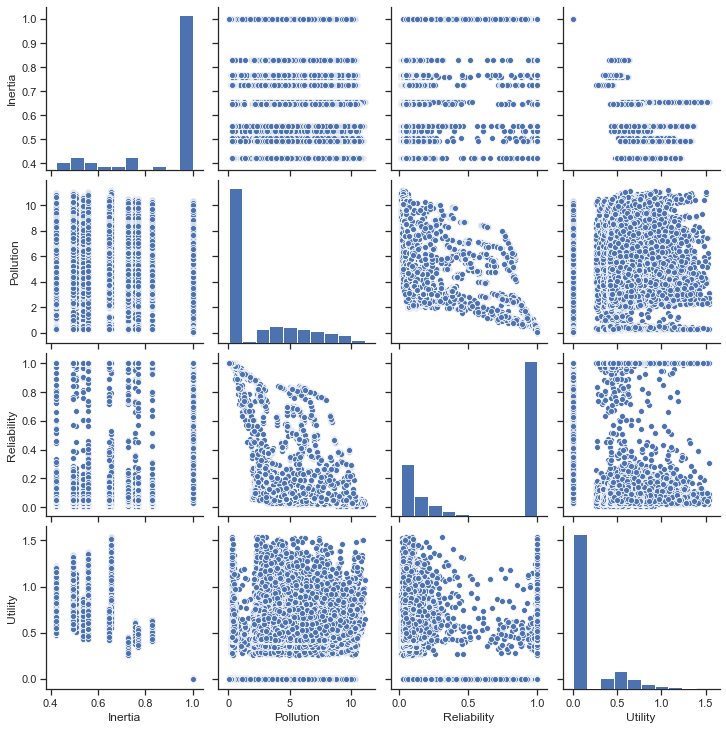

In [40]:
sns.set(style="ticks")
sns.pairplot(df[['Inertia','Pollution', 'Reliability','Utility']]) 

## Robustness

### A) Robustness comparison 

#### A.1) Mean/standard deviation (signal-to-noise ratio)

  \begin{equation}
             R_{ij} = \{\begin{array}{ll}
             \frac{\mu(f_{ijs}^* + 1}{\sigma(f_{ijs}^* + 1} ; & \text{if } f_i \text{ is to be maximized}; s=1..N \\
             (\mu(f_{ijs}^* + 1) \times (\sigma(f_{ijs}^* + 1) ; & \text{if } f_i \text{ is to be minimized}; s=1..N\\
             \end{array}
          \end{equation}
          where $\mu(f_{ijs}^*$ is the mean over the set of scenarios for outcome indicator $f_i$ in the case of implementing            the candidate solution $j$, and $\sigma$ is the standard deviation.
    
#### A.2) Max regret
The maximum regret of a candidate solution is the maximal difference across the scenarios between this candidate solution's performance and the zero-regret option's performance in each scenario. The following equation shows the formulation of maximum regret for candidate solution $j$ and outcome indicator $i$. In this formulation, $Z_{is}$ is the zero-regret value of outcome indicator $i$ in scenario $s$, which is assumed to be the best value obtained in this scenario with the optimal policy.

  \begin{equation}
         R_{ij} = \max_{s=1..N} \{ |f_{ijs}^* - Z_{is}| \} 
   \end{equation}

   \begin{equation}
         Z_{is} = \{\begin{array}{ll}
          \max_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be maximized} \\
          \min_{s=1..N} \{ f_{ijs}^* \} ; & \text{if } f_i \text{ is to be minimized}\\
         \end{array}
  \end{equation}
    



### B) Domain criterion: In how many (percentage of) scenarios (out of 1000 randomly generated) 

#### B.1) Re > 0.95 ? 
#### B.2) Utility > 0.2 ?
#### B.3) Both a and b.

## A) Robustness comparison

In [3]:
nn = 50 #non-dominated solutions
ss=1000 # scenarios

In [4]:
# Mean/std deviation (signal Noise)
df = Lake45re_data
R_mean_std = [nn * [None] for i in range(4)]
Solution = []

for j in range(nn):
    R_mean_std[0][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Utility']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Utility']).std()+1)
    #(np.array(nUtility[j]).mean()+1)/(np.array(nUtility[j]).std()+1)            # Max
    R_mean_std[1][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).mean()+1)*(np.array(df.loc[(j*1000):(j*1000+999),'Pollution']).std()+1)
    #(np.array(nPollution[j]).mean()+1)*(np.array(nPollution[j]).std()+1)        # Min
    R_mean_std[2][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Inertia']).std()+1)
    #(np.array(nInertia[j]).mean()+1)/(np.array(nInertia[j]).std()+1)            # Max
    R_mean_std[3][j] = (np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).mean()+1)/(np.array(df.loc[(j*1000):(j*1000+999),'Reliability']).std()+1)
    #(np.array(nReliability[j]).mean()+1)/(np.array(nReliability[j]).std()+1)    # Max
    Solution.append(j)

In [5]:
# Trade-offs between Utility and Reliability
# Each line represents one solution
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = R_mean_std[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
               dict(range = [1.35,2.05],
                label = 'Robustness of Inertia(↑)', values = R_mean_std[2]),
          
            dict(range = [20,9],
                label = 'Robustness of Pollution(↑)', values = R_mean_std[1]),
         
            dict(range = [.9,1.4],
                label = 'Robustness of Reliability(↑)', values = R_mean_std[3]),
              dict(range = [1,1.55],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↑)', values = R_mean_std[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [6]:
df = Lake45re_data
nnUtility = np.zeros((nn,ss))
nnPollution = np.zeros((nn,ss))
nnInertia = np.zeros((nn,ss))
nnReliability = np.zeros((nn,ss))

for p in range(ss):
    for i in range(nn):
        nnUtility[i][p] = df.loc[i*1000+p,'Utility']
        nnPollution[i][p] = df.loc[i*1000+p,'Pollution']
        nnInertia[i][p] = df.loc[i*1000+p,'Inertia']
        nnReliability[i][p] = df.loc[i*1000+p,'Reliability']
    

In [7]:
# Max Regret
z = [ss * [None] for i in range(4)]
Regret = [nn * [None] for i in range(4)]

for p in range(ss):
    z[0][p] = np.max(nnUtility, axis=0)[p] #nnUtility[solution(nn)][scenario(ss)]
    z[1][p] = np.min(nnPollution, axis=0)[p]
    z[2][p] = np.max(nnInertia, axis=0)[p]
    z[3][p] = np.max(nnReliability, axis=0)[p]

for j in range(nn):
    Regret[0][j] = np.max( abs(np.matrix(nnUtility[j]) - np.matrix(z[0]) ) )            # Max
    Regret[1][j] = np.max( abs(np.matrix(nnPollution[j]) - np.matrix(z[1]) ) )         # Min
    Regret[2][j] = np.max( abs(np.matrix(nnInertia[j]) - np.matrix(z[2]) ) )           # Max
    Regret[3][j] = np.max( abs(np.matrix(nnReliability[j]) - np.matrix(z[3]) ) )     # Max
 

In [8]:
np.min(Regret[3])

0.02699999999999969

In [9]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = Regret[0],
                   colorscale = [[0.2,'black'],[0.4,'purple'],[0.6,'red'],[.8,'gold']]),
        dimensions = list([
              dict(range = [0,0.75],
                label = 'Robustness of Inertia(↓)', values = Regret[2]),
      
            dict(range = [0,11],
                label = 'Robustness of Pollution(↓)', values = Regret[1]),
          
            dict(range = [0,1],
                label = 'Robustness of Reliability(↓)', values = Regret[3]),
                  dict(range = [0,1.75],
                #constraintrange = [4,8],
                label = 'Robustness of Utility(↓)', values = Regret[0]),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

## B) Robustness analysis

In [47]:
# Calculating Pcrit
#b,q, and x
# for each solution in each scenario we may have different Pcrit
Pcrit = np.zeros((nn,ss))
for j in range(nn):
    for  p in range(ss):
        x = ait[j]
        bb = b[p]
        qq = q[p]
        Pcrit[j][p] = brentq(lambda x: x**qq/(1+x**qq) - bb*x, 0.01, 1.5)
        
#Pcrit

In [48]:
np.max(Pcrit)

0.9244734159461026

In [49]:
# Write objectives

with open('Pcrit(EkerBarth)_50solutions_50scen_random_rfps(16.11.2020).csv', 'w', newline='') as f:
    objectives = ['Pcrit'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(nn):
        for p in range(ss):
            thewriter.writerow({'Pcrit' : Pcrit[j][p]
                               })

In [10]:
Pcritical = pd.read_csv('Pcrit(EkerBarth)_50solutions_50scen_random_rfps(16.11.2020).csv')
#Pcritical.describe()

Pcriti = np.zeros((nn,ss))
ind = 0
for j in range(nn):
    for p in range(ss):
        Pcriti[j][p] = Pcritical['Pcrit'][ind]
        ind += 1
    
#Pcriti[49][999]

In [11]:
""" 
Robustness analysis --> B
Calculating how many scenarios has 
    B.1) reliability > 0.8 
    B.2) Utility > 0.2/0.1 ?
    B.3) Both a and b.

"""
n_reliabale_scen = np.zeros((nn,))
n_high_eco_scen = np.zeros((nn,))
n_both_scen = np.zeros((nn,))
n_high_inertia_scen = np.zeros((nn,))
n_low_pollution_scen = np.zeros((nn,))
#critical_scen = []


for i in range(nn): 
    nrs = 0
    nhes = 0
    nboth = 0
    nhi = 0
    nlp = 0
    for p in range(ss):
        if nnReliability[i][p]>.8: #A.1
            nrs += 1
        #else:
        #    critical_scen.append(np.array([p+1, b[p], q[p], mean[p], stdev[p], delta[p]]) )  
        if nnUtility[i][p]>0.2: #A.2
            nhes += 1
        if nnReliability[i][p]>0.8 and nnUtility[i][p]>0.2: #A.3
            nboth += 1
        if nnInertia[i][p]>0.99:
            nhi += 1   
        if nnPollution[i][p]<Pcriti[i][p]: #2.54
            nlp += 1
            
    n_reliabale_scen[i] = nrs   
    n_high_eco_scen[i] = nhes
    n_both_scen[i] = nboth
    n_high_inertia_scen[i] = nhi
    n_low_pollution_scen[i] = nlp
    

print('Number of scenarios with reliability of > 0.95 =', n_reliabale_scen)
print('Number of scenarios with utility of > 0.2 =',n_high_eco_scen)
print('Number of scenarios with reliability of > 0.95 and utility > 0.2 =',n_both_scen)
#print('Number of scenarios with inertia of > 0.99 =',n_high_inertia_scen)
print('Number of scenarios with pollution of < Critical point =',n_low_pollution_scen)
#print(critical_scen)

Number of scenarios with reliability of > 0.95 = [207. 169. 409. 217. 284. 195. 147. 169. 203. 119. 134. 113. 197. 777.
 775. 772. 777. 772. 777. 774. 776. 777. 777. 777. 772. 777. 772. 777.
 777. 777. 777. 777. 777. 775. 777. 777. 777. 776. 777. 776. 776. 777.
 772. 772. 772. 772. 777. 777. 777. 777.]
Number of scenarios with utility of > 0.2 = [1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000. 1000.
 1000.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.    0.
    0.    0.]
Number of scenarios with reliability of > 0.95 and utility > 0.2 = [207. 169. 409. 217. 284. 195. 147. 169. 203. 119. 134. 113. 197.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.]
Number of scenarios with

In [25]:
rdc_reliability = np.sort(n_reliabale_scen)[::-1]/1000
rdc_reliability

array([0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777,
       0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777, 0.777,
       0.777, 0.777, 0.777, 0.777, 0.776, 0.776, 0.776, 0.776, 0.775,
       0.775, 0.774, 0.772, 0.772, 0.772, 0.772, 0.772, 0.772, 0.772,
       0.772, 0.409, 0.284, 0.217, 0.207, 0.203, 0.197, 0.195, 0.169,
       0.169, 0.147, 0.134, 0.119, 0.113])

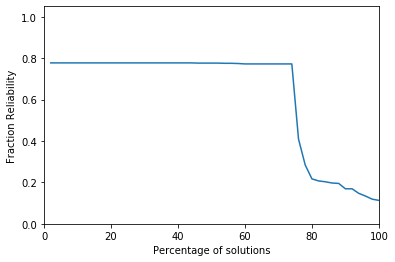

In [26]:
#Reliability robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_reliability)
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Reliability") 
plt.show()

In [27]:
rdc_utility = np.sort(n_high_eco_scen)[::-1]/1000
rdc_utility

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

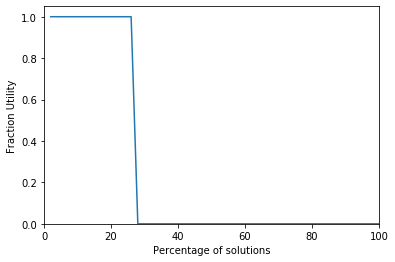

In [28]:
#Utility robustness
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_utility)
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Utility") 
plt.show()

In [16]:
rdc_both = np.sort(n_both_scen)[::-1]/1000
rdc_both

array([0.409, 0.284, 0.217, 0.207, 0.203, 0.197, 0.195, 0.169, 0.169,
       0.147, 0.134, 0.119, 0.113, 0.   , 0.   , 0.   , 0.   , 0.   ,
       0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
       0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
       0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ,
       0.   , 0.   , 0.   , 0.   , 0.   ])

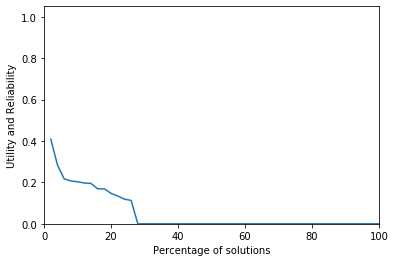

In [17]:
#Both
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_both)
plt.xlabel("Percentage of solutions") 
plt.ylabel("Utility and Reliability") 
plt.show()

In [18]:
rdc_pollution = np.sort(n_low_pollution_scen)[::-1]/1000
rdc_pollution

array([0.767, 0.767, 0.767, 0.767, 0.766, 0.766, 0.766, 0.766, 0.766,
       0.766, 0.766, 0.766, 0.766, 0.766, 0.766, 0.766, 0.766, 0.765,
       0.765, 0.765, 0.765, 0.765, 0.765, 0.765, 0.764, 0.764, 0.764,
       0.764, 0.764, 0.763, 0.763, 0.763, 0.763, 0.763, 0.763, 0.762,
       0.762, 0.407, 0.28 , 0.214, 0.205, 0.202, 0.196, 0.194, 0.168,
       0.167, 0.147, 0.132, 0.117, 0.113])

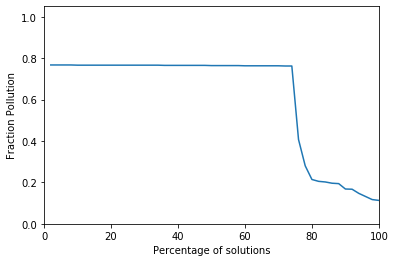

In [19]:
#Pollution
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_pollution)
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Pollution") 
plt.show()

In [20]:
rdc_inertia = np.sort(n_high_inertia_scen)[::-1]/1000
rdc_inertia

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

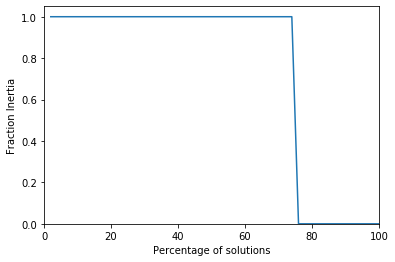

In [21]:
#Inertia
axes = plt.gca()
axes.set_ylim([0,1.05])
axes.set_xlim([0,100])
plt.plot(np.arange(1,nn+1)*100/nn,rdc_inertia)
plt.xlabel("Percentage of solutions") 
plt.ylabel("Fraction Inertia") 
plt.show()

In [22]:
fig = go.Figure(data=
    go.Parcoords(
        line = dict(color = n_high_eco_scen,
                   colorscale = [[0.1,'black'],[0.35,'purple'],[0.7,'red'],[.9,'gold']]),
        dimensions = list([
                    
            dict(range = [0,1],
                label = 'Fraction Pollution', values = n_low_pollution_scen/1000),
          
            dict(range = [0,1],
                label = 'Fraction Reliability', values = n_reliabale_scen/1000),
            
            dict(range = [0,1],
                #constraintrange = [4,8],
                label = 'Fraction Utility', values = n_high_eco_scen/1000),
            dict(range = [0,1],
                label = 'Fraction Inertia', values = n_high_inertia_scen/1000),

        ])
    )
)

fig.update_layout(
    plot_bgcolor = 'white',
    paper_bgcolor = 'white'
)

fig.show()

In [24]:
# Write objectives

with open('Domain_50solutions_(25.11.2020)50s.csv', 'w', newline='') as f:
    objectives = ['rdc_u', 'rdc_rel', 'rdc_pol', 'rdc_in'
                 ]
    thewriter = csv.DictWriter(f, fieldnames=objectives)
    
    thewriter.writeheader()

    for j in range(50):
        thewriter.writerow({'rdc_u' : rdc_utility[j], 'rdc_rel' : rdc_reliability[j], 'rdc_pol' : rdc_pollution[j], 'rdc_in' : rdc_inertia[j]   
                               })